<a href="https://colab.research.google.com/github/ssravali/Research-1/blob/master/datamodeling1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
#Libraries initiated
import numpy as np
import pickle
import matplotlib.pyplot as plt  
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
import logging
from time import time
import pandas as pd
from keras.layers import Flatten
from keras import optimizers
from keras.models import Sequential, load_model
from keras.layers import LSTM, Dense, Dropout
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.preprocessing import sequence
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from keras.layers import Conv1D, Dropout
from keras.layers import MaxPooling1D
import scipy.io as sio
from scipy import stats
import keras
import random
print("Imported libraries")

Using TensorFlow backend.


Imported libraries


(200, 2800, 10)
[   2    4   10   46  132 2439  114   36   12    5]
[   1    2    9   38  148 2383  163   39   14    3]
[   1    2   14   35  114 2344  185   89   12    4]
[   3    2   16   22   78  275 2313   67   16    8]
[   3    0    4   23   78 2401  221   57   11    2]
[   3   10   15   78  241 2339   84   23    4    3]
[   1    0    0   10   21  107 2471  163   22    5]
[   3   18   80 2459  188   42    8    1    0    1]
[  61   65  133   64   80  187   95   69   11 2035]
[2035    0    0    0    0    0    0    9  310  446]


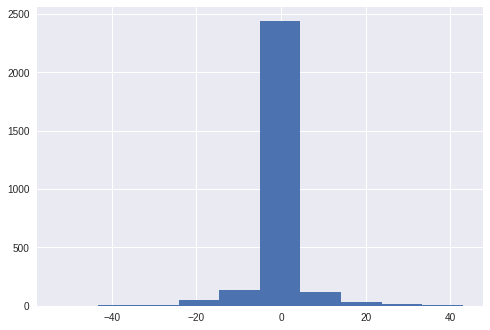

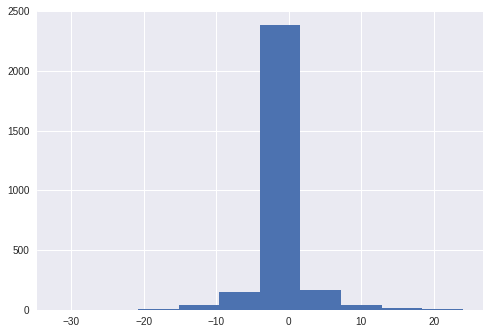

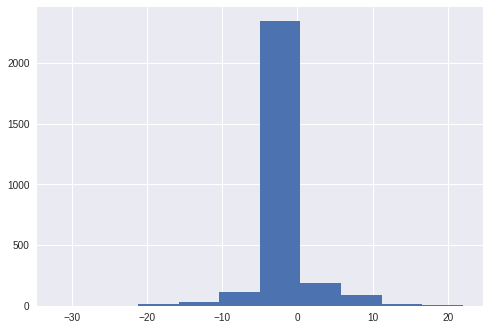

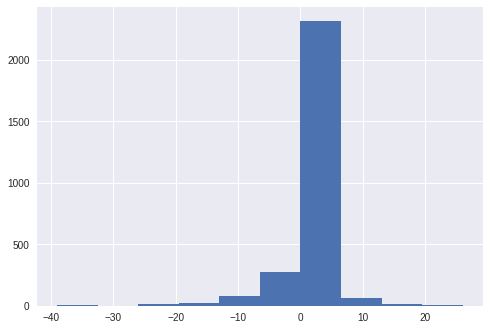

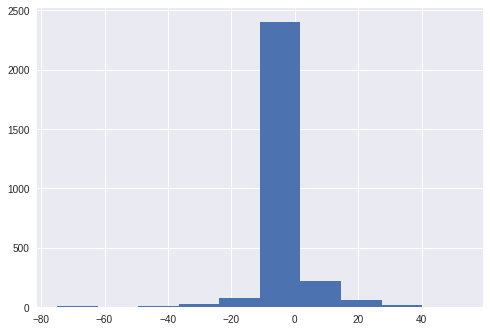

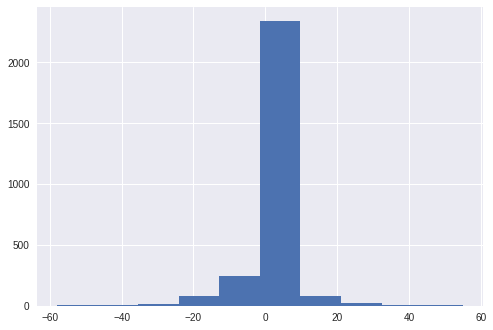

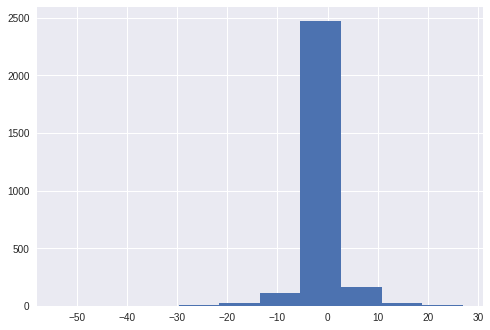

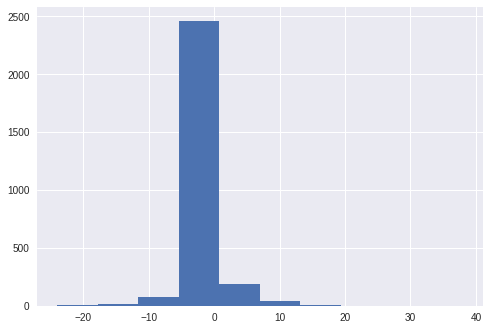

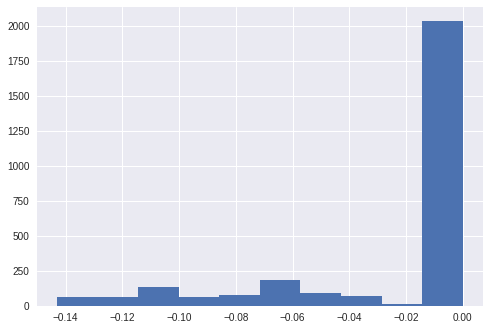

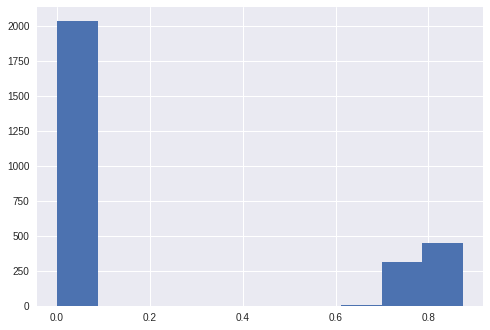

In [0]:
mat_contents = sio.loadmat('augtestx.mat')
testx = np.array(mat_contents['test_x'])
test_x = testx[0:200]

print(test_x.shape)
for i in range(10):
    hist, bin_edges = np.histogram(test_x[1,:,i])
    print(hist)
    plt.figure()
    plt.hist(test_x[1,:,i], bins=bin_edges)

[  61   65  133   64   80  187   95   69   11 2035]
[-0.14306641 -0.12875977 -0.11445313 -0.10014648 -0.08583984 -0.0715332
 -0.05722656 -0.04291992 -0.02861328 -0.01430664  0.        ]


(array([  61.,   65.,  133.,   64.,   80.,  187.,   95.,   69.,   11.,
        2035.]),
 array([-0.14306641, -0.12875977, -0.11445313, -0.10014648, -0.08583984,
        -0.0715332 , -0.05722656, -0.04291992, -0.02861328, -0.01430664,
         0.        ]),
 <a list of 10 Patch objects>)

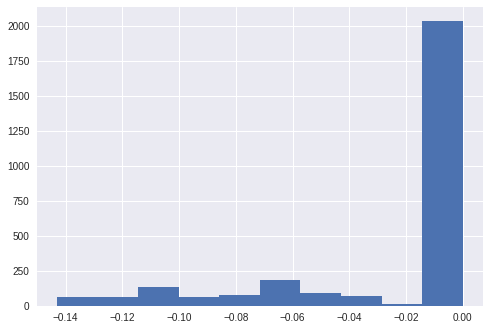

In [0]:
h, b = np.histogram(test_x[1,:,8])
print(h)
print(b)
plt.figure()
plt.hist(test_x[1,:,8], bins=b)

T - test
A test to compare the means of two groups
Hypothesis:

- Null Hypothesis: signals of the channels are the same for a given exercise irrespective of the person
- Alternate Hypothesis: signals from the channels are different

If the calculated t-statistic is greater than the critical t-value, the test concludes that there is a statistically significant difference between the two populations. Therefore, you reject the null hypothesis that there is no statistically significant difference between the two populations.

In any other case, there is no statistically significant difference between the two populations. The test fails to reject the null hypothesis and we accept the alternate hypothesis which says that the height of men and women are statistically different.

- Assumption: Normally distributed data


In [0]:
mat_contents = sio.loadmat('test.mat')
test_x = np.array(mat_contents['data'])
test_y = np.array(mat_contents['data_labels'])
mat_contents = sio.loadmat('train.mat')
train_x = np.array(mat_contents['data'])
train_y = np.array(mat_contents['data_labels'])

classes = np.unique(train_y)
nClasses = len(classes)

train_y = OneHotEncoder(sparse=False,categories='auto').fit_transform(train_y)
test_y = OneHotEncoder(sparse=False,categories='auto').fit_transform(test_y)

print("Train_y one hot:", train_y.shape)
print("Test_y one hot:", test_y.shape)


print(train_x.shape)
print(test_x.shape)
print('Total number of outputs : ', nClasses)
print('Output classes : ', classes)
print("loaded data")

Train_y one hot: (400, 10)
Test_y one hot: (200, 10)
(400, 2800, 10)
(200, 2800, 10)
Total number of outputs :  10
Output classes :  [0 1 2 3 4 5 6 7 8 9]
loaded data
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]


In [0]:
## Import the packages
import numpy as np
from scipy import stats


## Define 2 random distributions

#Gaussian distributed data with mean = 2 and var = 1
a = test_x[1,:,1]
#Gaussian distributed data with with mean = 0 and var = 1
b = test_x[1,:,2]

#Sample Size
N = a.shape[0]

## Calculate the Standard Deviation
#Calculate the variance to get the standard deviation

#For unbiased max likelihood estimate we have to divide the var by N-1, and therefore the parameter ddof = 1
var_a = a.var(ddof=1)
var_b = b.var(ddof=1)

#std deviation
s = np.sqrt((var_a + var_b)/2)
s



## Calculate the t-statistics
t = (a.mean() - b.mean())/(s*np.sqrt(2/N))



## Compare with the critical t-value
#Degrees of freedom
df = 2*N - 2

#p-value after comparison with the t 
p = 1 - stats.t.cdf(t,df=df)


print("t = " + str(t))
print("p = " + str(2*p))
### You can see that after comparing the t statistic with the critical t value (computed internally) we get a good p value of 0.0005 and thus we reject the null hypothesis and thus it proves that the mean of the two distributions are different and statistically significant.


## Cross Checking with the internal scipy function
t2, p2 = stats.ttest_ind(a,b)
print("t = " + str(t2))
print("p = " + str(p2))


t = -0.04007811455712717
p = 1.0319677209663127
t = -0.04007811455712717
p = 0.9680322790336874


In [0]:
#Data loading
for i in range(1,11):
    if i == 1:
        s = 'EMG' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        EMG = np.array(mat_contents['EMG'])
        inc = 2800 - int(EMG.shape[1])
        x_EMG = np.pad(EMG,((0,0),(0,inc),(0,0)),'constant')
        s = 'ACC' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        ACC = np.array(mat_contents['ACC'])
        x_ACC = np.pad(ACC,((0,0),(0,inc),(0,0)),'constant')
        s = 'Y' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        Y = np.array(mat_contents['Y'])
    else:
        s = 'EMG' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        EMG = np.array(mat_contents['EMG'])
        inc = 2800 - int(EMG.shape[1])
        EMG = np.pad(EMG,((0,0),(0,inc),(0,0)),'constant')
        x_EMG = np.concatenate((x_EMG,EMG),axis = 0)
        s = 'ACC' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        ACC = np.array(mat_contents['ACC'])
        ACC = np.pad(ACC,((0,0),(0,inc),(0,0)),'constant')
        x_ACC = np.concatenate((x_ACC,ACC),axis = 0)
        s = 'Y' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        Y = np.concatenate((Y,np.array(mat_contents['Y'])),axis = 0)
        
print ('The shape of output is: ',Y.shape)
print ('The shape of input EMG is: ',x_EMG.shape)
print ('The shape of input ACC is: ',x_ACC.shape)
classes = np.unique(Y)
nClasses = len(classes)
print('Total number of outputs : ', nClasses)
print('Output classes : ', classes)

[y_m,y_n] = Y.shape
[x1_m,x1_n,x1_ch] = x_EMG.shape
[x2_m,x2_n,x2_ch] = x_ACC.shape

The shape of output is:  (3120, 1)
The shape of input EMG is:  (3120, 2800, 16)
The shape of input ACC is:  (3120, 2800, 3)
Total number of outputs :  52
Output classes :  [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52]


In [0]:
x_EMG_t = np.zeros((x1_ch,x1_ch,nClasses))
x_ACC_t = np.zeros((x2_ch,x2_ch,nClasses))
x_EMG_p = np.zeros((x1_ch,x1_ch,nClasses))
x_ACC_p = np.zeros((x2_ch,x2_ch,nClasses))

for i in range(nClasses):
    r,r1 = np.where(Y == (i+1))#r1 is a redundent variable
    t = np.zeros(r.shape[0])
    p = np.zeros(r.shape[0])
    for j in range(x1_ch):
        for k in range(x1_ch):
            for l in range(r.shape[0]):
                t[l], p[l] = stats.ttest_ind(x_EMG[r[l],:,j],x_EMG[r[l],:,k])
            T = np.mean(t)
            P = np.mean(p)
            x_EMG_t[j,k,i] = T
            x_EMG_p[j,k,i] = P
    for j in range(x2_ch):
        for k in range(x2_ch):
            for l in range(r.shape[0]):
                t[l], p[l] = stats.ttest_ind(x_ACC[r[l],:,j],x_ACC[r[l],:,k])
            T = np.mean(t)
            P = np.mean(p)
            x_ACC_t[j,k,i] = T
            x_ACC_p[j,k,i] = P
print(x_EMG_t.shape)
print(x_ACC_t.shape)
print(x_EMG_p.shape)
print(x_ACC_p.shape)
print(np.where((x_EMG_t > x_EMG_p) == 'True'))
print(np.where((x_ACC_t > x_ACC_p) == 'True'))


(16, 16, 52)
(3, 3, 52)
(16, 16, 52)
(3, 3, 52)
(array([], dtype=int64),)
(array([], dtype=int64),)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:31: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


Q-Q plot is used to check for normally distribution in data
The data should be on the red line. If it’s not, then it suggests that the data may not be normally distribute.

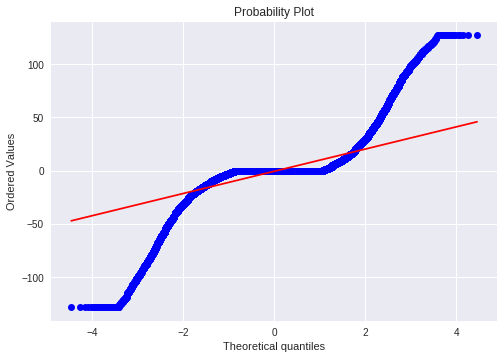

In [0]:
r,r1 = np.where(Y == (1))#r1 is a redundent variable
#a = np.concatenate(np.zeros((2,2)), axis = 0)
#res = stats.probplot(a, plot=plt)
res = stats.probplot(np.concatenate(x_EMG[r,:,1], axis = 0), plot=plt)

This code checks for the normality of the data per exercise per channel

ex = 1  ch = 0


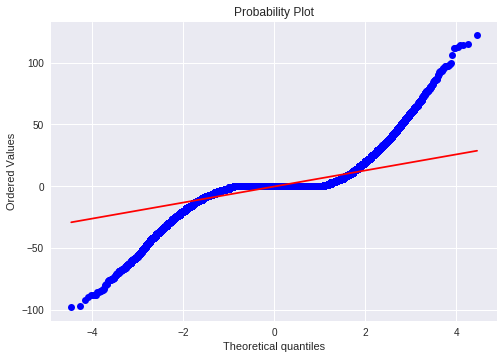

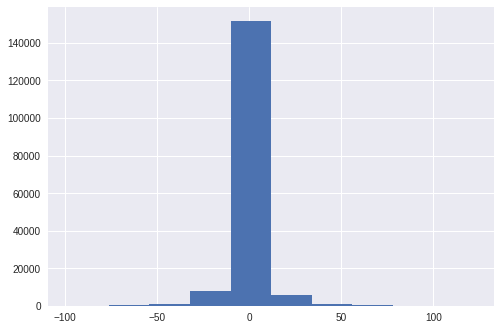

mean=-0.307 stdv=8.617
Statistics=0.569, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=46378.696, p=0.000
Sample does not look Gaussian (reject H0)
ex = 2  ch = 0


/usr/local/lib/python3.6/dist-packages/scipy/stats/morestats.py:1309: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


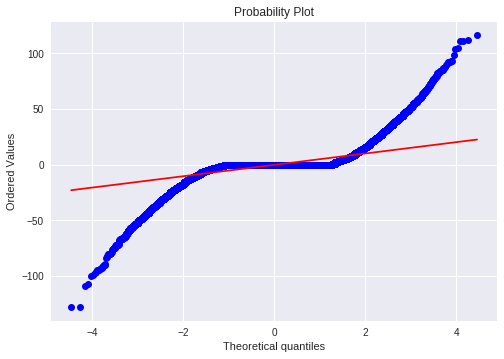

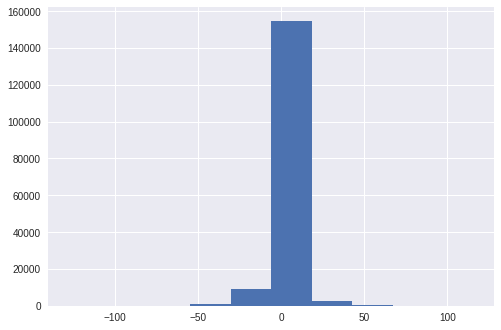

mean=-0.219 stdv=7.379
Statistics=0.478, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=48181.926, p=0.000
Sample does not look Gaussian (reject H0)
ex = 3  ch = 0


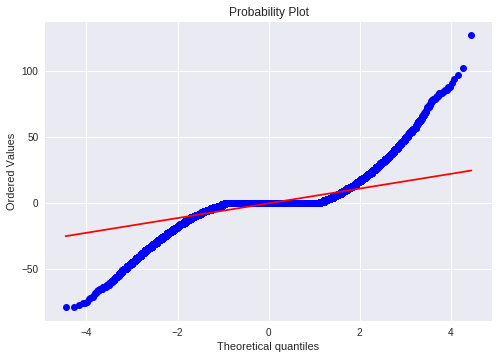

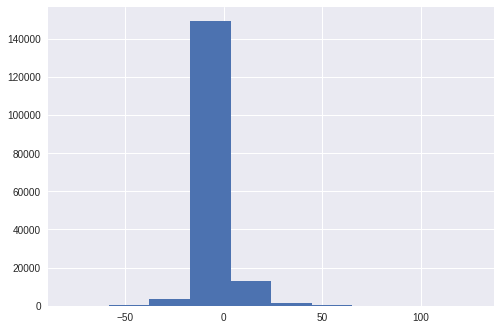

mean=-0.279 stdv=7.340
Statistics=0.579, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=44091.113, p=0.000
Sample does not look Gaussian (reject H0)
ex = 4  ch = 0


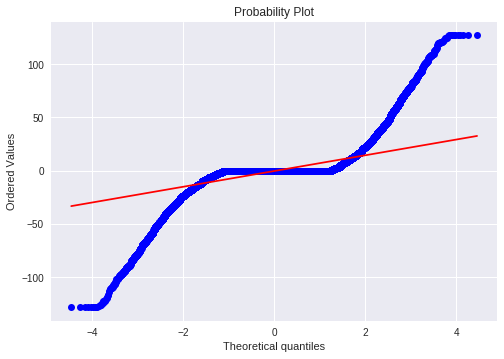

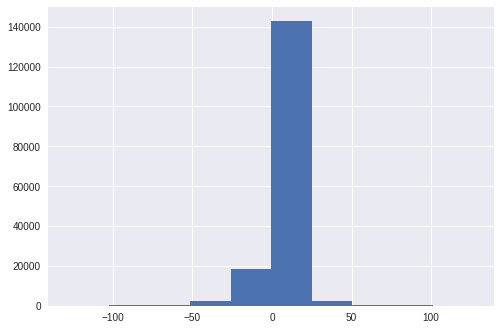

mean=-0.241 stdv=10.721
Statistics=0.474, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=48046.495, p=0.000
Sample does not look Gaussian (reject H0)
ex = 5  ch = 0


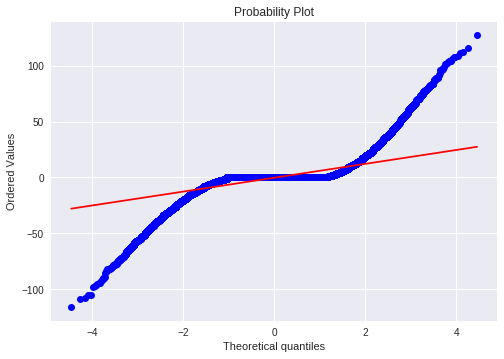

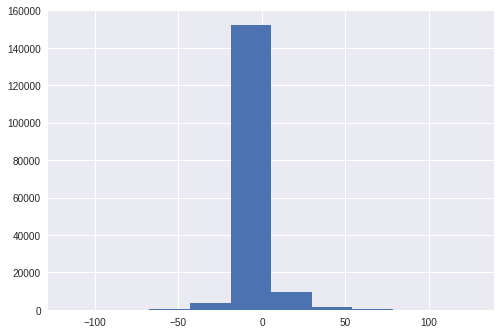

mean=-0.248 stdv=8.617
Statistics=0.518, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=48113.627, p=0.000
Sample does not look Gaussian (reject H0)
ex = 6  ch = 0


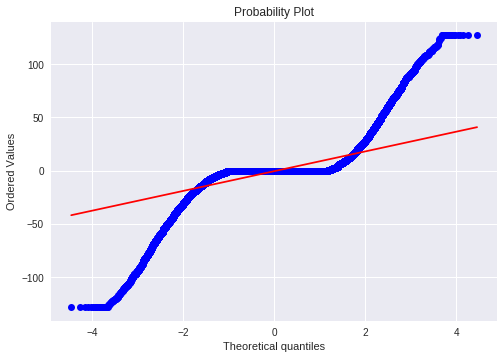

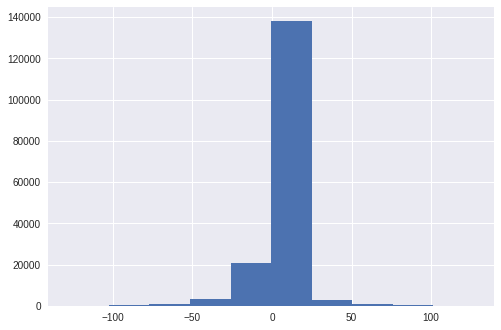

mean=-0.382 stdv=13.144
Statistics=0.497, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=43944.684, p=0.000
Sample does not look Gaussian (reject H0)
ex = 7  ch = 0


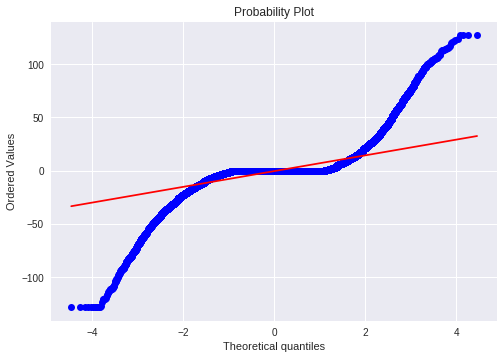

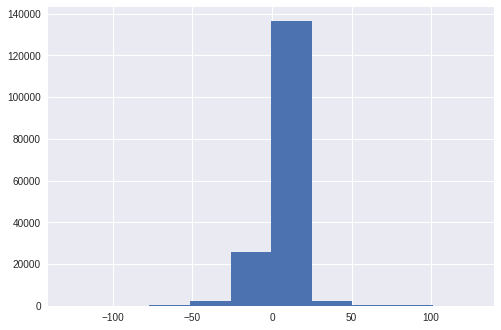

mean=-0.322 stdv=10.193
Statistics=0.525, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=49493.700, p=0.000
Sample does not look Gaussian (reject H0)
ex = 8  ch = 0


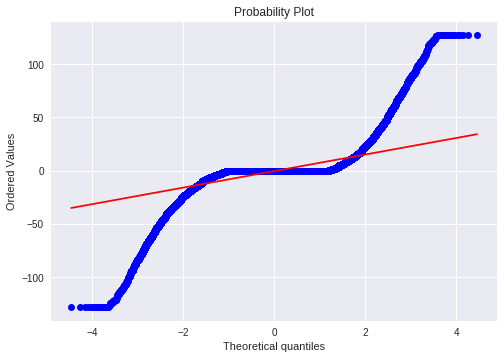

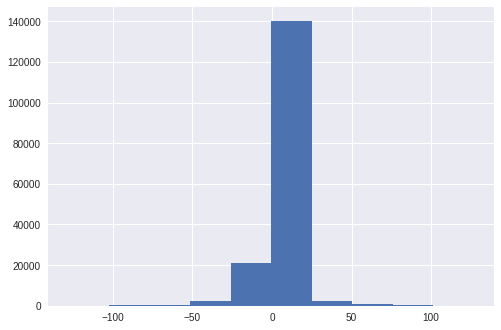

mean=-0.291 stdv=11.329
Statistics=0.469, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=49890.911, p=0.000
Sample does not look Gaussian (reject H0)
ex = 9  ch = 0


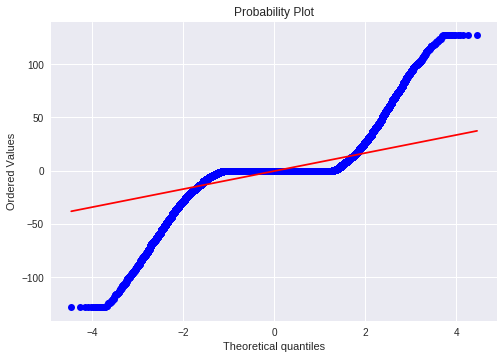

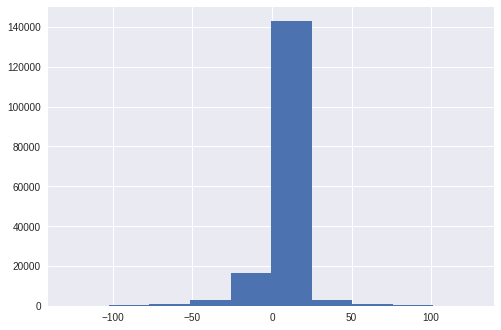

mean=-0.279 stdv=12.543
Statistics=0.455, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=45872.891, p=0.000
Sample does not look Gaussian (reject H0)
ex = 10  ch = 0


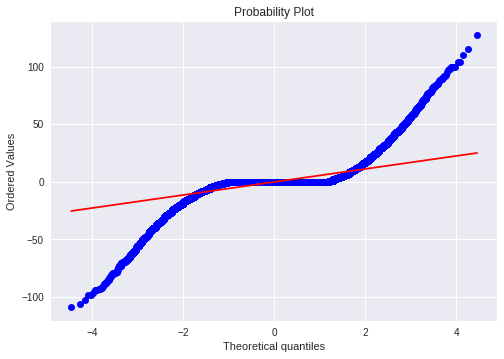

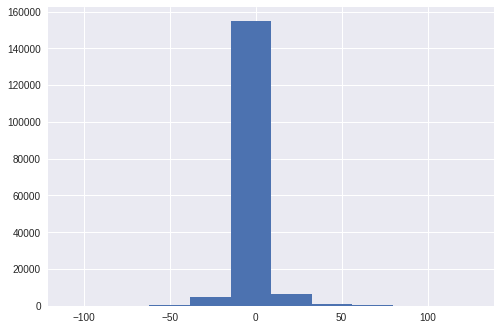

mean=-0.256 stdv=7.973
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=46995.668, p=0.000
Sample does not look Gaussian (reject H0)
ex = 11  ch = 0


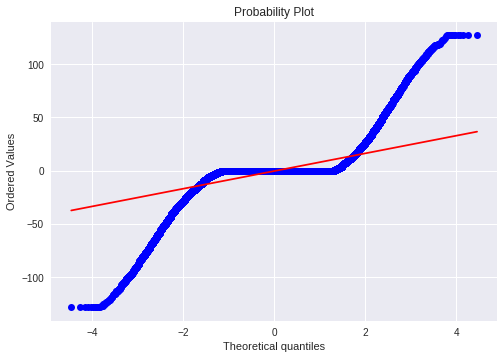

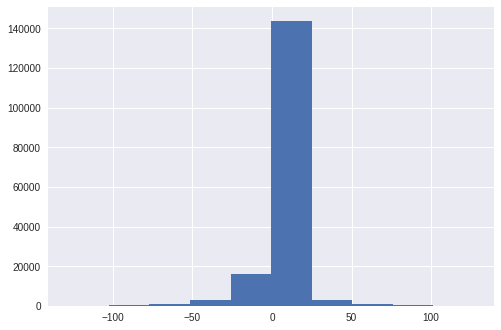

mean=-0.265 stdv=12.349
Statistics=0.451, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=45824.405, p=0.000
Sample does not look Gaussian (reject H0)
ex = 12  ch = 0


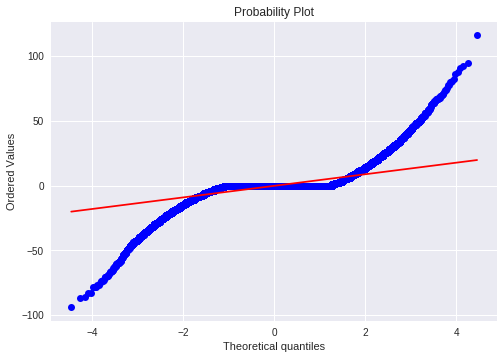

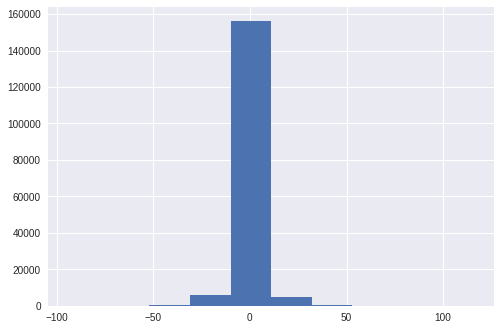

mean=-0.221 stdv=6.270
Statistics=0.509, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=46390.292, p=0.000
Sample does not look Gaussian (reject H0)
ex = 13  ch = 0


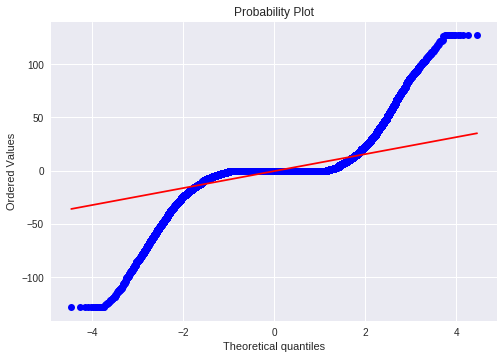

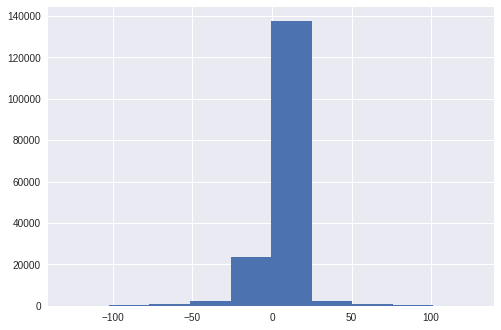

mean=-0.313 stdv=11.492
Statistics=0.480, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=47710.293, p=0.000
Sample does not look Gaussian (reject H0)
ex = 14  ch = 0


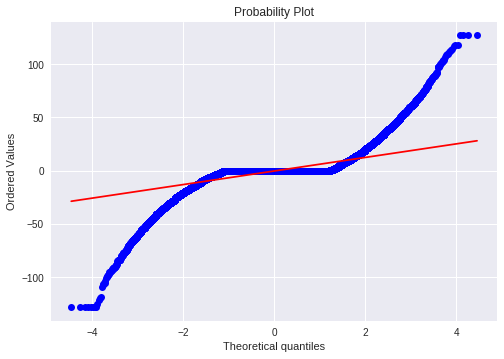

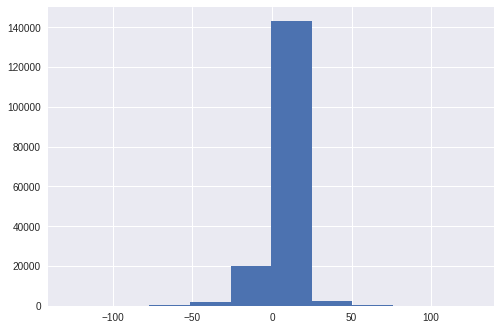

mean=-0.218 stdv=8.914
Statistics=0.510, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=46349.070, p=0.000
Sample does not look Gaussian (reject H0)
ex = 15  ch = 0


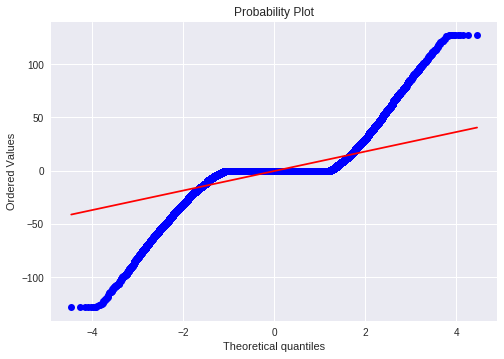

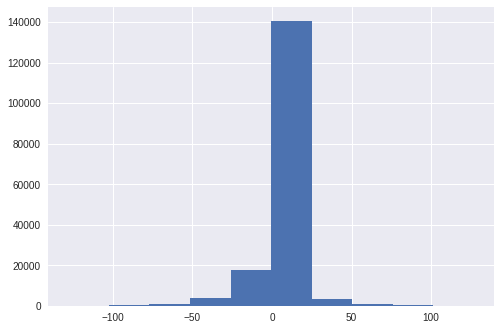

mean=-0.249 stdv=12.750
Statistics=0.516, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=41924.071, p=0.000
Sample does not look Gaussian (reject H0)
ex = 16  ch = 0


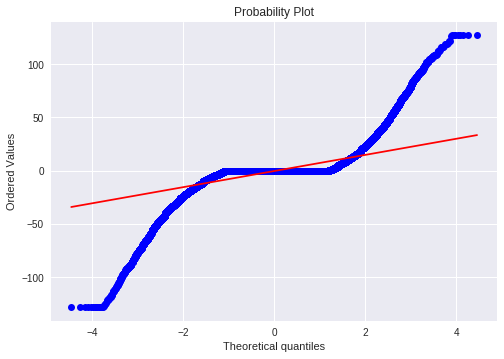

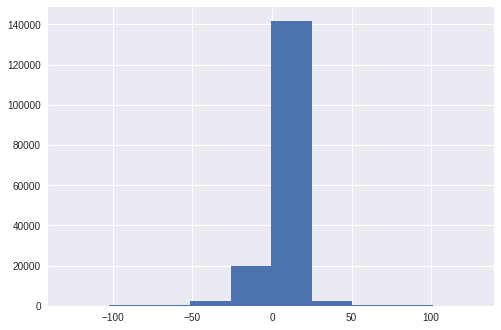

mean=-0.247 stdv=10.780
Statistics=0.493, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=47136.752, p=0.000
Sample does not look Gaussian (reject H0)
ex = 17  ch = 0


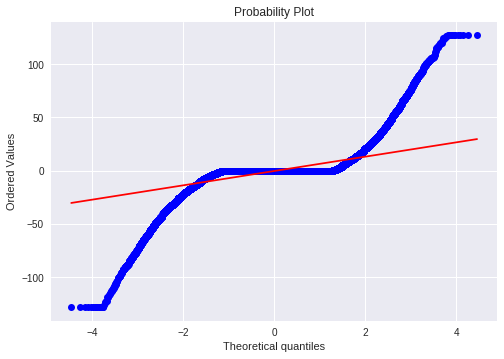

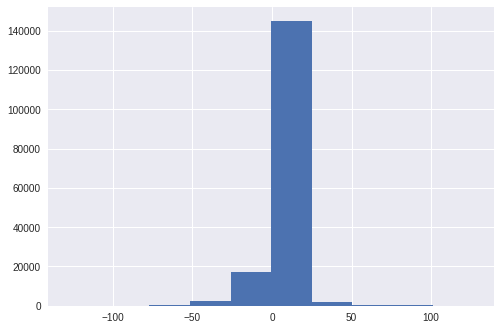

mean=-0.222 stdv=10.039
Statistics=0.448, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=50302.028, p=0.000
Sample does not look Gaussian (reject H0)
ex = 18  ch = 0


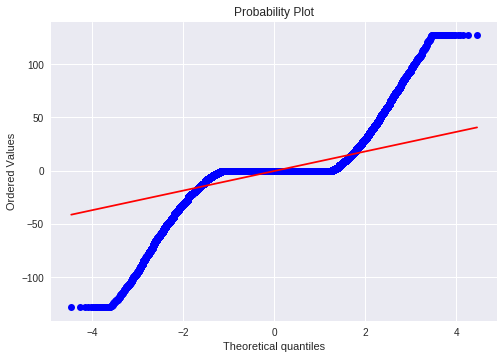

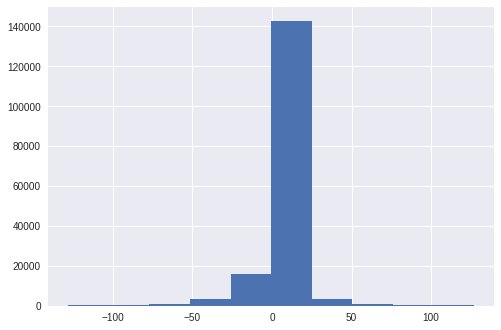

mean=-0.240 stdv=13.368
Statistics=0.472, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=44313.977, p=0.000
Sample does not look Gaussian (reject H0)
ex = 19  ch = 0


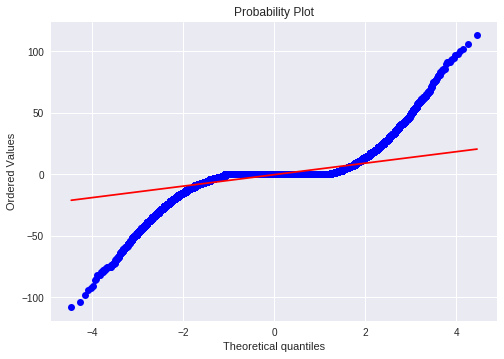

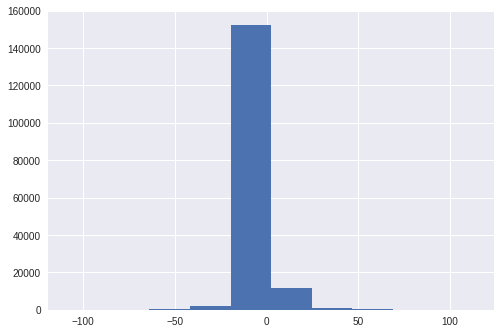

mean=-0.227 stdv=6.699
Statistics=0.486, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=50380.551, p=0.000
Sample does not look Gaussian (reject H0)
ex = 20  ch = 0


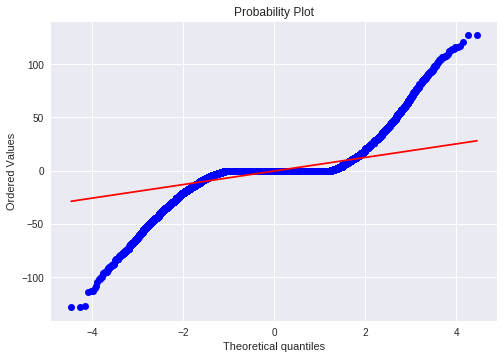

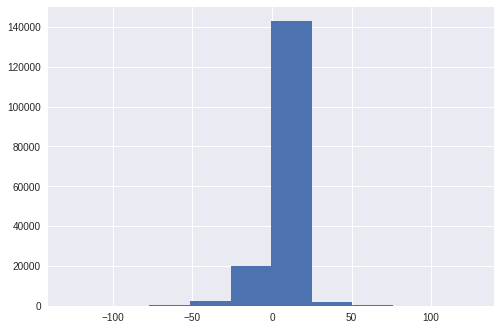

mean=-0.227 stdv=9.173
Statistics=0.481, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=51494.415, p=0.000
Sample does not look Gaussian (reject H0)
ex = 21  ch = 0


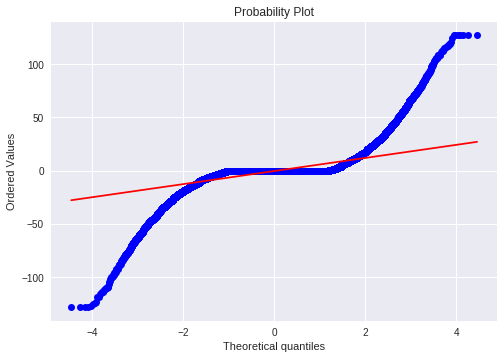

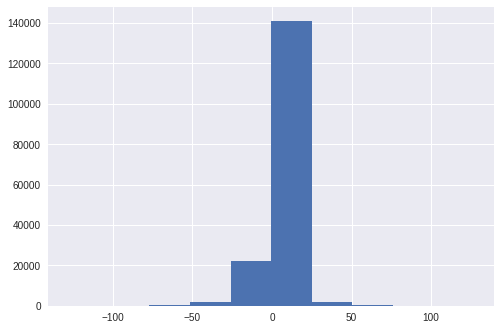

mean=-0.245 stdv=8.811
Statistics=0.486, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=51559.198, p=0.000
Sample does not look Gaussian (reject H0)
ex = 22  ch = 0


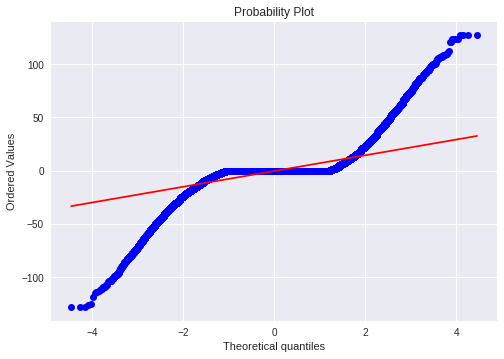

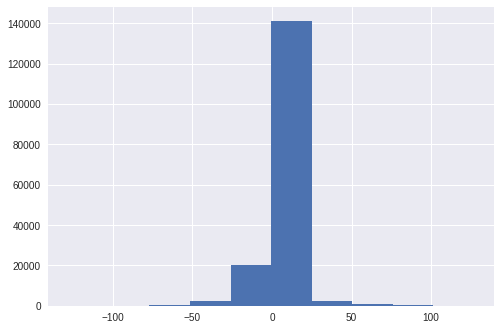

mean=-0.250 stdv=10.456
Statistics=0.499, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=46376.111, p=0.000
Sample does not look Gaussian (reject H0)
ex = 23  ch = 0


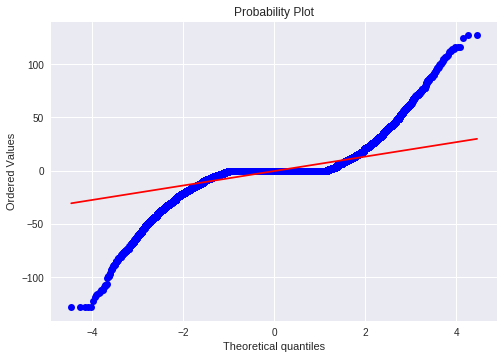

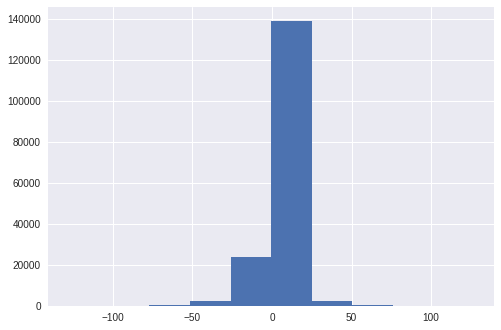

mean=-0.263 stdv=9.201
Statistics=0.543, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=45350.330, p=0.000
Sample does not look Gaussian (reject H0)
ex = 24  ch = 0


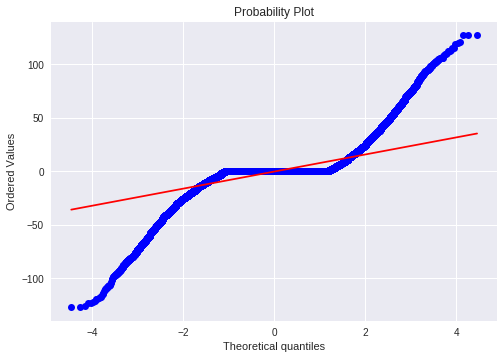

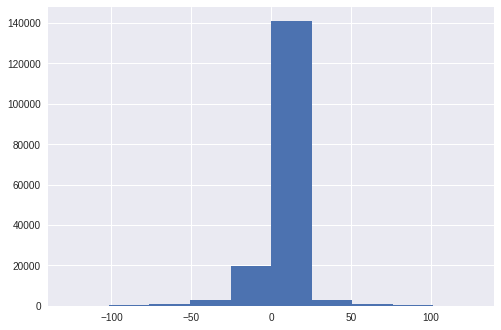

mean=-0.247 stdv=10.969
Statistics=0.529, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=42545.815, p=0.000
Sample does not look Gaussian (reject H0)
ex = 25  ch = 0


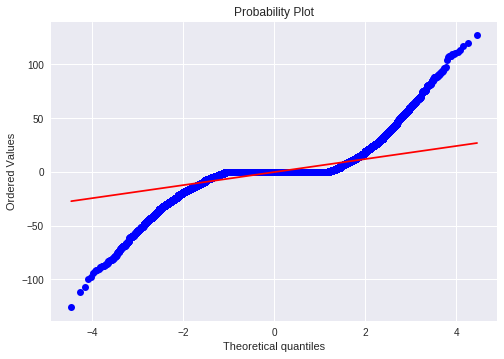

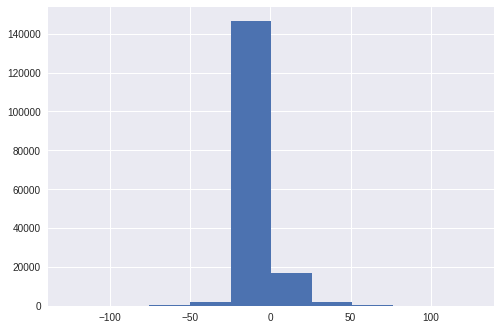

mean=-0.235 stdv=8.400
Statistics=0.523, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=49925.193, p=0.000
Sample does not look Gaussian (reject H0)
ex = 26  ch = 0


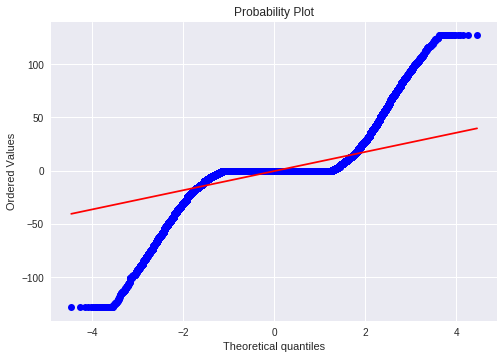

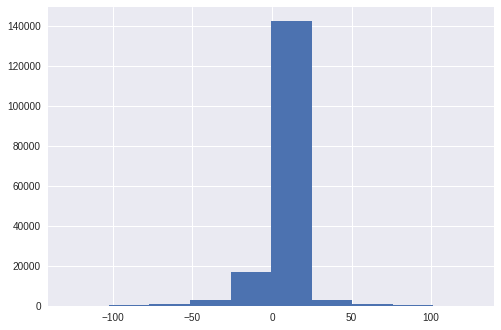

mean=-0.294 stdv=13.188
Statistics=0.465, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=44771.695, p=0.000
Sample does not look Gaussian (reject H0)
ex = 27  ch = 0


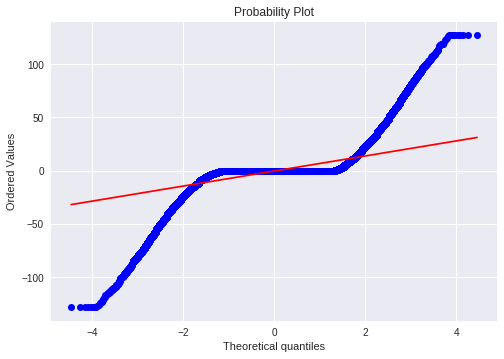

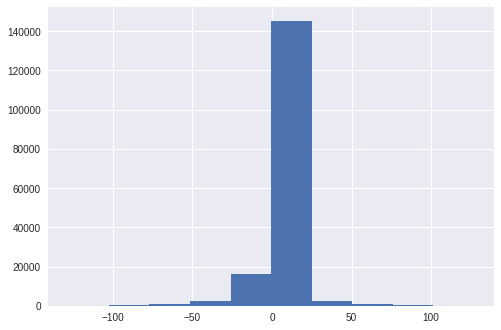

mean=-0.233 stdv=10.799
Statistics=0.428, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=48581.624, p=0.000
Sample does not look Gaussian (reject H0)
ex = 28  ch = 0


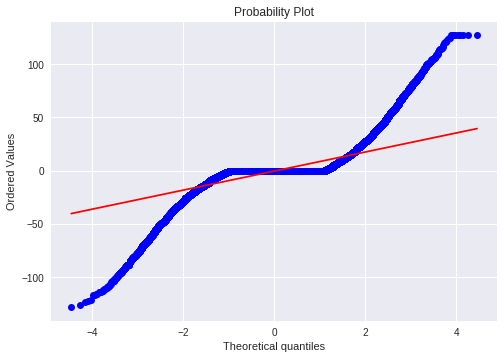

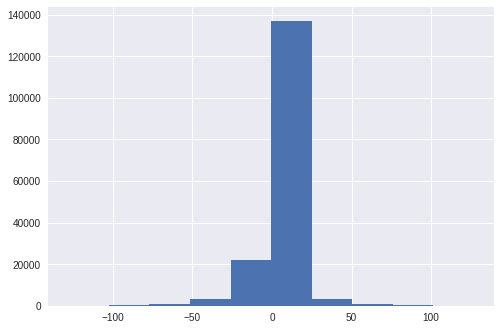

mean=-0.287 stdv=11.886
Statistics=0.566, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=40552.700, p=0.000
Sample does not look Gaussian (reject H0)
ex = 29  ch = 0


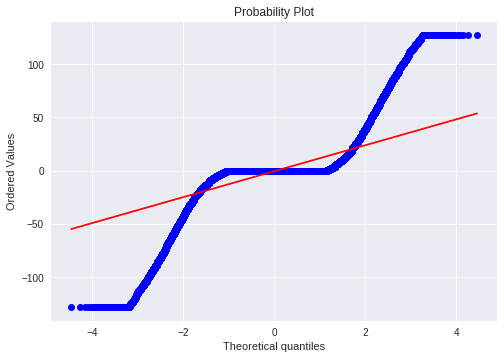

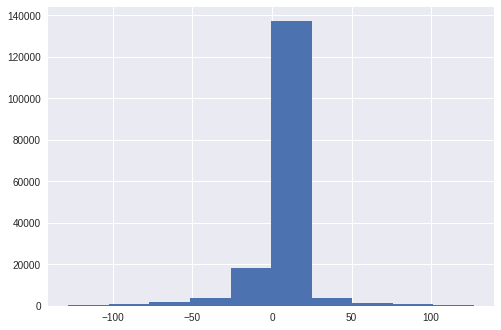

mean=-0.427 stdv=17.085
Statistics=0.507, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=41574.430, p=0.000
Sample does not look Gaussian (reject H0)
ex = 30  ch = 0


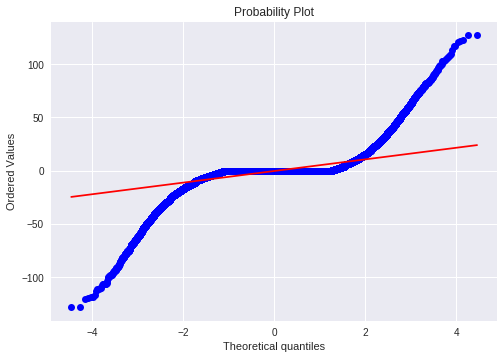

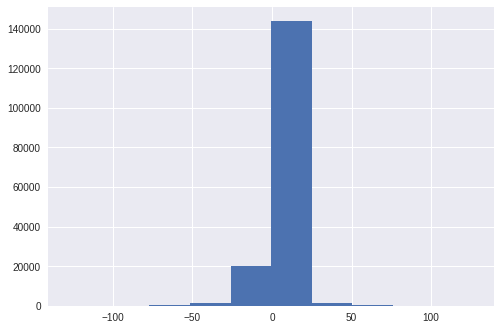

mean=-0.218 stdv=8.131
Statistics=0.450, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=52234.541, p=0.000
Sample does not look Gaussian (reject H0)
ex = 31  ch = 0


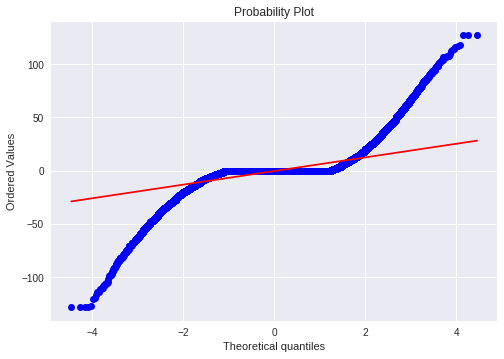

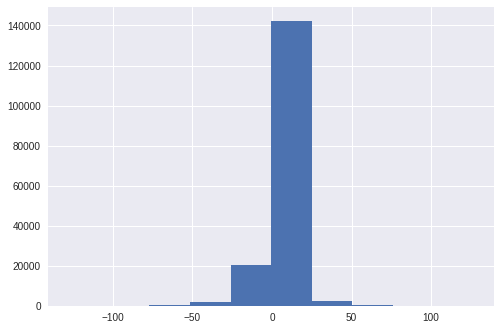

mean=-0.235 stdv=9.121
Statistics=0.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=48831.048, p=0.000
Sample does not look Gaussian (reject H0)
ex = 32  ch = 0


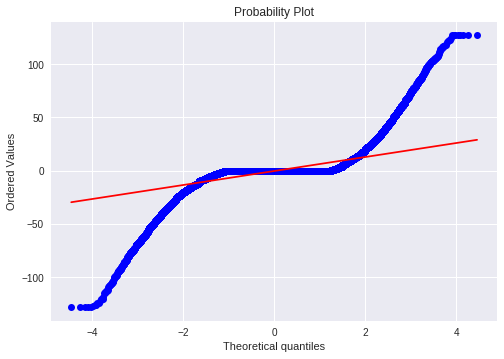

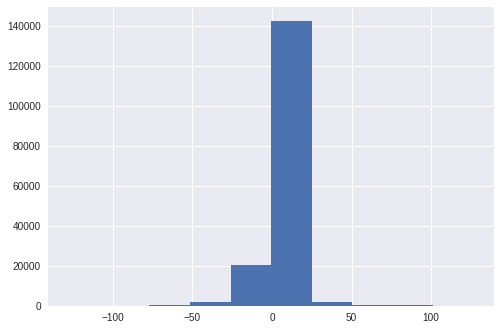

mean=-0.231 stdv=9.626
Statistics=0.465, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=50918.817, p=0.000
Sample does not look Gaussian (reject H0)
ex = 33  ch = 0


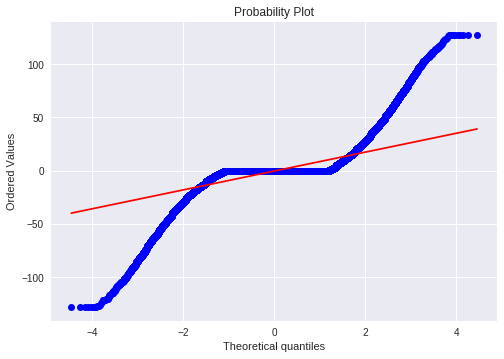

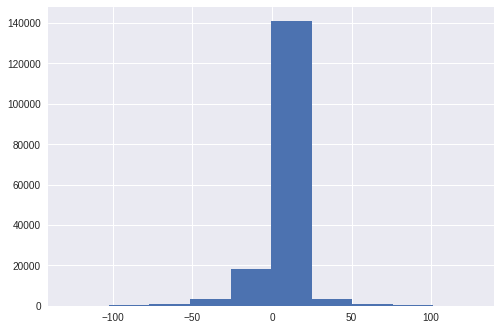

mean=-0.256 stdv=12.368
Statistics=0.513, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=42789.297, p=0.000
Sample does not look Gaussian (reject H0)
ex = 34  ch = 0


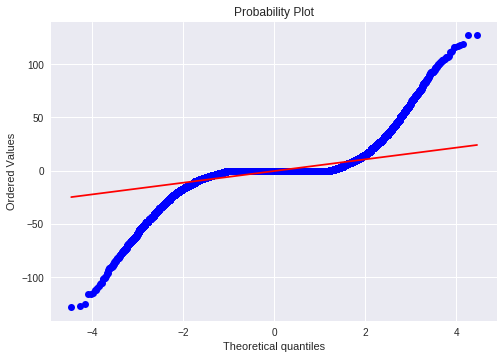

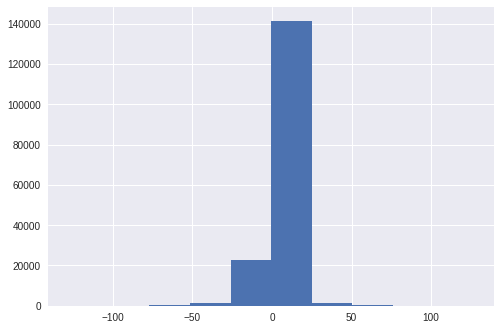

mean=-0.242 stdv=8.027
Statistics=0.467, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=55886.841, p=0.000
Sample does not look Gaussian (reject H0)
ex = 35  ch = 0


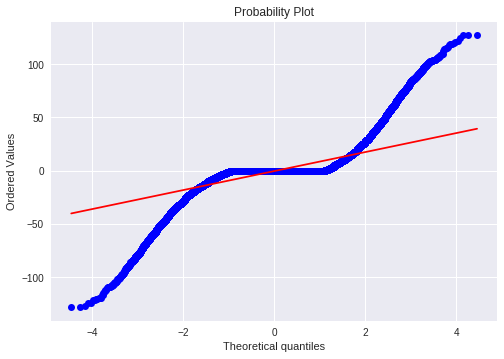

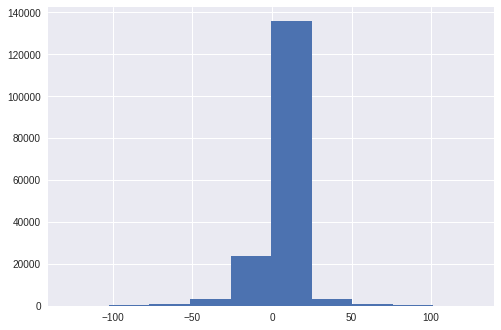

mean=-0.298 stdv=12.009
Statistics=0.551, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=42639.240, p=0.000
Sample does not look Gaussian (reject H0)
ex = 36  ch = 0


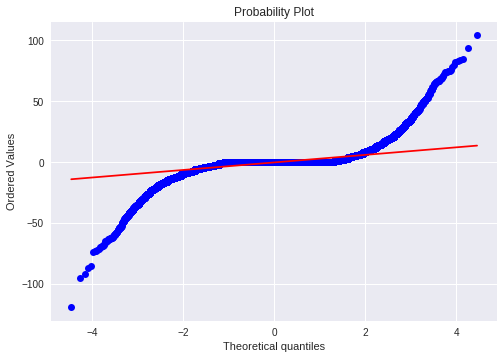

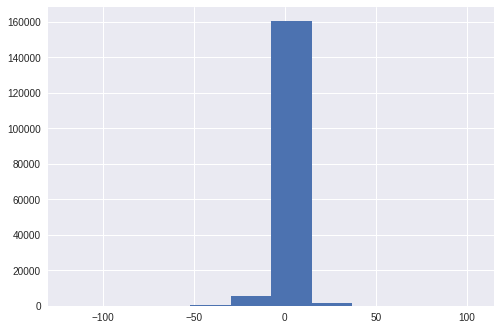

mean=-0.211 stdv=4.613
Statistics=0.451, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=59096.104, p=0.000
Sample does not look Gaussian (reject H0)
ex = 37  ch = 0


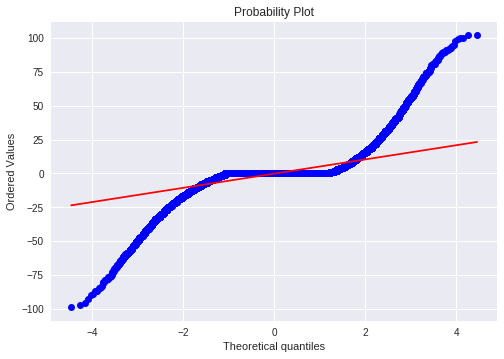

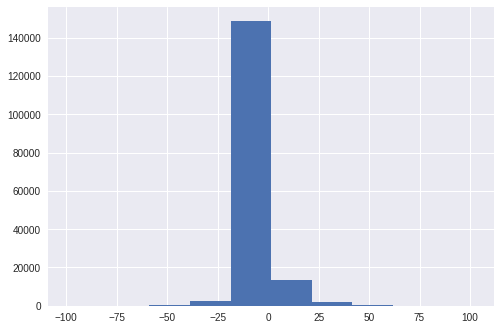

mean=-0.225 stdv=7.416
Statistics=0.502, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=55441.052, p=0.000
Sample does not look Gaussian (reject H0)
ex = 38  ch = 0


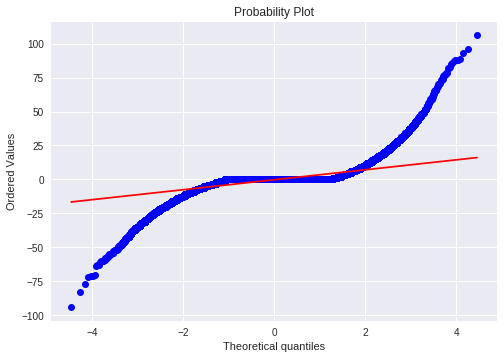

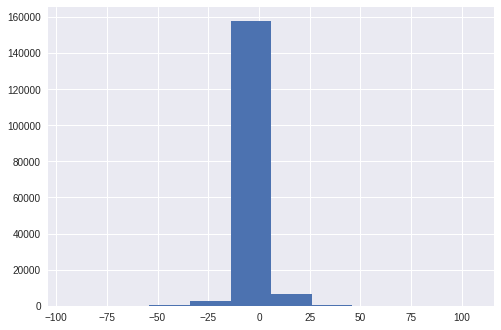

mean=-0.219 stdv=5.219
Statistics=0.494, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=59835.178, p=0.000
Sample does not look Gaussian (reject H0)
ex = 39  ch = 0


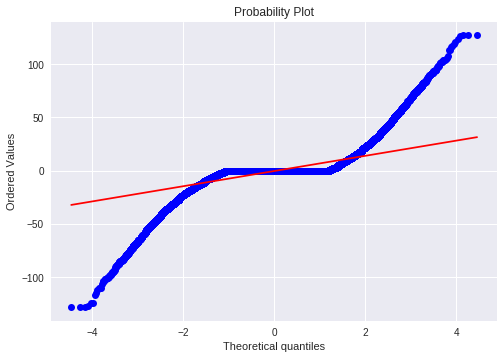

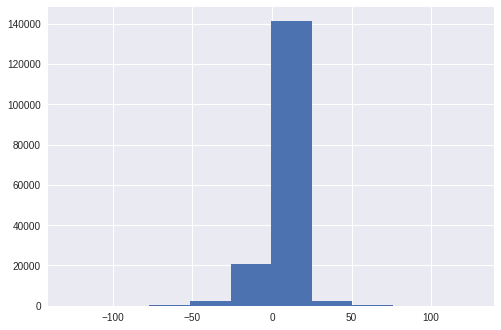

mean=-0.245 stdv=9.850
Statistics=0.524, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=44218.543, p=0.000
Sample does not look Gaussian (reject H0)
ex = 40  ch = 0


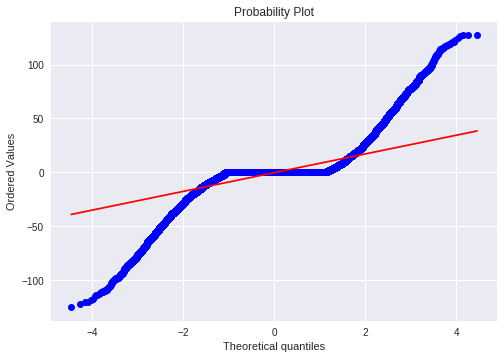

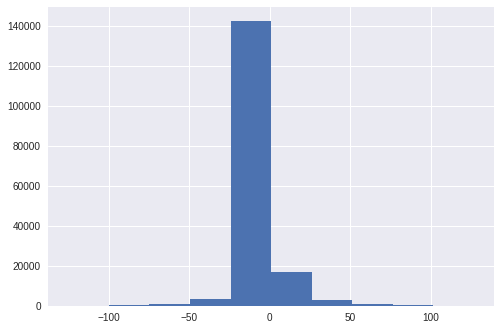

mean=-0.277 stdv=11.759
Statistics=0.545, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=40883.614, p=0.000
Sample does not look Gaussian (reject H0)
ex = 41  ch = 0


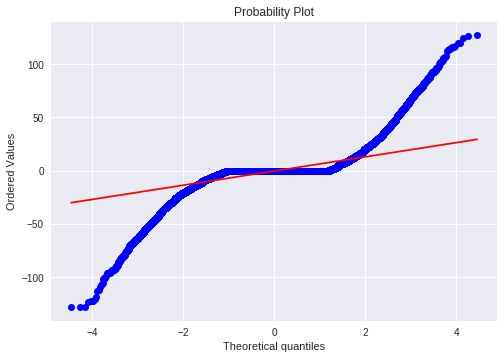

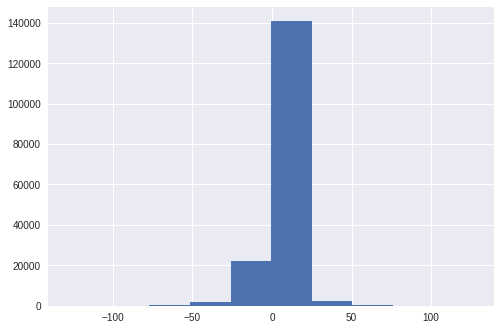

mean=-0.248 stdv=9.262
Statistics=0.517, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=46872.277, p=0.000
Sample does not look Gaussian (reject H0)
ex = 42  ch = 0


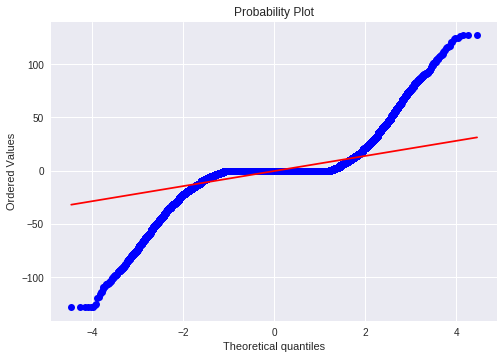

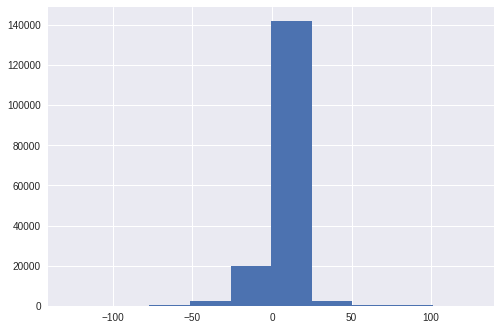

mean=-0.242 stdv=10.228
Statistics=0.479, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=47457.516, p=0.000
Sample does not look Gaussian (reject H0)
ex = 43  ch = 0


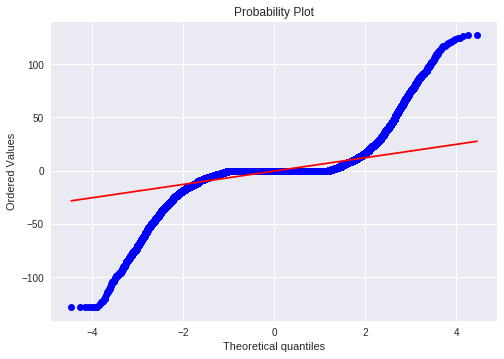

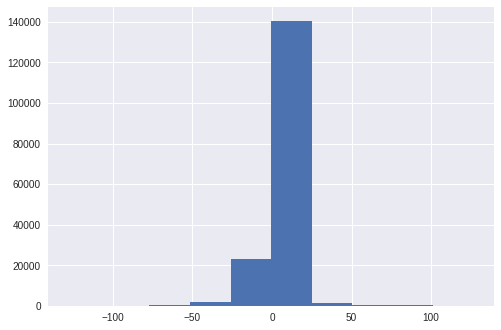

mean=-0.268 stdv=9.194
Statistics=0.464, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=53402.690, p=0.000
Sample does not look Gaussian (reject H0)
ex = 44  ch = 0


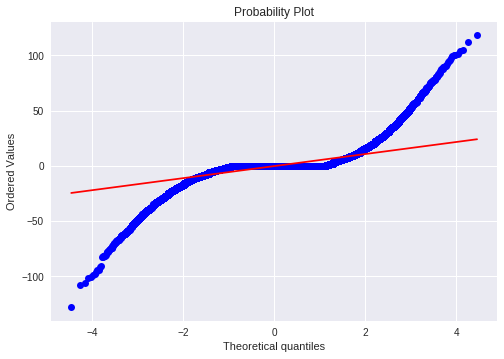

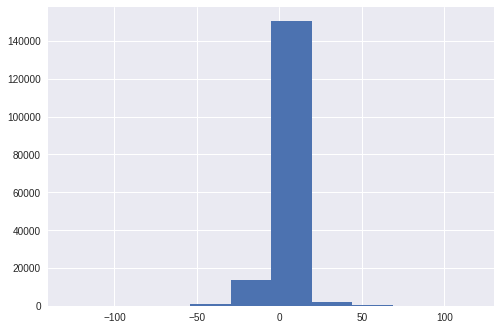

mean=-0.282 stdv=7.349
Statistics=0.551, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=48831.578, p=0.000
Sample does not look Gaussian (reject H0)
ex = 45  ch = 0


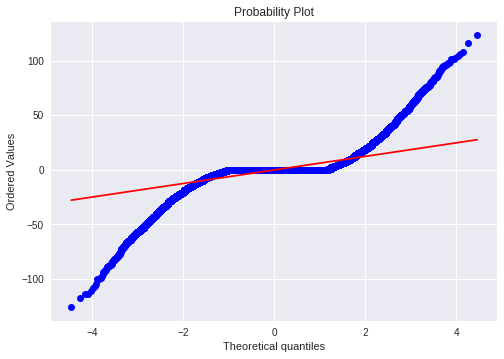

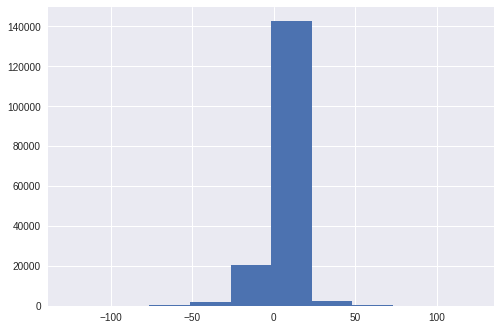

mean=-0.250 stdv=8.550
Statistics=0.528, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=44768.628, p=0.000
Sample does not look Gaussian (reject H0)
ex = 46  ch = 0


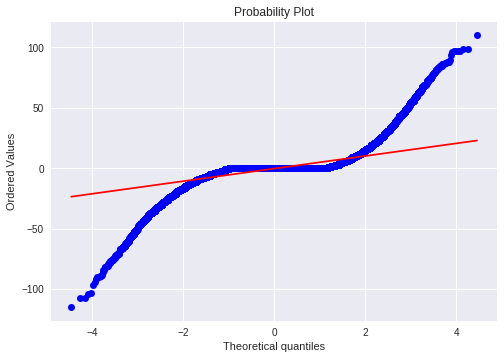

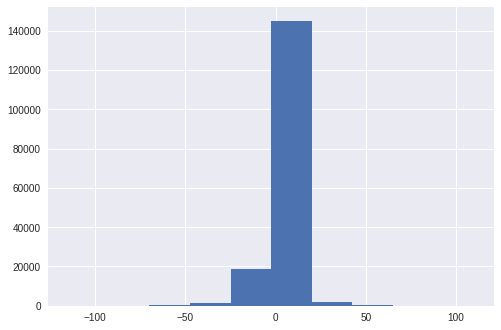

mean=-0.256 stdv=7.243
Statistics=0.519, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=50694.031, p=0.000
Sample does not look Gaussian (reject H0)
ex = 47  ch = 0


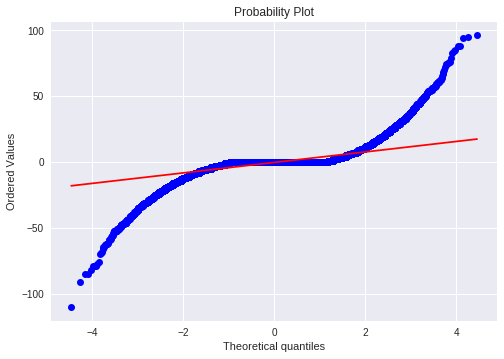

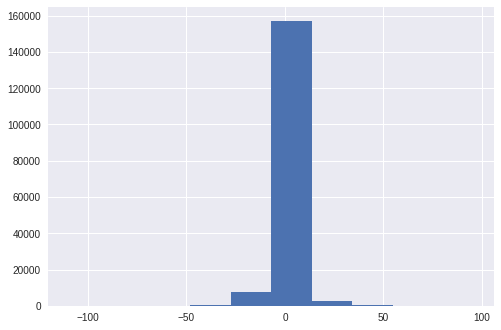

mean=-0.269 stdv=5.404
Statistics=0.541, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=49365.649, p=0.000
Sample does not look Gaussian (reject H0)
ex = 48  ch = 0


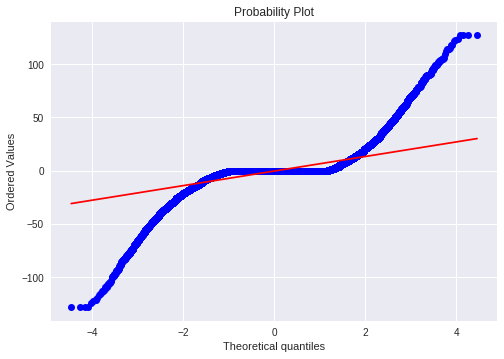

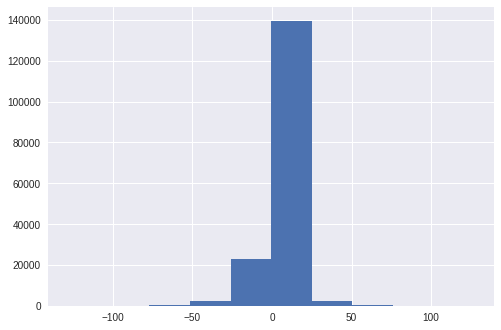

mean=-0.269 stdv=9.541
Statistics=0.513, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=47282.654, p=0.000
Sample does not look Gaussian (reject H0)
ex = 49  ch = 0


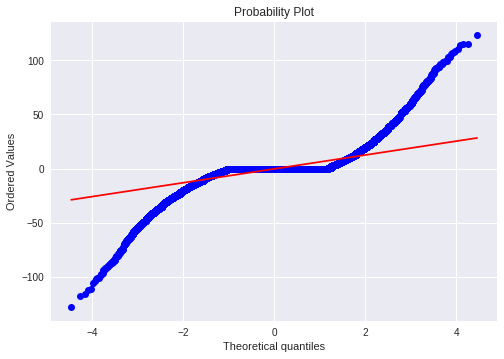

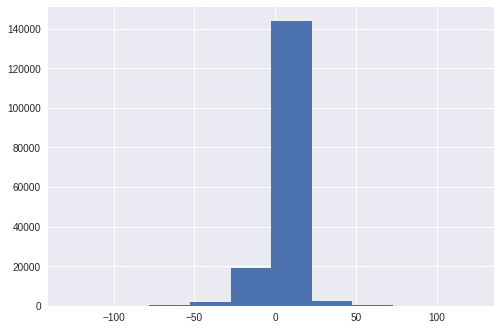

mean=-0.253 stdv=8.672
Statistics=0.545, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=47960.621, p=0.000
Sample does not look Gaussian (reject H0)
ex = 50  ch = 0


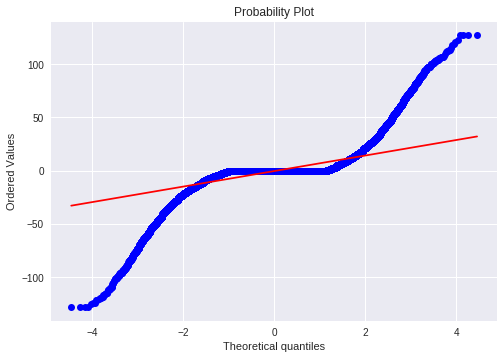

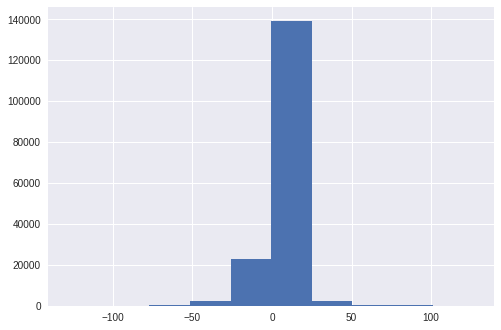

mean=-0.273 stdv=10.176
Statistics=0.512, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=46982.520, p=0.000
Sample does not look Gaussian (reject H0)
ex = 51  ch = 0


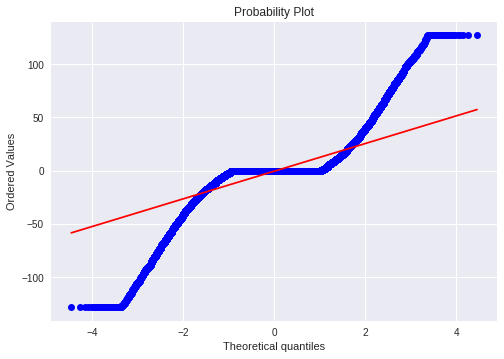

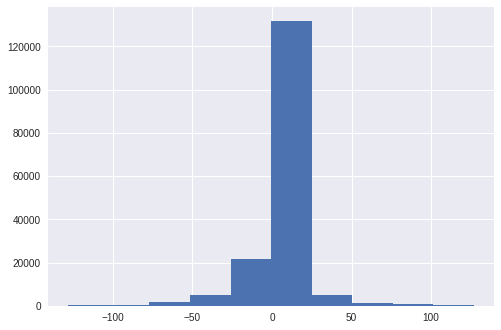

mean=-0.408 stdv=16.720
Statistics=0.602, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=36376.480, p=0.000
Sample does not look Gaussian (reject H0)
ex = 52  ch = 0


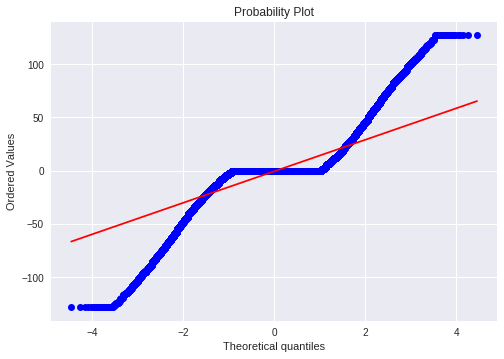

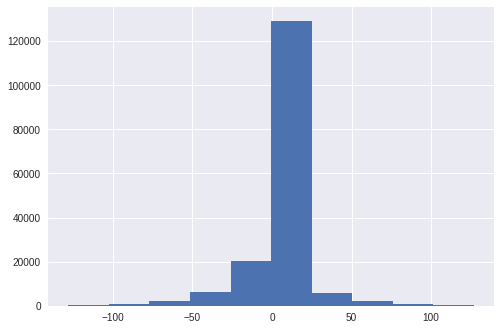

mean=-0.508 stdv=18.431
Statistics=0.643, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=30820.713, p=0.000
Sample does not look Gaussian (reject H0)


In [0]:
for i in range(1 , (nClasses+1)):
    for j in range(1):
        print('ex = %d  ch = %d'%(i,j))
        r,r1 = np.where(Y == (i))
        plt.figure()
        x = np.concatenate(x_EMG[r,:,j], axis = 0)
        res = stats.probplot(x, plot=plt)
        plt.figure()
        plt.hist(x)
        plt.show()
        print('mean=%.3f stdv=%.3f' % (np.mean(x), np.std(x)))
        stat, p = stats.shapiro(x)
        print('Statistics=%.3f, p=%.3f' % (stat, p))
        # interpret
        alpha = 0.05
        if p > alpha:
            print('Sample looks Gaussian (fail to reject H0)')
        else:
            print('Sample does not look Gaussian (reject H0)')
        stat, p = stats.normaltest(x)
        print('Statistics=%.3f, p=%.3f' % (stat, p))
        # interpret
        alpha = 0.05
        if p > alpha:
            print('Sample looks Gaussian (fail to reject H0)')
        else:
            print('Sample does not look Gaussian (reject H0)')

As seen from both q-q plot and the results in the above it is clearly seen that t test isn't able to differentiate hence we move on.

F - Test

- Null hypo: No difference in variance
Alternate Hypo: Difference in variance
- Assumption: normally distributed data
- A Statistical F Test uses an F Statistic to compare two variances, s1 and s2, by dividing them
- If the f-table value is smaller than the calculated value, you can reject the null hypothesis.

In [0]:

a = x_EMG[1,:,1]
b = x_EMG[1,:,2]
f, p = stats.f_oneway(a,b)
print(f)
print(p)

0.006398043813514597
0.9362498398025924


In [0]:
x_EMG_f = np.zeros((x1_ch,x1_ch,nClasses))
x_ACC_f = np.zeros((x2_ch,x2_ch,nClasses))
x_EMG_p2 = np.zeros((x1_ch,x1_ch,nClasses))
x_ACC_p2 = np.zeros((x2_ch,x2_ch,nClasses))

for i in range(nClasses):
    r,r1 = np.where(Y == (i+1))#r1 is a redundent variable
    f = np.zeros(r.shape[0])
    p2 = np.zeros(r.shape[0])
    for j in range(x1_ch):
        for k in range(x1_ch):
            for l in range(r.shape[0]):
                f[l], p2[l] = stats.f_oneway(x_EMG[r[l],:,j],x_EMG[r[l],:,k])
            F = np.mean(f)
            P2 = np.mean(p2)
            x_EMG_t[j,k,i] = F
            x_EMG_p[j,k,i] = P2
    for j in range(x2_ch):
        for k in range(x2_ch):
            for l in range(r.shape[0]):
                f[l], p2[l] = stats.f_oneway(x_ACC[r[l],:,j],x_ACC[r[l],:,k])
            F = np.mean(f)
            P2 = np.mean(p2)
            x_ACC_t[j,k,i] = F
            x_ACC_p[j,k,i] = P2
print(x_EMG_f.shape)
print(x_ACC_f.shape)
print(x_EMG_p2.shape)
print(x_ACC_p2.shape)
print(np.where((x_EMG_f > x_EMG_p2) == 'True'))
print(np.where((x_ACC_f > x_ACC_p2) == 'True'))


(16, 16, 52)
(3, 3, 52)
(16, 16, 52)
(3, 3, 52)
(array([], dtype=int64),)
(array([], dtype=int64),)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:31: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


Levene's Test

- An inferential statistic used to assess the equality of variances for a variable calculated for two or more groups.
- Null Hypo: the variances of the populations from which different samples are drawn are equal
- If the resulting p-value of Levene's test is less than some significance level (typically 0.05), the obtained differences in sample variances are unlikely to have occurred based on random sampling from a population with equal variances. Thus, the null hypothesis of equal variances is rejected and it is concluded that there is a difference between the variances in the population.


Trying to print histograms of emg signals to checkif they are gaussian

Chi - Square

- hypothesis
    - H0:There is no statistically significant relationship between channels of signals per exercise
    - Ha:There is a statistically significant relationship
- Assumptions: 
    - Different data semples, no repitation
    - Random Samples
- 

In [0]:
obs = np.array([[[[12, 17],[11, 16]],[[11, 12],[15, 16]]],[[[23, 15],[30, 22]],[[14, 17],[15, 16]]]])
print(obs.shape)

(2, 2, 2, 2)


Load data to use for tests

In [0]:
#Data loading
for i in range(1,11):
    if i == 1:
        s = 'EMG' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        EMG = np.array(mat_contents['EMG'])
        inc = 2800 - int(EMG.shape[1])
        x_EMG = np.pad(EMG,((0,0),(0,inc),(0,0)),'constant')
        s = 'ACC' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        ACC = np.array(mat_contents['ACC'])
        x_ACC = np.pad(ACC,((0,0),(0,inc),(0,0)),'constant')
        s = 'Y' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        Y = np.array(mat_contents['Y'])
    else:
        s = 'EMG' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        EMG = np.array(mat_contents['EMG'])
        inc = 2800 - int(EMG.shape[1])
        EMG = np.pad(EMG,((0,0),(0,inc),(0,0)),'constant')
        x_EMG = np.concatenate((x_EMG,EMG),axis = 0)
        s = 'ACC' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        ACC = np.array(mat_contents['ACC'])
        ACC = np.pad(ACC,((0,0),(0,inc),(0,0)),'constant')
        x_ACC = np.concatenate((x_ACC,ACC),axis = 0)
        s = 'Y' + str(i) + '.mat'
        mat_contents = sio.loadmat(s)
        Y = np.concatenate((Y,np.array(mat_contents['Y'])),axis = 0)
        
print ('The shape of output is: ',Y.shape)
print ('The shape of input EMG is: ',x_EMG.shape)
print ('The shape of input ACC is: ',x_ACC.shape)
classes = np.unique(Y)
nClasses = len(classes)
print('Total number of outputs : ', nClasses)
print('Output classes : ', classes)

[y_m,y_n] = Y.shape
[x1_m,x1_n,x1_ch] = x_EMG.shape
[x2_m,x2_n,x2_ch] = x_ACC.shape

The shape of output is:  (3120, 1)
The shape of input EMG is:  (3120, 2800, 16)
The shape of input ACC is:  (3120, 2800, 3)
Total number of outputs :  52
Output classes :  [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52]


Shapiro-Wilk

- The Shapiro-Wilk tests if a random sample came from a normal distribution. The null hypothesis of the test is the data is normally distributed. If the p value returned is less than.05, then the null hypothesis is rejected and there is evidence that the data is not from a normally distributed population.
- As well the stats.shapiro method will throw a warning on samples for size > 5000. So, for data sets larger than that you might want to choose another test for normality.

Kolmogorov-Smirnov
- we are testing the sample data against another sample, to compare their distributions for similarities.
- The Kolmogorov–Smirnov tests if a sample distribution fits a cumulative distribution function (CDF) of are referenced distribution
-  our null hypothesis for our sample is the distribution is identical to the other distribution we’re testing it against. If p < .05 we can reject the null, and conclude our sample distribution is not identical to a normal distribution.

In [0]:
print(x_EMG[0,:,1].shape)
print(x_EMG[1,:,1].shape)
x = x_EMG[0,:,0]
y = x_EMG[1,:,0]
z = np.hstack([x,y])
print(z.shape)


(2800,)
(2800,)
(5600,)


TypeError: ignored

/usr/local/lib/python3.6/dist-packages/scipy/stats/morestats.py:1309: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


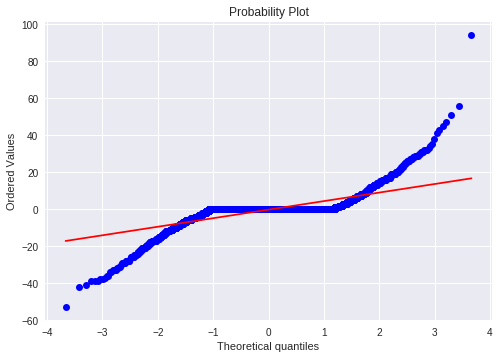

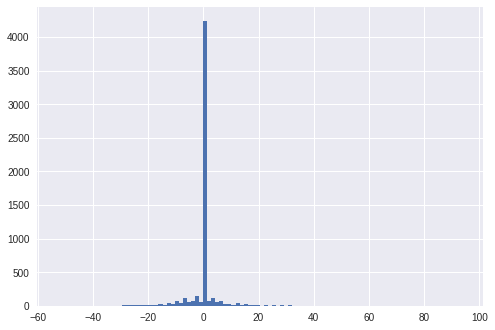

mean=-0.237 stdv=6.171
Statistics=0.562, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1689.934, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


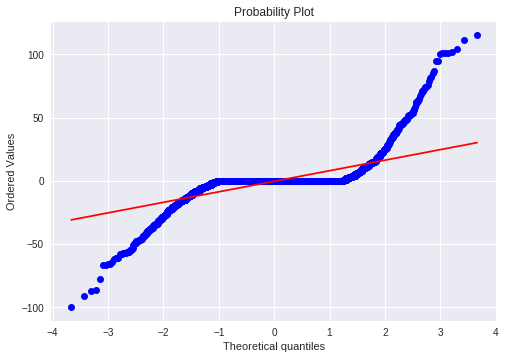

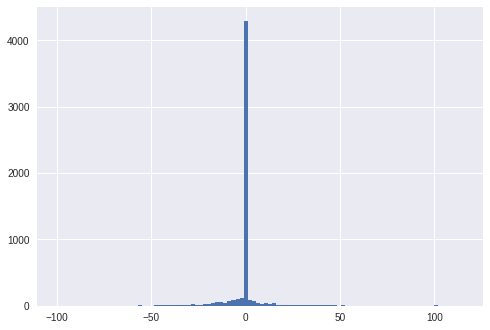

mean=-0.368 stdv=11.806
Statistics=0.499, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2329.867, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


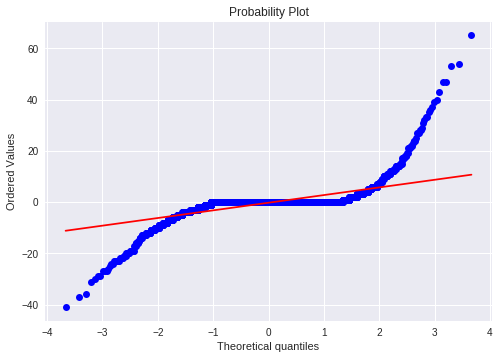

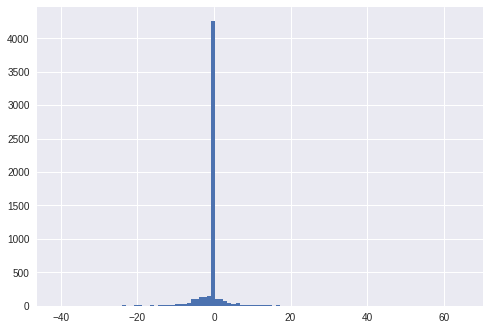

mean=-0.248 stdv=4.380
Statistics=0.465, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3391.587, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)


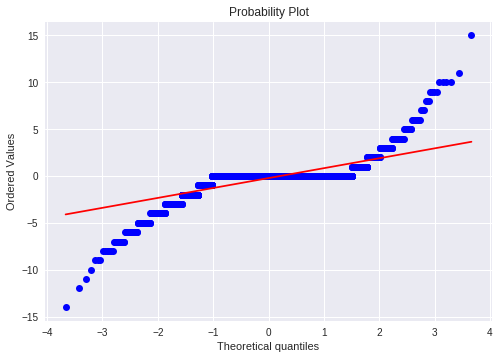

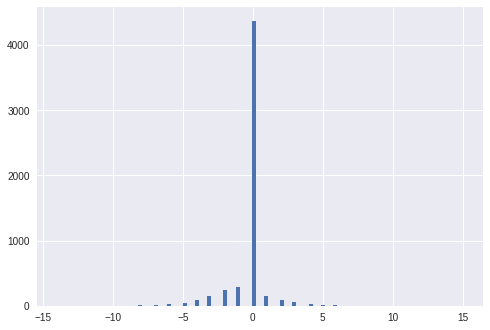

mean=-0.224 stdv=1.404
Statistics=0.568, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1534.528, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.435, p=0.000
Sample does not look Gaussian (reject H0)


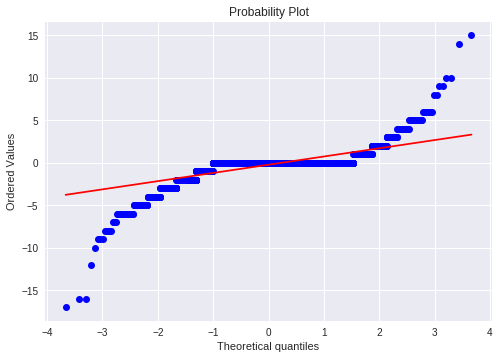

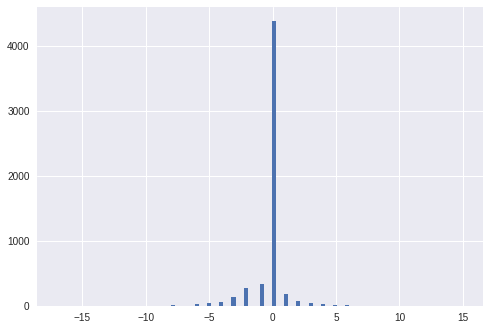

mean=-0.224 stdv=1.316
Statistics=0.541, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2635.506, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.438, p=0.000
Sample does not look Gaussian (reject H0)


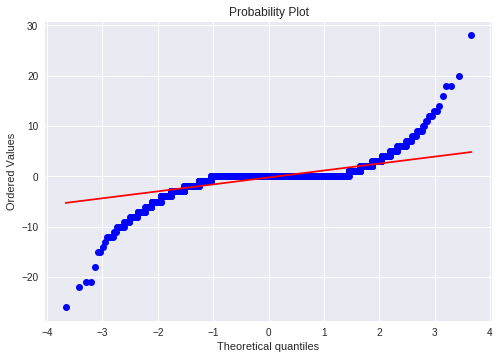

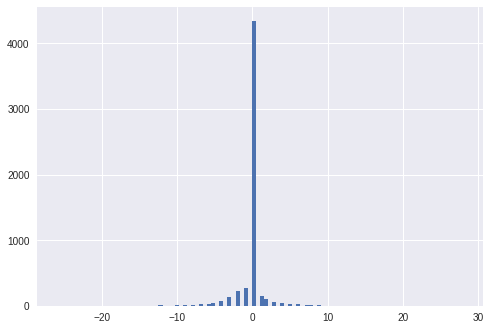

mean=-0.220 stdv=1.938
Statistics=0.507, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2135.737, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)


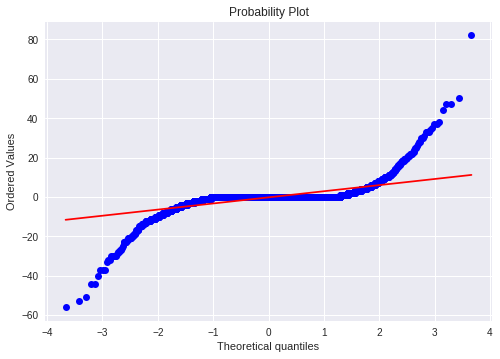

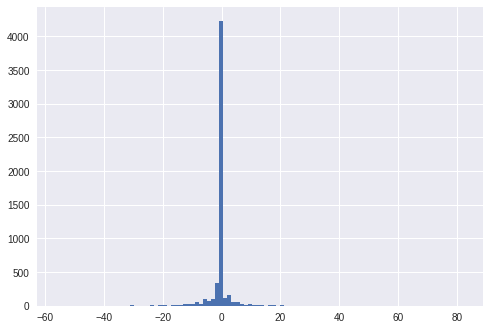

mean=-0.224 stdv=4.697
Statistics=0.439, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2115.370, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)


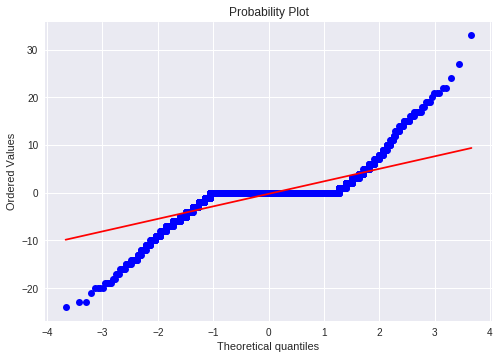

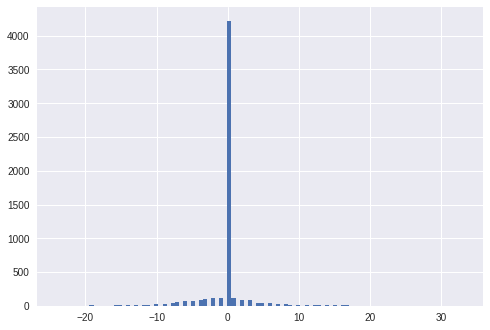

mean=-0.230 stdv=3.443
Statistics=0.581, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1184.623, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


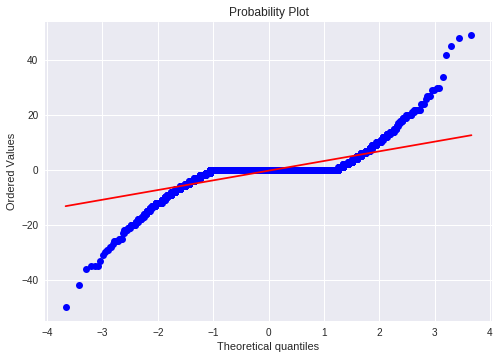

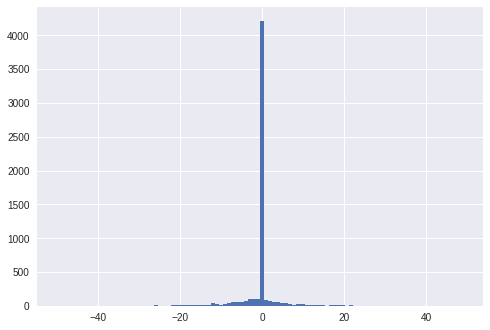

mean=-0.272 stdv=4.767
Statistics=0.548, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1443.943, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


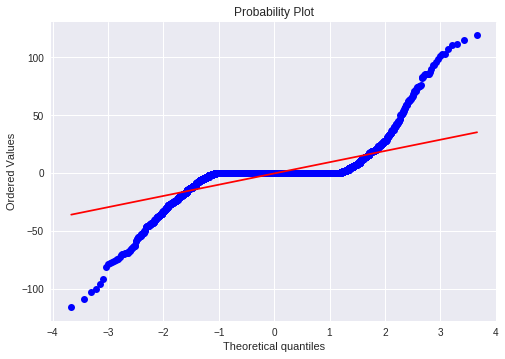

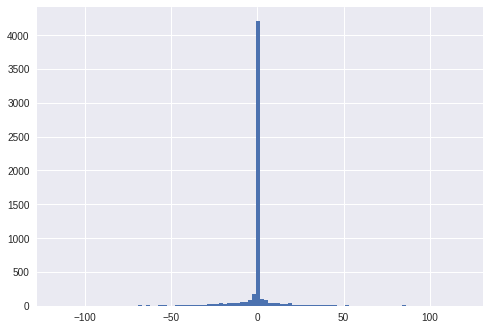

mean=-0.355 stdv=13.649
Statistics=0.507, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1719.115, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


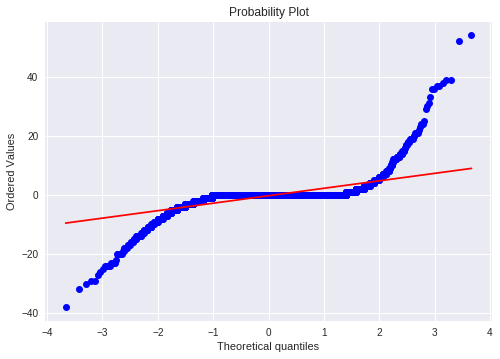

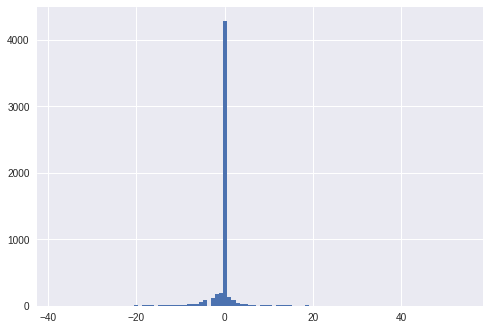

mean=-0.271 stdv=3.800
Statistics=0.443, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3106.565, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.420, p=0.000
Sample does not look Gaussian (reject H0)


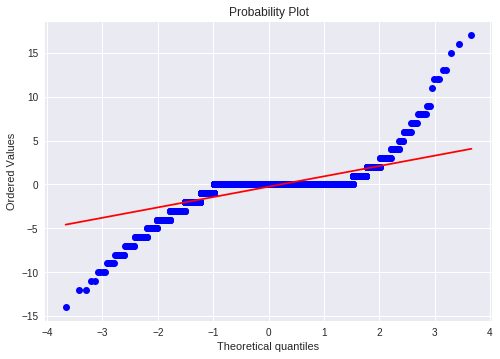

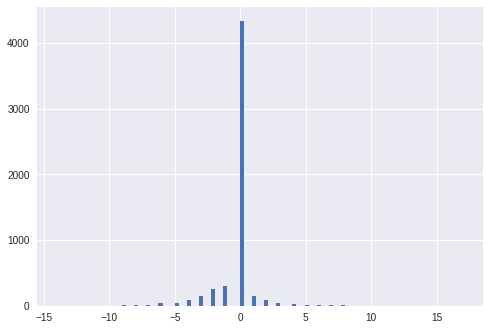

mean=-0.257 stdv=1.587
Statistics=0.554, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1393.167, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.436, p=0.000
Sample does not look Gaussian (reject H0)


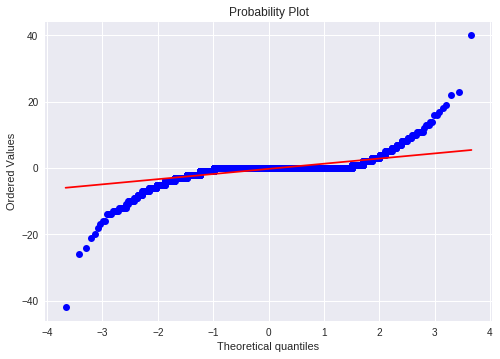

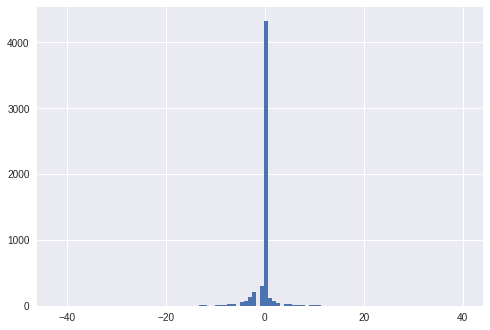

mean=-0.264 stdv=2.272
Statistics=0.470, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2420.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.434, p=0.000
Sample does not look Gaussian (reject H0)


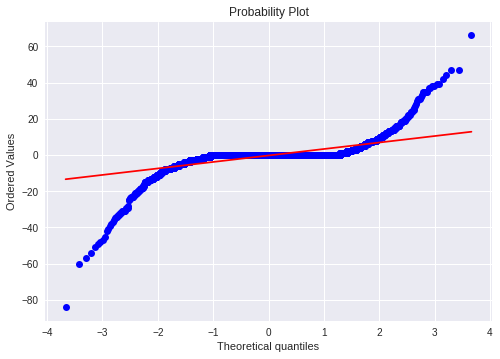

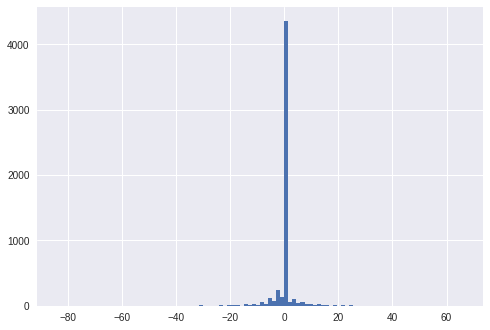

mean=-0.266 stdv=5.348
Statistics=0.448, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2868.778, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


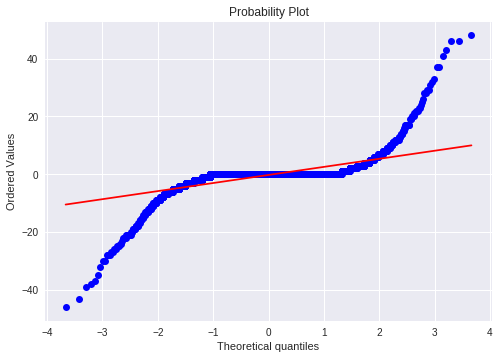

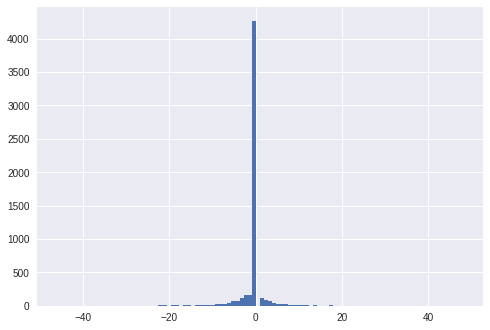

mean=-0.262 stdv=4.154
Statistics=0.453, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1724.574, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


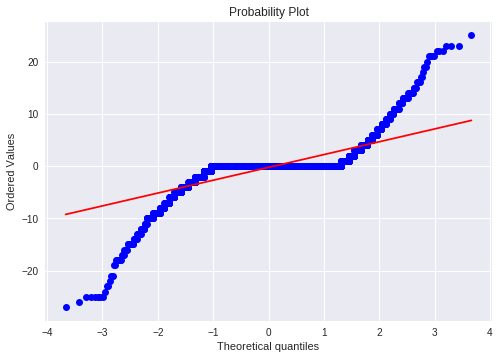

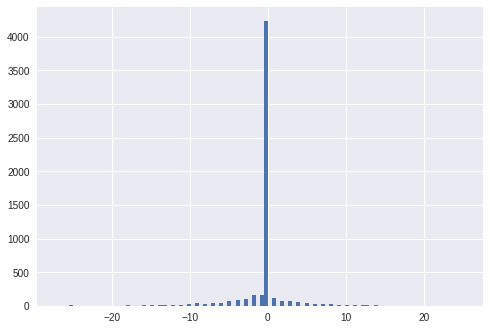

mean=-0.254 stdv=3.310
Statistics=0.550, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1610.123, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


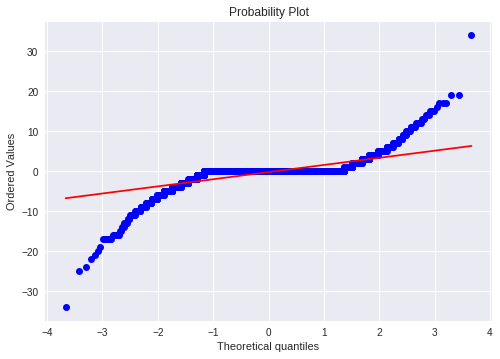

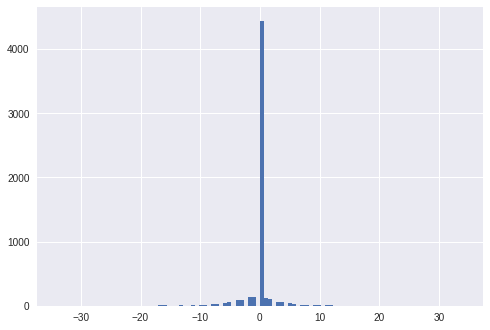

mean=-0.196 stdv=2.524
Statistics=0.501, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2427.293, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.415, p=0.000
Sample does not look Gaussian (reject H0)


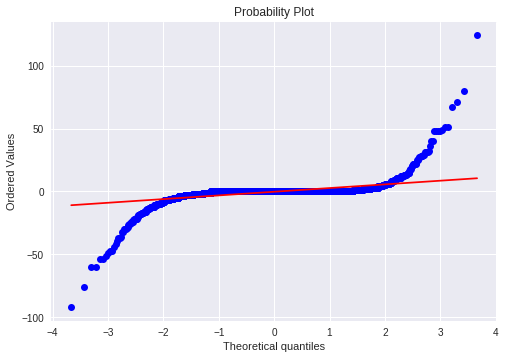

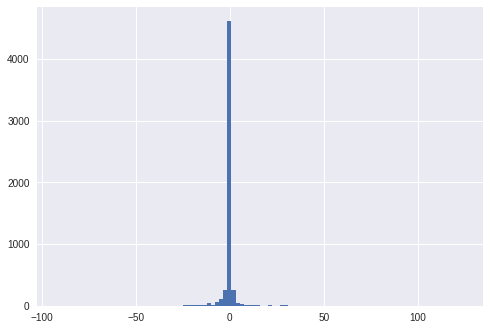

mean=-0.228 stdv=5.354
Statistics=0.300, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3487.206, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.424, p=0.000
Sample does not look Gaussian (reject H0)


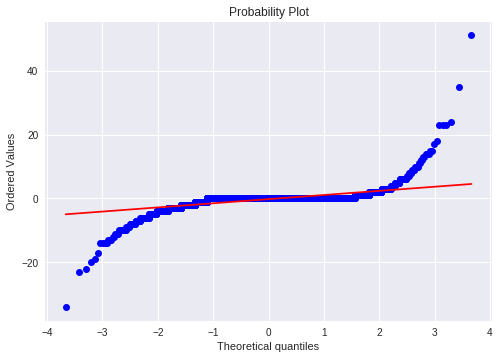

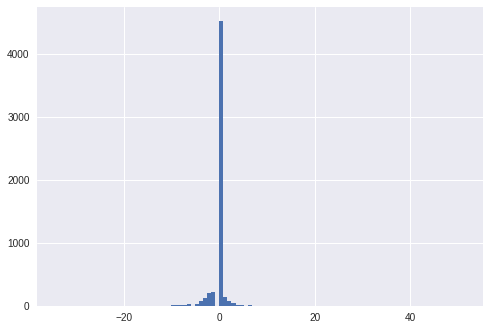

mean=-0.203 stdv=2.092
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4644.358, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.440, p=0.000
Sample does not look Gaussian (reject H0)


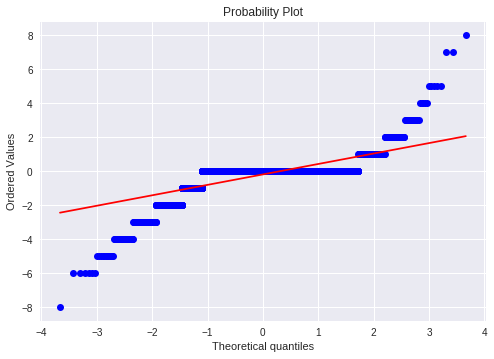

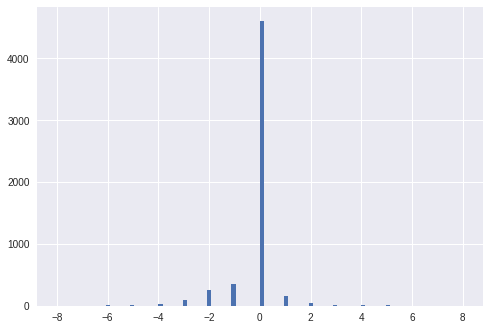

mean=-0.183 stdv=0.849
Statistics=0.524, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2353.578, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.458, p=0.000
Sample does not look Gaussian (reject H0)


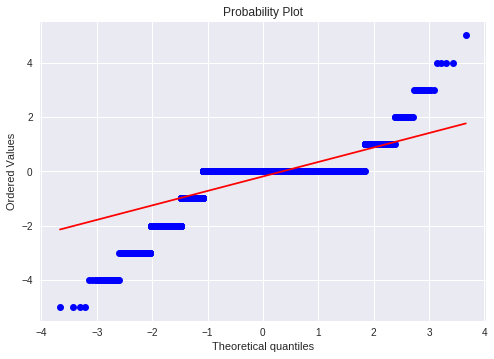

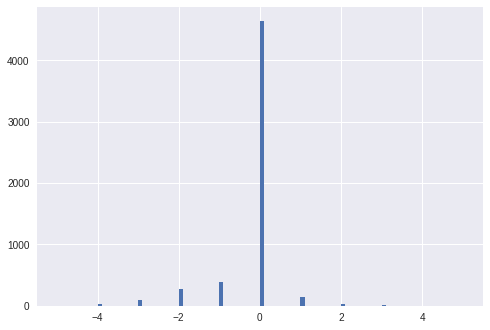

mean=-0.189 stdv=0.734
Statistics=0.526, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2450.165, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.467, p=0.000
Sample does not look Gaussian (reject H0)


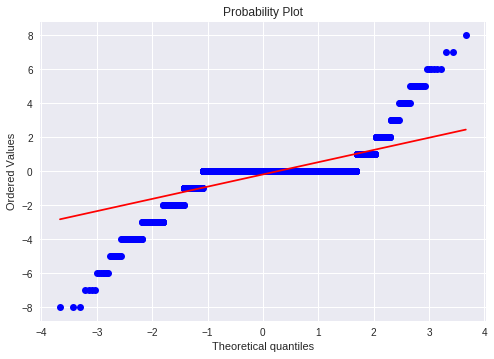

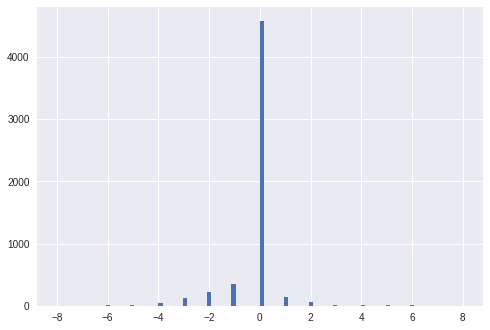

mean=-0.184 stdv=0.993
Statistics=0.527, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1889.112, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.455, p=0.000
Sample does not look Gaussian (reject H0)


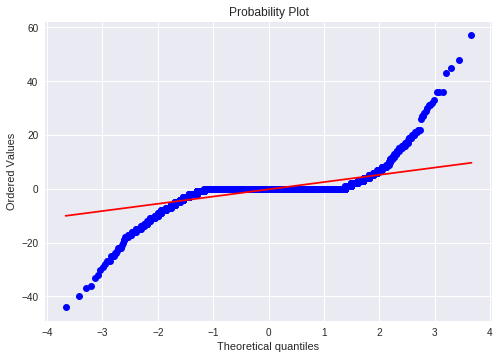

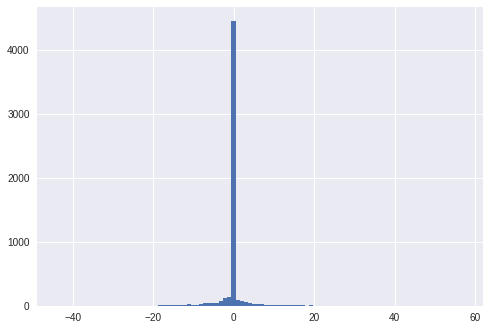

mean=-0.190 stdv=4.068
Statistics=0.438, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2214.460, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


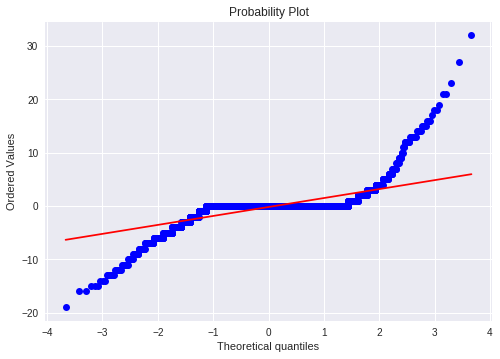

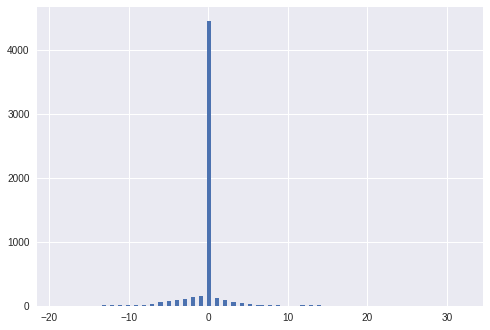

mean=-0.197 stdv=2.382
Statistics=0.498, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2412.084, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.425, p=0.000
Sample does not look Gaussian (reject H0)


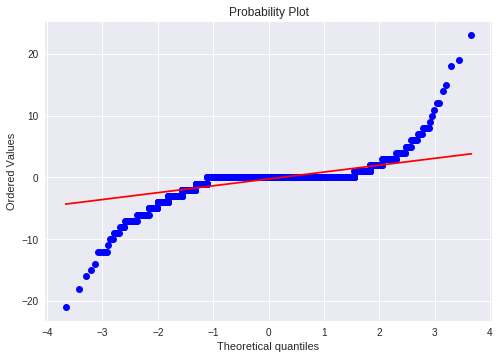

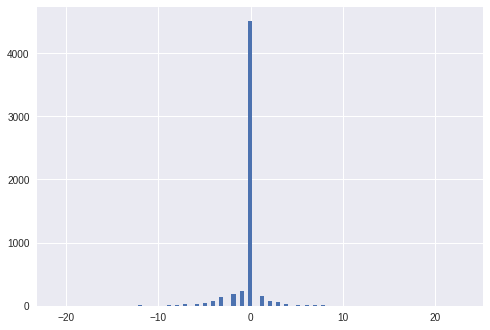

mean=-0.234 stdv=1.609
Statistics=0.478, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2170.776, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.440, p=0.000
Sample does not look Gaussian (reject H0)


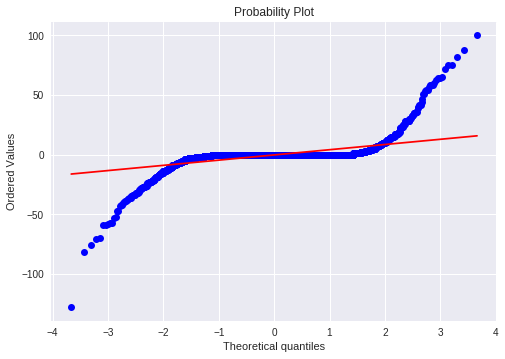

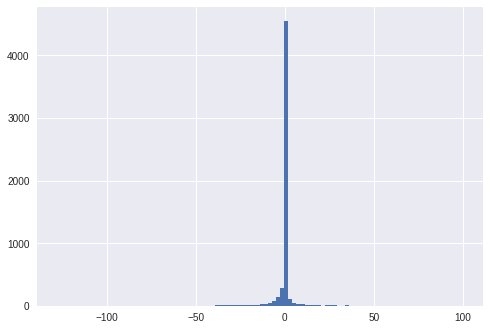

mean=-0.259 stdv=7.406
Statistics=0.350, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2019.341, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.424, p=0.000
Sample does not look Gaussian (reject H0)


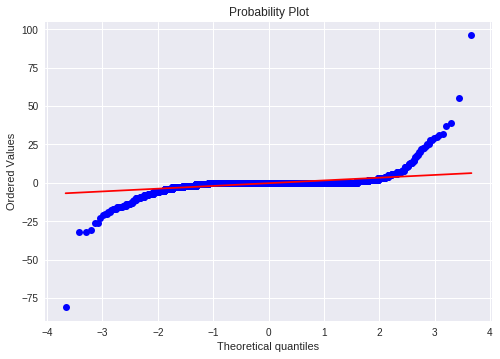

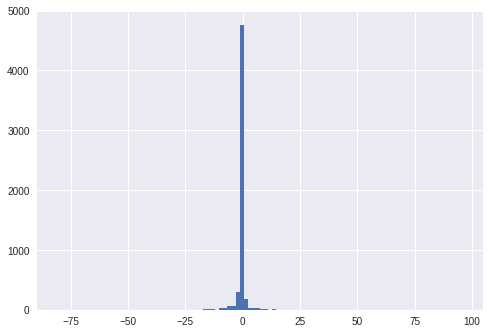

mean=-0.234 stdv=3.289
Statistics=0.298, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=5344.392, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.445, p=0.000
Sample does not look Gaussian (reject H0)


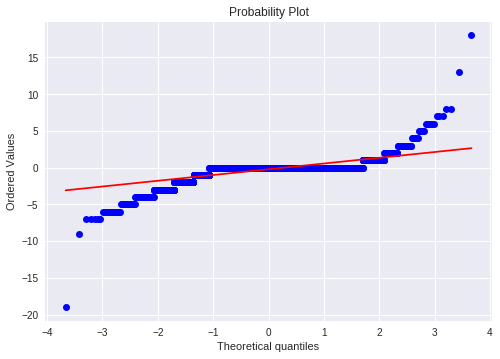

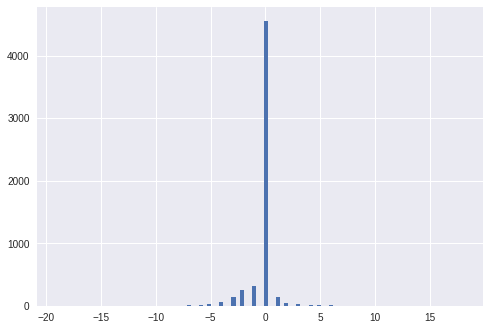

mean=-0.221 stdv=1.109
Statistics=0.500, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2312.037, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.456, p=0.000
Sample does not look Gaussian (reject H0)


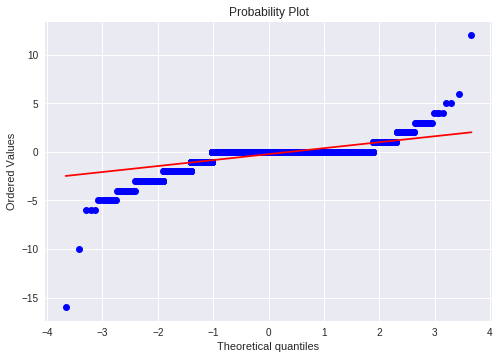

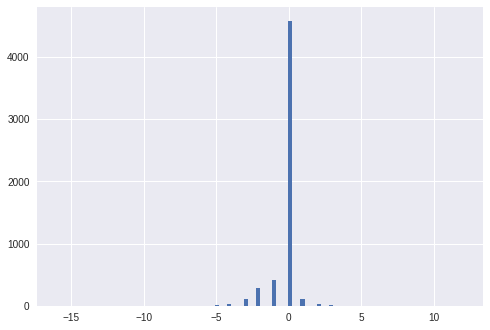

mean=-0.230 stdv=0.865
Statistics=0.504, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3720.599, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.471, p=0.000
Sample does not look Gaussian (reject H0)


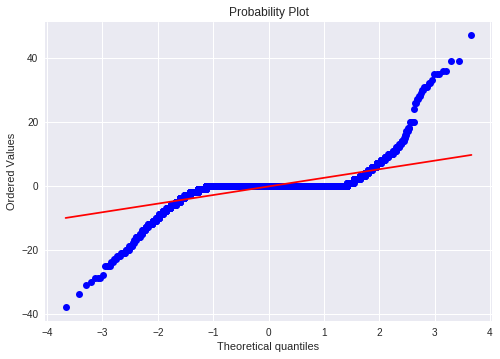

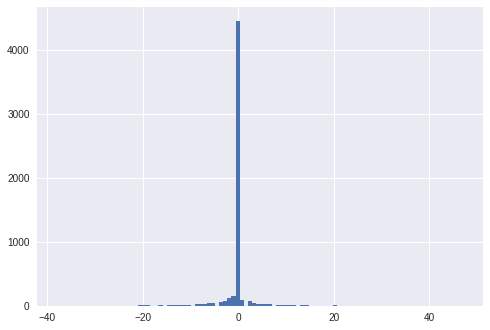

mean=-0.232 stdv=4.033
Statistics=0.445, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2045.167, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.423, p=0.000
Sample does not look Gaussian (reject H0)


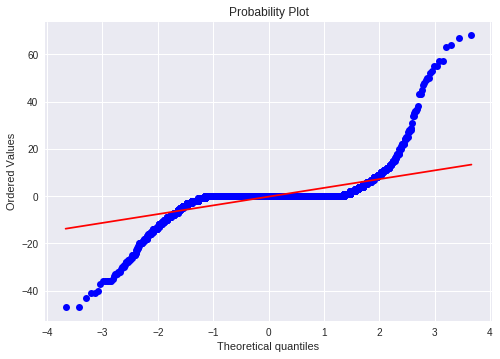

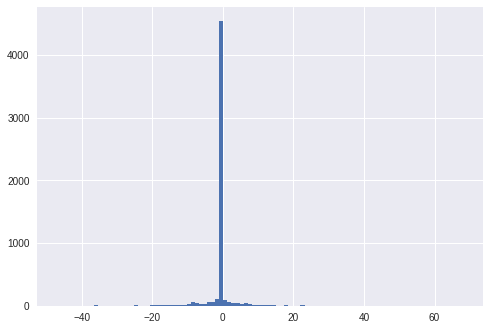

mean=-0.221 stdv=5.755
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3169.990, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


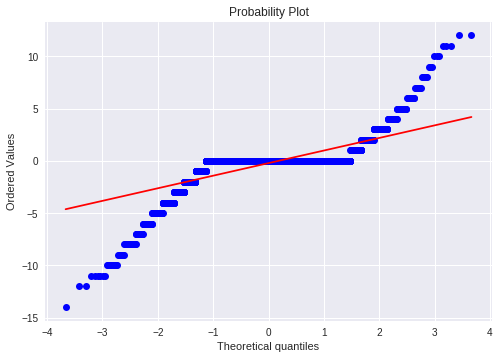

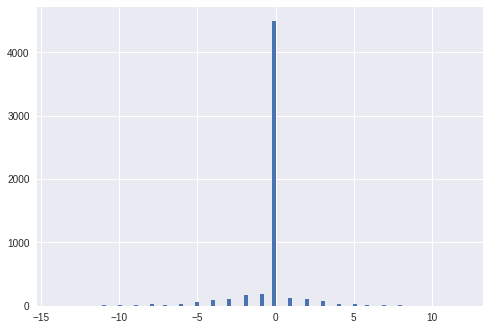

mean=-0.216 stdv=1.646
Statistics=0.535, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2182.329, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.431, p=0.000
Sample does not look Gaussian (reject H0)


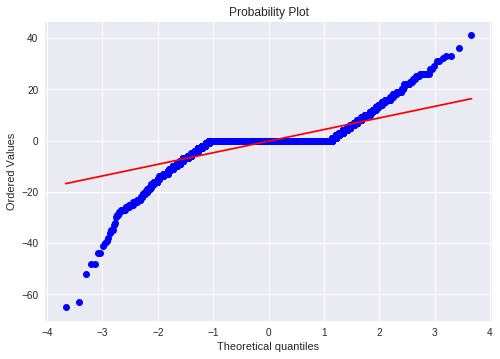

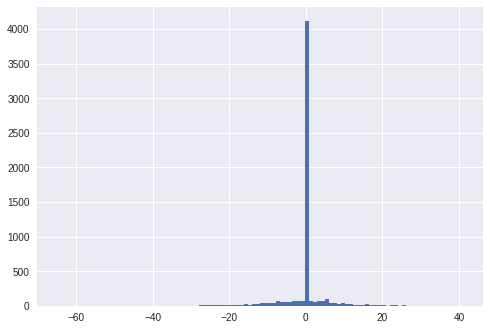

mean=-0.241 stdv=5.875
Statistics=0.593, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2230.239, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.376, p=0.000
Sample does not look Gaussian (reject H0)


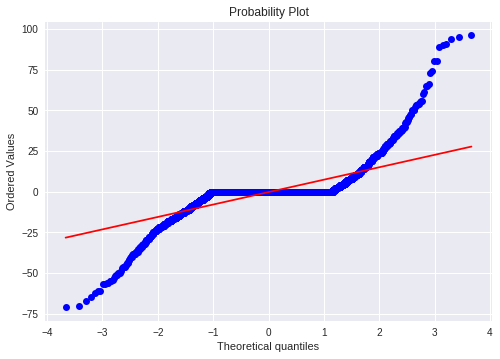

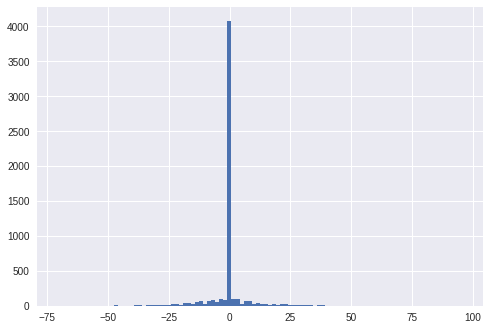

mean=-0.279 stdv=10.114
Statistics=0.570, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1949.346, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


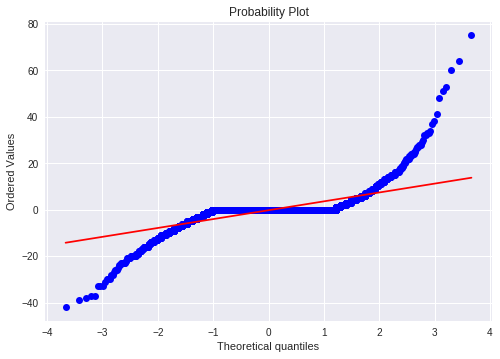

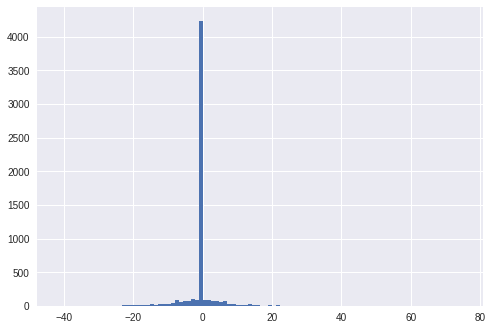

mean=-0.252 stdv=5.200
Statistics=0.540, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2680.131, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


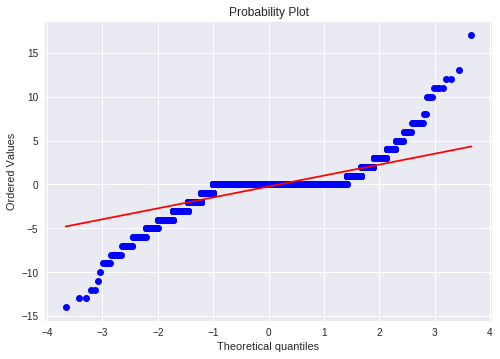

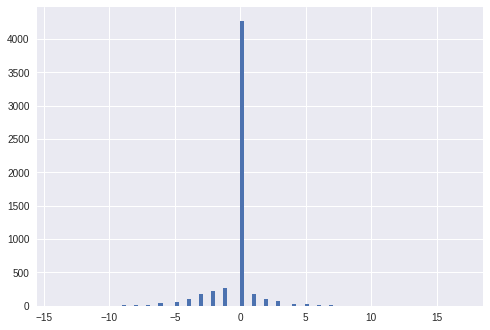

mean=-0.233 stdv=1.621
Statistics=0.591, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1366.898, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.421, p=0.000
Sample does not look Gaussian (reject H0)


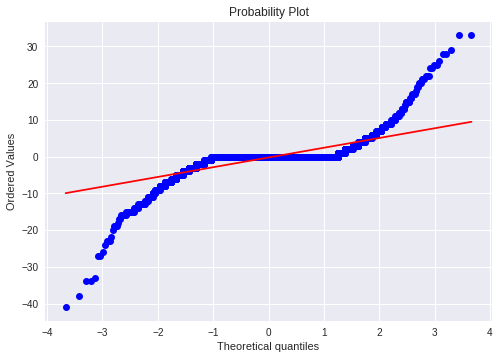

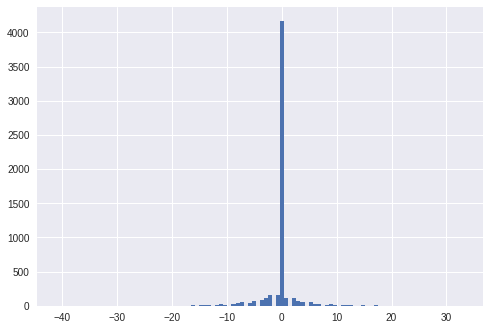

mean=-0.236 stdv=3.601
Statistics=0.543, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1751.046, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


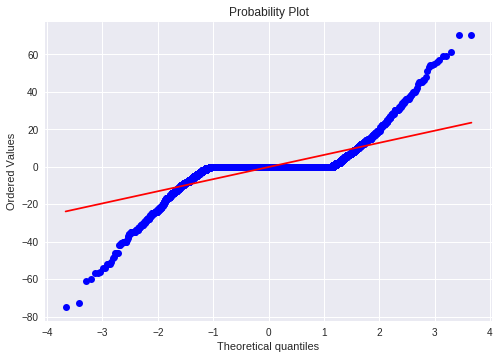

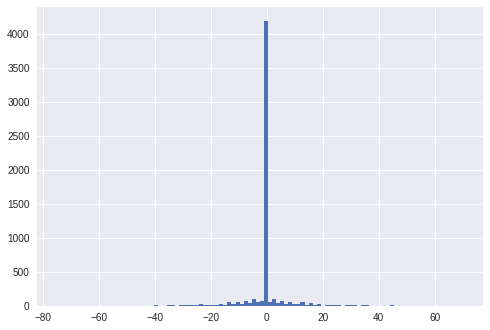

mean=-0.229 stdv=8.616
Statistics=0.563, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1288.097, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.378, p=0.000
Sample does not look Gaussian (reject H0)


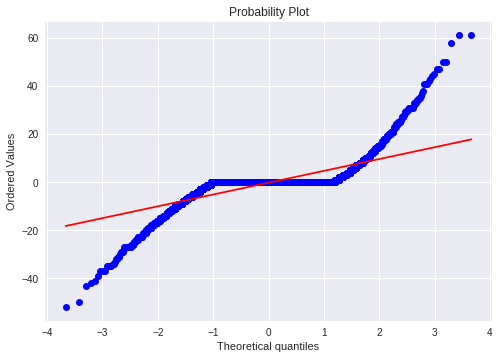

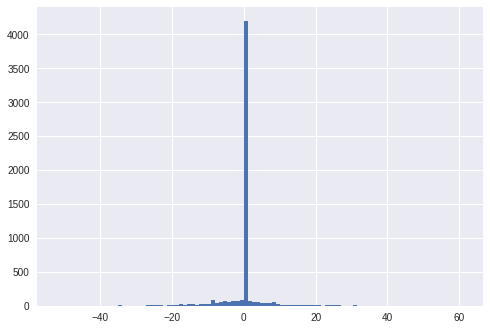

mean=-0.229 stdv=6.529
Statistics=0.567, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1637.697, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


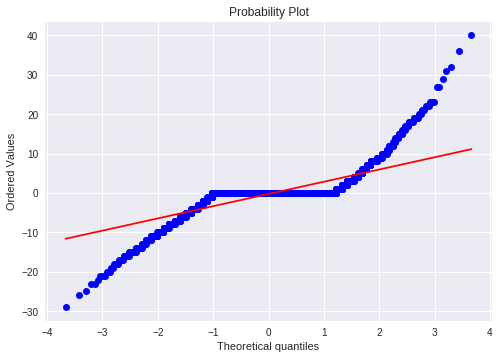

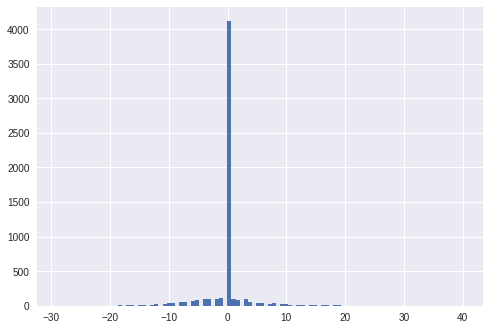

mean=-0.248 stdv=3.978
Statistics=0.609, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1390.136, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


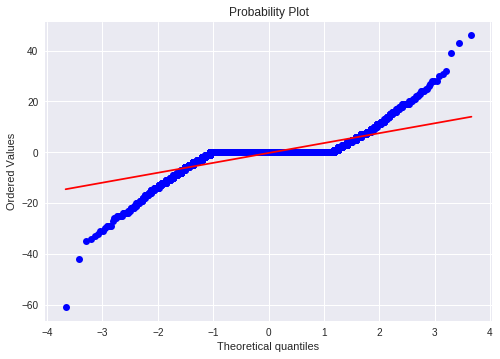

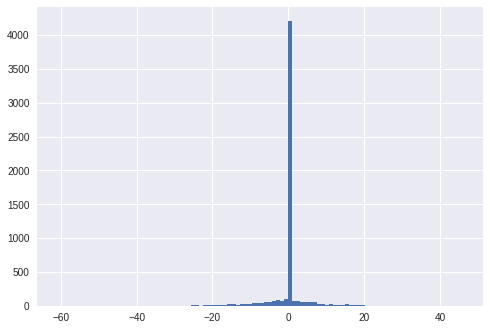

mean=-0.284 stdv=5.077
Statistics=0.589, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1627.974, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


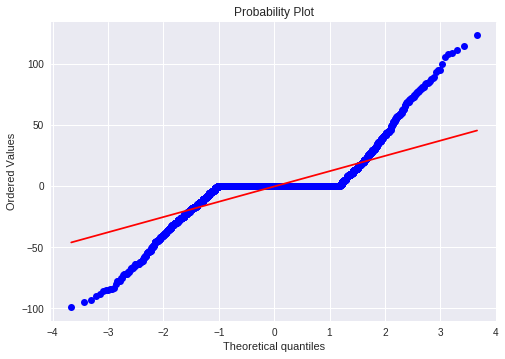

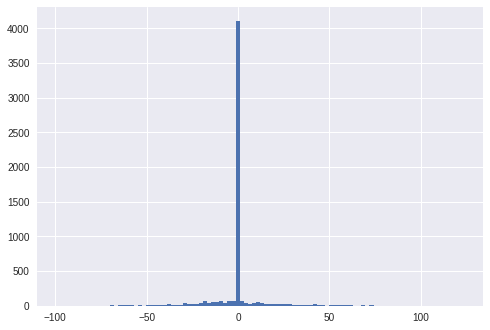

mean=-0.383 stdv=16.088
Statistics=0.601, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1330.008, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


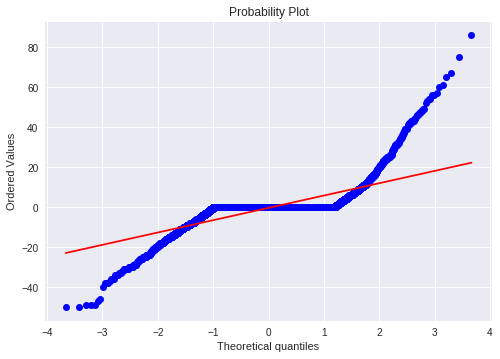

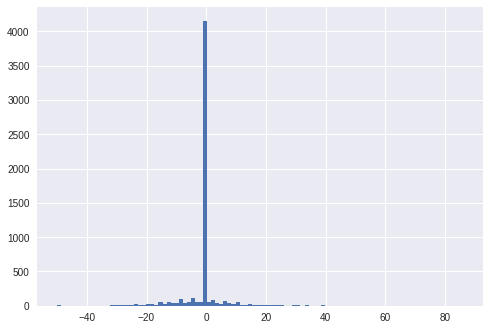

mean=-0.291 stdv=8.118
Statistics=0.577, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2275.918, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


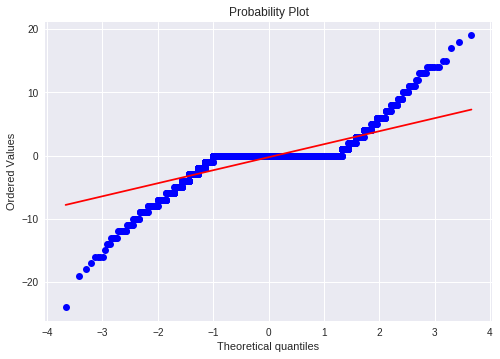

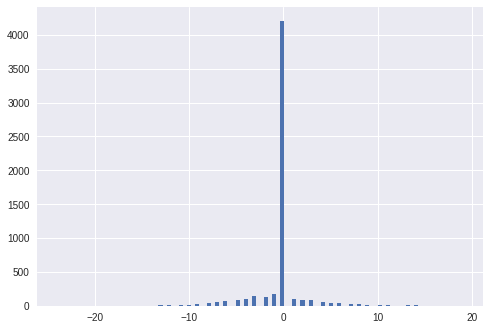

mean=-0.273 stdv=2.635
Statistics=0.611, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1263.398, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


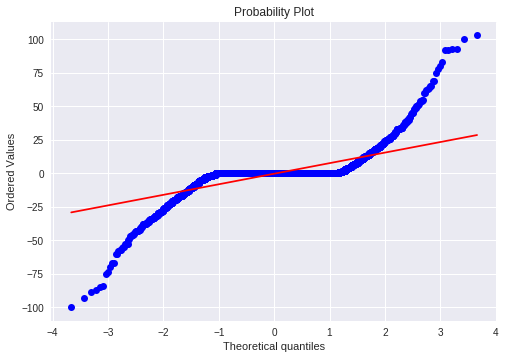

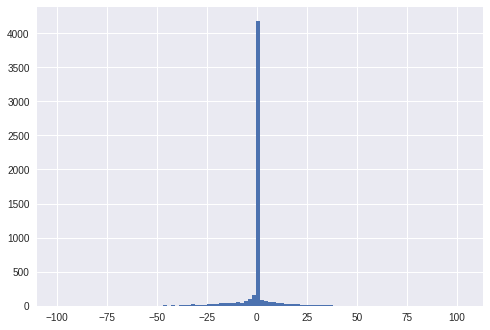

mean=-0.297 stdv=10.783
Statistics=0.535, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1477.705, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


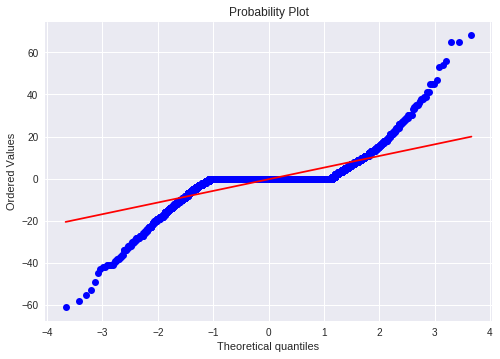

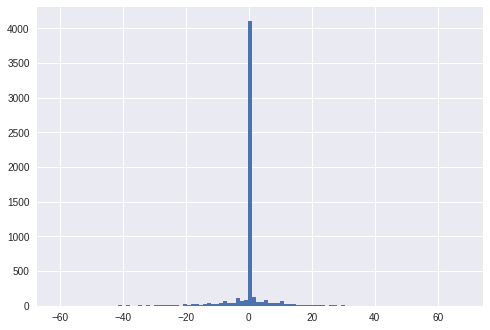

mean=-0.274 stdv=7.288
Statistics=0.575, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1307.179, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


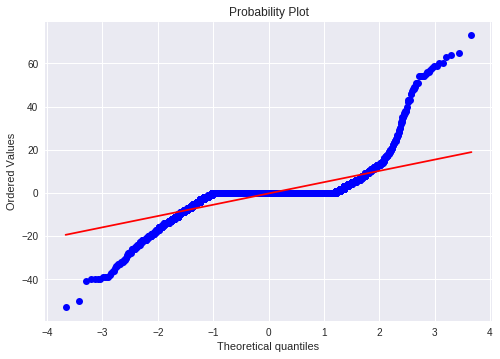

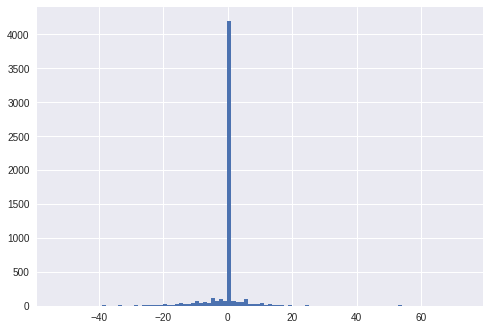

mean=-0.272 stdv=7.270
Statistics=0.518, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3039.973, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


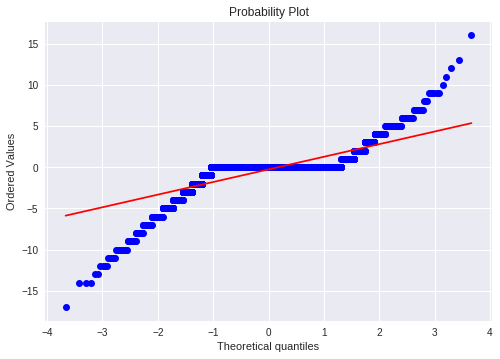

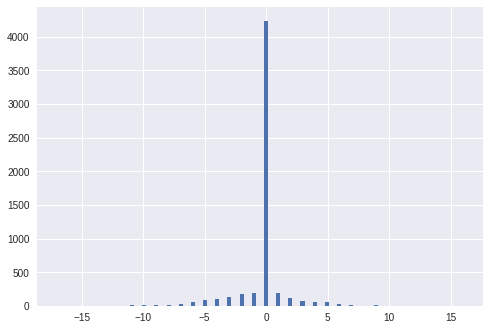

mean=-0.267 stdv=1.970
Statistics=0.605, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2085.768, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


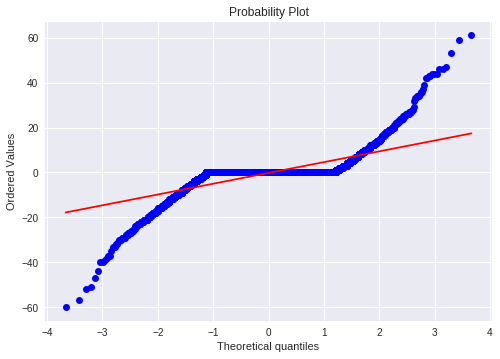

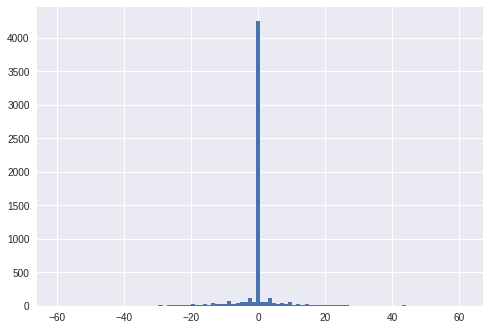

mean=-0.219 stdv=6.470
Statistics=0.552, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1348.063, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


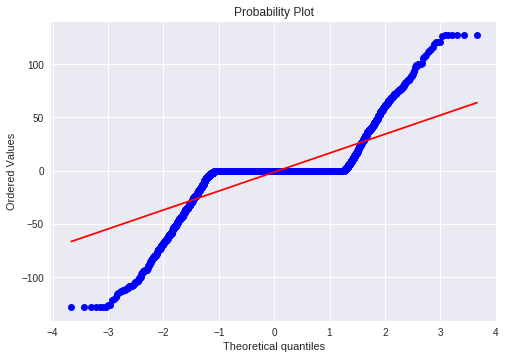

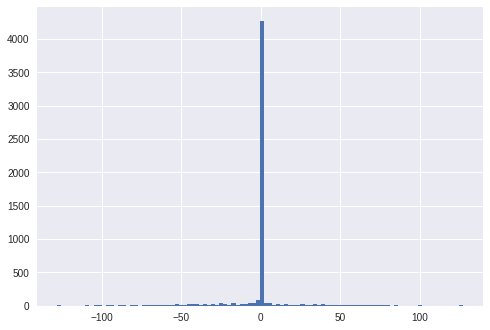

mean=-1.219 stdv=23.426
Statistics=0.576, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1108.649, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


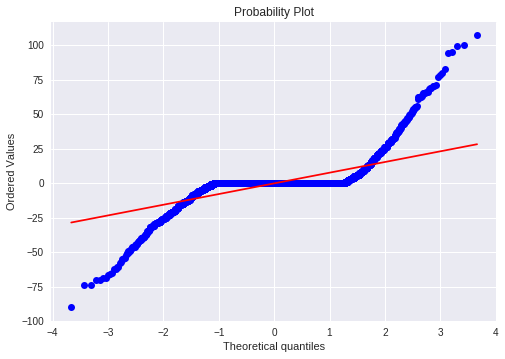

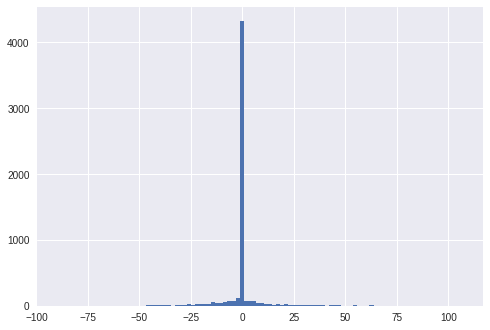

mean=-0.245 stdv=10.873
Statistics=0.507, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2081.465, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


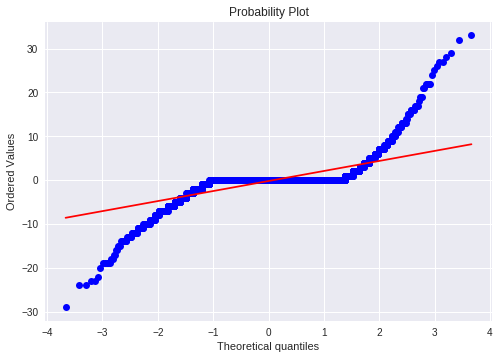

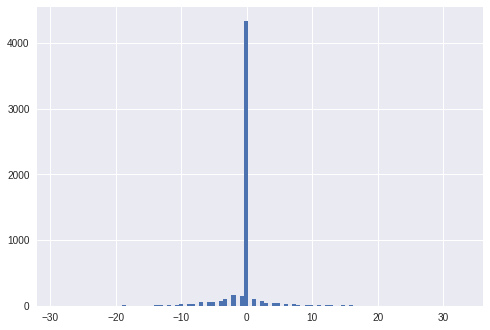

mean=-0.213 stdv=3.184
Statistics=0.517, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1908.697, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


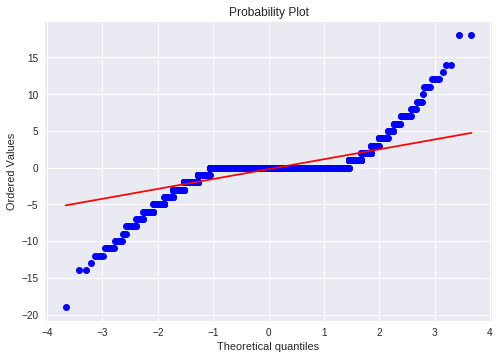

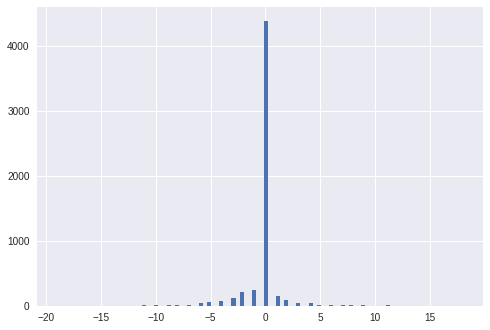

mean=-0.203 stdv=1.836
Statistics=0.538, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1470.641, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)


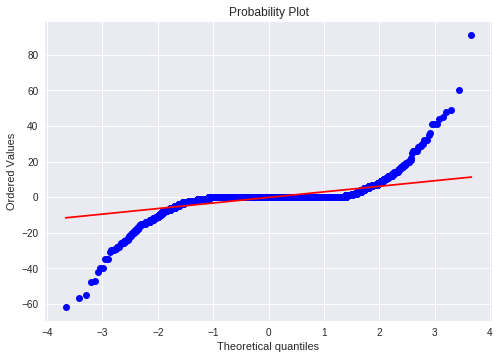

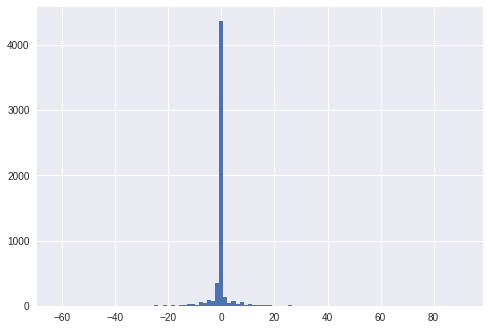

mean=-0.207 stdv=4.912
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2314.890, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)


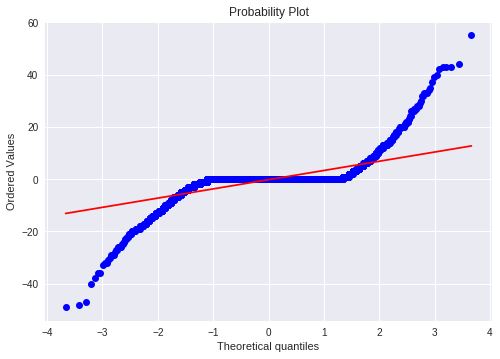

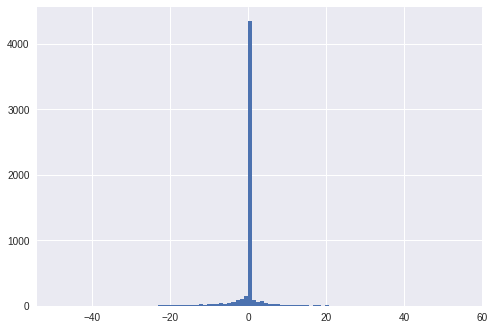

mean=-0.205 stdv=5.069
Statistics=0.485, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1574.658, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)


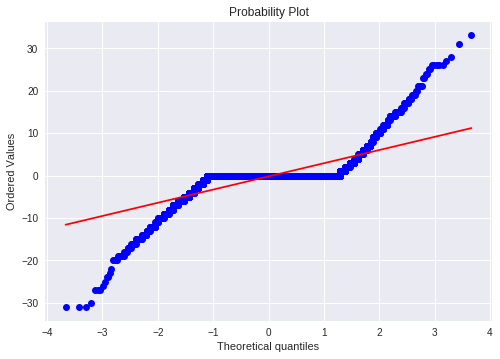

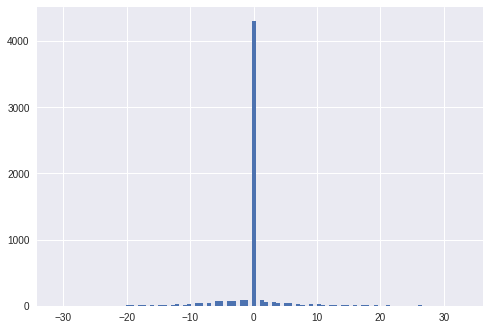

mean=-0.200 stdv=4.131
Statistics=0.565, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1185.114, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.401, p=0.000
Sample does not look Gaussian (reject H0)


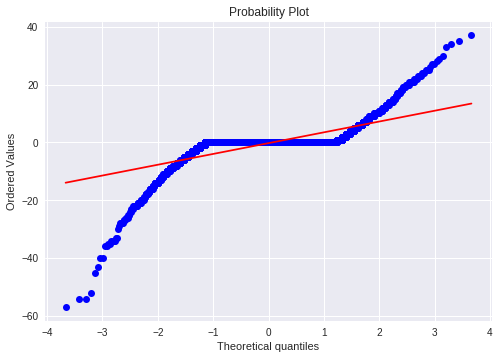

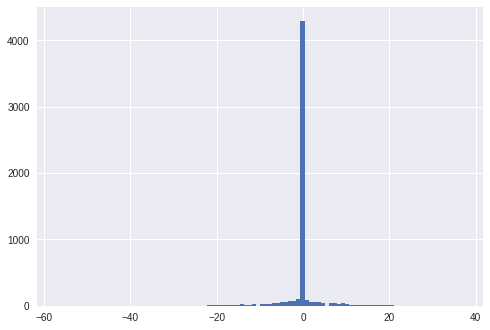

mean=-0.256 stdv=5.165
Statistics=0.524, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2889.251, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


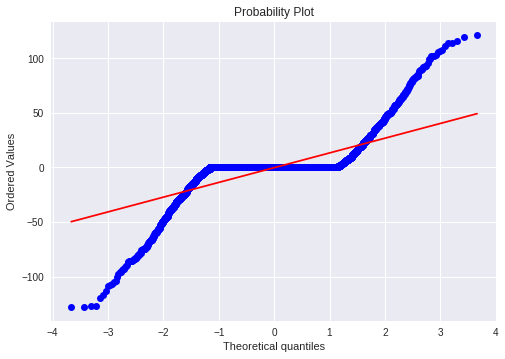

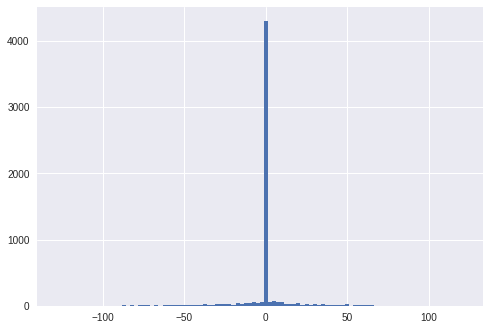

mean=-0.174 stdv=18.273
Statistics=0.546, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1241.329, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.378, p=0.000
Sample does not look Gaussian (reject H0)


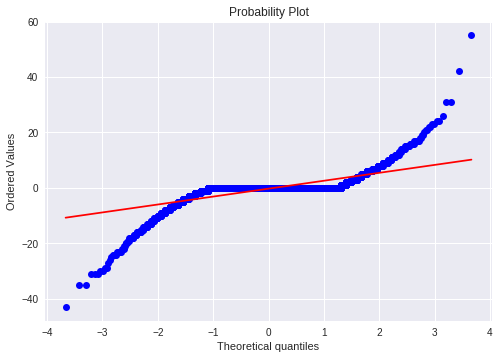

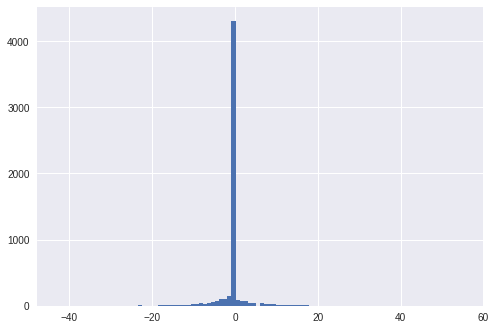

mean=-0.257 stdv=3.981
Statistics=0.516, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1925.968, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.405, p=0.000
Sample does not look Gaussian (reject H0)


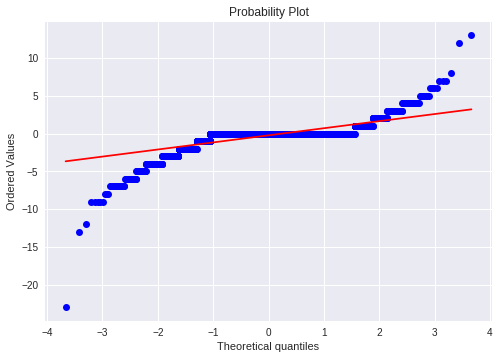

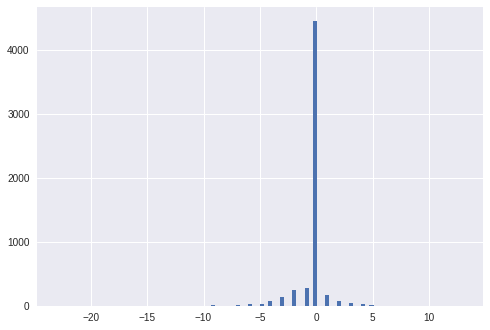

mean=-0.233 stdv=1.286
Statistics=0.535, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3613.192, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.440, p=0.000
Sample does not look Gaussian (reject H0)


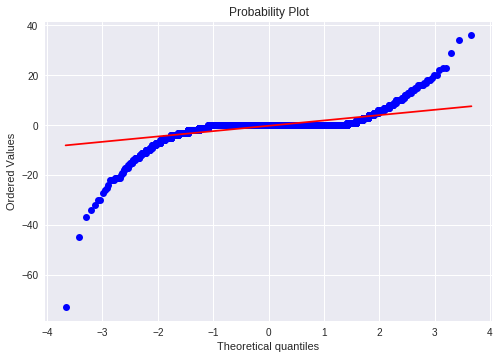

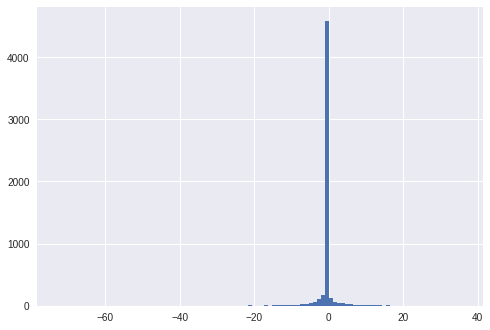

mean=-0.249 stdv=3.284
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4897.410, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.422, p=0.000
Sample does not look Gaussian (reject H0)


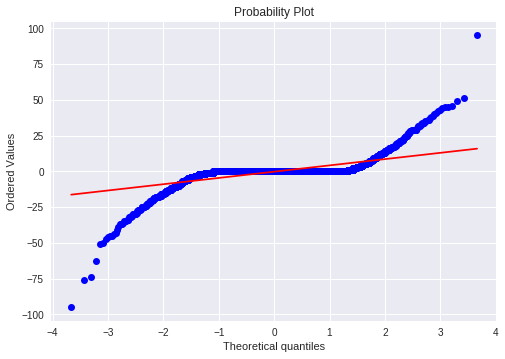

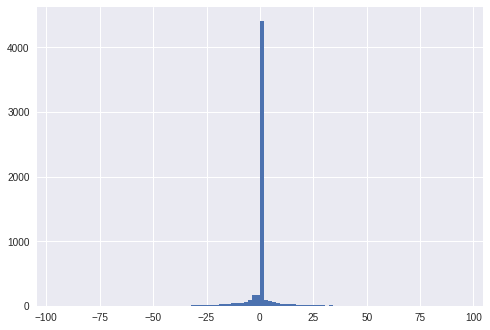

mean=-0.244 stdv=6.512
Statistics=0.455, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2143.967, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


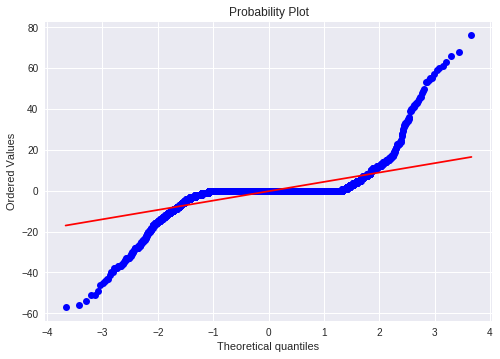

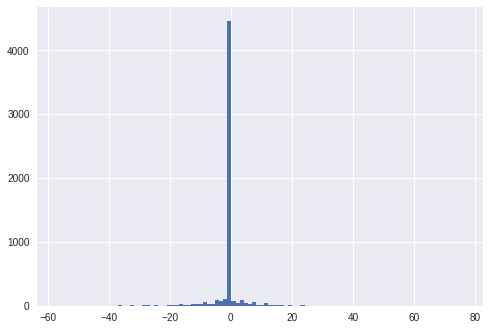

mean=-0.251 stdv=6.837
Statistics=0.449, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2250.575, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


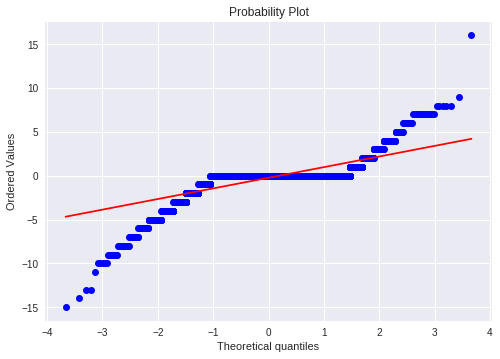

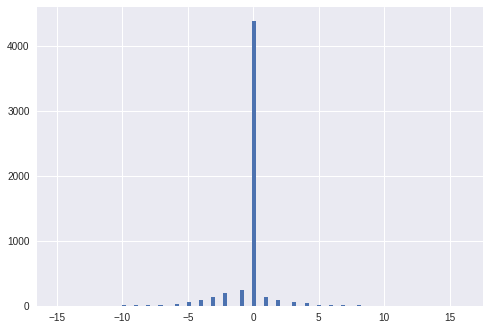

mean=-0.236 stdv=1.608
Statistics=0.569, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2054.024, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.430, p=0.000
Sample does not look Gaussian (reject H0)


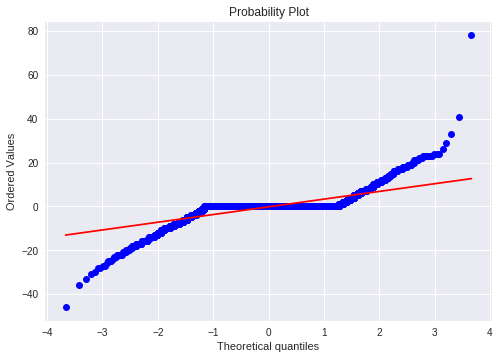

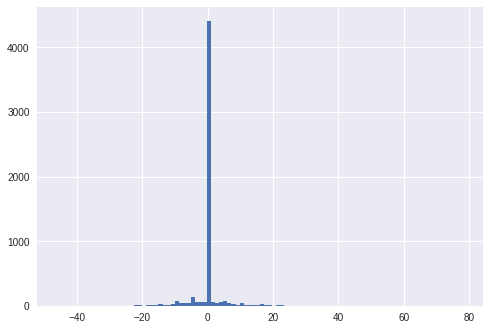

mean=-0.208 stdv=4.703
Statistics=0.559, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1670.699, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


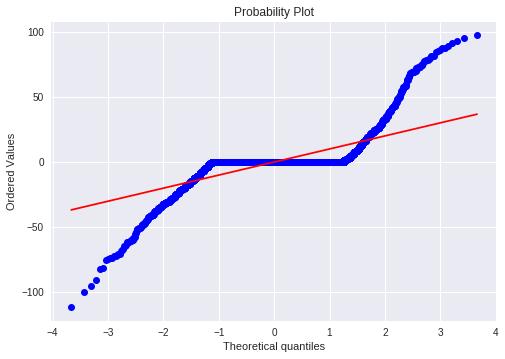

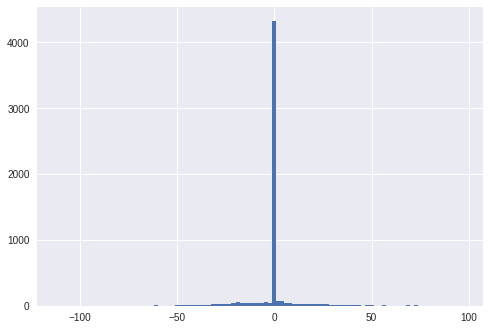

mean=-0.370 stdv=13.641
Statistics=0.542, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1471.857, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


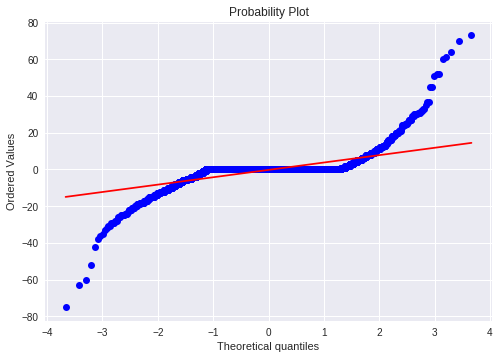

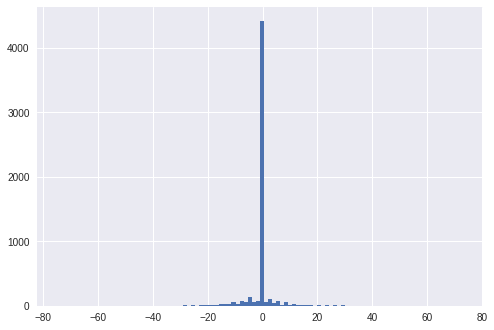

mean=-0.225 stdv=5.781
Statistics=0.483, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2344.461, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


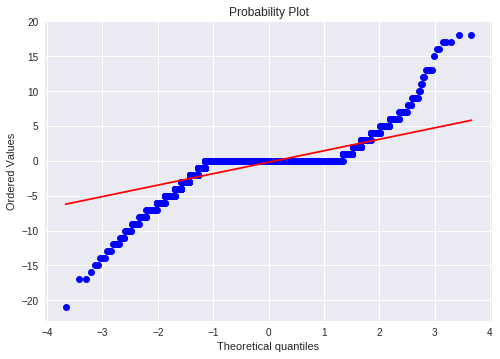

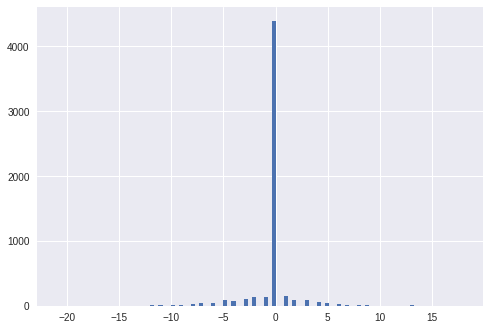

mean=-0.196 stdv=2.209
Statistics=0.554, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1607.279, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


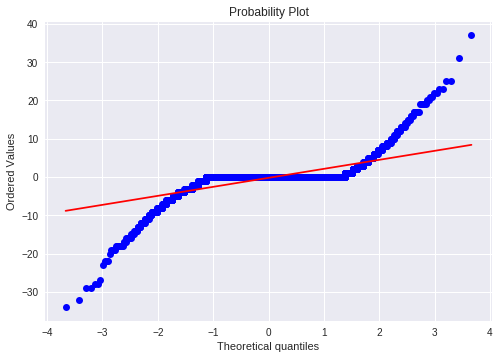

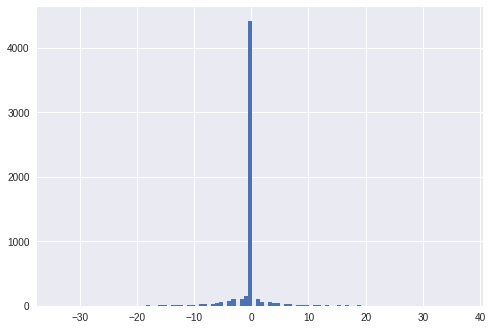

mean=-0.205 stdv=3.344
Statistics=0.495, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1651.443, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


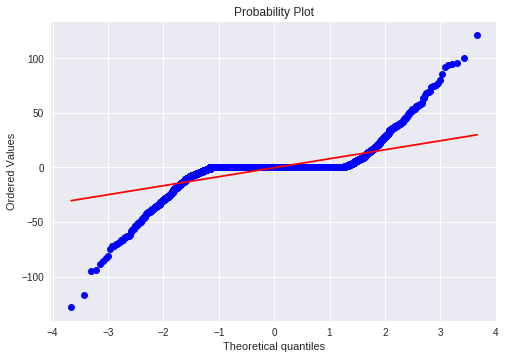

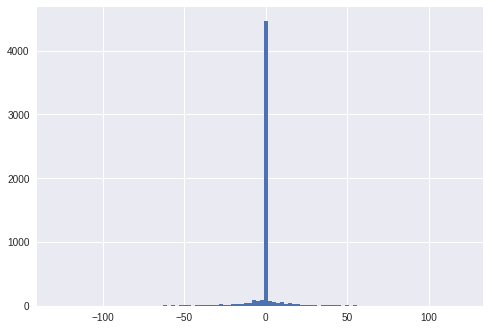

mean=-0.214 stdv=11.913
Statistics=0.478, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1477.405, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


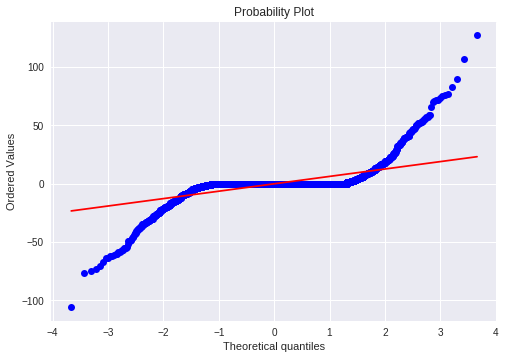

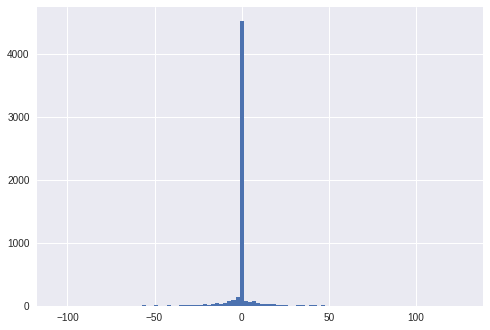

mean=-0.215 stdv=9.553
Statistics=0.442, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2071.510, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


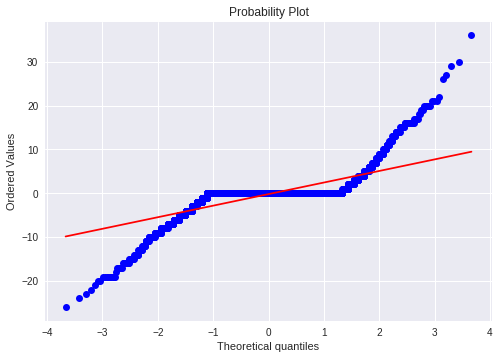

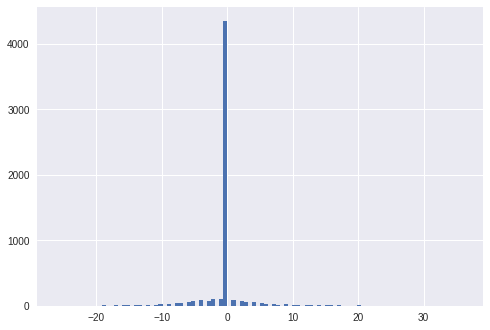

mean=-0.197 stdv=3.557
Statistics=0.551, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1386.832, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


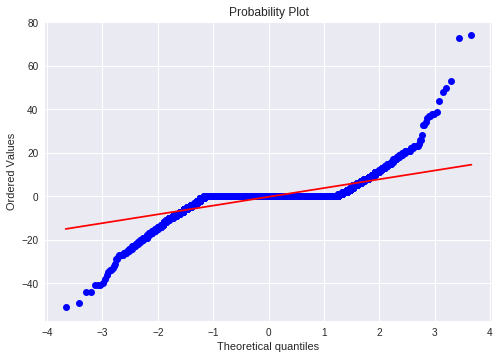

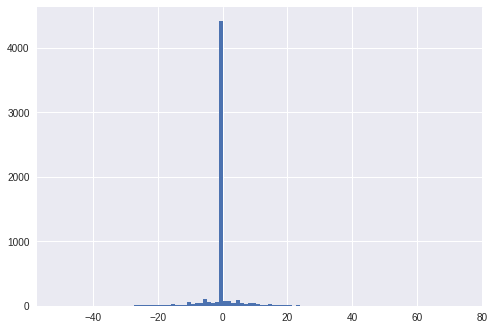

mean=-0.235 stdv=5.623
Statistics=0.516, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1668.977, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


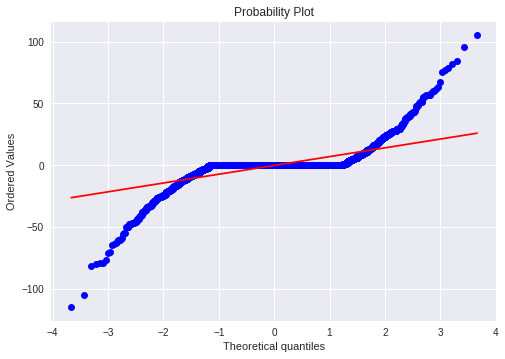

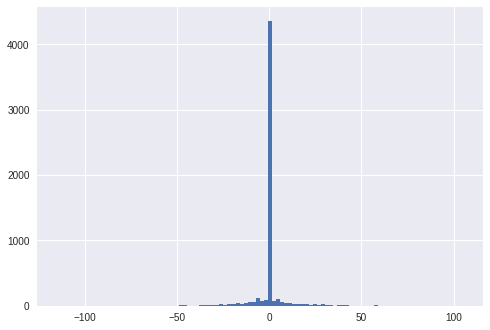

mean=-0.239 stdv=10.064
Statistics=0.501, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1581.246, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


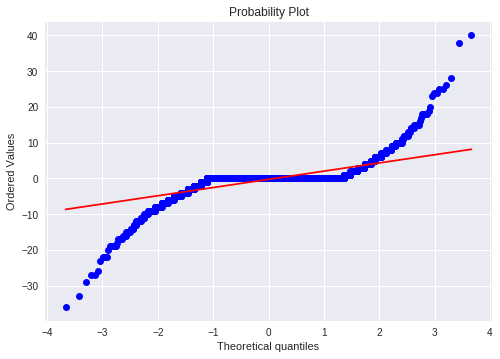

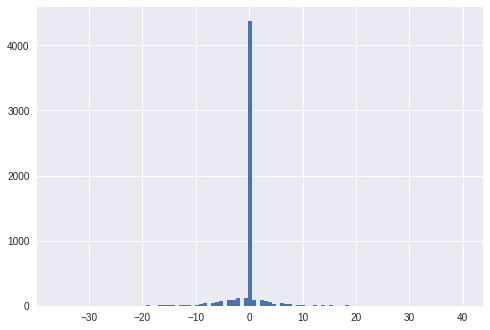

mean=-0.245 stdv=3.219
Statistics=0.508, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1641.670, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


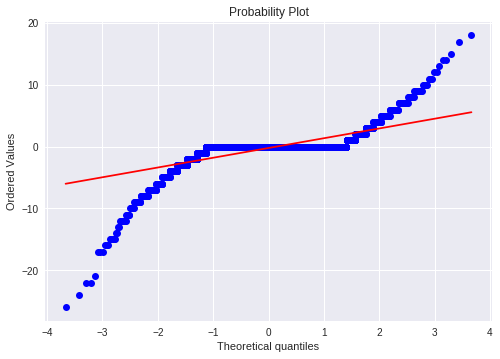

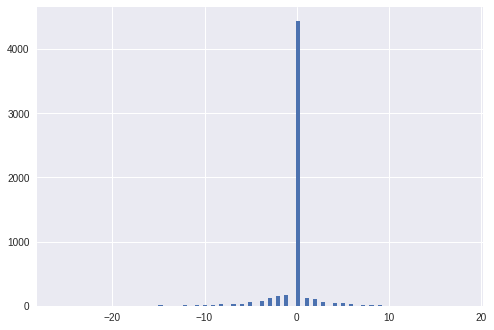

mean=-0.224 stdv=2.204
Statistics=0.514, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3139.584, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.421, p=0.000
Sample does not look Gaussian (reject H0)


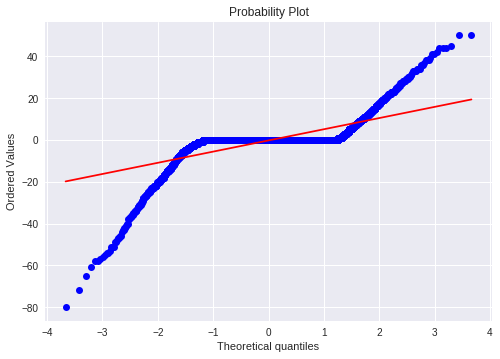

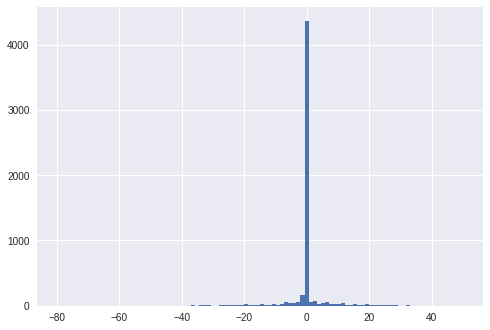

mean=-0.231 stdv=7.586
Statistics=0.498, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2619.150, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


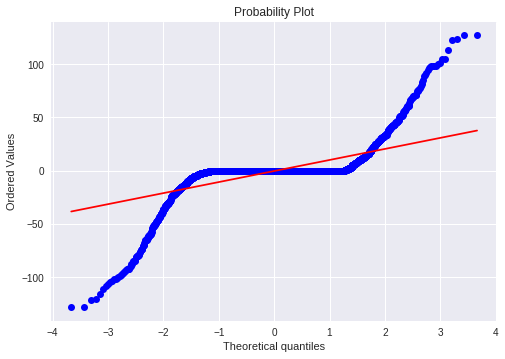

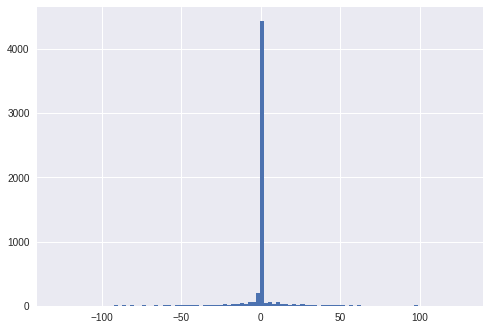

mean=-0.231 stdv=15.502
Statistics=0.447, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1763.588, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


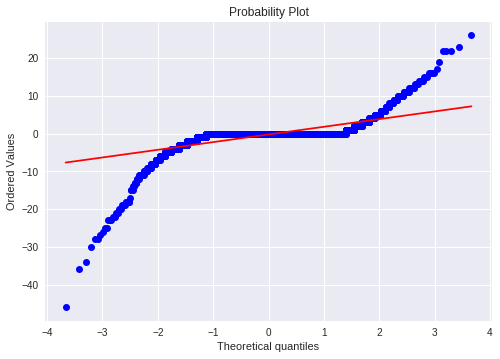

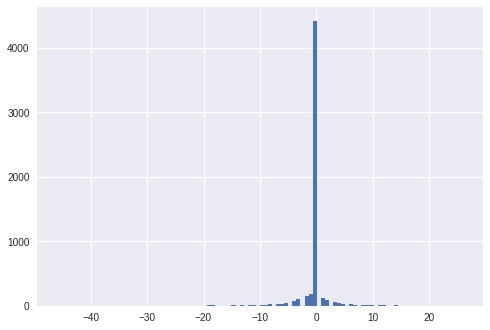

mean=-0.235 stdv=3.019
Statistics=0.454, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4021.256, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


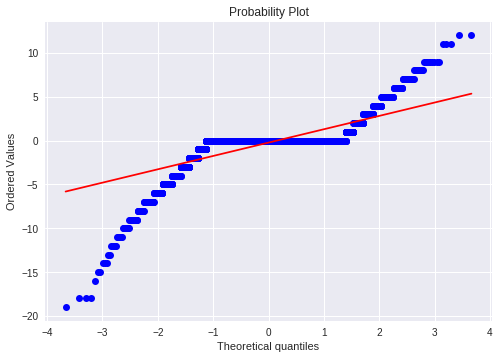

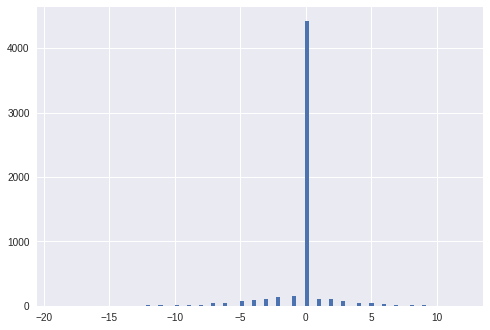

mean=-0.225 stdv=2.039
Statistics=0.558, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2556.415, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


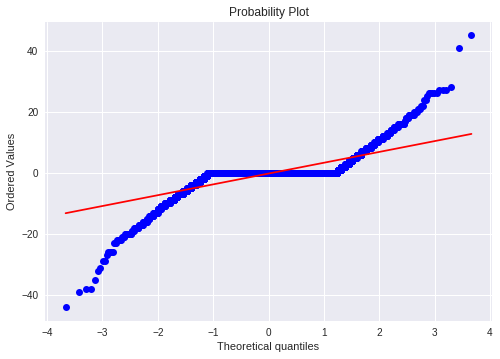

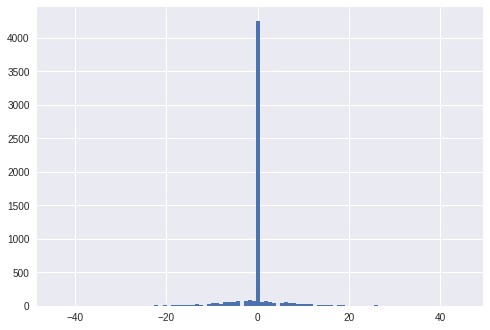

mean=-0.237 stdv=4.646
Statistics=0.582, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1453.839, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


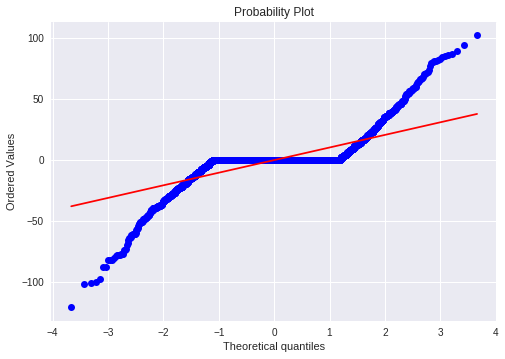

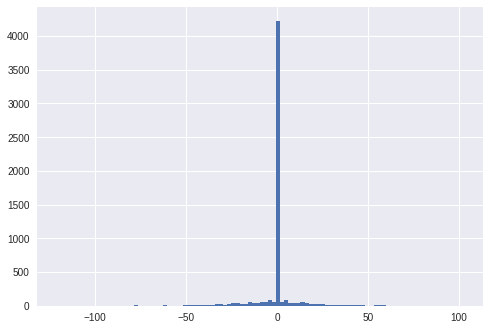

mean=-0.306 stdv=13.695
Statistics=0.570, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1232.312, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


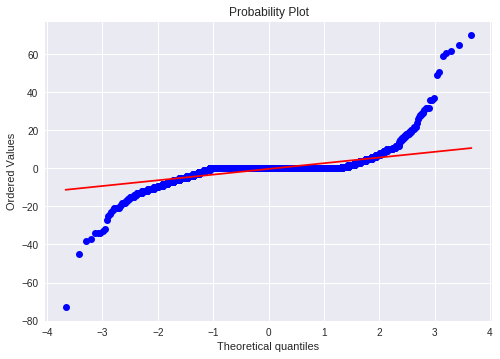

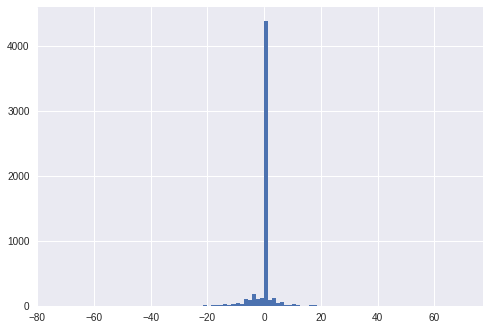

mean=-0.240 stdv=4.493
Statistics=0.446, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3808.178, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


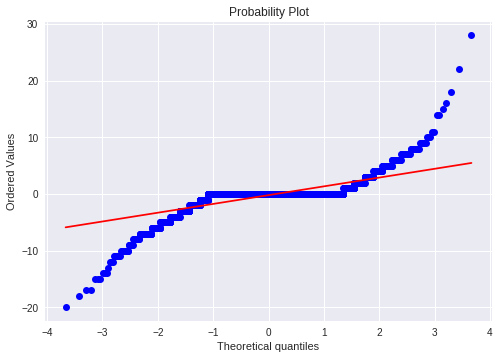

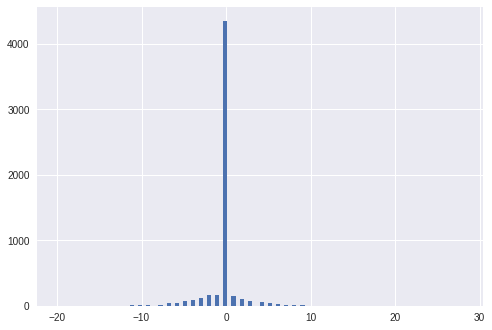

mean=-0.209 stdv=2.084
Statistics=0.555, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1612.576, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)


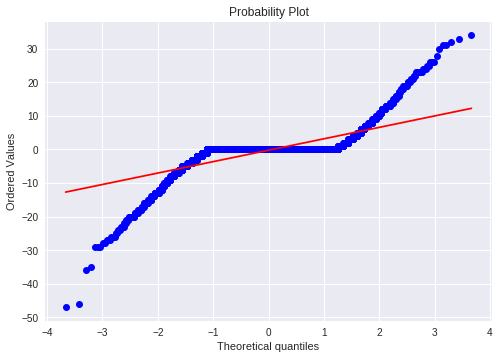

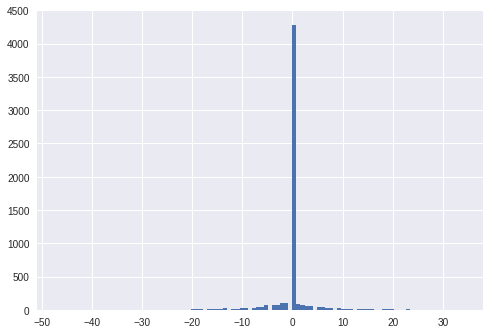

mean=-0.214 stdv=4.618
Statistics=0.544, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1569.723, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


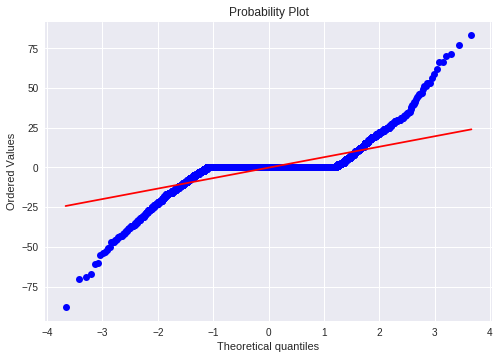

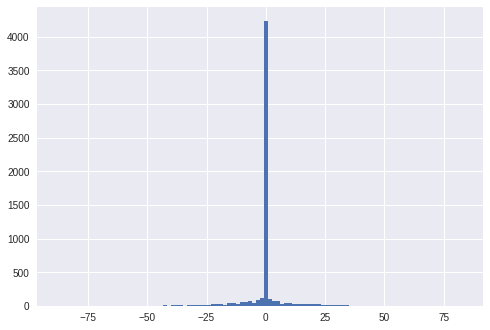

mean=-0.210 stdv=8.870
Statistics=0.551, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1320.756, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


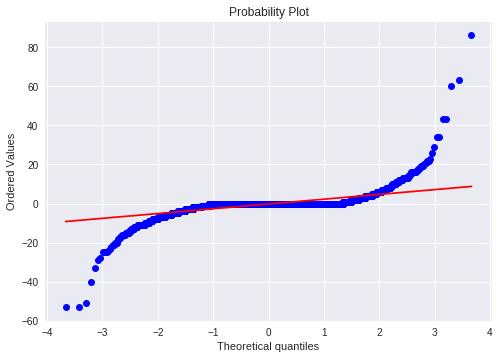

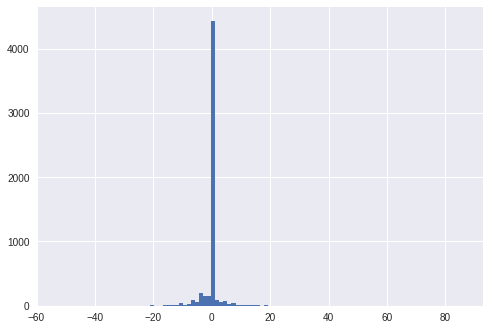

mean=-0.207 stdv=3.813
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4284.013, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.411, p=0.000
Sample does not look Gaussian (reject H0)


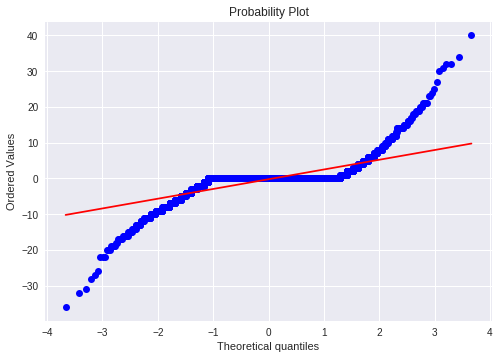

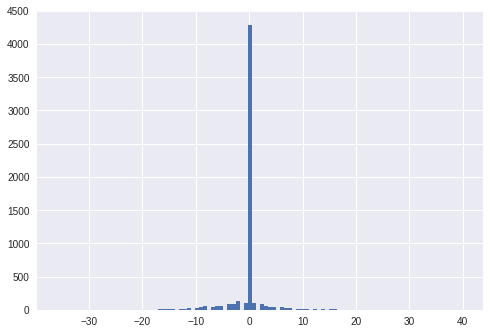

mean=-0.215 stdv=3.687
Statistics=0.546, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1531.005, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)


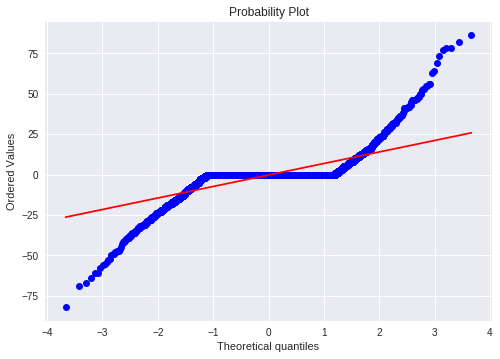

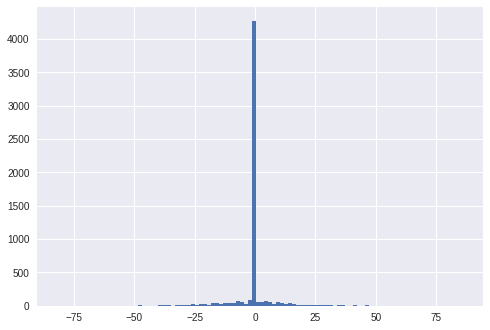

mean=-0.269 stdv=9.499
Statistics=0.561, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1416.369, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


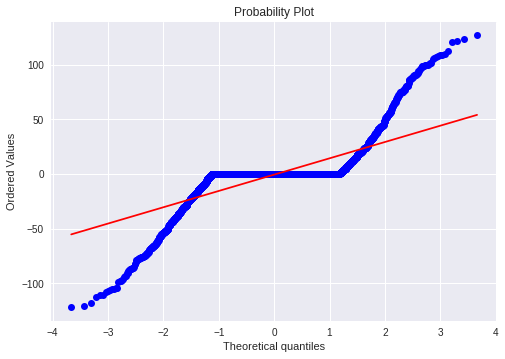

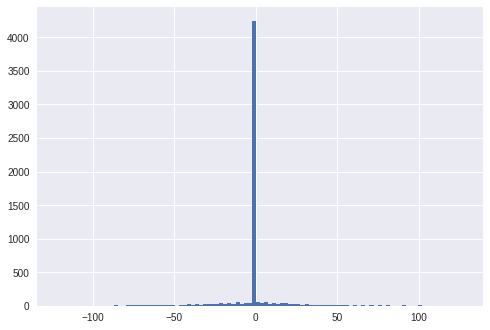

mean=-0.543 stdv=19.735
Statistics=0.573, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1070.252, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


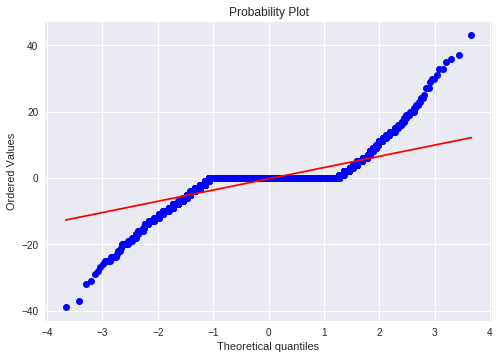

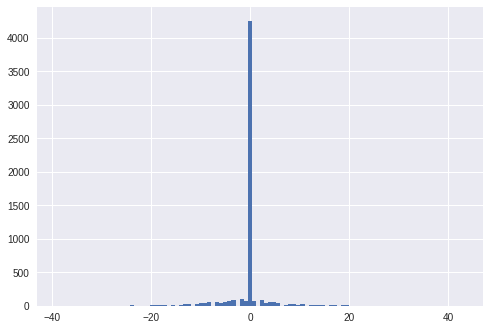

mean=-0.265 stdv=4.515
Statistics=0.565, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1289.392, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


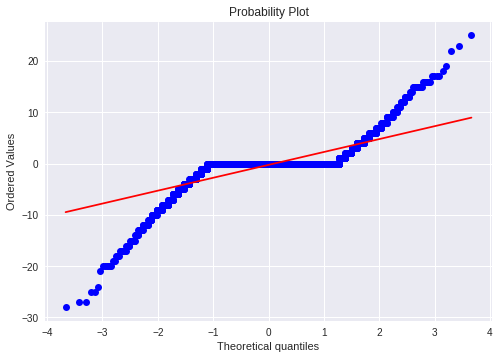

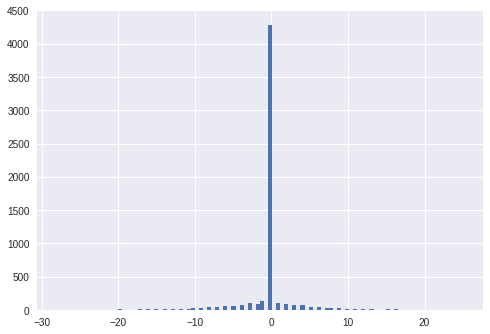

mean=-0.246 stdv=3.331
Statistics=0.570, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1845.349, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


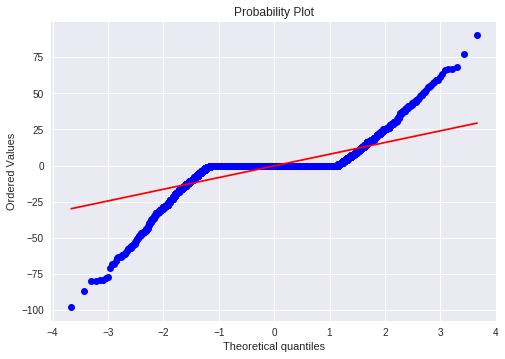

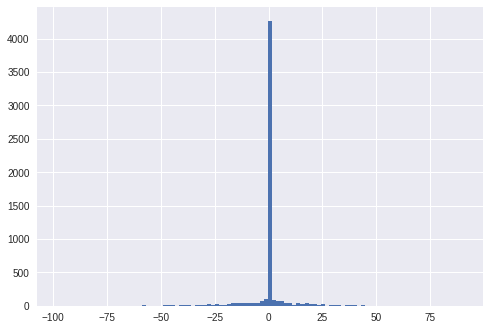

mean=-0.249 stdv=10.921
Statistics=0.547, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1812.927, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


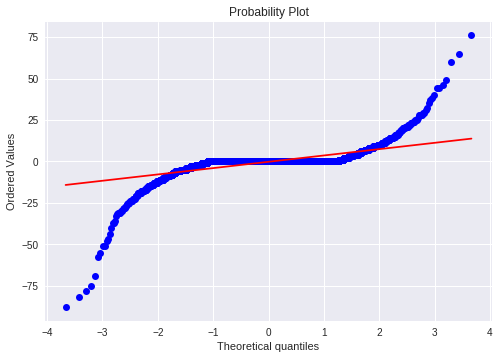

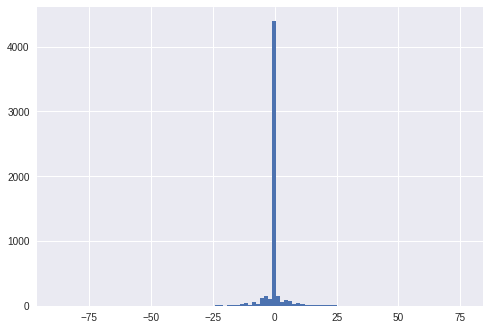

mean=-0.251 stdv=5.763
Statistics=0.439, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3664.369, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


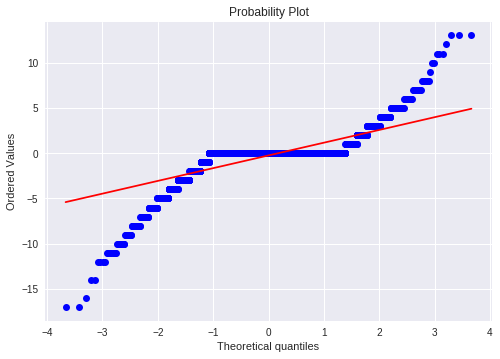

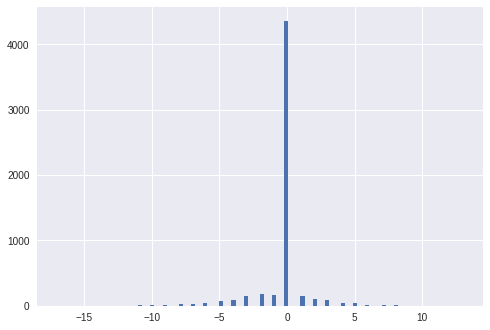

mean=-0.246 stdv=1.860
Statistics=0.572, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2324.238, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


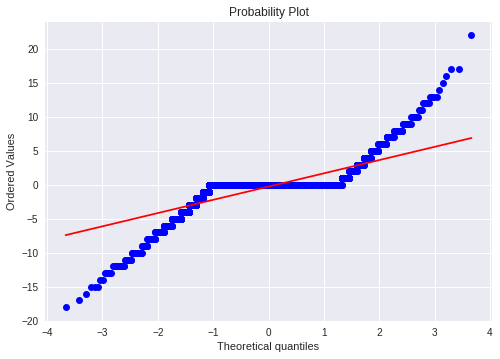

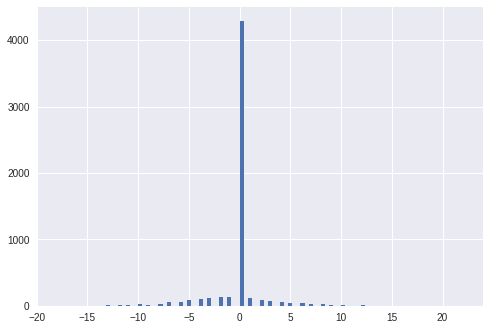

mean=-0.247 stdv=2.512
Statistics=0.603, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1245.498, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


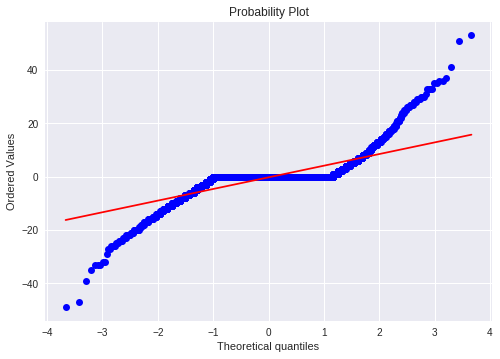

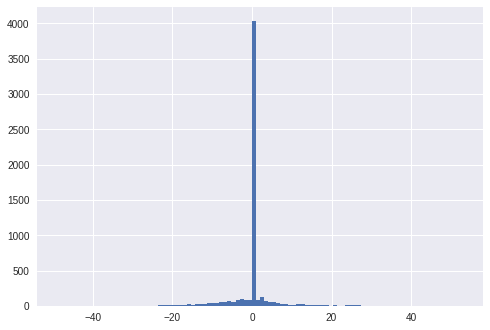

mean=-0.262 stdv=5.604
Statistics=0.608, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1376.505, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


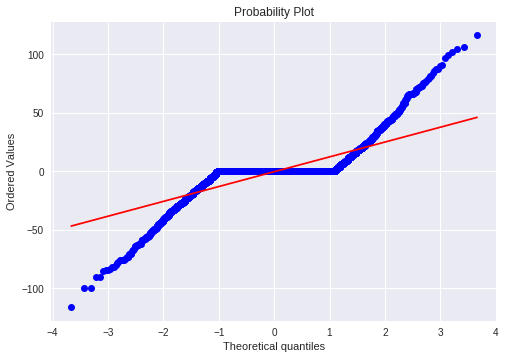

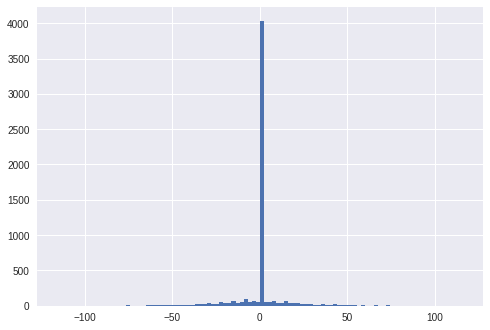

mean=-0.352 stdv=15.929
Statistics=0.631, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1030.840, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.363, p=0.000
Sample does not look Gaussian (reject H0)


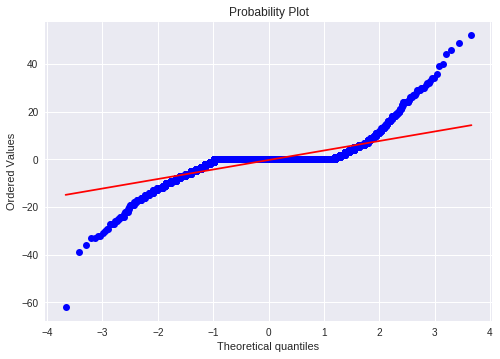

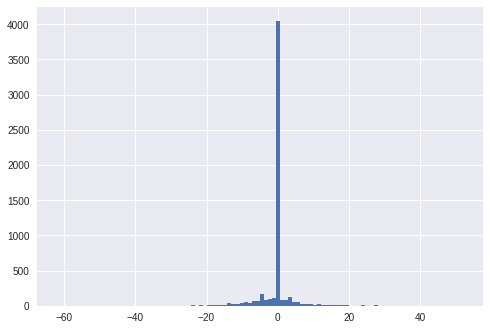

mean=-0.263 stdv=5.244
Statistics=0.579, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1693.420, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


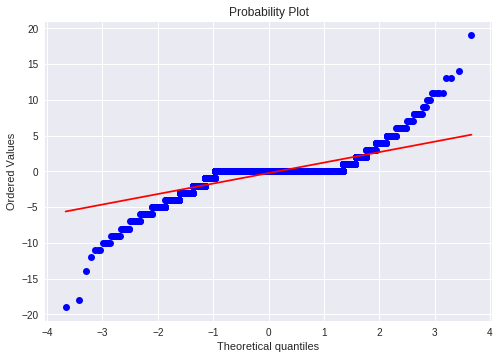

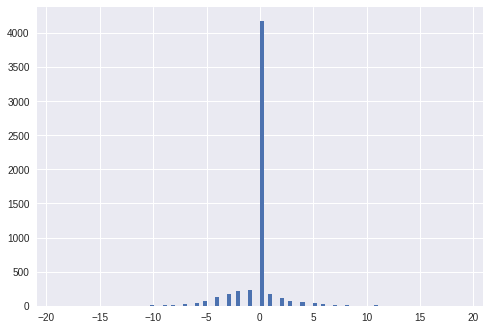

mean=-0.247 stdv=1.861
Statistics=0.621, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1362.679, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.411, p=0.000
Sample does not look Gaussian (reject H0)


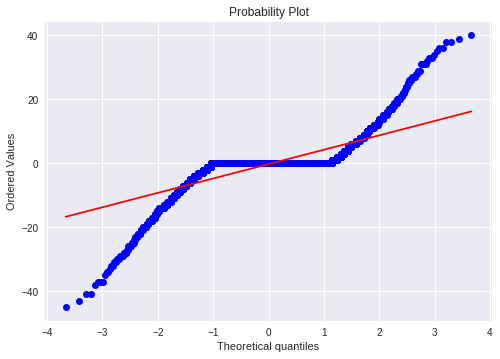

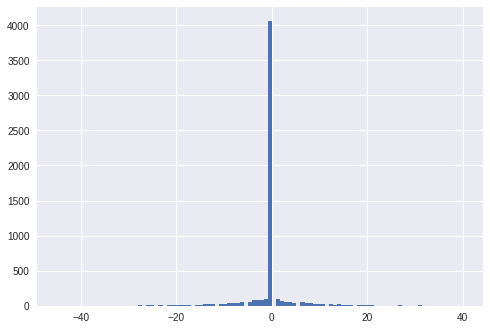

mean=-0.243 stdv=5.826
Statistics=0.596, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1273.063, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


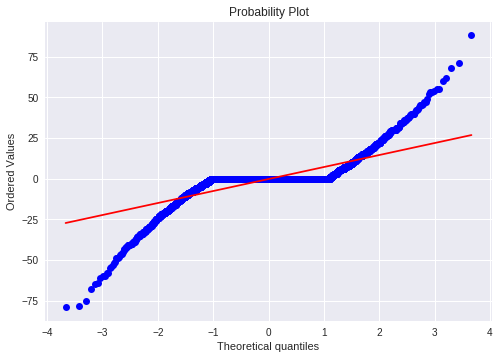

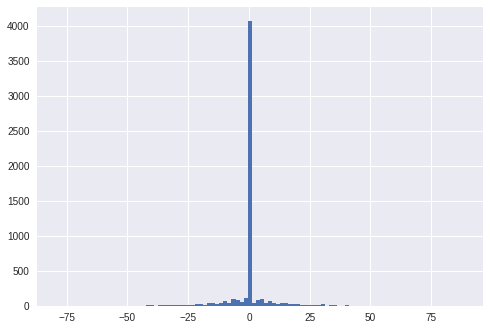

mean=-0.243 stdv=9.496
Statistics=0.603, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1345.931, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.366, p=0.000
Sample does not look Gaussian (reject H0)


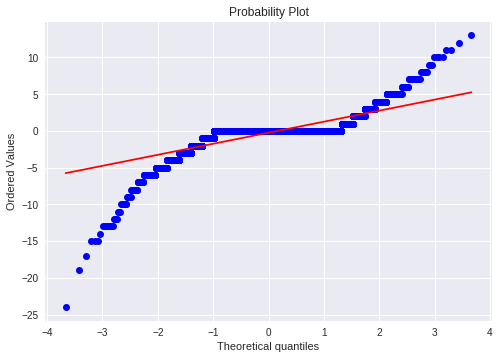

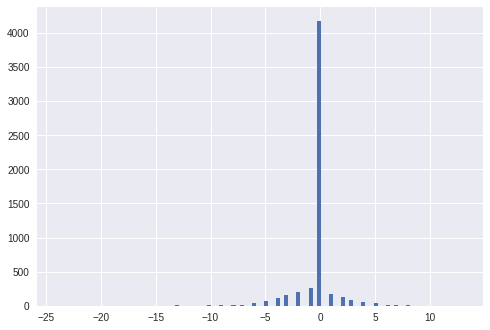

mean=-0.248 stdv=1.937
Statistics=0.602, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2711.880, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


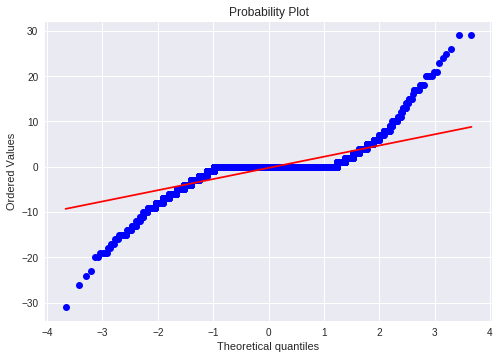

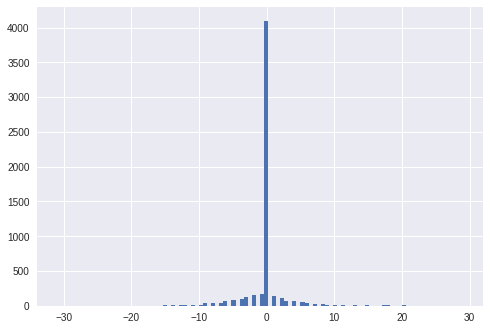

mean=-0.244 stdv=3.221
Statistics=0.588, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1320.997, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


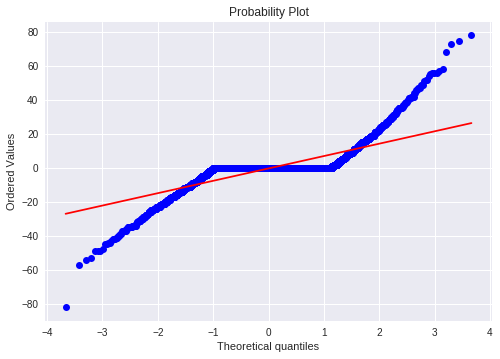

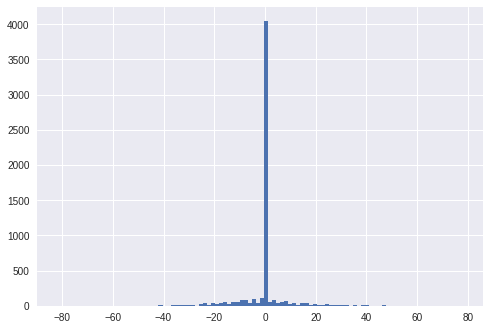

mean=-0.305 stdv=9.214
Statistics=0.625, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1330.213, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


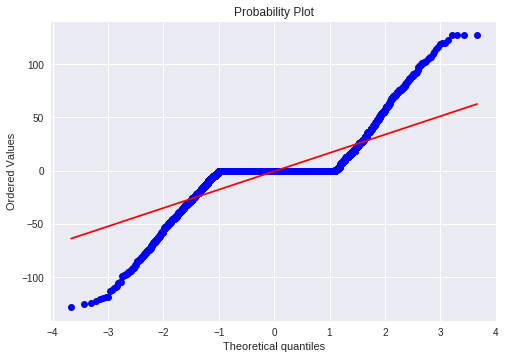

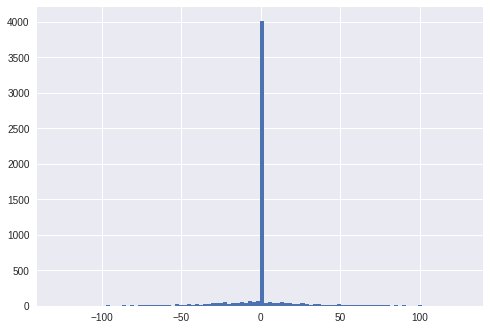

mean=-0.496 stdv=21.649
Statistics=0.632, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=969.953, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.366, p=0.000
Sample does not look Gaussian (reject H0)


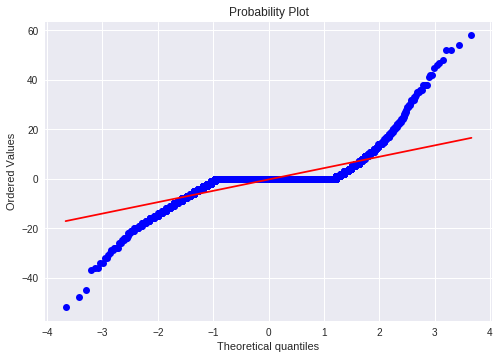

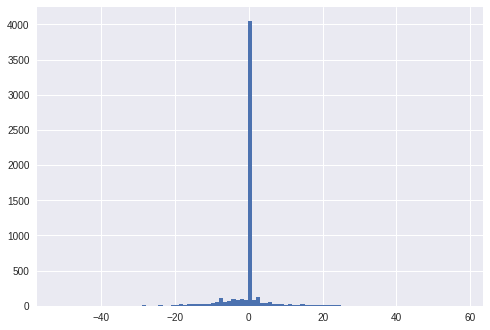

mean=-0.307 stdv=6.033
Statistics=0.581, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2026.217, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


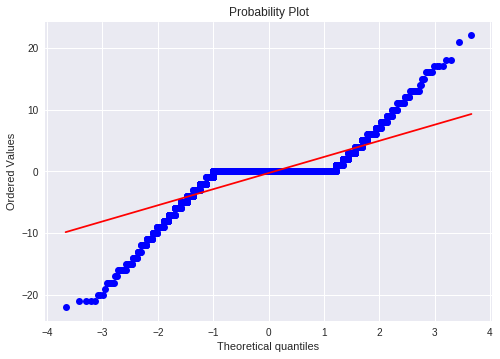

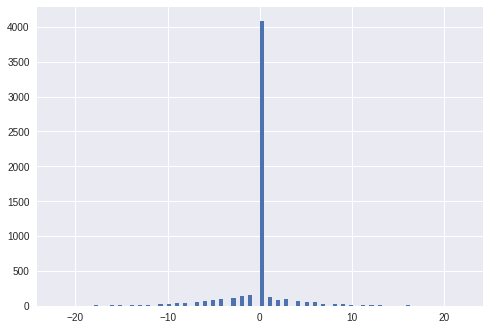

mean=-0.286 stdv=3.296
Statistics=0.627, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1446.009, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


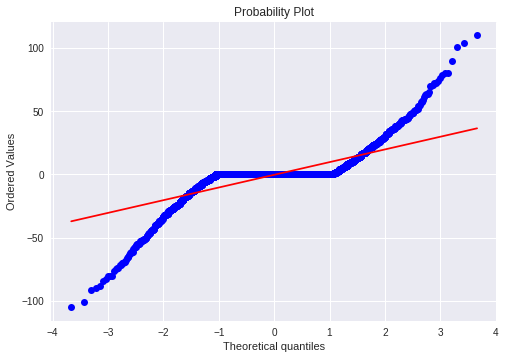

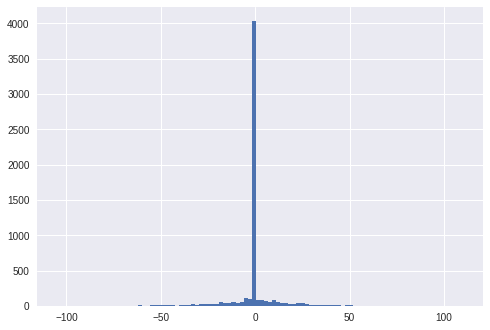

mean=-0.273 stdv=13.009
Statistics=0.595, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1362.696, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.358, p=0.000
Sample does not look Gaussian (reject H0)


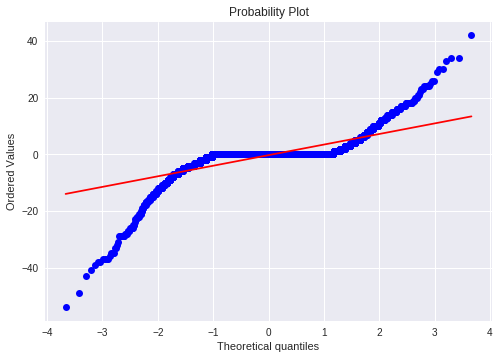

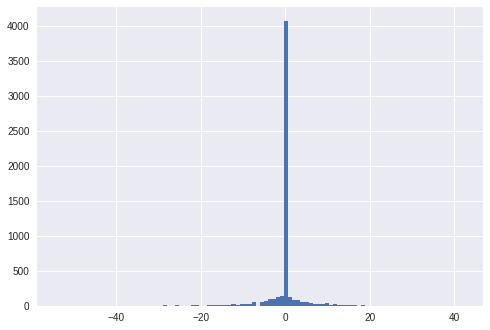

mean=-0.293 stdv=5.047
Statistics=0.548, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2714.246, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


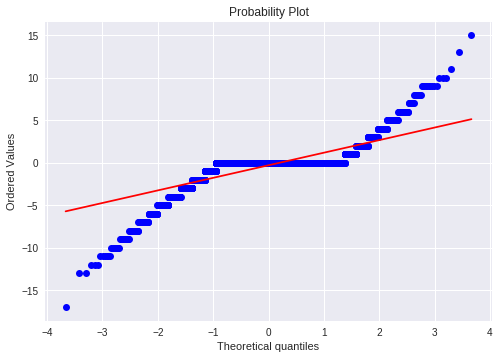

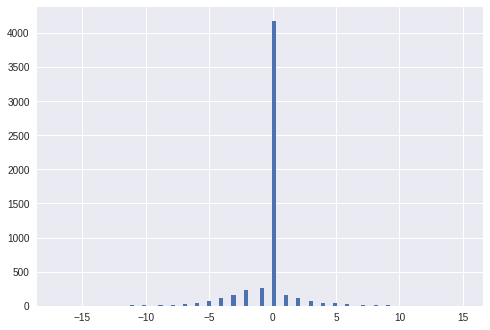

mean=-0.288 stdv=1.883
Statistics=0.618, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1684.945, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


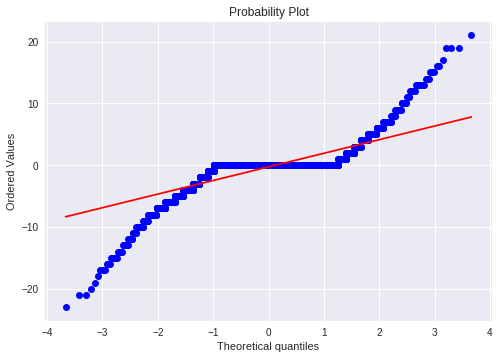

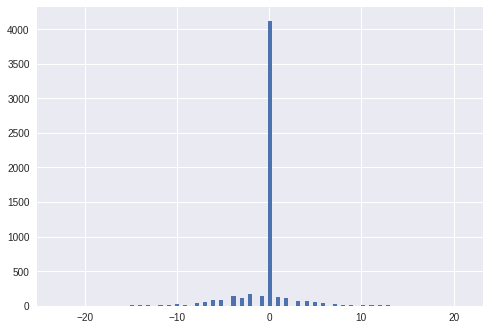

mean=-0.281 stdv=2.791
Statistics=0.624, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1331.529, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


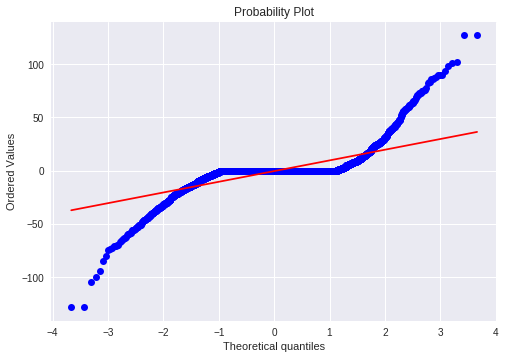

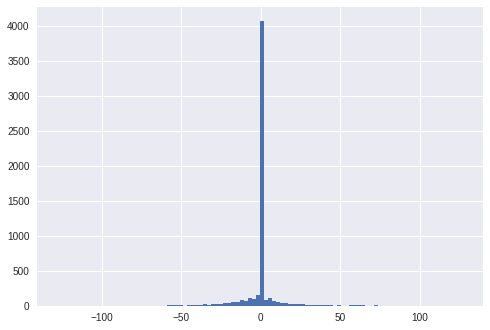

mean=-0.296 stdv=13.468
Statistics=0.555, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1718.099, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.371, p=0.000
Sample does not look Gaussian (reject H0)


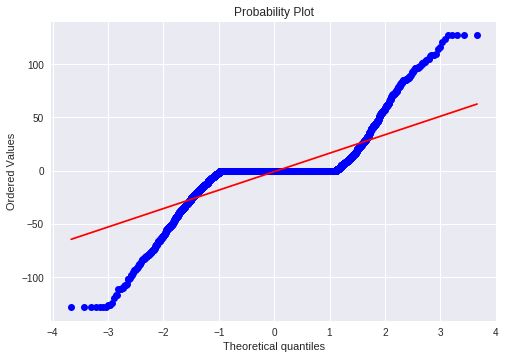

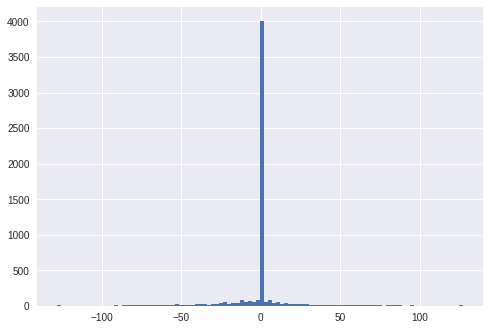

mean=-0.825 stdv=22.179
Statistics=0.609, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1007.271, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.367, p=0.000
Sample does not look Gaussian (reject H0)


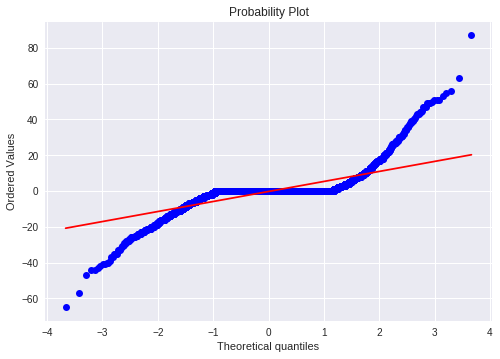

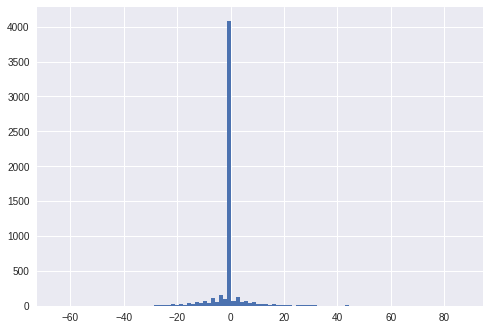

mean=-0.279 stdv=7.391
Statistics=0.576, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2064.820, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


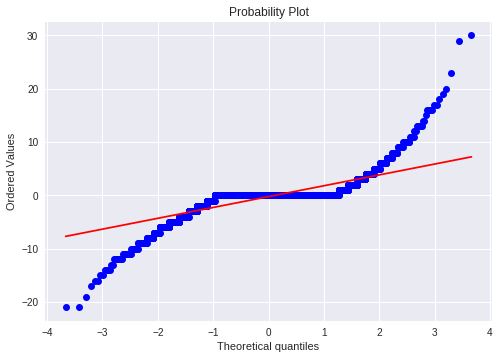

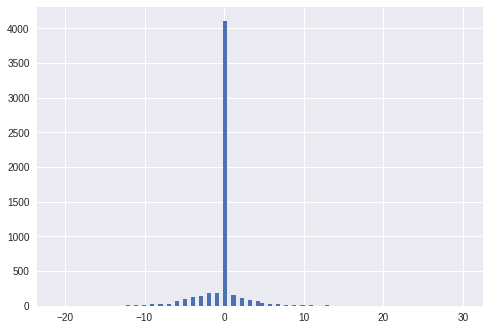

mean=-0.247 stdv=2.620
Statistics=0.604, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1452.456, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


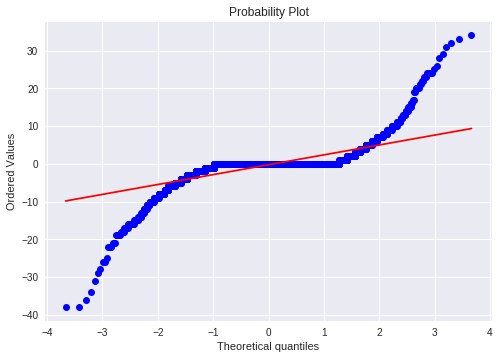

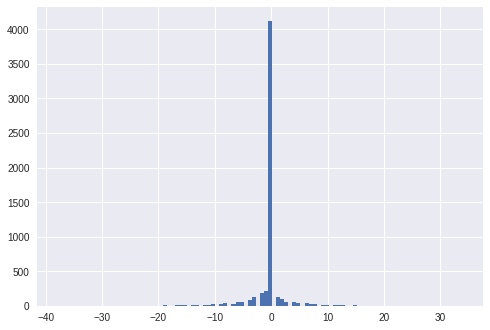

mean=-0.261 stdv=3.608
Statistics=0.527, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1735.647, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


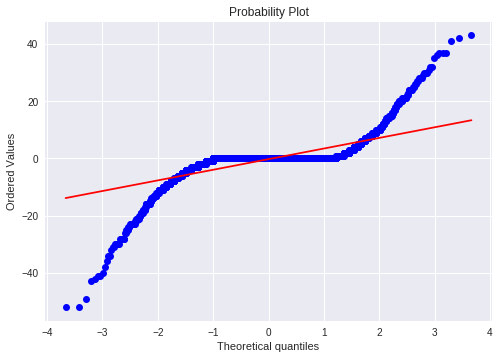

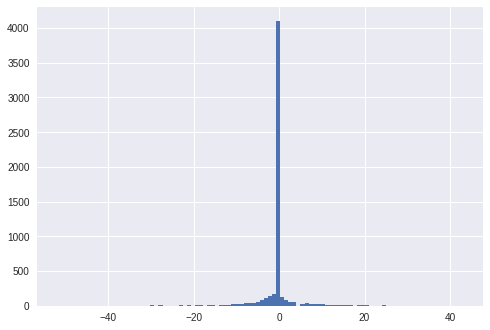

mean=-0.249 stdv=5.161
Statistics=0.518, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1811.805, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


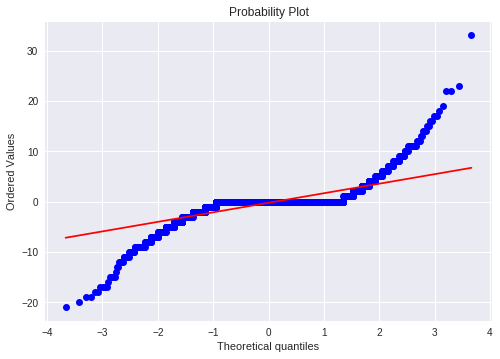

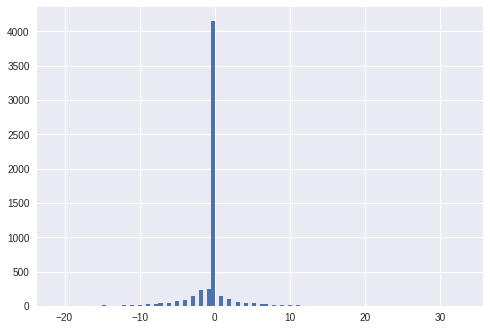

mean=-0.252 stdv=2.520
Statistics=0.566, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1485.054, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)


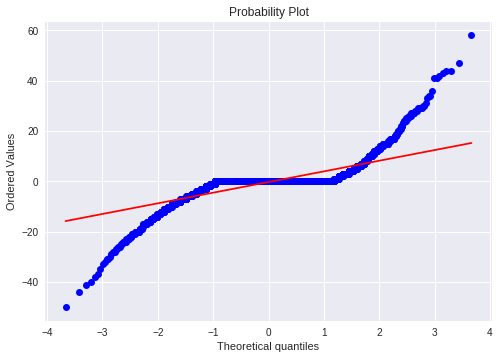

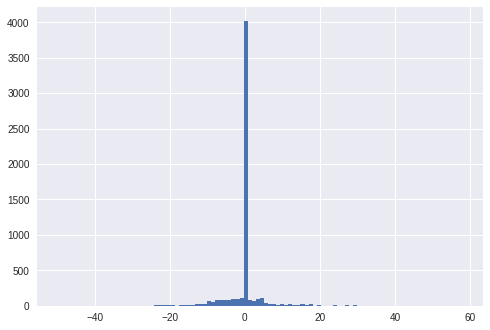

mean=-0.258 stdv=5.529
Statistics=0.587, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1539.632, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


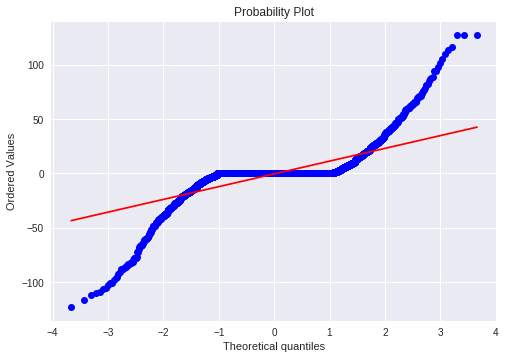

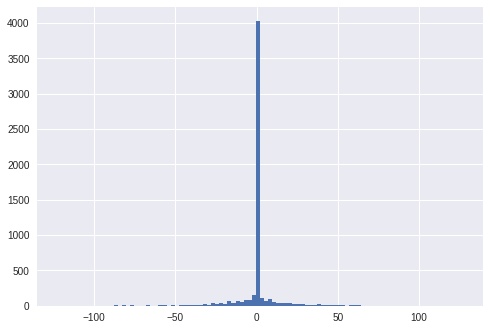

mean=-0.371 stdv=15.660
Statistics=0.561, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1396.592, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.360, p=0.000
Sample does not look Gaussian (reject H0)


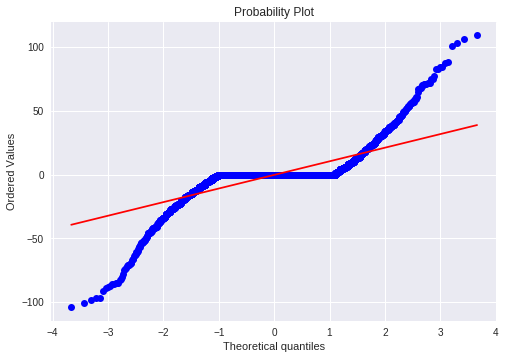

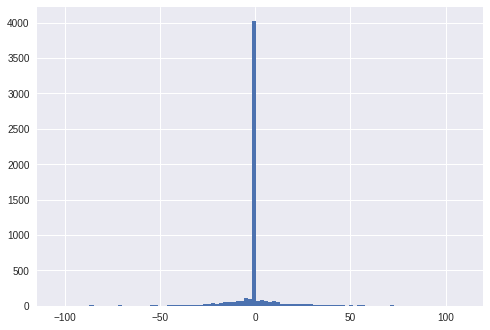

mean=-0.324 stdv=13.882
Statistics=0.590, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1263.068, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.366, p=0.000
Sample does not look Gaussian (reject H0)


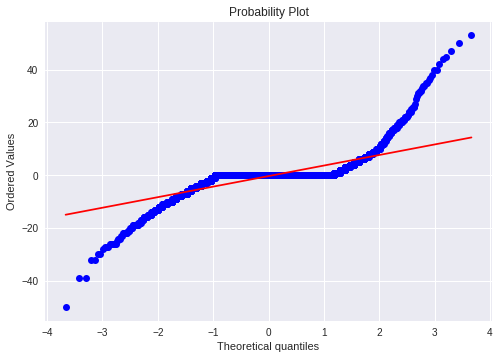

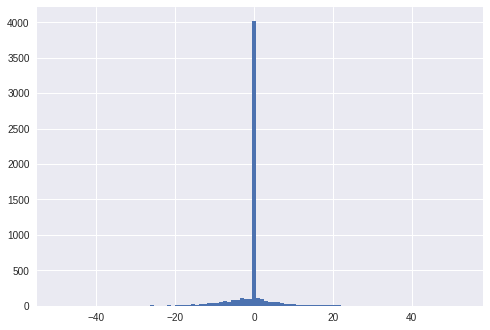

mean=-0.312 stdv=5.245
Statistics=0.581, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1962.154, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


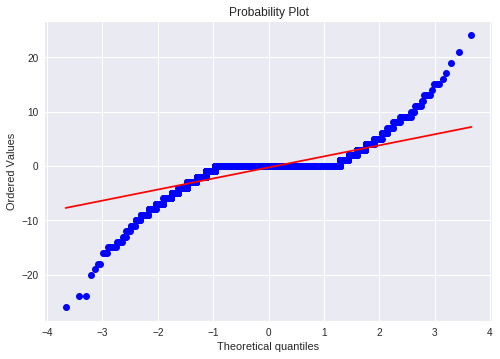

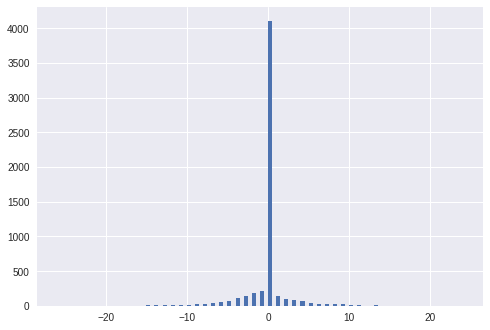

mean=-0.291 stdv=2.622
Statistics=0.602, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1850.949, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.401, p=0.000
Sample does not look Gaussian (reject H0)


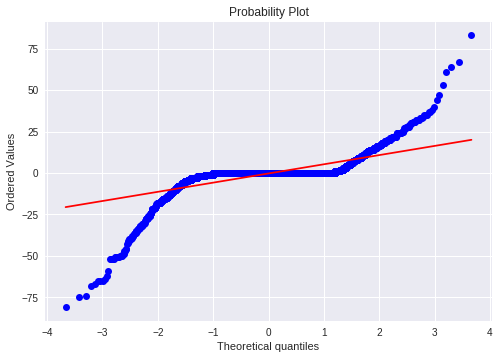

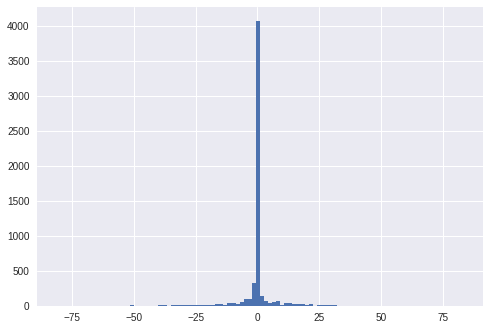

mean=-0.297 stdv=7.835
Statistics=0.501, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2898.491, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


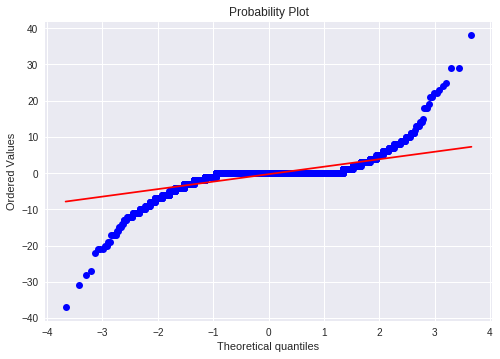

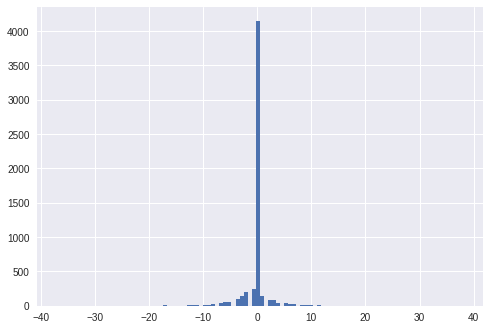

mean=-0.292 stdv=2.848
Statistics=0.525, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1789.506, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)


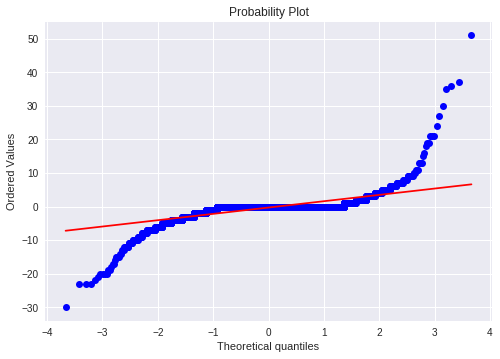

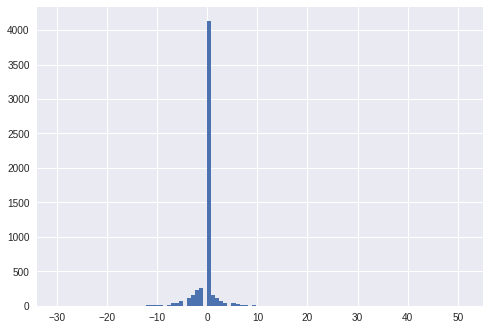

mean=-0.296 stdv=2.700
Statistics=0.489, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3501.182, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


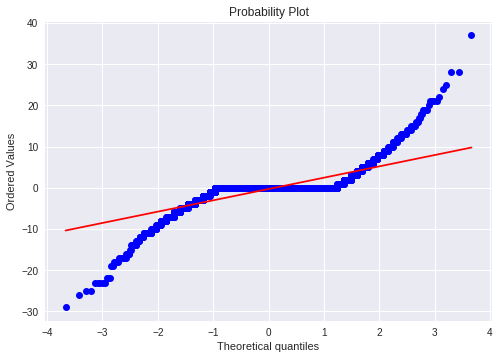

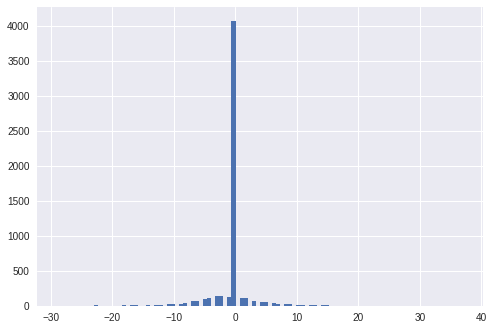

mean=-0.299 stdv=3.527
Statistics=0.608, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1254.105, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


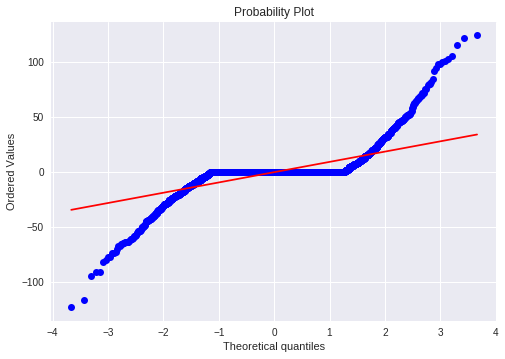

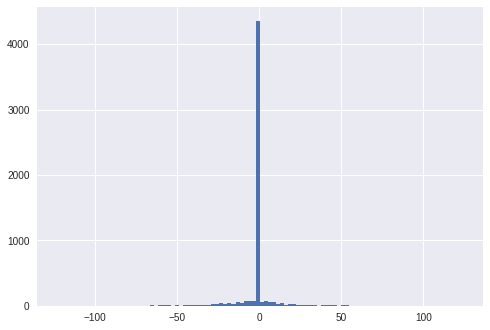

mean=-0.281 stdv=13.076
Statistics=0.511, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1669.586, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


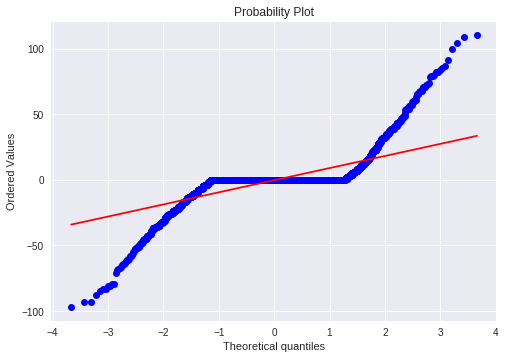

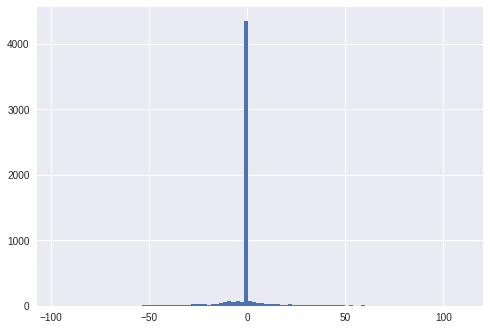

mean=-0.272 stdv=12.764
Statistics=0.522, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1528.097, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


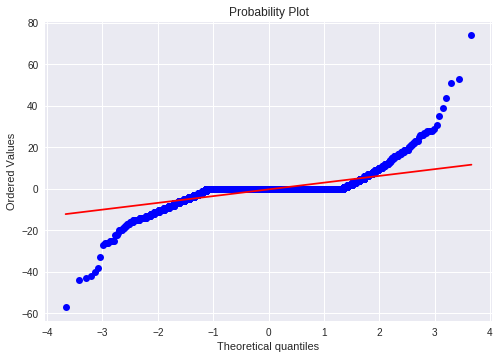

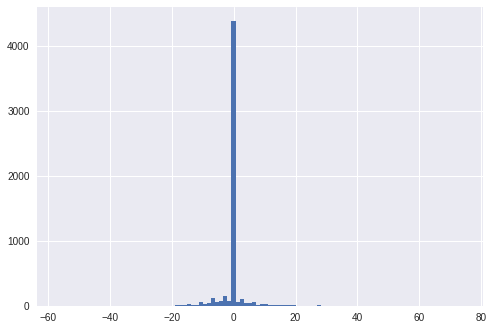

mean=-0.215 stdv=4.600
Statistics=0.500, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2304.651, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)


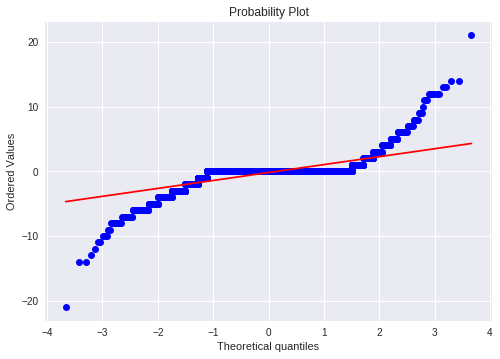

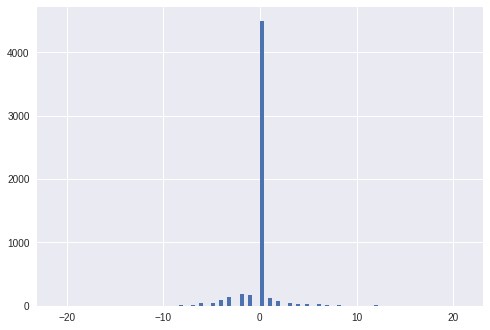

mean=-0.191 stdv=1.695
Statistics=0.524, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1472.210, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.434, p=0.000
Sample does not look Gaussian (reject H0)


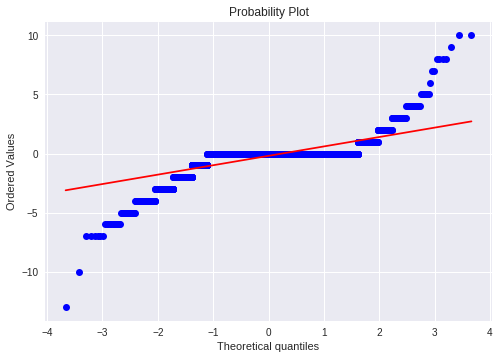

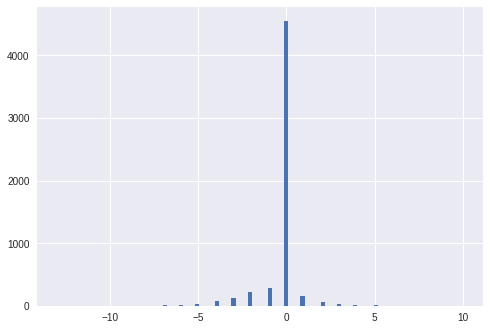

mean=-0.191 stdv=1.096
Statistics=0.528, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2015.206, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.447, p=0.000
Sample does not look Gaussian (reject H0)


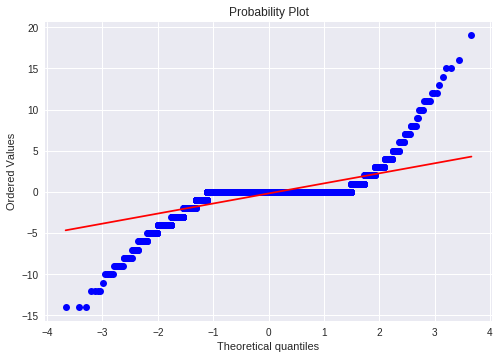

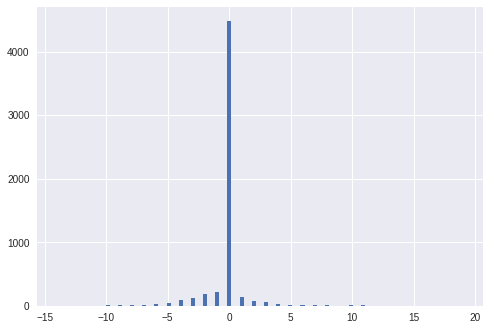

mean=-0.188 stdv=1.706
Statistics=0.513, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1438.084, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.432, p=0.000
Sample does not look Gaussian (reject H0)


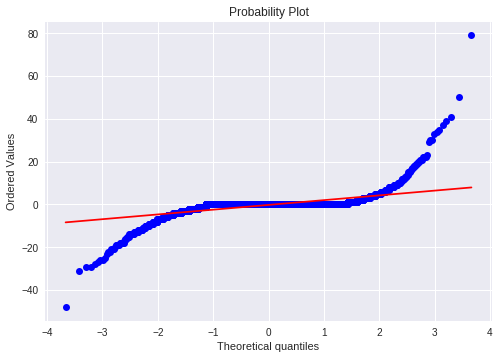

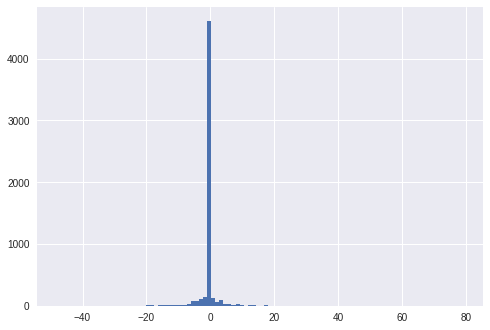

mean=-0.198 stdv=3.527
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4444.468, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.424, p=0.000
Sample does not look Gaussian (reject H0)


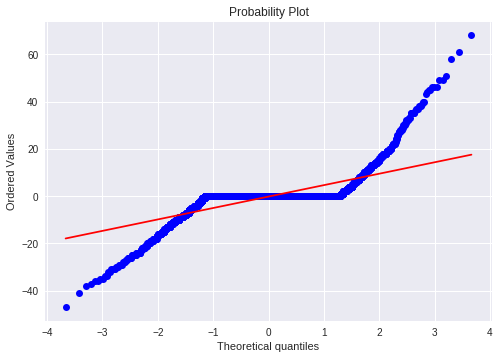

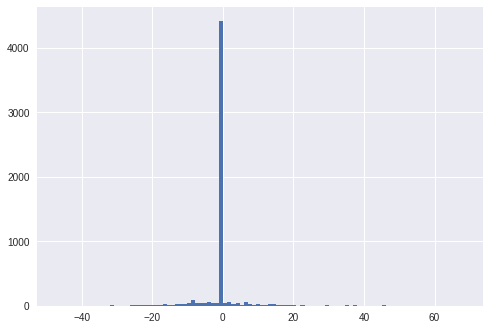

mean=-0.188 stdv=6.606
Statistics=0.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2032.187, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)


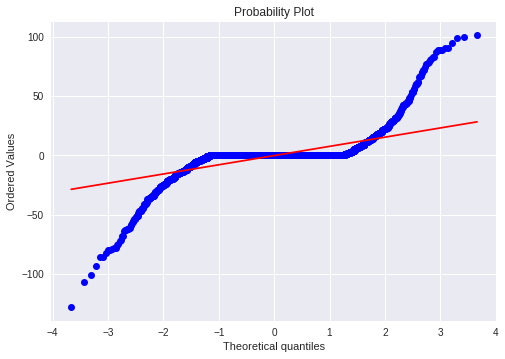

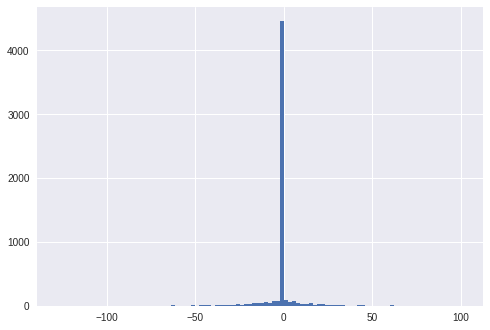

mean=-0.244 stdv=11.443
Statistics=0.460, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1583.374, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


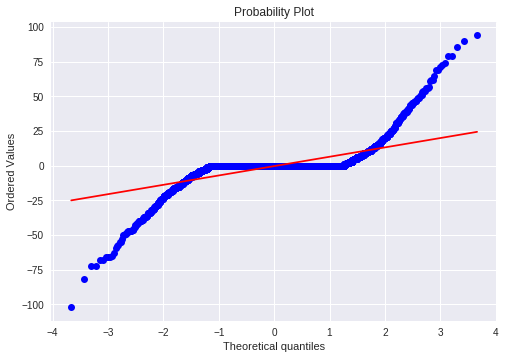

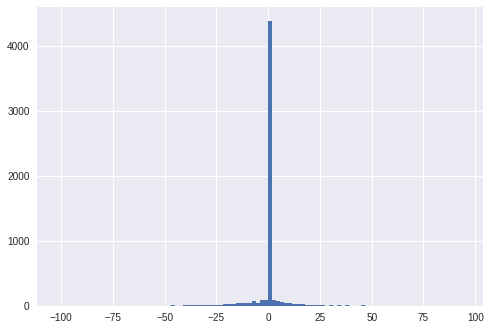

mean=-0.251 stdv=9.676
Statistics=0.486, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1517.281, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


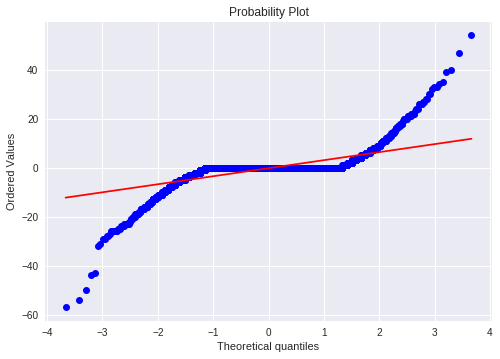

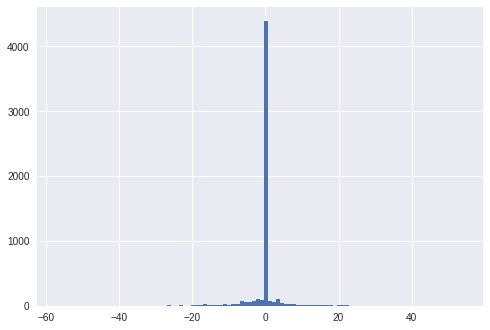

mean=-0.232 stdv=4.727
Statistics=0.482, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1801.023, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


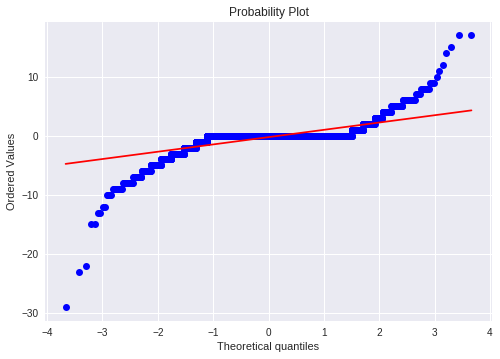

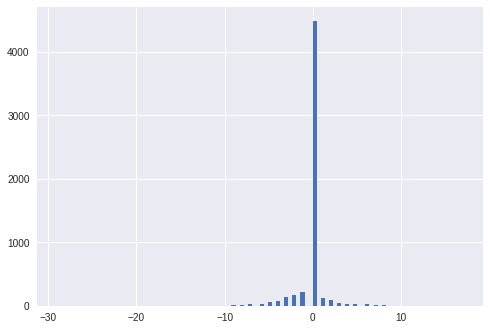

mean=-0.214 stdv=1.747
Statistics=0.501, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3426.125, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.434, p=0.000
Sample does not look Gaussian (reject H0)


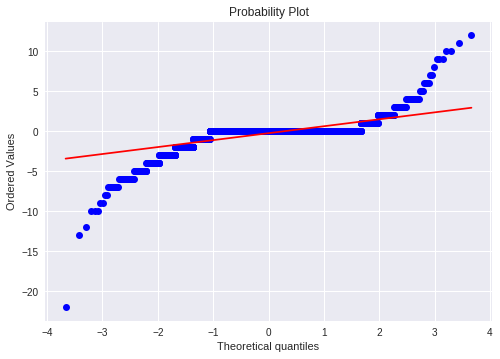

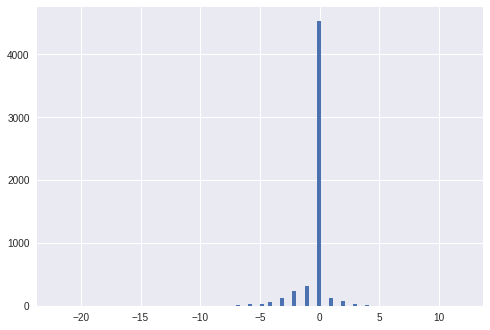

mean=-0.231 stdv=1.236
Statistics=0.495, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3535.809, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.452, p=0.000
Sample does not look Gaussian (reject H0)


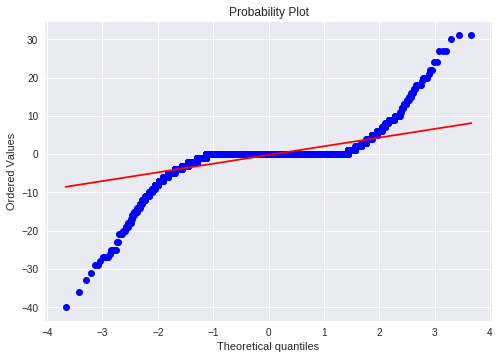

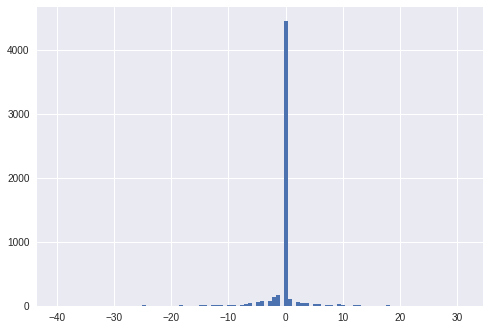

mean=-0.238 stdv=3.407
Statistics=0.445, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2655.764, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.424, p=0.000
Sample does not look Gaussian (reject H0)


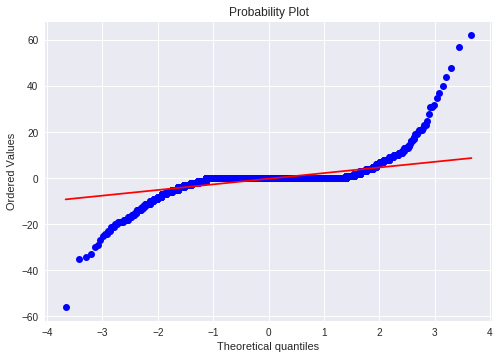

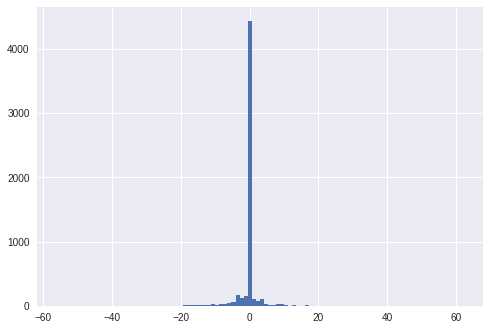

mean=-0.221 stdv=3.765
Statistics=0.424, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2957.761, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)


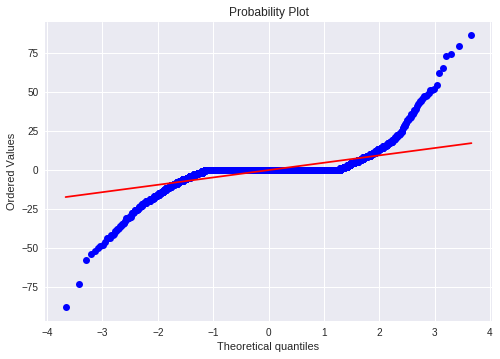

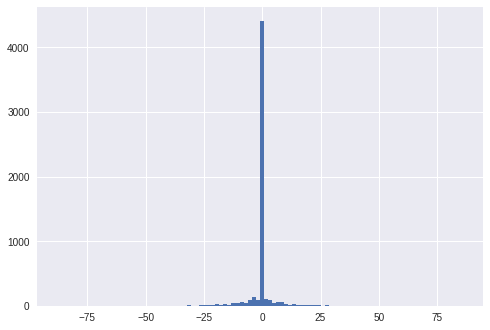

mean=-0.224 stdv=6.926
Statistics=0.463, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1995.036, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)


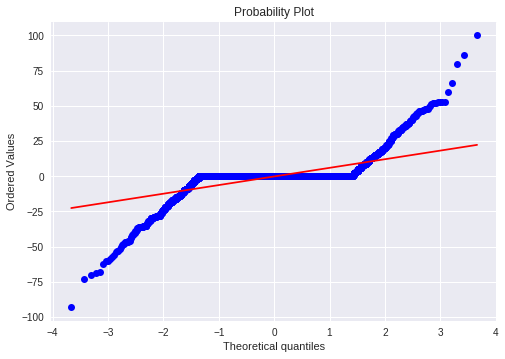

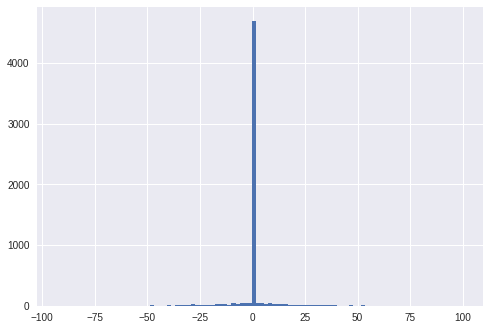

mean=-0.157 stdv=9.047
Statistics=0.458, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1432.190, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.422, p=0.000
Sample does not look Gaussian (reject H0)


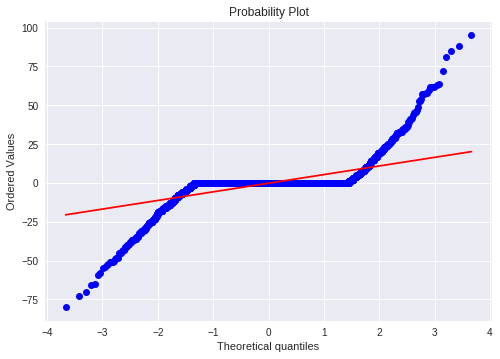

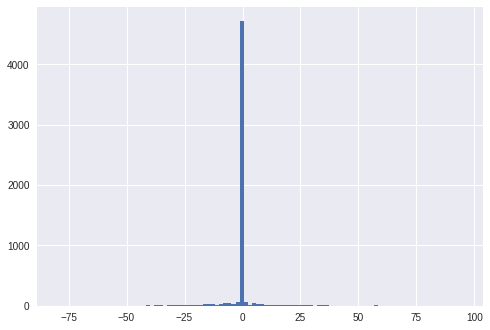

mean=-0.164 stdv=8.527
Statistics=0.424, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1795.626, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)


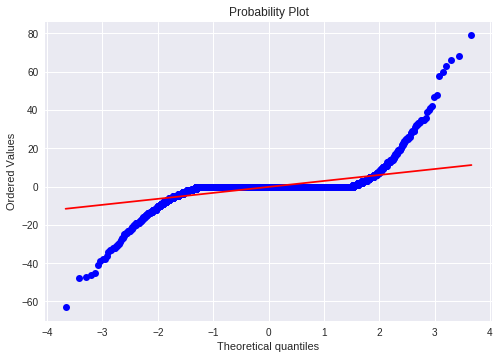

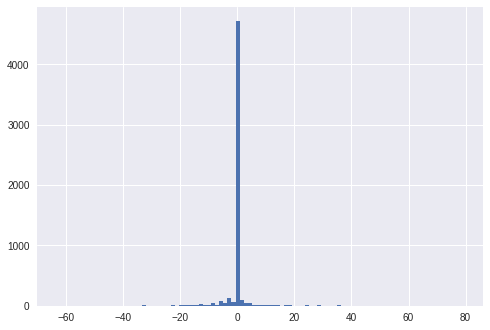

mean=-0.153 stdv=5.233
Statistics=0.356, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3332.332, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.437, p=0.000
Sample does not look Gaussian (reject H0)


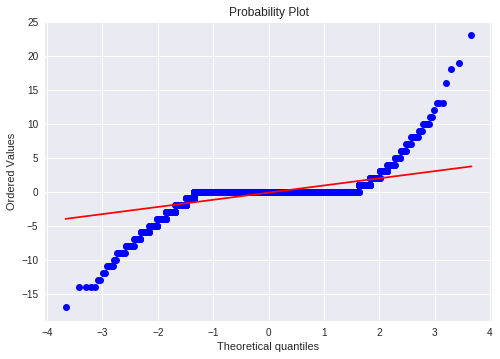

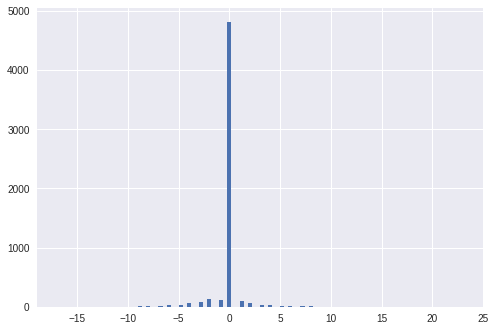

mean=-0.138 stdv=1.653
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1688.472, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.448, p=0.000
Sample does not look Gaussian (reject H0)


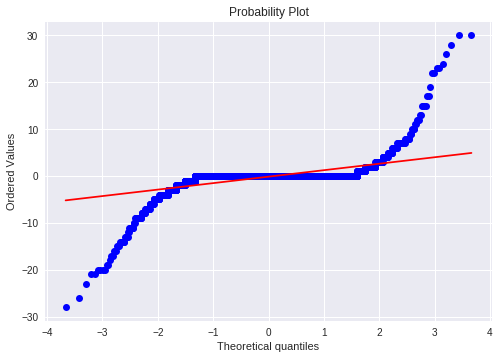

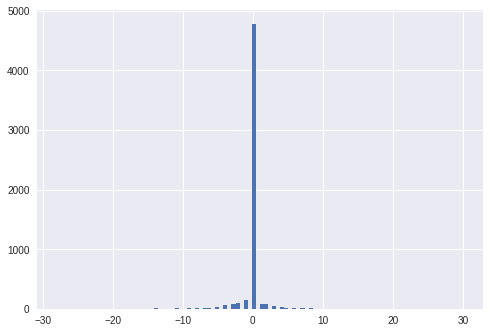

mean=-0.141 stdv=2.323
Statistics=0.354, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1896.469, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.446, p=0.000
Sample does not look Gaussian (reject H0)


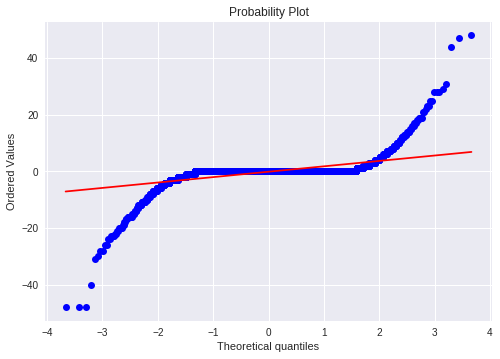

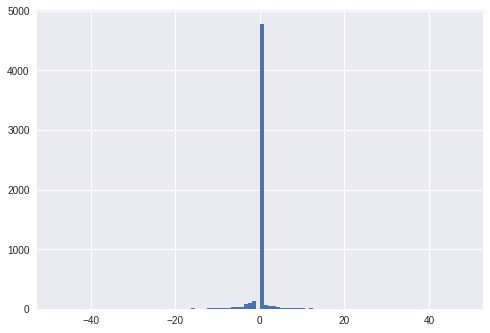

mean=-0.144 stdv=3.340
Statistics=0.327, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2508.734, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.444, p=0.000
Sample does not look Gaussian (reject H0)


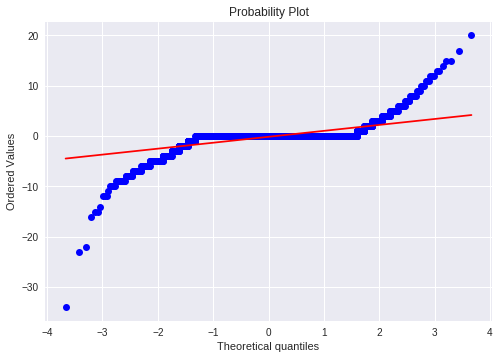

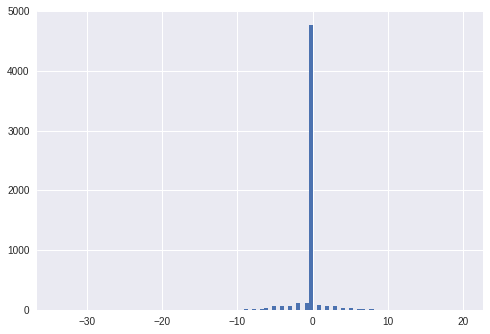

mean=-0.142 stdv=1.815
Statistics=0.424, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3360.883, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.445, p=0.000
Sample does not look Gaussian (reject H0)


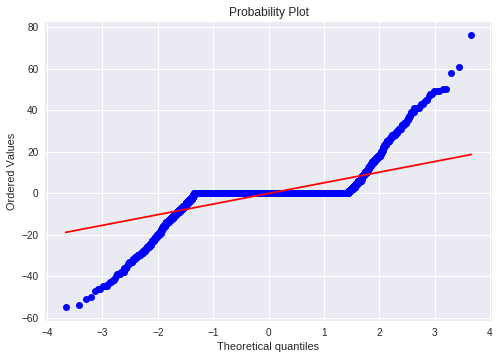

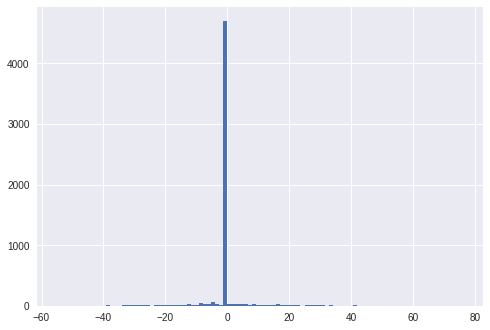

mean=-0.161 stdv=7.562
Statistics=0.459, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1415.901, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)


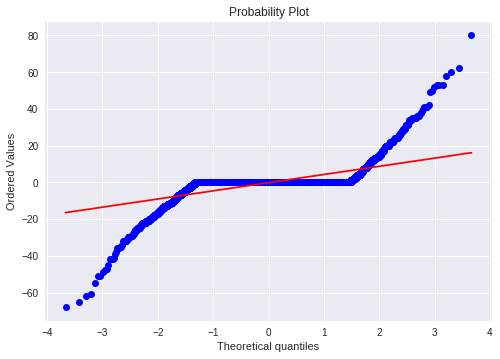

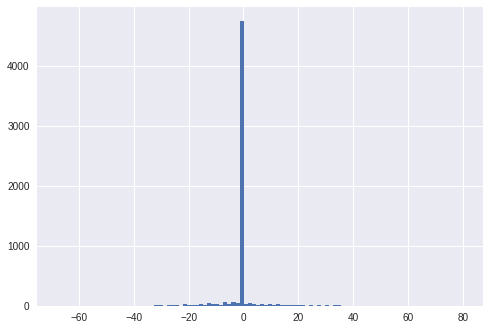

mean=-0.178 stdv=6.790
Statistics=0.430, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1583.878, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.432, p=0.000
Sample does not look Gaussian (reject H0)


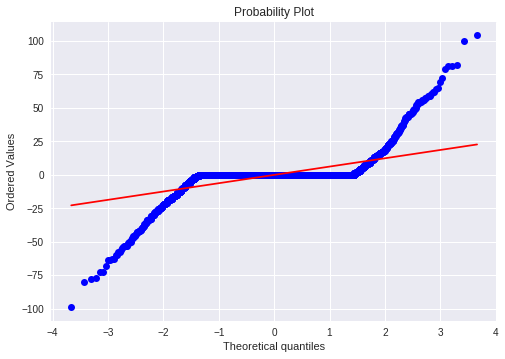

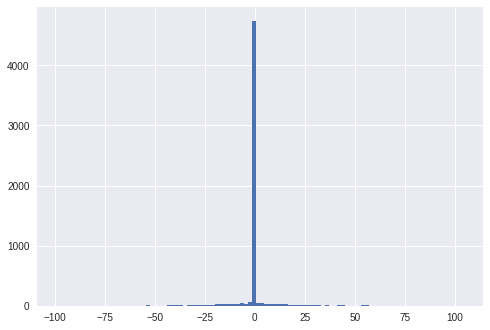

mean=-0.180 stdv=9.639
Statistics=0.415, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1645.318, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)


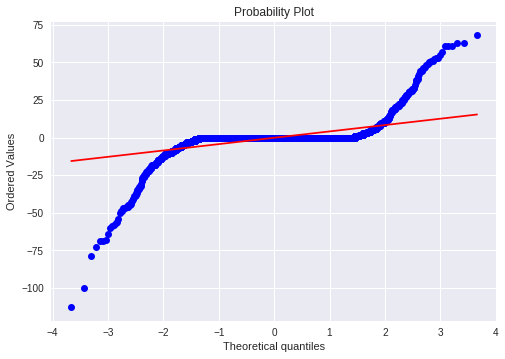

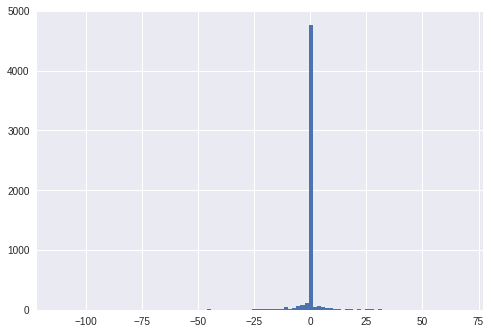

mean=-0.164 stdv=7.265
Statistics=0.340, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3104.184, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.427, p=0.000
Sample does not look Gaussian (reject H0)


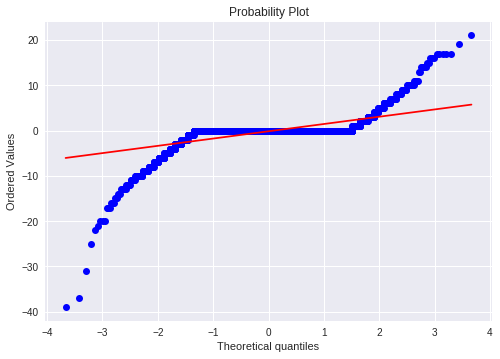

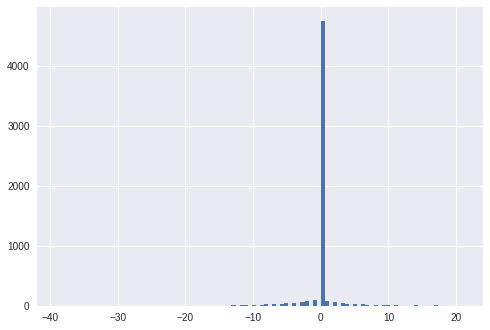

mean=-0.163 stdv=2.501
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3805.502, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.435, p=0.000
Sample does not look Gaussian (reject H0)


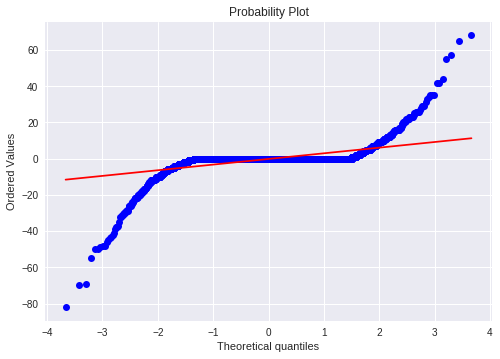

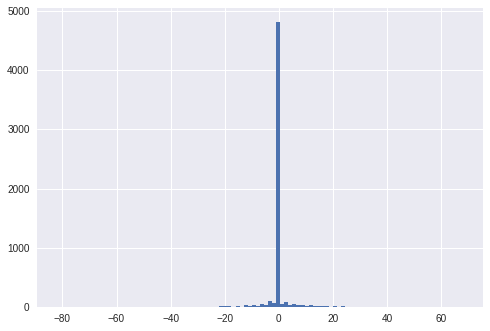

mean=-0.179 stdv=5.315
Statistics=0.345, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3386.401, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.434, p=0.000
Sample does not look Gaussian (reject H0)


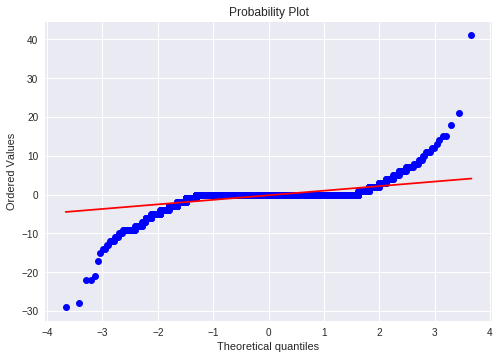

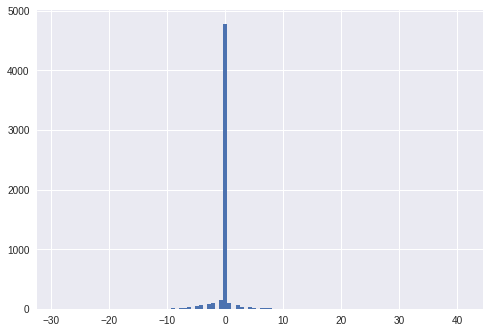

mean=-0.167 stdv=1.923
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2346.890, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.448, p=0.000
Sample does not look Gaussian (reject H0)


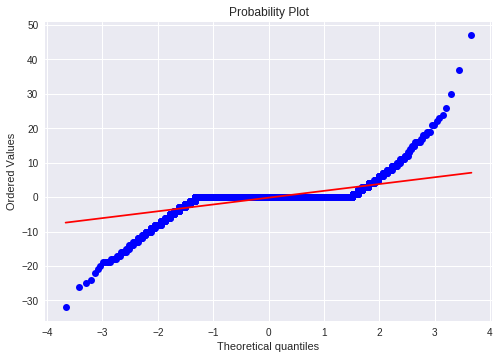

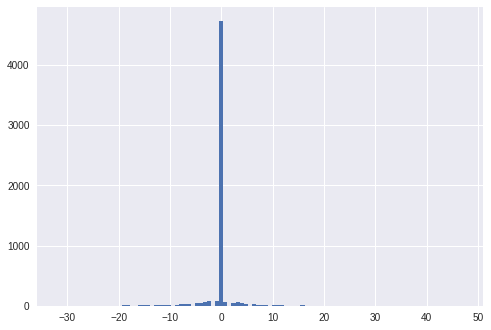

mean=-0.163 stdv=3.036
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1816.620, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.435, p=0.000
Sample does not look Gaussian (reject H0)


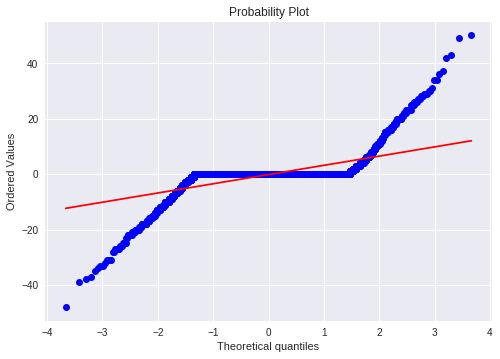

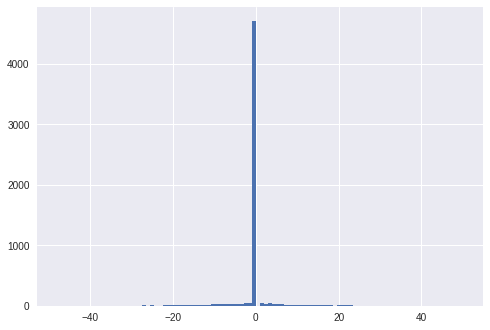

mean=-0.169 stdv=5.000
Statistics=0.443, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1442.511, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.430, p=0.000
Sample does not look Gaussian (reject H0)


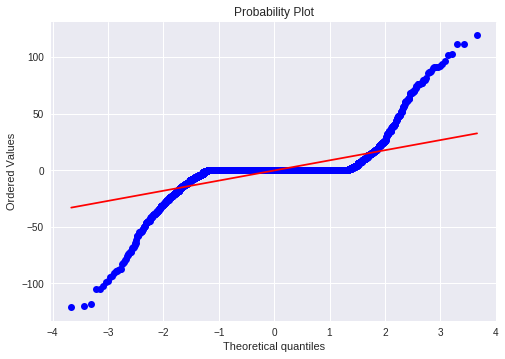

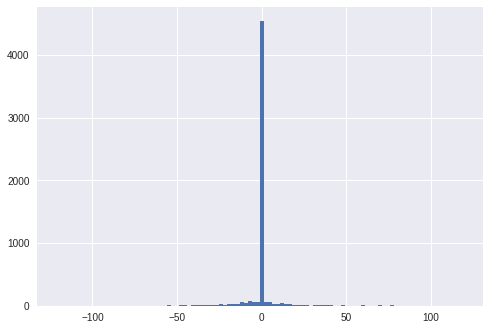

mean=-0.273 stdv=13.487
Statistics=0.440, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1517.499, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)


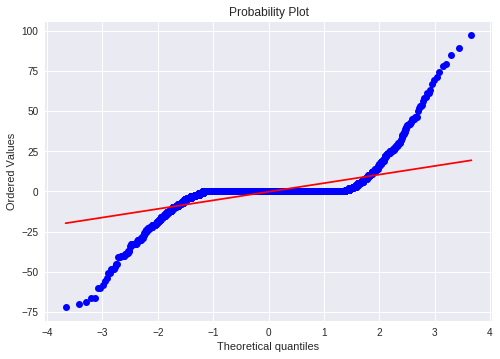

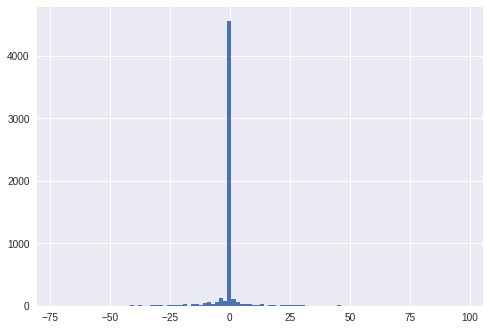

mean=-0.209 stdv=8.191
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2426.255, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


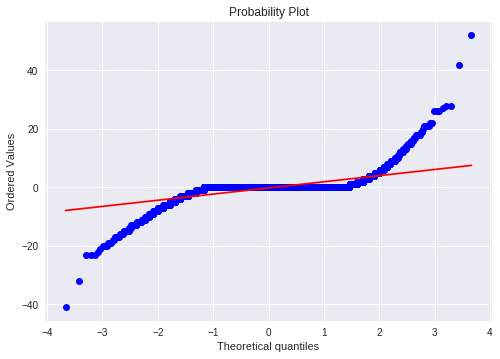

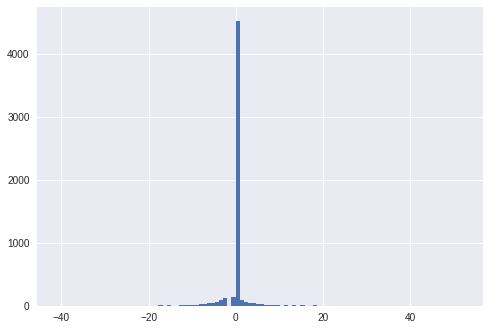

mean=-0.189 stdv=3.173
Statistics=0.441, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2409.789, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.428, p=0.000
Sample does not look Gaussian (reject H0)


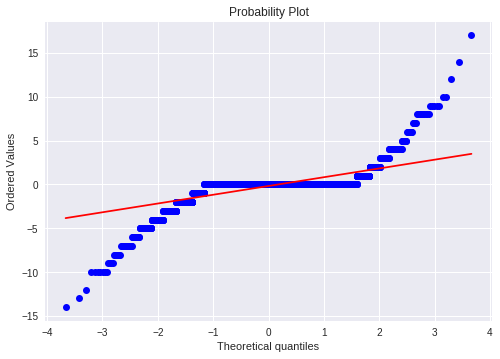

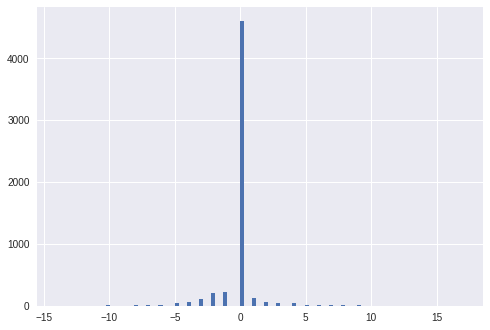

mean=-0.173 stdv=1.429
Statistics=0.491, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1655.426, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.444, p=0.000
Sample does not look Gaussian (reject H0)


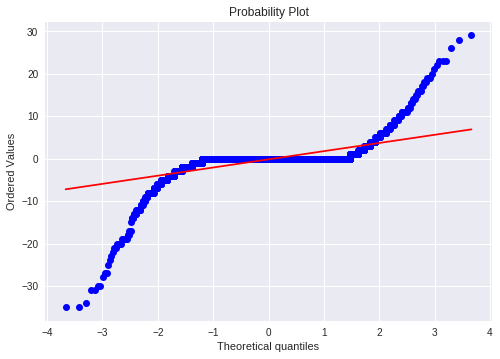

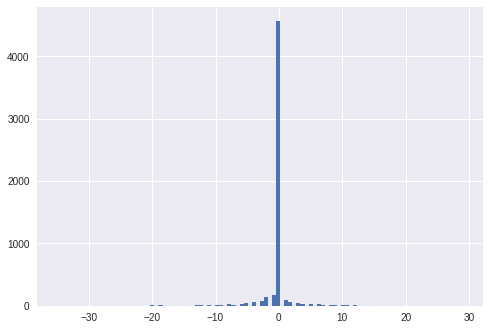

mean=-0.180 stdv=3.022
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3396.344, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.430, p=0.000
Sample does not look Gaussian (reject H0)


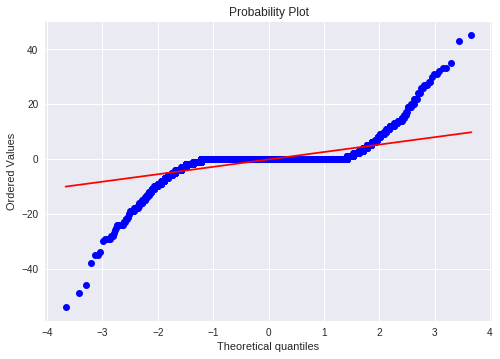

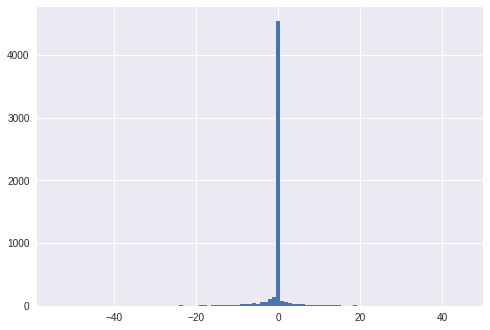

mean=-0.172 stdv=4.171
Statistics=0.421, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2219.899, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.422, p=0.000
Sample does not look Gaussian (reject H0)


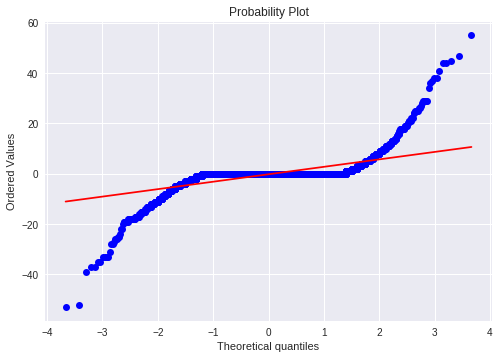

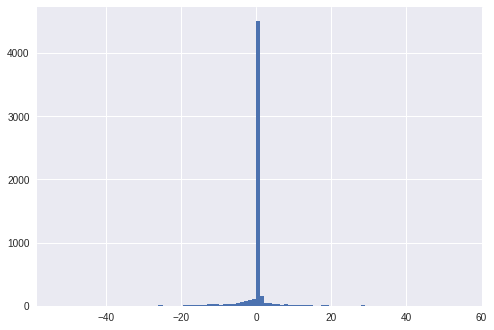

mean=-0.174 stdv=4.498
Statistics=0.434, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1831.305, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)


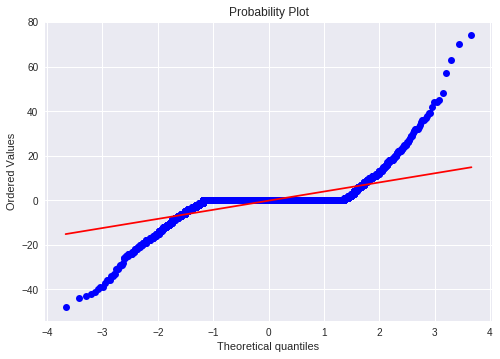

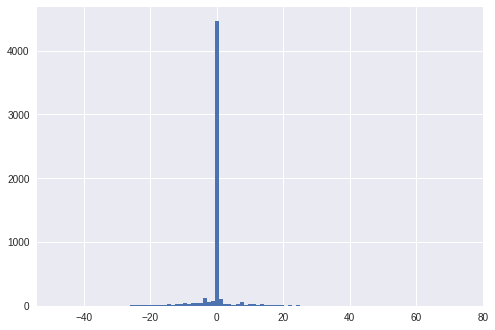

mean=-0.178 stdv=5.897
Statistics=0.483, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2225.382, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.415, p=0.000
Sample does not look Gaussian (reject H0)


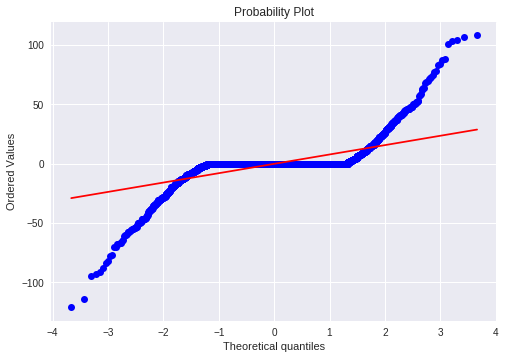

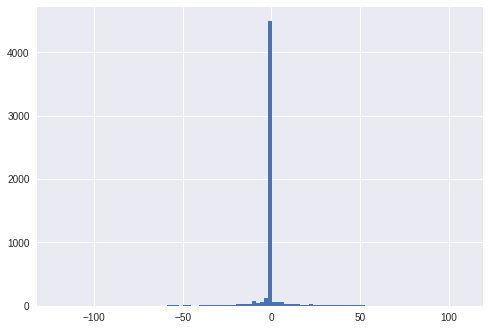

mean=-0.204 stdv=11.612
Statistics=0.461, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1511.662, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


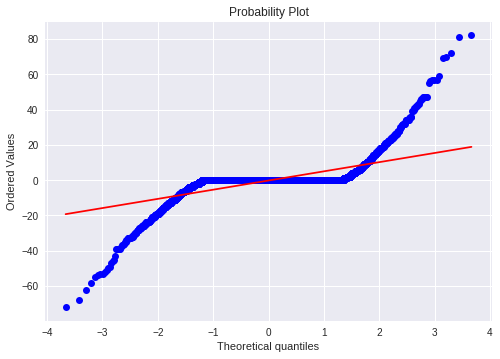

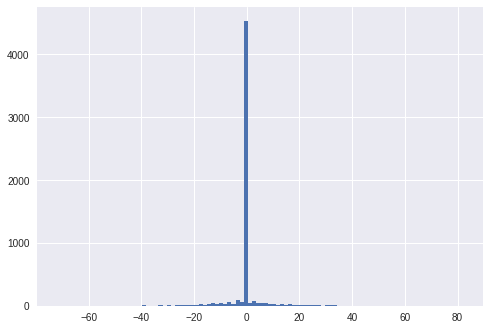

mean=-0.217 stdv=7.638
Statistics=0.464, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1749.023, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


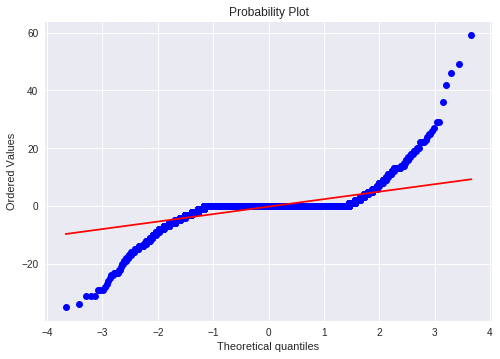

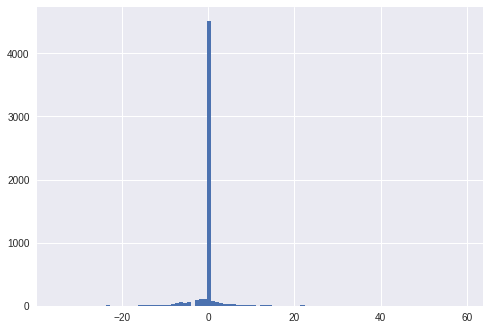

mean=-0.214 stdv=3.874
Statistics=0.446, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2292.615, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.427, p=0.000
Sample does not look Gaussian (reject H0)


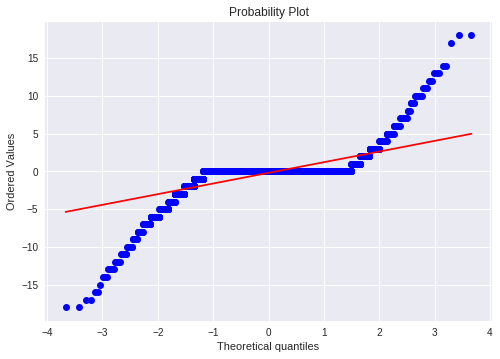

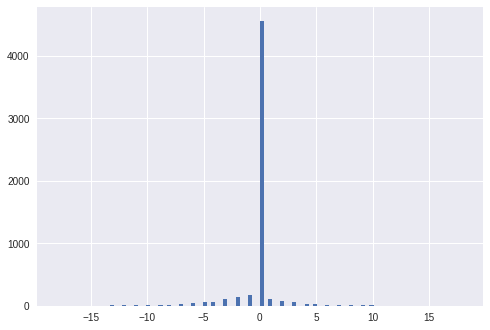

mean=-0.204 stdv=2.017
Statistics=0.490, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2122.473, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.433, p=0.000
Sample does not look Gaussian (reject H0)


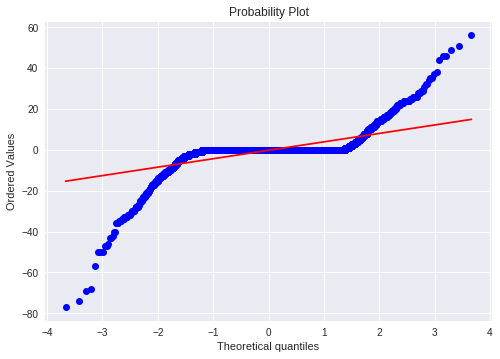

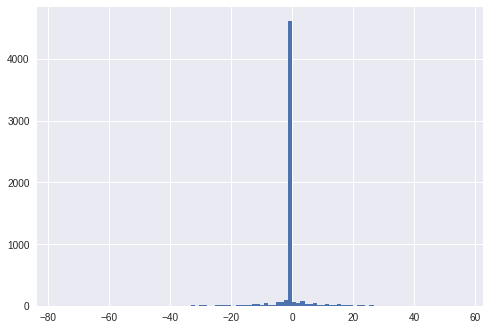

mean=-0.214 stdv=6.229
Statistics=0.440, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3061.257, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


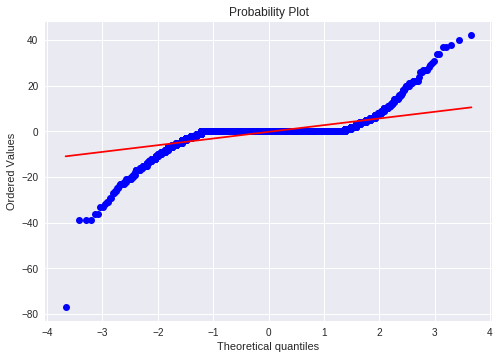

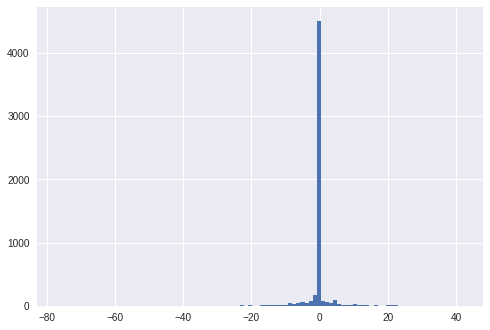

mean=-0.216 stdv=4.398
Statistics=0.444, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2550.391, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


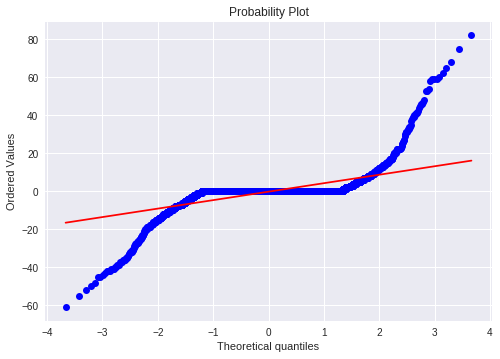

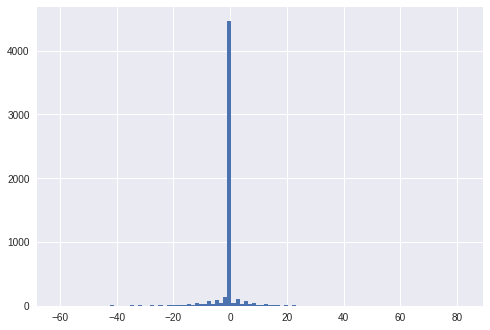

mean=-0.209 stdv=6.743
Statistics=0.437, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2400.616, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.411, p=0.000
Sample does not look Gaussian (reject H0)


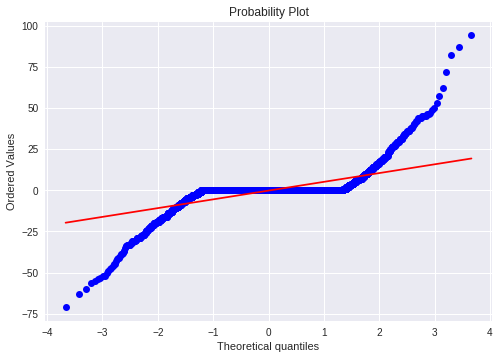

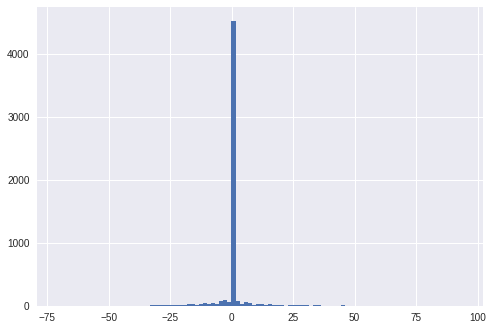

mean=-0.210 stdv=7.756
Statistics=0.471, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1828.306, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)


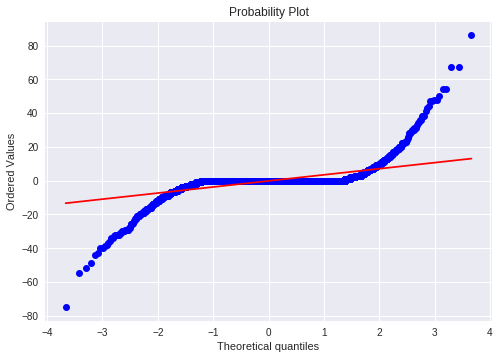

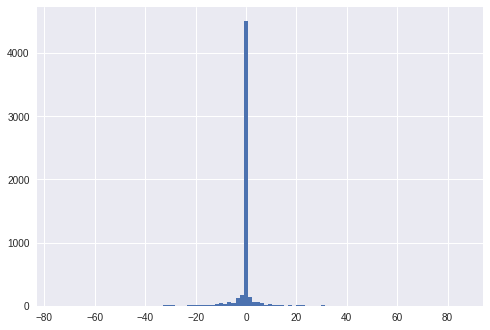

mean=-0.182 stdv=5.684
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2369.241, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


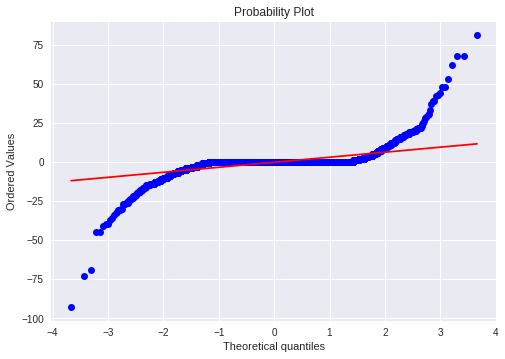

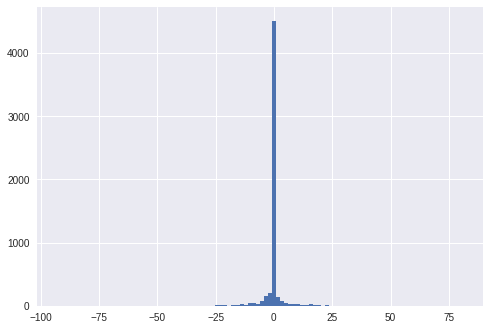

mean=-0.198 stdv=5.202
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2065.288, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.424, p=0.000
Sample does not look Gaussian (reject H0)


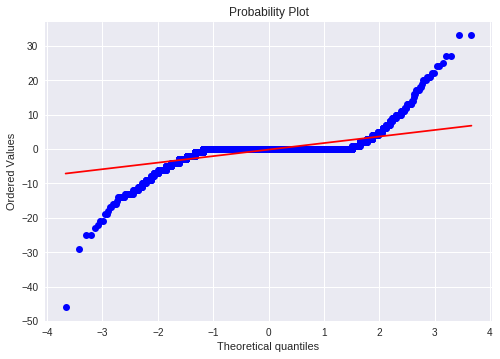

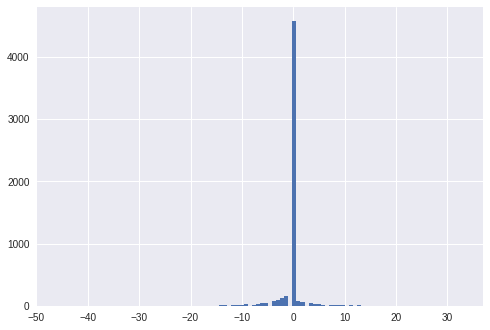

mean=-0.191 stdv=2.897
Statistics=0.431, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1764.494, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.435, p=0.000
Sample does not look Gaussian (reject H0)


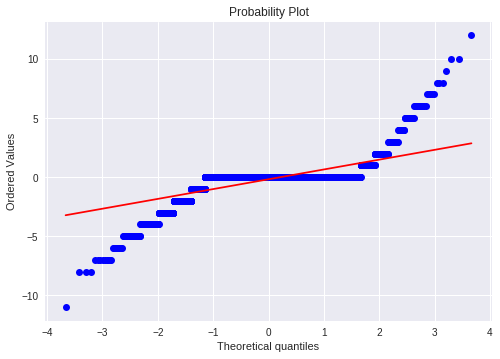

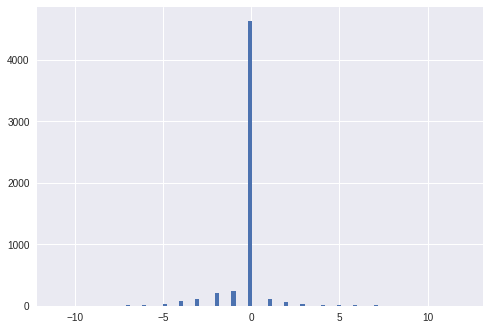

mean=-0.174 stdv=1.170
Statistics=0.504, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1425.593, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.452, p=0.000
Sample does not look Gaussian (reject H0)


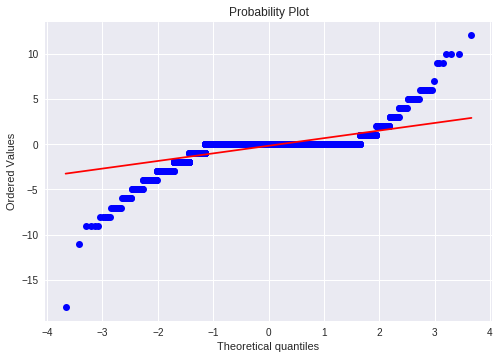

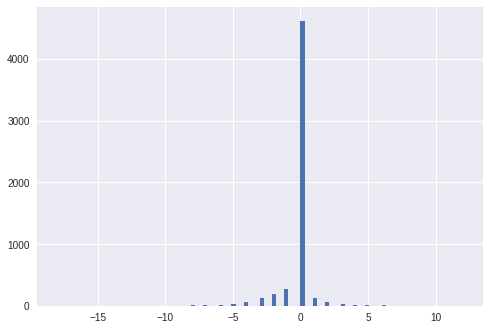

mean=-0.182 stdv=1.205
Statistics=0.486, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2583.356, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.451, p=0.000
Sample does not look Gaussian (reject H0)


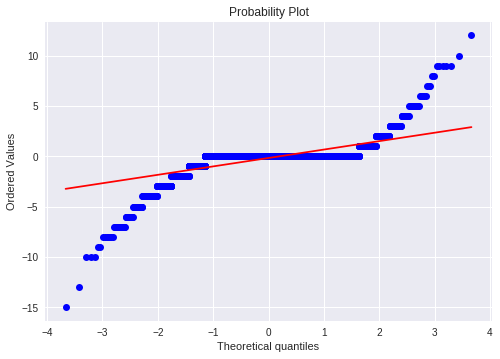

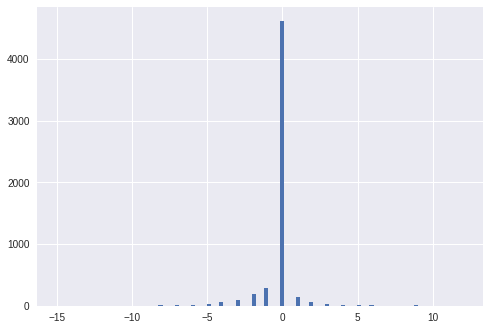

mean=-0.176 stdv=1.206
Statistics=0.482, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2580.558, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.449, p=0.000
Sample does not look Gaussian (reject H0)


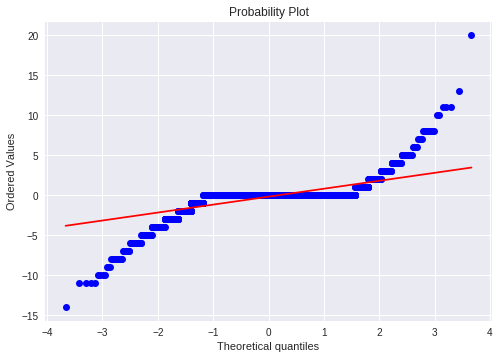

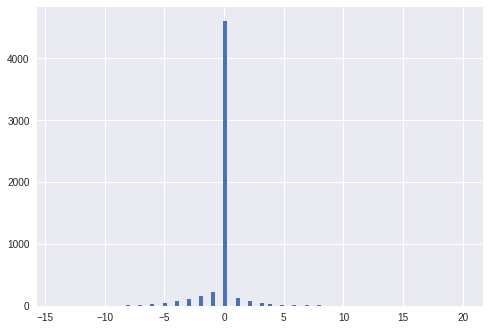

mean=-0.172 stdv=1.419
Statistics=0.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1709.175, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.442, p=0.000
Sample does not look Gaussian (reject H0)


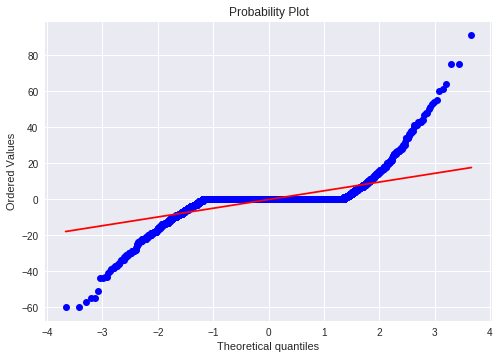

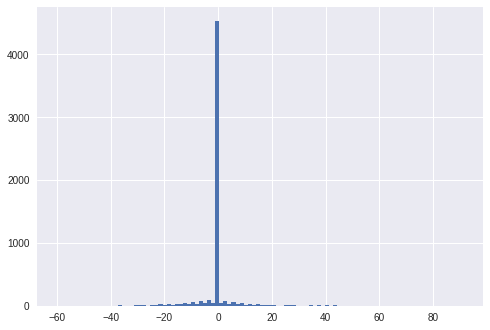

mean=-0.176 stdv=7.093
Statistics=0.468, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2400.321, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


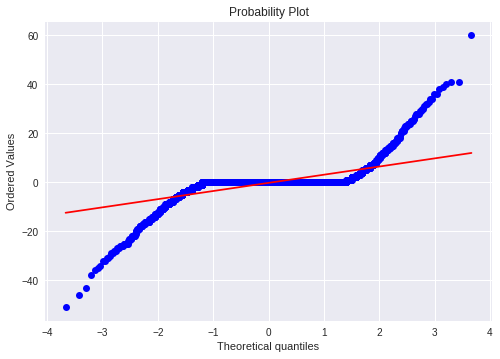

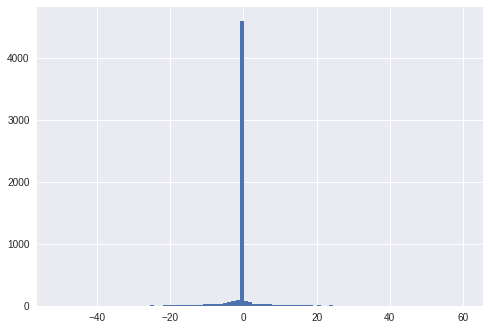

mean=-0.218 stdv=4.942
Statistics=0.455, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1552.158, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.420, p=0.000
Sample does not look Gaussian (reject H0)


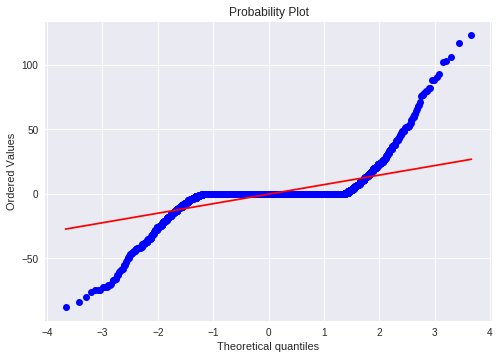

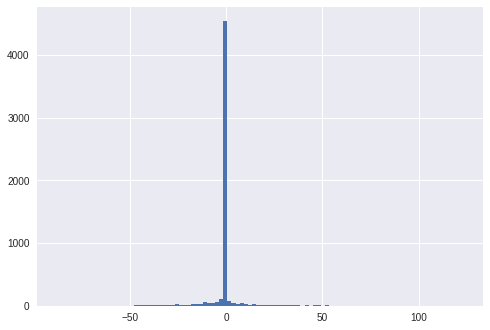

mean=-0.246 stdv=11.174
Statistics=0.439, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2172.577, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


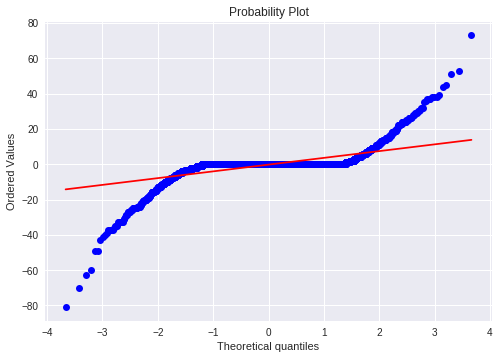

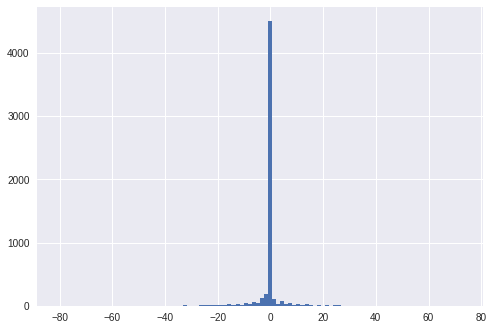

mean=-0.210 stdv=5.838
Statistics=0.431, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2343.928, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


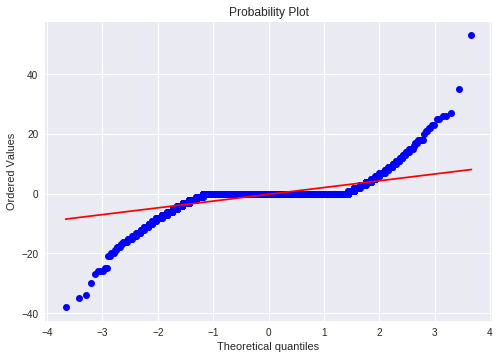

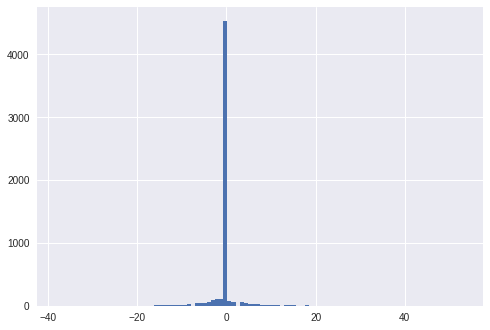

mean=-0.203 stdv=3.356
Statistics=0.457, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1715.047, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.425, p=0.000
Sample does not look Gaussian (reject H0)


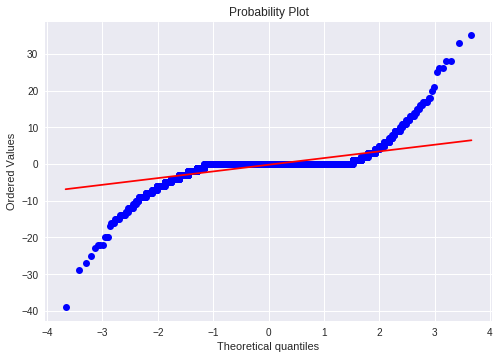

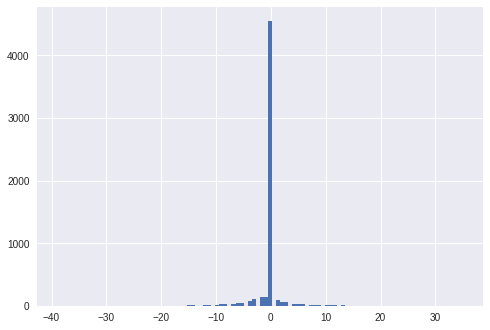

mean=-0.214 stdv=2.758
Statistics=0.436, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1778.487, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.436, p=0.000
Sample does not look Gaussian (reject H0)


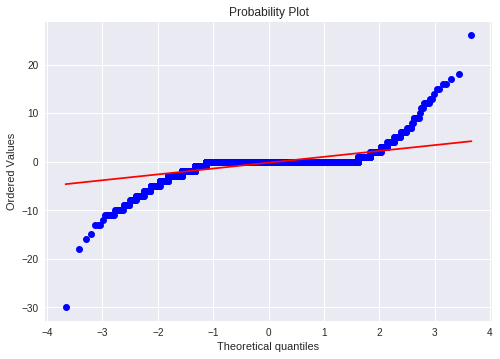

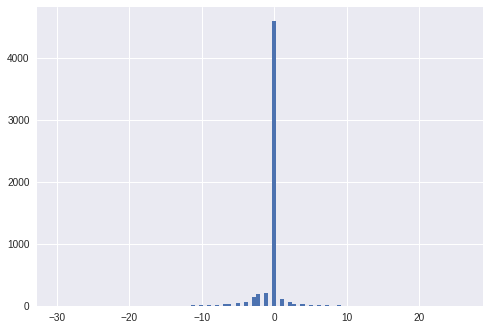

mean=-0.221 stdv=1.812
Statistics=0.445, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2002.678, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.448, p=0.000
Sample does not look Gaussian (reject H0)


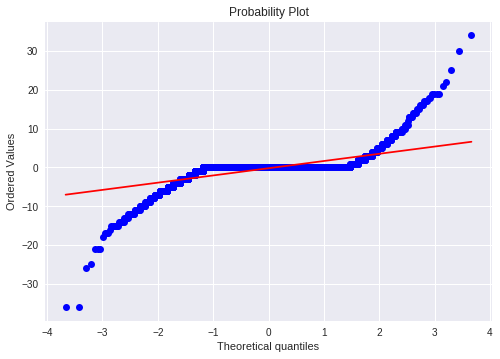

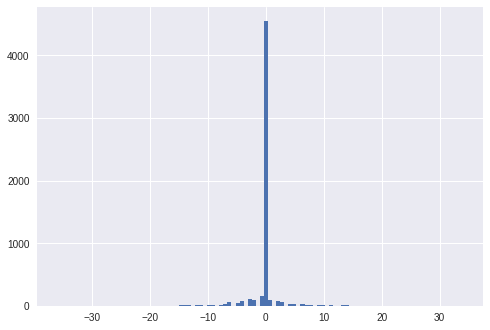

mean=-0.206 stdv=2.753
Statistics=0.457, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1883.002, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.430, p=0.000
Sample does not look Gaussian (reject H0)


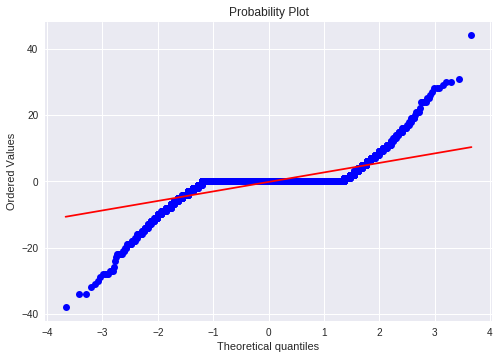

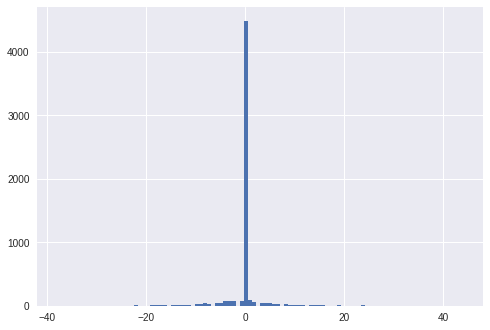

mean=-0.205 stdv=4.087
Statistics=0.493, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1581.755, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


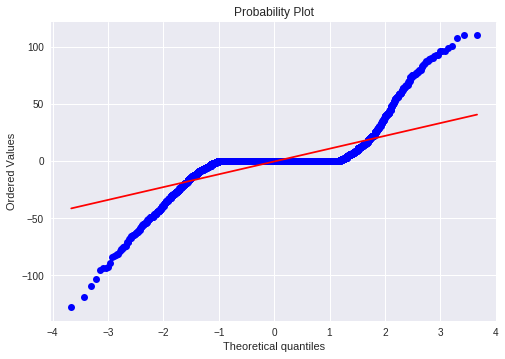

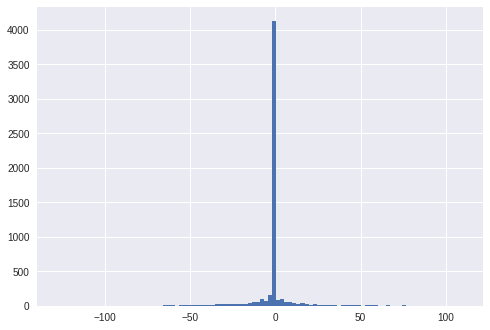

mean=-0.407 stdv=15.250
Statistics=0.540, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1401.582, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


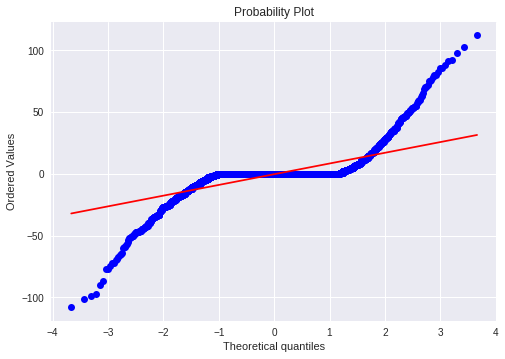

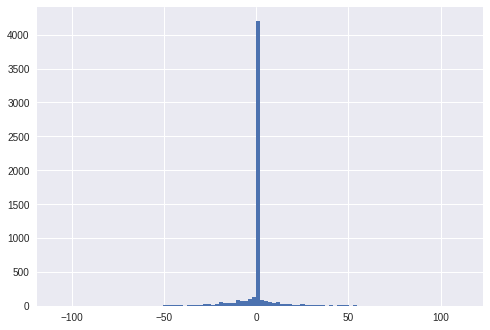

mean=-0.354 stdv=11.919
Statistics=0.530, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1517.850, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


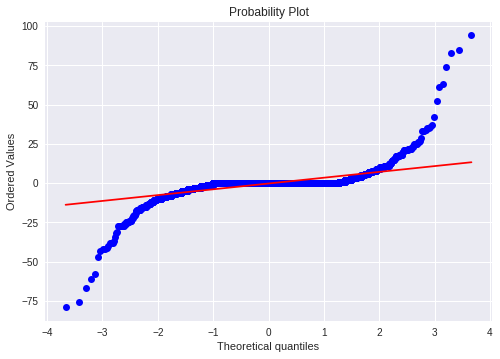

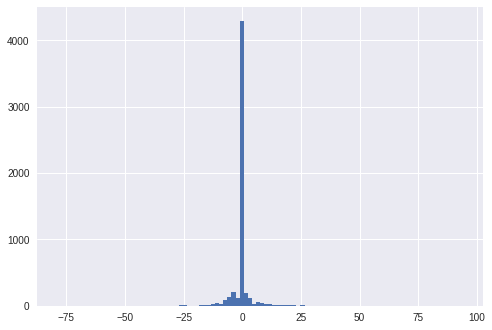

mean=-0.264 stdv=5.645
Statistics=0.430, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2731.841, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


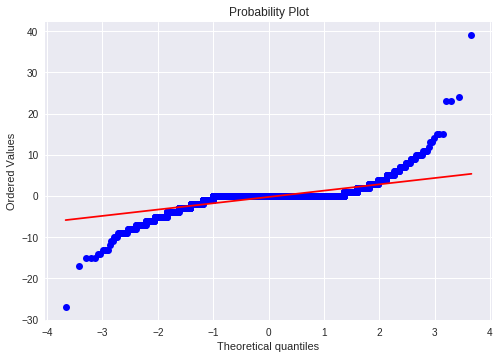

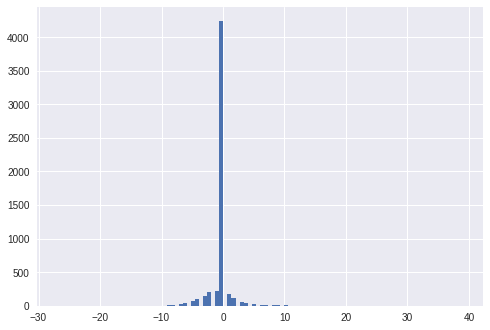

mean=-0.228 stdv=2.088
Statistics=0.540, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2621.156, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


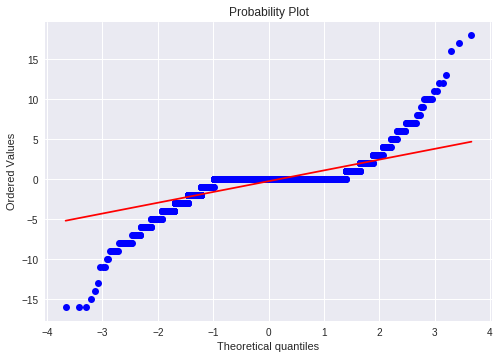

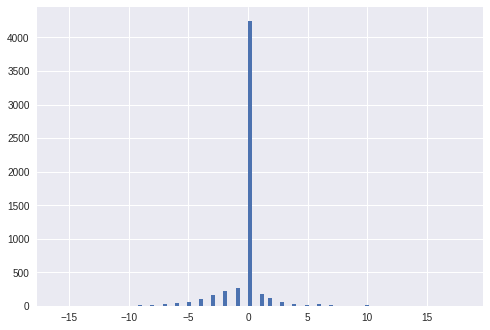

mean=-0.236 stdv=1.775
Statistics=0.577, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1499.411, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


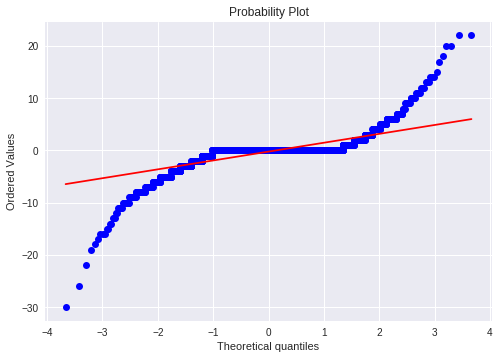

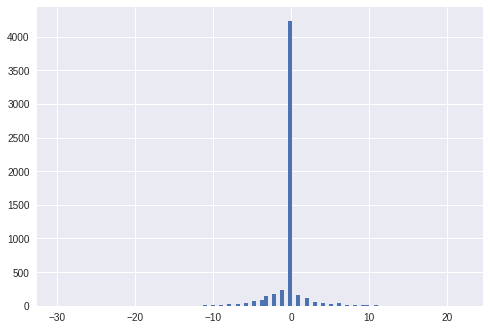

mean=-0.229 stdv=2.287
Statistics=0.552, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1927.495, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)


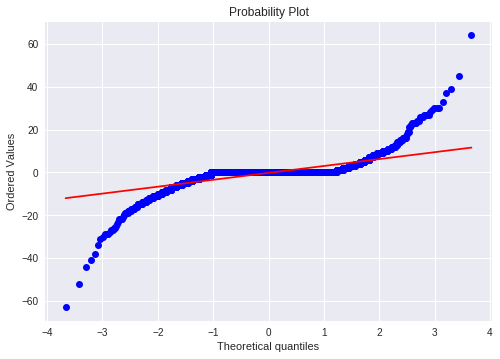

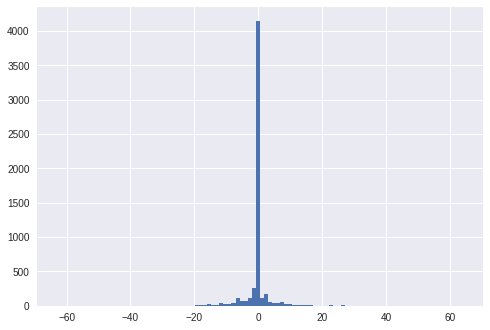

mean=-0.235 stdv=4.460
Statistics=0.524, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1771.214, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


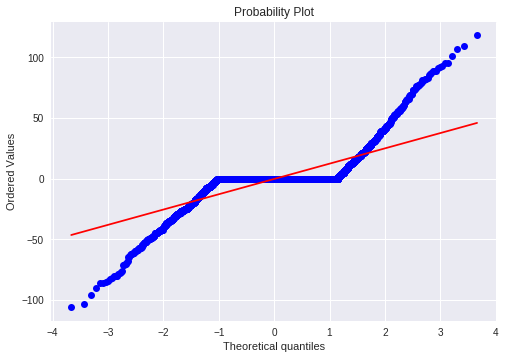

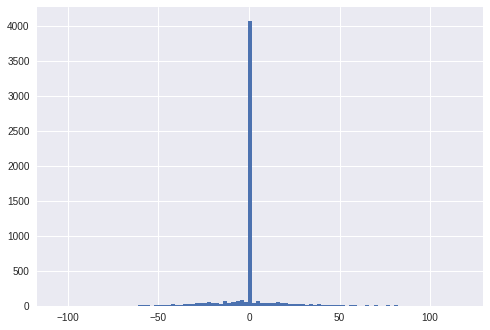

mean=-0.304 stdv=15.996
Statistics=0.621, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1229.141, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


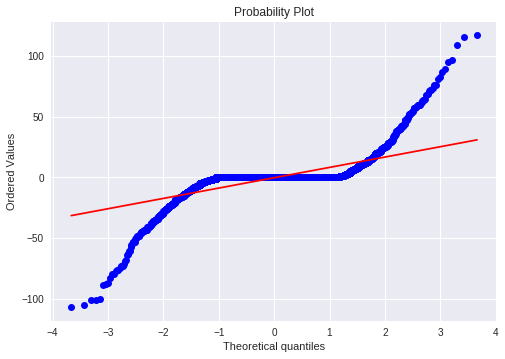

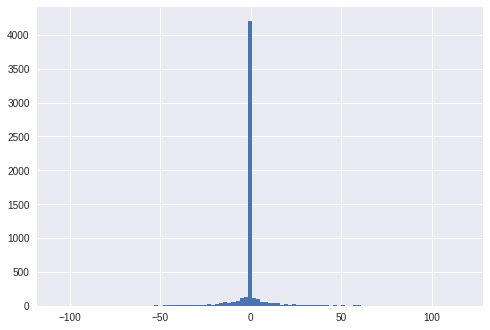

mean=-0.294 stdv=11.987
Statistics=0.505, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1482.028, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


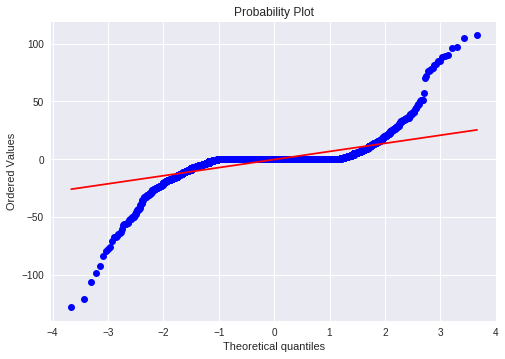

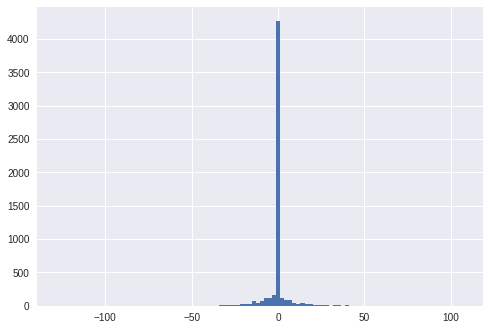

mean=-0.316 stdv=10.238
Statistics=0.468, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1731.435, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


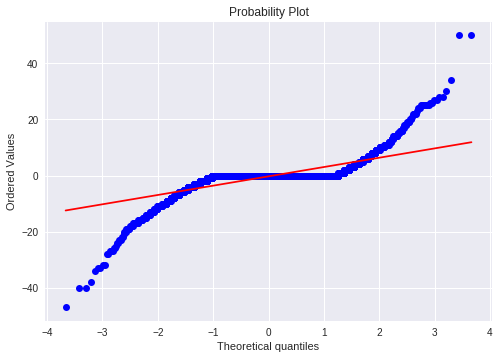

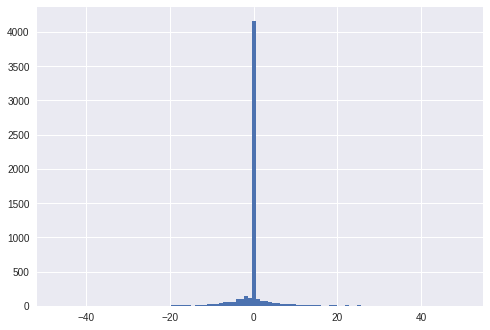

mean=-0.297 stdv=4.484
Statistics=0.550, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1520.782, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


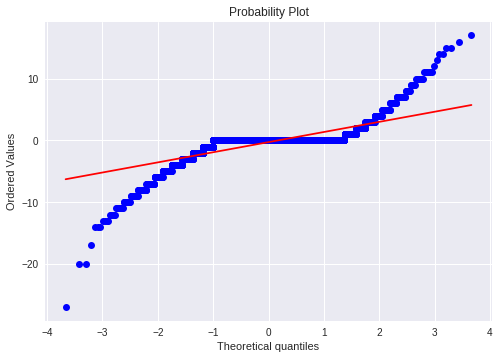

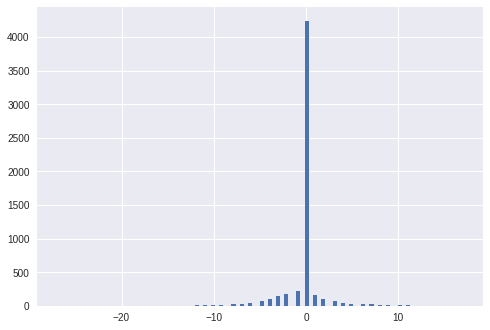

mean=-0.275 stdv=2.161
Statistics=0.576, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2076.596, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.415, p=0.000
Sample does not look Gaussian (reject H0)


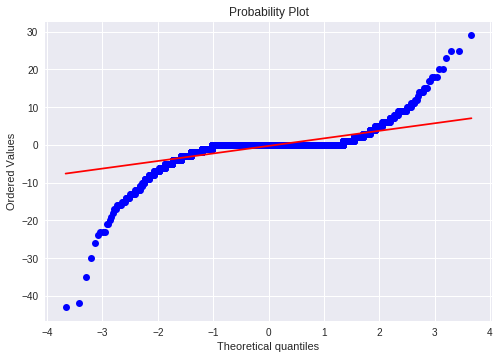

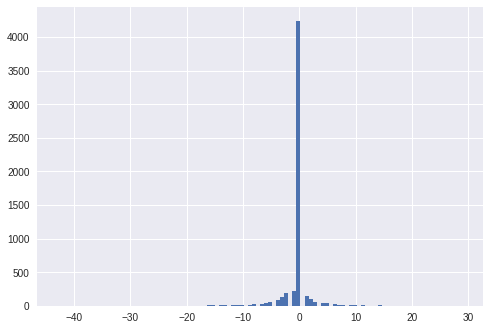

mean=-0.274 stdv=2.850
Statistics=0.493, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3621.049, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.411, p=0.000
Sample does not look Gaussian (reject H0)


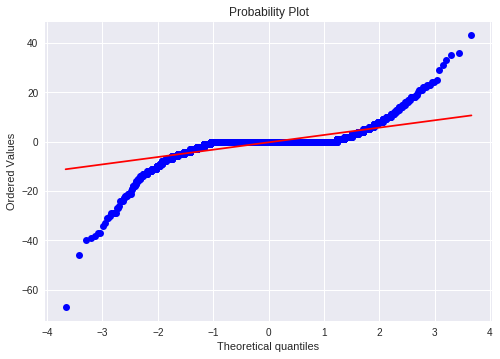

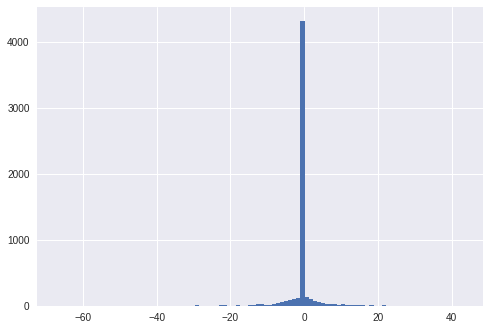

mean=-0.274 stdv=4.192
Statistics=0.504, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3212.059, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


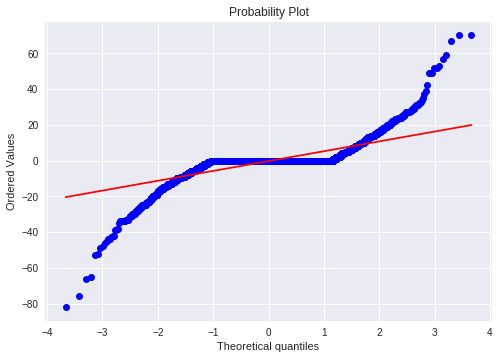

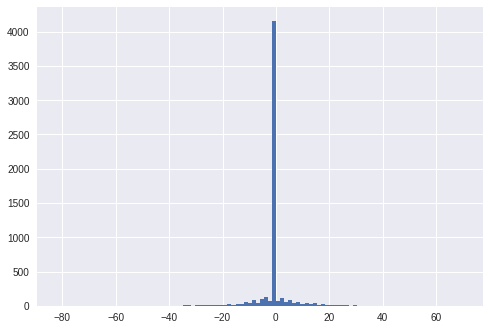

mean=-0.271 stdv=7.318
Statistics=0.566, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1601.743, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


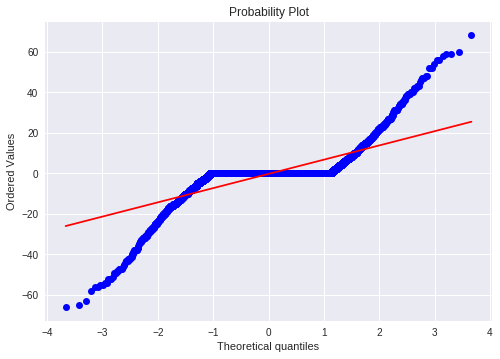

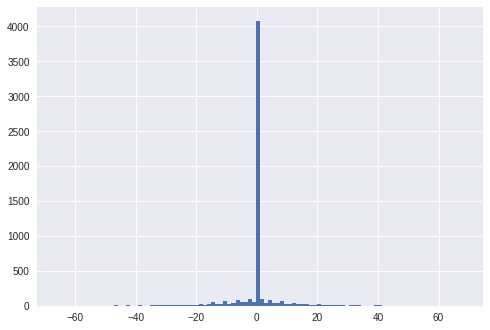

mean=-0.274 stdv=9.125
Statistics=0.592, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1220.493, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


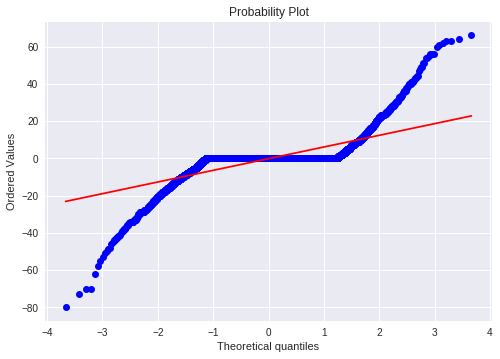

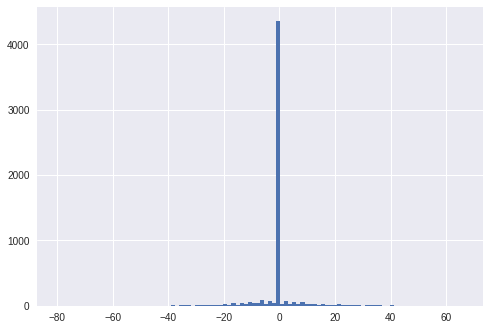

mean=-0.204 stdv=8.539
Statistics=0.539, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1333.691, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


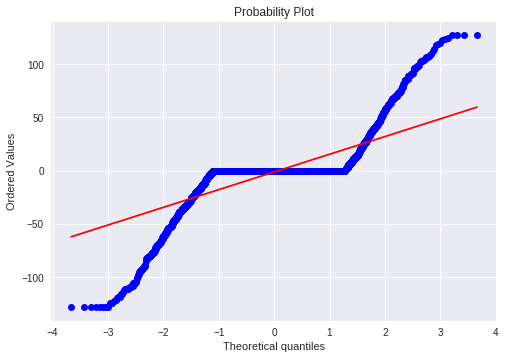

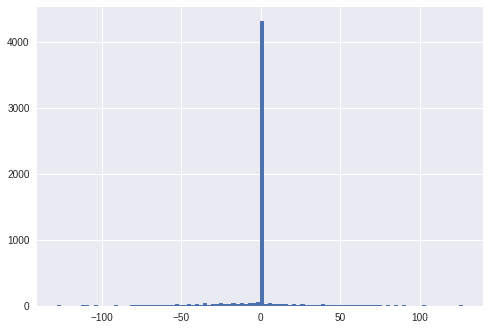

mean=-1.105 stdv=22.128
Statistics=0.562, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1157.620, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


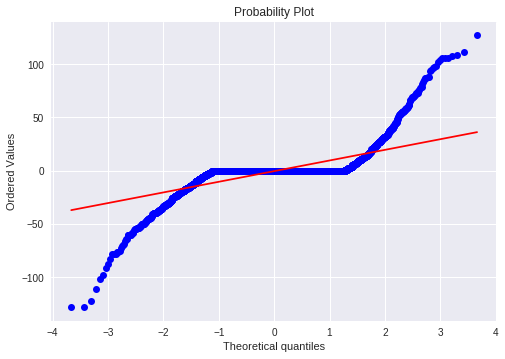

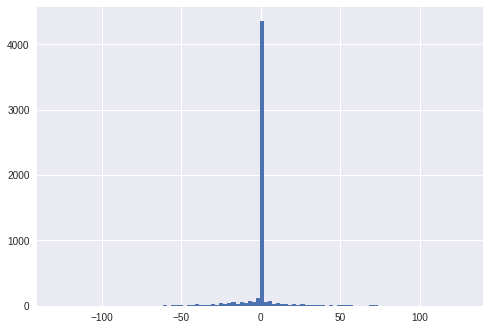

mean=-0.337 stdv=14.048
Statistics=0.505, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1743.860, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


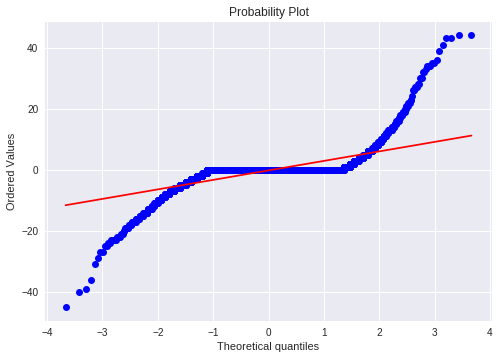

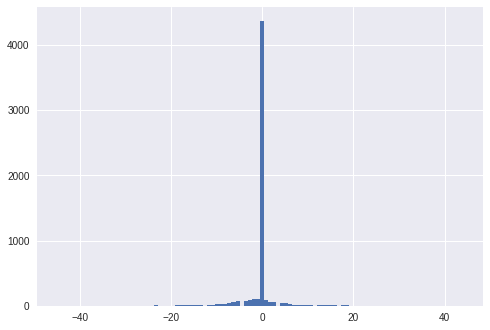

mean=-0.200 stdv=4.466
Statistics=0.486, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2296.885, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


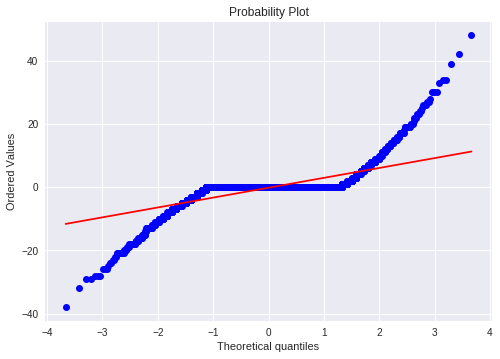

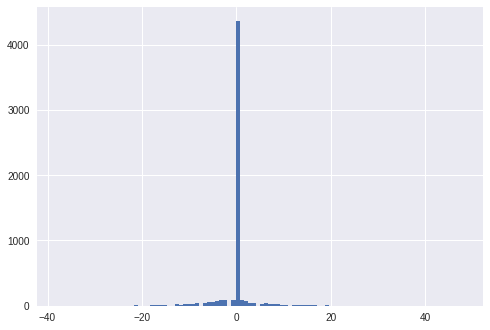

mean=-0.194 stdv=4.325
Statistics=0.523, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1617.980, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


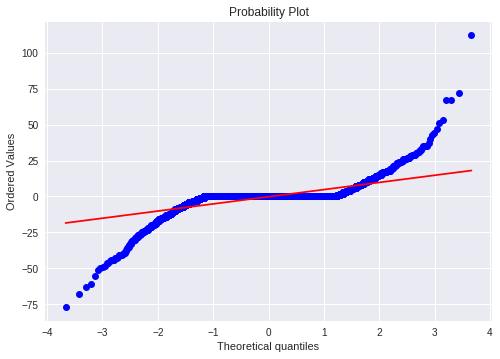

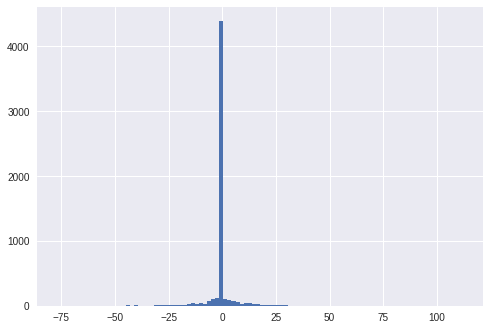

mean=-0.192 stdv=7.087
Statistics=0.494, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1702.421, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


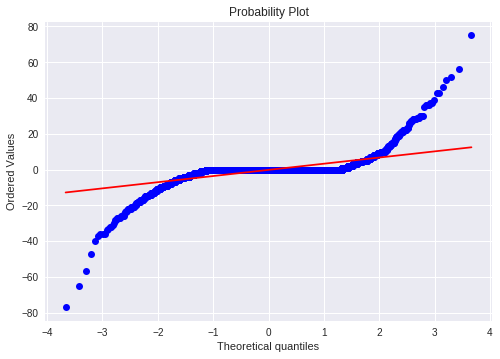

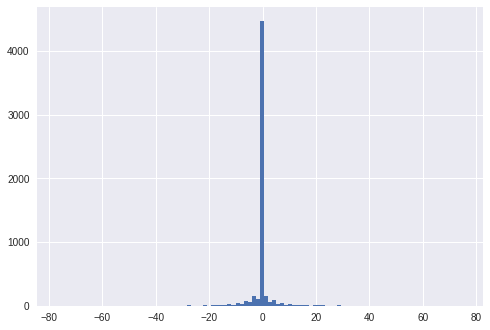

mean=-0.196 stdv=5.187
Statistics=0.443, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1844.541, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


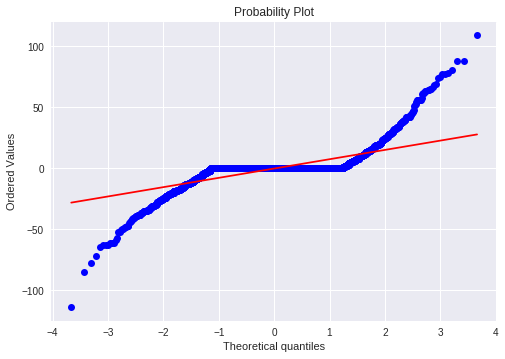

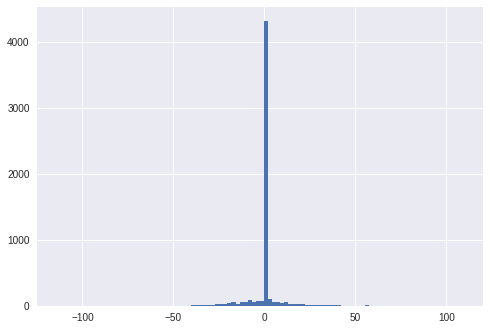

mean=-0.217 stdv=10.436
Statistics=0.536, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1731.752, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


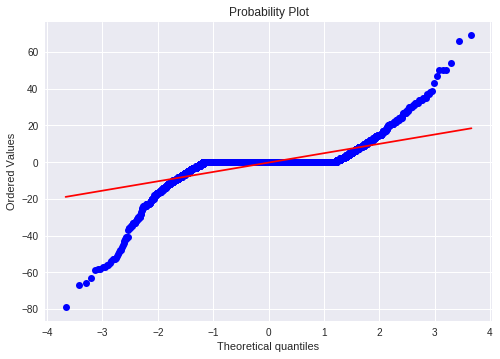

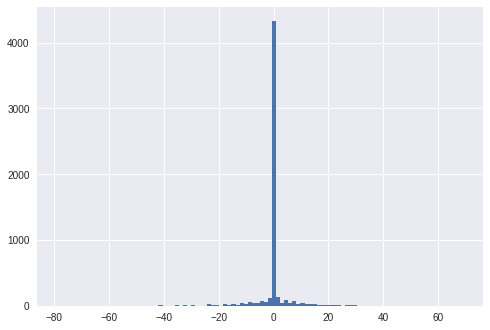

mean=-0.247 stdv=7.277
Statistics=0.491, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2734.640, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


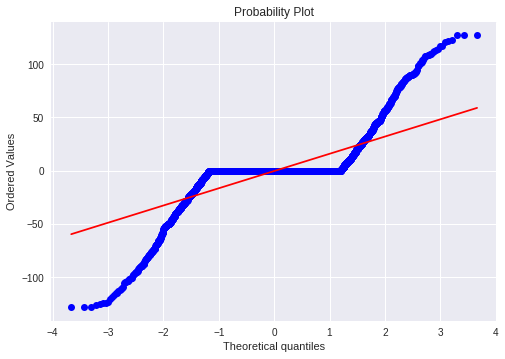

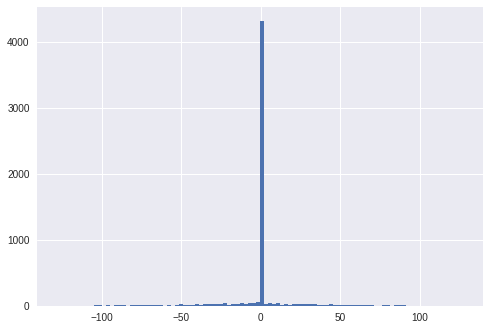

mean=-0.241 stdv=21.556
Statistics=0.562, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1078.620, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


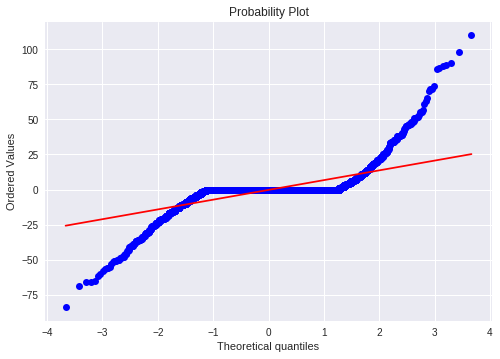

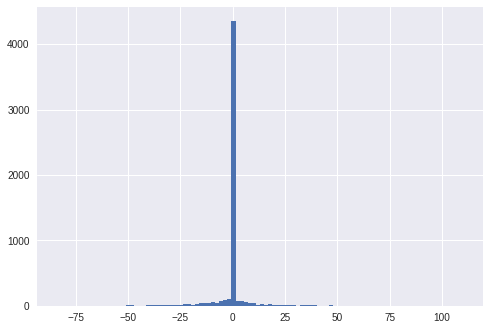

mean=-0.266 stdv=9.833
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2098.174, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


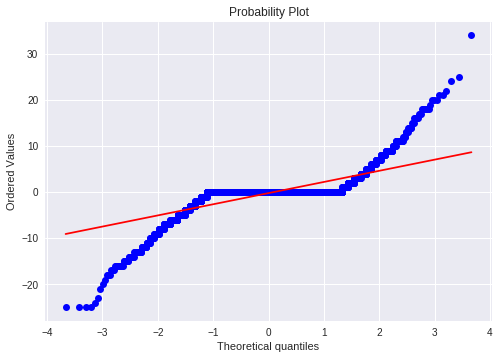

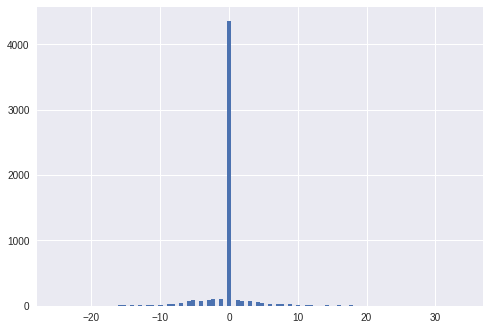

mean=-0.231 stdv=3.258
Statistics=0.553, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1319.372, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


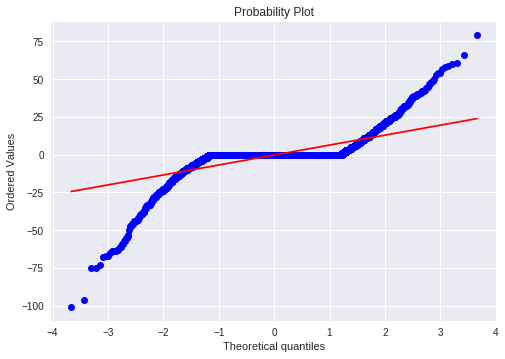

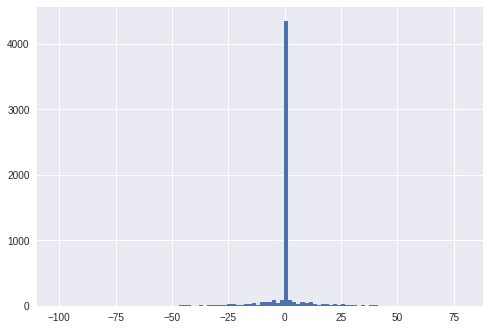

mean=-0.224 stdv=9.201
Statistics=0.513, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2310.107, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


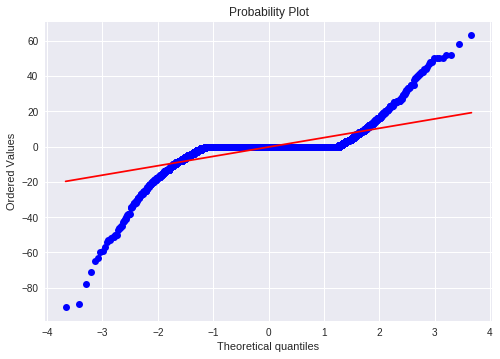

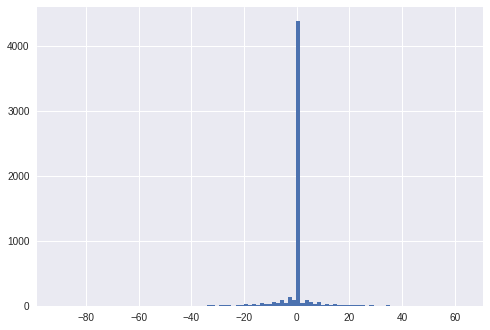

mean=-0.241 stdv=7.647
Statistics=0.483, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2507.615, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


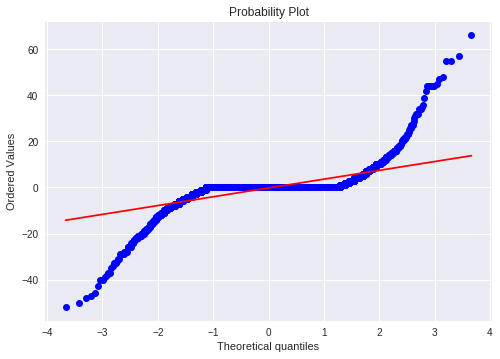

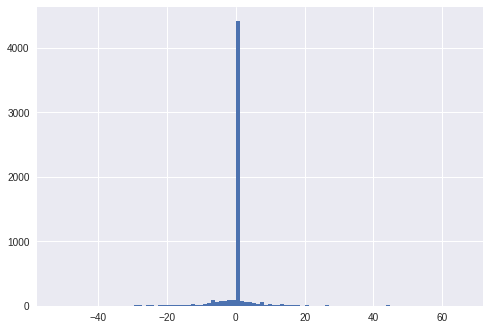

mean=-0.229 stdv=5.579
Statistics=0.470, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1761.589, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


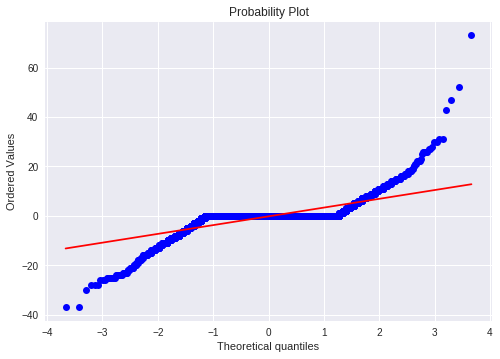

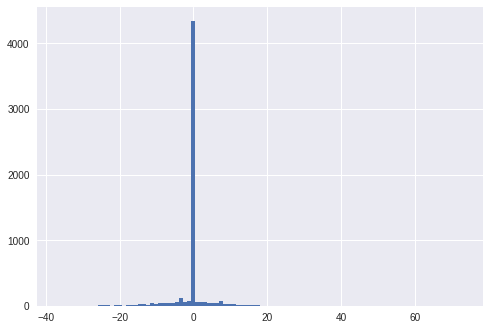

mean=-0.229 stdv=4.797
Statistics=0.548, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1745.169, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


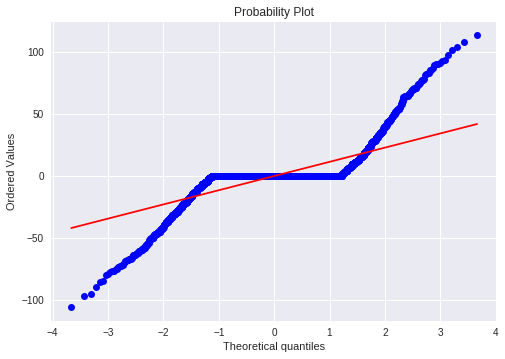

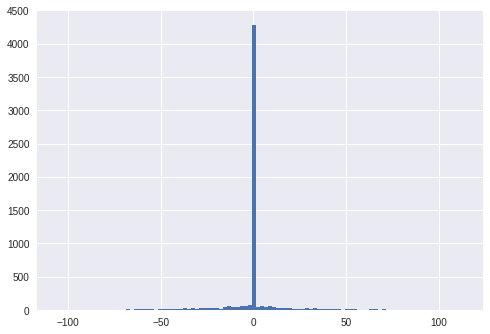

mean=-0.304 stdv=15.281
Statistics=0.560, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1231.469, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


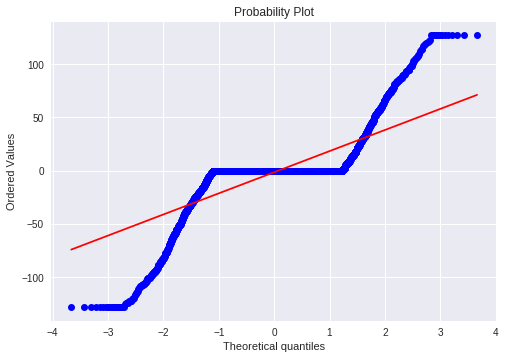

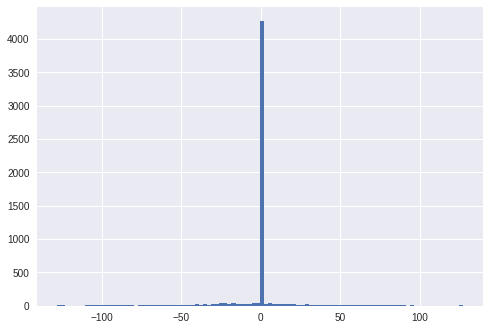

mean=-1.365 stdv=26.017
Statistics=0.579, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1167.966, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


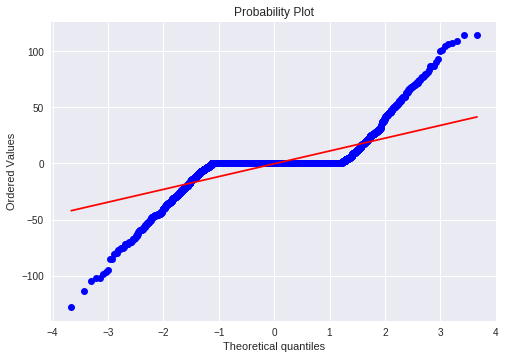

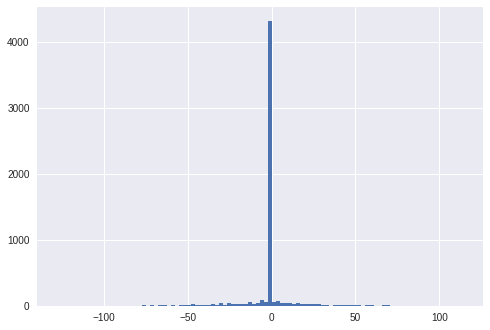

mean=-0.301 stdv=15.414
Statistics=0.546, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1235.182, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


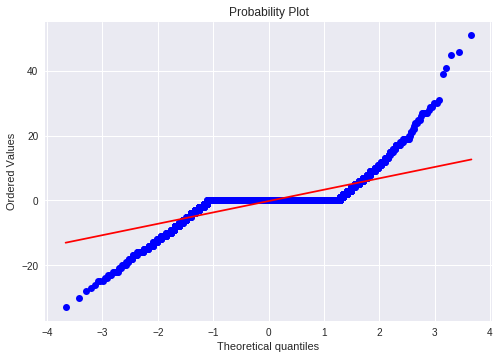

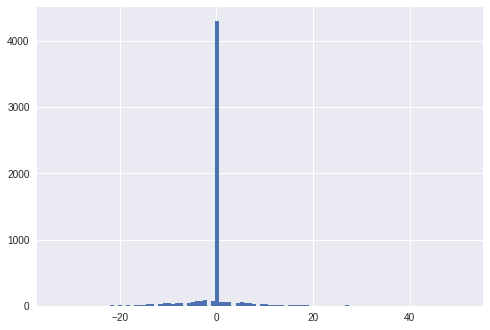

mean=-0.199 stdv=4.681
Statistics=0.563, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1772.078, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


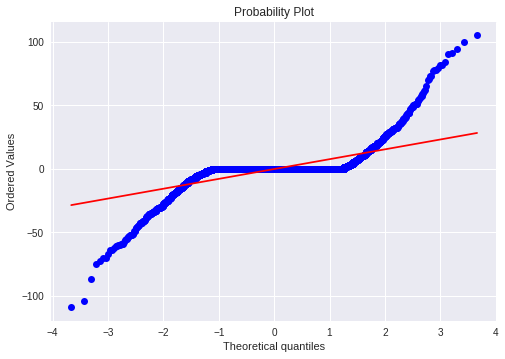

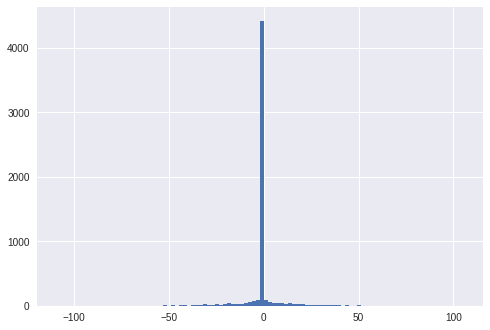

mean=-0.206 stdv=10.966
Statistics=0.500, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1562.490, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


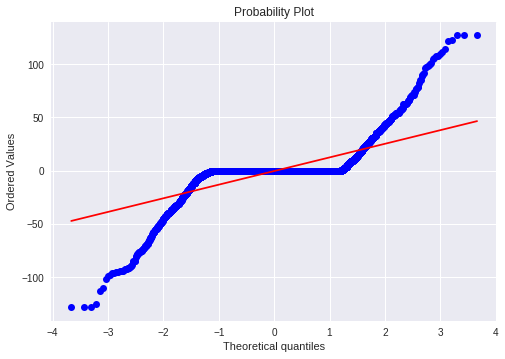

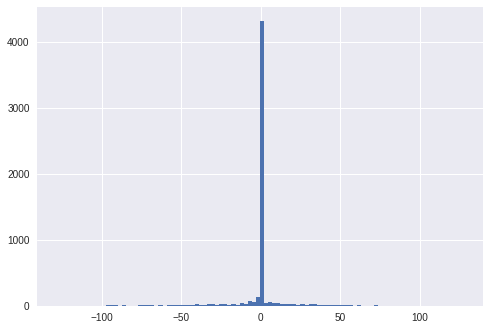

mean=-0.246 stdv=17.546
Statistics=0.531, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1271.761, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


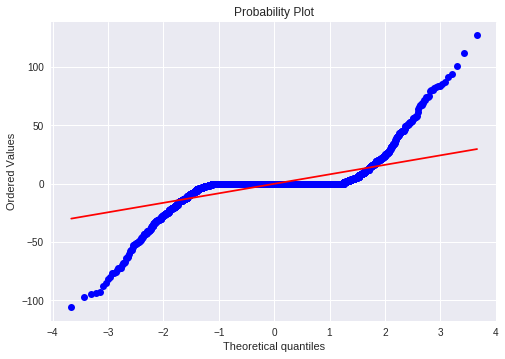

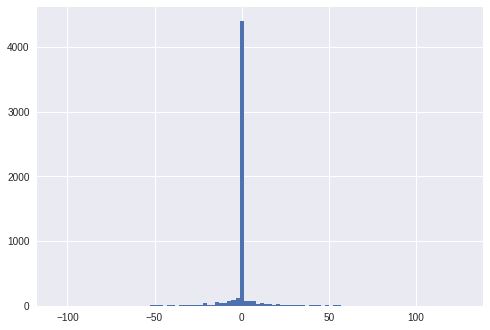

mean=-0.235 stdv=11.847
Statistics=0.472, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1618.311, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


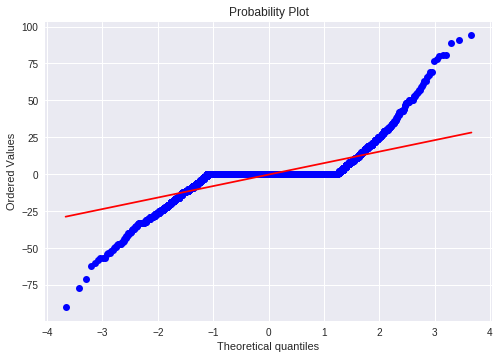

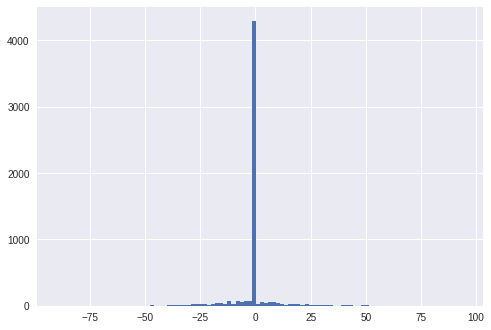

mean=-0.231 stdv=10.401
Statistics=0.559, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1765.323, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


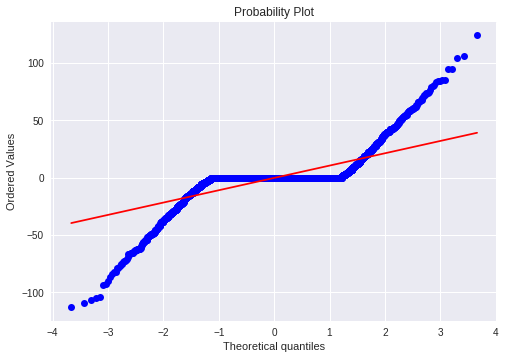

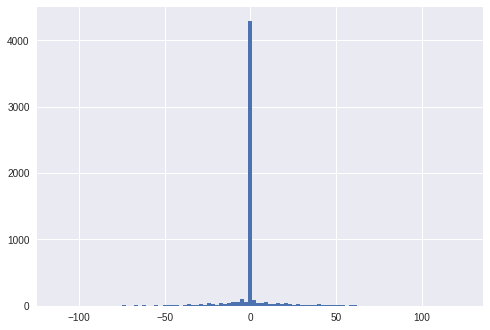

mean=-0.264 stdv=14.515
Statistics=0.548, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1233.863, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


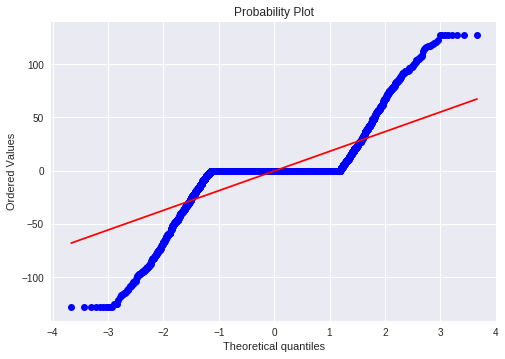

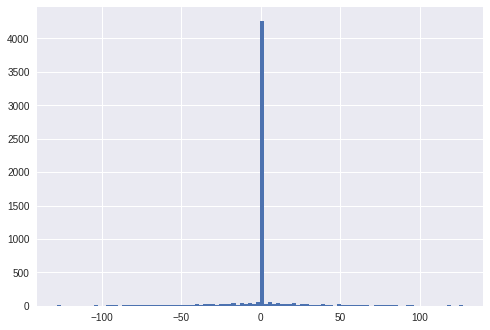

mean=-0.237 stdv=24.205
Statistics=0.580, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=976.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


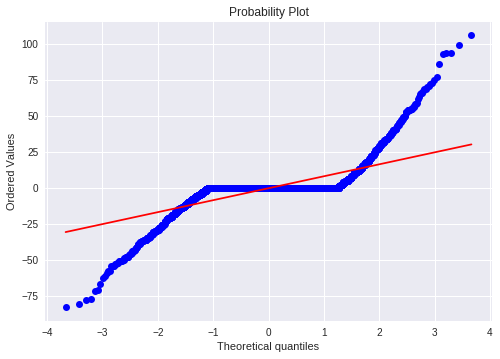

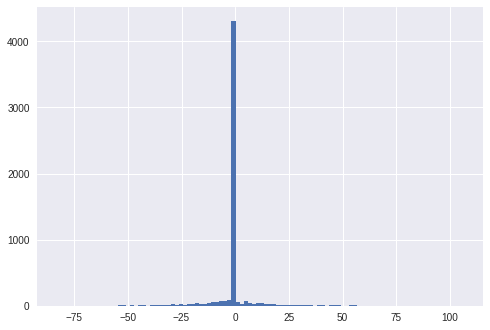

mean=-0.266 stdv=11.324
Statistics=0.540, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1751.259, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


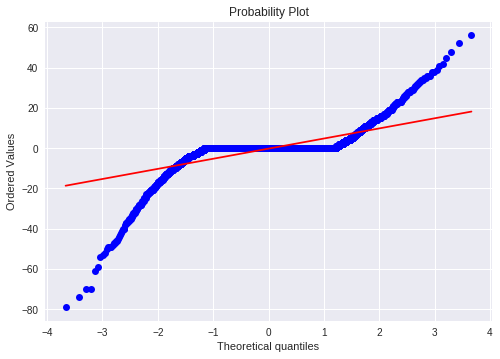

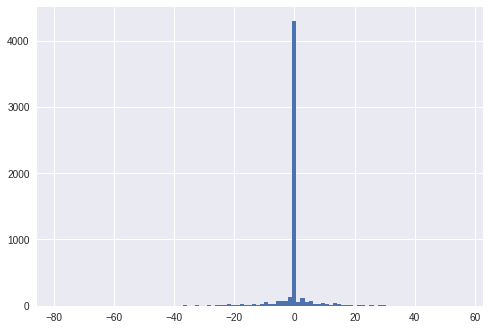

mean=-0.239 stdv=7.059
Statistics=0.507, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2891.137, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


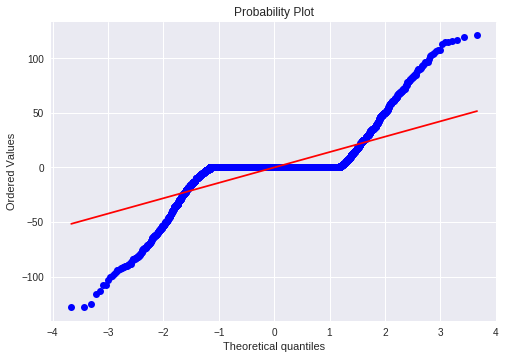

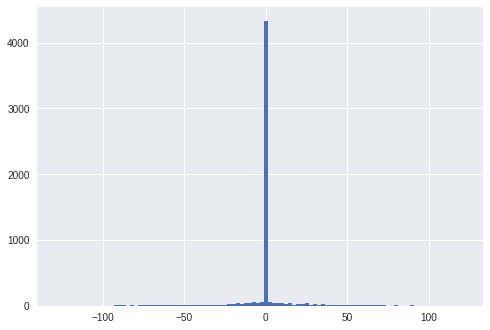

mean=0.020 stdv=19.052
Statistics=0.547, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1102.182, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


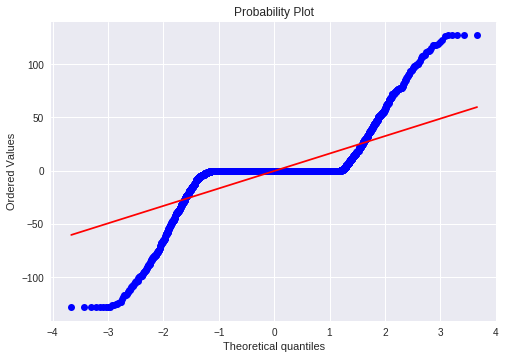

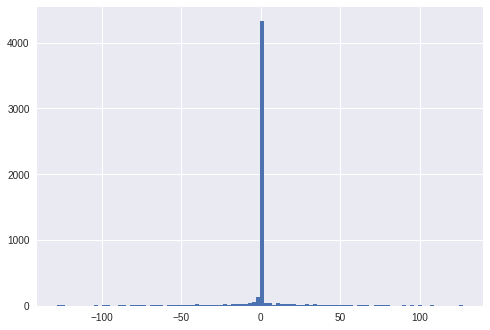

mean=-0.217 stdv=22.510
Statistics=0.528, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1250.353, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


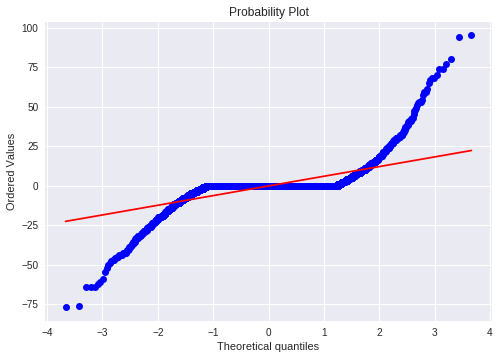

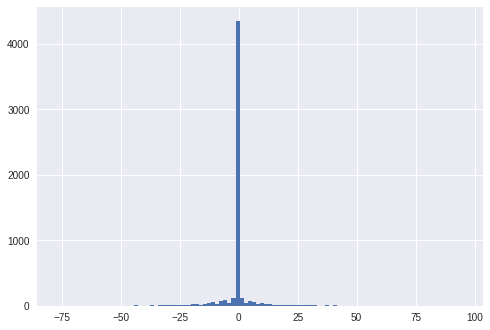

mean=-0.254 stdv=8.730
Statistics=0.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1886.169, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


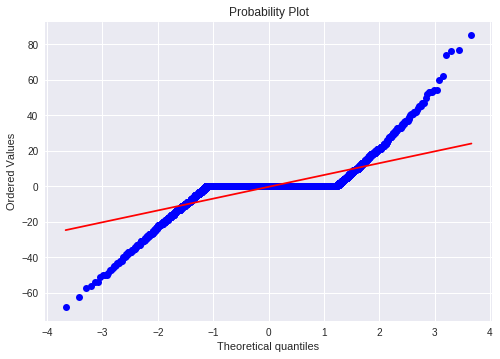

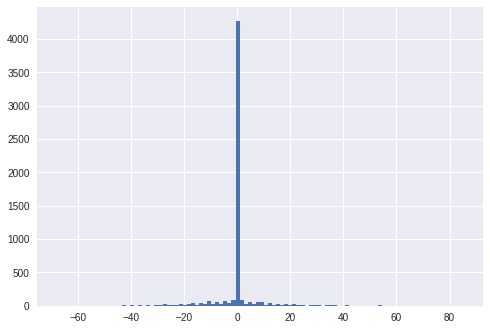

mean=-0.236 stdv=8.881
Statistics=0.561, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1322.806, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


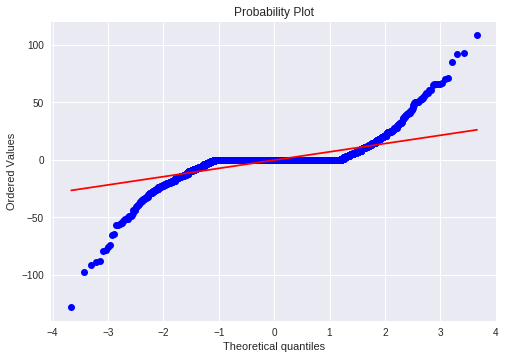

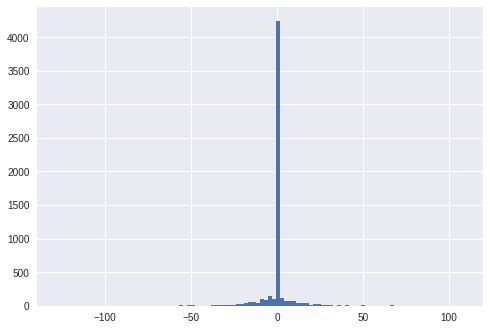

mean=-0.273 stdv=10.006
Statistics=0.516, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1595.110, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


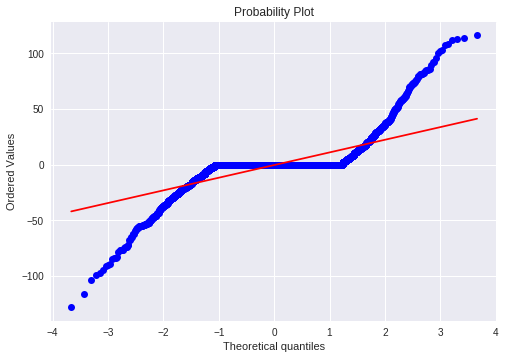

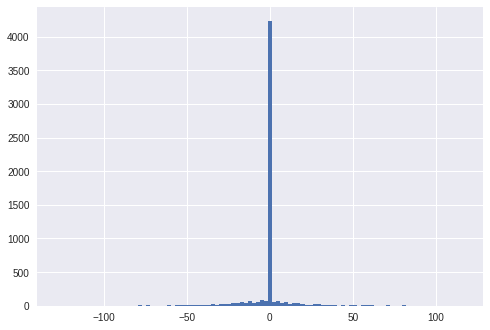

mean=-0.392 stdv=15.224
Statistics=0.556, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1434.951, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


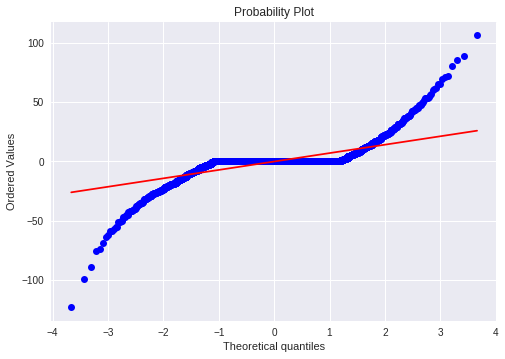

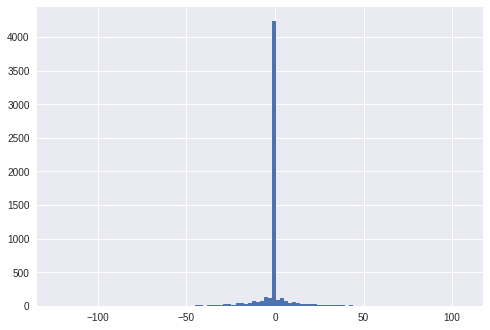

mean=-0.248 stdv=9.686
Statistics=0.536, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1509.938, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


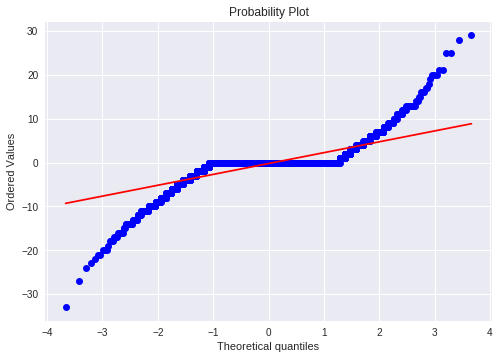

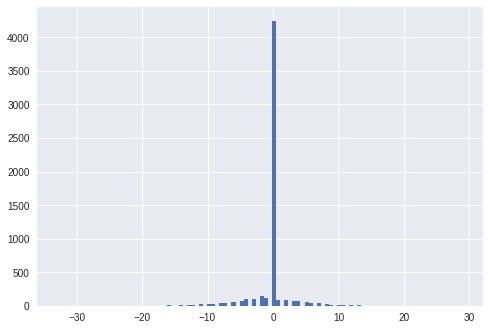

mean=-0.226 stdv=3.253
Statistics=0.581, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1429.128, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


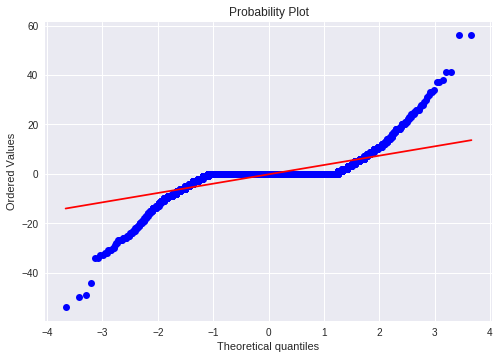

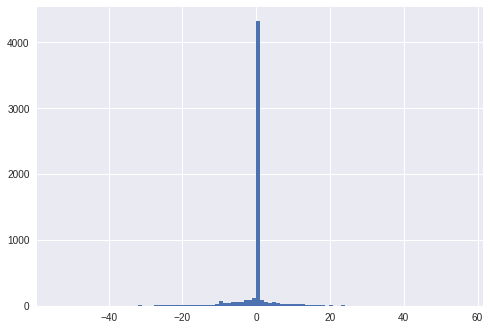

mean=-0.224 stdv=5.217
Statistics=0.525, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1516.011, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


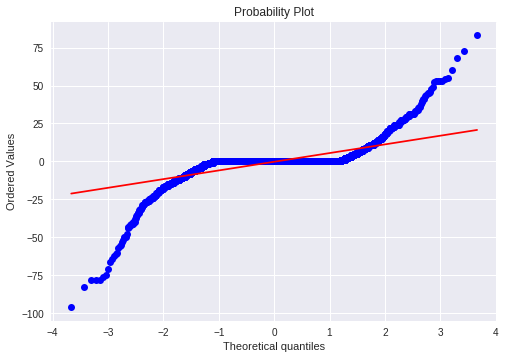

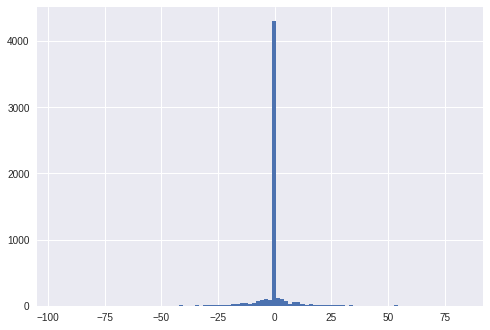

mean=-0.208 stdv=8.153
Statistics=0.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2424.093, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


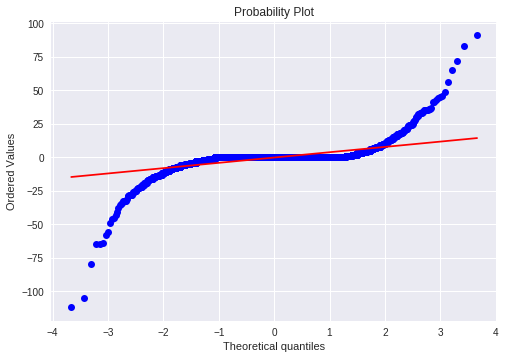

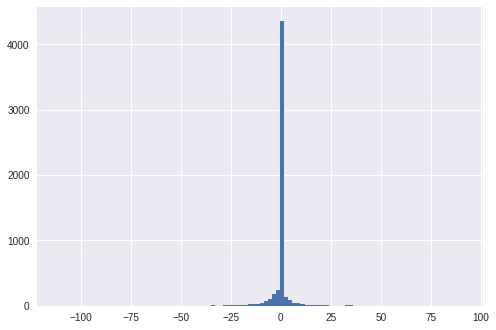

mean=-0.209 stdv=6.259
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2999.483, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


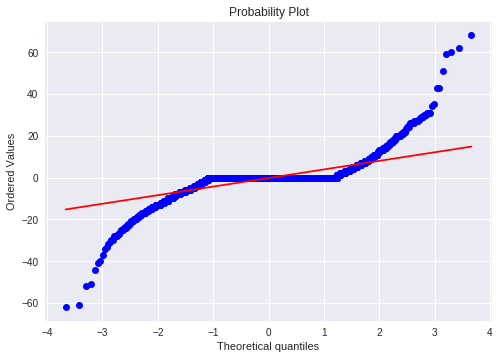

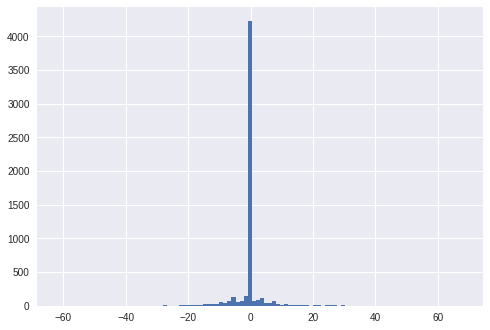

mean=-0.211 stdv=5.610
Statistics=0.536, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1737.583, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


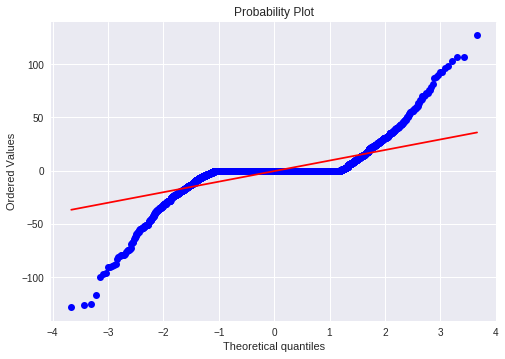

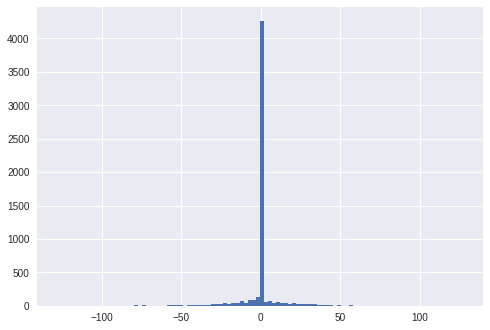

mean=-0.312 stdv=13.623
Statistics=0.528, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1573.544, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


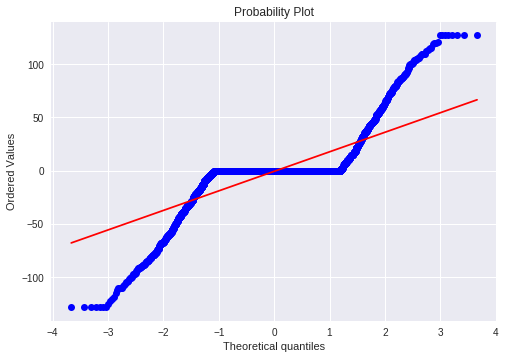

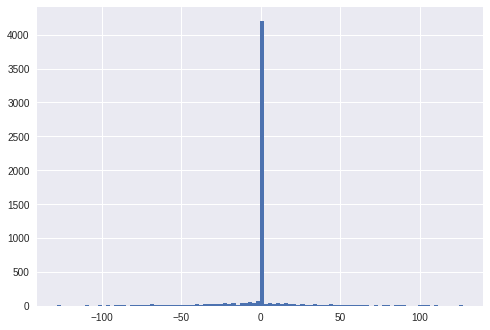

mean=-0.536 stdv=23.763
Statistics=0.594, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=949.747, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


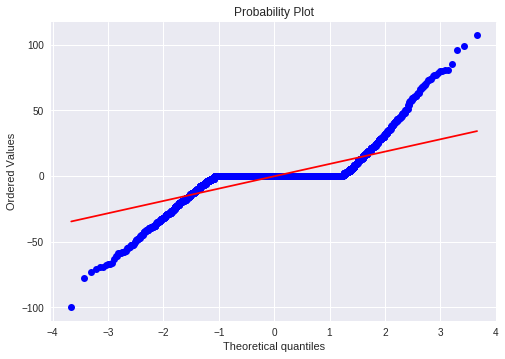

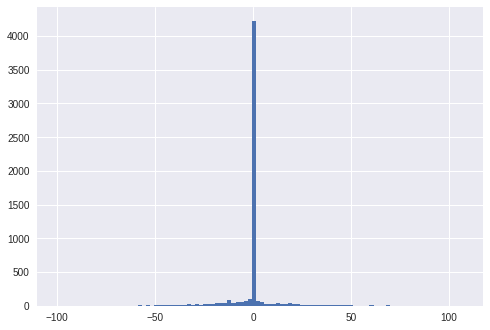

mean=-0.289 stdv=12.500
Statistics=0.564, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1546.128, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


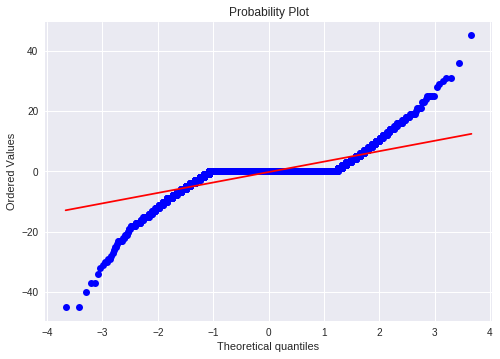

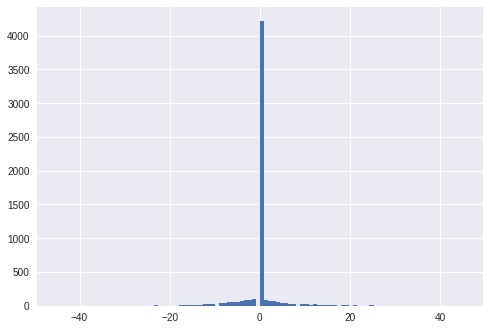

mean=-0.250 stdv=4.589
Statistics=0.567, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1652.015, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


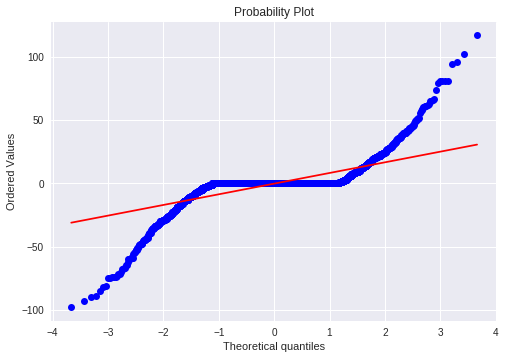

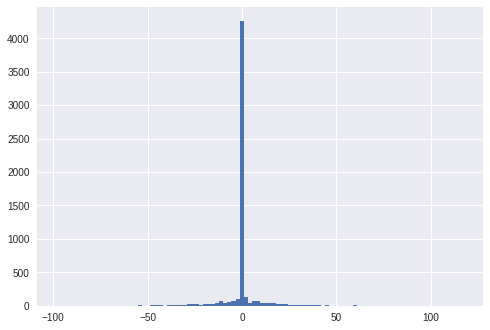

mean=-0.252 stdv=11.586
Statistics=0.530, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1462.980, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


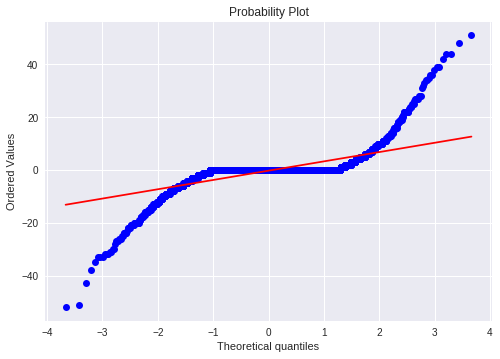

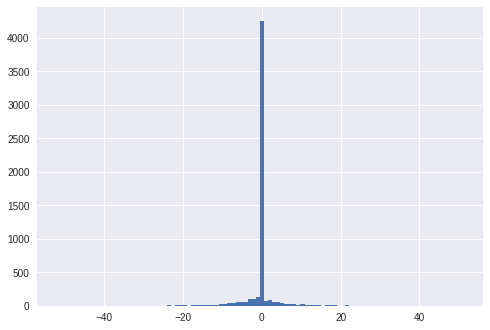

mean=-0.259 stdv=4.984
Statistics=0.500, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1557.307, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)


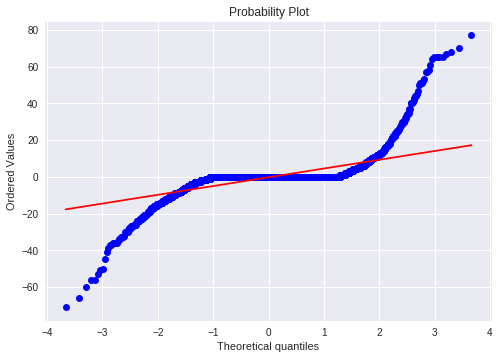

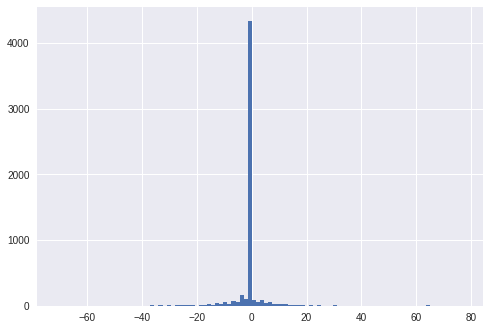

mean=-0.254 stdv=7.023
Statistics=0.462, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2795.010, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)


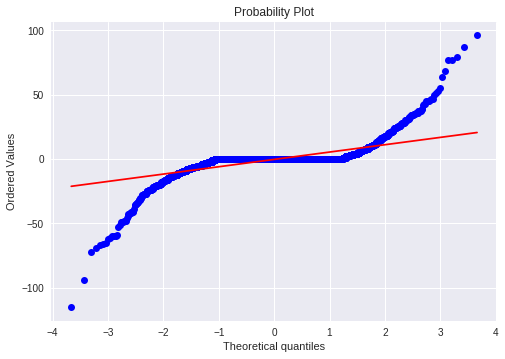

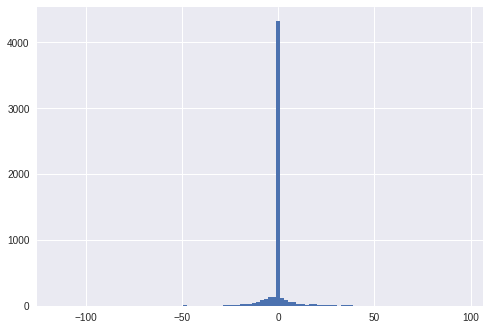

mean=-0.258 stdv=8.186
Statistics=0.485, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1844.554, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


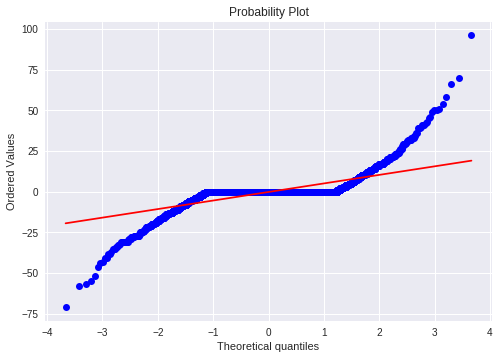

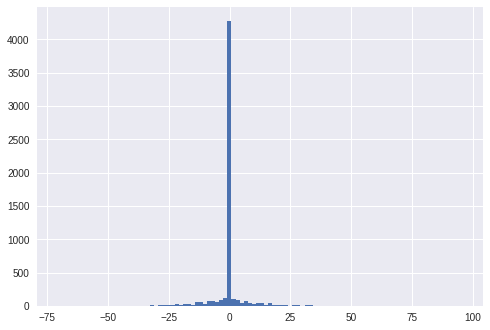

mean=-0.201 stdv=7.165
Statistics=0.538, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1736.413, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


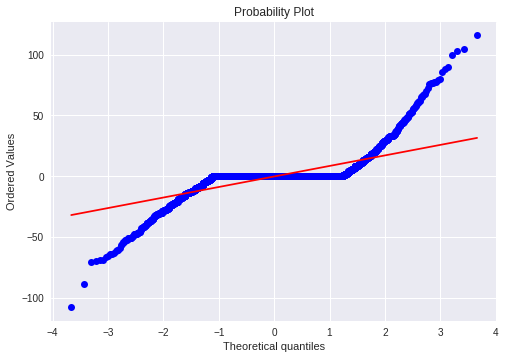

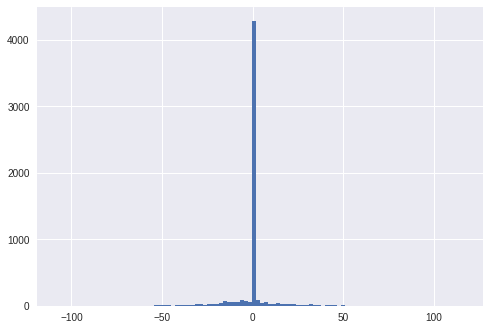

mean=-0.256 stdv=11.791
Statistics=0.542, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1903.915, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


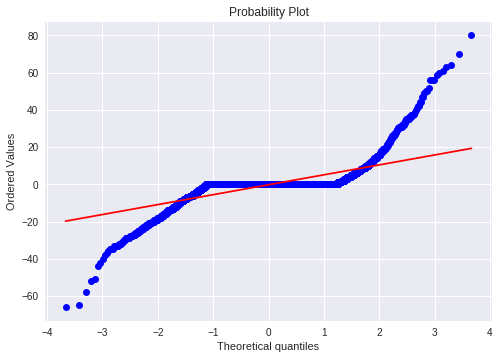

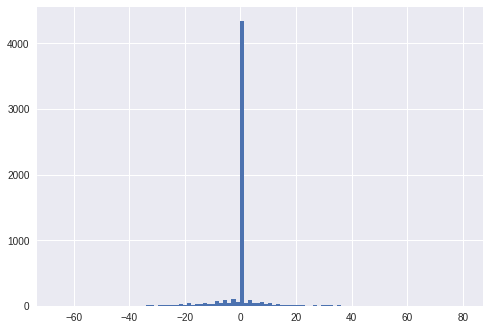

mean=-0.220 stdv=7.378
Statistics=0.523, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2182.191, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


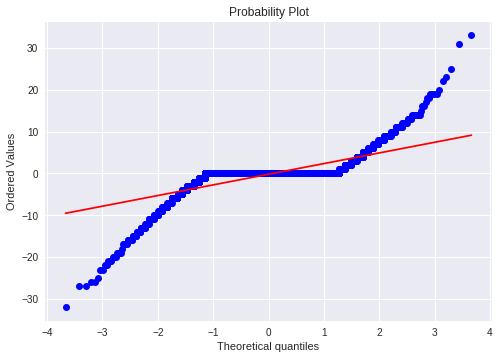

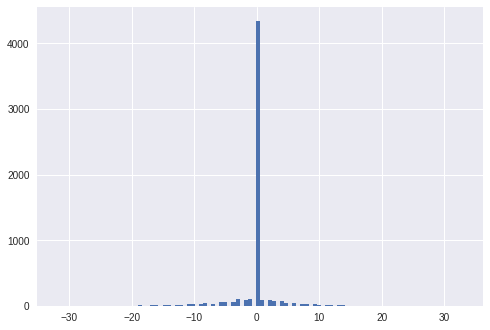

mean=-0.200 stdv=3.440
Statistics=0.549, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1842.621, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


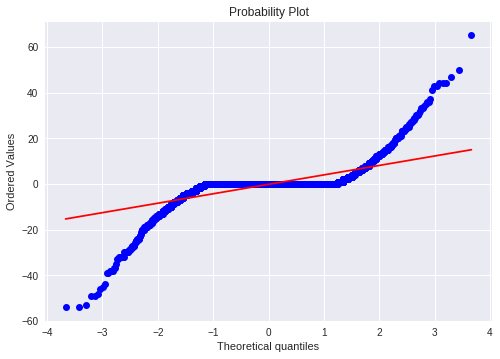

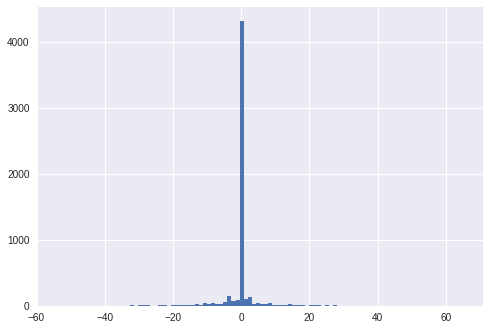

mean=-0.201 stdv=5.897
Statistics=0.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1684.139, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


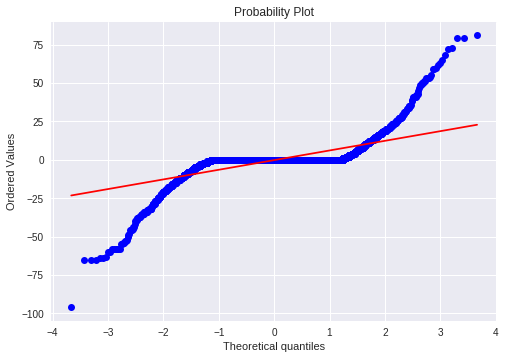

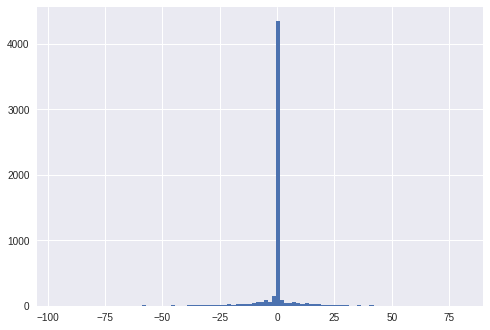

mean=-0.210 stdv=8.942
Statistics=0.494, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1492.651, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


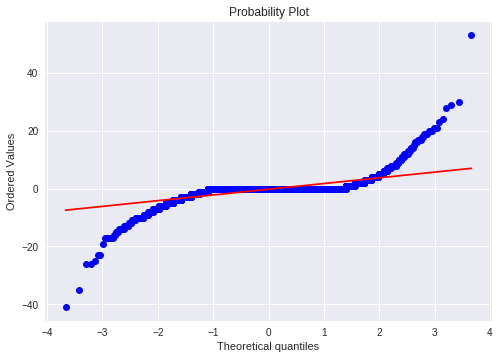

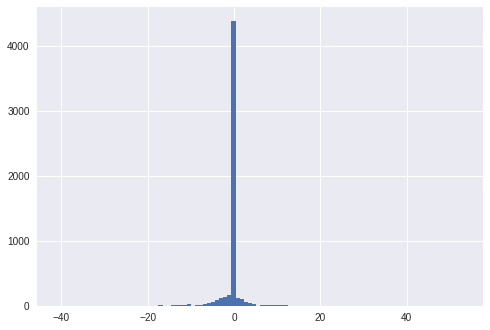

mean=-0.205 stdv=2.907
Statistics=0.463, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2249.649, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


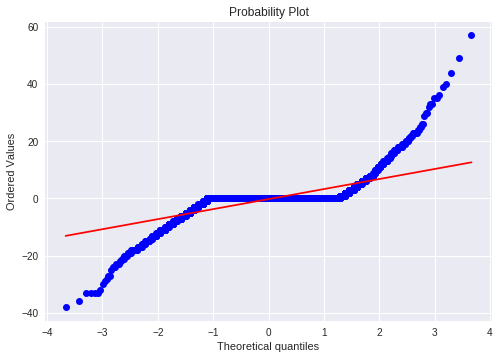

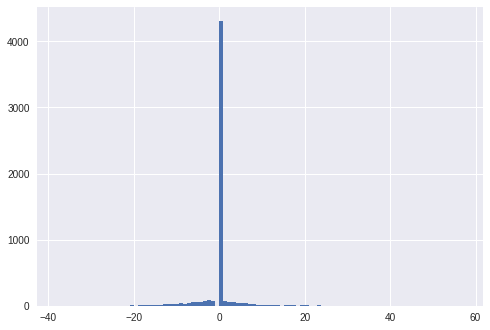

mean=-0.215 stdv=4.791
Statistics=0.536, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1804.081, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


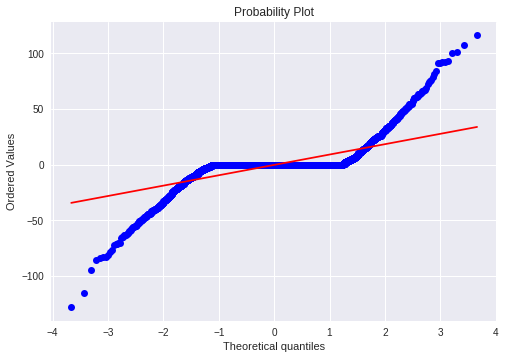

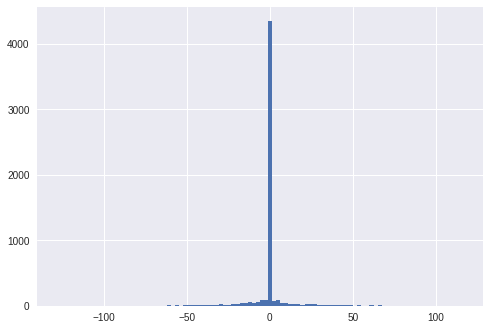

mean=-0.251 stdv=12.890
Statistics=0.521, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1372.644, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


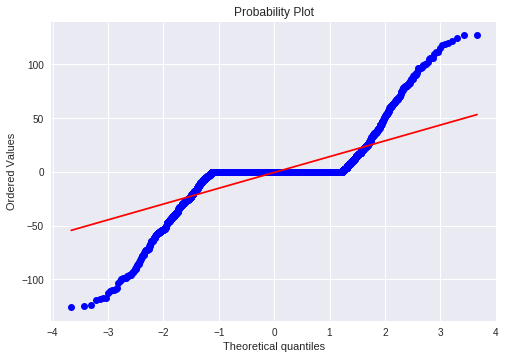

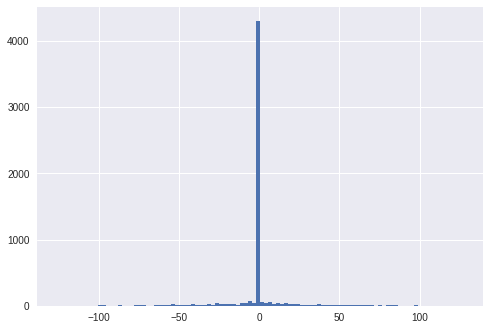

mean=-0.562 stdv=19.779
Statistics=0.553, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1123.285, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


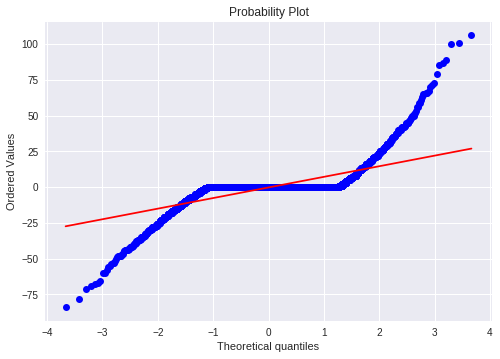

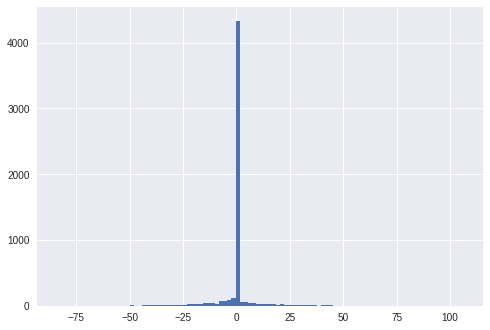

mean=-0.278 stdv=10.278
Statistics=0.521, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1917.481, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


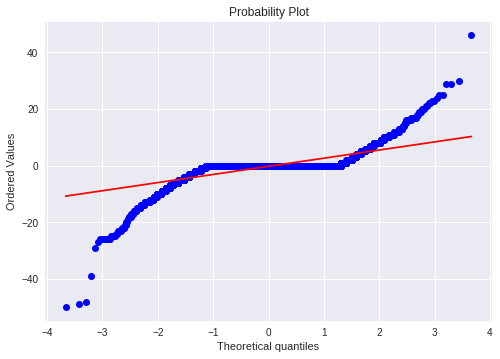

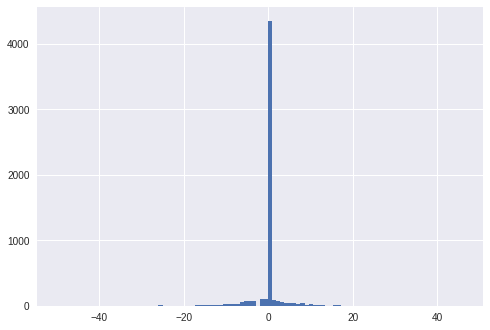

mean=-0.235 stdv=4.012
Statistics=0.514, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2599.593, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


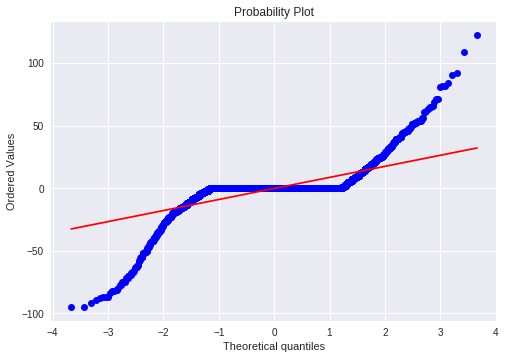

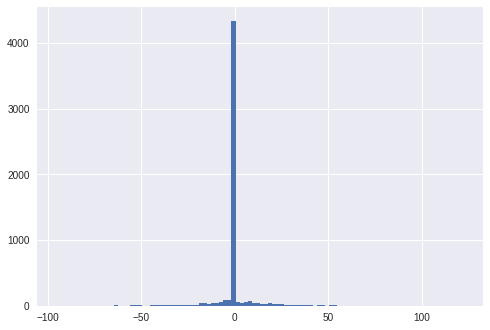

mean=-0.189 stdv=12.363
Statistics=0.510, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1664.980, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


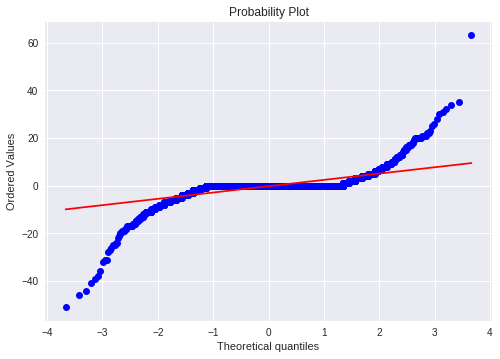

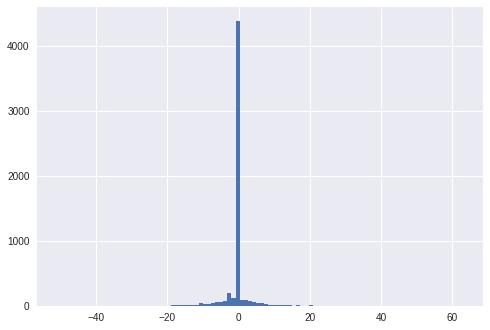

mean=-0.247 stdv=3.897
Statistics=0.463, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2301.651, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.411, p=0.000
Sample does not look Gaussian (reject H0)


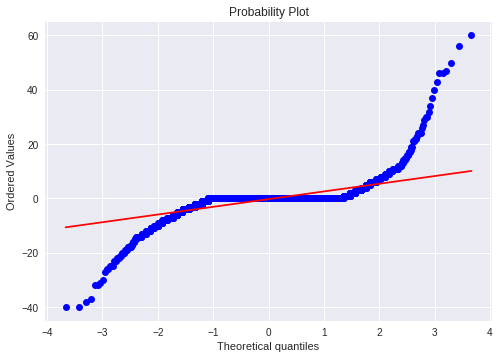

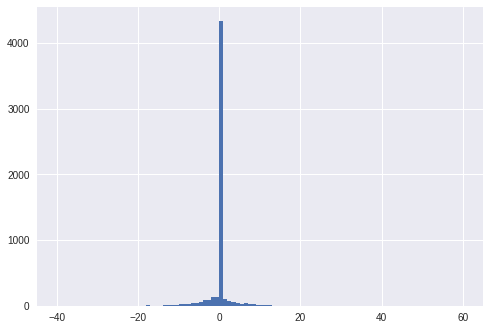

mean=-0.239 stdv=4.186
Statistics=0.458, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3096.604, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)


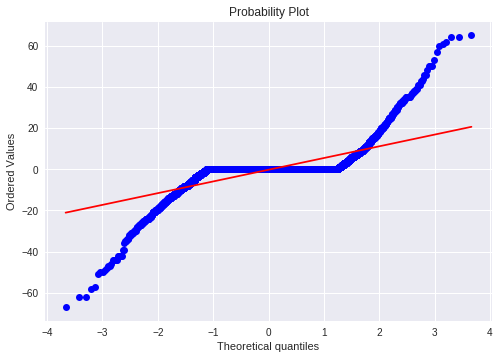

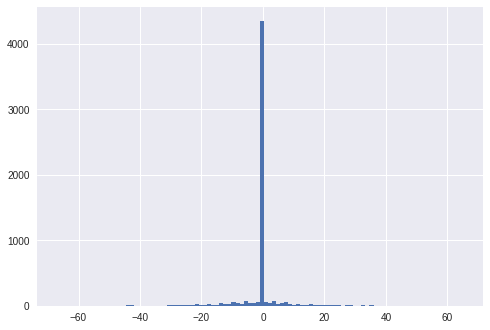

mean=-0.235 stdv=7.820
Statistics=0.530, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1378.834, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


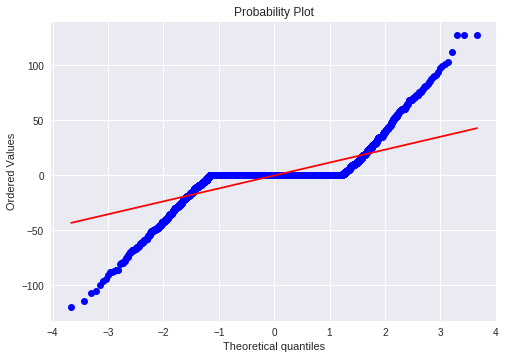

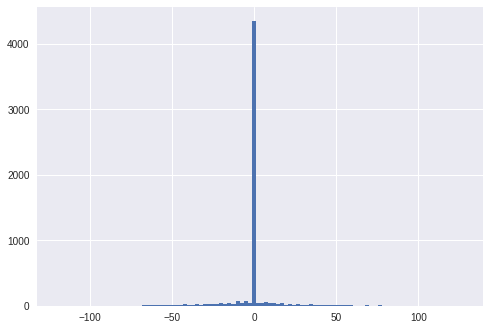

mean=-0.324 stdv=15.881
Statistics=0.547, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1223.088, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


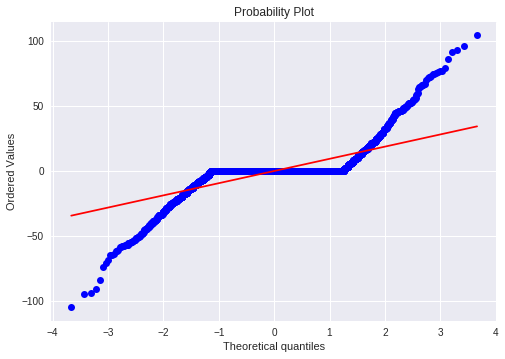

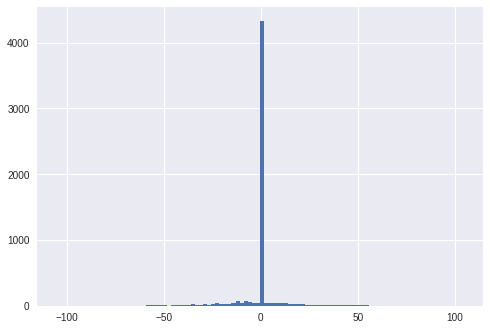

mean=-0.265 stdv=12.592
Statistics=0.554, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1309.667, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


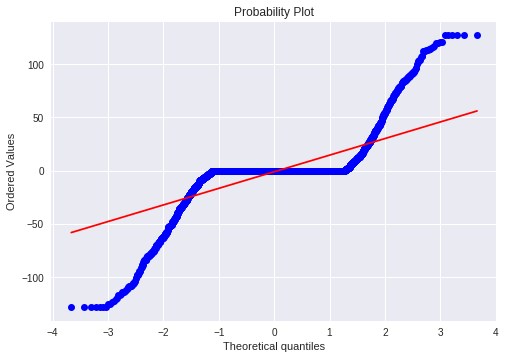

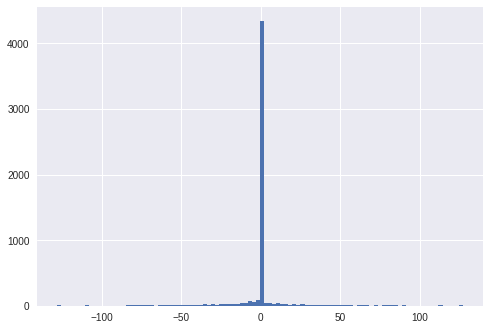

mean=-0.915 stdv=21.517
Statistics=0.523, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1195.779, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


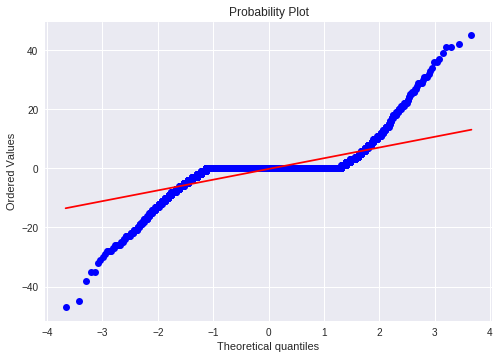

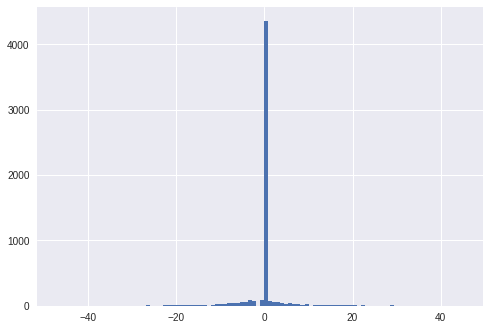

mean=-0.206 stdv=5.068
Statistics=0.513, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1422.375, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


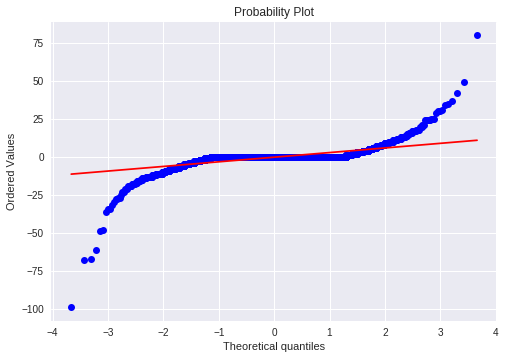

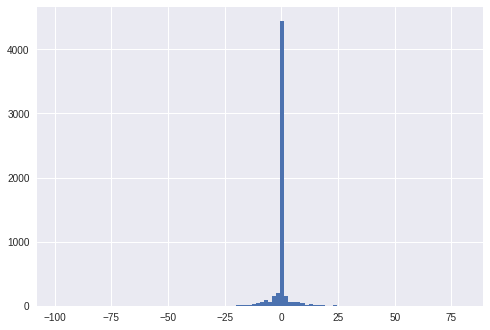

mean=-0.204 stdv=4.620
Statistics=0.435, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4172.135, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


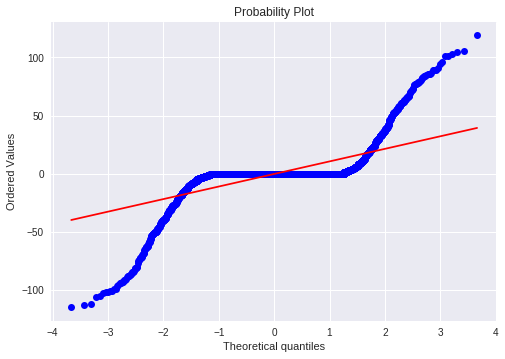

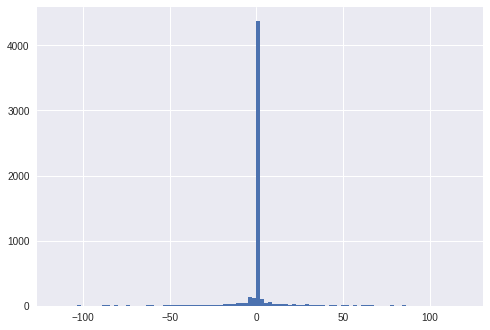

mean=-0.288 stdv=15.744
Statistics=0.472, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1436.843, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


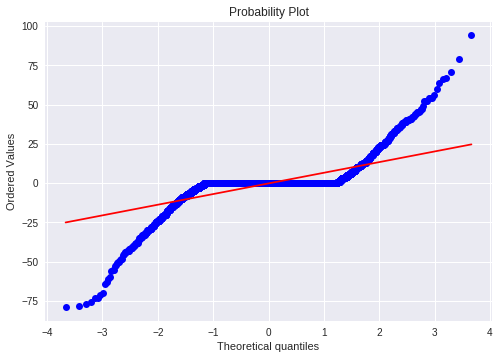

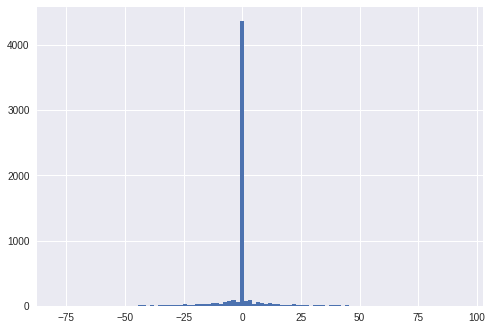

mean=-0.204 stdv=9.434
Statistics=0.517, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1470.013, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


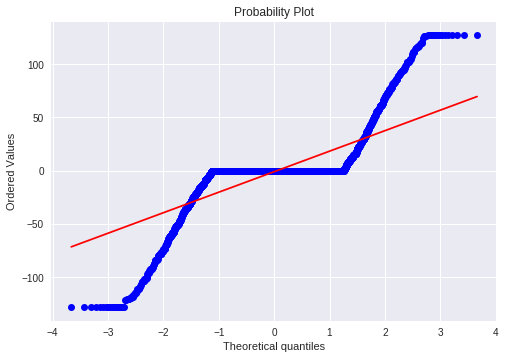

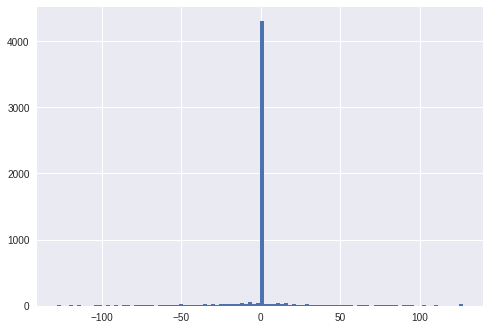

mean=-0.862 stdv=25.545
Statistics=0.567, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1011.819, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


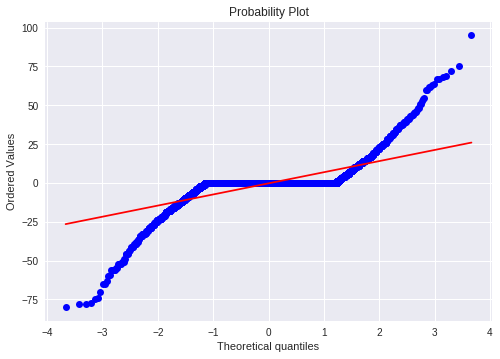

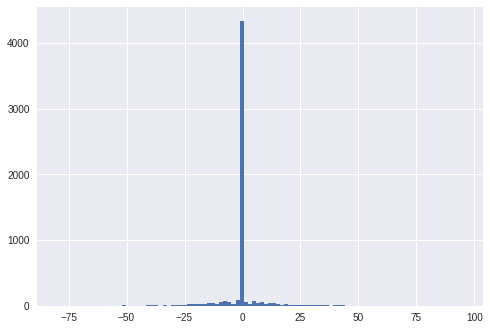

mean=-0.245 stdv=9.781
Statistics=0.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1376.356, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


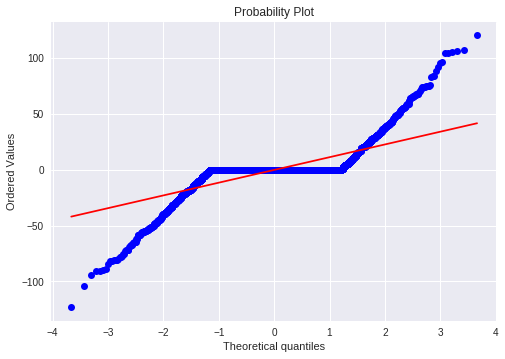

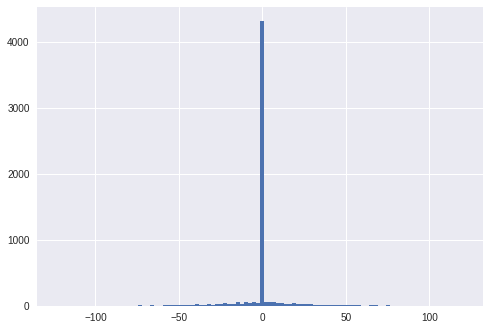

mean=-0.267 stdv=15.151
Statistics=0.565, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1150.565, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


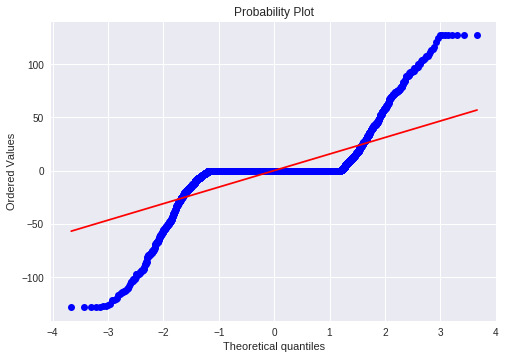

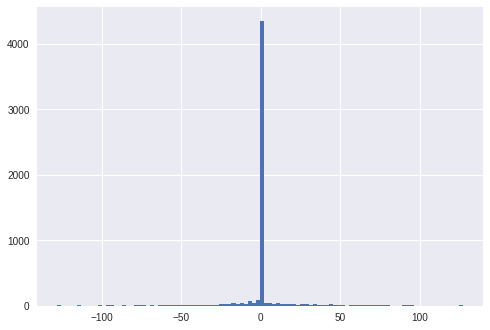

mean=0.183 stdv=21.442
Statistics=0.523, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1163.308, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


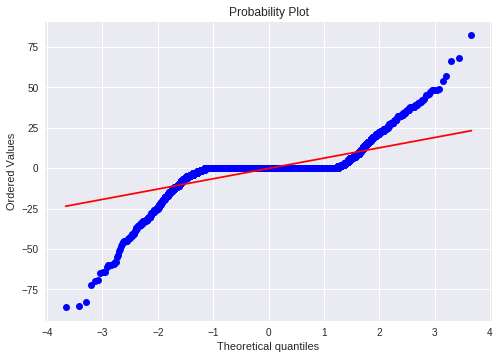

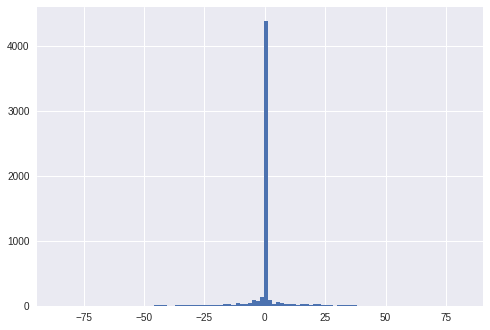

mean=-0.232 stdv=8.997
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2144.664, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


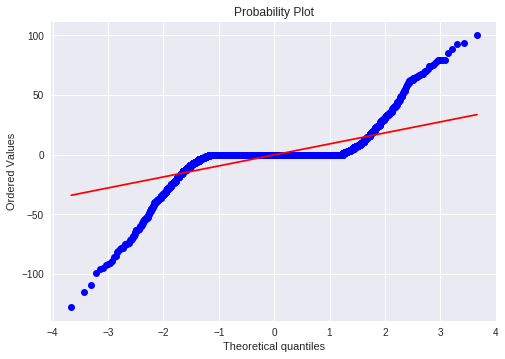

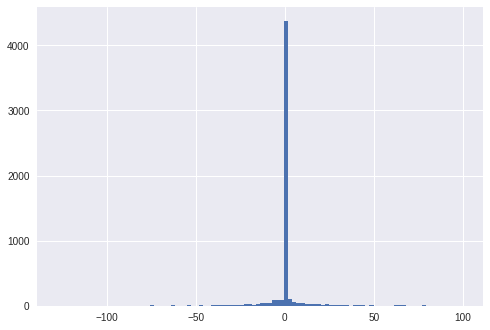

mean=-0.250 stdv=13.314
Statistics=0.481, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1649.091, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


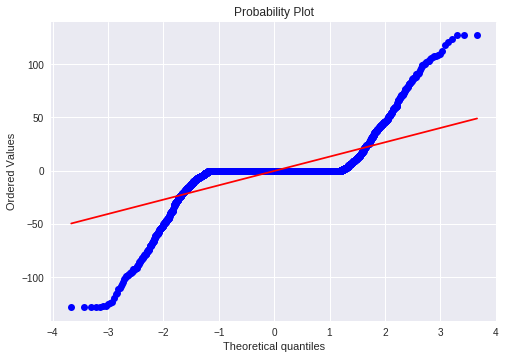

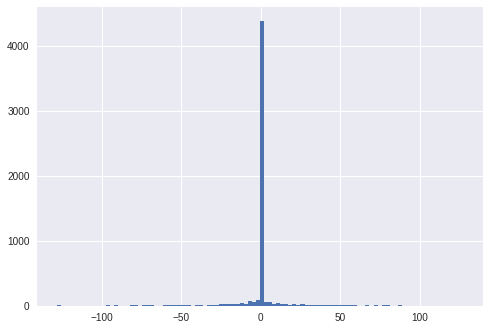

mean=-0.182 stdv=18.998
Statistics=0.501, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1358.005, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


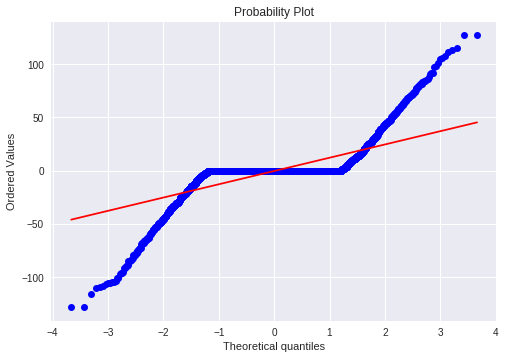

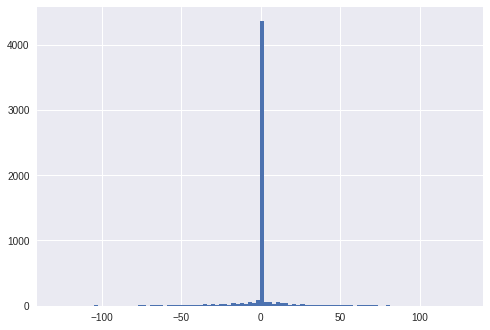

mean=-0.212 stdv=17.067
Statistics=0.532, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1269.478, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


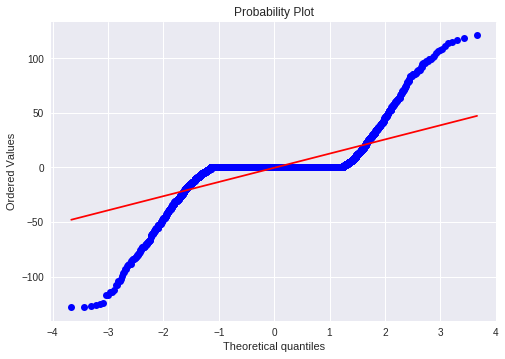

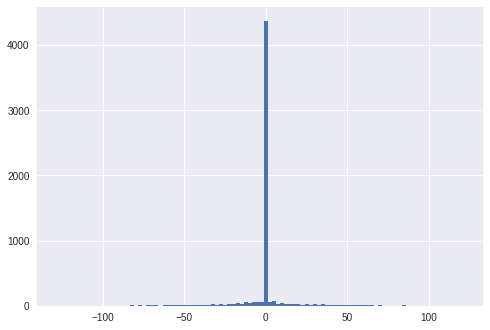

mean=-0.294 stdv=18.111
Statistics=0.514, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1251.916, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


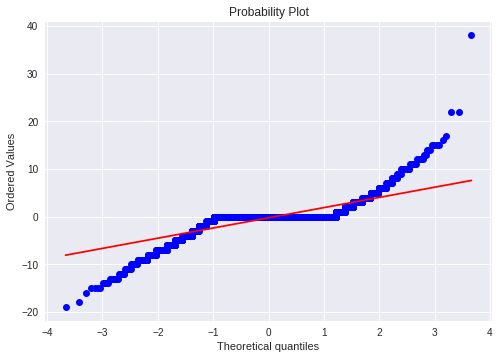

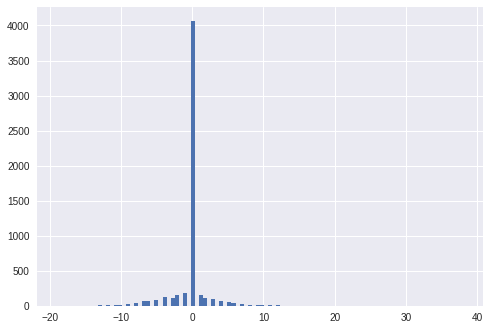

mean=-0.252 stdv=2.692
Statistics=0.632, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1336.039, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


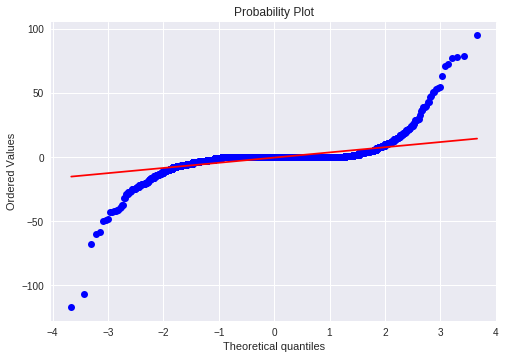

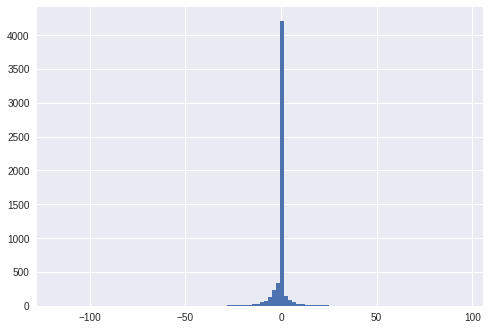

mean=-0.305 stdv=6.395
Statistics=0.401, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2118.943, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


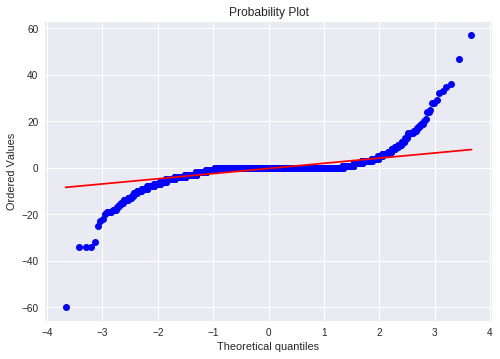

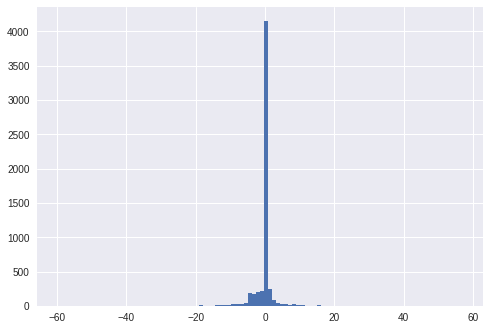

mean=-0.271 stdv=3.278
Statistics=0.460, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2468.276, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)


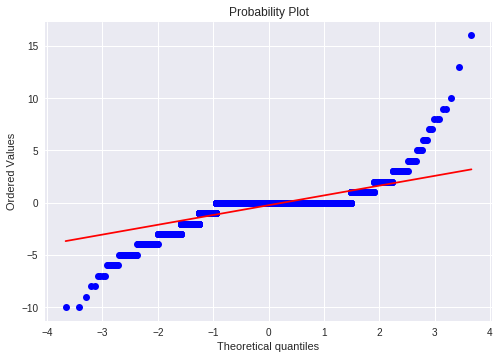

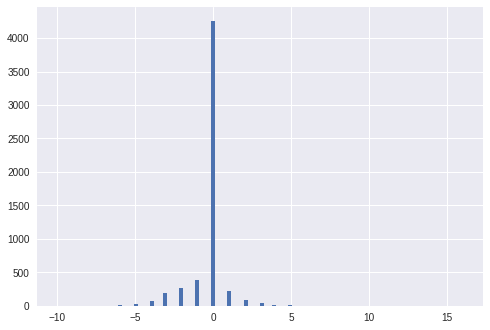

mean=-0.244 stdv=1.212
Statistics=0.598, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1380.982, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.432, p=0.000
Sample does not look Gaussian (reject H0)


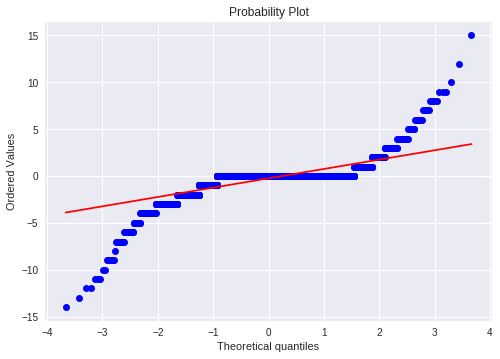

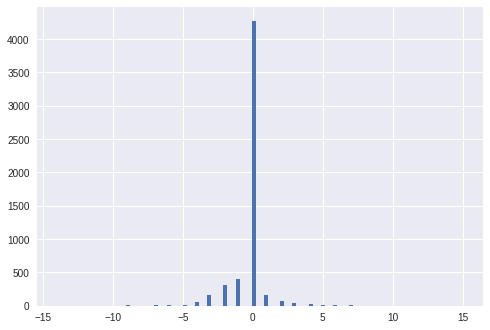

mean=-0.247 stdv=1.326
Statistics=0.566, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2105.803, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.439, p=0.000
Sample does not look Gaussian (reject H0)


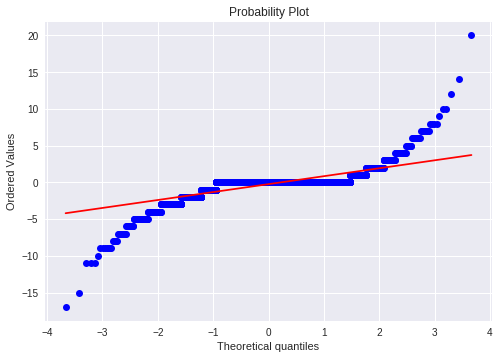

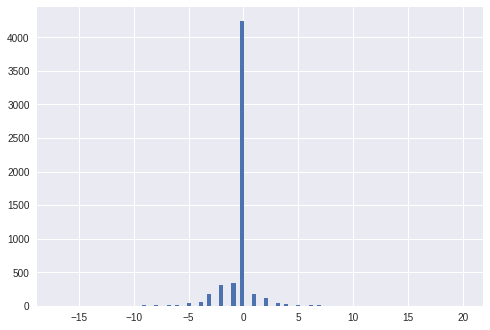

mean=-0.245 stdv=1.421
Statistics=0.579, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1756.158, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.430, p=0.000
Sample does not look Gaussian (reject H0)


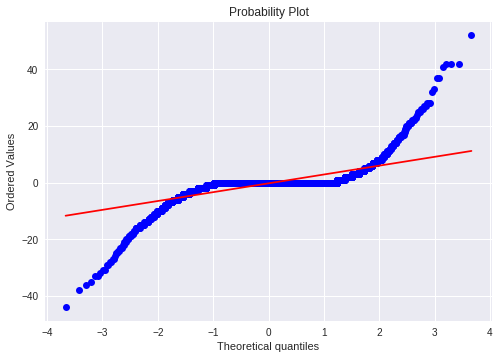

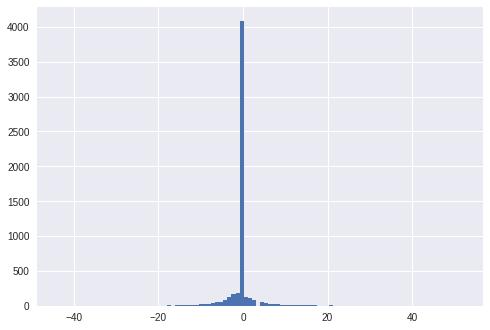

mean=-0.247 stdv=4.370
Statistics=0.511, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1712.613, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


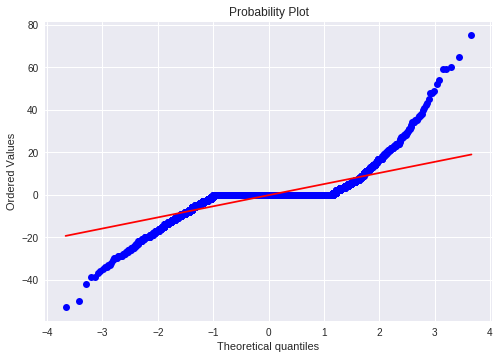

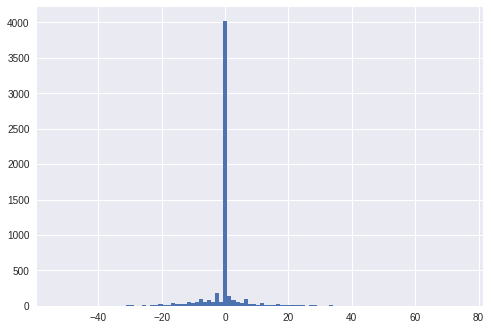

mean=-0.246 stdv=6.807
Statistics=0.591, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2124.874, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


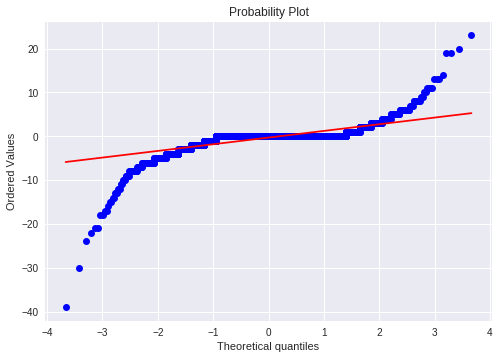

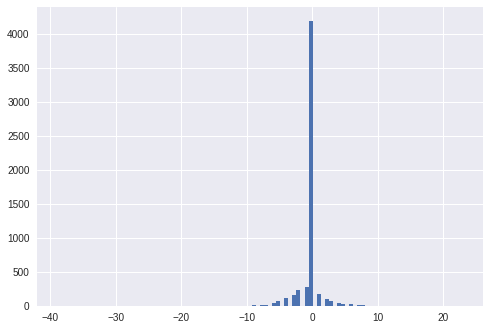

mean=-0.306 stdv=2.109
Statistics=0.521, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4155.127, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)


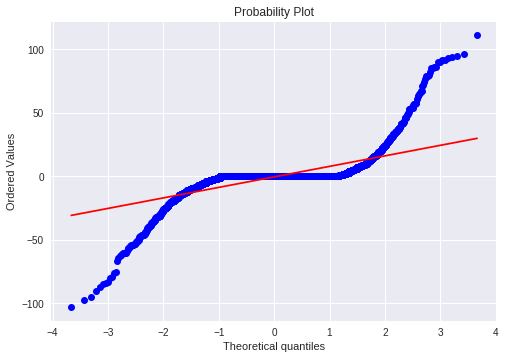

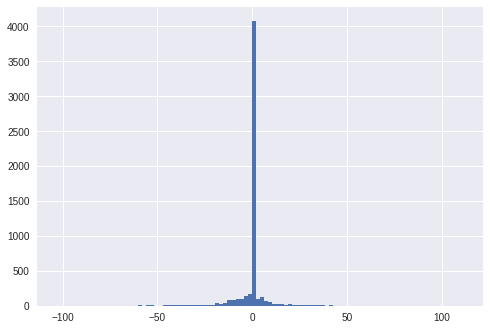

mean=-0.380 stdv=11.676
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1732.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


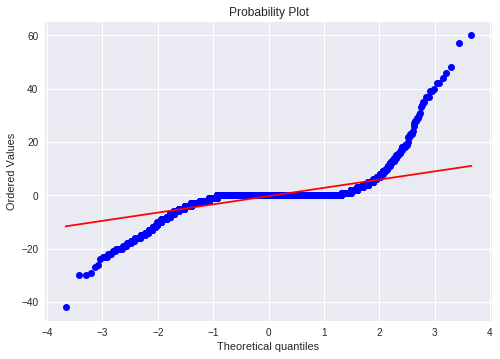

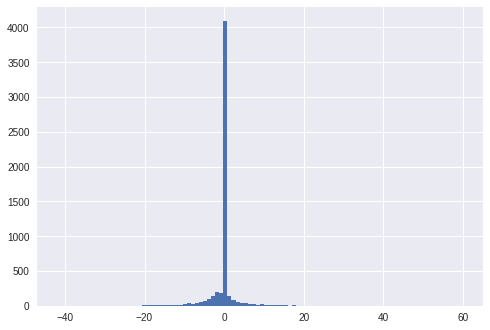

mean=-0.305 stdv=4.450
Statistics=0.485, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3714.847, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


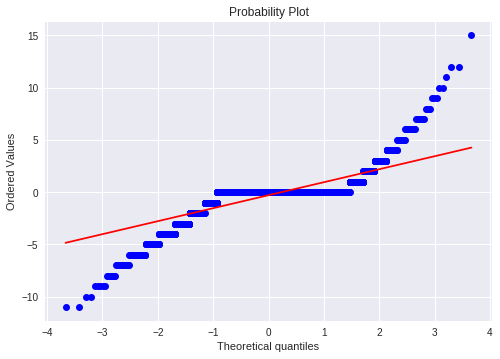

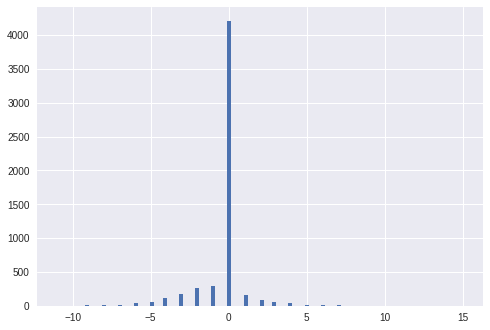

mean=-0.285 stdv=1.580
Statistics=0.619, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1199.620, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.428, p=0.000
Sample does not look Gaussian (reject H0)


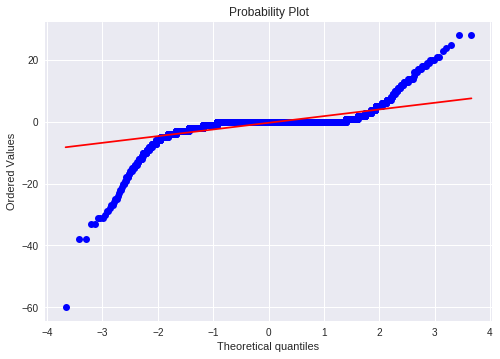

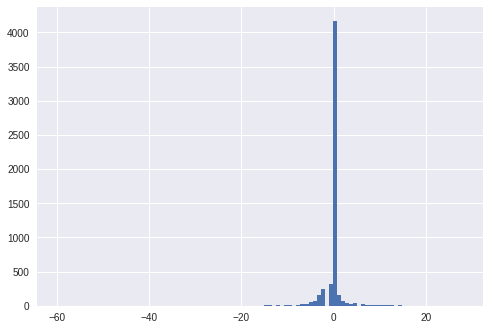

mean=-0.294 stdv=3.278
Statistics=0.435, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4453.156, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


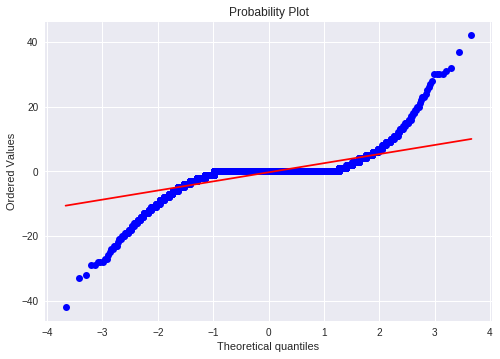

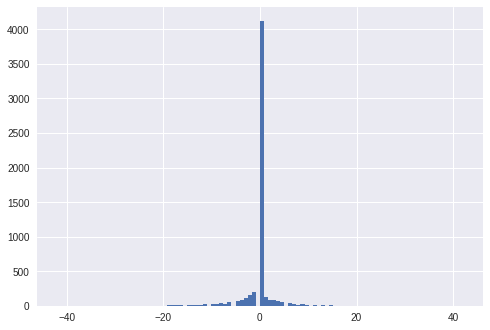

mean=-0.307 stdv=3.867
Statistics=0.530, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1601.412, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


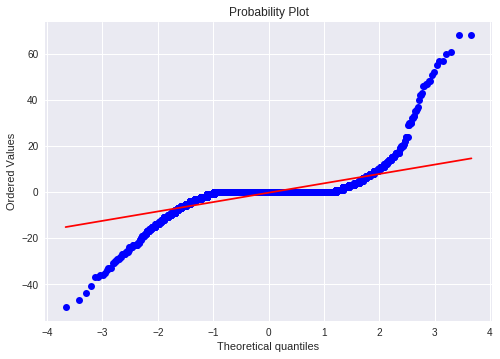

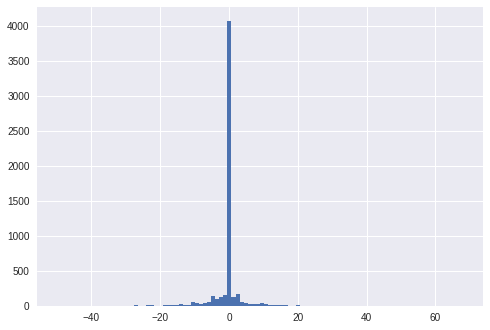

mean=-0.293 stdv=5.811
Statistics=0.491, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3012.972, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


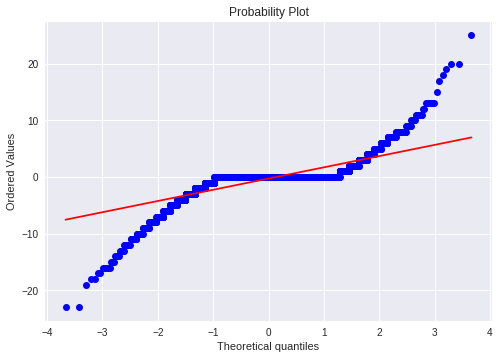

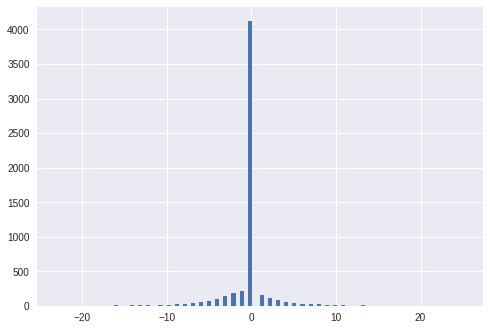

mean=-0.279 stdv=2.569
Statistics=0.595, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1708.075, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


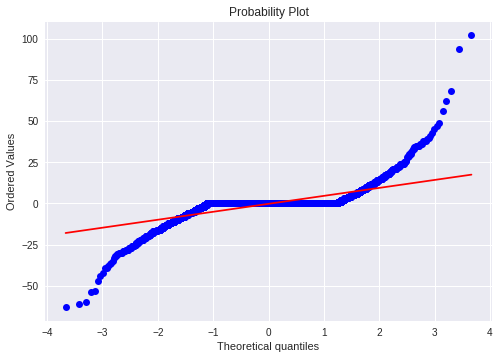

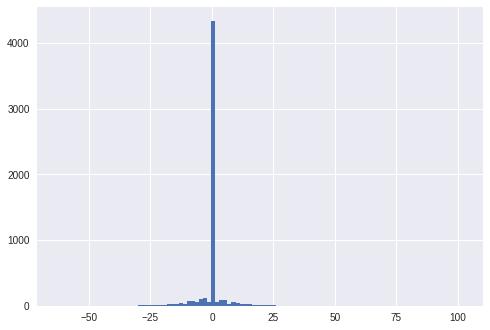

mean=-0.236 stdv=6.707
Statistics=0.520, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2422.103, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


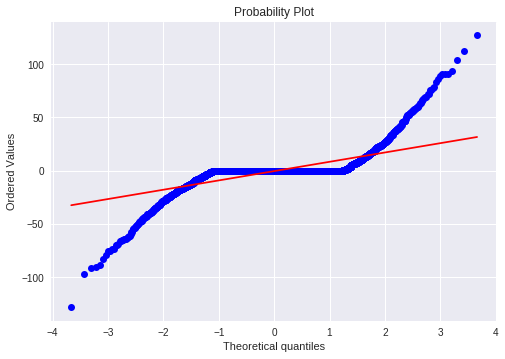

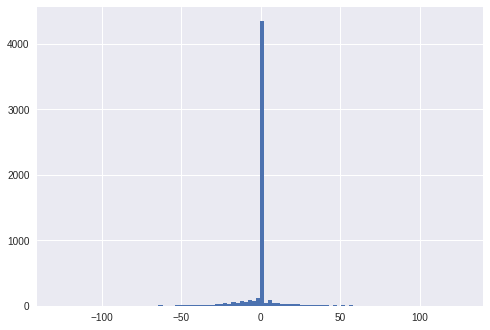

mean=-0.309 stdv=12.191
Statistics=0.514, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1569.857, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


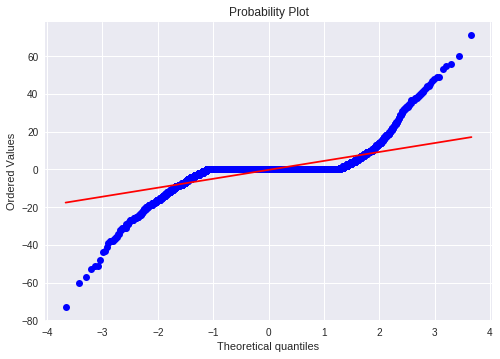

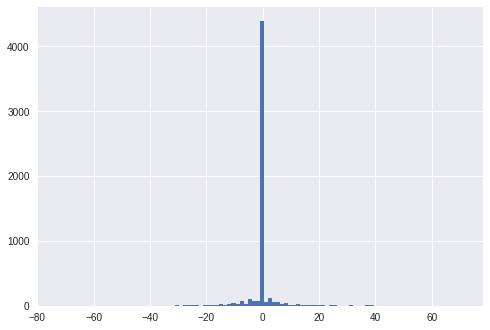

mean=-0.228 stdv=6.734
Statistics=0.495, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1631.398, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.401, p=0.000
Sample does not look Gaussian (reject H0)


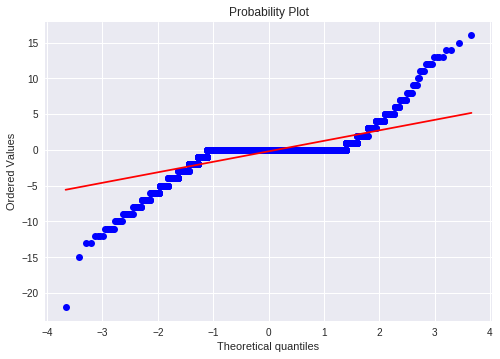

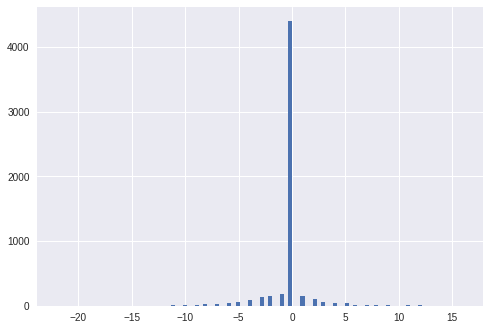

mean=-0.207 stdv=1.977
Statistics=0.551, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1520.035, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)


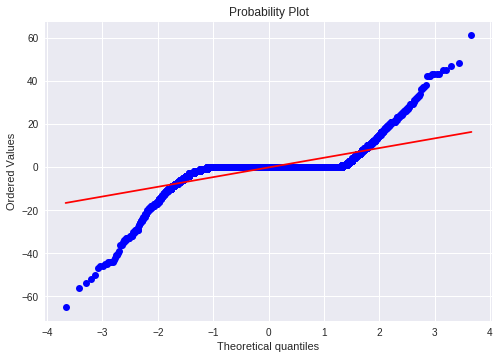

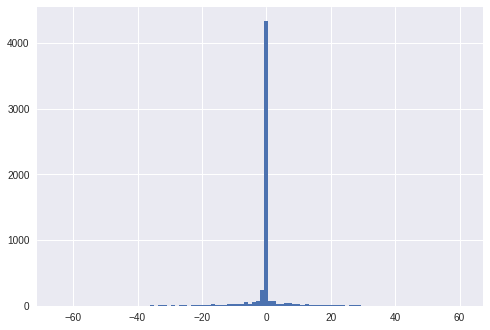

mean=-0.210 stdv=6.486
Statistics=0.480, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1809.935, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


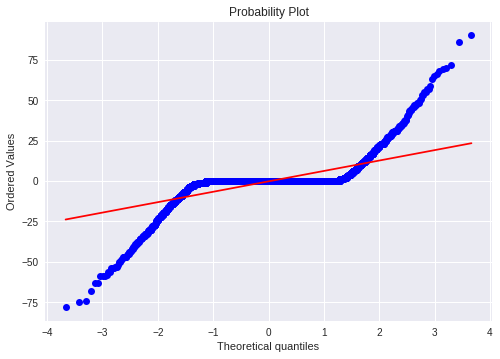

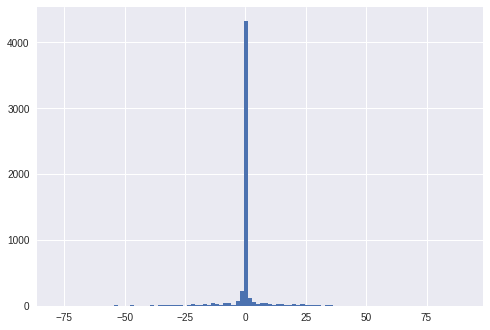

mean=-0.212 stdv=9.266
Statistics=0.483, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1406.796, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.401, p=0.000
Sample does not look Gaussian (reject H0)


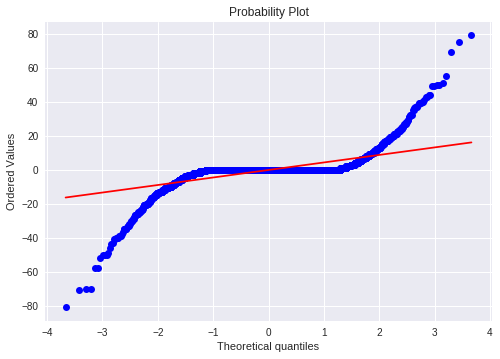

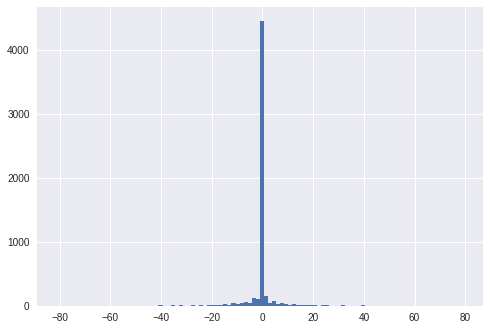

mean=-0.211 stdv=6.696
Statistics=0.438, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1868.819, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)


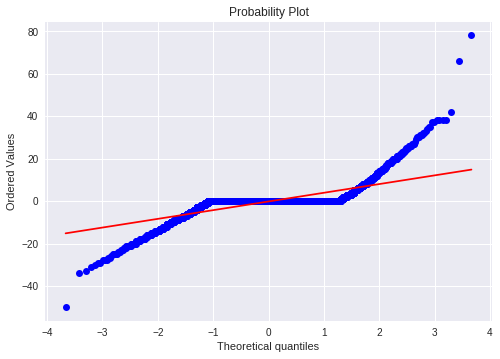

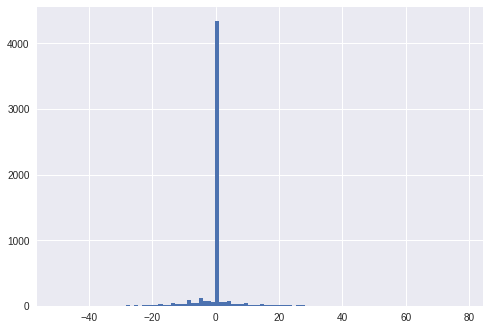

mean=-0.201 stdv=5.532
Statistics=0.549, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2429.177, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


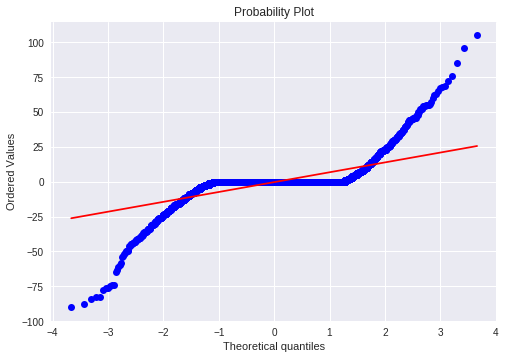

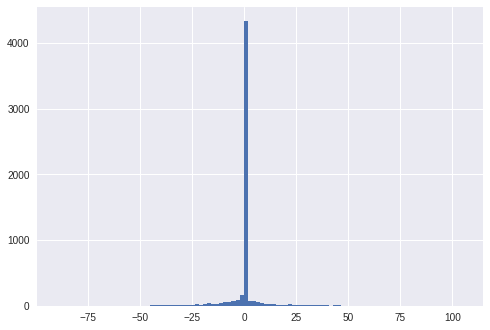

mean=-0.264 stdv=10.038
Statistics=0.497, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1461.809, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


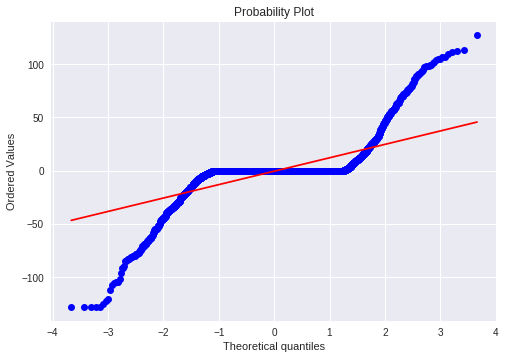

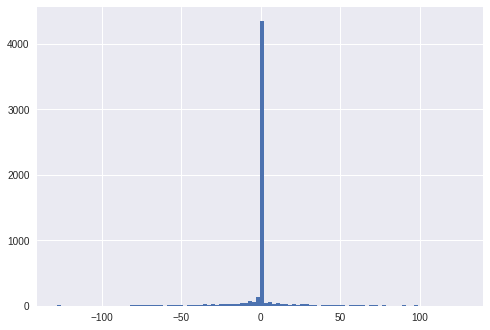

mean=-0.401 stdv=17.675
Statistics=0.507, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1258.065, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


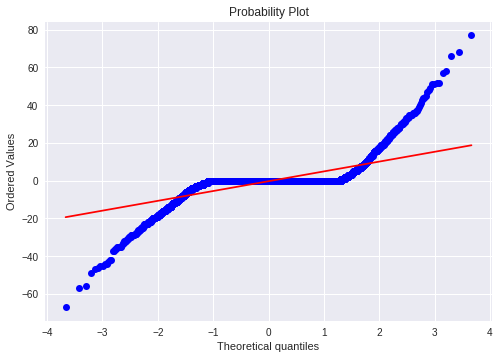

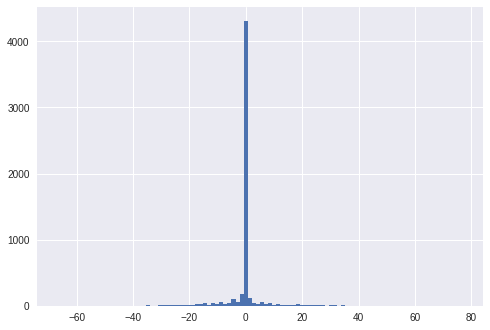

mean=-0.249 stdv=7.290
Statistics=0.509, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1680.534, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.405, p=0.000
Sample does not look Gaussian (reject H0)


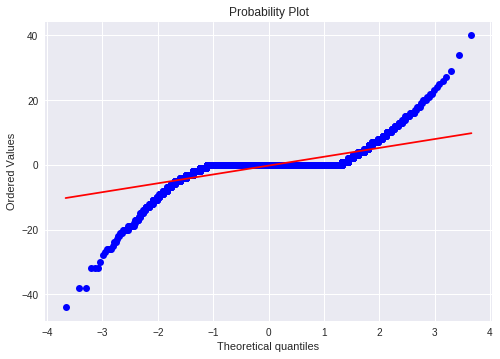

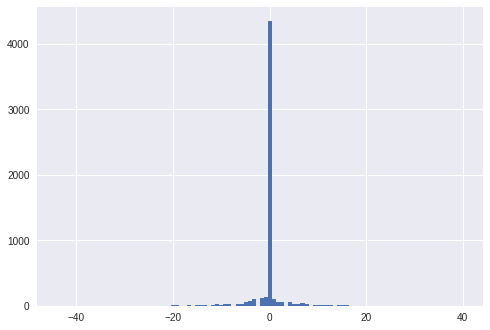

mean=-0.239 stdv=3.862
Statistics=0.502, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2403.071, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


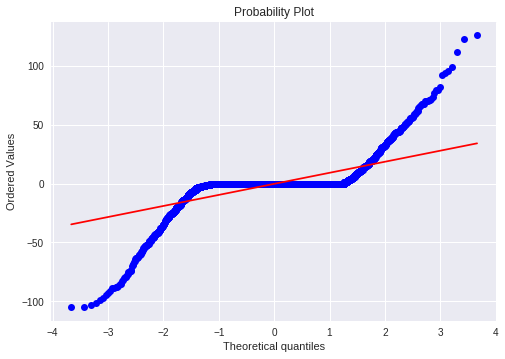

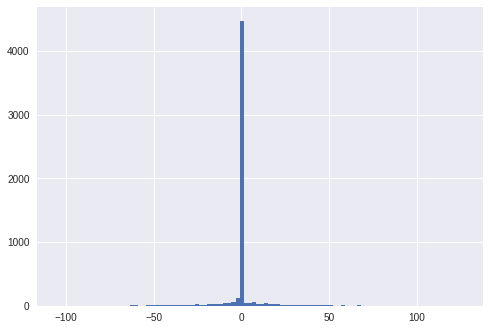

mean=-0.160 stdv=13.569
Statistics=0.480, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1534.672, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


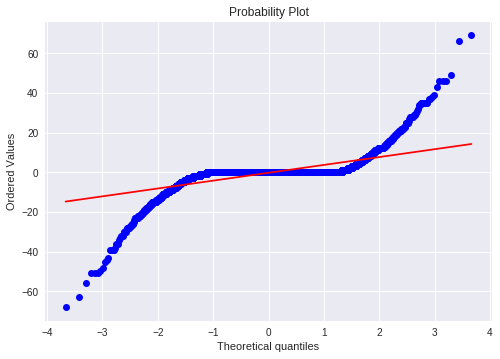

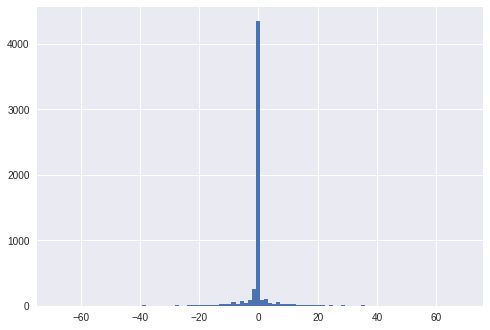

mean=-0.238 stdv=5.881
Statistics=0.454, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1889.746, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


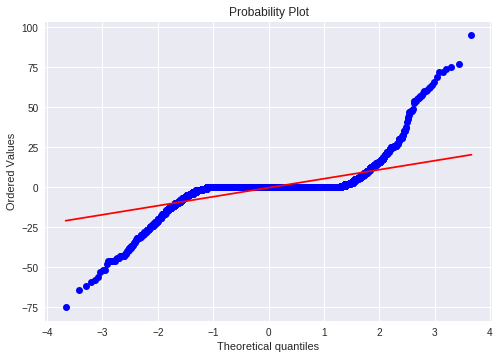

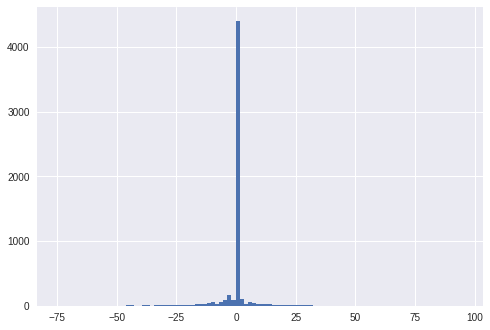

mean=-0.262 stdv=8.359
Statistics=0.455, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2192.012, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


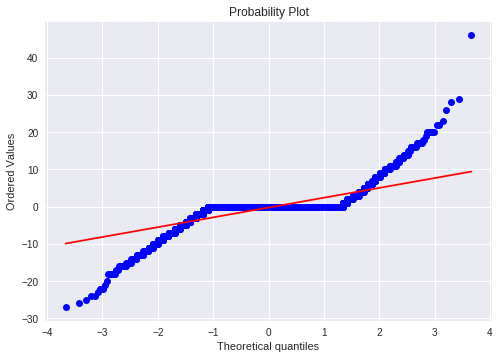

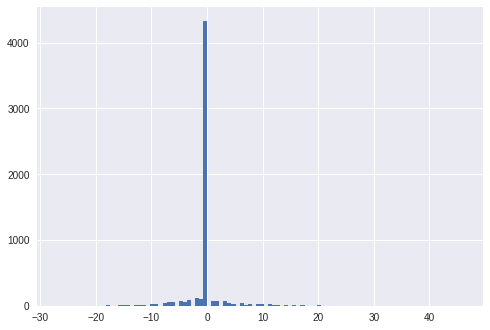

mean=-0.231 stdv=3.536
Statistics=0.557, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1364.784, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)


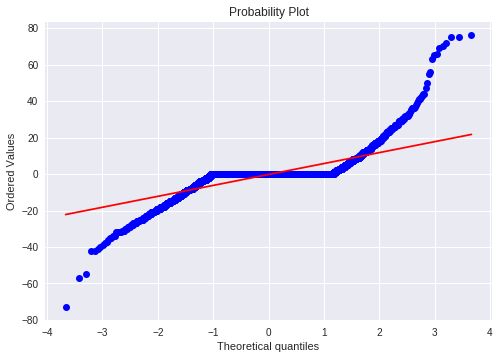

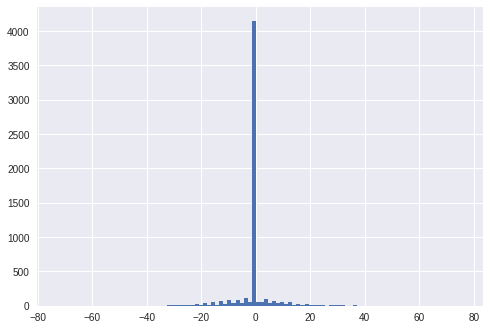

mean=-0.239 stdv=7.831
Statistics=0.586, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2138.115, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


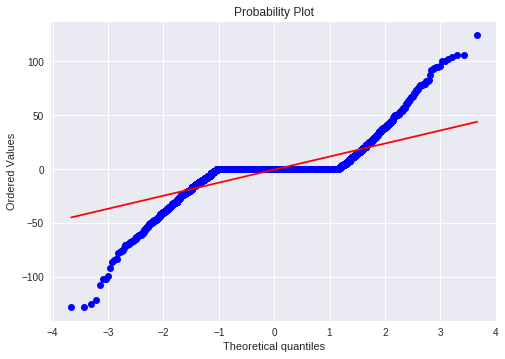

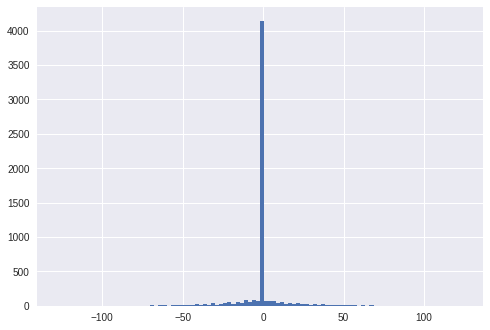

mean=-0.434 stdv=15.761
Statistics=0.589, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1188.555, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.378, p=0.000
Sample does not look Gaussian (reject H0)


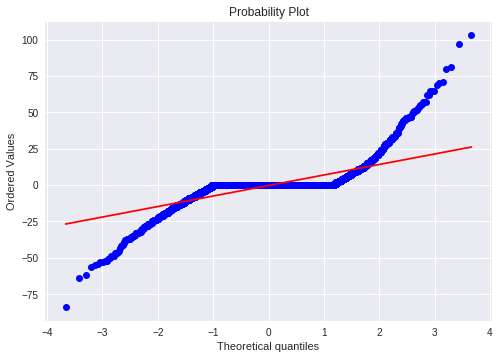

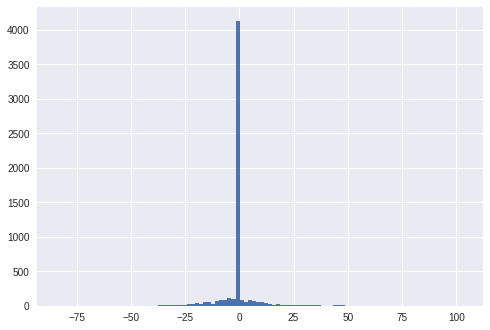

mean=-0.269 stdv=9.585
Statistics=0.569, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2097.861, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


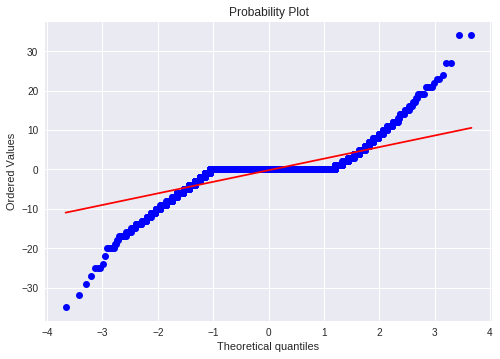

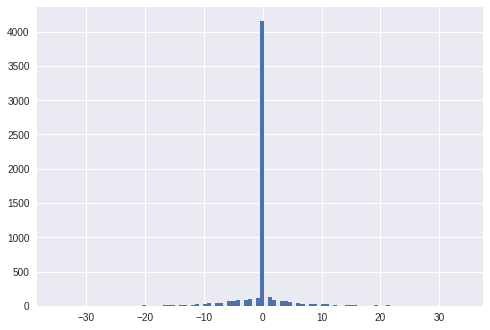

mean=-0.230 stdv=3.809
Statistics=0.595, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1251.600, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


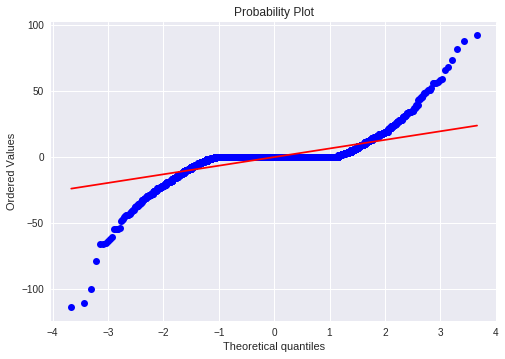

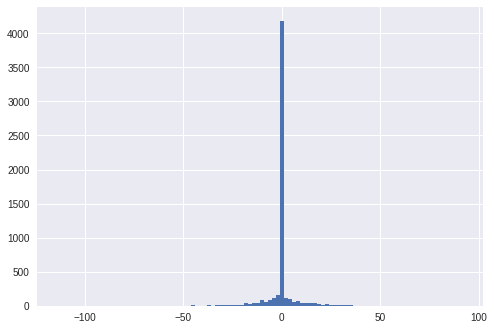

mean=-0.226 stdv=9.018
Statistics=0.524, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1927.758, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


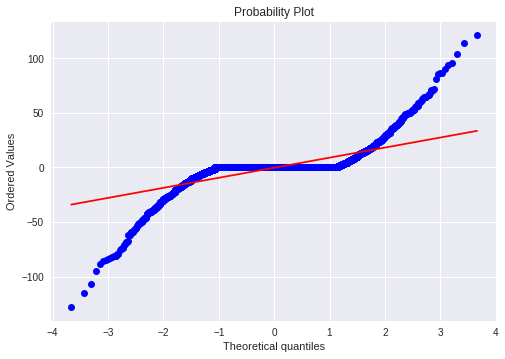

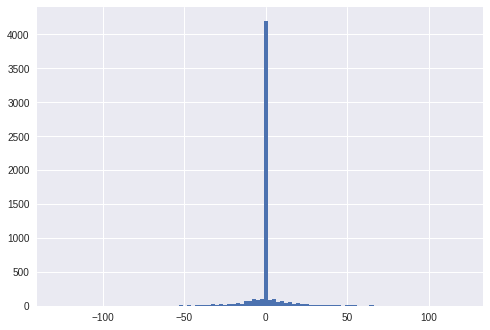

mean=-0.207 stdv=12.583
Statistics=0.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1451.220, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


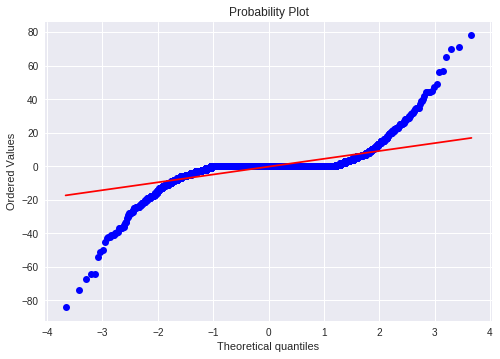

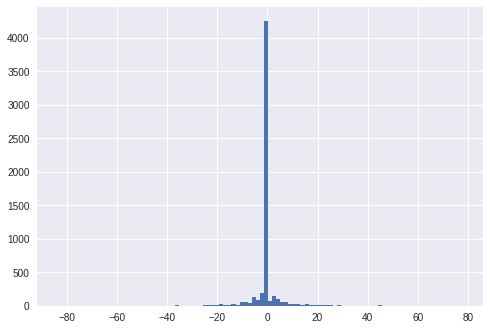

mean=-0.225 stdv=6.709
Statistics=0.486, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1707.988, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


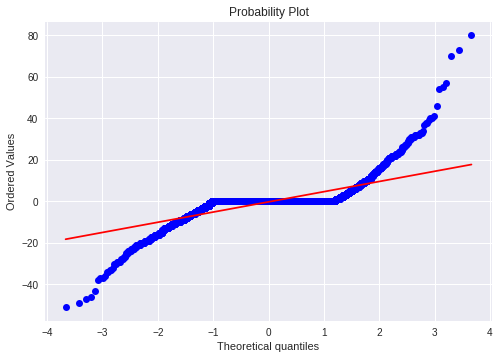

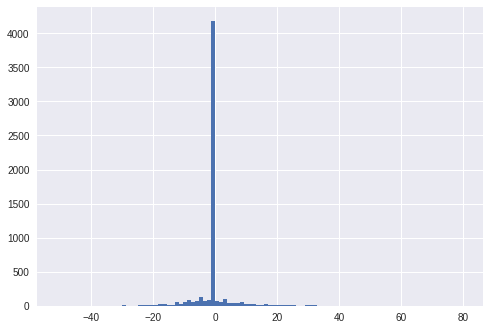

mean=-0.231 stdv=6.500
Statistics=0.572, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2260.680, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


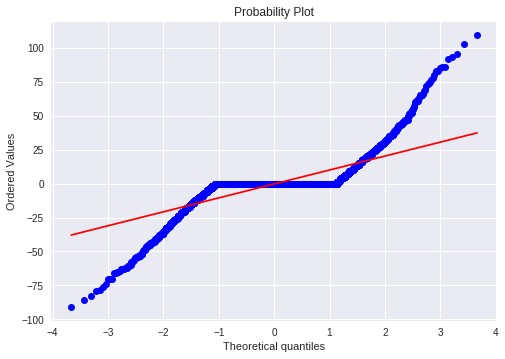

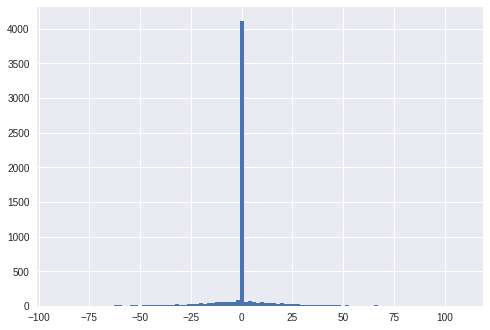

mean=-0.302 stdv=13.240
Statistics=0.600, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1167.854, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.372, p=0.000
Sample does not look Gaussian (reject H0)


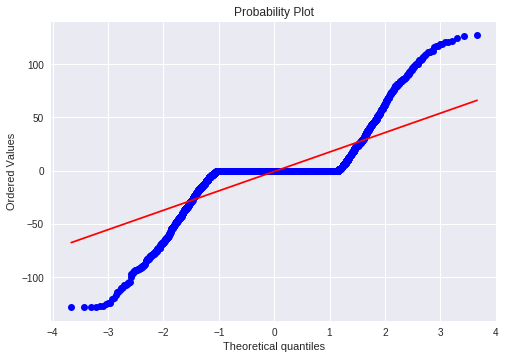

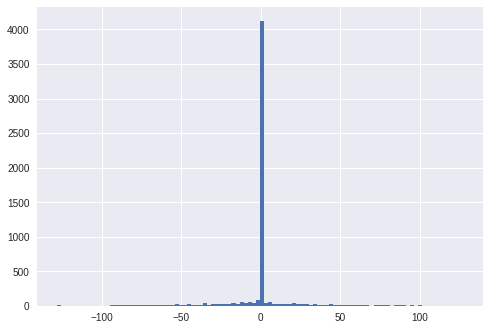

mean=-0.641 stdv=23.418
Statistics=0.604, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=944.608, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.376, p=0.000
Sample does not look Gaussian (reject H0)


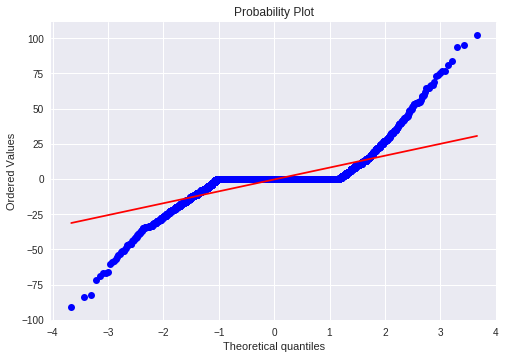

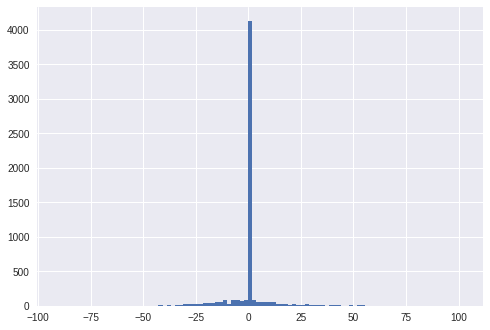

mean=-0.297 stdv=11.058
Statistics=0.582, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1706.326, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


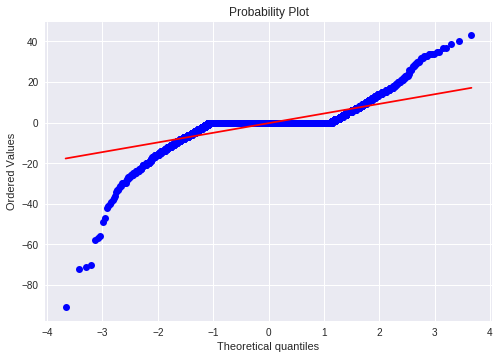

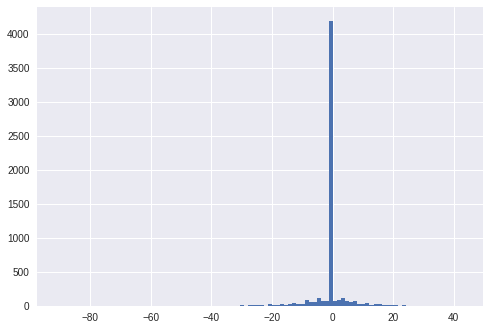

mean=-0.264 stdv=6.360
Statistics=0.559, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3114.905, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


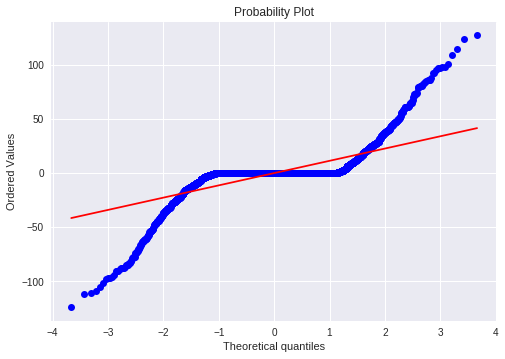

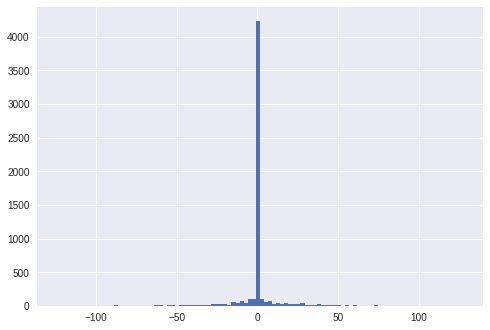

mean=-0.143 stdv=15.534
Statistics=0.532, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1327.148, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


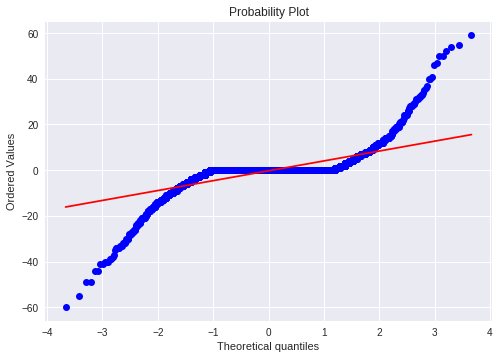

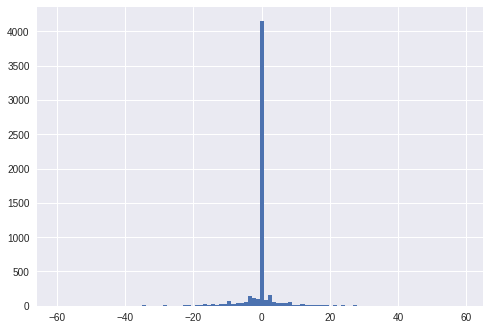

mean=-0.275 stdv=5.996
Statistics=0.521, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1547.065, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


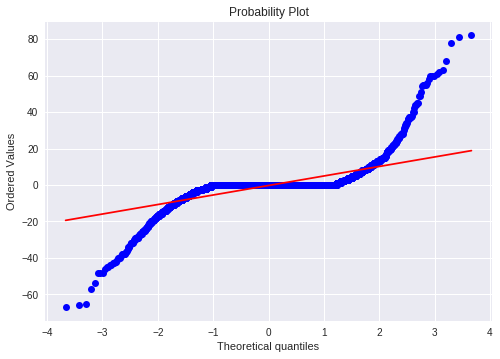

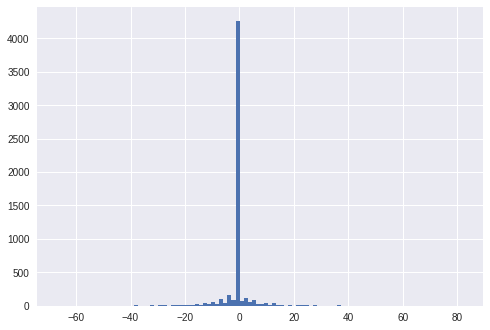

mean=-0.275 stdv=7.468
Statistics=0.488, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2150.664, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


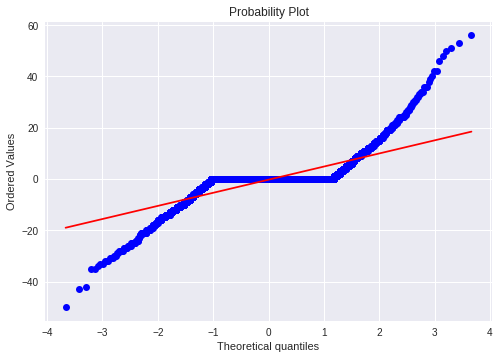

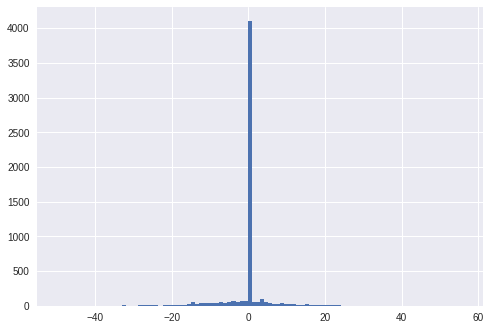

mean=-0.264 stdv=6.517
Statistics=0.616, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1262.661, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


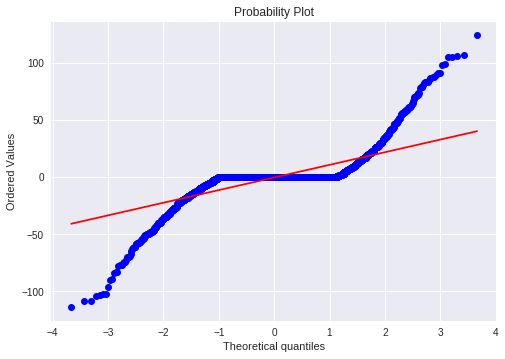

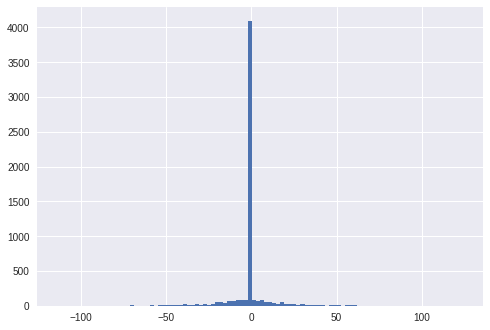

mean=-0.404 stdv=14.674
Statistics=0.568, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1310.000, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


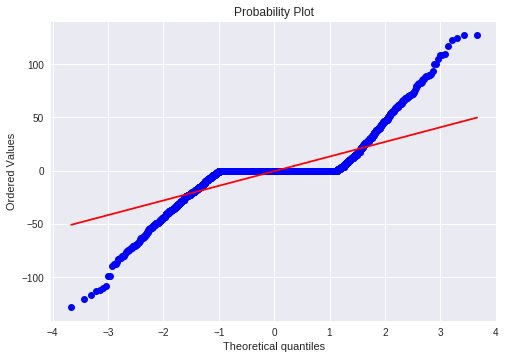

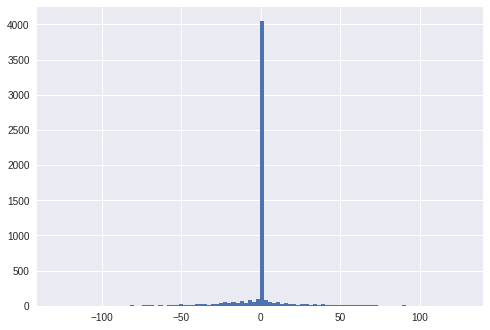

mean=-0.396 stdv=17.578
Statistics=0.610, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1208.517, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.371, p=0.000
Sample does not look Gaussian (reject H0)


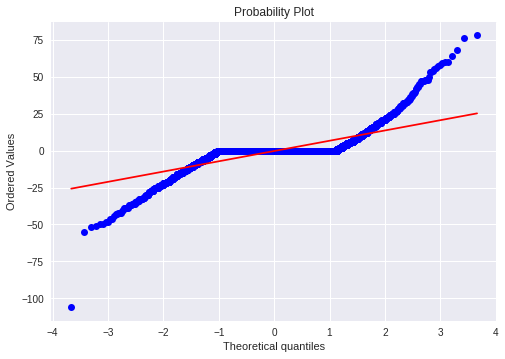

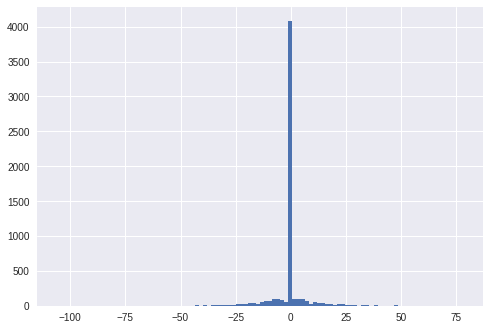

mean=-0.260 stdv=8.938
Statistics=0.605, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1352.836, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.372, p=0.000
Sample does not look Gaussian (reject H0)


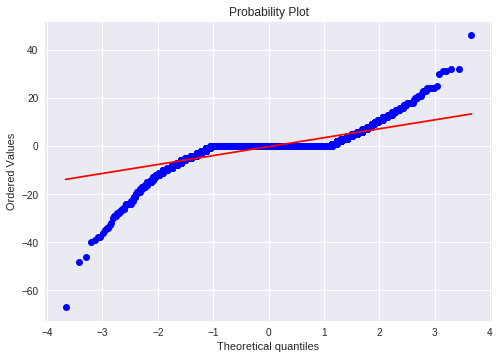

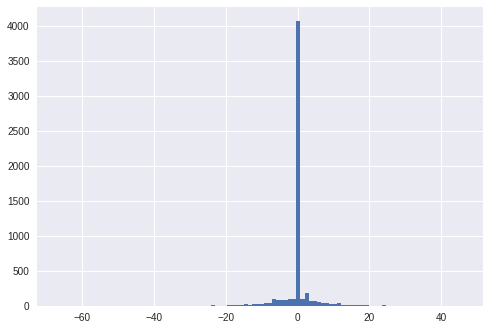

mean=-0.247 stdv=4.891
Statistics=0.577, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2707.735, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


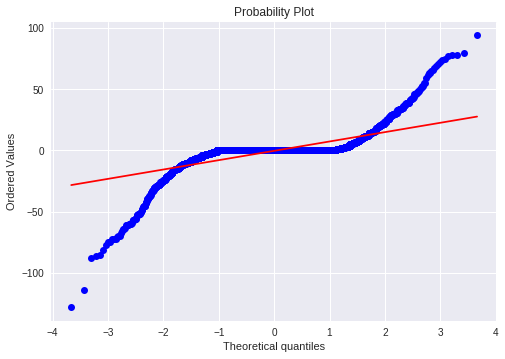

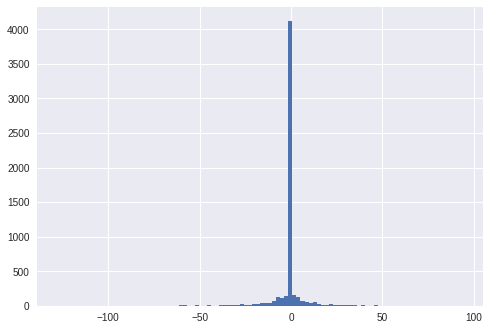

mean=-0.264 stdv=10.716
Statistics=0.508, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2154.924, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.370, p=0.000
Sample does not look Gaussian (reject H0)


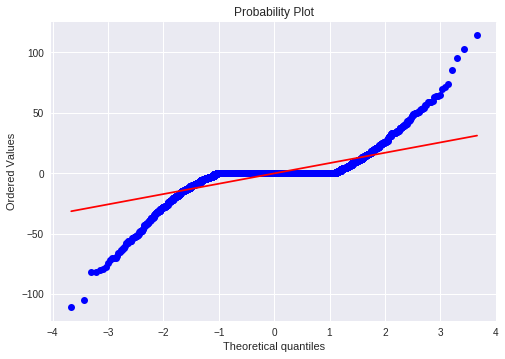

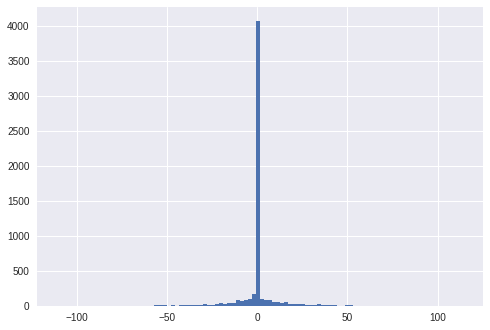

mean=-0.243 stdv=11.388
Statistics=0.563, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1450.698, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.368, p=0.000
Sample does not look Gaussian (reject H0)


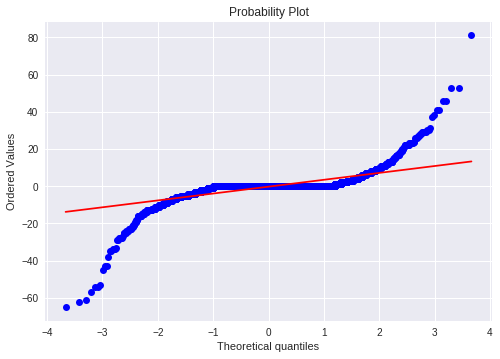

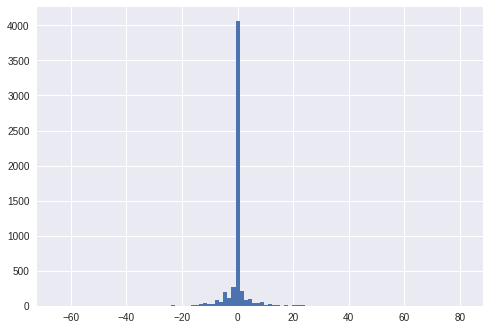

mean=-0.244 stdv=5.282
Statistics=0.491, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2103.024, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


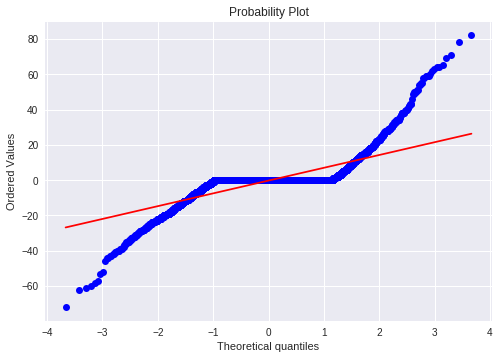

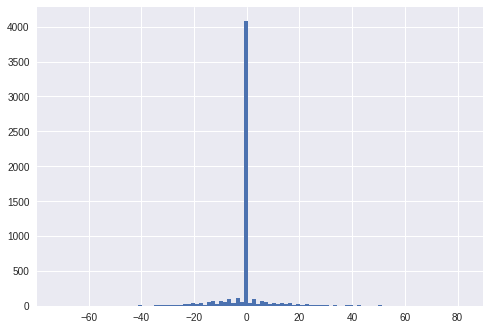

mean=-0.251 stdv=9.322
Statistics=0.605, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1721.461, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


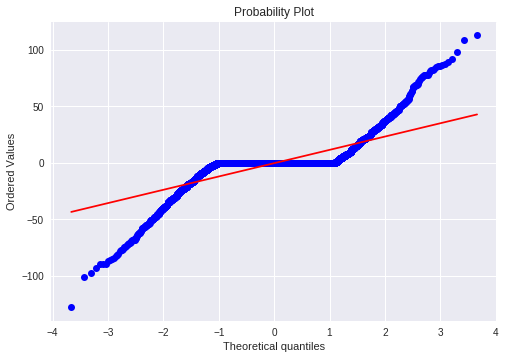

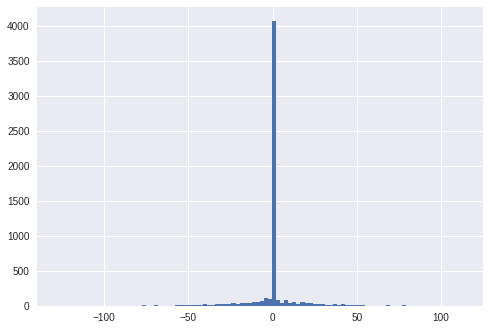

mean=-0.287 stdv=15.222
Statistics=0.600, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1134.025, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.366, p=0.000
Sample does not look Gaussian (reject H0)


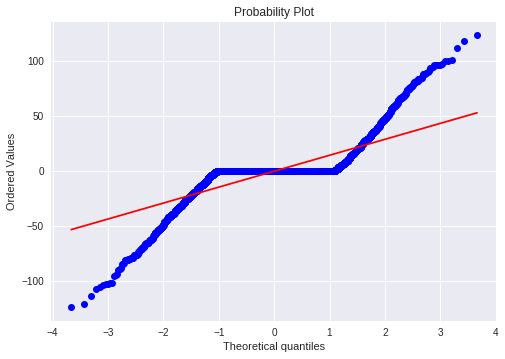

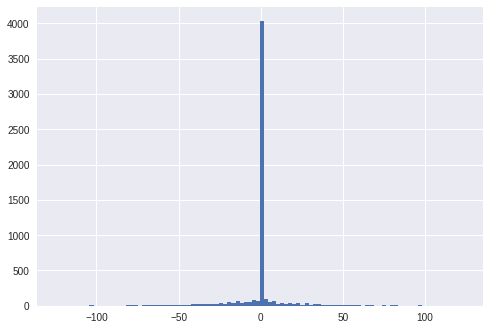

mean=-0.397 stdv=18.458
Statistics=0.615, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1006.628, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.364, p=0.000
Sample does not look Gaussian (reject H0)


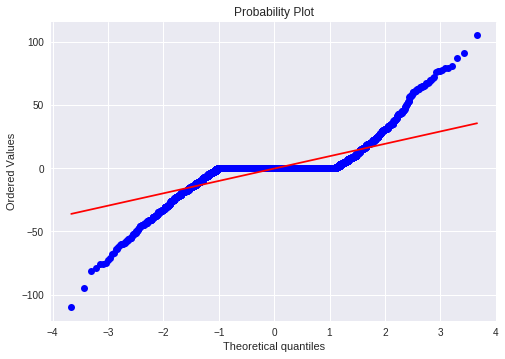

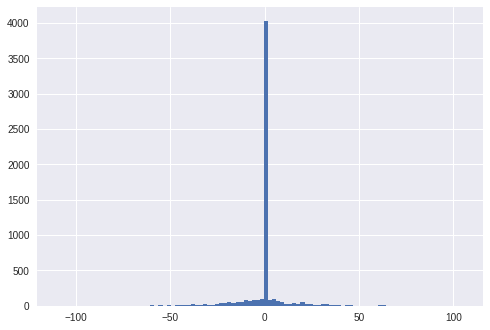

mean=-0.333 stdv=12.621
Statistics=0.601, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1224.200, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.369, p=0.000
Sample does not look Gaussian (reject H0)


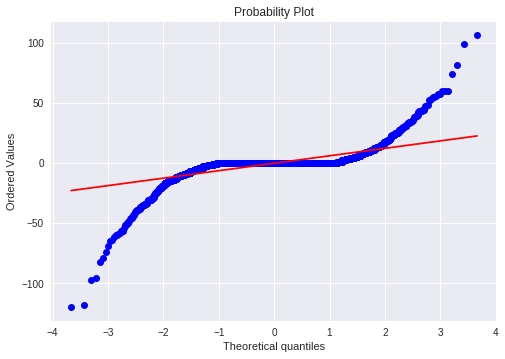

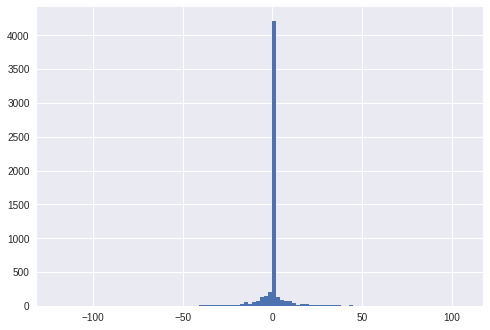

mean=-0.295 stdv=8.969
Statistics=0.478, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2628.849, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


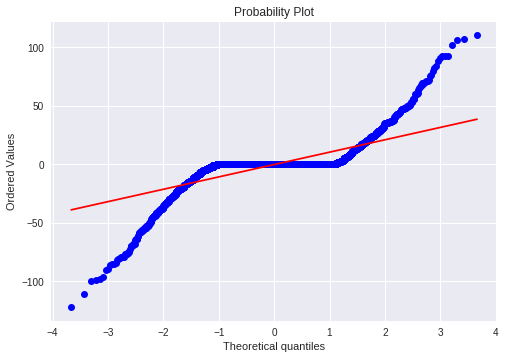

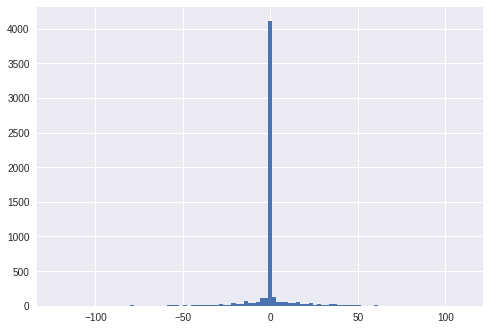

mean=-0.215 stdv=14.047
Statistics=0.565, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1417.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.369, p=0.000
Sample does not look Gaussian (reject H0)


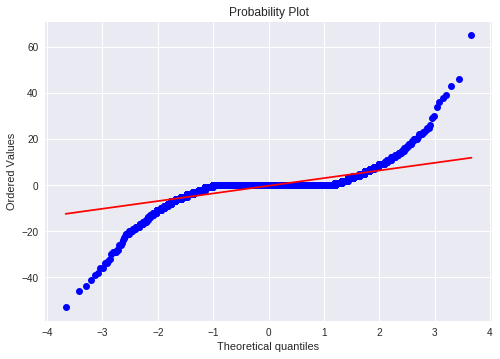

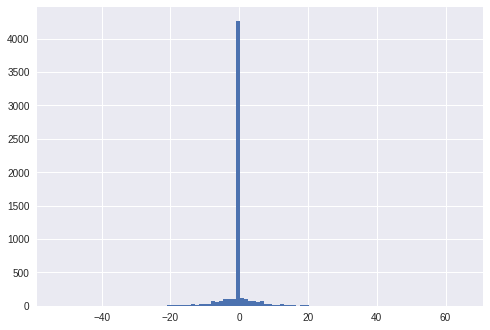

mean=-0.285 stdv=4.591
Statistics=0.525, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1944.882, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


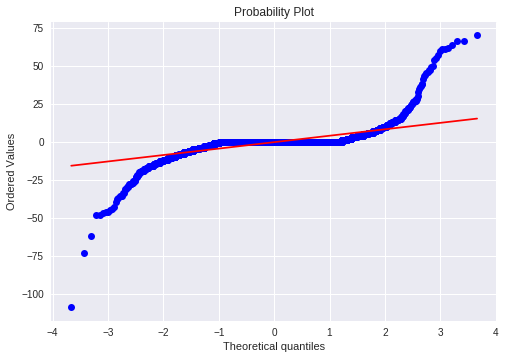

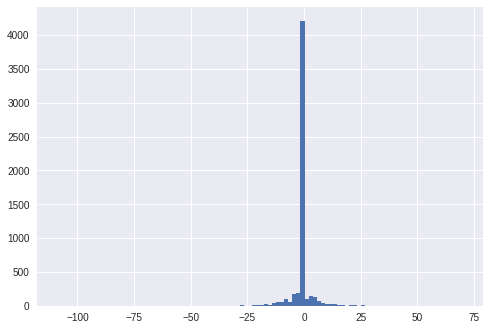

mean=-0.299 stdv=6.219
Statistics=0.465, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2042.860, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


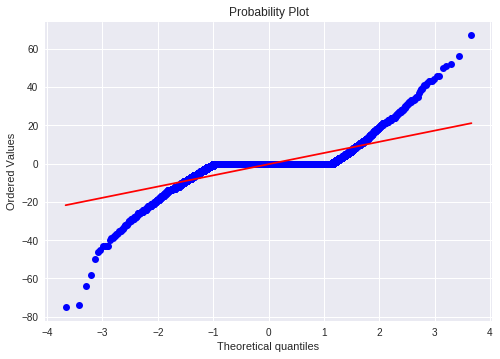

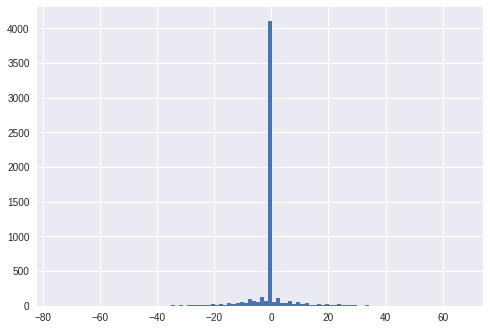

mean=-0.281 stdv=7.543
Statistics=0.602, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1264.564, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.378, p=0.000
Sample does not look Gaussian (reject H0)


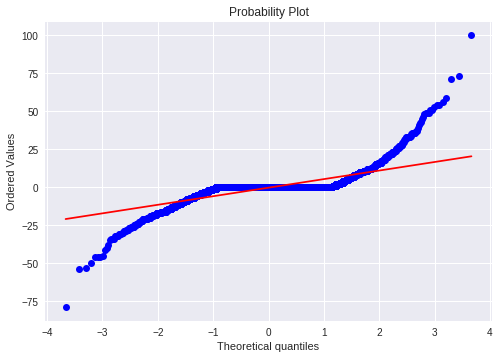

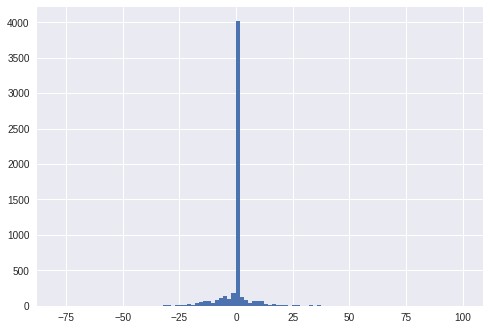

mean=-0.274 stdv=7.359
Statistics=0.588, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2239.320, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.376, p=0.000
Sample does not look Gaussian (reject H0)


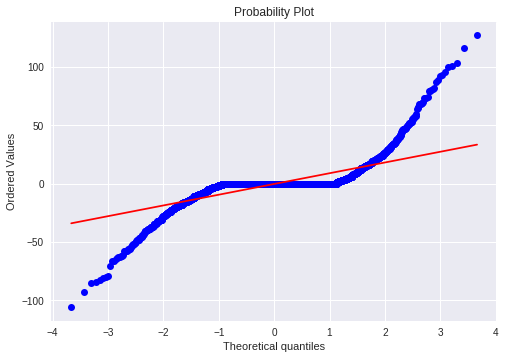

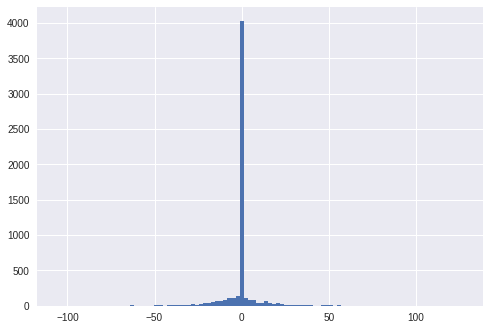

mean=-0.349 stdv=12.244
Statistics=0.565, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1924.506, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.370, p=0.000
Sample does not look Gaussian (reject H0)


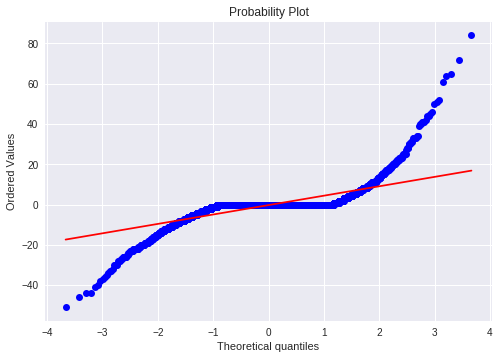

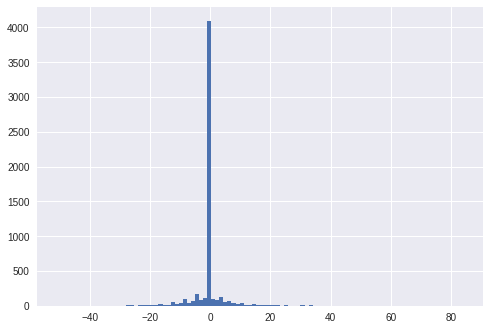

mean=-0.280 stdv=6.288
Statistics=0.553, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2824.041, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


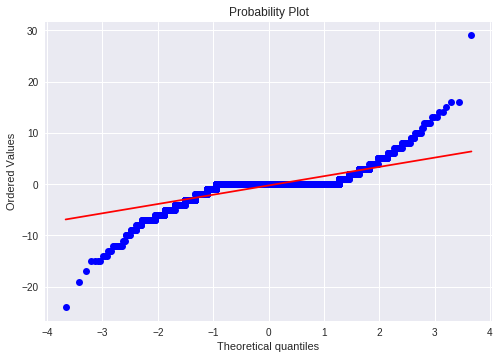

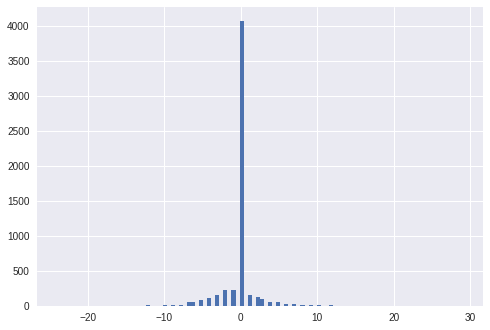

mean=-0.259 stdv=2.293
Statistics=0.623, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1439.931, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


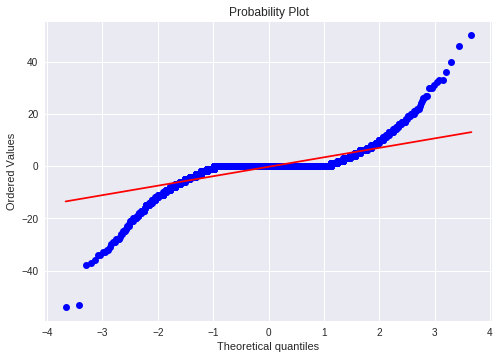

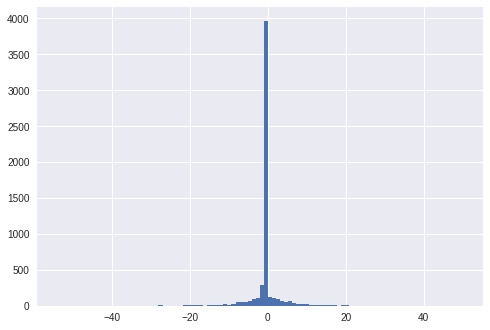

mean=-0.265 stdv=4.806
Statistics=0.568, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1863.115, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.371, p=0.000
Sample does not look Gaussian (reject H0)


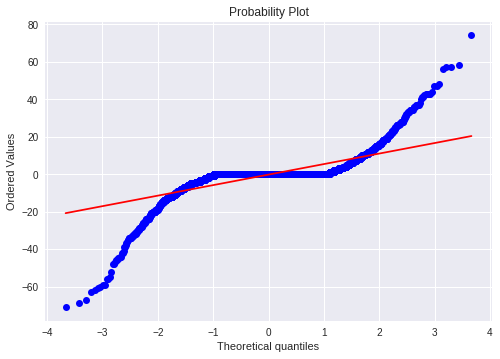

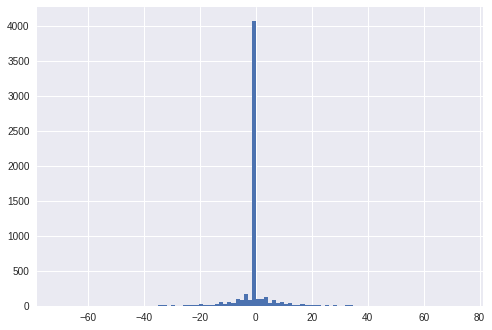

mean=-0.258 stdv=7.587
Statistics=0.548, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1917.499, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.365, p=0.000
Sample does not look Gaussian (reject H0)


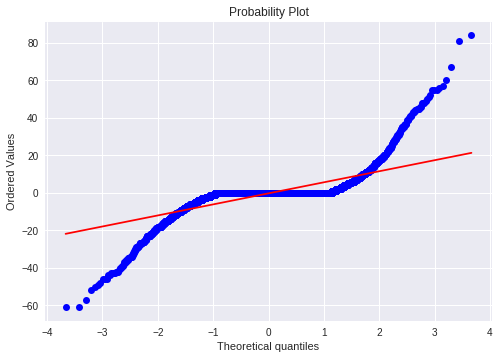

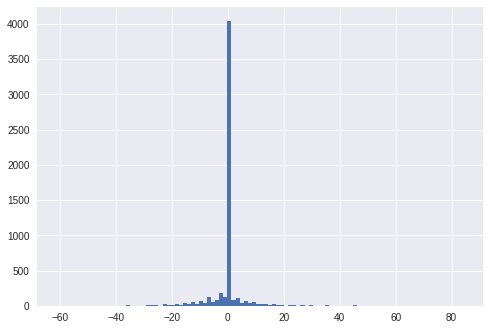

mean=-0.254 stdv=7.929
Statistics=0.553, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1806.156, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


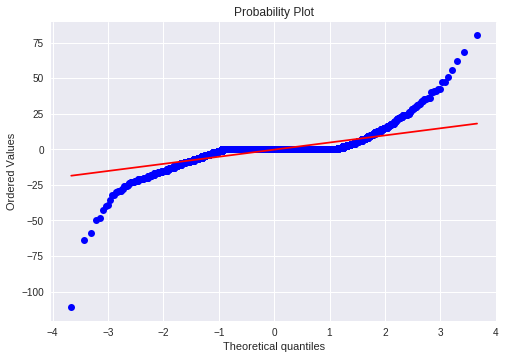

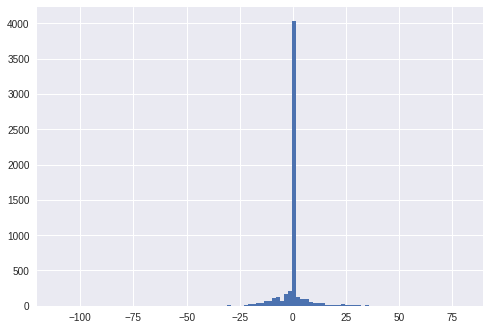

mean=-0.271 stdv=6.591
Statistics=0.576, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1697.146, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


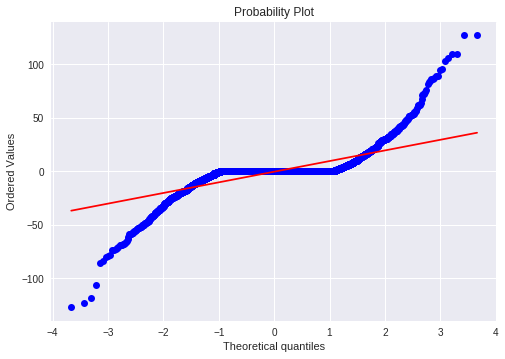

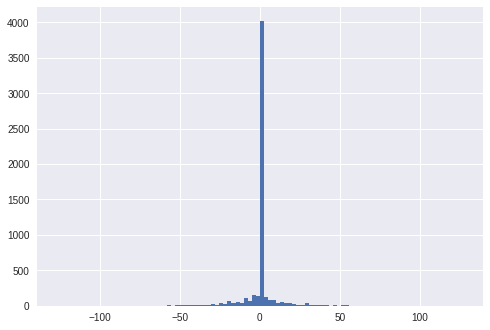

mean=-0.365 stdv=13.234
Statistics=0.564, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1454.447, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.365, p=0.000
Sample does not look Gaussian (reject H0)


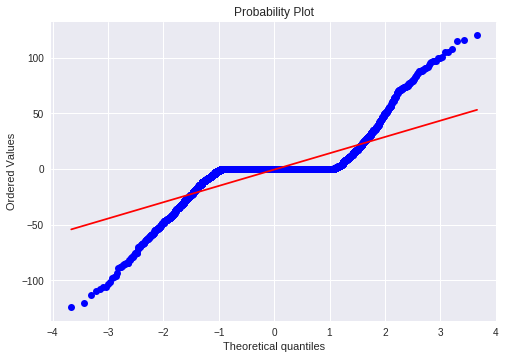

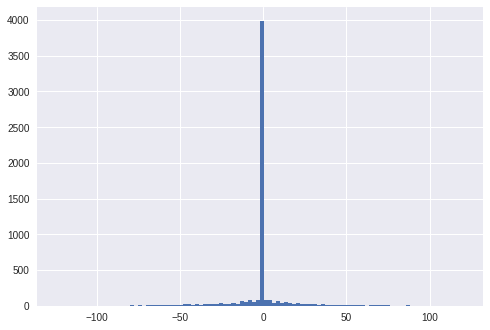

mean=-0.468 stdv=18.669
Statistics=0.615, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1055.904, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.362, p=0.000
Sample does not look Gaussian (reject H0)


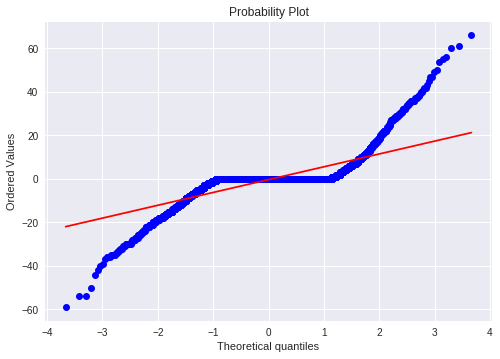

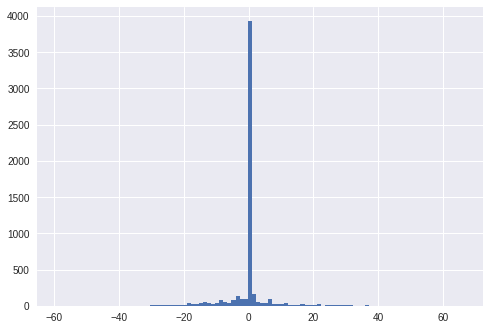

mean=-0.323 stdv=7.587
Statistics=0.605, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1495.416, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


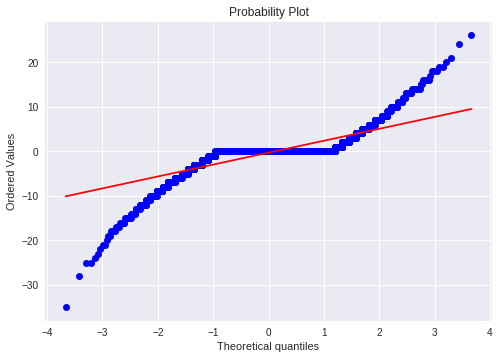

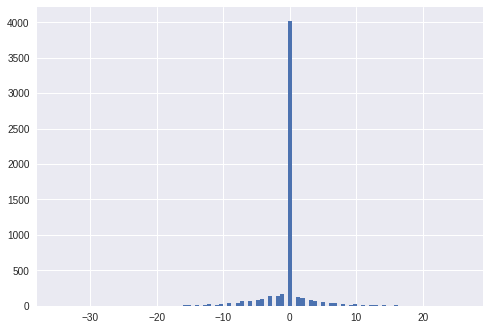

mean=-0.309 stdv=3.379
Statistics=0.627, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1651.564, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


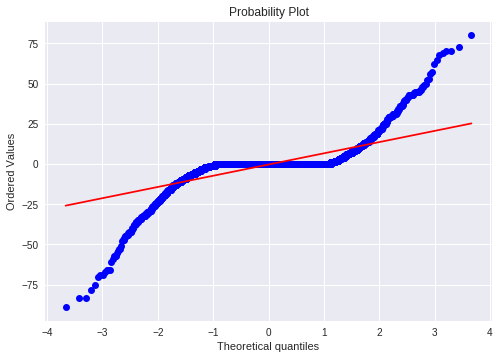

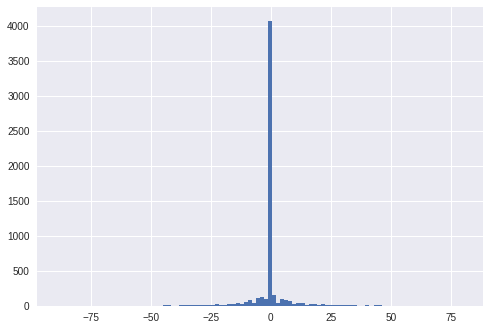

mean=-0.286 stdv=9.438
Statistics=0.547, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1644.751, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.369, p=0.000
Sample does not look Gaussian (reject H0)


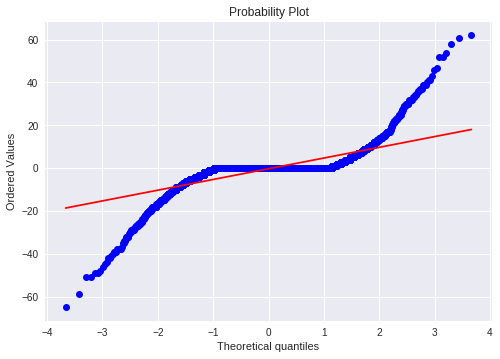

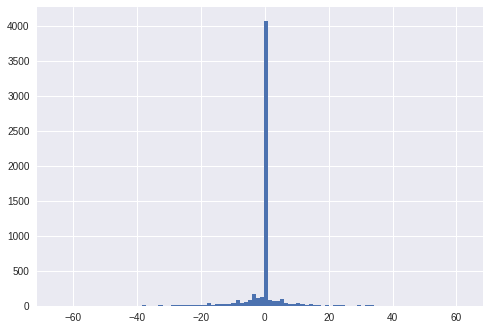

mean=-0.307 stdv=6.758
Statistics=0.550, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1440.372, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


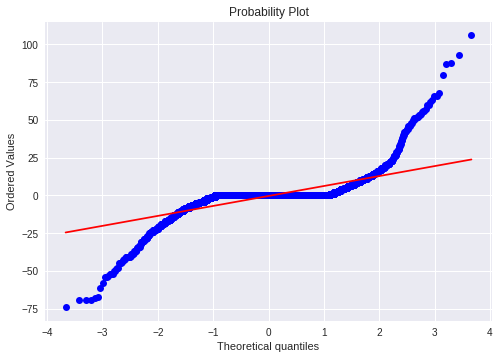

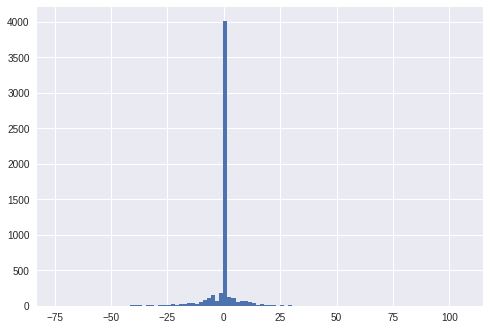

mean=-0.335 stdv=9.005
Statistics=0.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1916.023, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.367, p=0.000
Sample does not look Gaussian (reject H0)


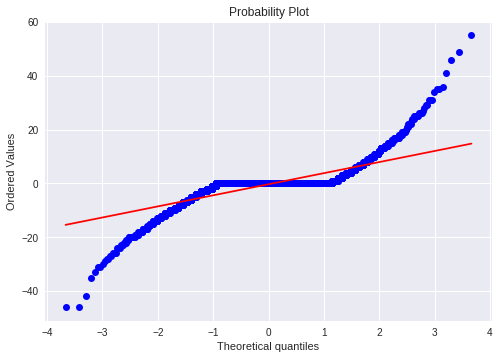

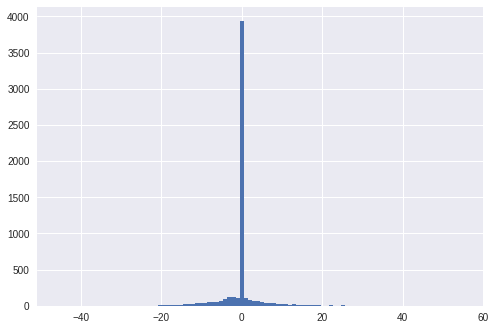

mean=-0.304 stdv=5.244
Statistics=0.617, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1328.377, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


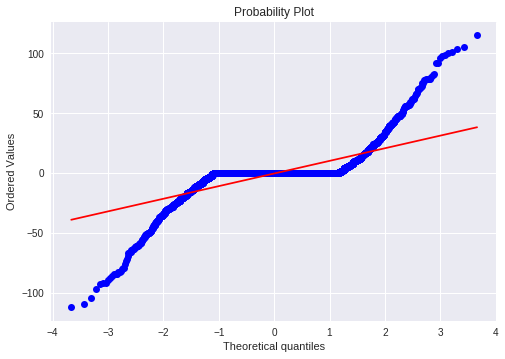

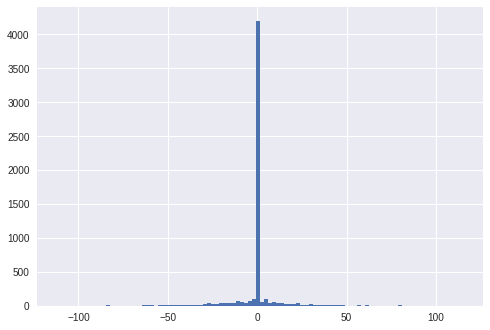

mean=-0.333 stdv=14.192
Statistics=0.552, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1274.162, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


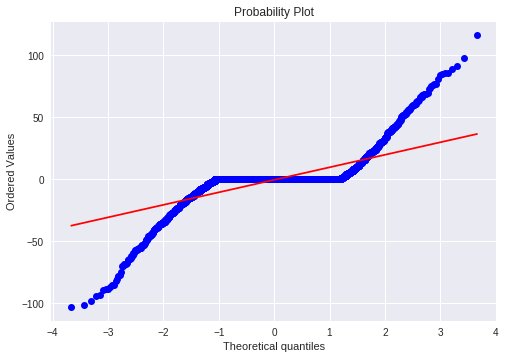

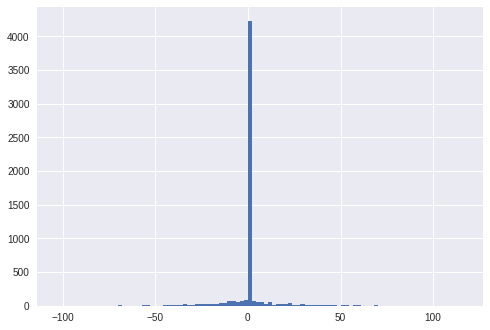

mean=-0.356 stdv=13.527
Statistics=0.555, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1232.050, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


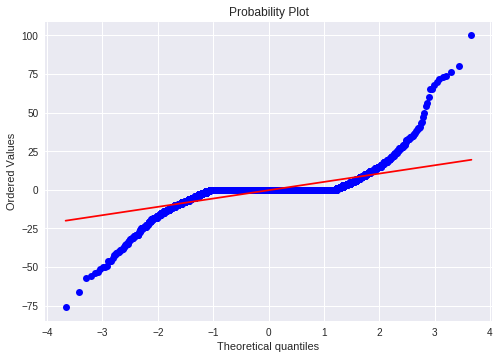

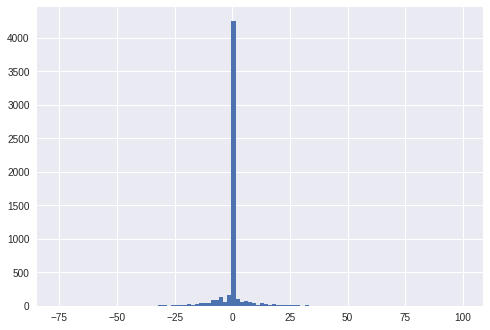

mean=-0.250 stdv=7.600
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2330.889, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


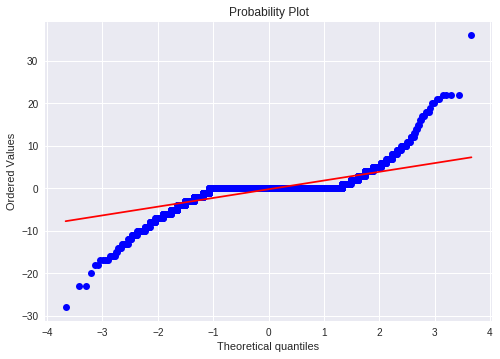

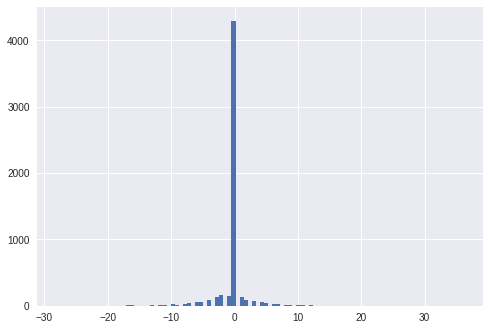

mean=-0.224 stdv=2.782
Statistics=0.545, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1477.484, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


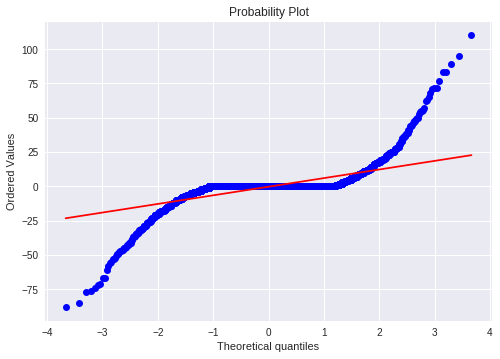

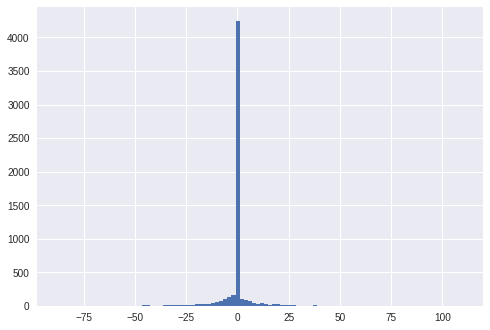

mean=-0.223 stdv=9.019
Statistics=0.485, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1780.305, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


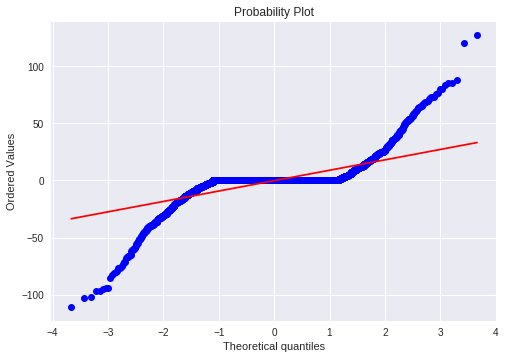

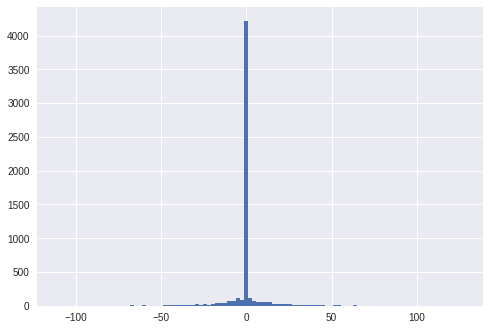

mean=-0.178 stdv=12.573
Statistics=0.525, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1436.712, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


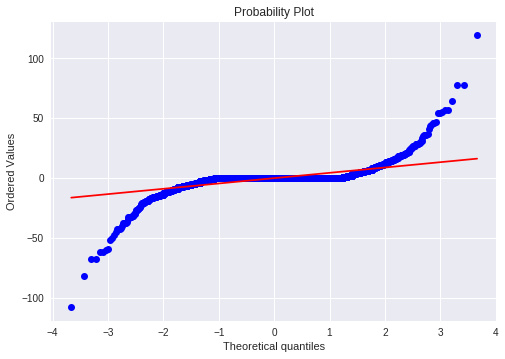

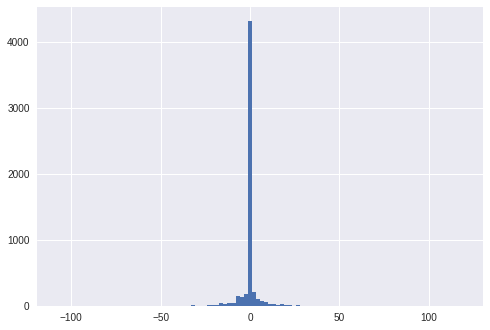

mean=-0.213 stdv=6.691
Statistics=0.442, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1994.186, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


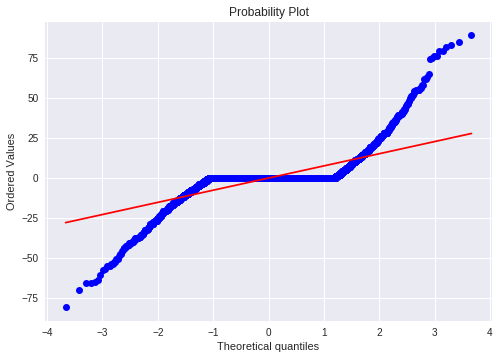

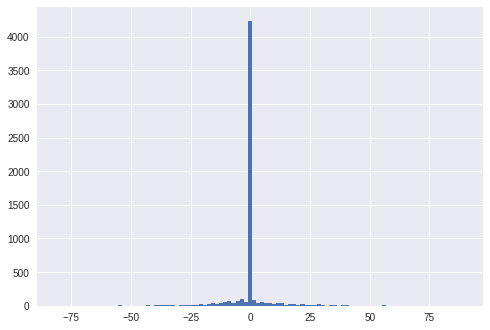

mean=-0.216 stdv=10.214
Statistics=0.555, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1612.563, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


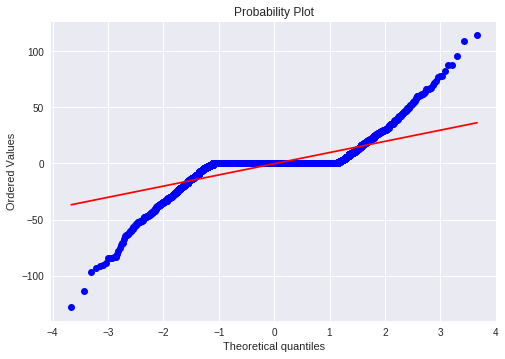

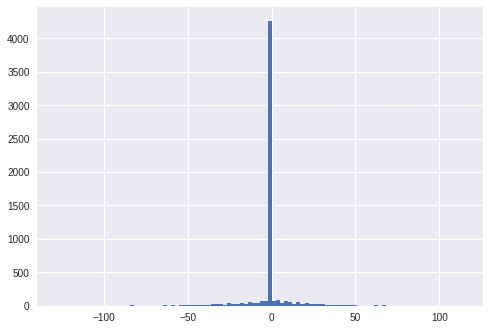

mean=-0.266 stdv=13.225
Statistics=0.568, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1409.863, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.376, p=0.000
Sample does not look Gaussian (reject H0)


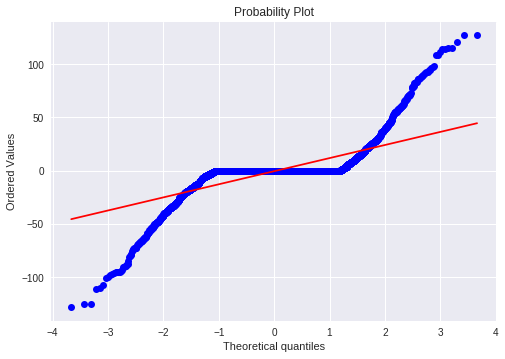

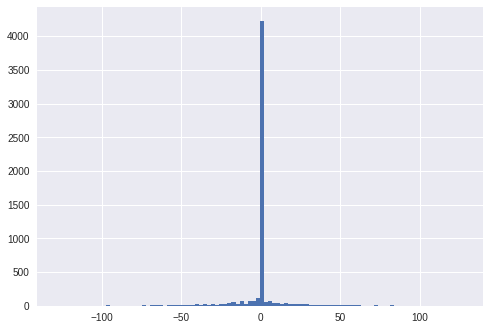

mean=-0.390 stdv=16.704
Statistics=0.541, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1293.408, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


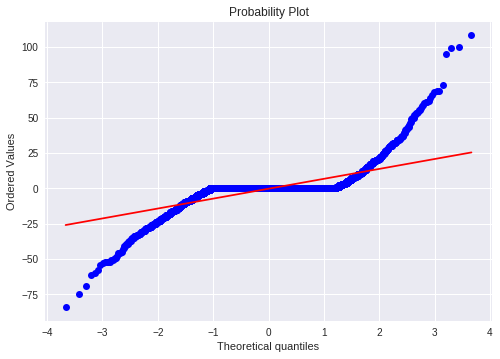

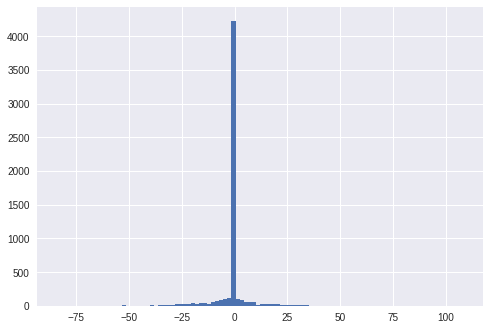

mean=-0.302 stdv=9.549
Statistics=0.538, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2149.782, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


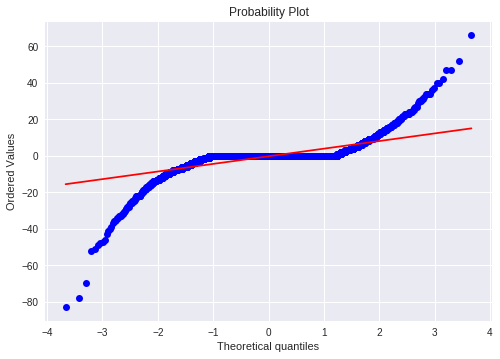

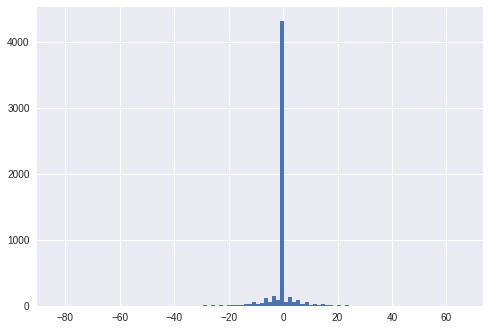

mean=-0.260 stdv=5.893
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2800.582, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


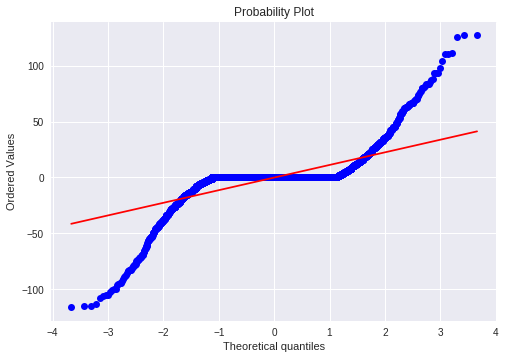

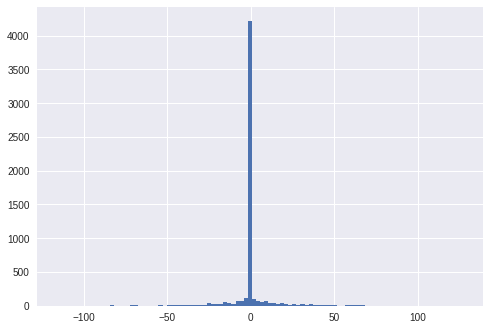

mean=-0.098 stdv=15.619
Statistics=0.521, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1420.406, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


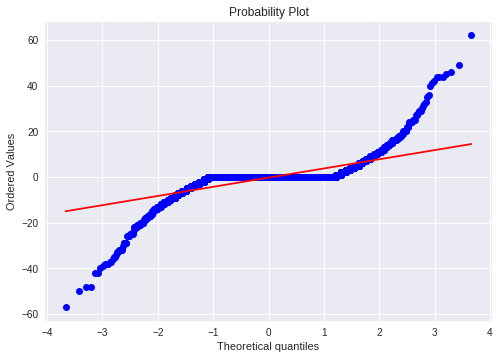

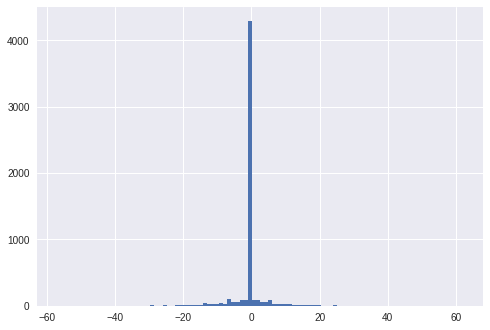

mean=-0.268 stdv=5.564
Statistics=0.522, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1654.121, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


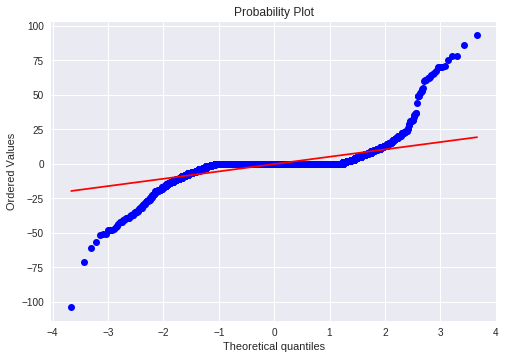

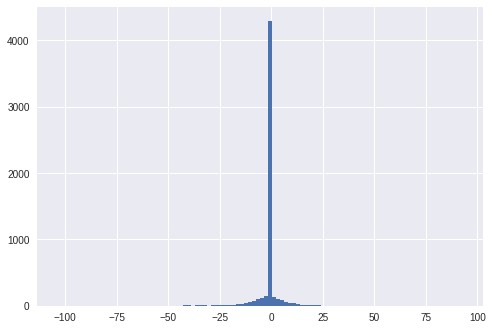

mean=-0.270 stdv=7.854
Statistics=0.459, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2648.469, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


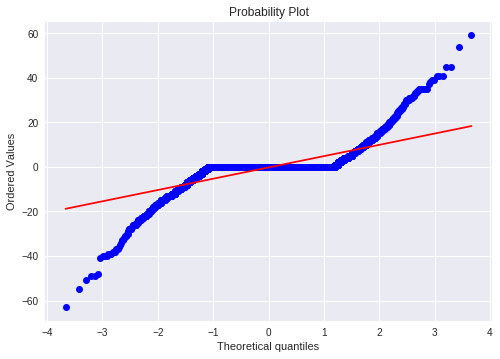

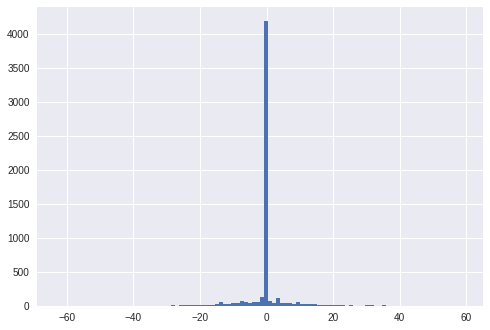

mean=-0.257 stdv=6.709
Statistics=0.571, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1310.602, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


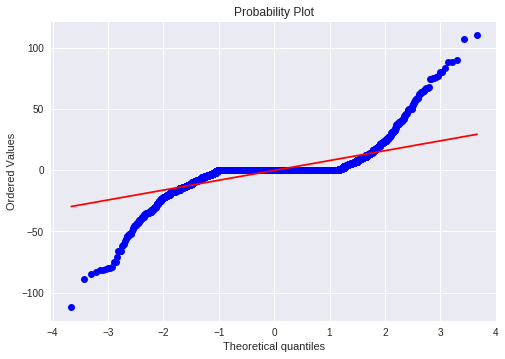

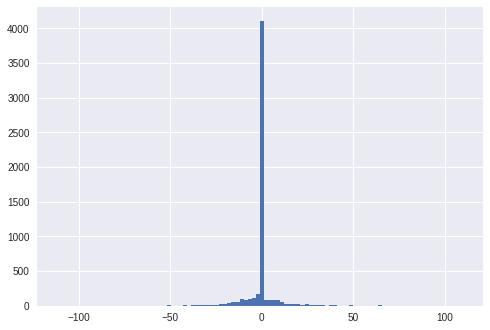

mean=-0.259 stdv=11.085
Statistics=0.527, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1704.437, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


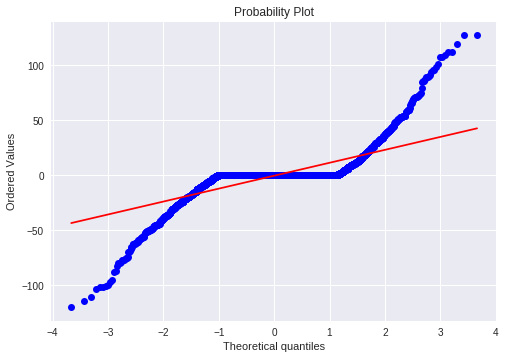

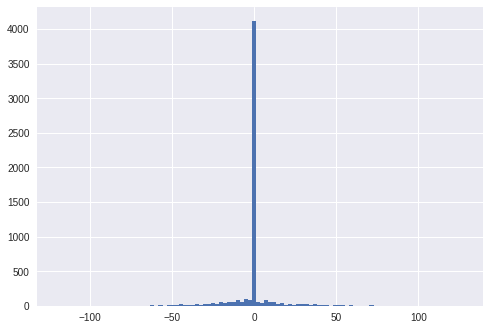

mean=-0.493 stdv=15.465
Statistics=0.577, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1326.912, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.376, p=0.000
Sample does not look Gaussian (reject H0)


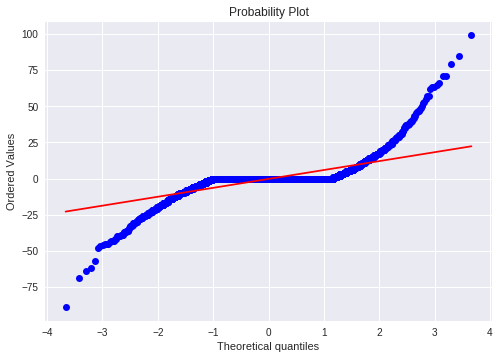

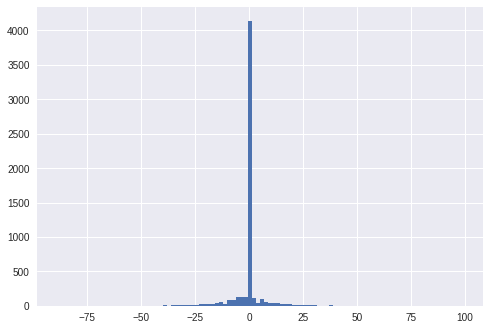

mean=-0.271 stdv=8.327
Statistics=0.549, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2016.315, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


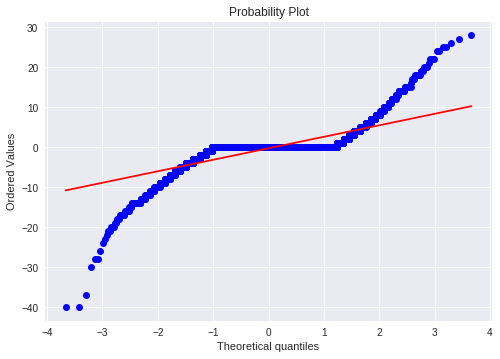

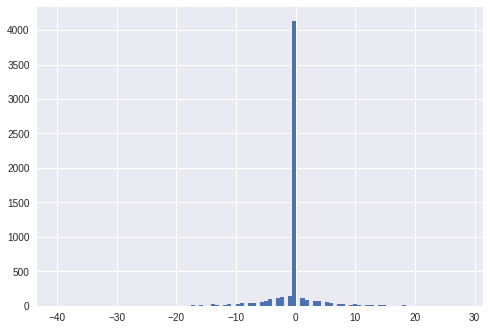

mean=-0.239 stdv=3.764
Statistics=0.584, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1626.451, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


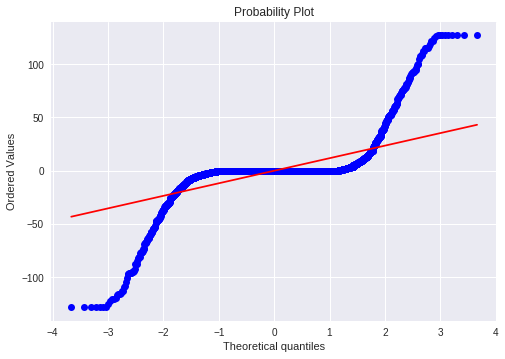

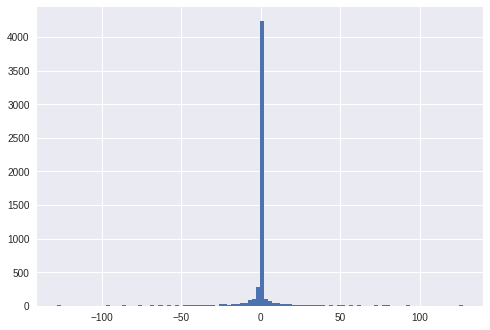

mean=0.036 stdv=17.859
Statistics=0.434, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1560.394, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.378, p=0.000
Sample does not look Gaussian (reject H0)


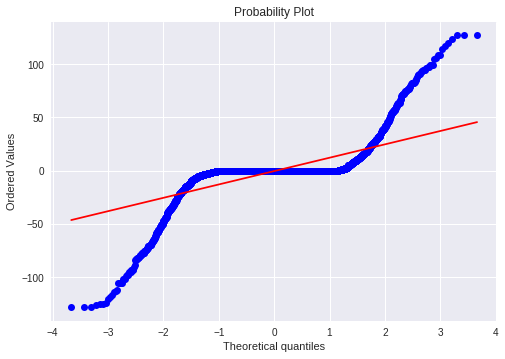

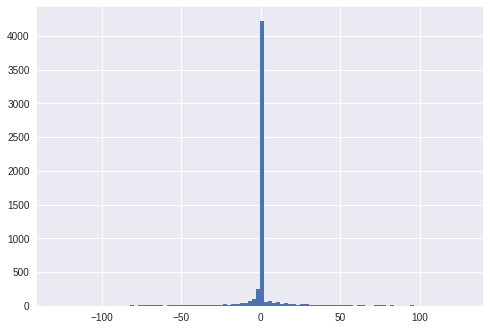

mean=-0.293 stdv=17.974
Statistics=0.487, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1446.655, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


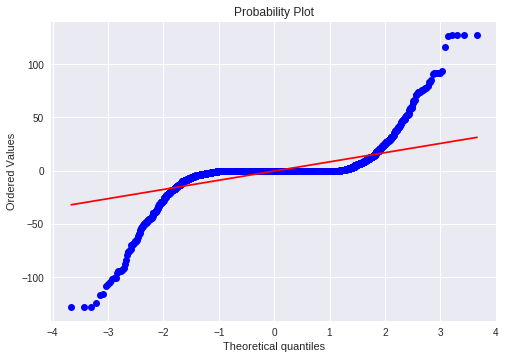

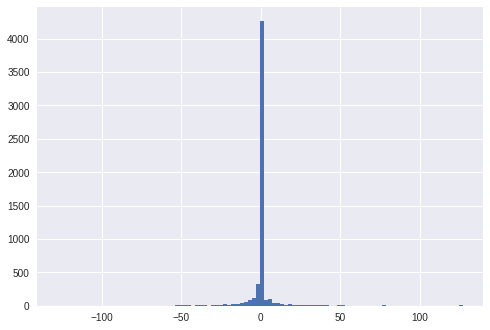

mean=-0.262 stdv=13.317
Statistics=0.421, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1800.162, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


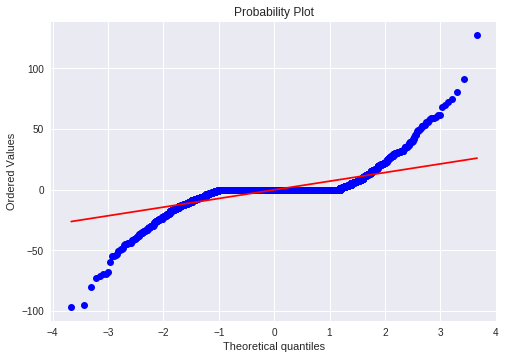

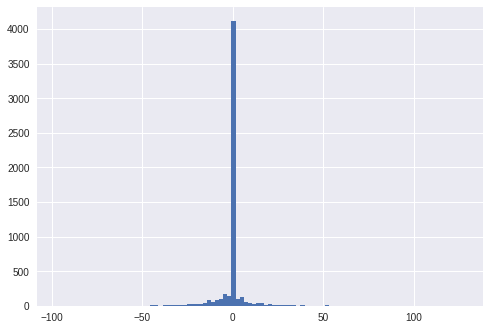

mean=-0.273 stdv=9.657
Statistics=0.545, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1659.173, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


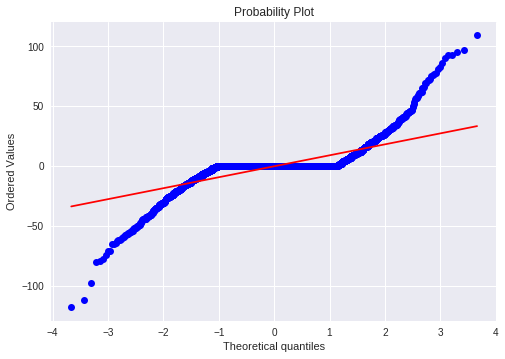

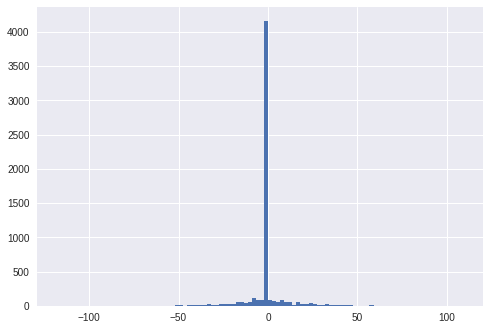

mean=-0.295 stdv=12.102
Statistics=0.572, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1342.817, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


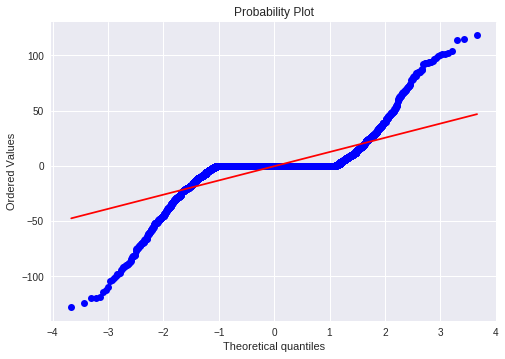

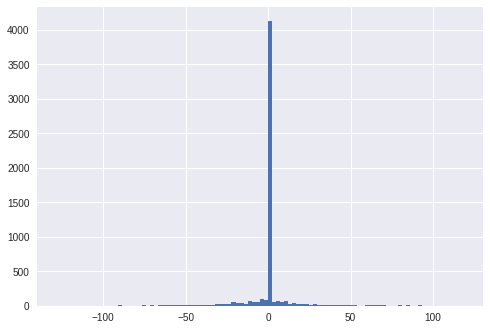

mean=-0.406 stdv=17.185
Statistics=0.561, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1259.473, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.367, p=0.000
Sample does not look Gaussian (reject H0)


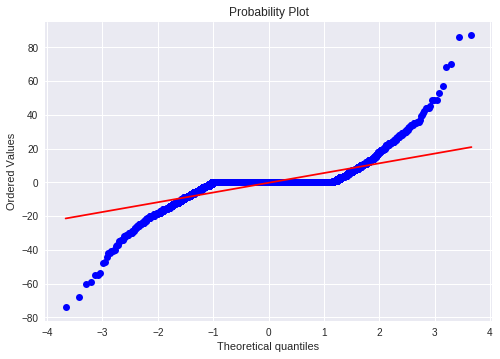

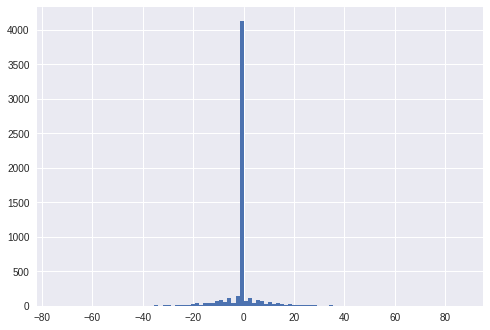

mean=-0.298 stdv=7.618
Statistics=0.574, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1585.725, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


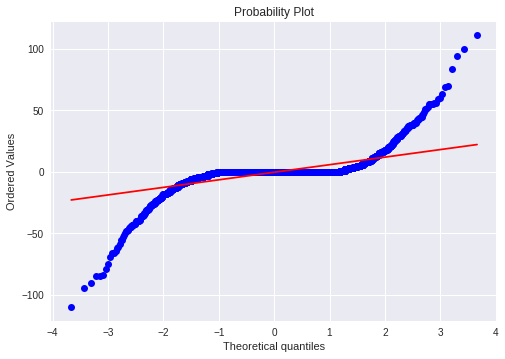

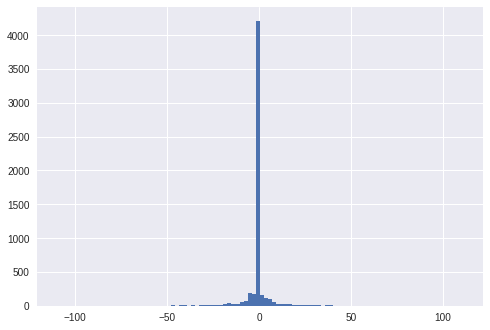

mean=-0.269 stdv=9.032
Statistics=0.464, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1851.775, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


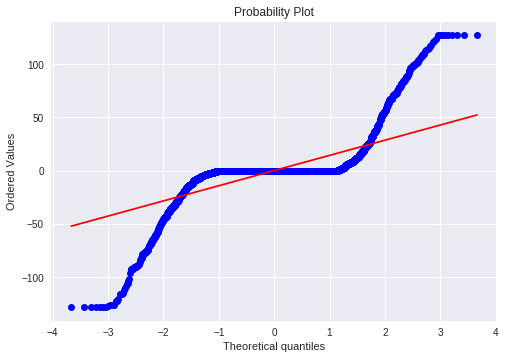

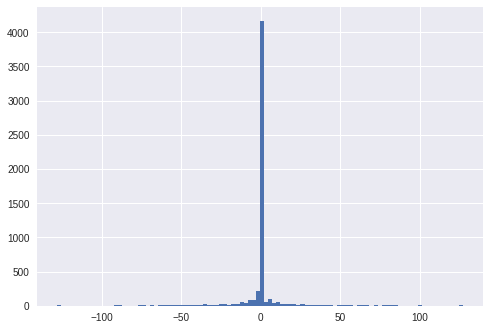

mean=0.216 stdv=20.093
Statistics=0.502, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1355.665, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


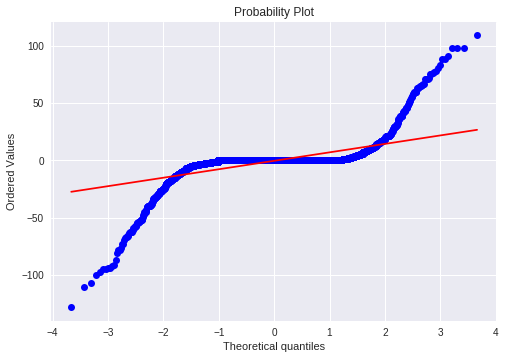

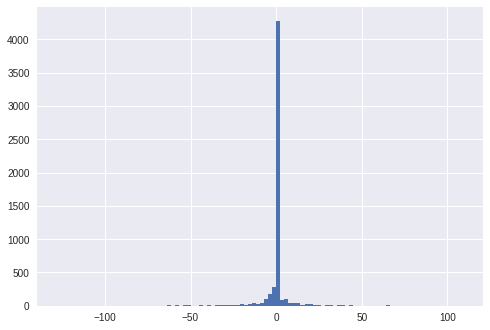

mean=-0.335 stdv=11.404
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1937.294, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


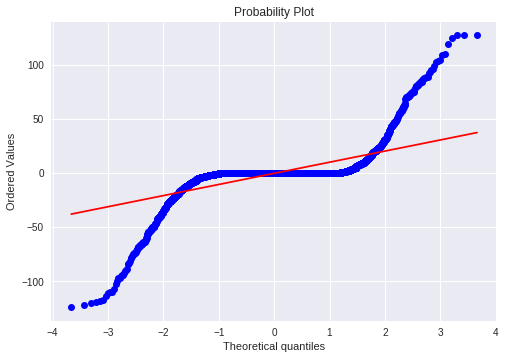

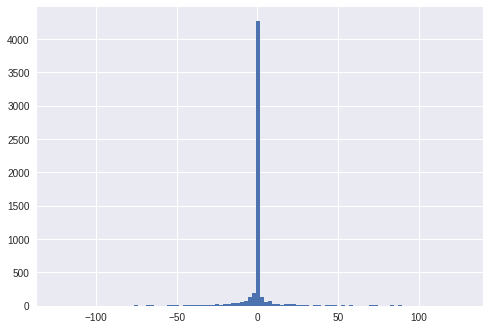

mean=-0.378 stdv=15.258
Statistics=0.454, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1486.230, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


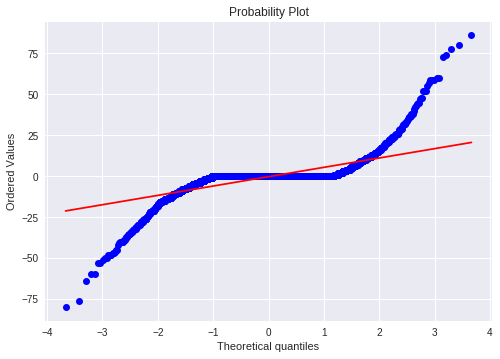

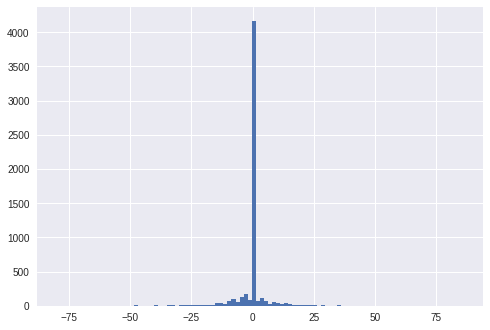

mean=-0.281 stdv=7.934
Statistics=0.518, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1707.763, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


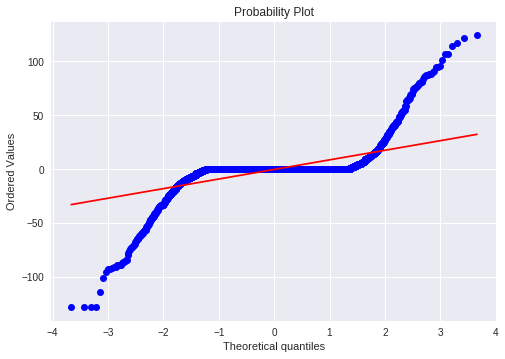

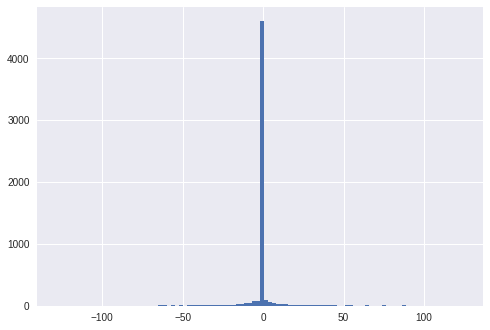

mean=-0.276 stdv=13.889
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1559.587, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.415, p=0.000
Sample does not look Gaussian (reject H0)


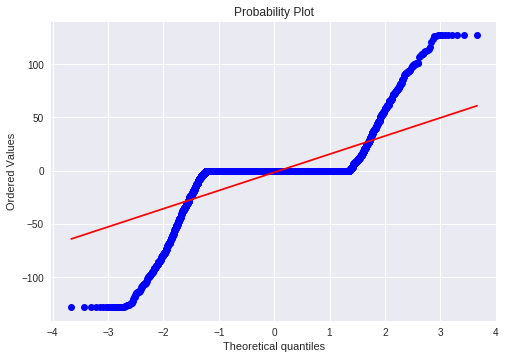

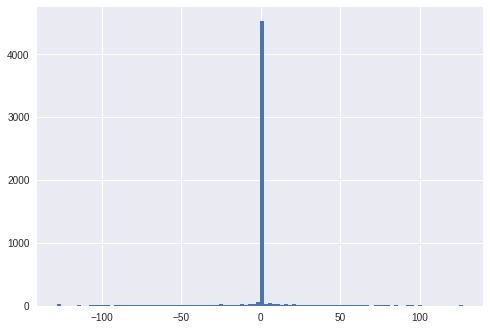

mean=-1.484 stdv=24.104
Statistics=0.500, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1605.499, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


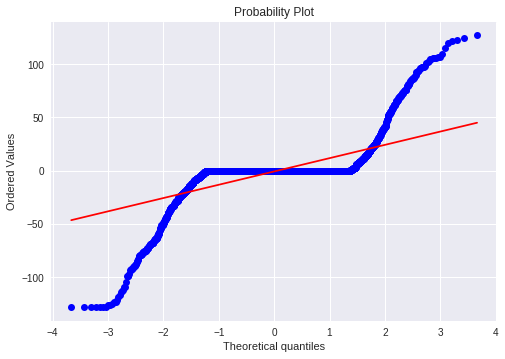

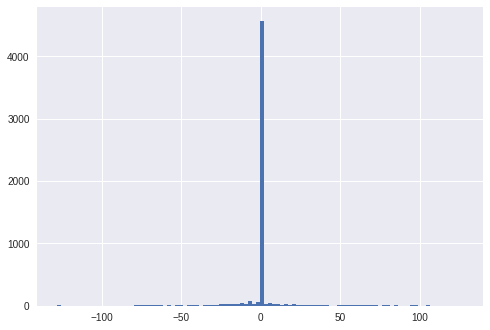

mean=-0.635 stdv=18.431
Statistics=0.458, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1445.383, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


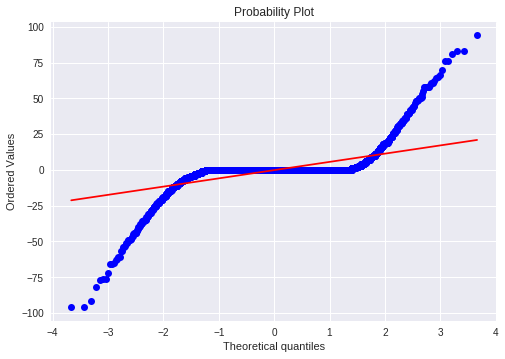

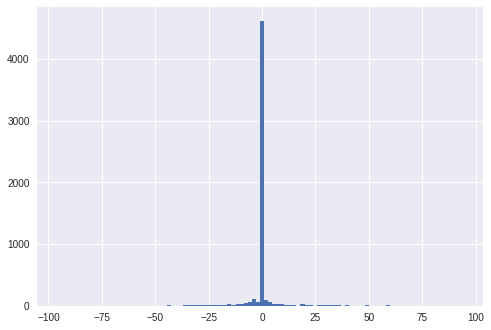

mean=-0.172 stdv=9.116
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1674.077, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)


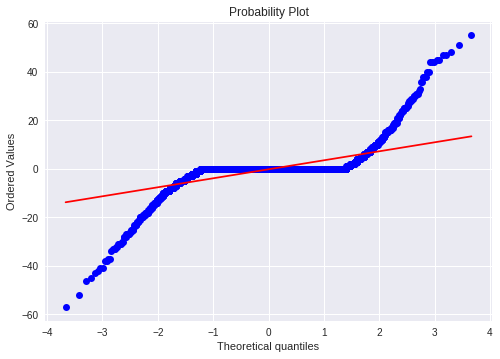

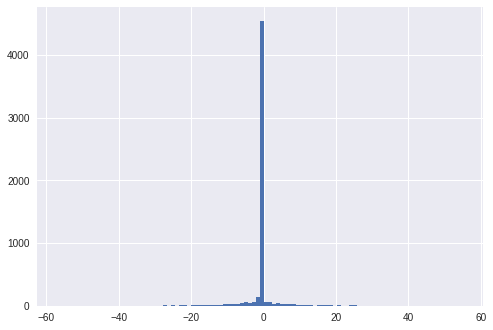

mean=-0.169 stdv=5.592
Statistics=0.440, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1603.447, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.420, p=0.000
Sample does not look Gaussian (reject H0)


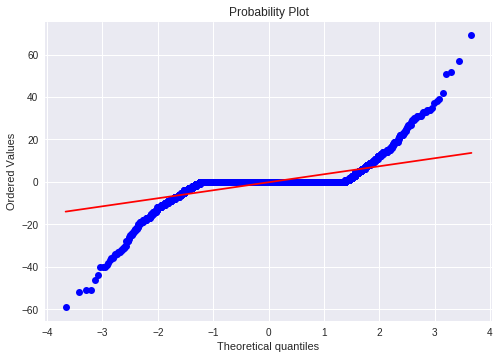

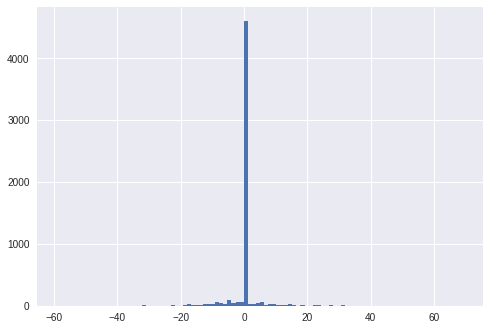

mean=-0.161 stdv=5.612
Statistics=0.453, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1602.284, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


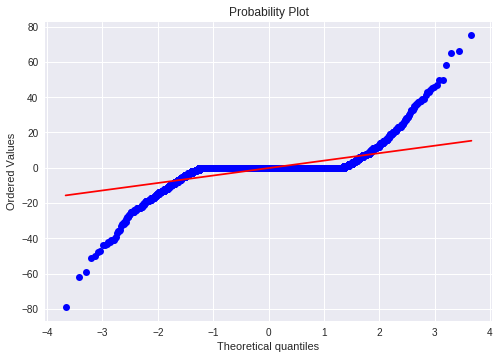

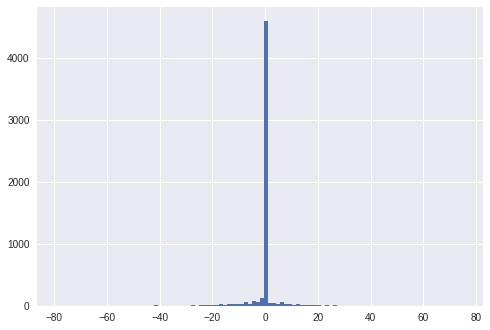

mean=-0.168 stdv=6.354
Statistics=0.443, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1656.429, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


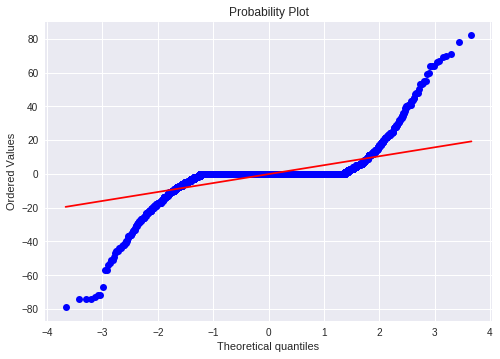

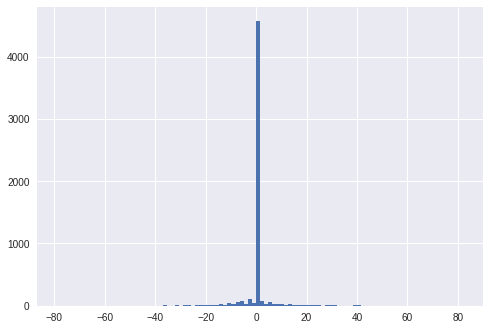

mean=-0.166 stdv=8.117
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1684.533, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


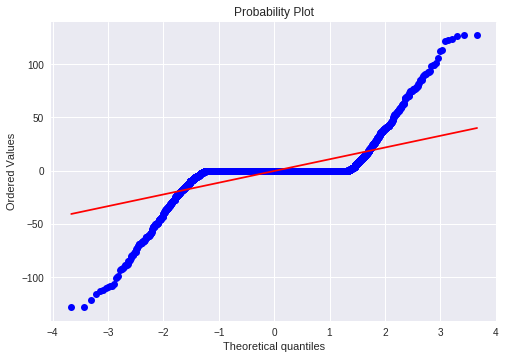

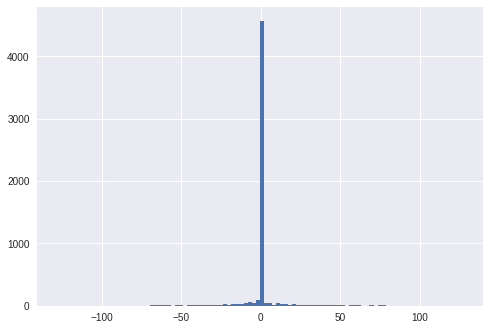

mean=-0.198 stdv=16.230
Statistics=0.460, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1375.039, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)


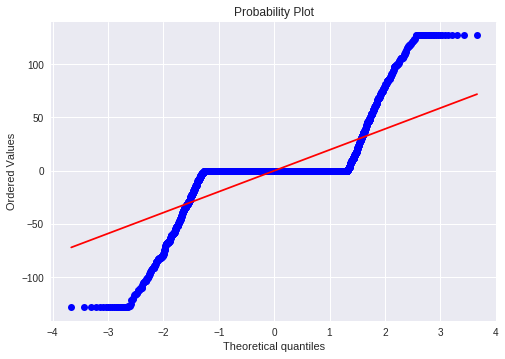

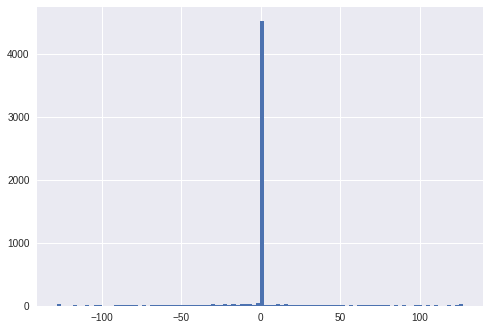

mean=-0.010 stdv=26.975
Statistics=0.529, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1006.047, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


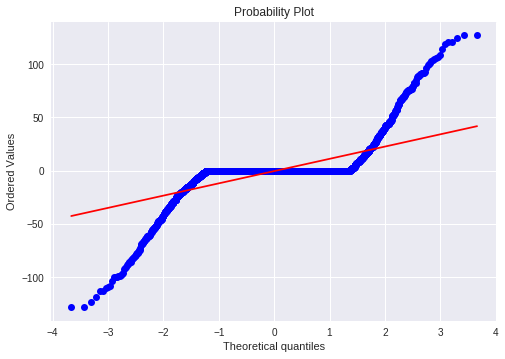

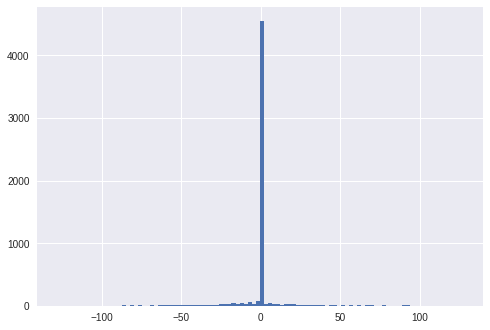

mean=-0.301 stdv=16.807
Statistics=0.469, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1366.434, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


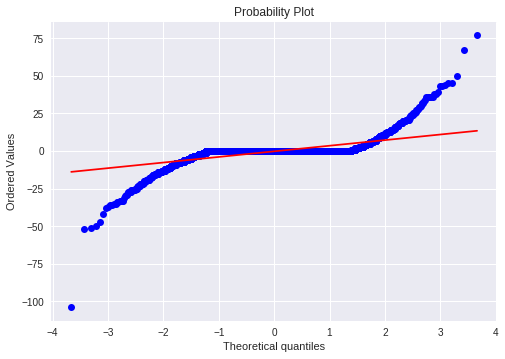

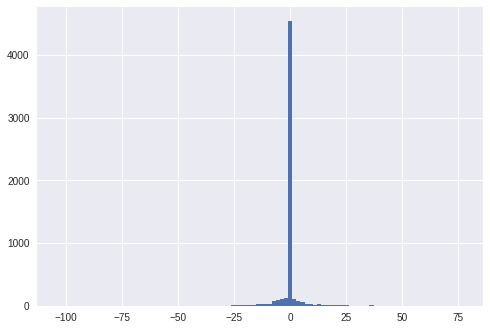

mean=-0.193 stdv=5.678
Statistics=0.433, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2001.898, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)


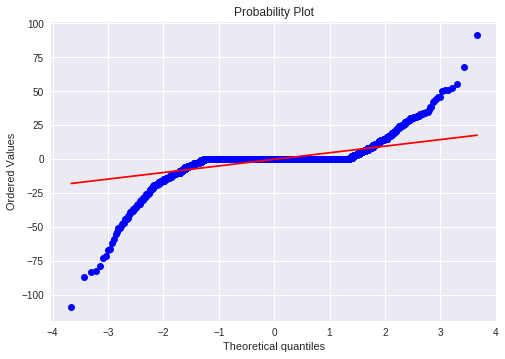

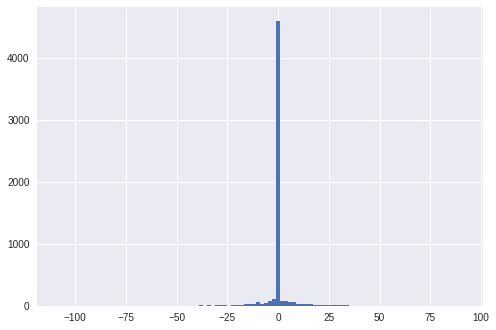

mean=-0.194 stdv=7.433
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3386.862, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


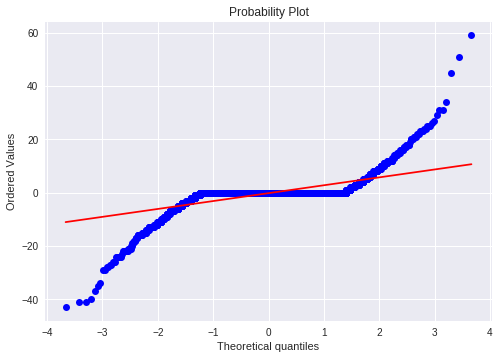

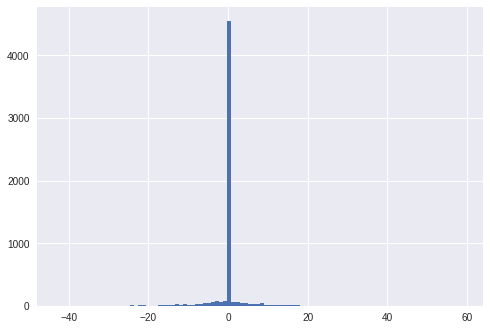

mean=-0.199 stdv=4.365
Statistics=0.462, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1632.929, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.420, p=0.000
Sample does not look Gaussian (reject H0)


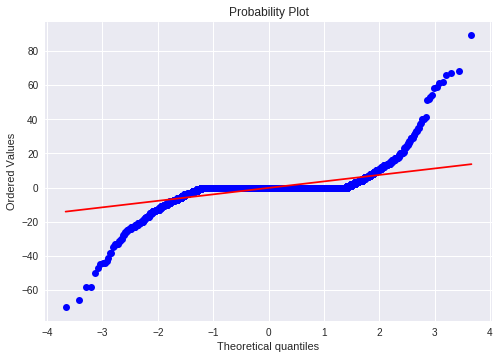

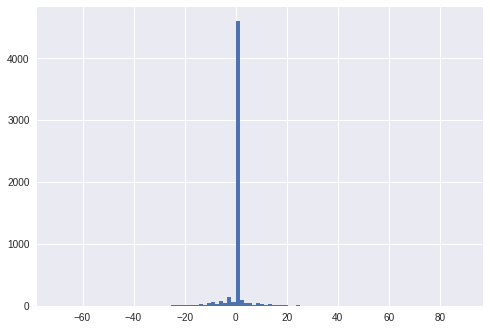

mean=-0.201 stdv=5.965
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2727.999, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.422, p=0.000
Sample does not look Gaussian (reject H0)


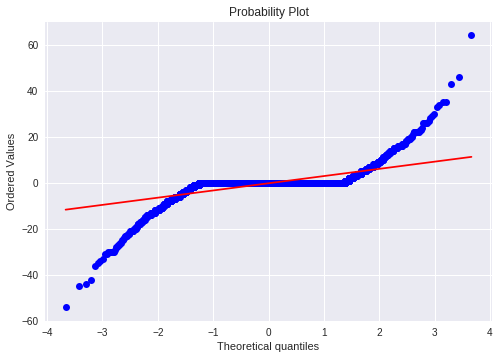

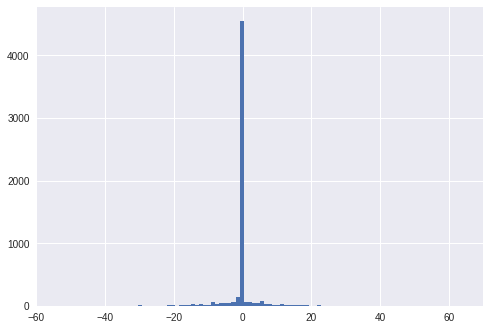

mean=-0.191 stdv=4.623
Statistics=0.459, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1800.591, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


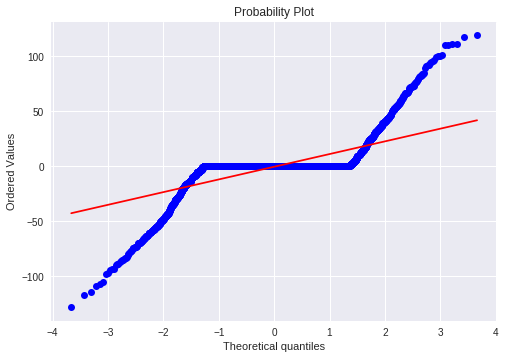

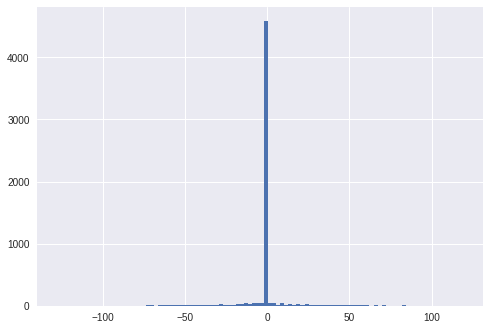

mean=-0.351 stdv=16.507
Statistics=0.488, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1235.298, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


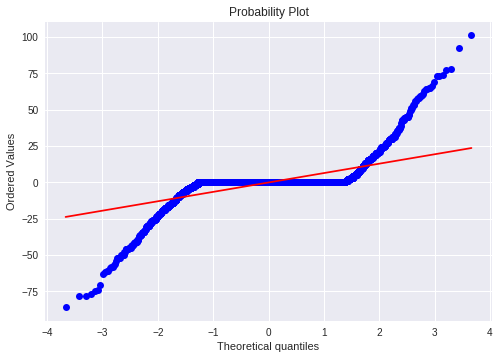

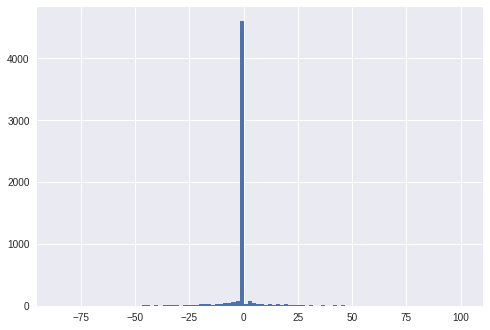

mean=-0.182 stdv=9.695
Statistics=0.446, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1558.379, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


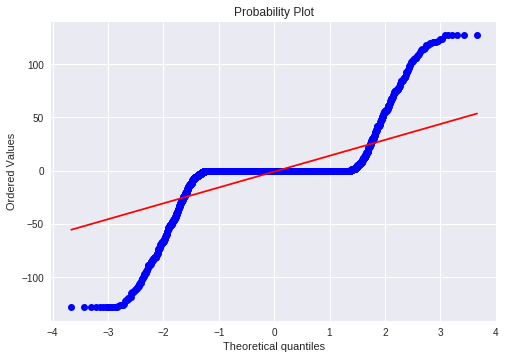

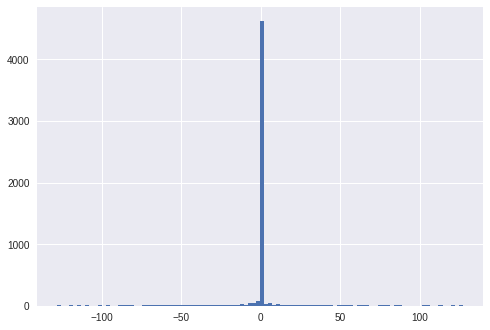

mean=-0.803 stdv=22.131
Statistics=0.452, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1413.459, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


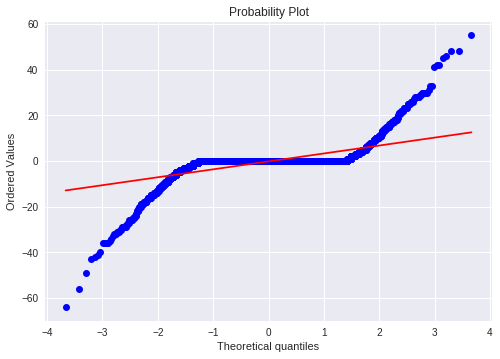

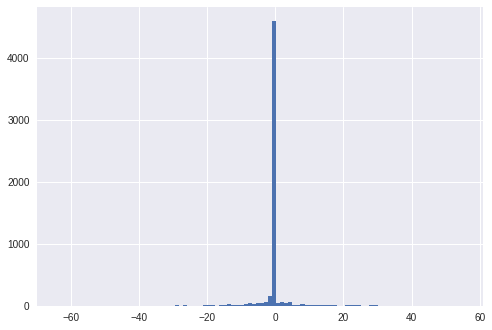

mean=-0.161 stdv=5.320
Statistics=0.427, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1782.272, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.423, p=0.000
Sample does not look Gaussian (reject H0)


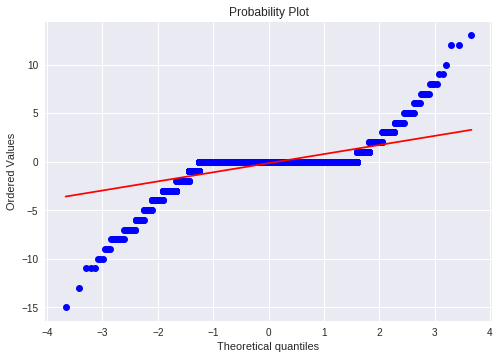

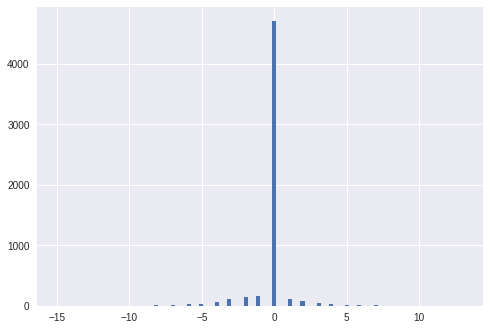

mean=-0.163 stdv=1.373
Statistics=0.467, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2547.625, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.445, p=0.000
Sample does not look Gaussian (reject H0)


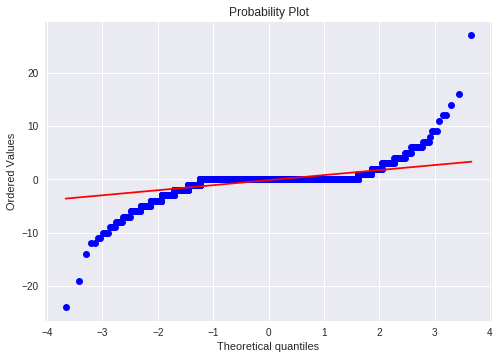

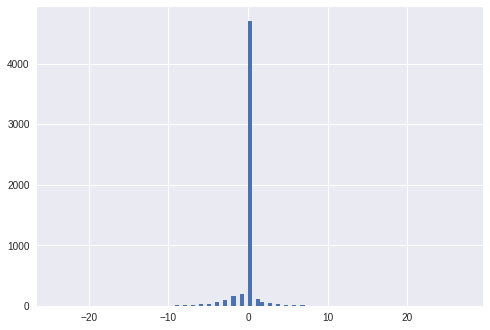

mean=-0.159 stdv=1.449
Statistics=0.427, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2380.696, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.448, p=0.000
Sample does not look Gaussian (reject H0)


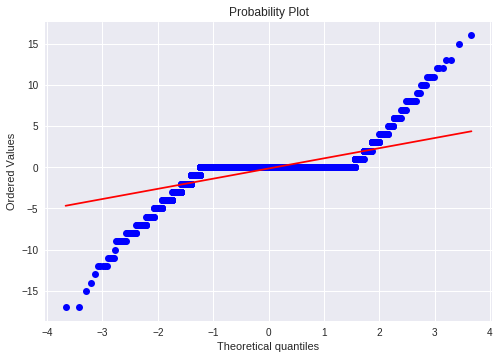

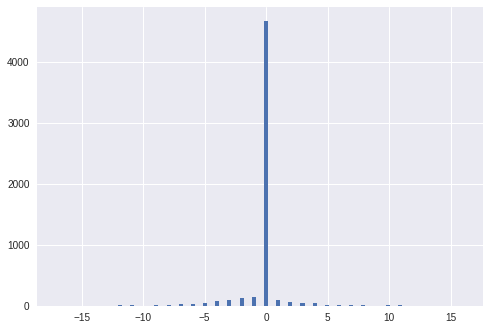

mean=-0.161 stdv=1.787
Statistics=0.477, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1713.345, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.441, p=0.000
Sample does not look Gaussian (reject H0)


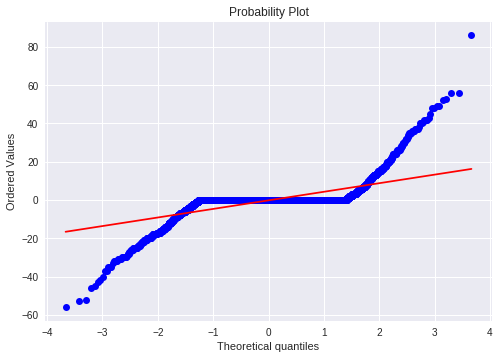

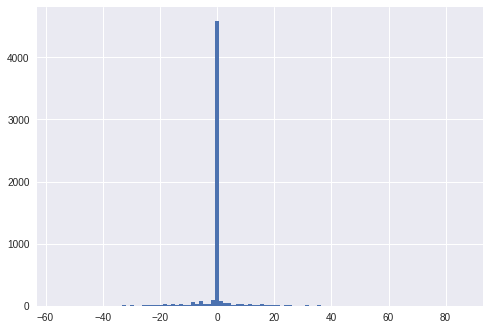

mean=-0.170 stdv=6.591
Statistics=0.463, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2094.856, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.421, p=0.000
Sample does not look Gaussian (reject H0)


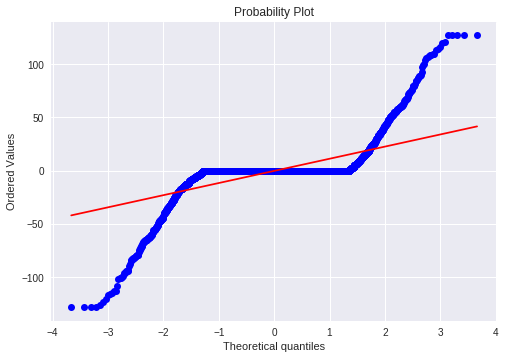

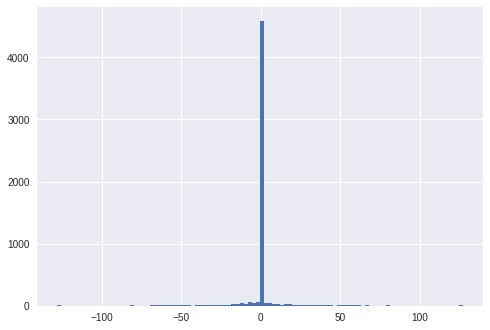

mean=-0.106 stdv=17.008
Statistics=0.449, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1400.418, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)


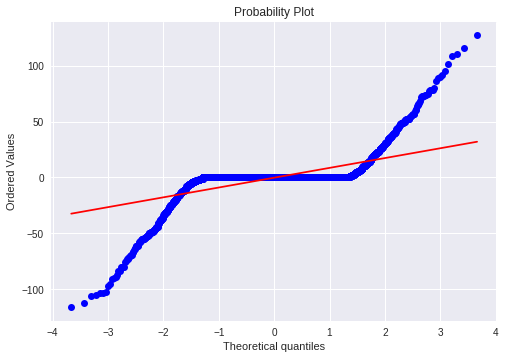

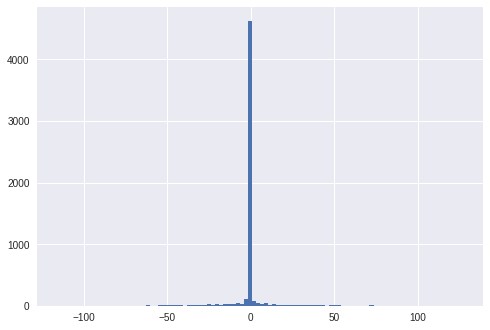

mean=-0.211 stdv=13.350
Statistics=0.432, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1602.597, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


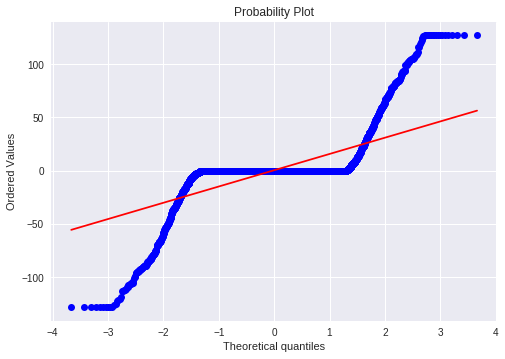

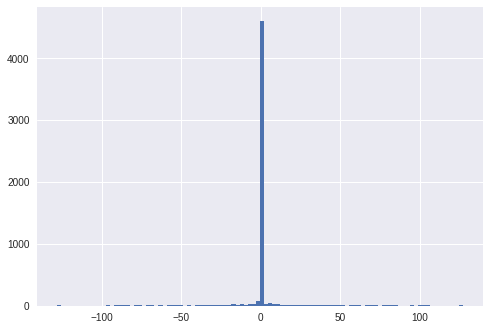

mean=0.509 stdv=22.321
Statistics=0.467, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1269.191, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


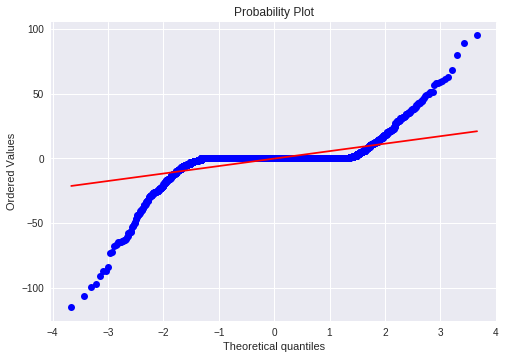

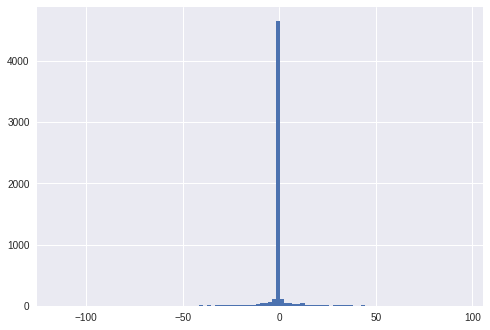

mean=-0.180 stdv=9.219
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3203.289, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


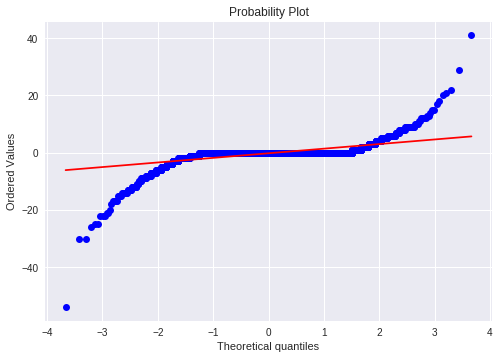

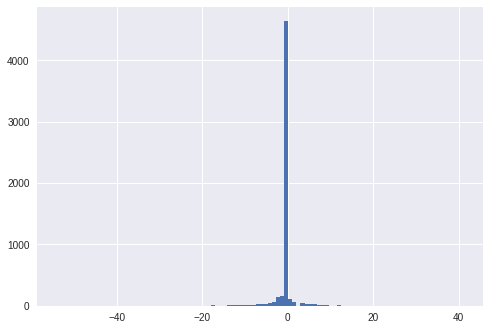

mean=-0.193 stdv=2.585
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4351.699, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.434, p=0.000
Sample does not look Gaussian (reject H0)


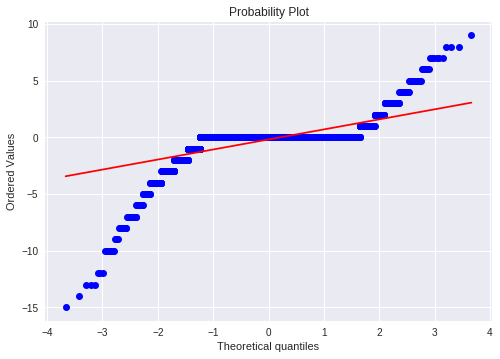

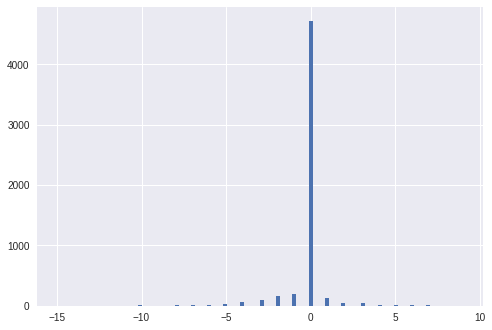

mean=-0.187 stdv=1.330
Statistics=0.445, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3949.714, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.450, p=0.000
Sample does not look Gaussian (reject H0)


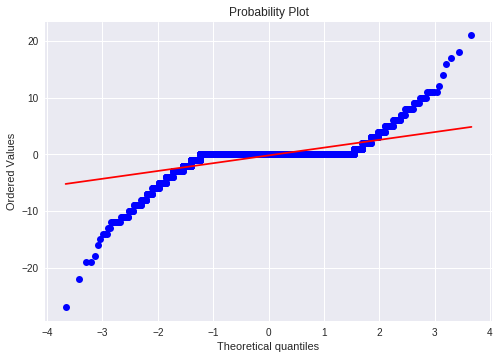

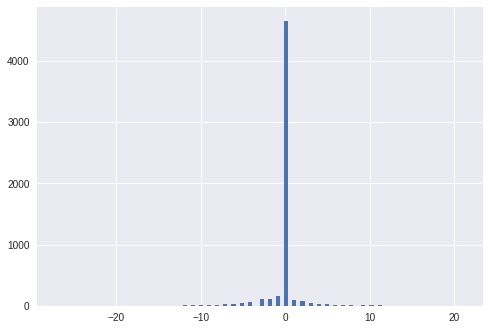

mean=-0.193 stdv=2.036
Statistics=0.456, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2846.747, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.439, p=0.000
Sample does not look Gaussian (reject H0)


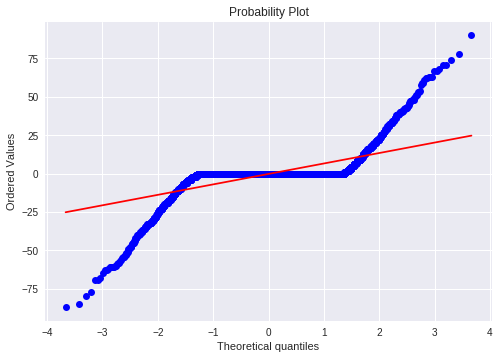

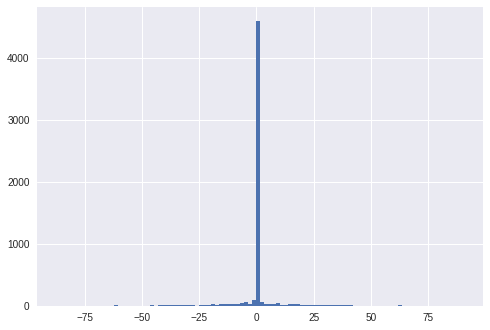

mean=-0.210 stdv=10.040
Statistics=0.460, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1463.846, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.415, p=0.000
Sample does not look Gaussian (reject H0)


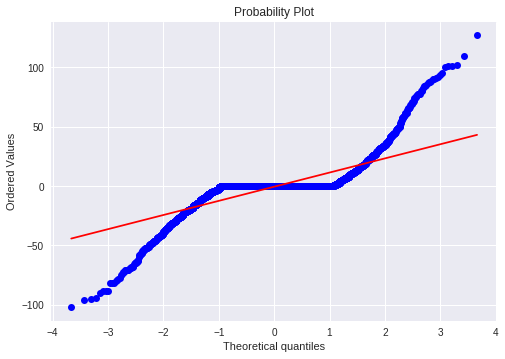

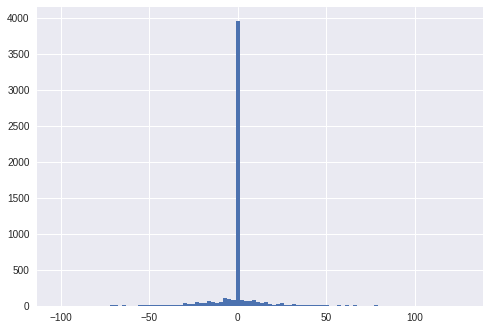

mean=-0.470 stdv=15.279
Statistics=0.609, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1283.554, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.359, p=0.000
Sample does not look Gaussian (reject H0)


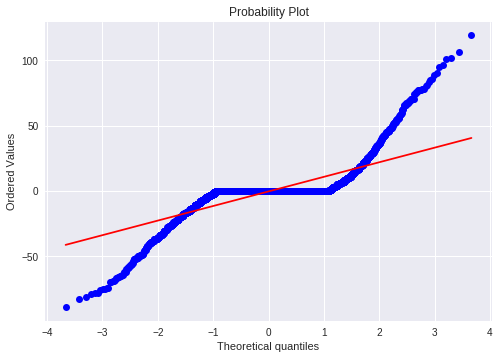

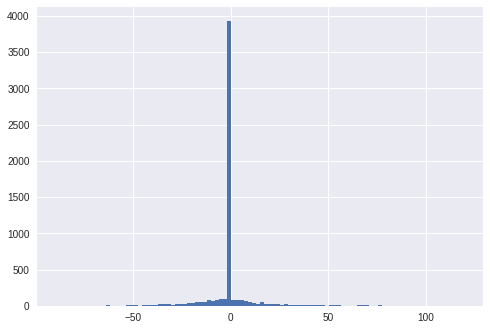

mean=-0.389 stdv=14.313
Statistics=0.608, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1486.003, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.364, p=0.000
Sample does not look Gaussian (reject H0)


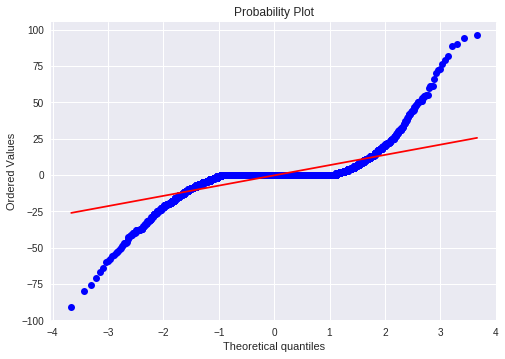

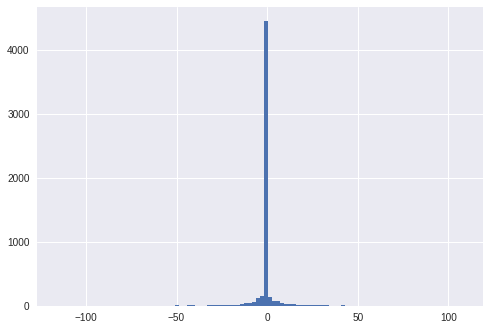

mean=-0.179 stdv=8.362
Statistics=0.428, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1797.339, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.401, p=0.000
Sample does not look Gaussian (reject H0)


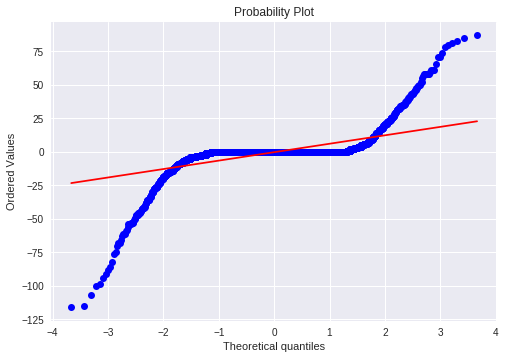

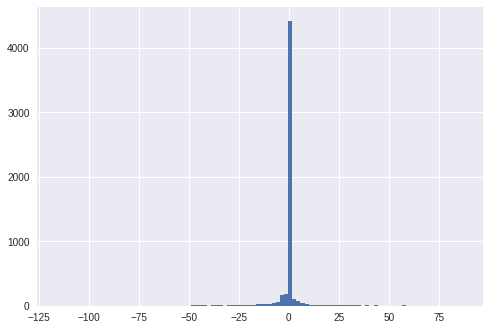

mean=-0.211 stdv=9.916
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2645.917, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.405, p=0.000
Sample does not look Gaussian (reject H0)


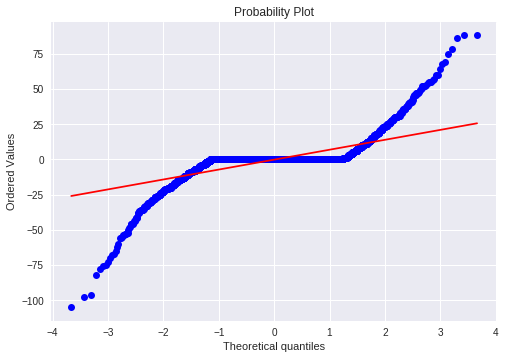

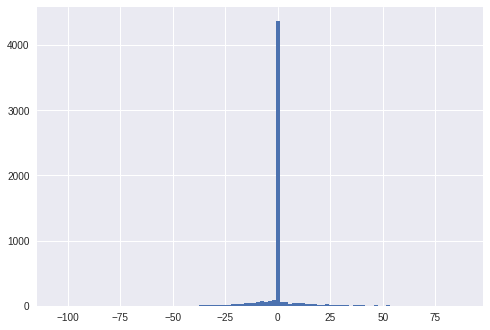

mean=-0.214 stdv=9.859
Statistics=0.511, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1564.756, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


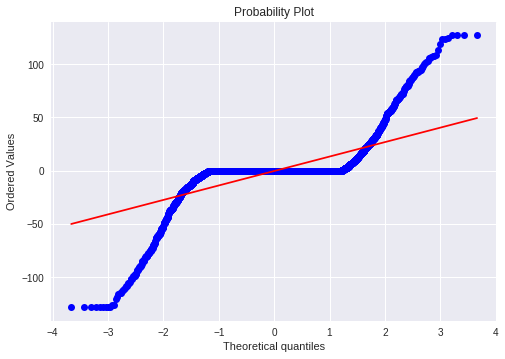

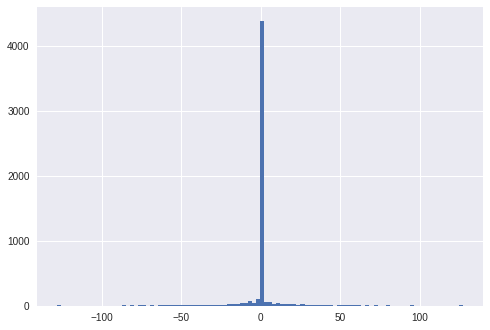

mean=-0.225 stdv=19.410
Statistics=0.488, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1457.637, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


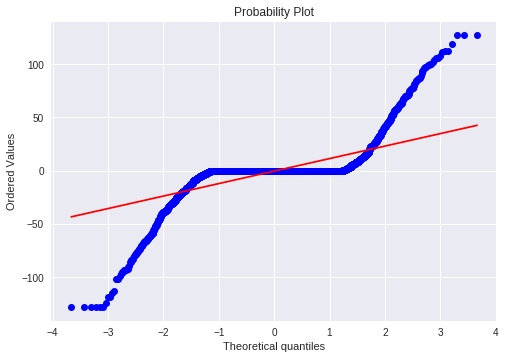

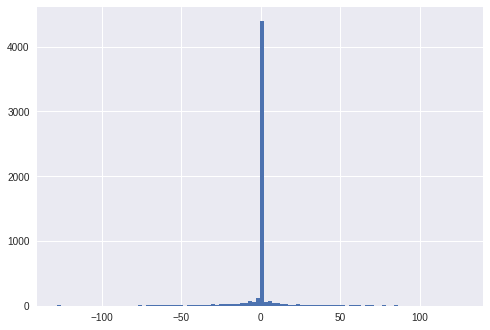

mean=-0.290 stdv=16.919
Statistics=0.480, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1374.397, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


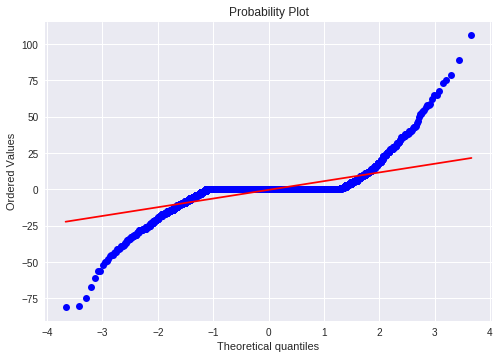

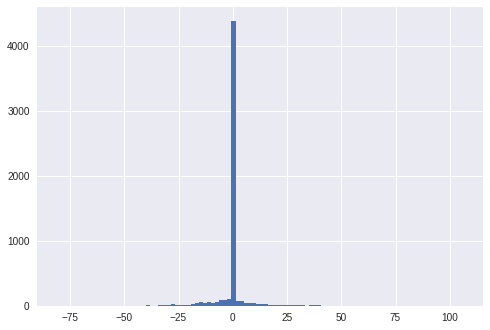

mean=-0.255 stdv=8.497
Statistics=0.497, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2137.067, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


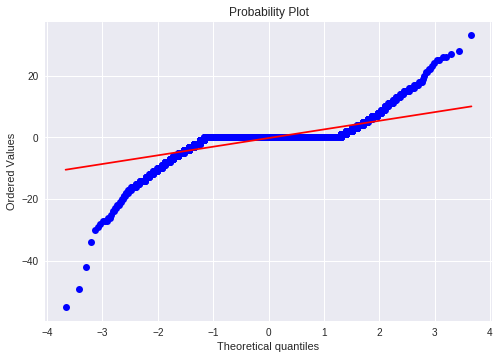

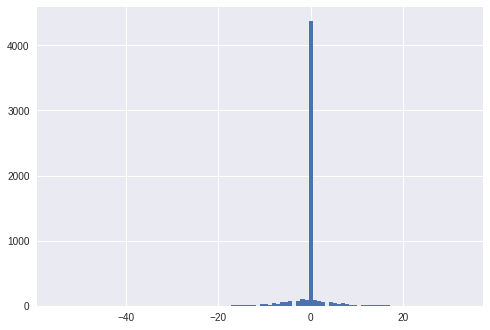

mean=-0.233 stdv=3.910
Statistics=0.513, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2806.402, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


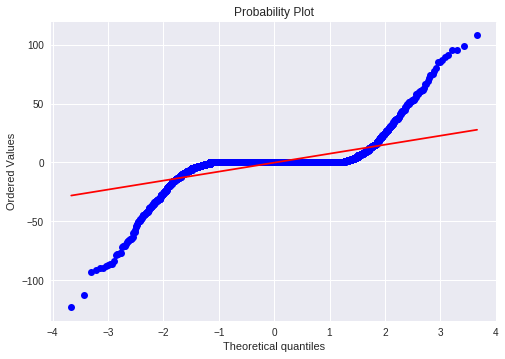

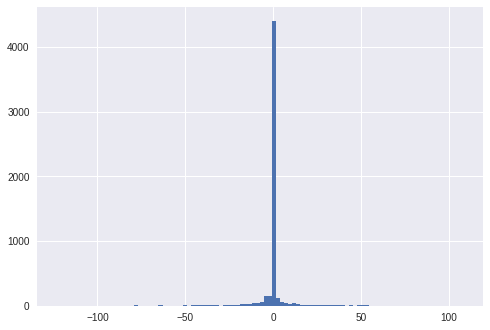

mean=-0.140 stdv=11.580
Statistics=0.435, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1648.532, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


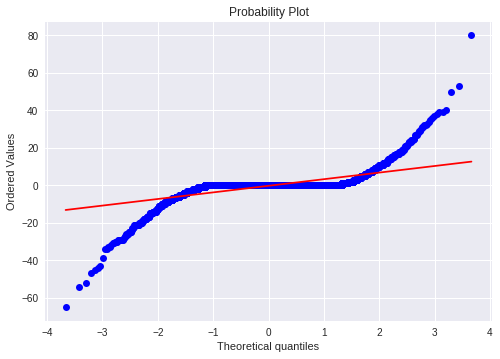

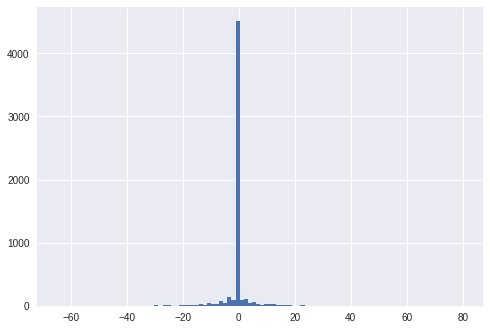

mean=-0.226 stdv=5.243
Statistics=0.452, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1765.737, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


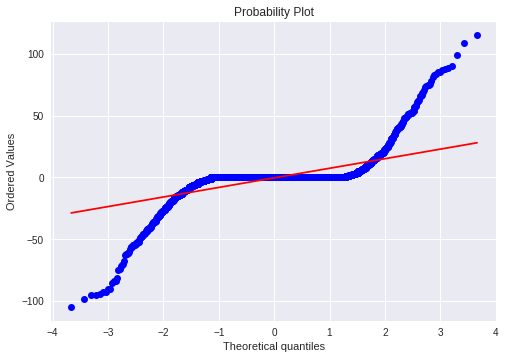

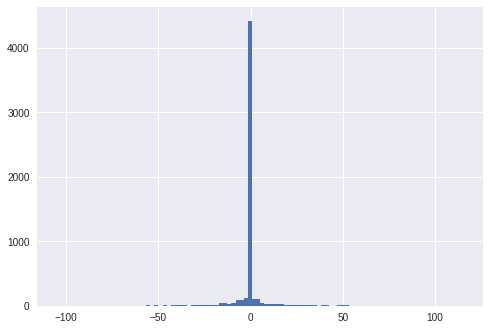

mean=-0.297 stdv=11.670
Statistics=0.441, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1551.249, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


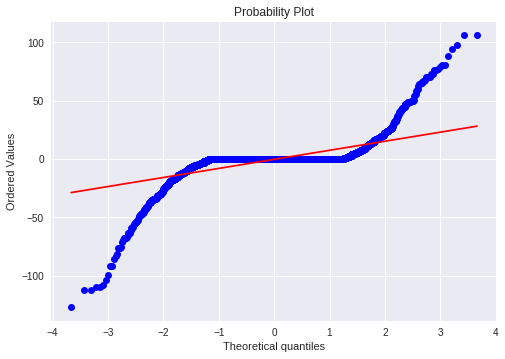

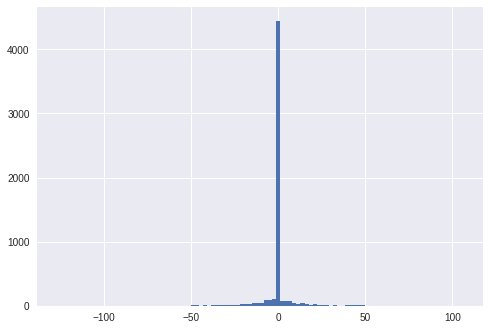

mean=-0.251 stdv=11.639
Statistics=0.446, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2021.762, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


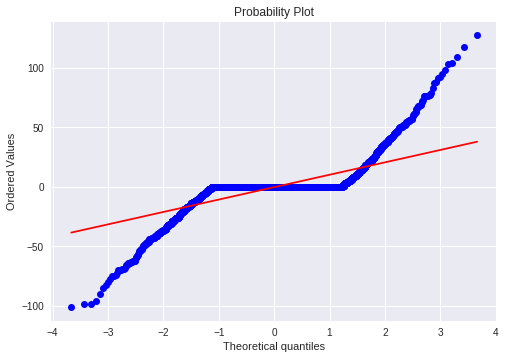

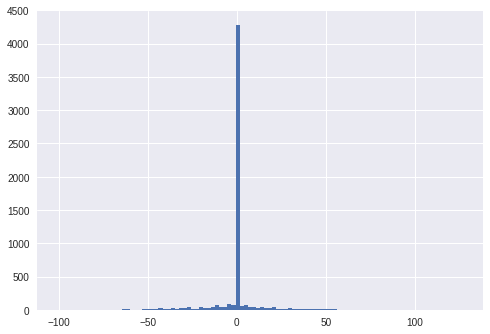

mean=-0.293 stdv=14.010
Statistics=0.551, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1394.413, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


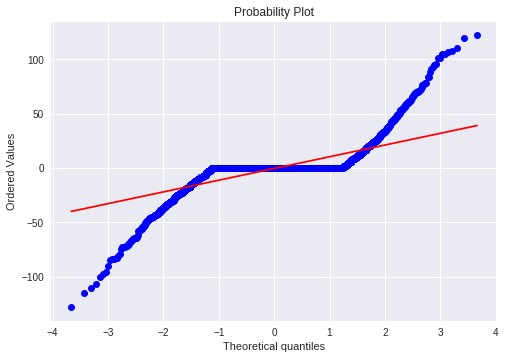

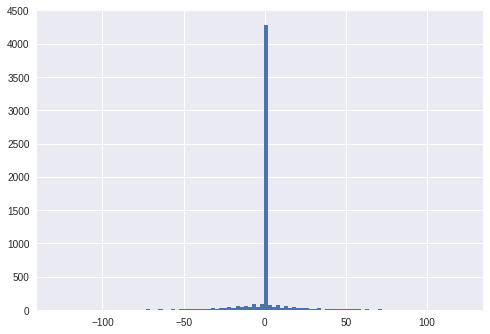

mean=-0.392 stdv=14.664
Statistics=0.541, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1362.731, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


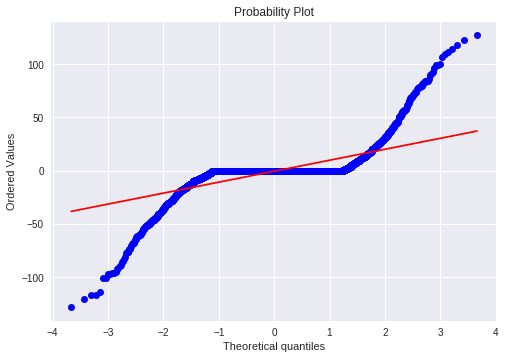

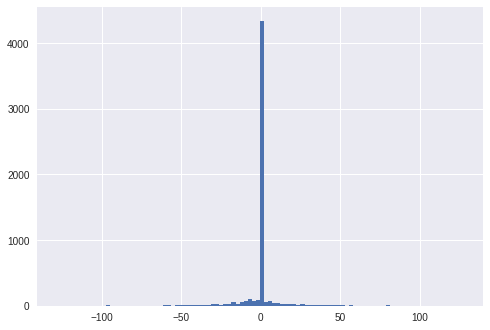

mean=-0.404 stdv=14.611
Statistics=0.496, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1437.098, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


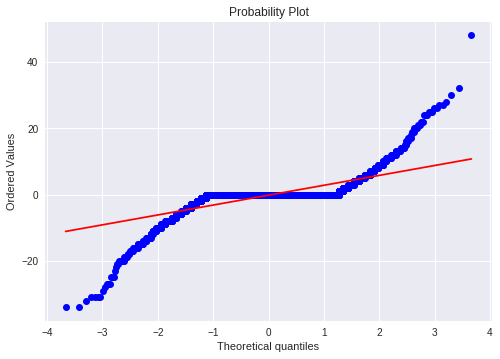

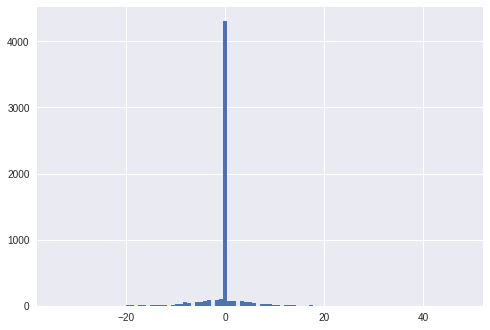

mean=-0.200 stdv=4.051
Statistics=0.543, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1479.076, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


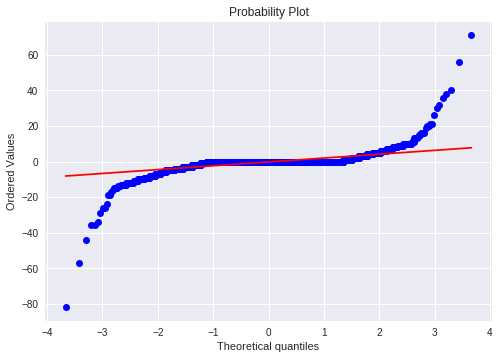

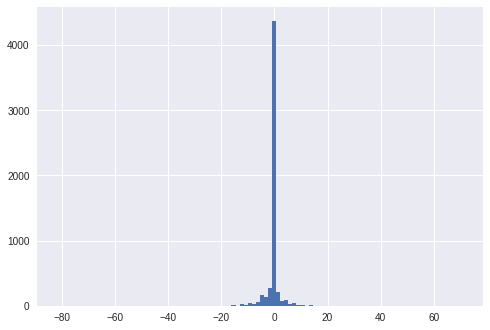

mean=-0.206 stdv=3.446
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3114.918, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)


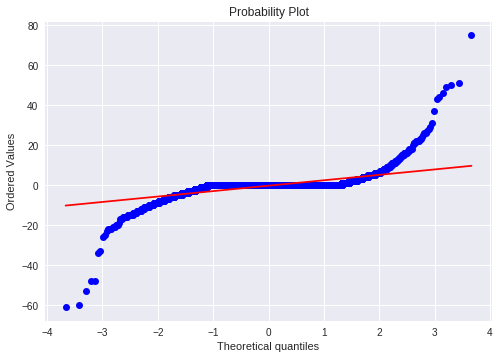

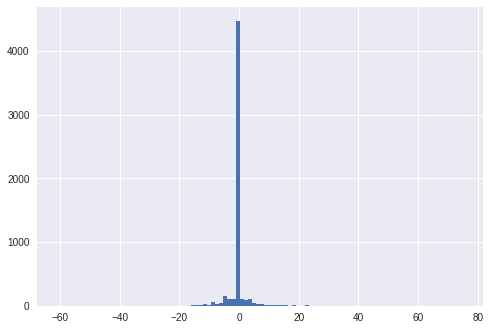

mean=-0.198 stdv=4.162
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2543.049, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


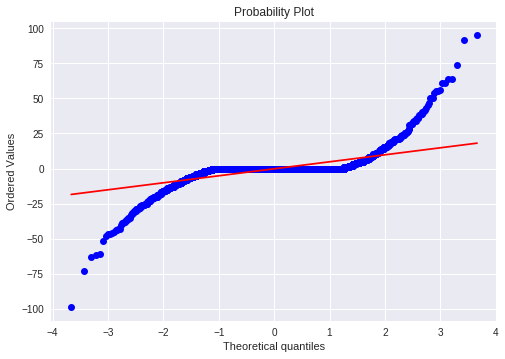

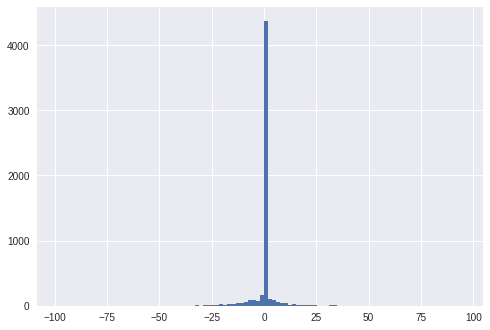

mean=-0.203 stdv=7.299
Statistics=0.469, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2013.712, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


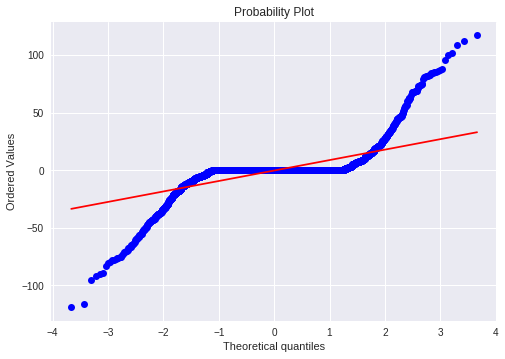

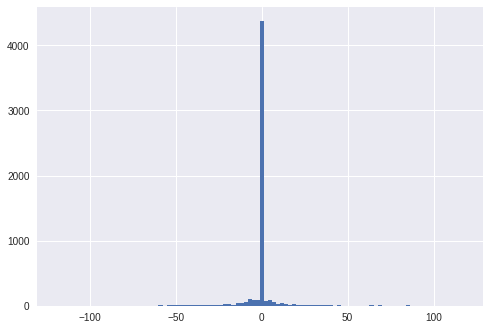

mean=-0.330 stdv=13.150
Statistics=0.477, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1510.592, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


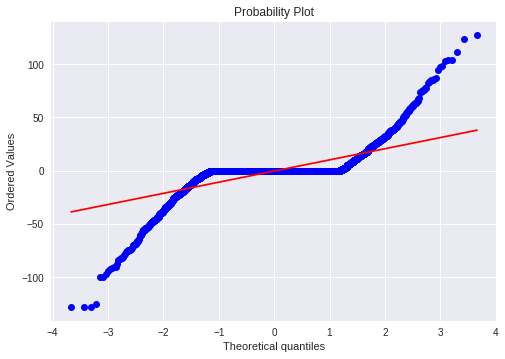

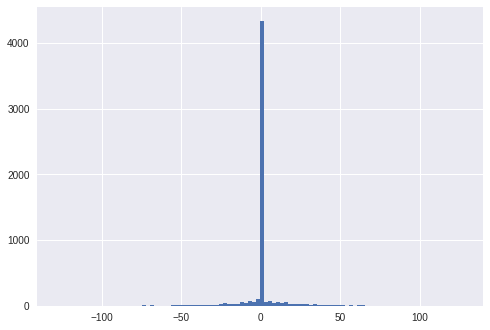

mean=-0.247 stdv=14.509
Statistics=0.520, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1508.482, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


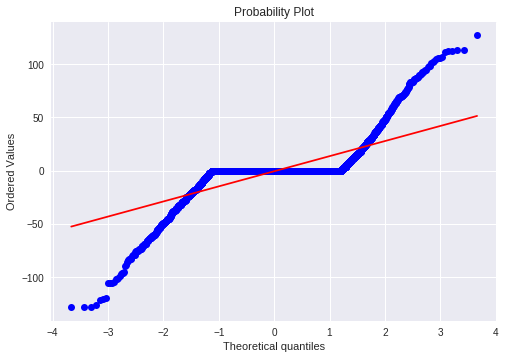

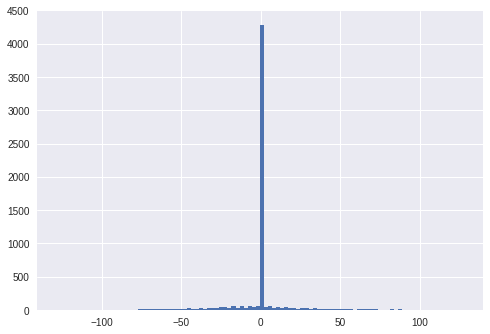

mean=-0.456 stdv=18.804
Statistics=0.567, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1110.610, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


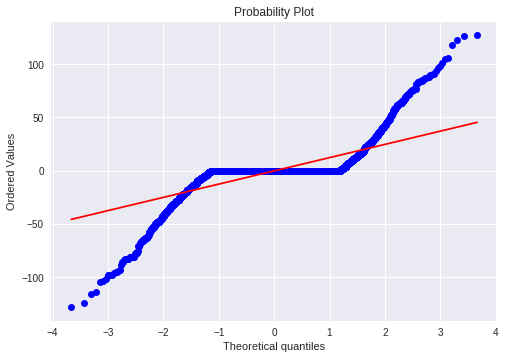

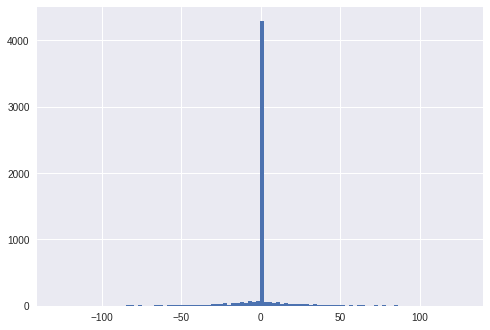

mean=-0.090 stdv=16.874
Statistics=0.542, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1217.886, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


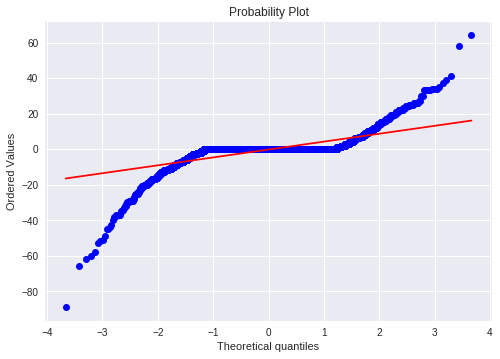

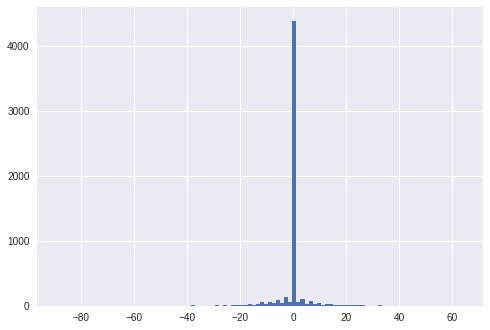

mean=-0.238 stdv=6.270
Statistics=0.504, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2895.026, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


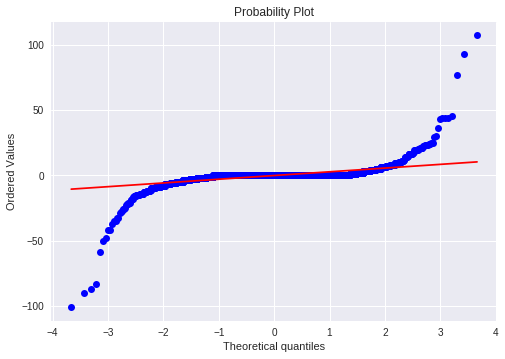

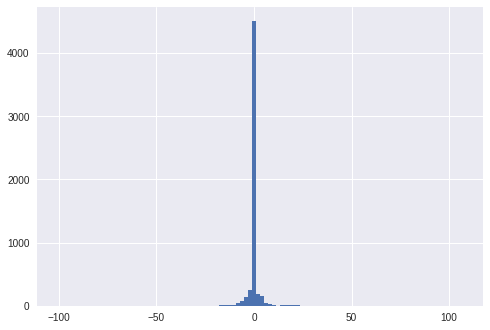

mean=-0.220 stdv=5.028
Statistics=0.322, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3105.611, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


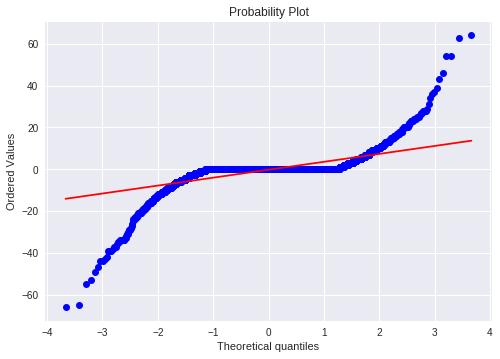

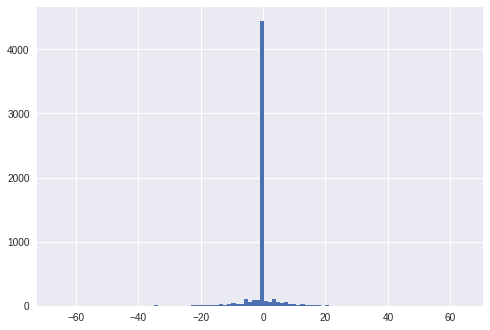

mean=-0.249 stdv=5.567
Statistics=0.465, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2503.445, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


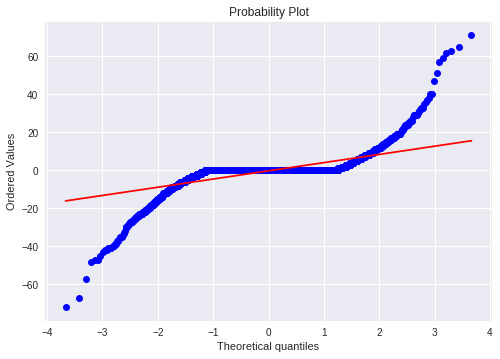

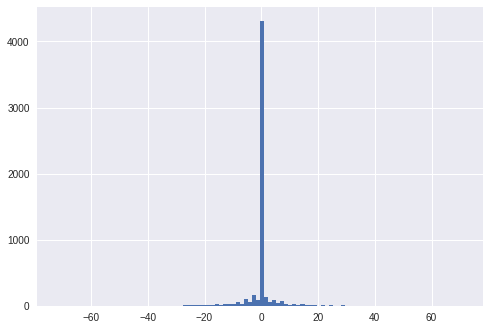

mean=-0.247 stdv=6.218
Statistics=0.484, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1707.131, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


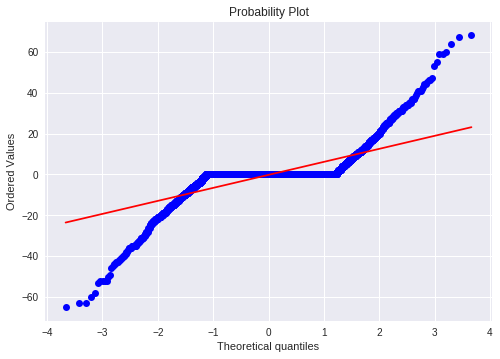

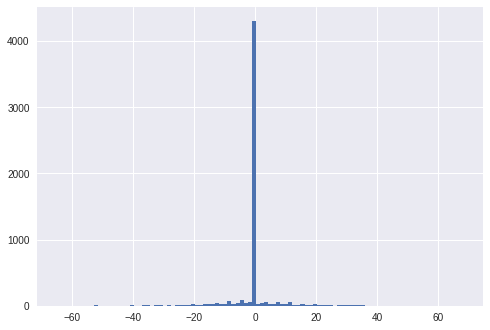

mean=-0.238 stdv=8.459
Statistics=0.567, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1224.596, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


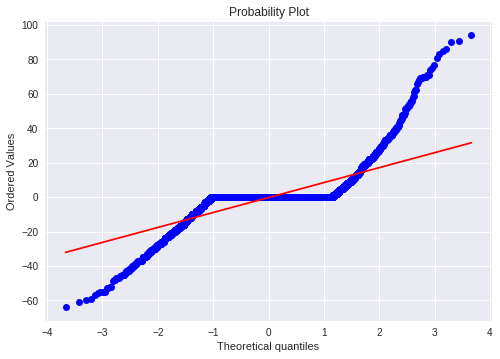

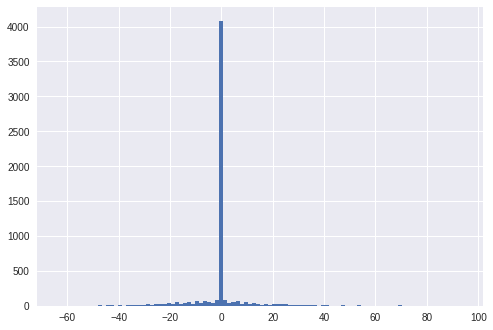

mean=-0.254 stdv=11.263
Statistics=0.596, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1923.915, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


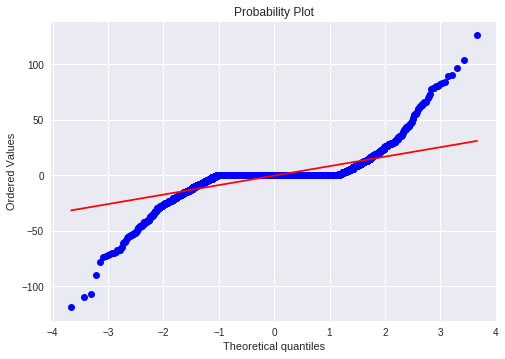

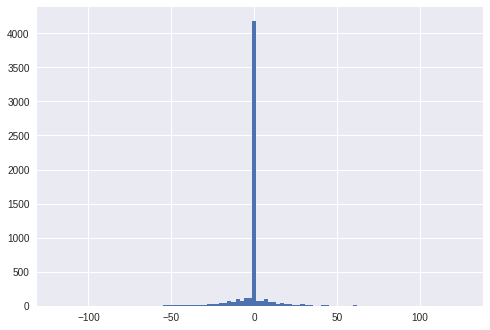

mean=-0.408 stdv=11.607
Statistics=0.542, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1483.673, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


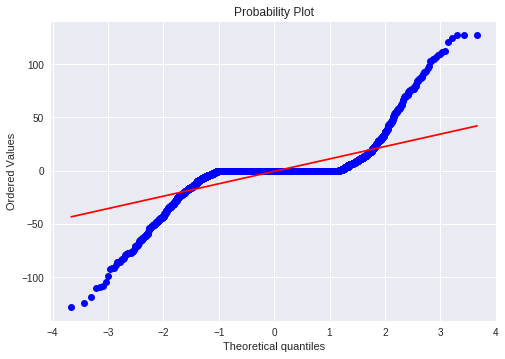

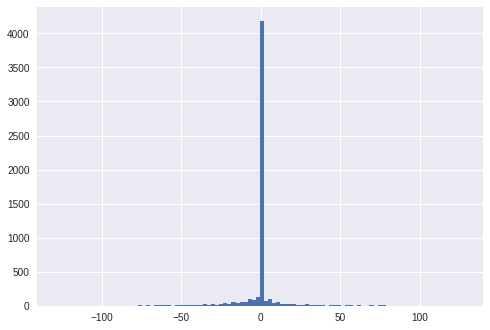

mean=-0.536 stdv=16.158
Statistics=0.519, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1497.308, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


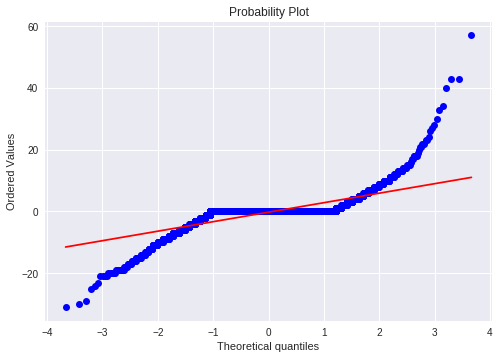

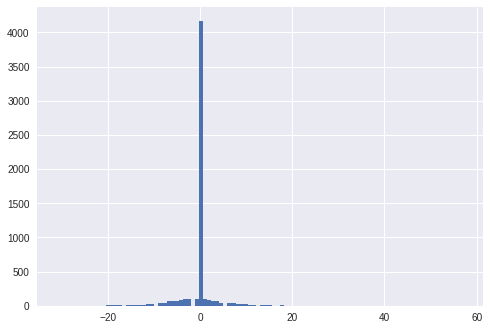

mean=-0.236 stdv=4.056
Statistics=0.576, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2000.681, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


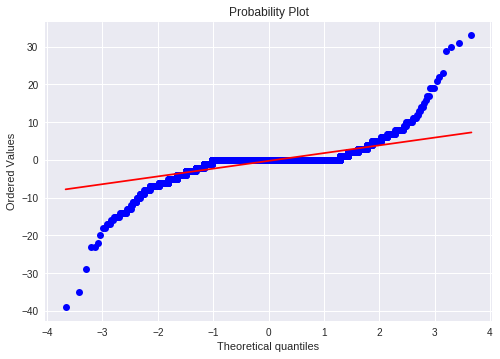

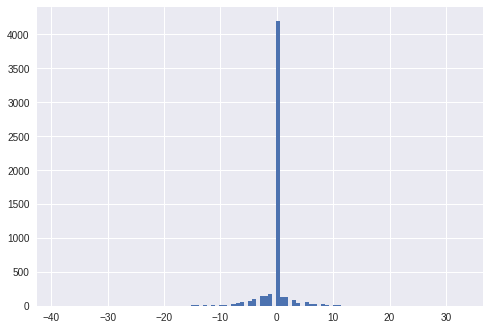

mean=-0.237 stdv=2.805
Statistics=0.539, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1927.250, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


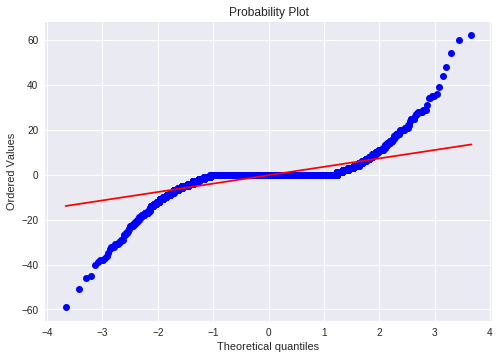

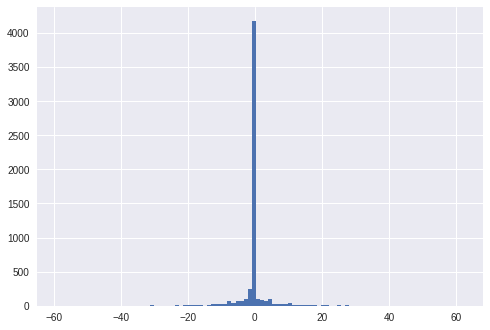

mean=-0.235 stdv=5.268
Statistics=0.505, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1599.194, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


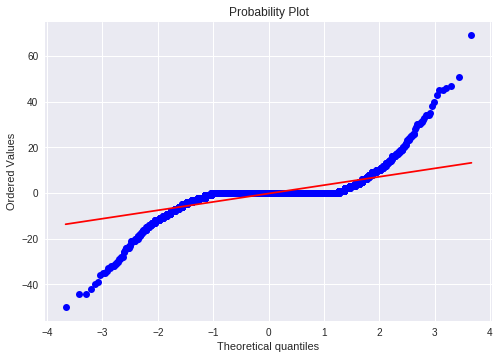

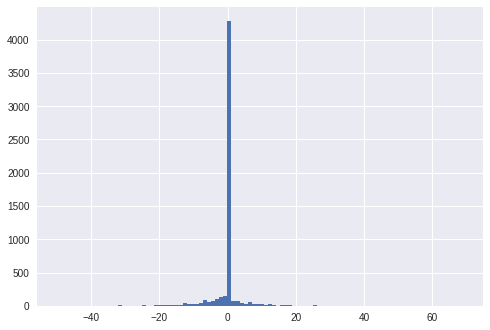

mean=-0.230 stdv=5.185
Statistics=0.502, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1816.068, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


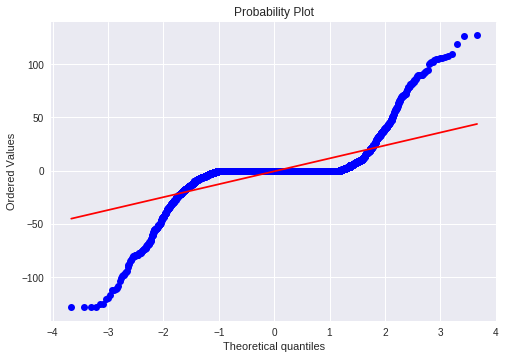

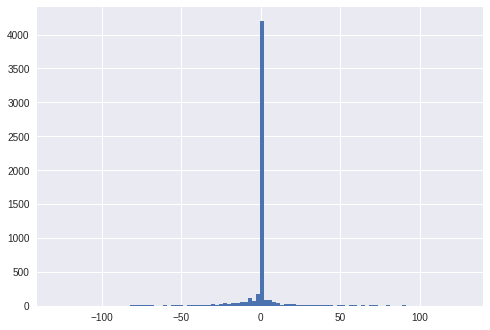

mean=-0.503 stdv=17.261
Statistics=0.493, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1386.422, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


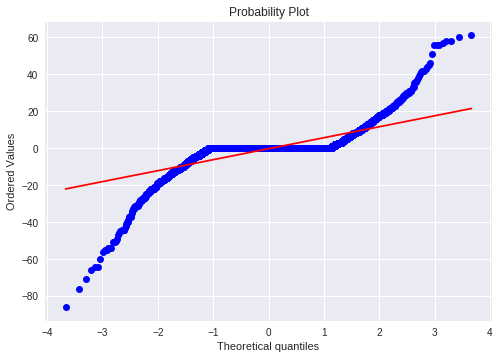

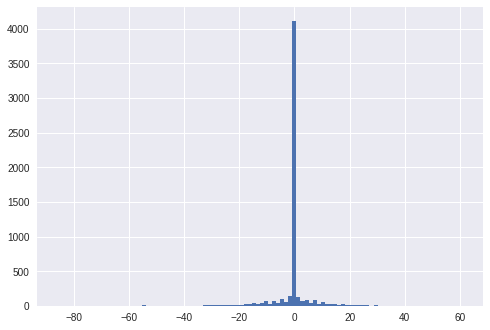

mean=-0.280 stdv=7.982
Statistics=0.553, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2099.702, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


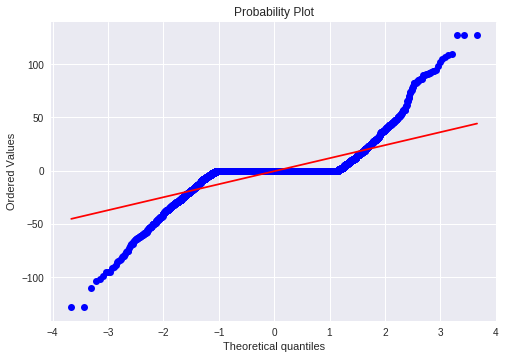

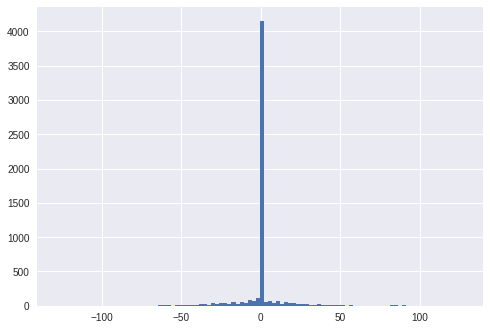

mean=-0.405 stdv=16.131
Statistics=0.572, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1304.746, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


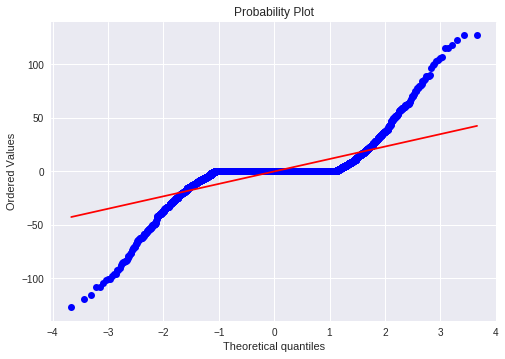

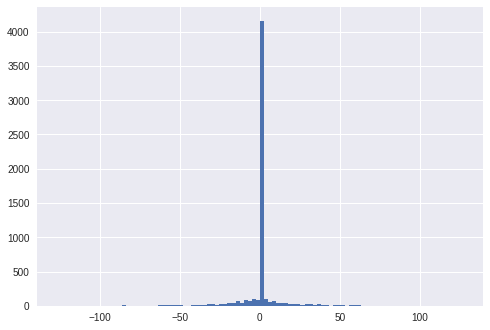

mean=-0.126 stdv=15.764
Statistics=0.544, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1343.831, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.372, p=0.000
Sample does not look Gaussian (reject H0)


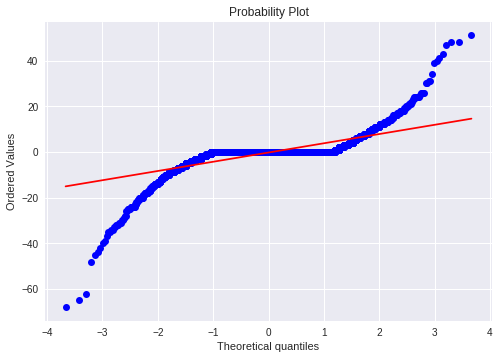

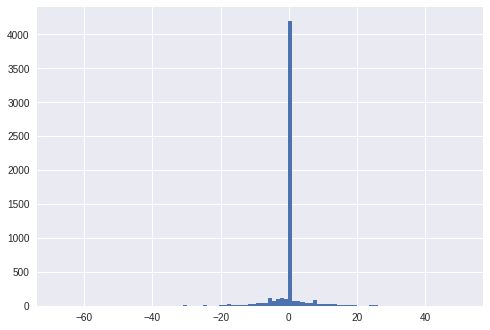

mean=-0.271 stdv=5.515
Statistics=0.539, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2411.919, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


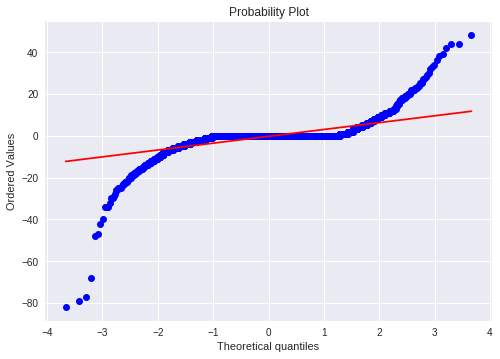

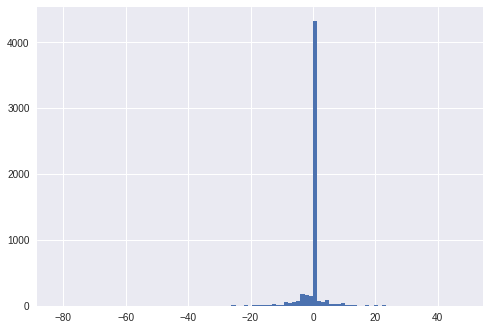

mean=-0.271 stdv=4.872
Statistics=0.453, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4223.799, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


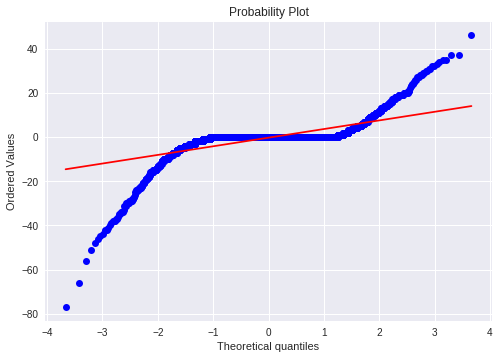

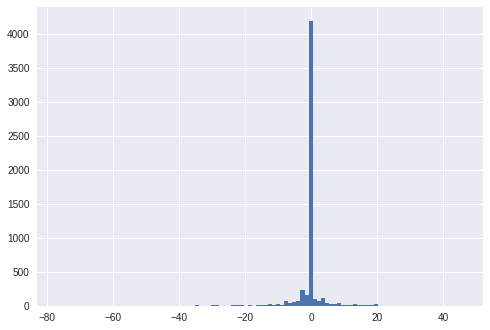

mean=-0.273 stdv=5.602
Statistics=0.486, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3303.517, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


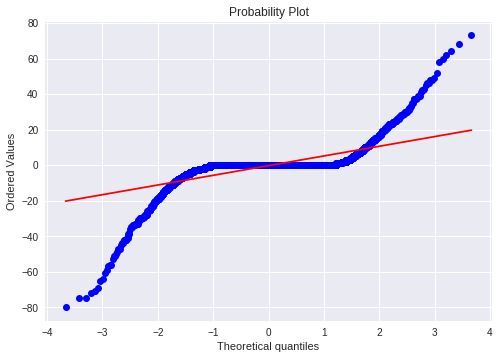

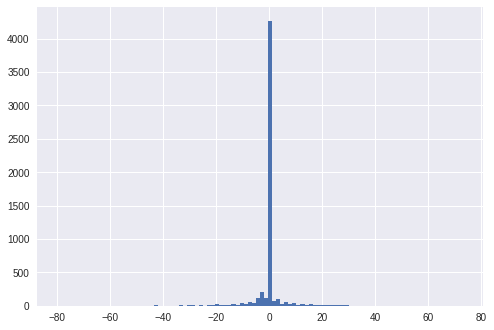

mean=-0.309 stdv=7.859
Statistics=0.482, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2300.505, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


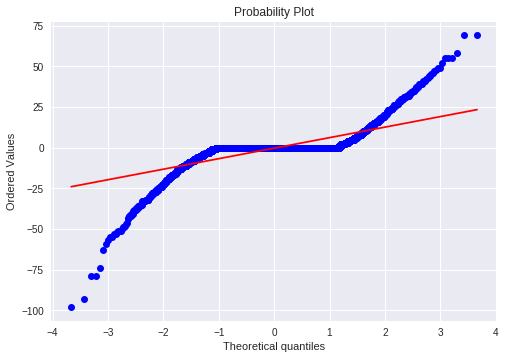

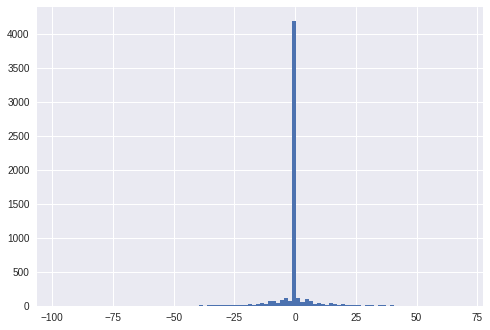

mean=-0.279 stdv=8.701
Statistics=0.552, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1990.244, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


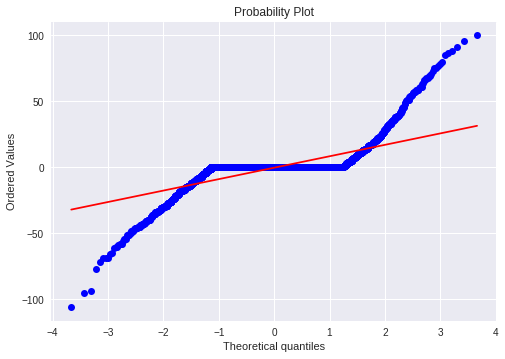

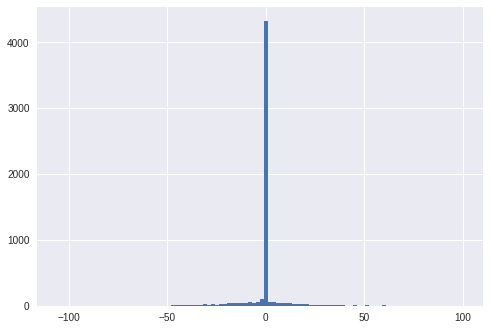

mean=-0.268 stdv=11.789
Statistics=0.540, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1489.445, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


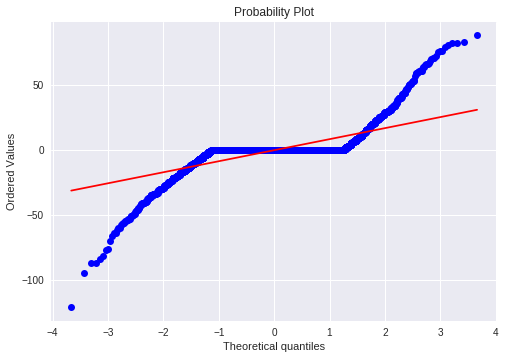

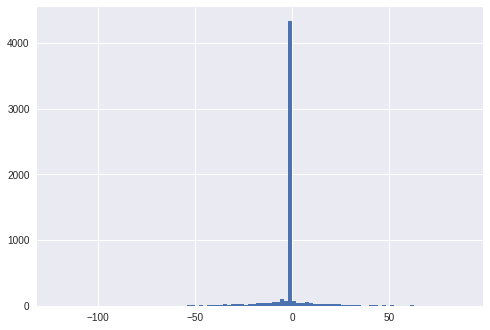

mean=-0.265 stdv=11.568
Statistics=0.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1328.708, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


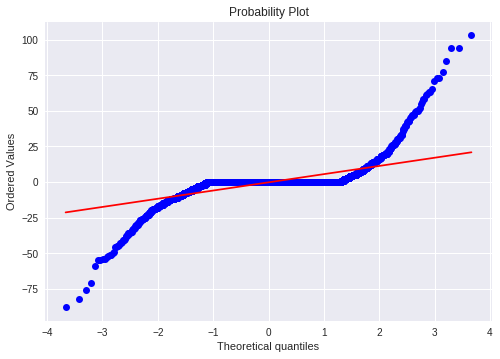

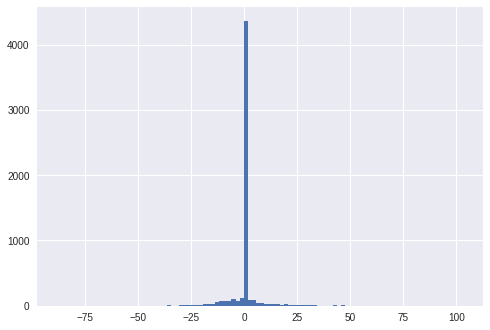

mean=-0.250 stdv=8.438
Statistics=0.467, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2533.975, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


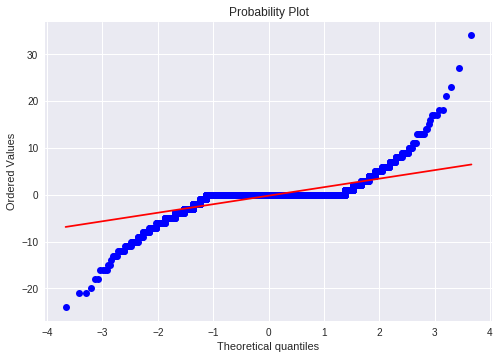

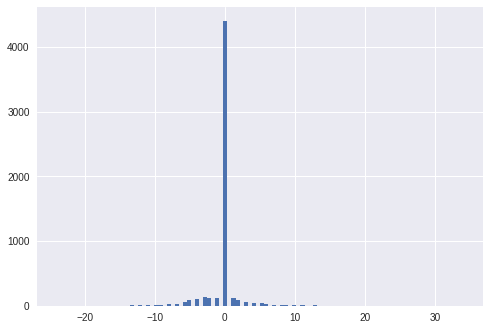

mean=-0.204 stdv=2.495
Statistics=0.532, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1546.915, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


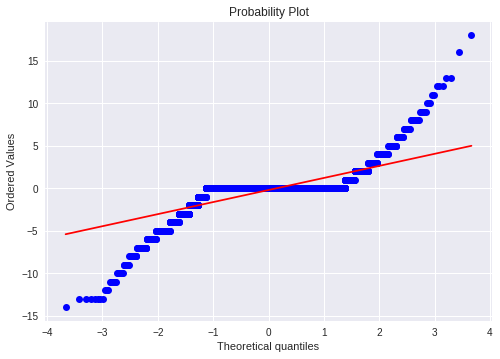

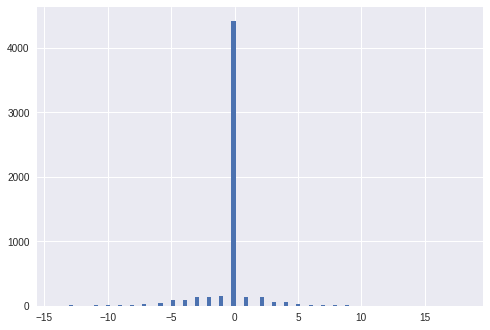

mean=-0.202 stdv=1.898
Statistics=0.561, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1603.272, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


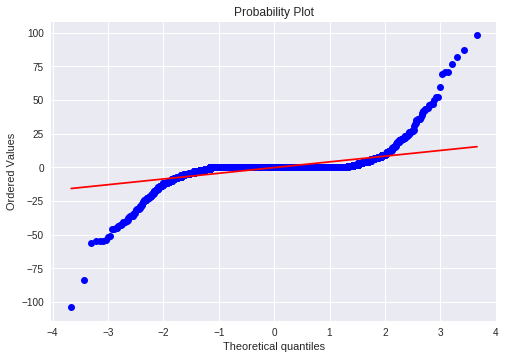

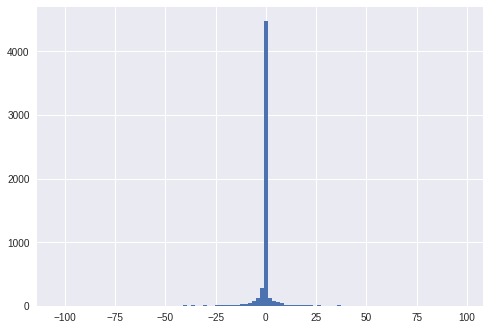

mean=-0.224 stdv=6.843
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2172.006, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


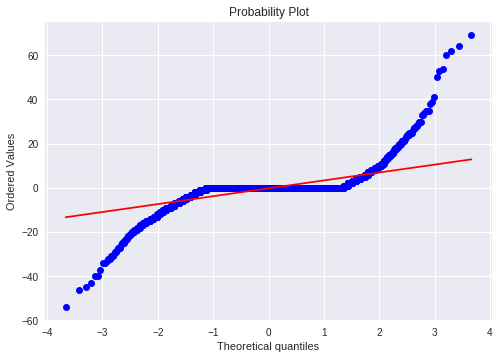

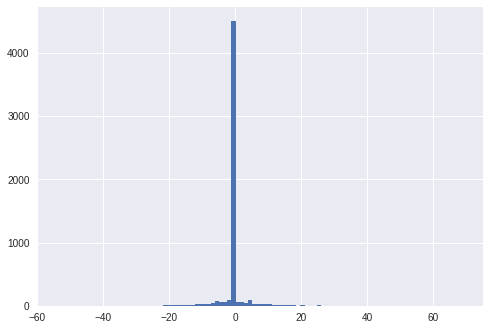

mean=-0.193 stdv=5.269
Statistics=0.461, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2710.375, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)


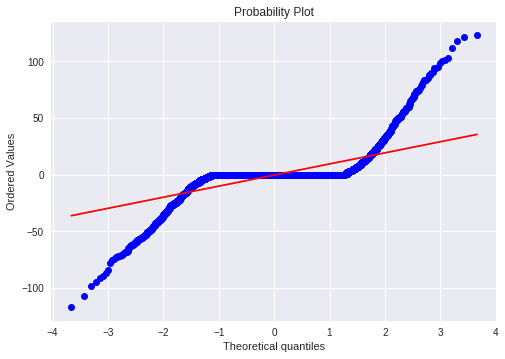

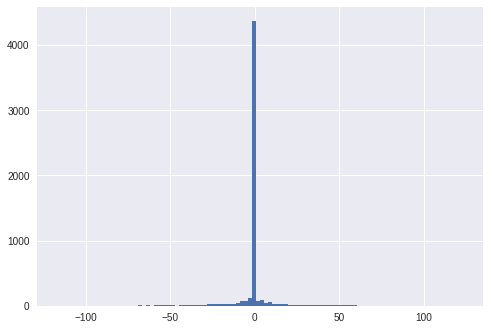

mean=-0.292 stdv=13.992
Statistics=0.490, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1682.970, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


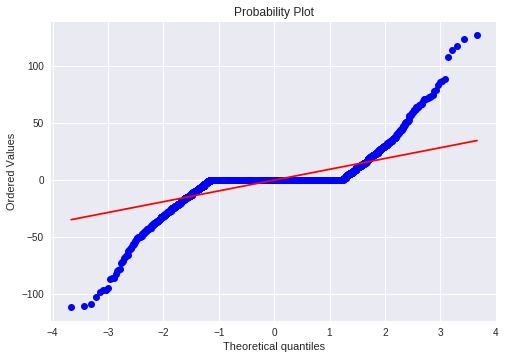

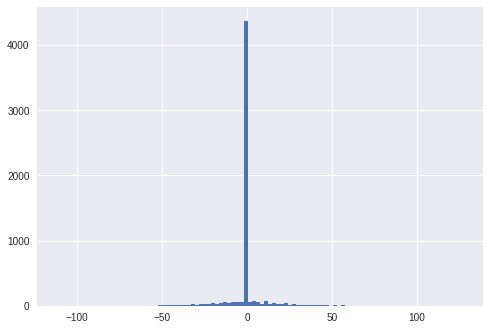

mean=-0.229 stdv=13.121
Statistics=0.524, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1426.312, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


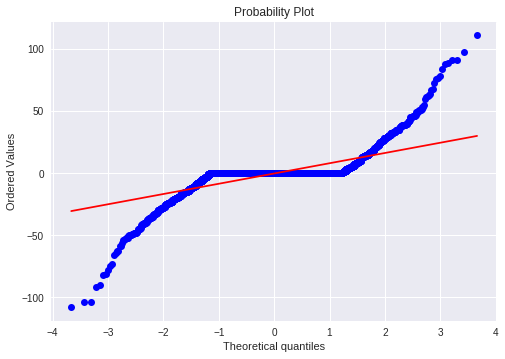

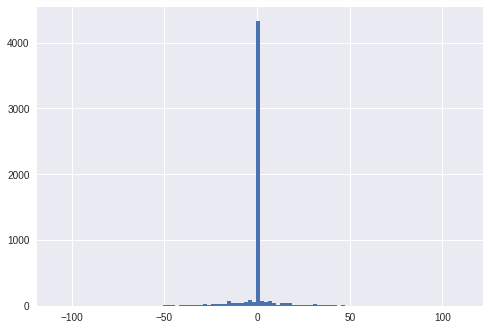

mean=-0.262 stdv=11.311
Statistics=0.534, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1402.259, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


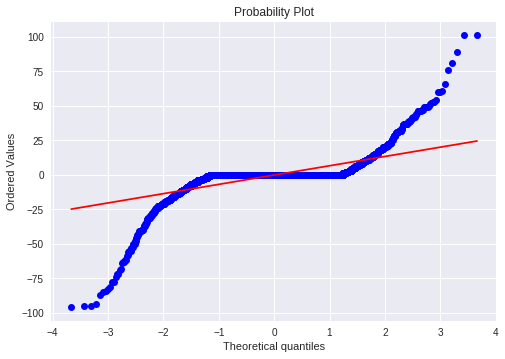

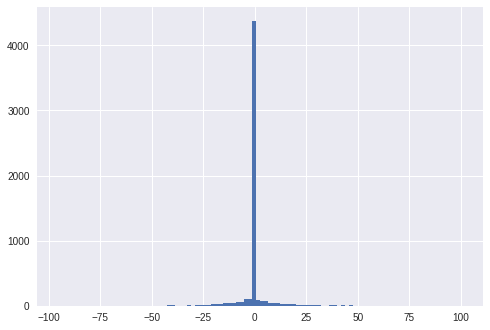

mean=-0.216 stdv=9.808
Statistics=0.472, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2229.606, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


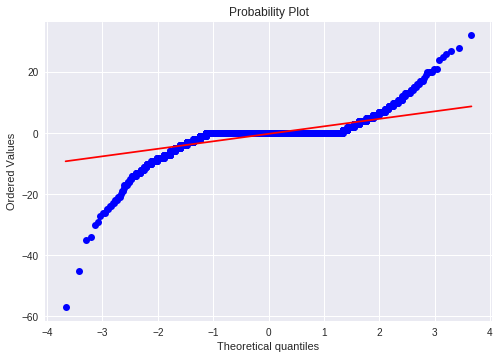

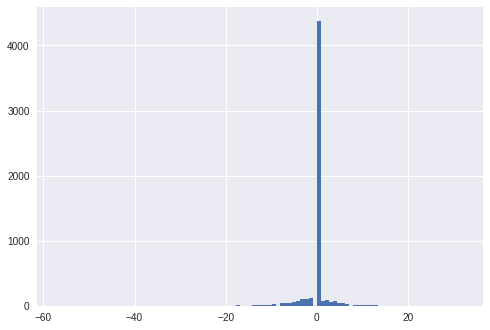

mean=-0.231 stdv=3.475
Statistics=0.500, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3384.312, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


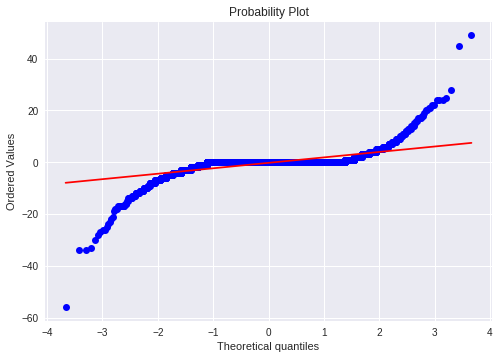

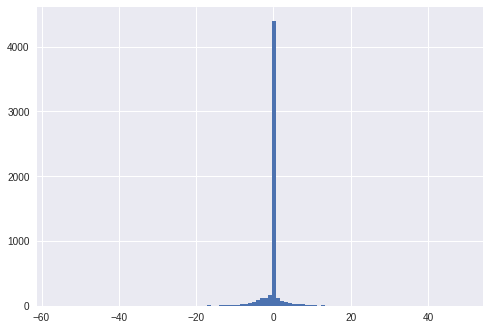

mean=-0.228 stdv=3.179
Statistics=0.439, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2516.789, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


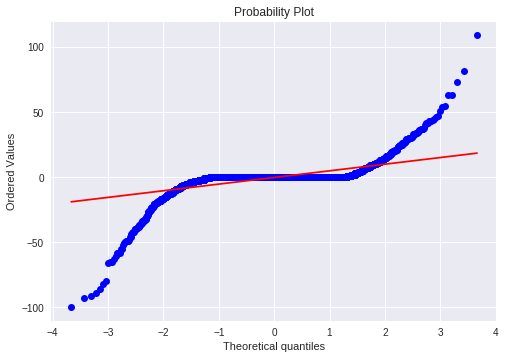

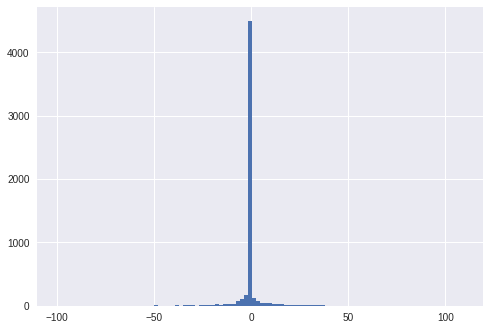

mean=-0.234 stdv=7.986
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3126.964, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


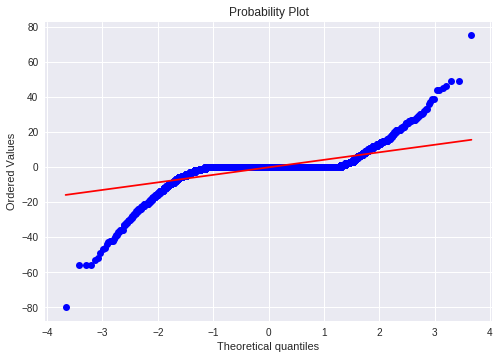

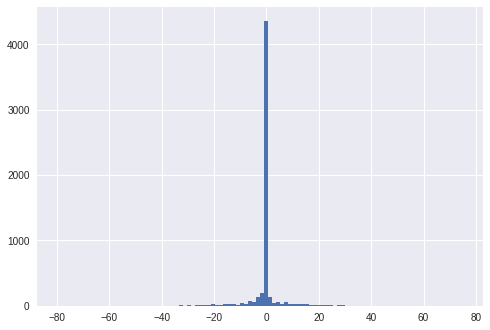

mean=-0.239 stdv=6.219
Statistics=0.477, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2312.266, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


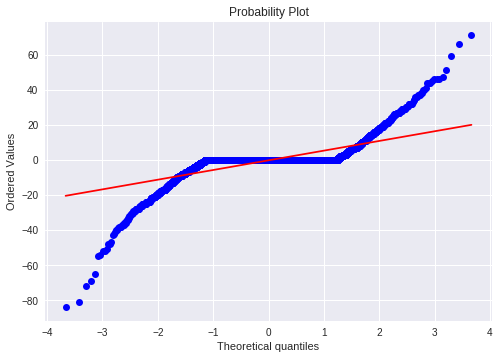

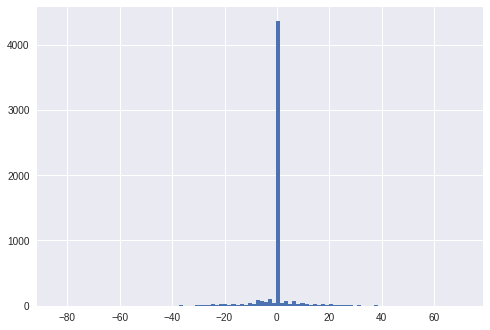

mean=-0.232 stdv=7.603
Statistics=0.528, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1797.460, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


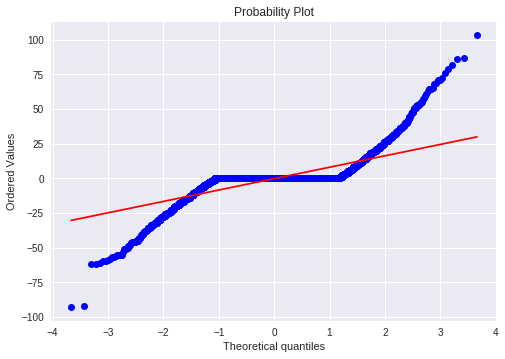

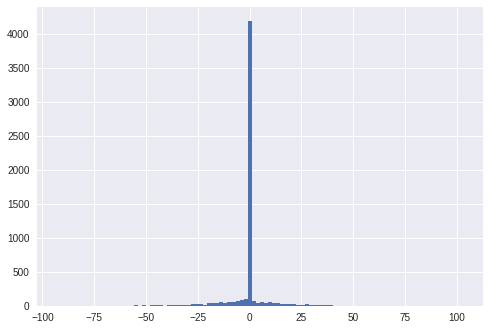

mean=-0.268 stdv=10.848
Statistics=0.574, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1400.007, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


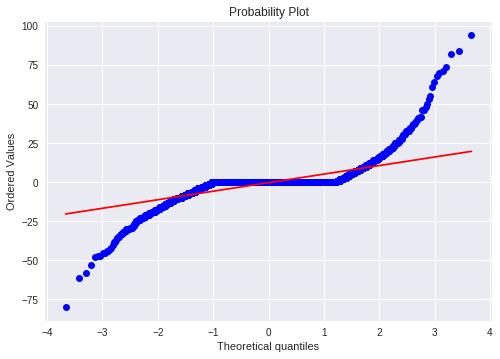

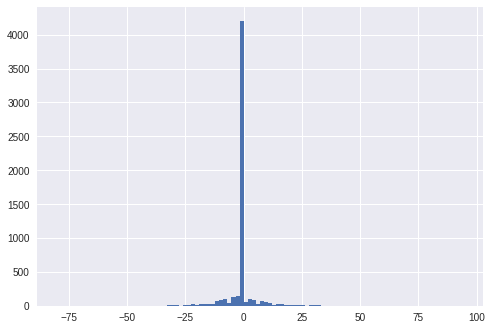

mean=-0.263 stdv=7.495
Statistics=0.534, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2593.086, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


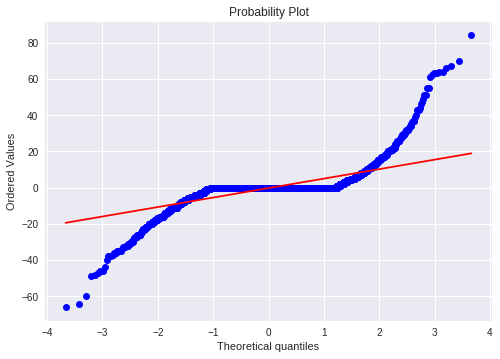

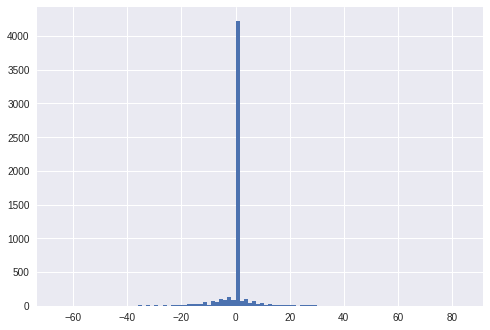

mean=-0.258 stdv=7.269
Statistics=0.519, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2280.990, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


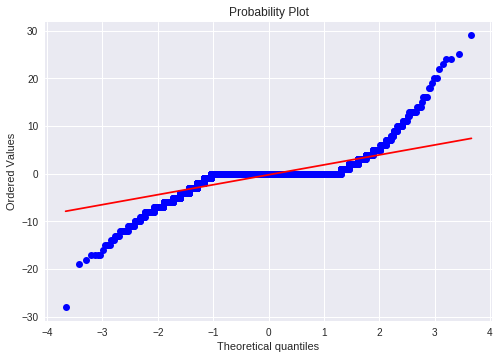

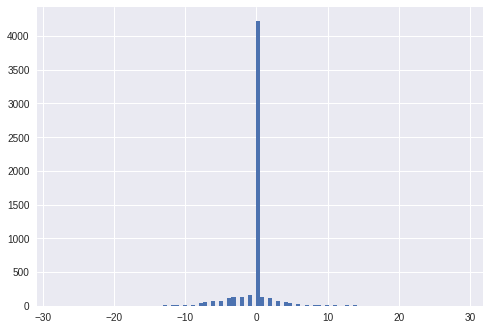

mean=-0.233 stdv=2.754
Statistics=0.574, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1524.569, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


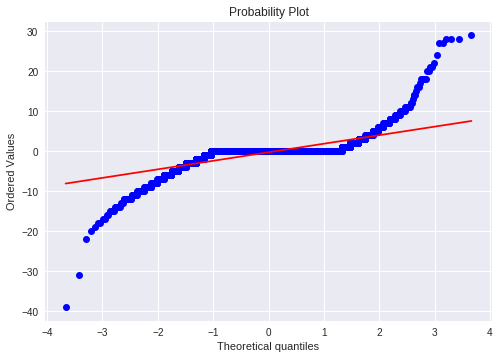

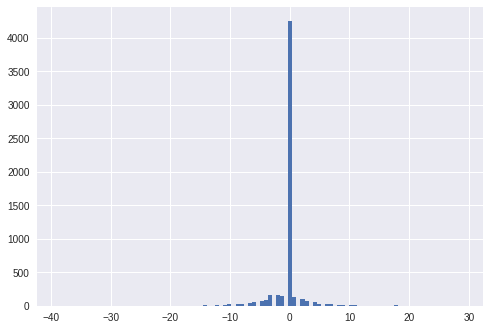

mean=-0.233 stdv=2.910
Statistics=0.540, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1626.358, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


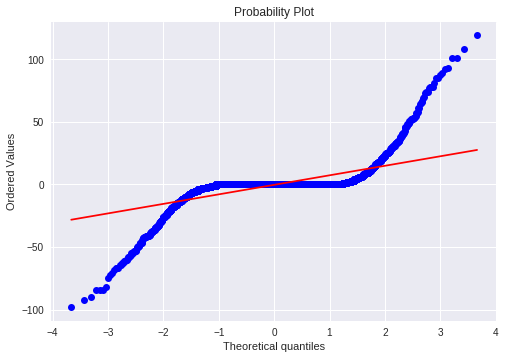

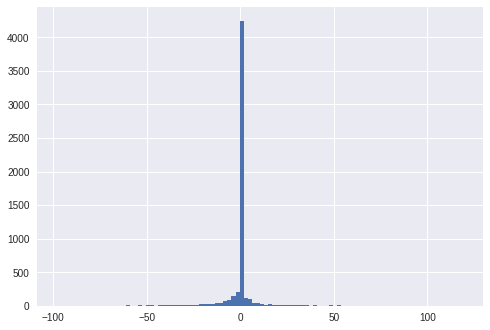

mean=-0.296 stdv=11.242
Statistics=0.458, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1809.584, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


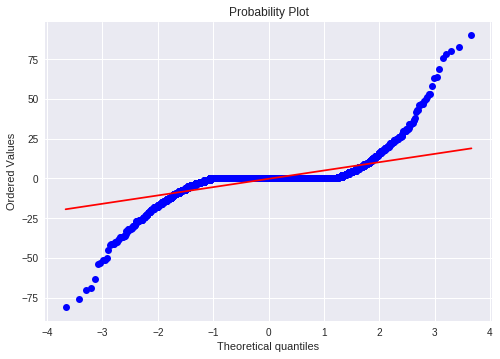

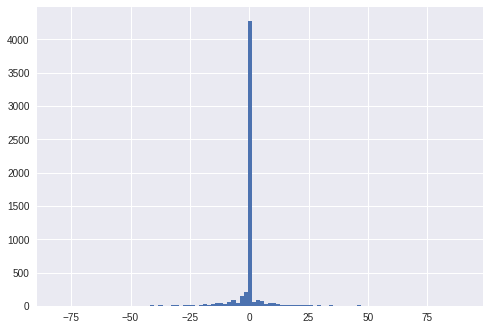

mean=-0.224 stdv=7.544
Statistics=0.481, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2037.698, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


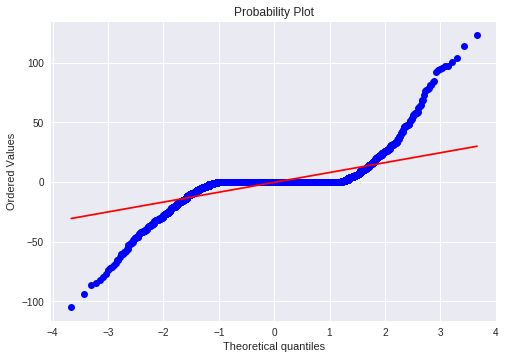

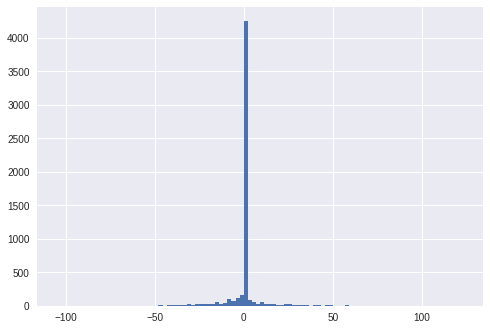

mean=-0.275 stdv=11.684
Statistics=0.501, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2148.227, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


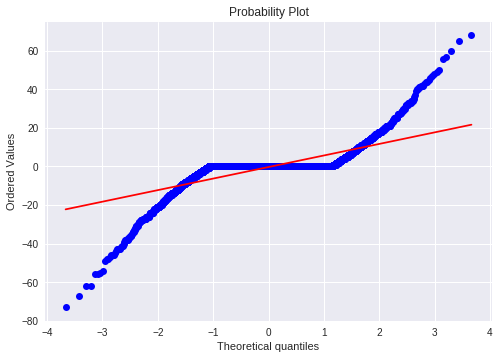

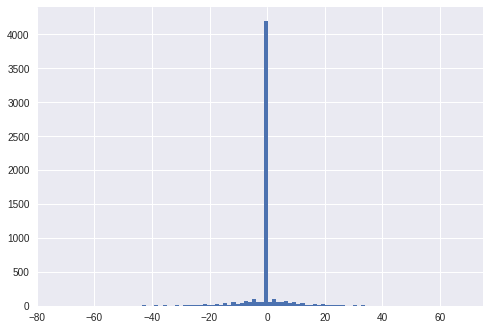

mean=-0.279 stdv=7.965
Statistics=0.566, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1502.122, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


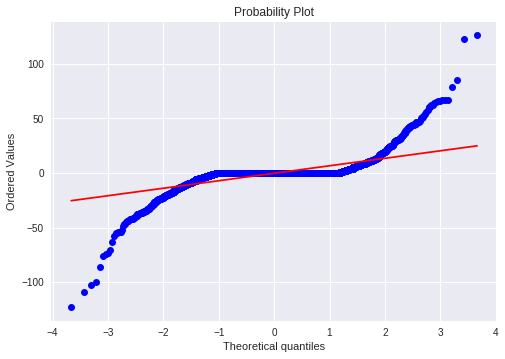

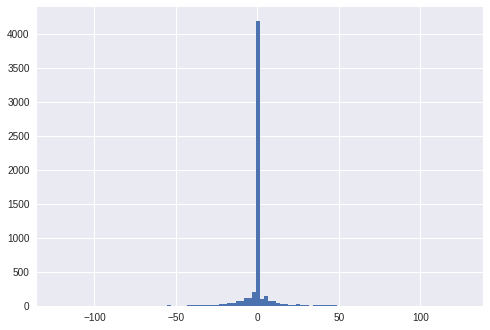

mean=-0.284 stdv=9.769
Statistics=0.493, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1696.899, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


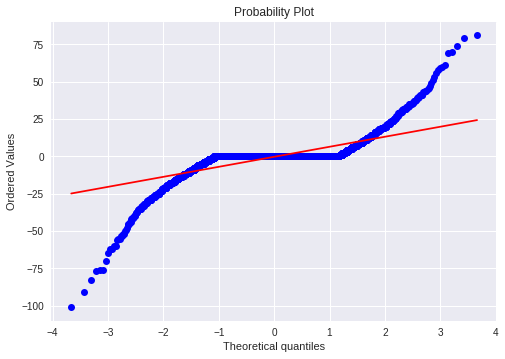

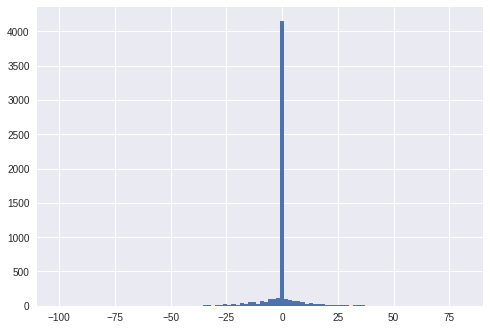

mean=-0.277 stdv=9.076
Statistics=0.547, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1793.416, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


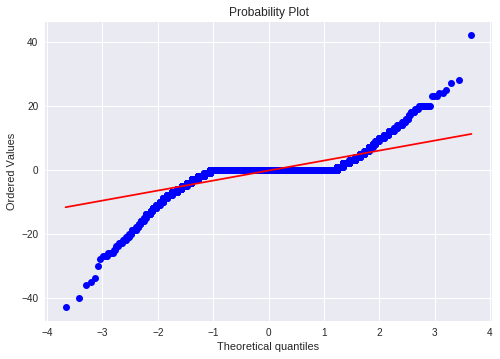

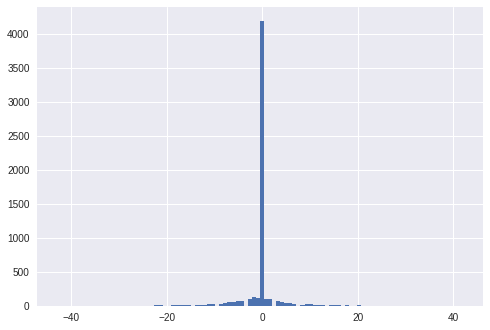

mean=-0.271 stdv=4.200
Statistics=0.555, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2100.666, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


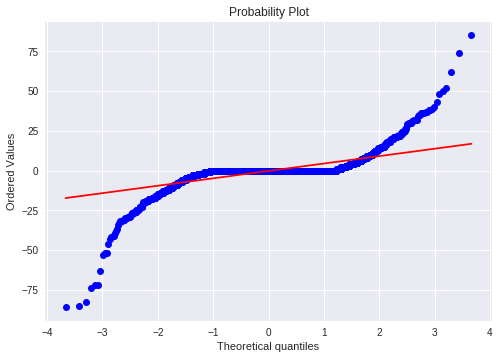

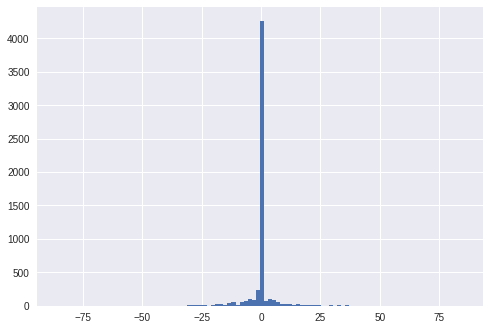

mean=-0.263 stdv=6.738
Statistics=0.479, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2609.616, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


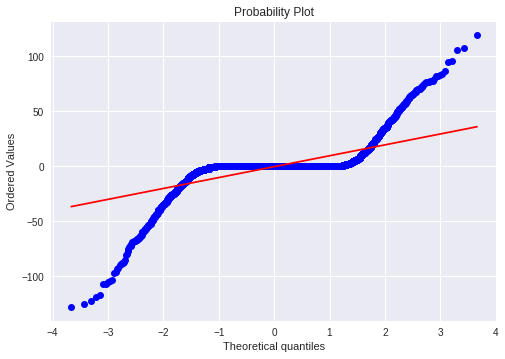

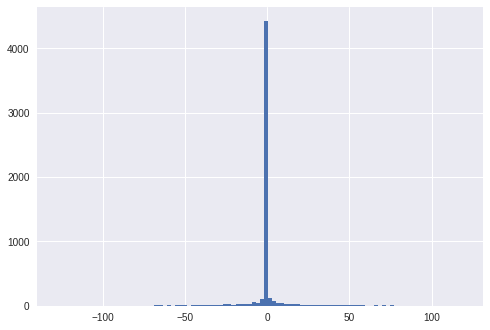

mean=-0.277 stdv=14.385
Statistics=0.474, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1692.890, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


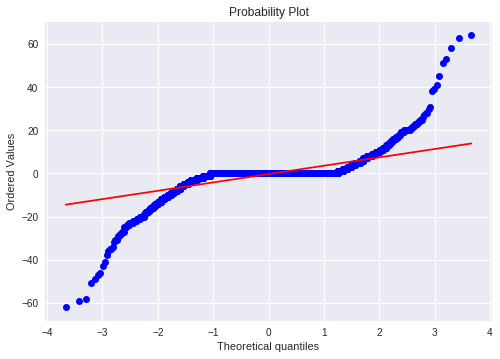

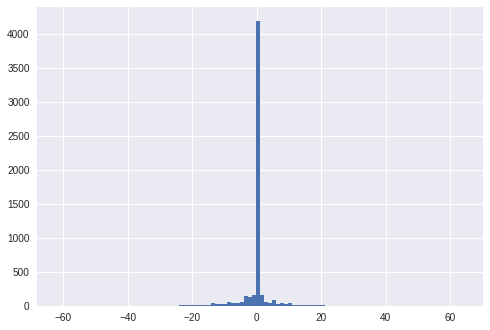

mean=-0.283 stdv=5.478
Statistics=0.500, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1900.204, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


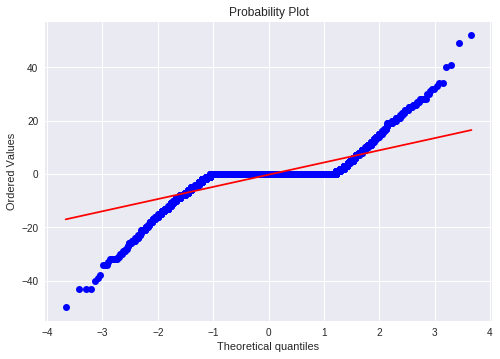

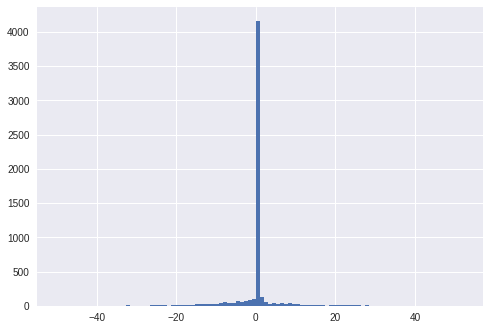

mean=-0.270 stdv=5.990
Statistics=0.584, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1247.089, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


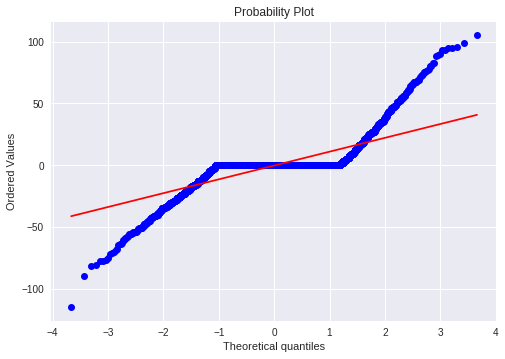

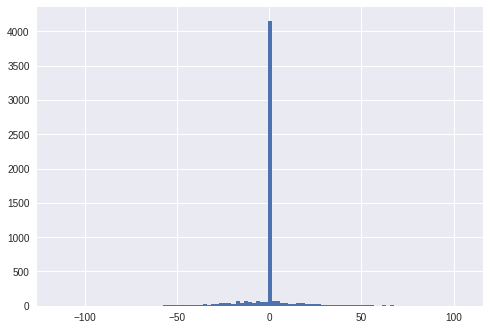

mean=-0.304 stdv=14.425
Statistics=0.602, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1429.365, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


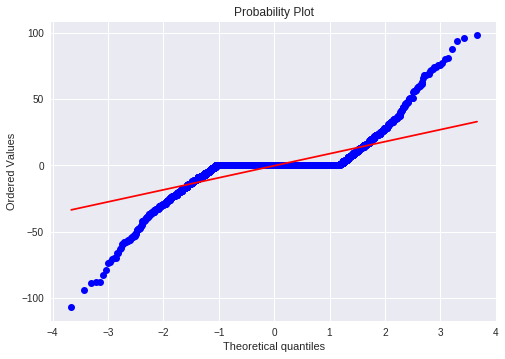

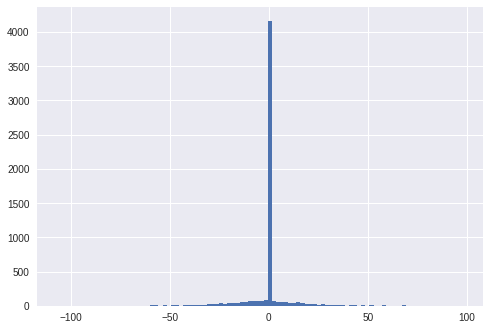

mean=-0.307 stdv=11.998
Statistics=0.573, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1298.409, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


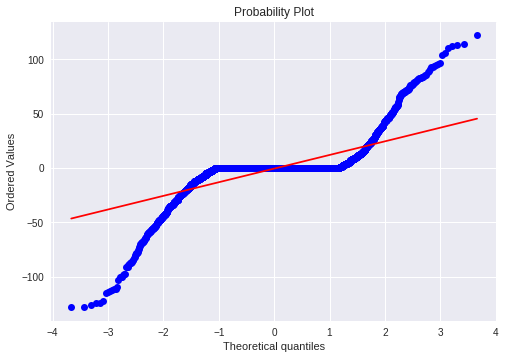

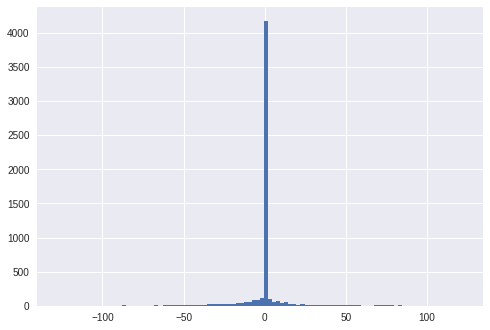

mean=-0.506 stdv=17.178
Statistics=0.533, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1350.305, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


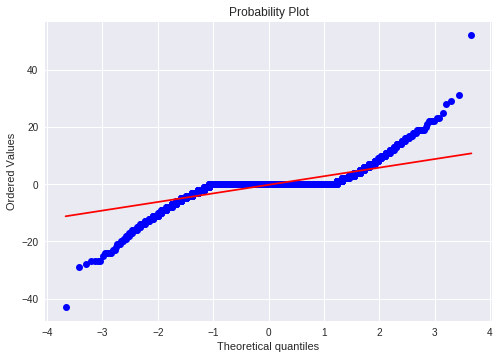

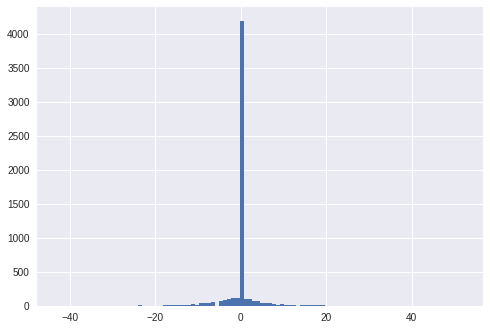

mean=-0.221 stdv=3.985
Statistics=0.568, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1429.372, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


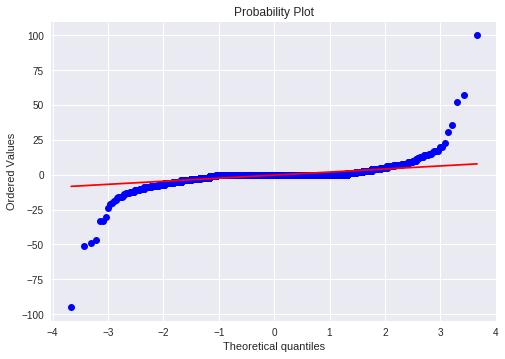

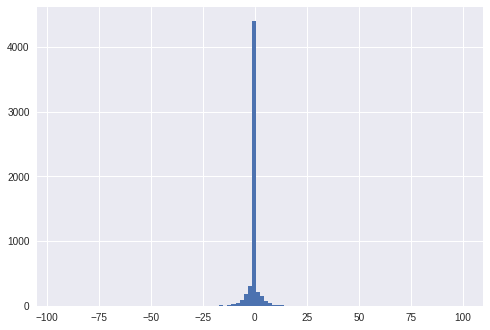

mean=-0.235 stdv=3.571
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2669.003, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


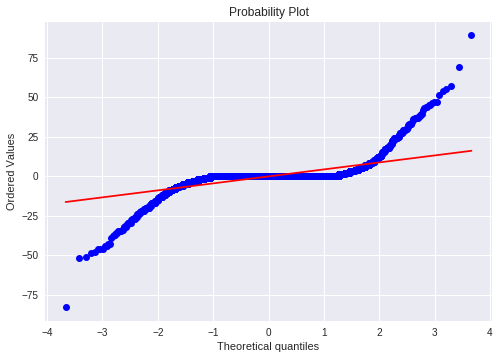

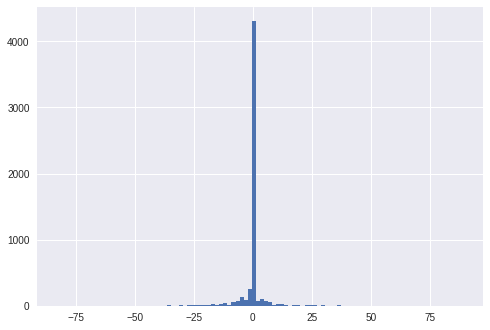

mean=-0.222 stdv=6.503
Statistics=0.463, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1912.774, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


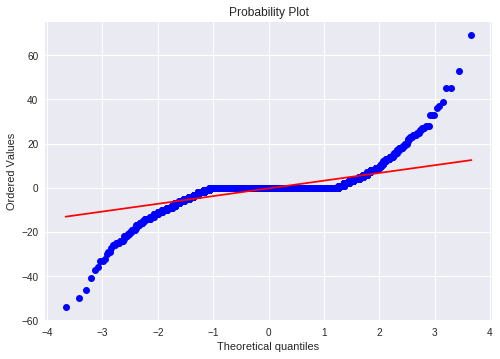

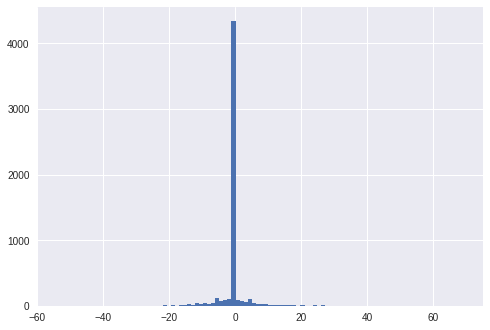

mean=-0.228 stdv=4.861
Statistics=0.517, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1761.848, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


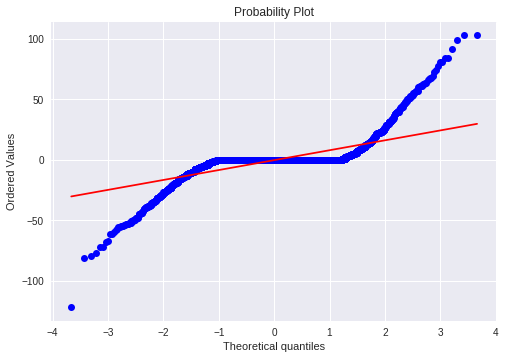

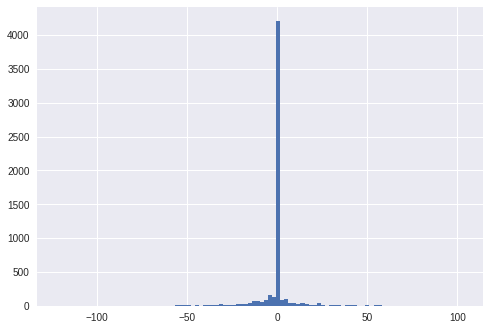

mean=-0.257 stdv=11.347
Statistics=0.523, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1712.917, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


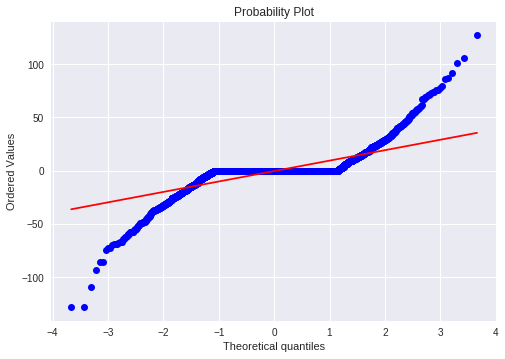

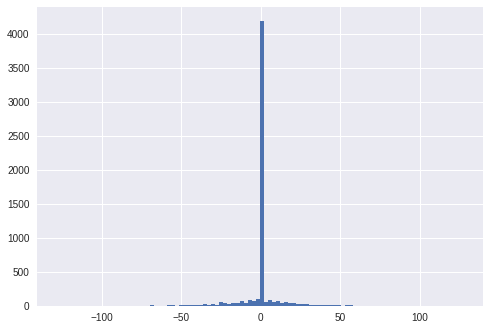

mean=-0.255 stdv=12.885
Statistics=0.577, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1327.720, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


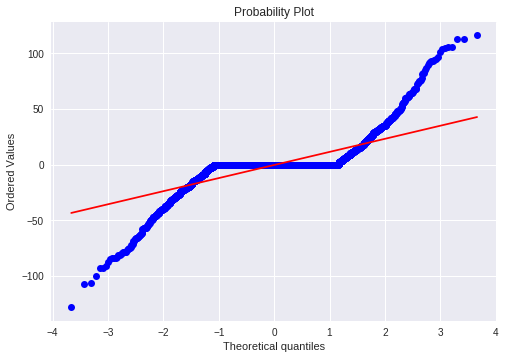

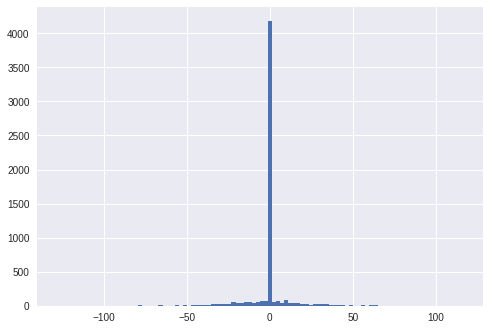

mean=-0.333 stdv=15.438
Statistics=0.579, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1209.039, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


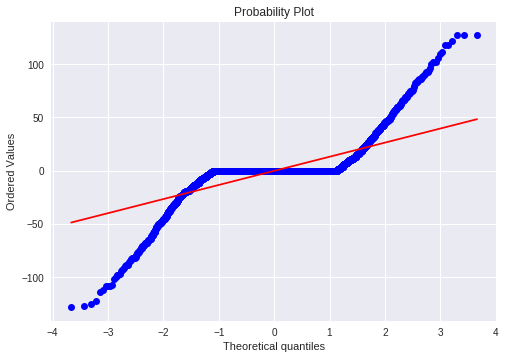

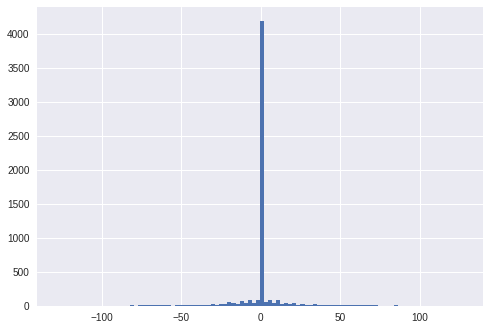

mean=-0.074 stdv=17.750
Statistics=0.556, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1207.553, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.371, p=0.000
Sample does not look Gaussian (reject H0)


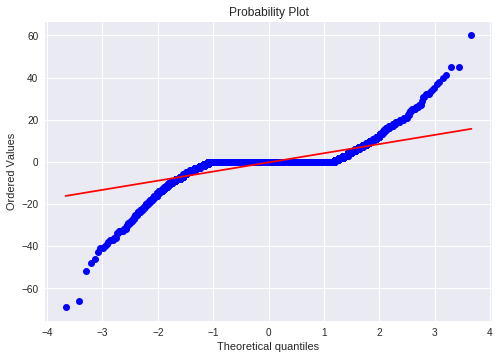

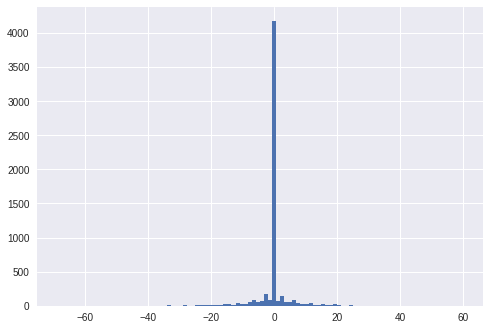

mean=-0.265 stdv=5.936
Statistics=0.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2286.046, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


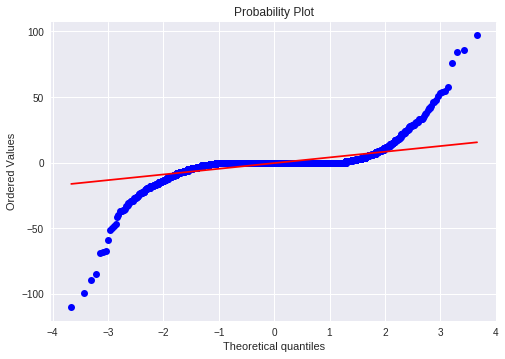

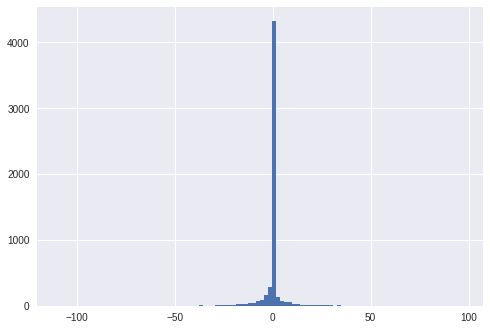

mean=-0.248 stdv=6.788
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2435.935, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


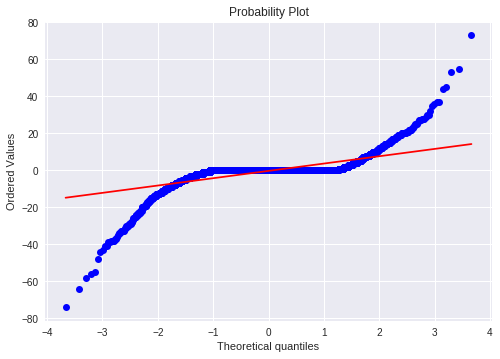

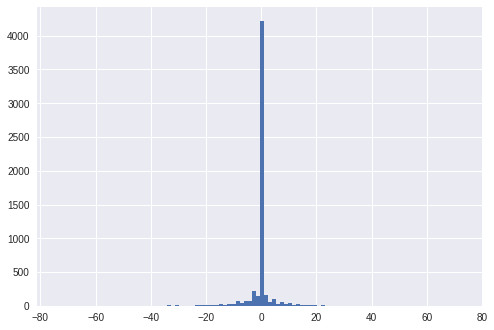

mean=-0.269 stdv=5.712
Statistics=0.482, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2598.700, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


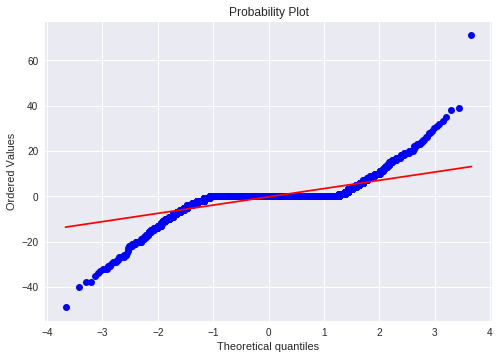

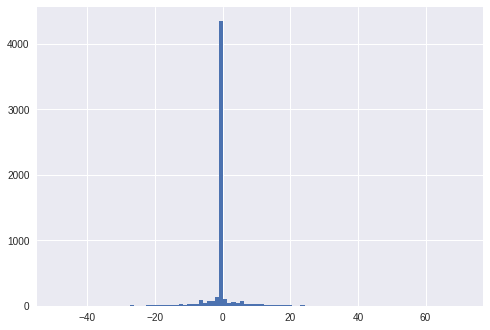

mean=-0.273 stdv=4.998
Statistics=0.534, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1544.022, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


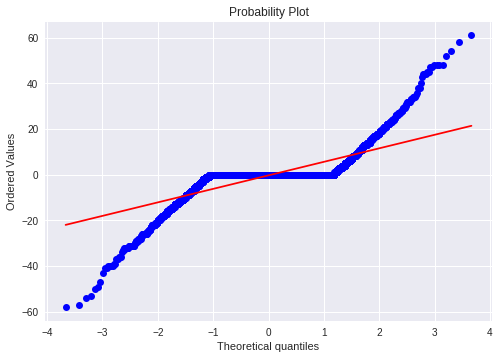

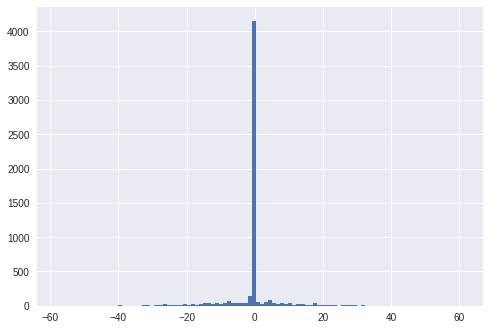

mean=-0.266 stdv=7.688
Statistics=0.593, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1140.086, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


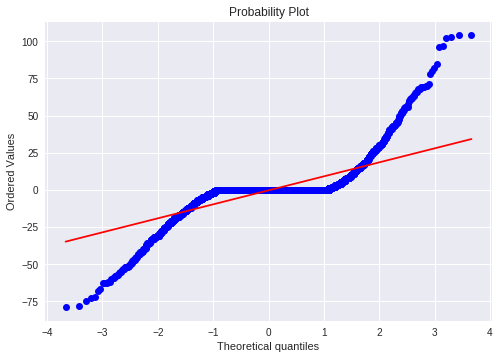

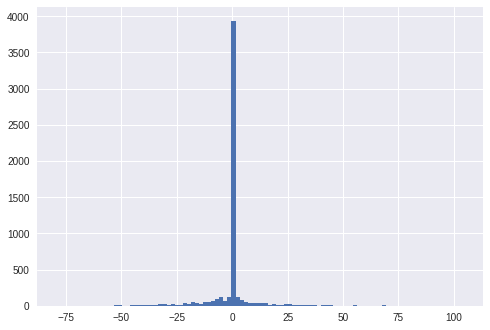

mean=-0.314 stdv=12.270
Statistics=0.590, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1747.162, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.362, p=0.000
Sample does not look Gaussian (reject H0)


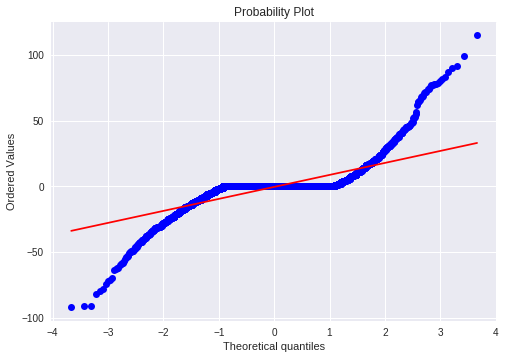

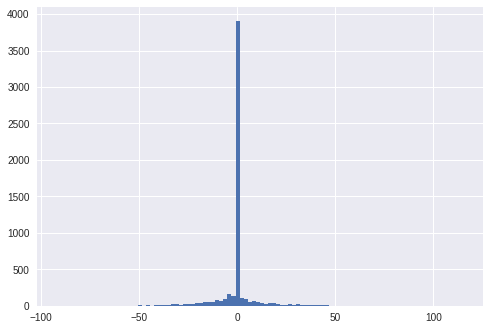

mean=-0.376 stdv=11.845
Statistics=0.595, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1645.979, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.364, p=0.000
Sample does not look Gaussian (reject H0)


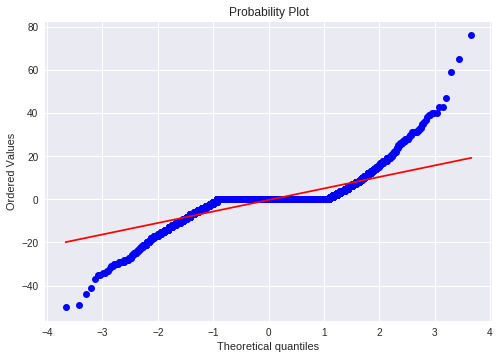

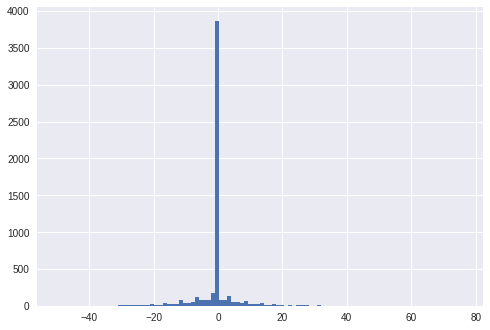

mean=-0.291 stdv=6.694
Statistics=0.635, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1526.874, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.365, p=0.000
Sample does not look Gaussian (reject H0)


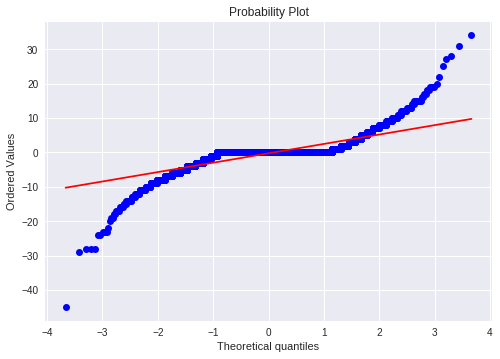

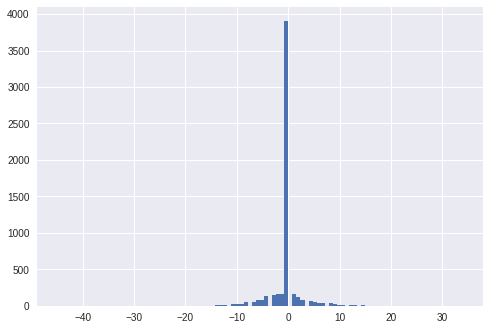

mean=-0.269 stdv=3.446
Statistics=0.628, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1644.361, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


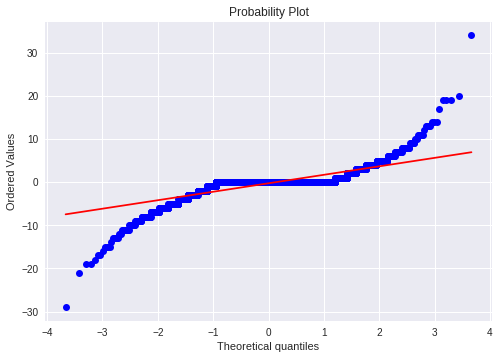

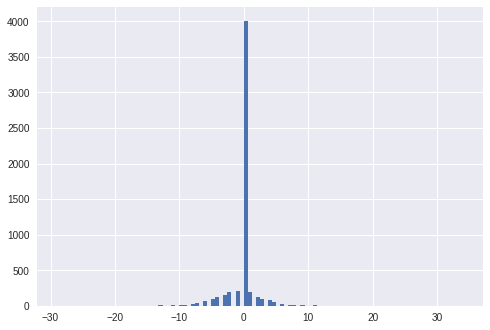

mean=-0.274 stdv=2.493
Statistics=0.622, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1580.007, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


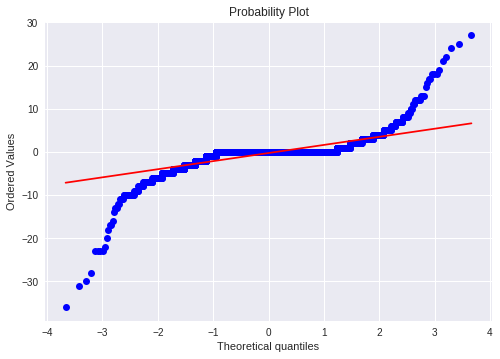

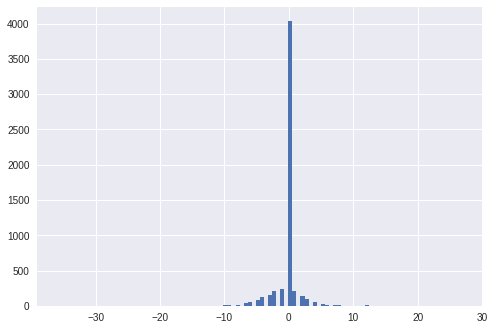

mean=-0.261 stdv=2.531
Statistics=0.551, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2678.699, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


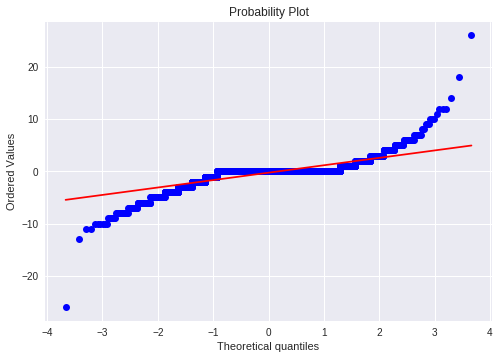

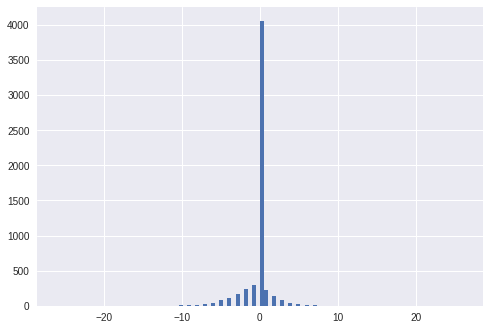

mean=-0.262 stdv=1.797
Statistics=0.624, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1616.754, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


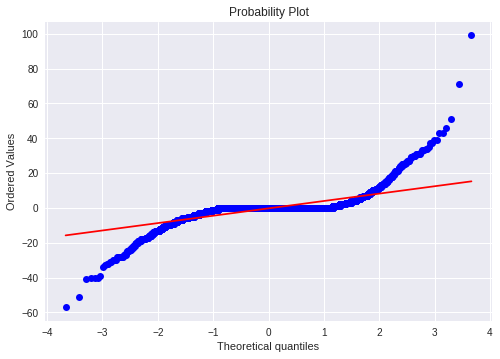

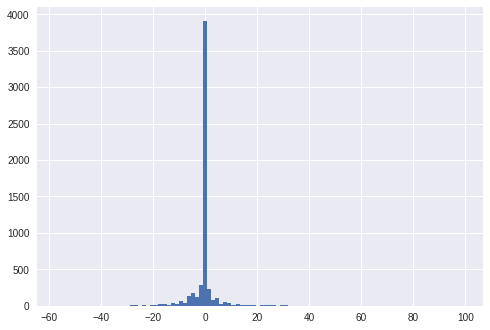

mean=-0.264 stdv=5.757
Statistics=0.541, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2805.315, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


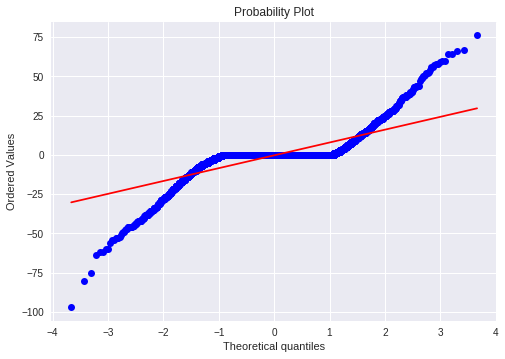

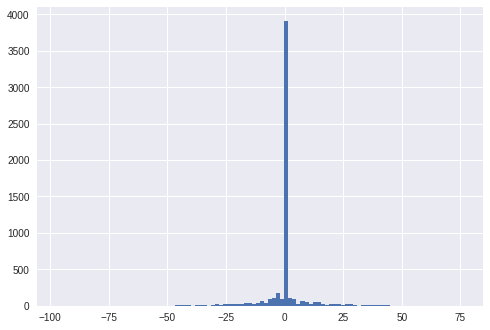

mean=-0.331 stdv=10.389
Statistics=0.618, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1198.071, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.361, p=0.000
Sample does not look Gaussian (reject H0)


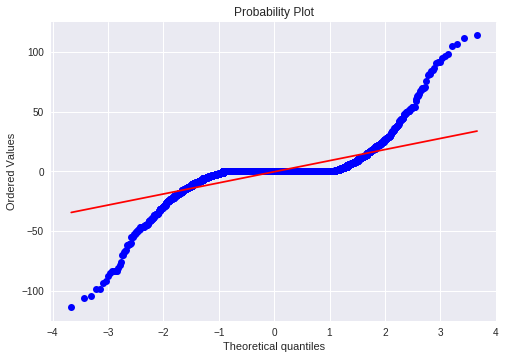

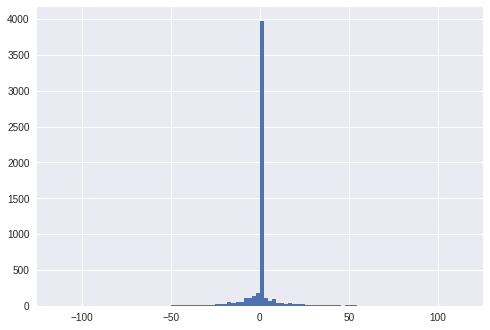

mean=-0.384 stdv=12.645
Statistics=0.543, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1480.927, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.366, p=0.000
Sample does not look Gaussian (reject H0)


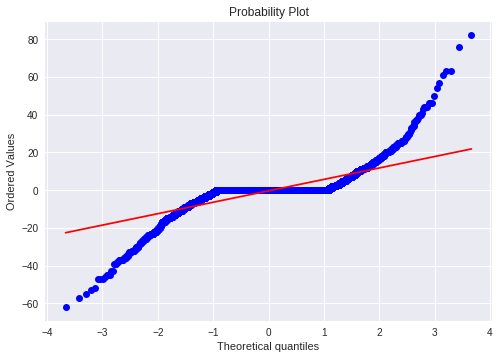

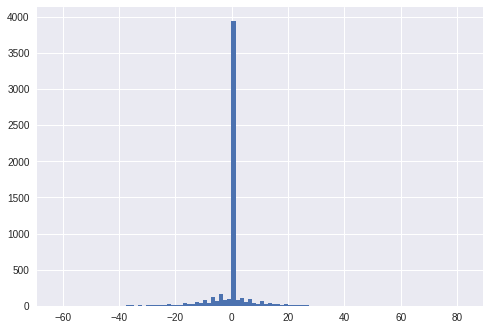

mean=-0.338 stdv=7.752
Statistics=0.611, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1311.986, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.362, p=0.000
Sample does not look Gaussian (reject H0)


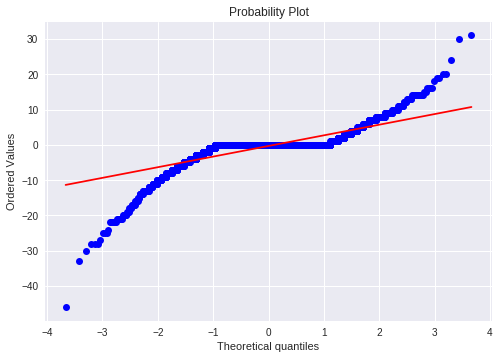

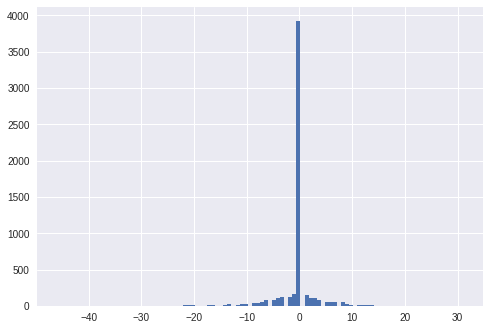

mean=-0.318 stdv=3.801
Statistics=0.628, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2448.593, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.368, p=0.000
Sample does not look Gaussian (reject H0)


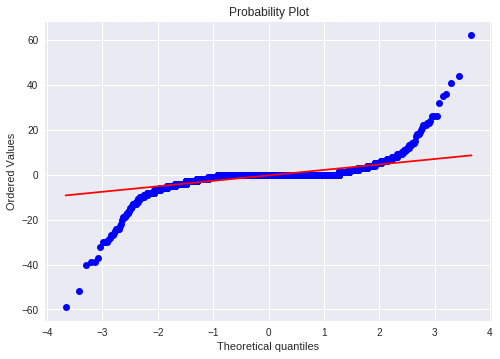

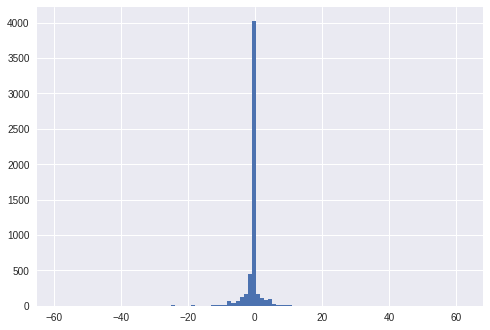

mean=-0.312 stdv=3.614
Statistics=0.455, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2660.318, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.398, p=0.000
Sample does not look Gaussian (reject H0)


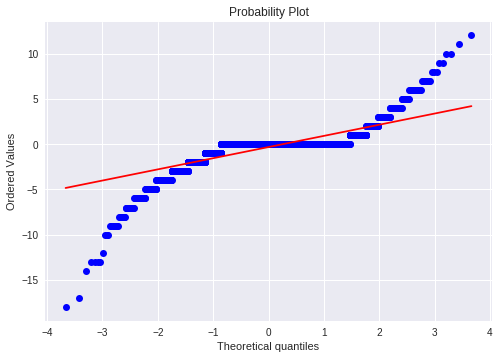

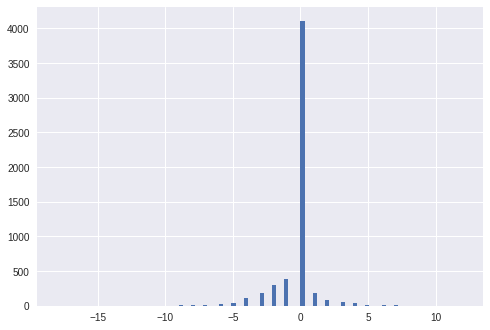

mean=-0.322 stdv=1.580
Statistics=0.609, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2561.148, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.429, p=0.000
Sample does not look Gaussian (reject H0)


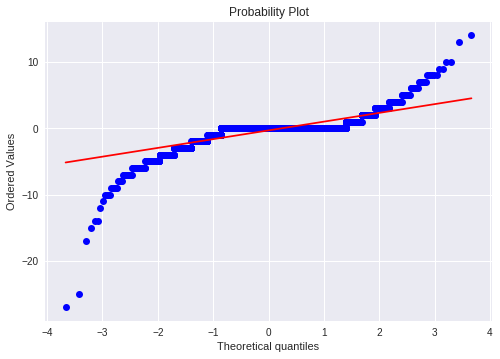

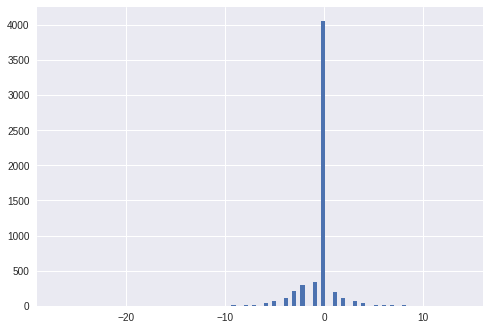

mean=-0.328 stdv=1.688
Statistics=0.613, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3474.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)


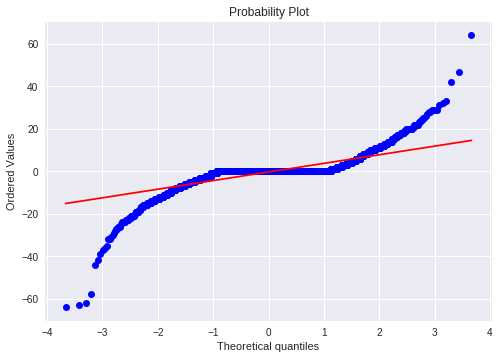

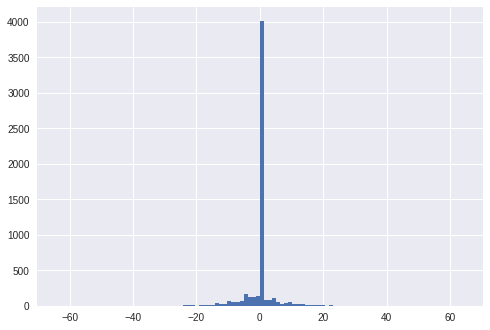

mean=-0.312 stdv=5.282
Statistics=0.590, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2300.163, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.371, p=0.000
Sample does not look Gaussian (reject H0)


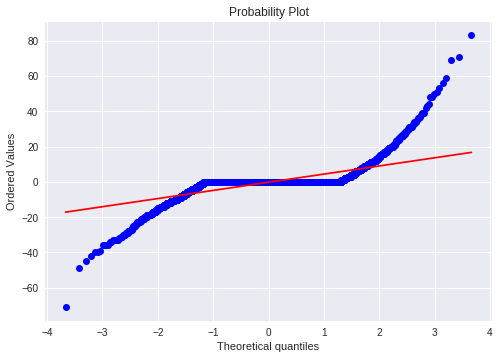

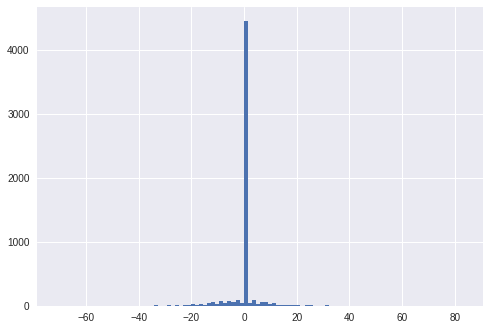

mean=-0.202 stdv=6.518
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2266.944, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


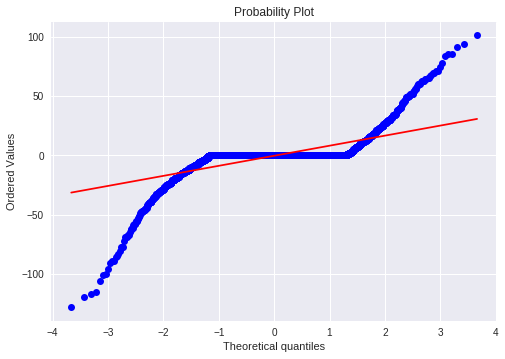

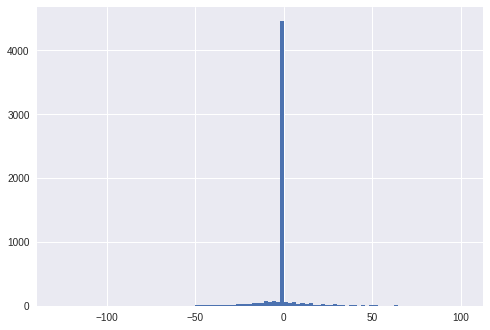

mean=-0.394 stdv=12.160
Statistics=0.486, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2105.019, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


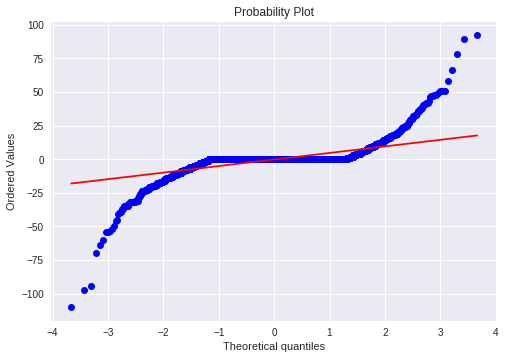

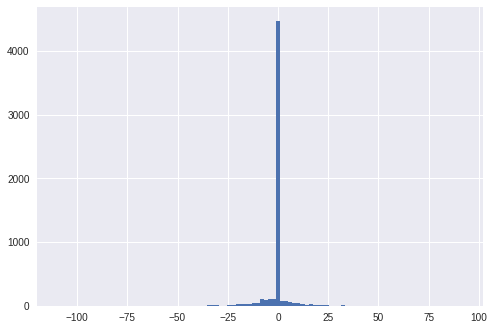

mean=-0.225 stdv=7.259
Statistics=0.452, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2114.407, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


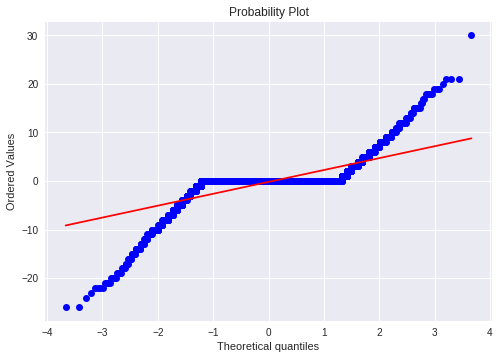

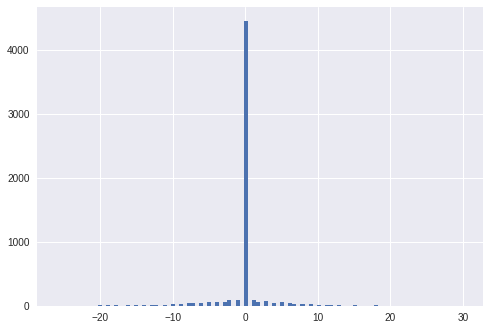

mean=-0.183 stdv=3.358
Statistics=0.532, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1785.993, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


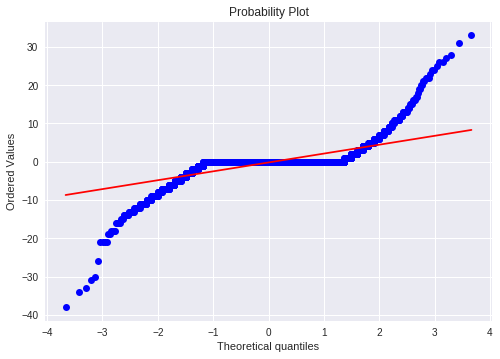

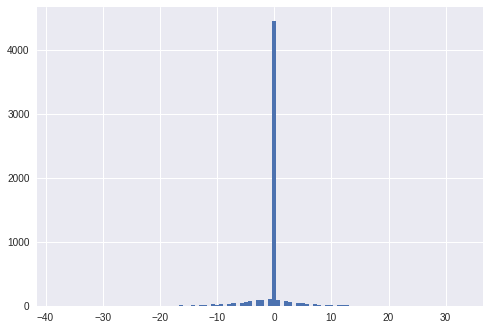

mean=-0.188 stdv=3.295
Statistics=0.496, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1562.728, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.415, p=0.000
Sample does not look Gaussian (reject H0)


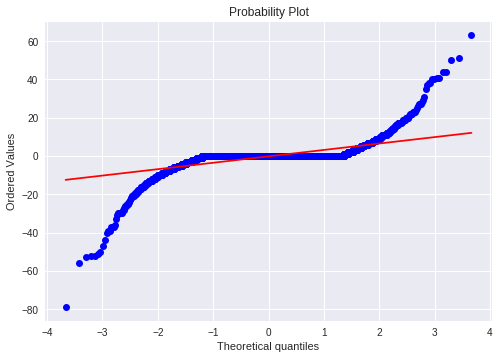

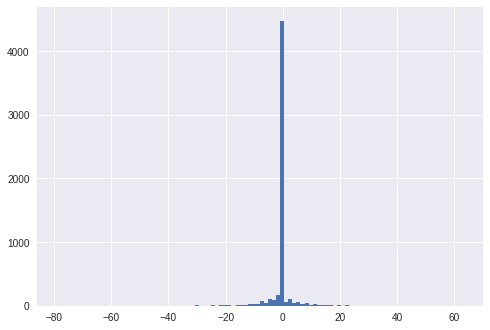

mean=-0.182 stdv=5.144
Statistics=0.425, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2685.123, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


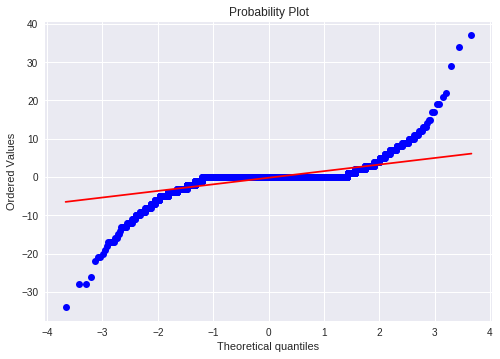

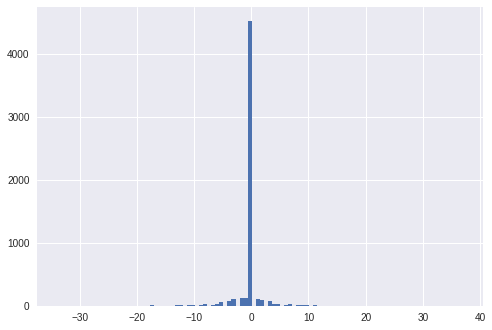

mean=-0.181 stdv=2.560
Statistics=0.453, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2040.299, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.423, p=0.000
Sample does not look Gaussian (reject H0)


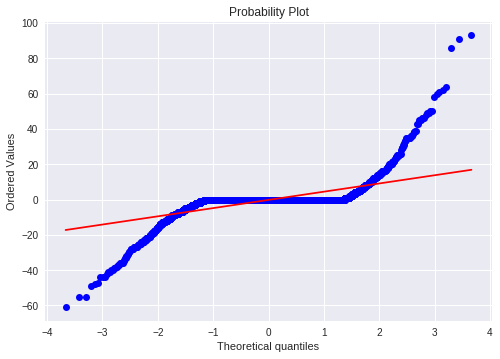

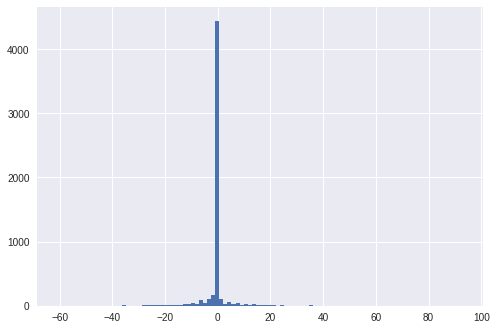

mean=-0.195 stdv=6.995
Statistics=0.444, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2896.757, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.415, p=0.000
Sample does not look Gaussian (reject H0)


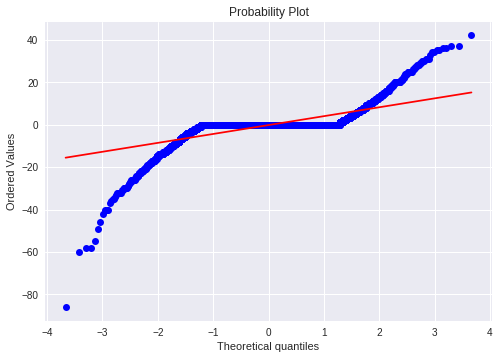

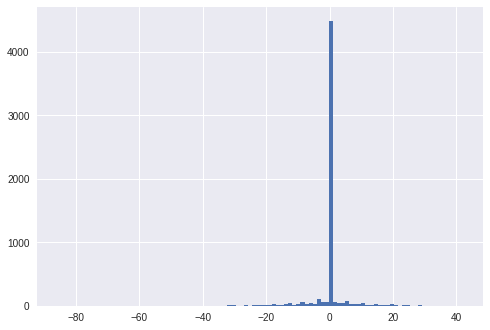

mean=-0.223 stdv=5.938
Statistics=0.499, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2858.458, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


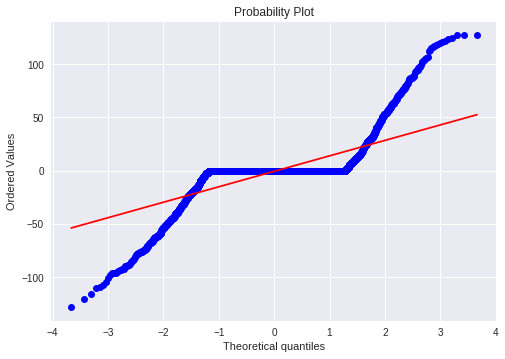

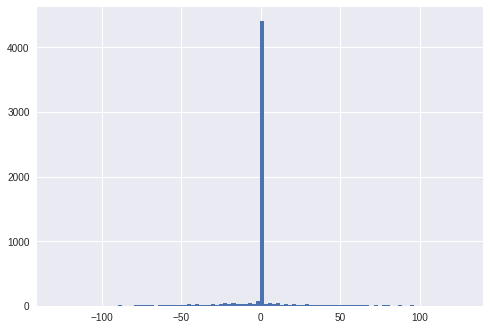

mean=-0.513 stdv=19.722
Statistics=0.541, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1209.907, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


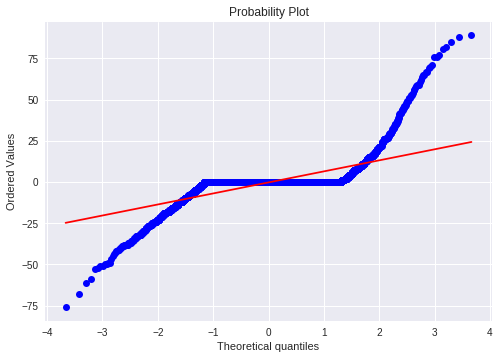

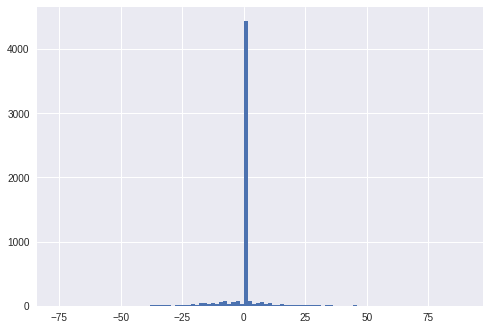

mean=-0.237 stdv=9.460
Statistics=0.502, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2599.674, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


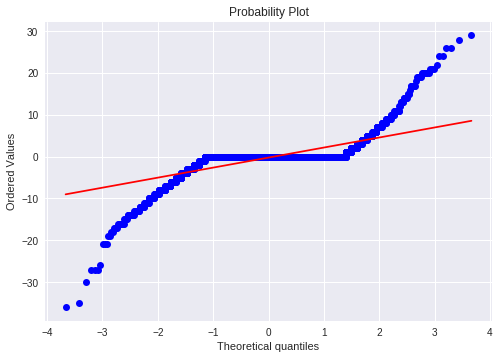

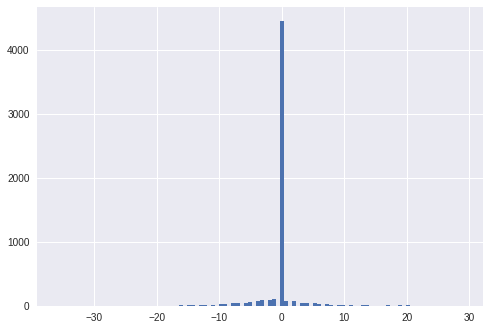

mean=-0.216 stdv=3.359
Statistics=0.511, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1530.419, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


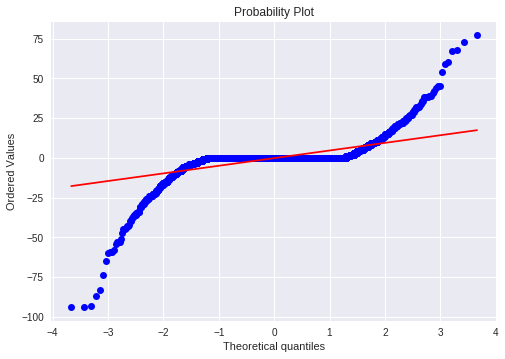

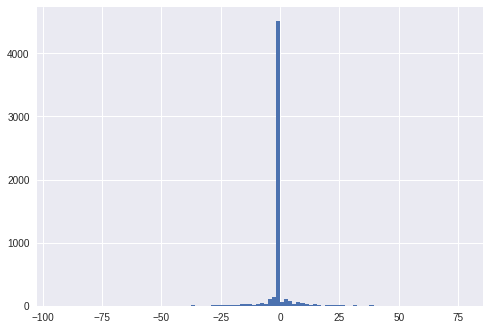

mean=-0.210 stdv=7.401
Statistics=0.421, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3366.081, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


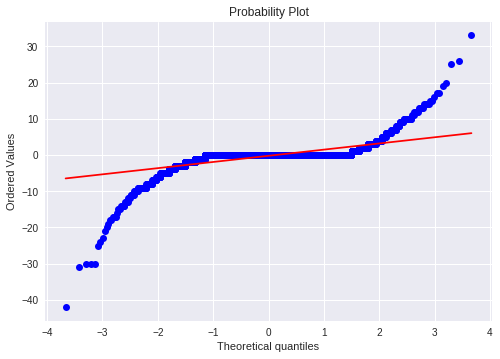

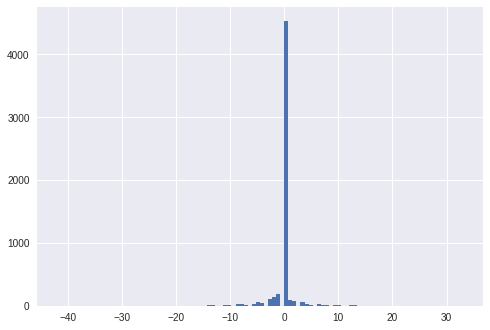

mean=-0.220 stdv=2.595
Statistics=0.433, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3526.487, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.433, p=0.000
Sample does not look Gaussian (reject H0)


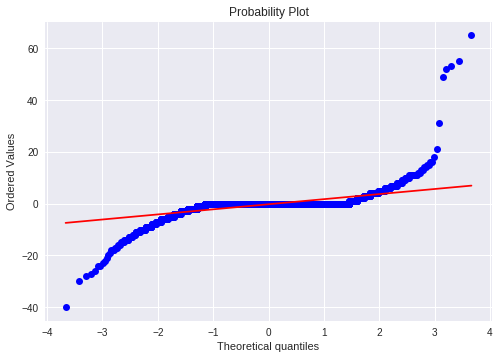

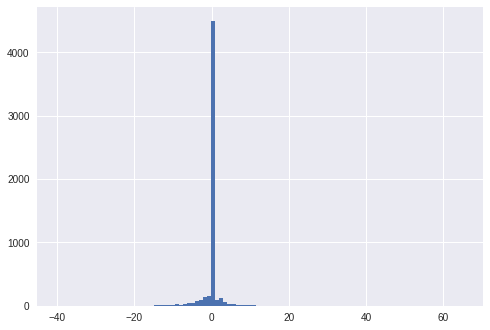

mean=-0.227 stdv=3.129
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=5142.859, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.428, p=0.000
Sample does not look Gaussian (reject H0)


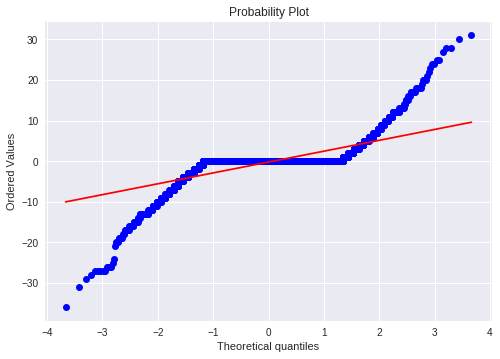

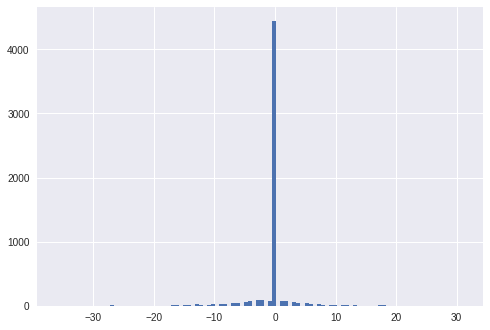

mean=-0.219 stdv=3.730
Statistics=0.517, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1673.228, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.411, p=0.000
Sample does not look Gaussian (reject H0)


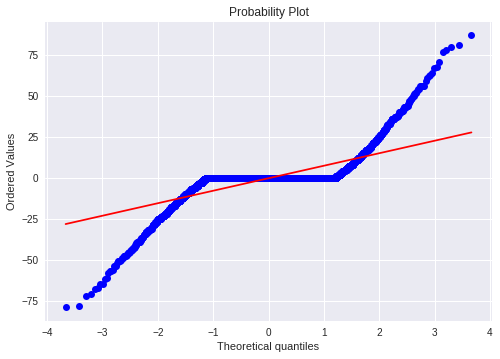

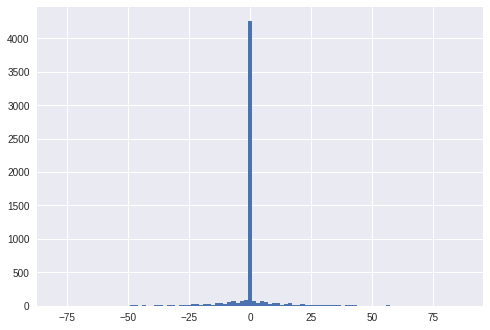

mean=-0.228 stdv=10.347
Statistics=0.545, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1276.718, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


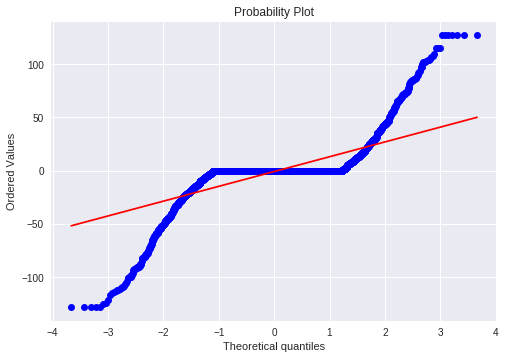

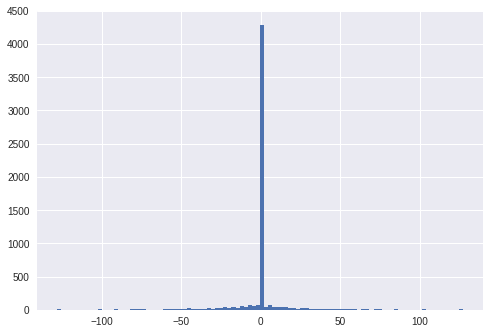

mean=-0.721 stdv=19.131
Statistics=0.527, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1345.746, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


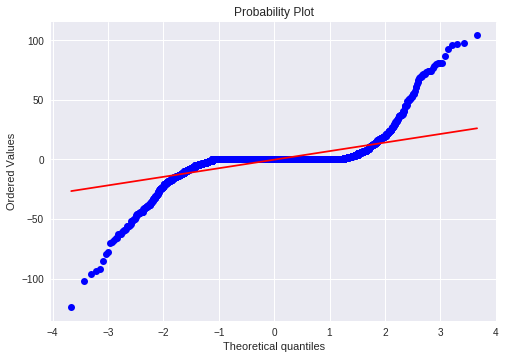

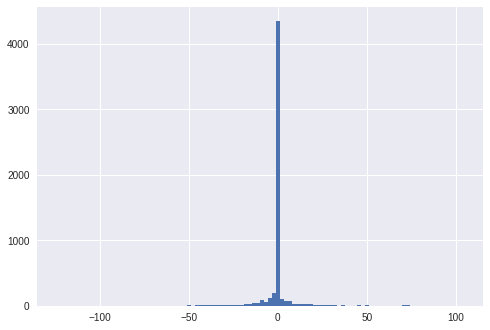

mean=-0.252 stdv=10.843
Statistics=0.440, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1761.860, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


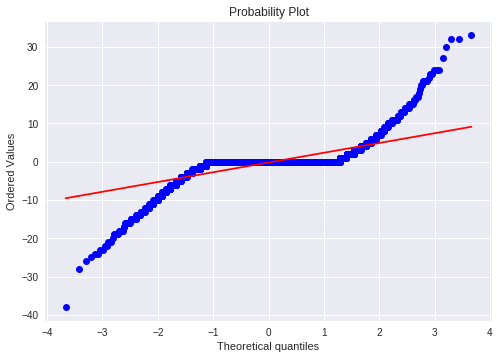

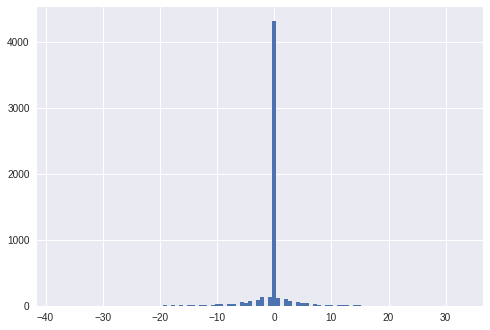

mean=-0.199 stdv=3.516
Statistics=0.526, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1449.598, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.401, p=0.000
Sample does not look Gaussian (reject H0)


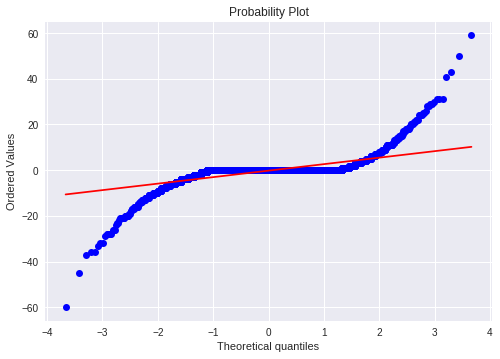

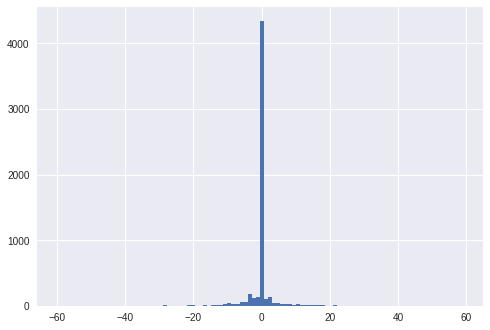

mean=-0.209 stdv=4.178
Statistics=0.464, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1774.556, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


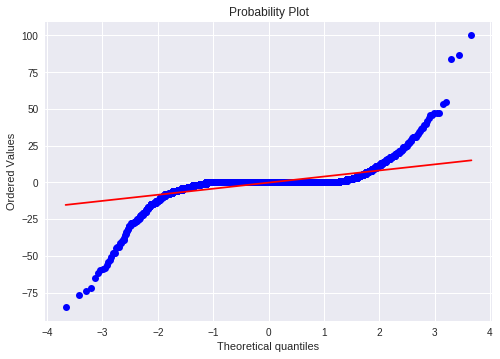

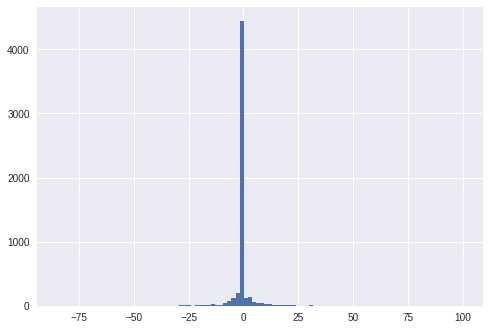

mean=-0.199 stdv=6.585
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2292.428, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


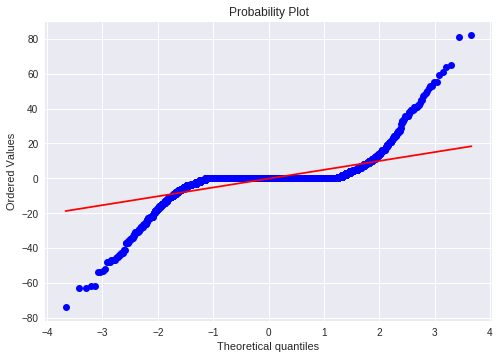

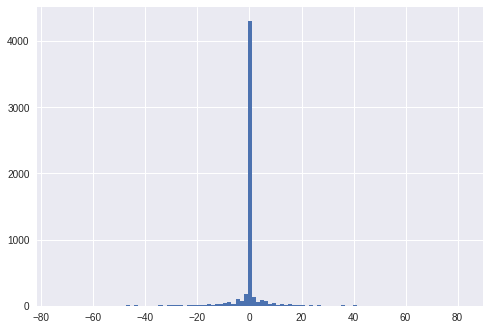

mean=-0.206 stdv=7.505
Statistics=0.458, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1577.645, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


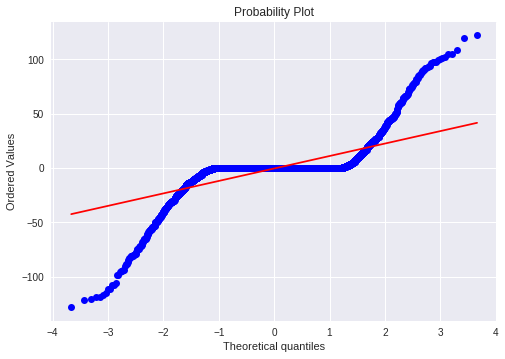

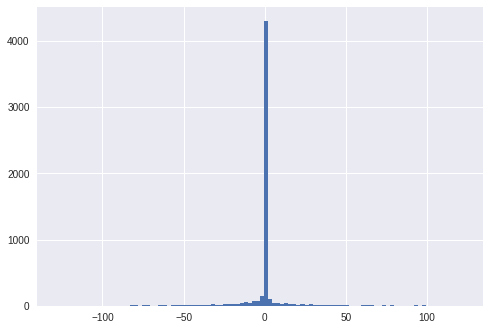

mean=-0.399 stdv=16.287
Statistics=0.495, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1392.819, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.393, p=0.000
Sample does not look Gaussian (reject H0)


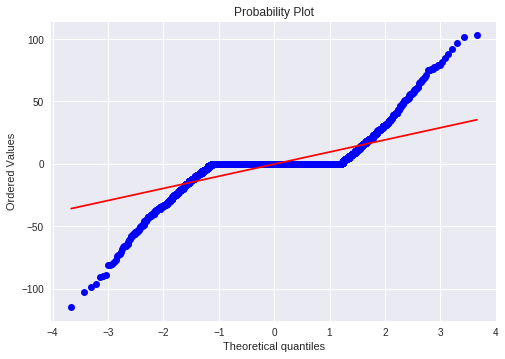

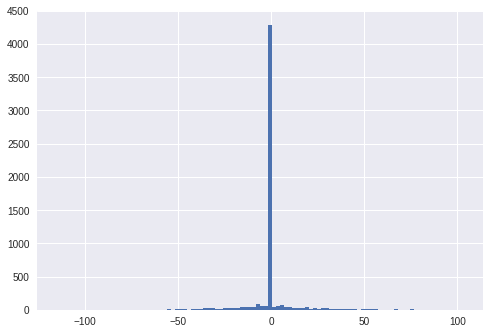

mean=-0.254 stdv=13.104
Statistics=0.551, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1260.729, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


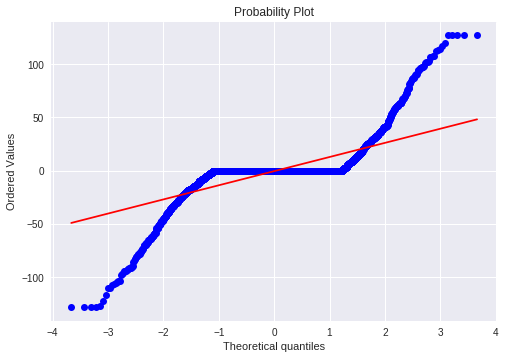

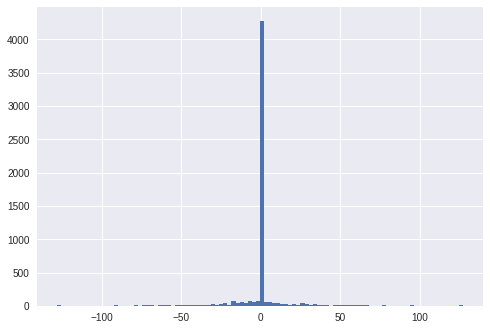

mean=-0.346 stdv=18.169
Statistics=0.533, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1262.751, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


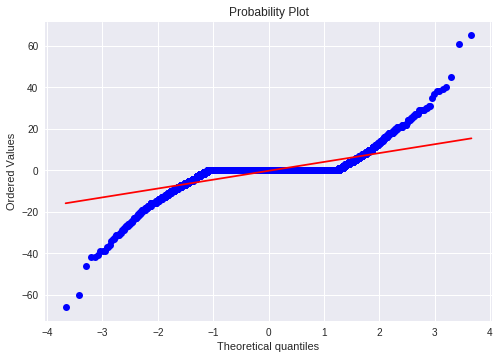

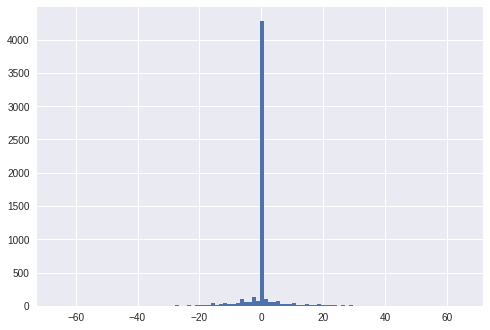

mean=-0.258 stdv=5.824
Statistics=0.538, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1538.064, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


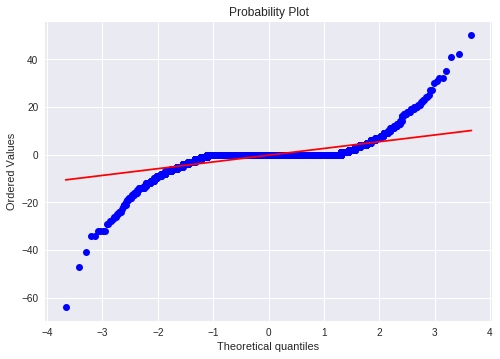

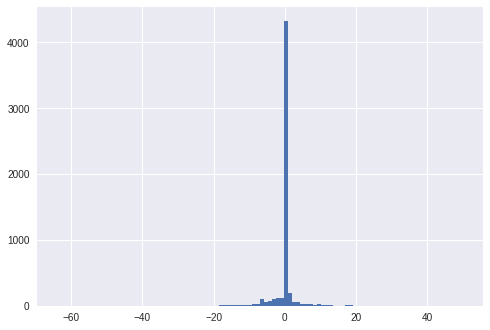

mean=-0.241 stdv=4.110
Statistics=0.474, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2296.706, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.405, p=0.000
Sample does not look Gaussian (reject H0)


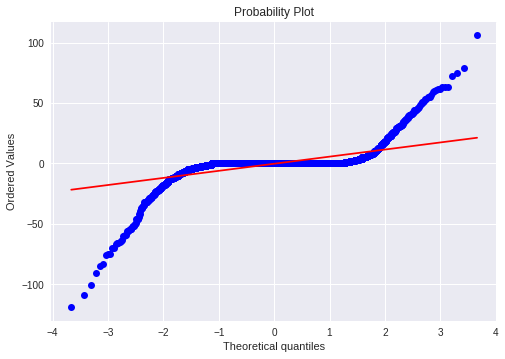

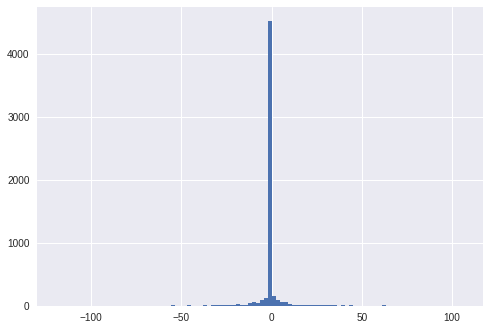

mean=-0.224 stdv=9.229
Statistics=0.405, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2596.807, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


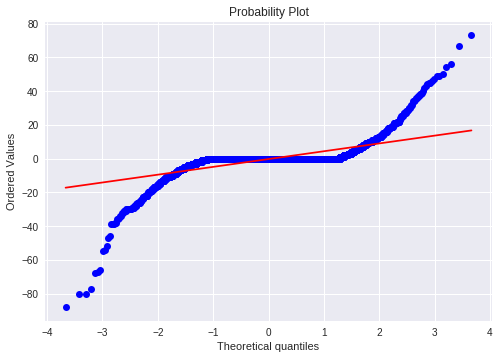

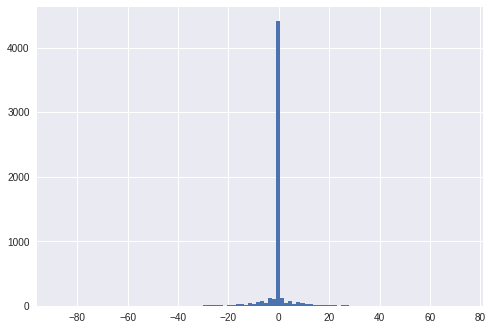

mean=-0.242 stdv=6.814
Statistics=0.462, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2535.725, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.401, p=0.000
Sample does not look Gaussian (reject H0)


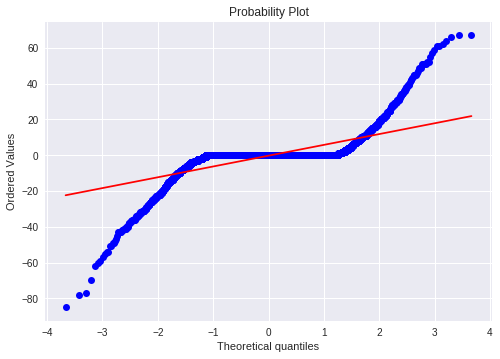

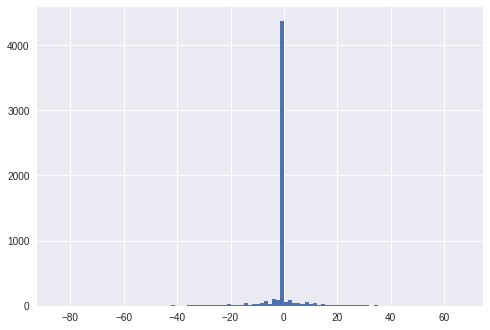

mean=-0.257 stdv=8.561
Statistics=0.498, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1469.178, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


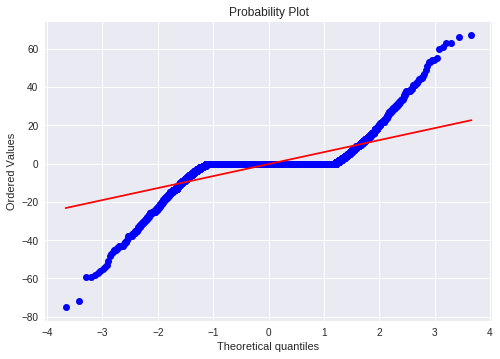

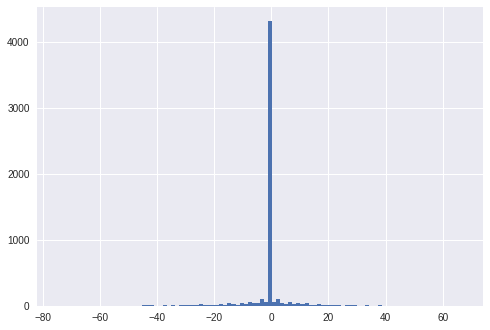

mean=-0.238 stdv=8.562
Statistics=0.536, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1306.268, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


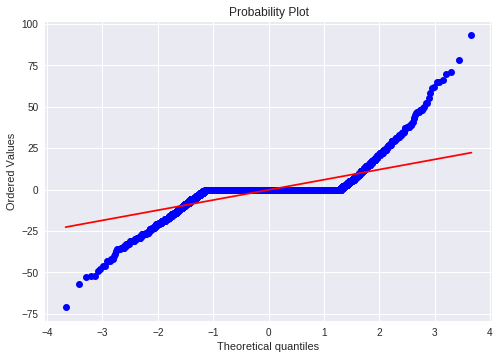

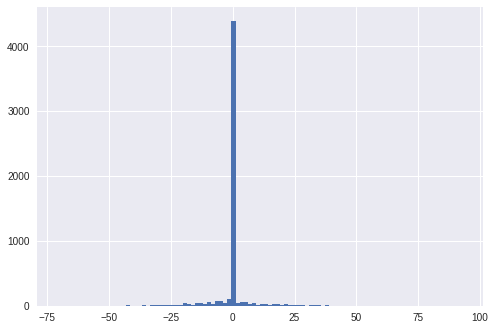

mean=-0.205 stdv=8.413
Statistics=0.532, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2031.440, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


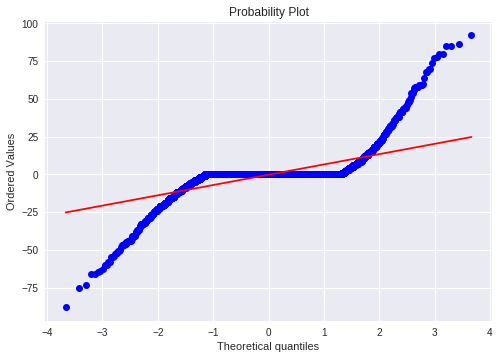

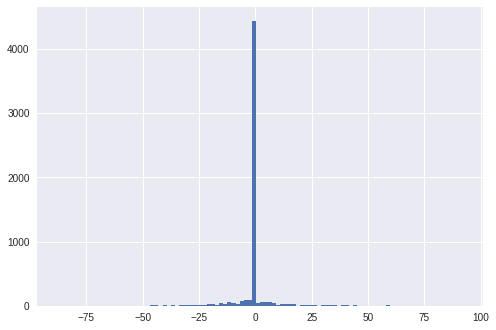

mean=-0.265 stdv=9.818
Statistics=0.483, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1892.092, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


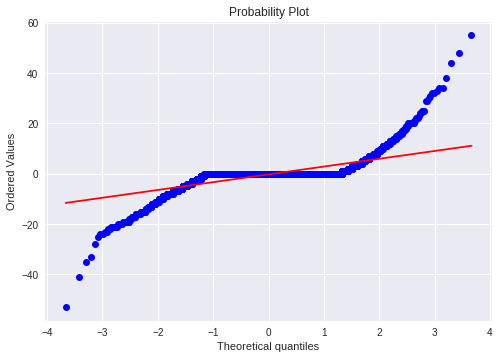

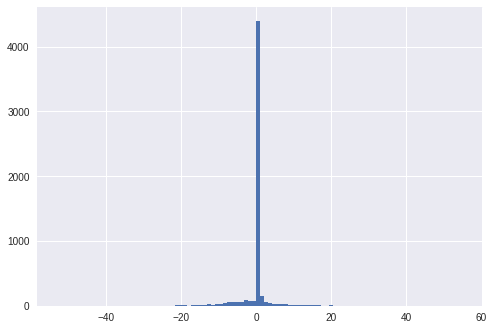

mean=-0.208 stdv=4.350
Statistics=0.508, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1886.498, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


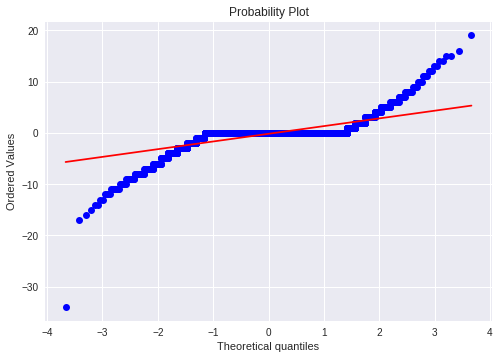

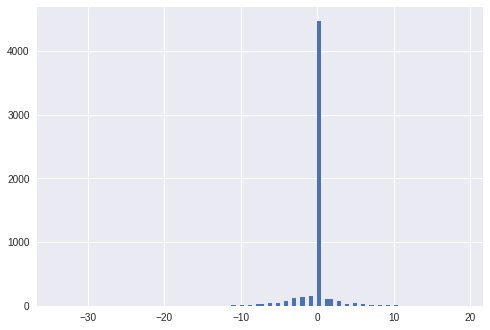

mean=-0.185 stdv=2.073
Statistics=0.525, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2427.991, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.422, p=0.000
Sample does not look Gaussian (reject H0)


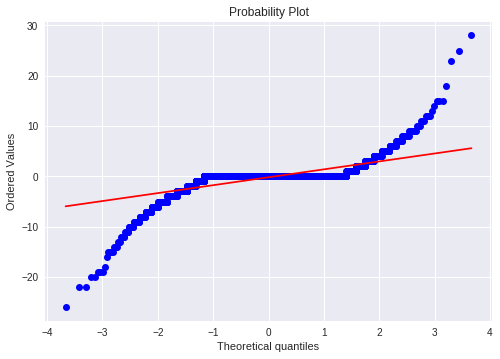

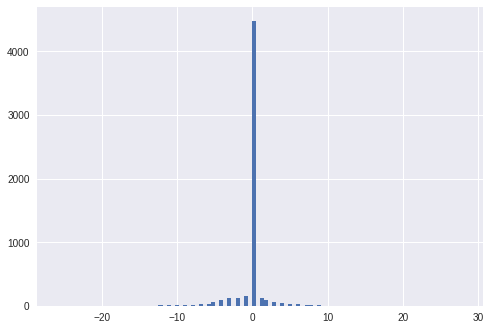

mean=-0.184 stdv=2.247
Statistics=0.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2194.092, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.420, p=0.000
Sample does not look Gaussian (reject H0)


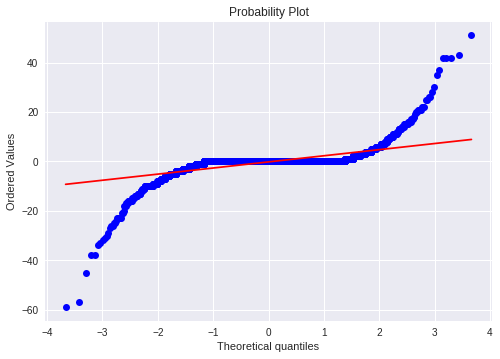

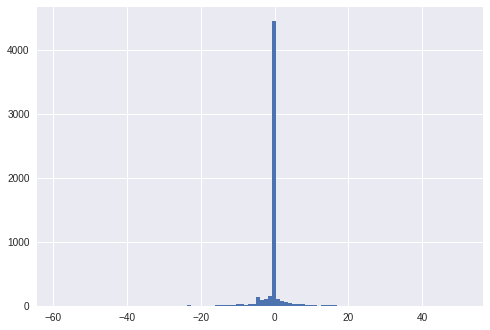

mean=-0.188 stdv=3.871
Statistics=0.411, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2341.542, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


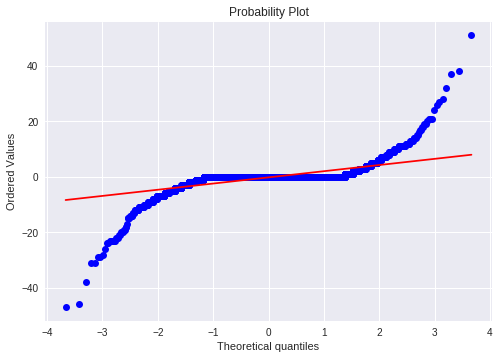

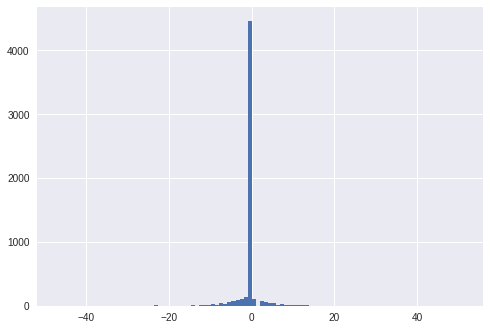

mean=-0.187 stdv=3.368
Statistics=0.439, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2394.797, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


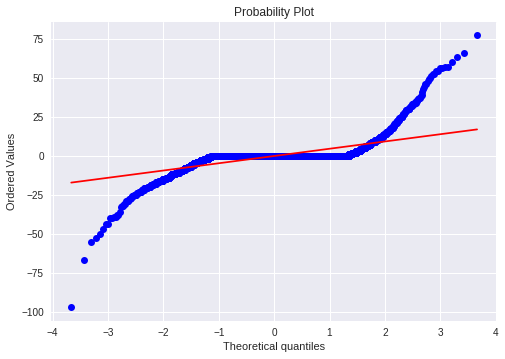

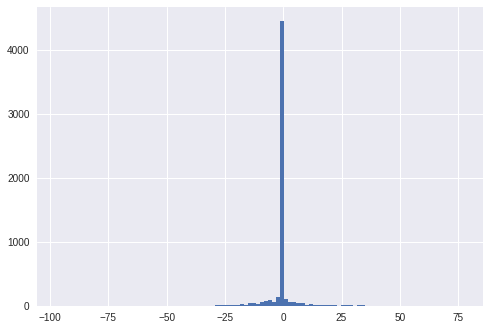

mean=-0.199 stdv=6.794
Statistics=0.469, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2272.357, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)


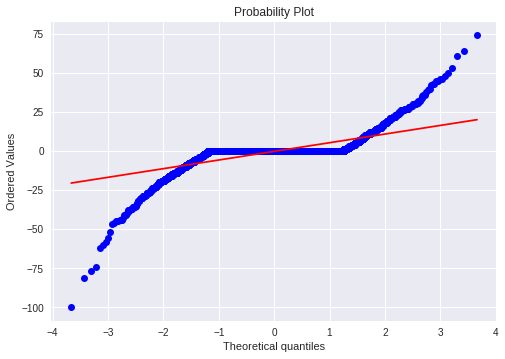

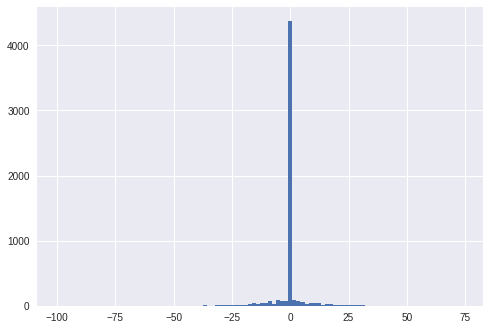

mean=-0.232 stdv=7.702
Statistics=0.517, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2193.181, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


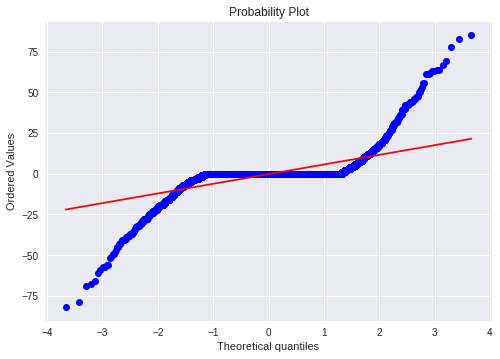

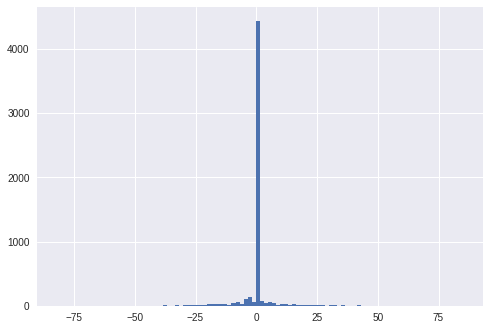

mean=-0.243 stdv=8.633
Statistics=0.473, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1662.813, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


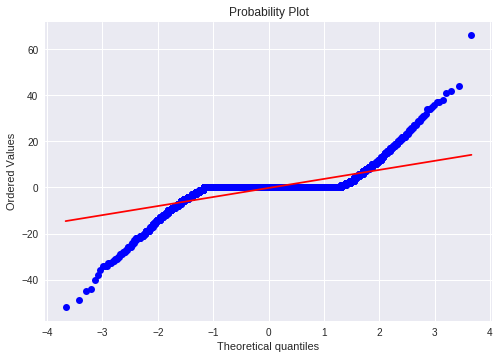

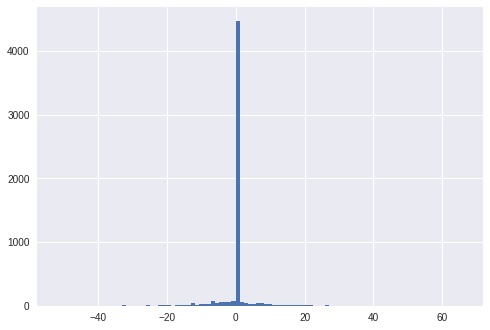

mean=-0.233 stdv=5.543
Statistics=0.502, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1457.397, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


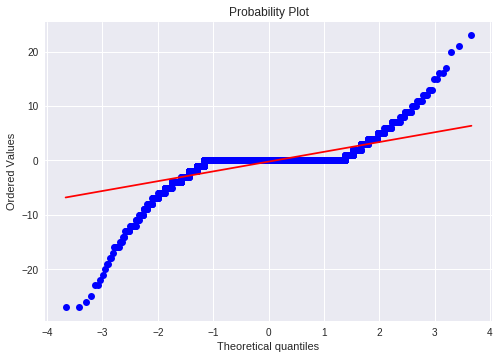

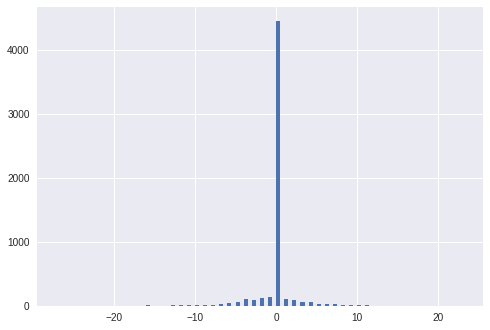

mean=-0.219 stdv=2.543
Statistics=0.501, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3081.318, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


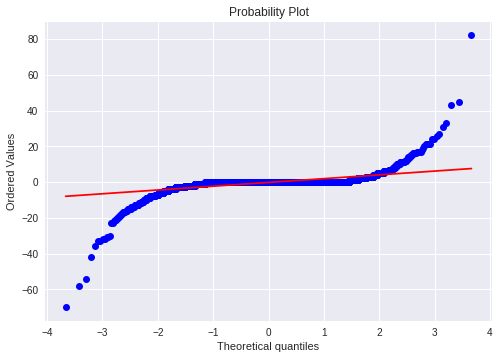

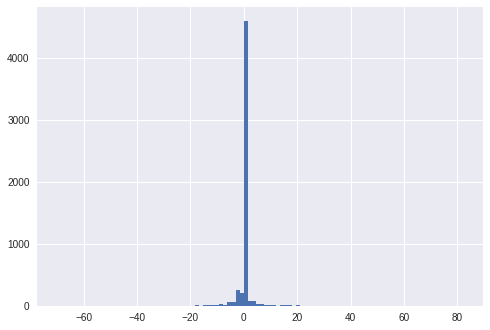

mean=-0.217 stdv=3.600
Statistics=0.347, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2827.547, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.428, p=0.000
Sample does not look Gaussian (reject H0)


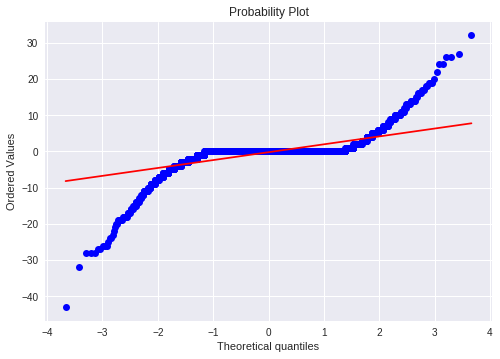

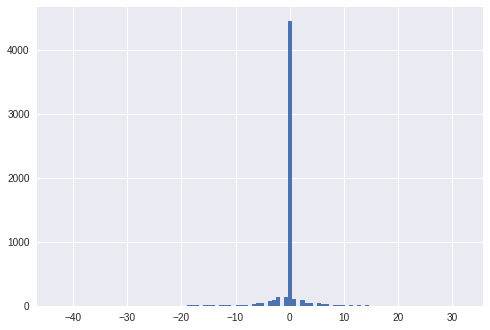

mean=-0.226 stdv=3.207
Statistics=0.461, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2851.359, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


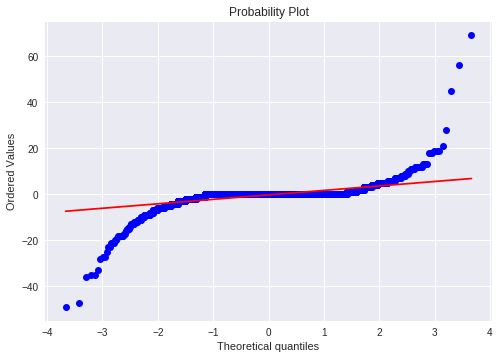

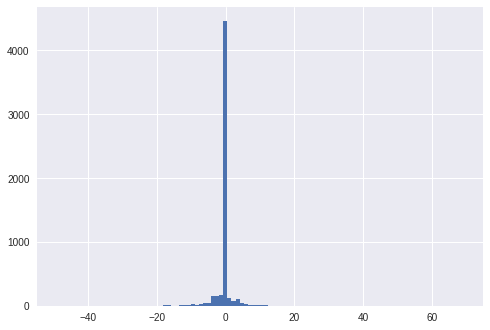

mean=-0.232 stdv=3.140
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2310.901, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.421, p=0.000
Sample does not look Gaussian (reject H0)


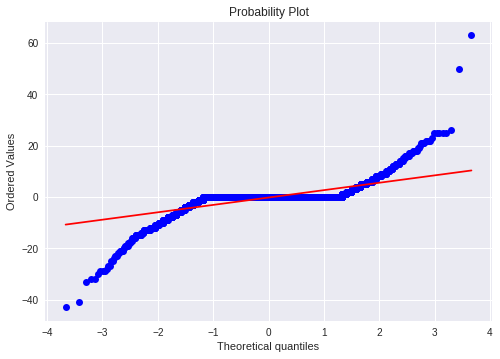

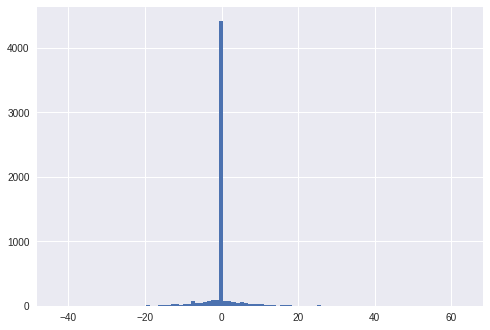

mean=-0.225 stdv=4.056
Statistics=0.505, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1658.014, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


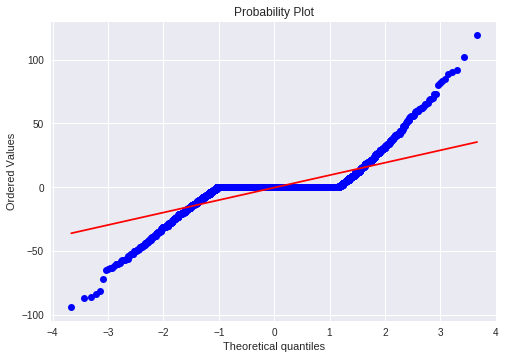

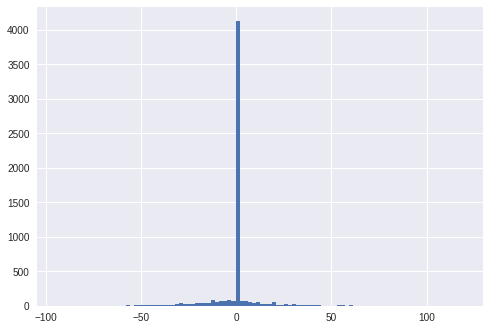

mean=-0.297 stdv=12.657
Statistics=0.594, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1395.666, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


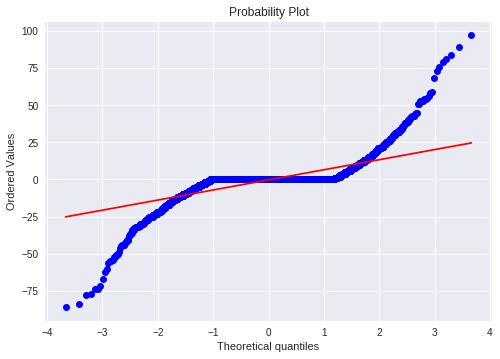

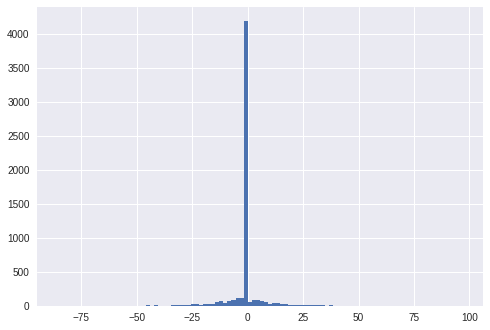

mean=-0.277 stdv=9.249
Statistics=0.540, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1511.225, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


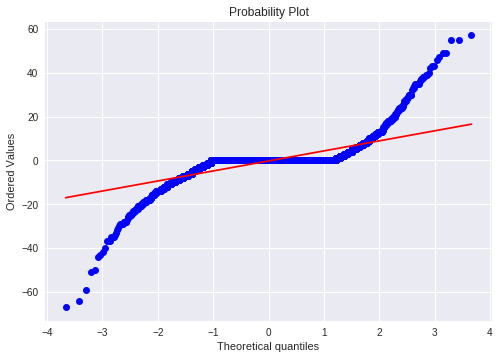

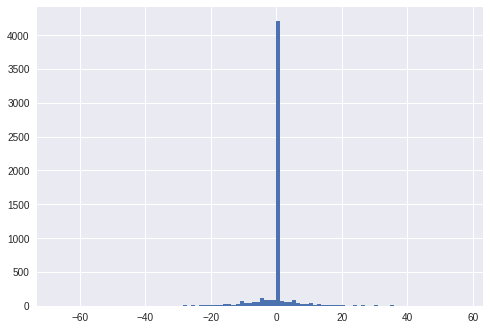

mean=-0.263 stdv=6.224
Statistics=0.541, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1492.400, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


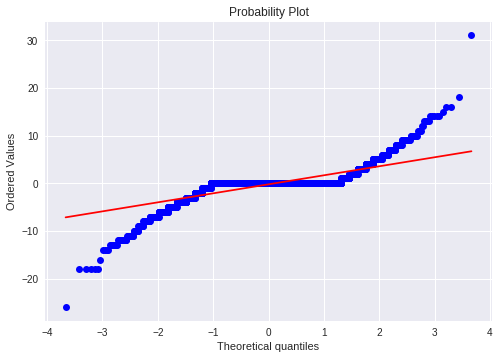

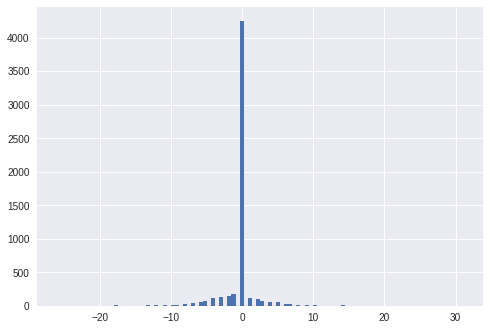

mean=-0.226 stdv=2.472
Statistics=0.586, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1471.946, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


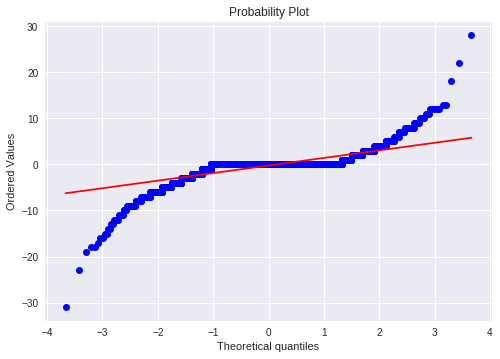

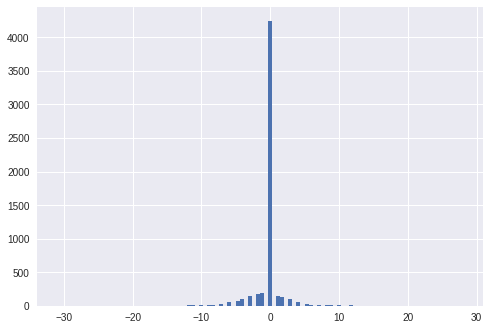

mean=-0.239 stdv=2.189
Statistics=0.566, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2312.620, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


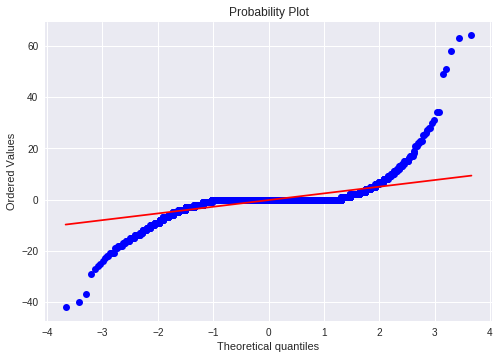

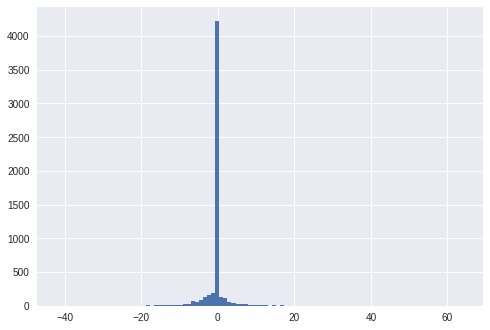

mean=-0.221 stdv=3.883
Statistics=0.451, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4198.876, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


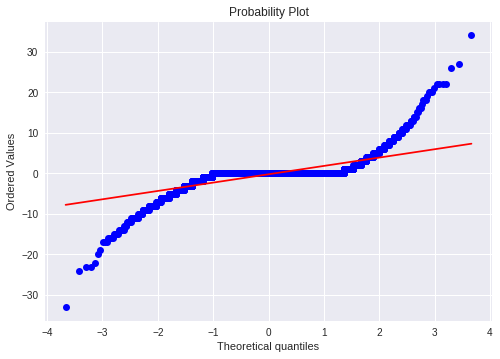

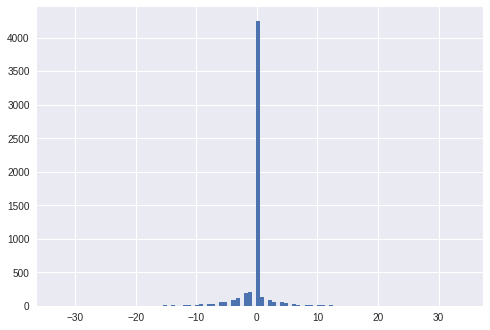

mean=-0.228 stdv=2.830
Statistics=0.529, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1582.928, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


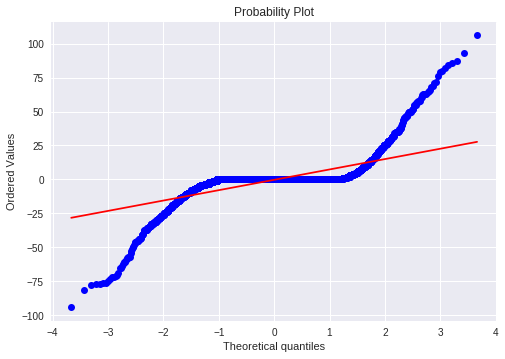

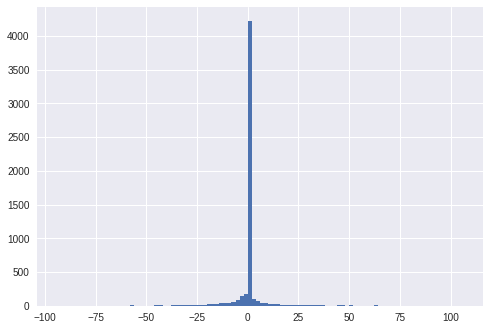

mean=-0.257 stdv=10.851
Statistics=0.494, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1584.338, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


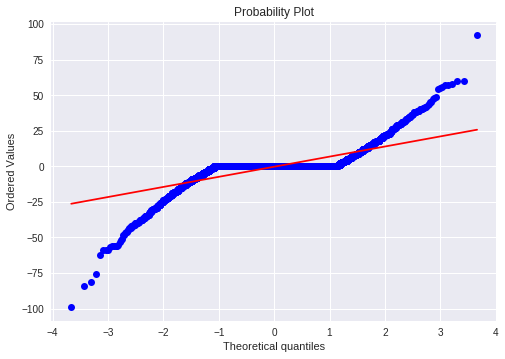

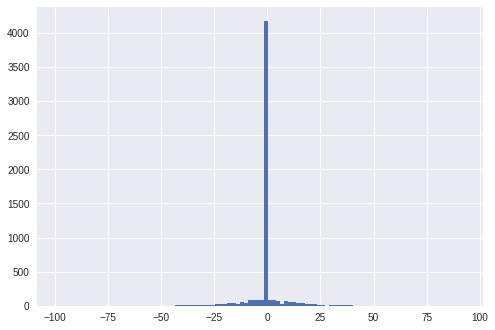

mean=-0.275 stdv=9.324
Statistics=0.580, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1663.194, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


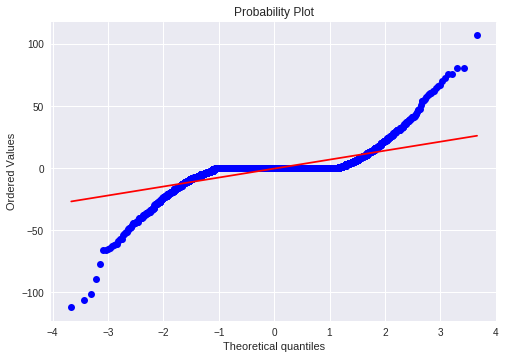

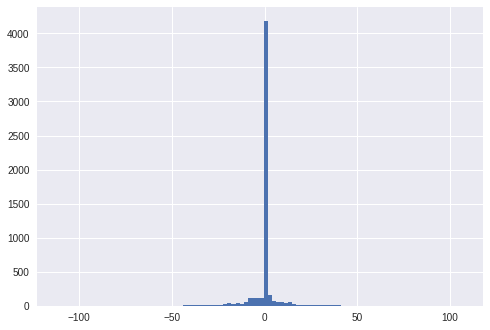

mean=-0.311 stdv=9.997
Statistics=0.523, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1607.552, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


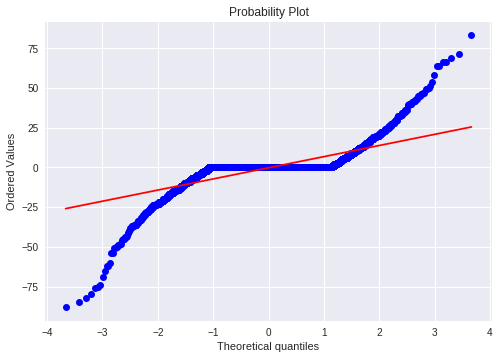

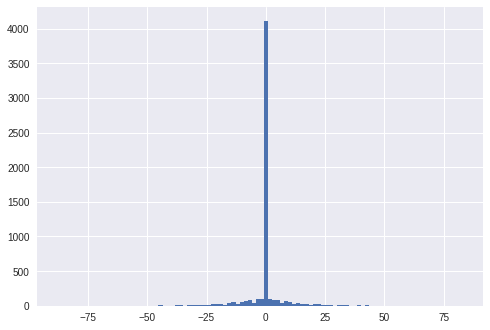

mean=-0.282 stdv=9.286
Statistics=0.571, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1668.719, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


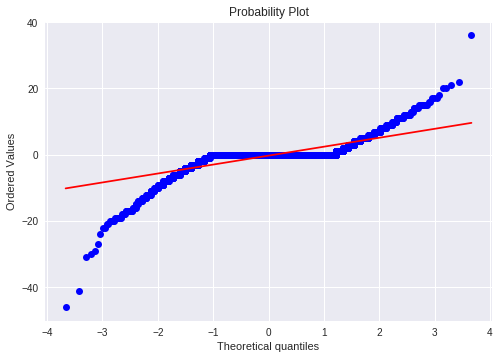

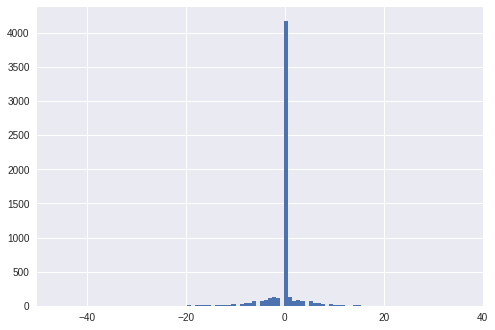

mean=-0.271 stdv=3.552
Statistics=0.577, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2710.637, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


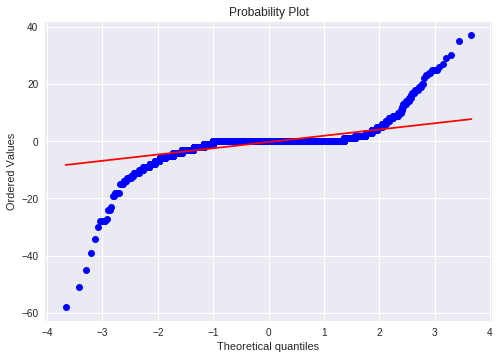

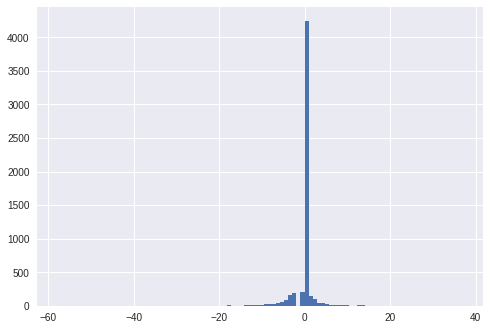

mean=-0.264 stdv=3.293
Statistics=0.442, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3396.853, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


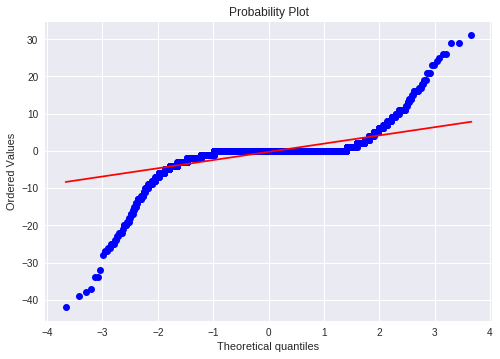

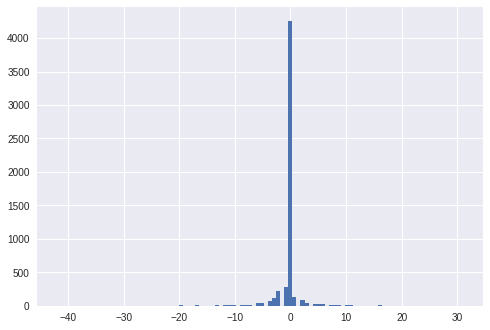

mean=-0.273 stdv=3.330
Statistics=0.440, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3475.454, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.421, p=0.000
Sample does not look Gaussian (reject H0)


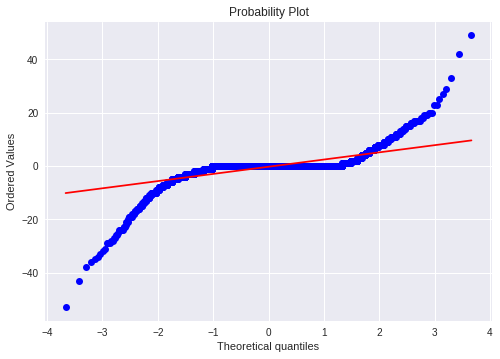

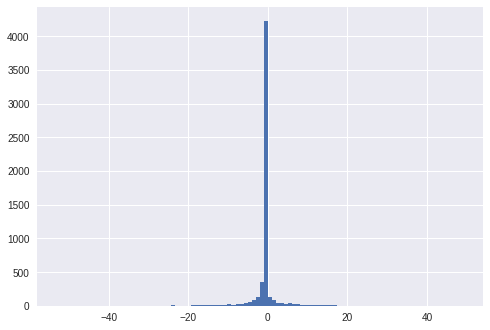

mean=-0.282 stdv=3.892
Statistics=0.481, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2900.745, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


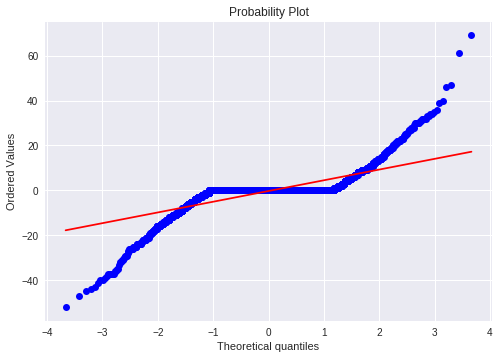

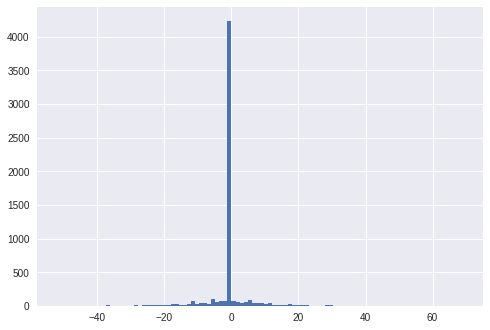

mean=-0.267 stdv=6.305
Statistics=0.574, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1321.456, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


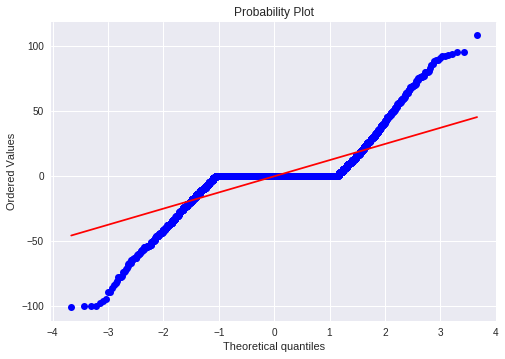

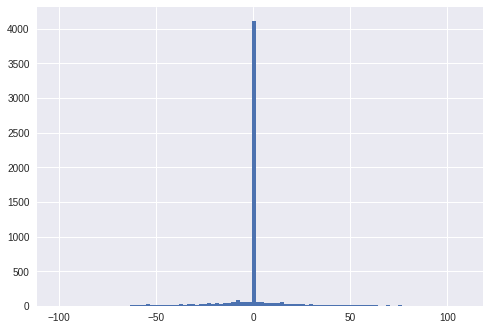

mean=-0.341 stdv=15.961
Statistics=0.606, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1058.076, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


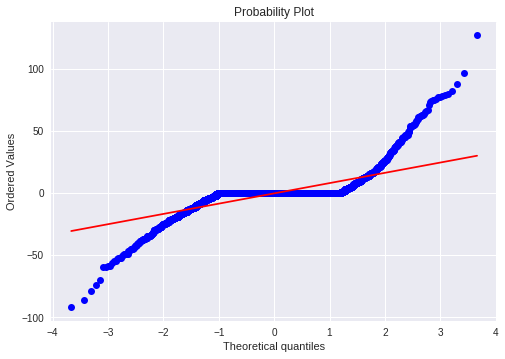

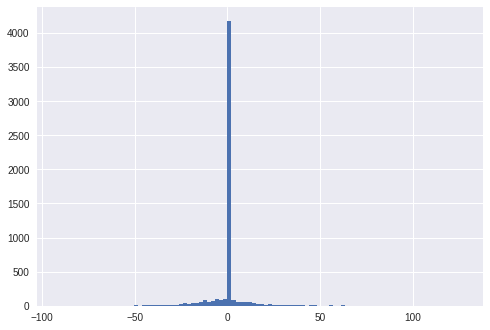

mean=-0.282 stdv=11.095
Statistics=0.557, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2218.668, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


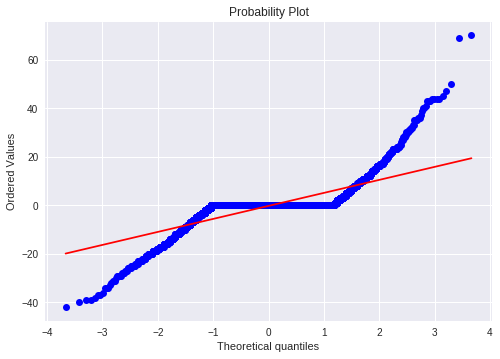

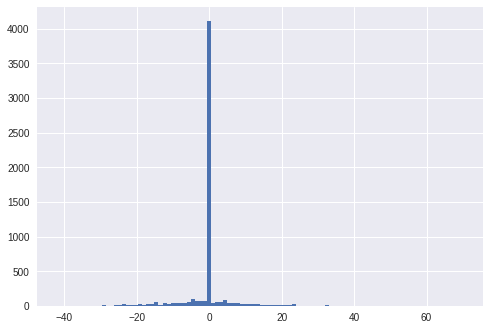

mean=-0.252 stdv=6.893
Statistics=0.605, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1573.625, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


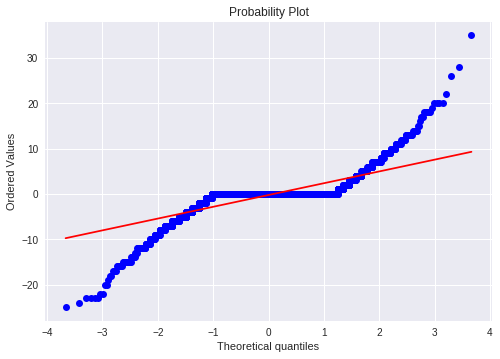

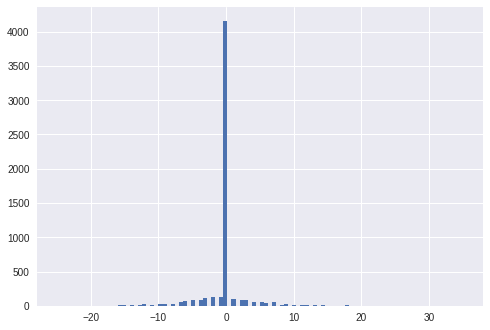

mean=-0.231 stdv=3.352
Statistics=0.603, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1232.639, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


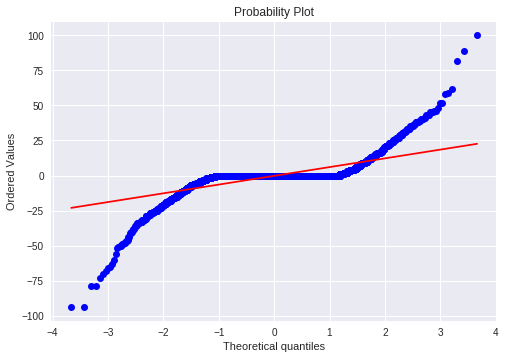

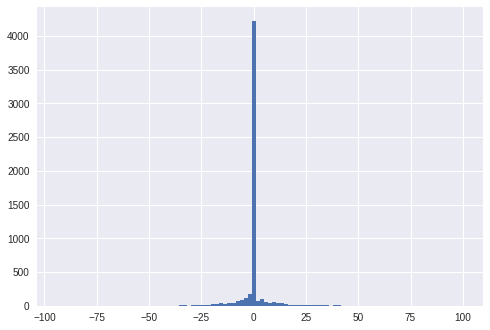

mean=-0.232 stdv=8.667
Statistics=0.519, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1774.699, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


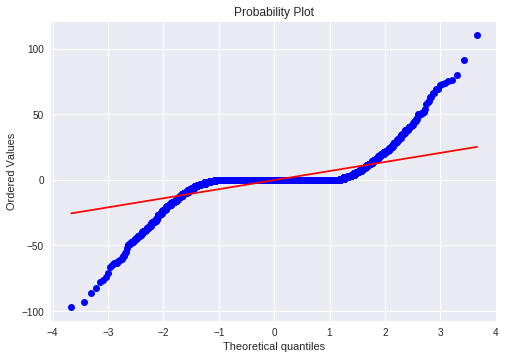

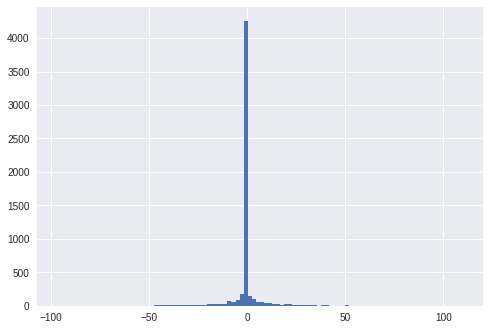

mean=-0.211 stdv=9.906
Statistics=0.487, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1537.765, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


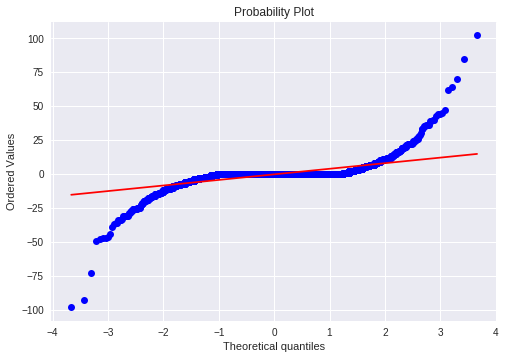

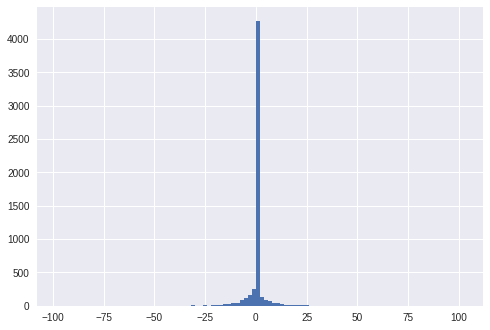

mean=-0.234 stdv=6.127
Statistics=0.449, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2022.936, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


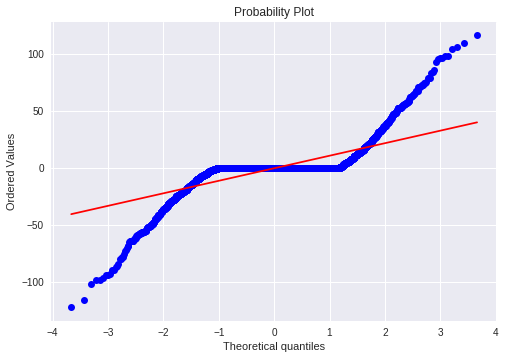

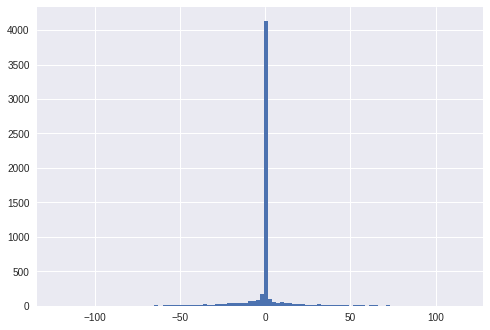

mean=-0.321 stdv=14.716
Statistics=0.556, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1240.910, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


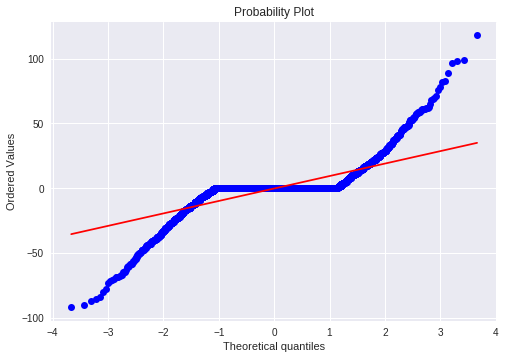

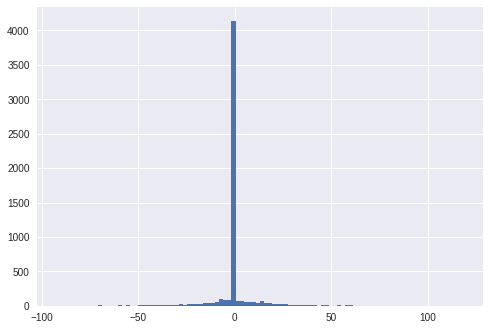

mean=-0.283 stdv=12.630
Statistics=0.581, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1216.094, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


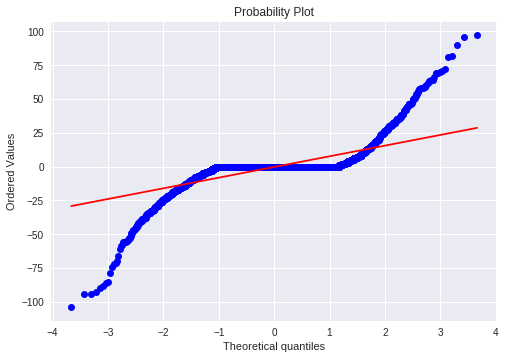

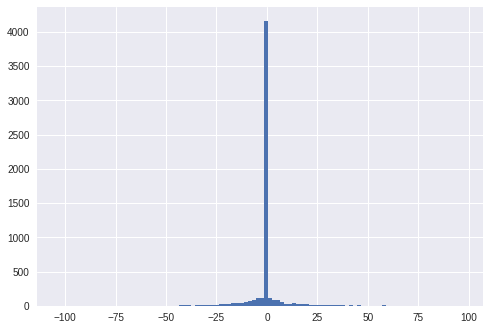

mean=-0.292 stdv=10.857
Statistics=0.529, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1439.424, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


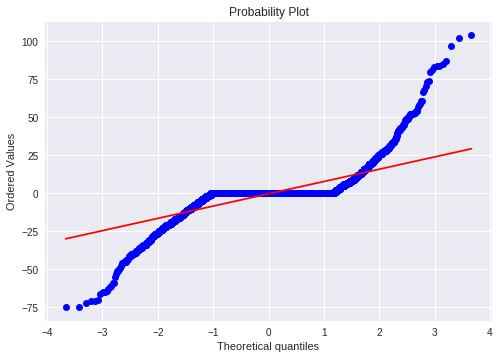

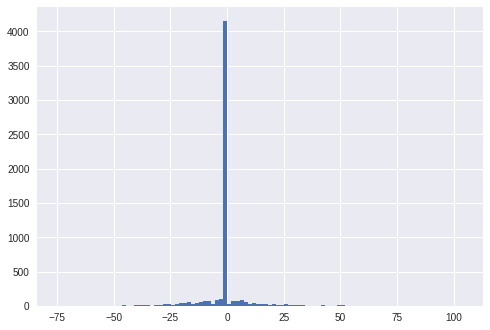

mean=-0.302 stdv=10.773
Statistics=0.565, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1853.435, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


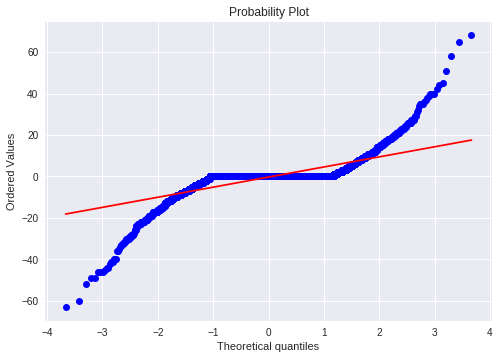

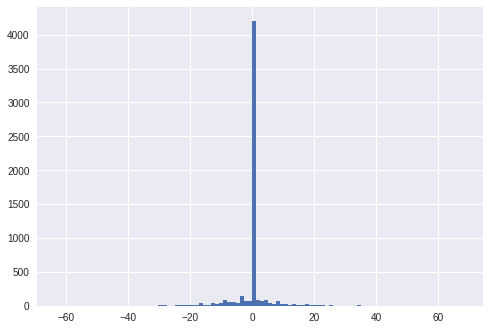

mean=-0.273 stdv=6.519
Statistics=0.558, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1509.605, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


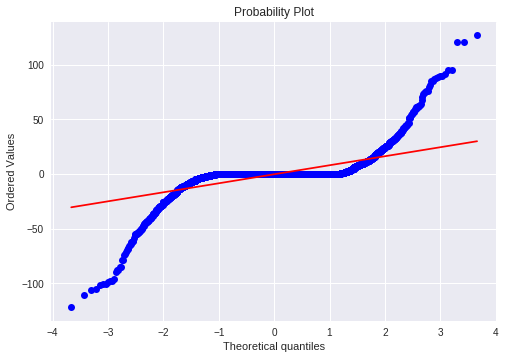

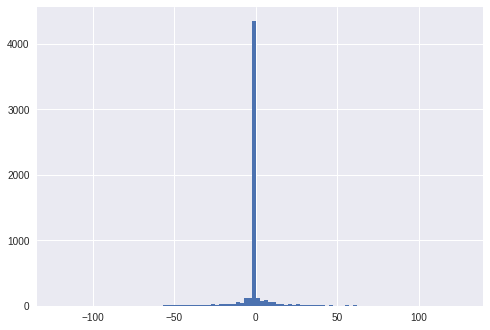

mean=-0.207 stdv=12.261
Statistics=0.454, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1686.453, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


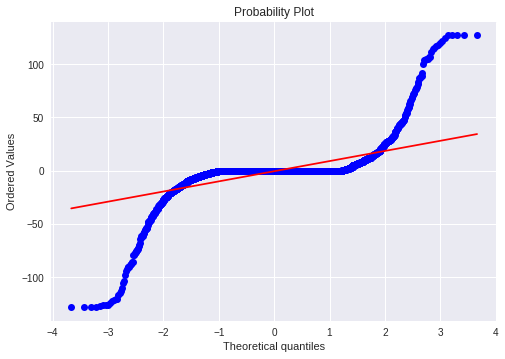

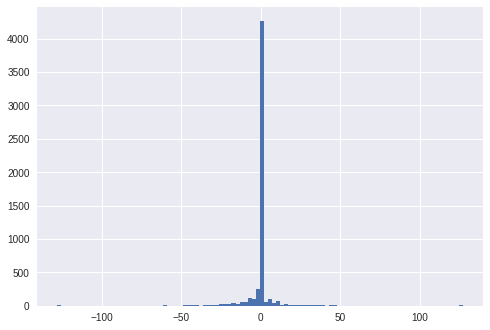

mean=-0.422 stdv=14.837
Statistics=0.412, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1809.402, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


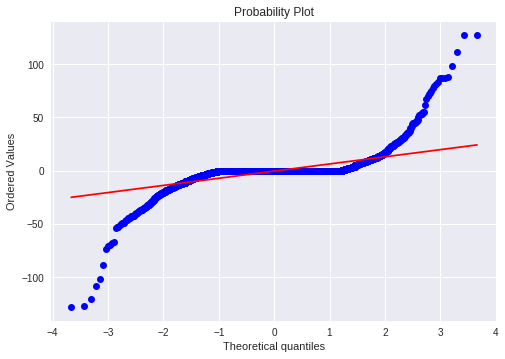

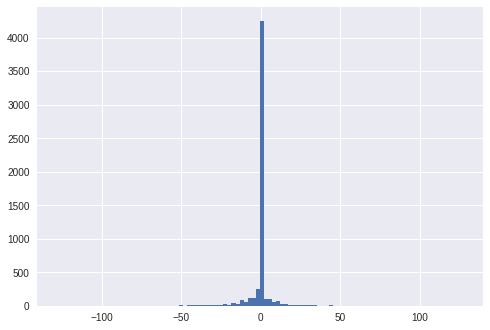

mean=-0.313 stdv=9.992
Statistics=0.452, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1969.039, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


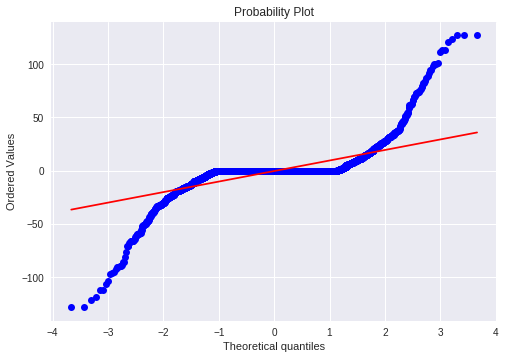

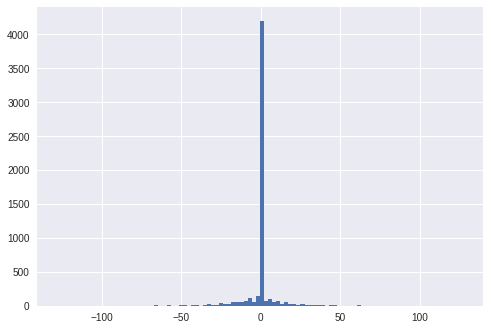

mean=-0.247 stdv=13.931
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1582.968, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


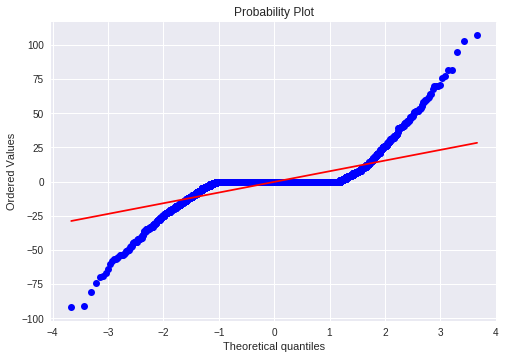

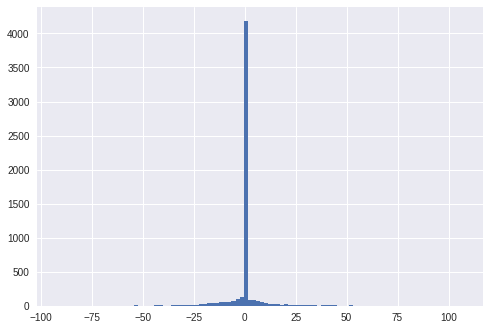

mean=-0.256 stdv=10.641
Statistics=0.539, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1713.145, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


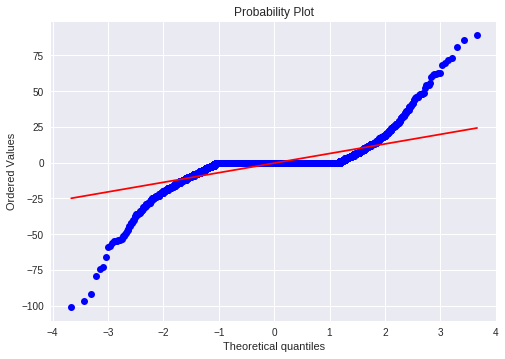

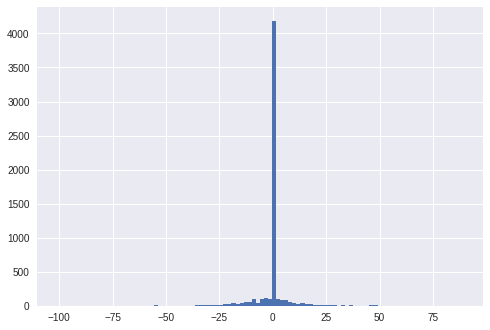

mean=-0.277 stdv=9.191
Statistics=0.533, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1522.632, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


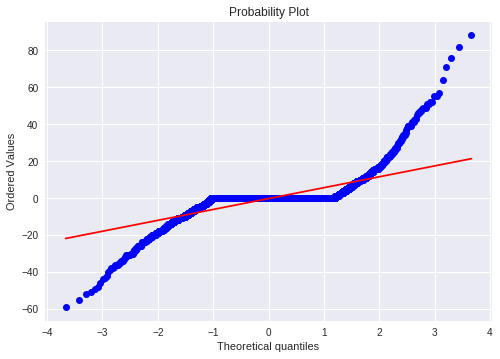

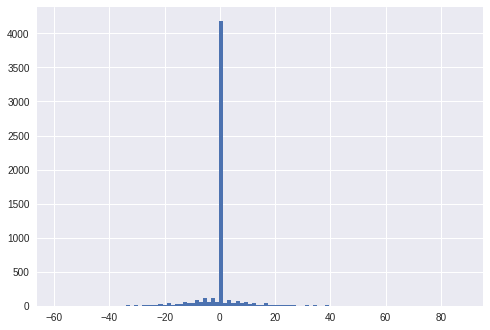

mean=-0.247 stdv=7.825
Statistics=0.567, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2276.212, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


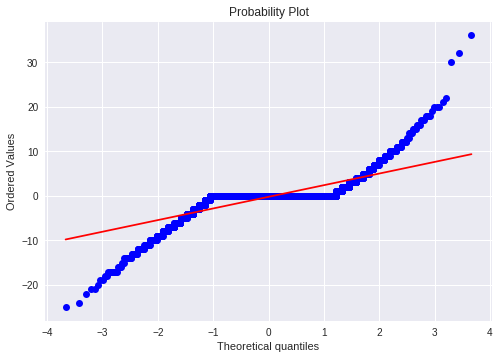

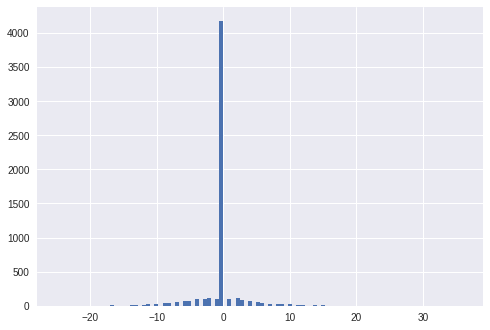

mean=-0.226 stdv=3.365
Statistics=0.603, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1207.952, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


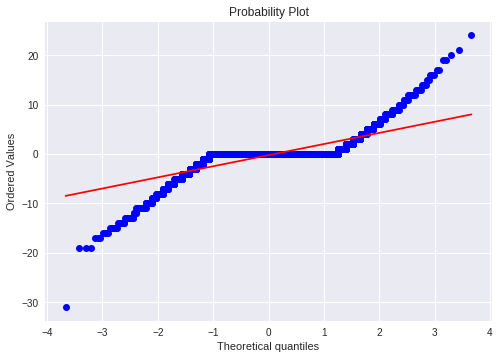

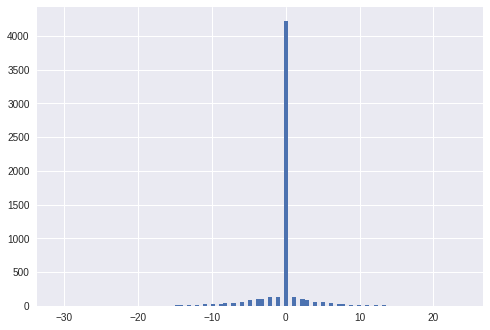

mean=-0.228 stdv=2.921
Statistics=0.594, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1427.407, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


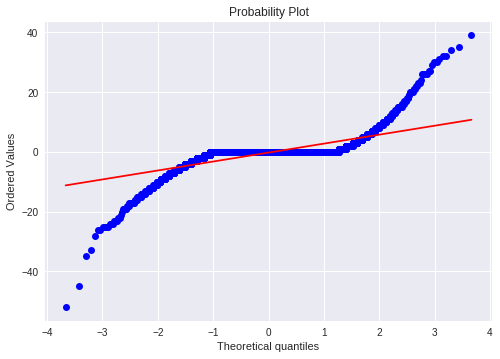

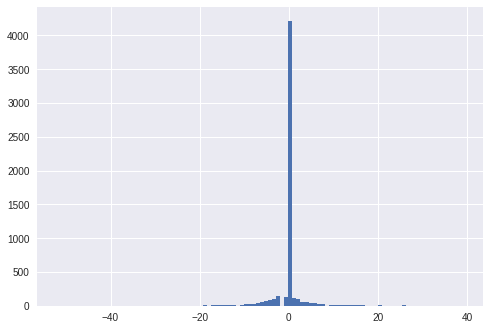

mean=-0.228 stdv=4.134
Statistics=0.527, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1529.370, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


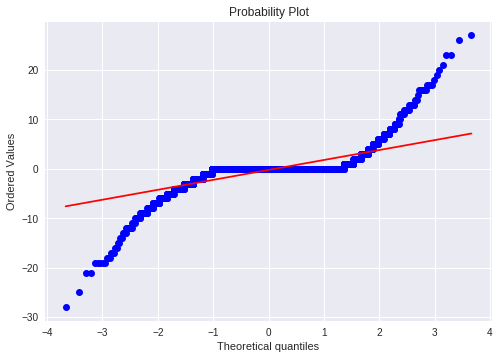

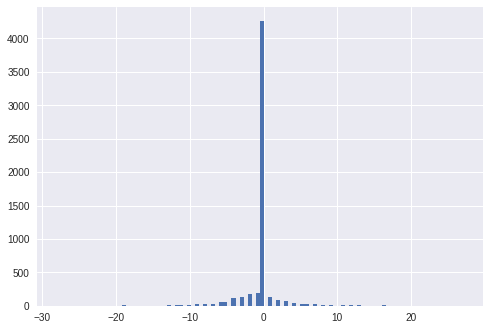

mean=-0.219 stdv=2.749
Statistics=0.536, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1431.075, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


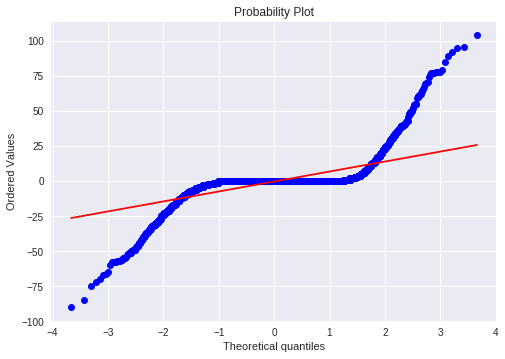

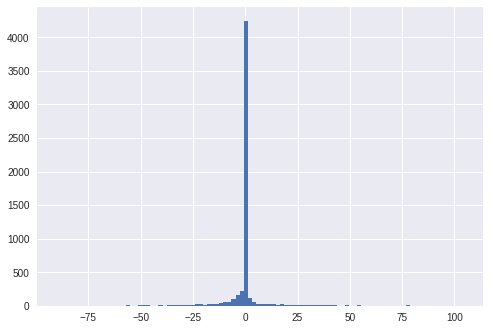

mean=-0.261 stdv=10.454
Statistics=0.464, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2237.794, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.397, p=0.000
Sample does not look Gaussian (reject H0)


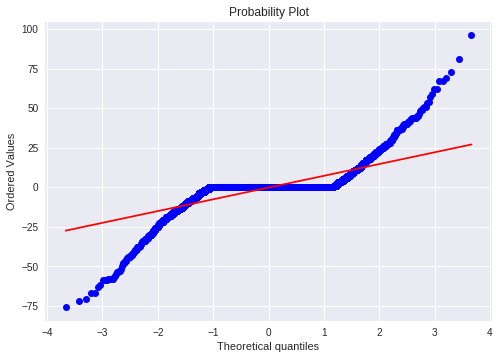

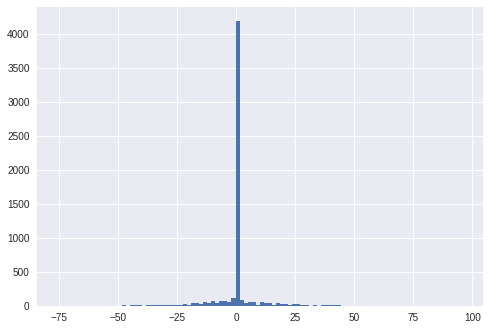

mean=-0.282 stdv=9.858
Statistics=0.570, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1264.964, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


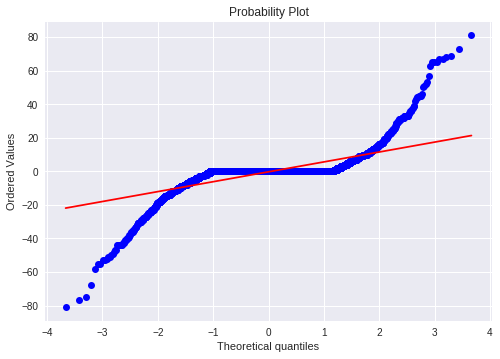

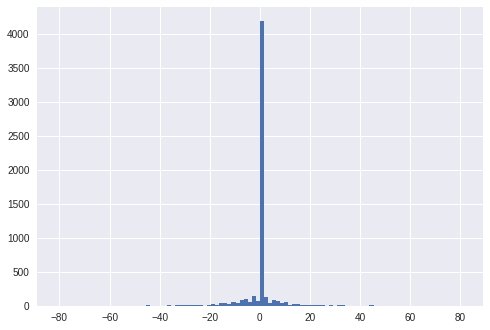

mean=-0.299 stdv=8.178
Statistics=0.521, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1498.509, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


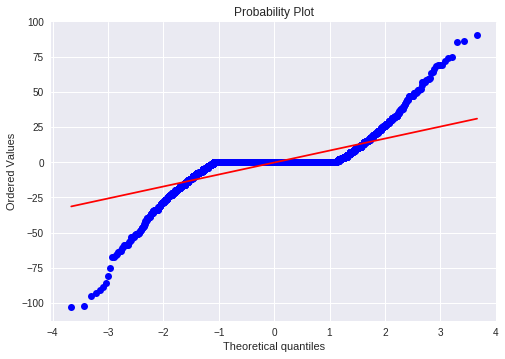

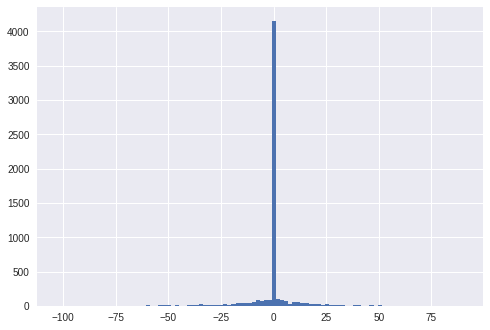

mean=-0.274 stdv=11.375
Statistics=0.559, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1577.482, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.370, p=0.000
Sample does not look Gaussian (reject H0)


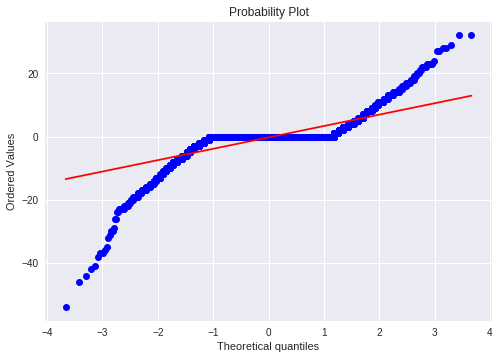

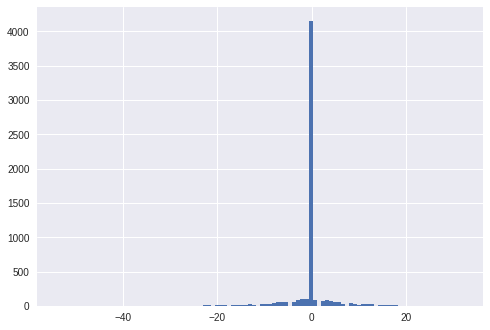

mean=-0.270 stdv=4.751
Statistics=0.575, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2533.437, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


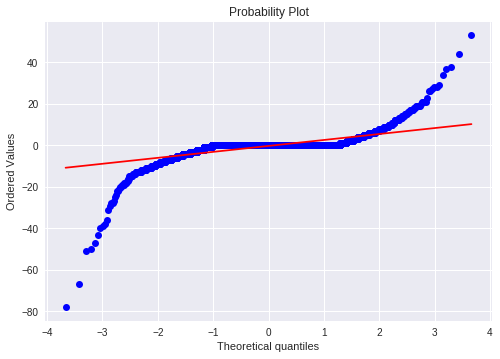

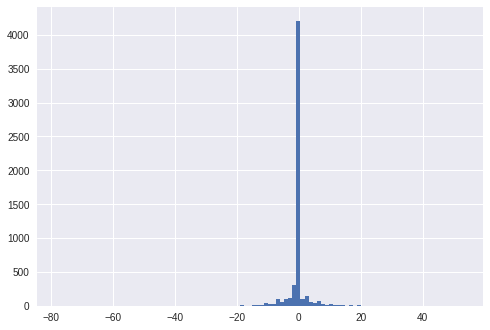

mean=-0.263 stdv=4.197
Statistics=0.468, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4136.947, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)


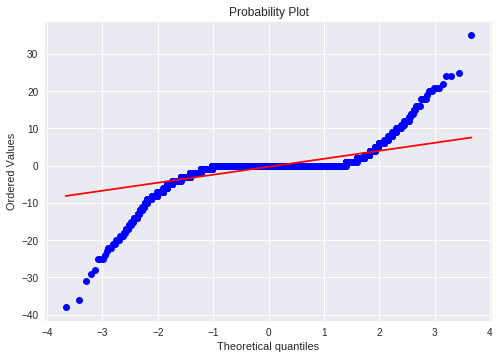

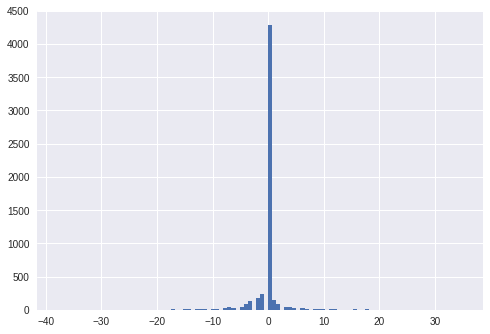

mean=-0.274 stdv=3.117
Statistics=0.474, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2636.566, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.418, p=0.000
Sample does not look Gaussian (reject H0)


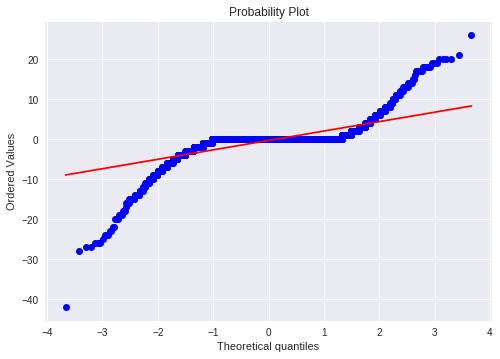

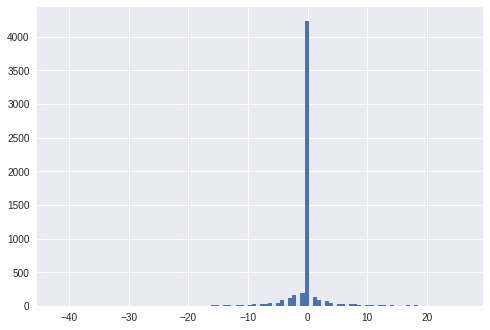

mean=-0.282 stdv=3.268
Statistics=0.520, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2532.389, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


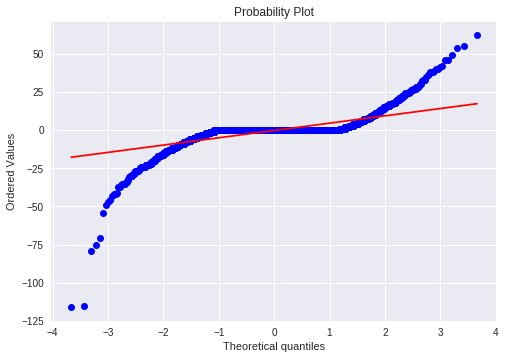

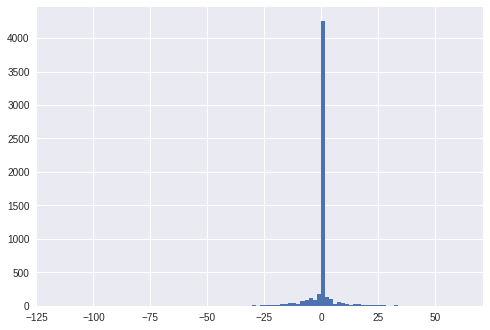

mean=-0.248 stdv=6.788
Statistics=0.498, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3779.027, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


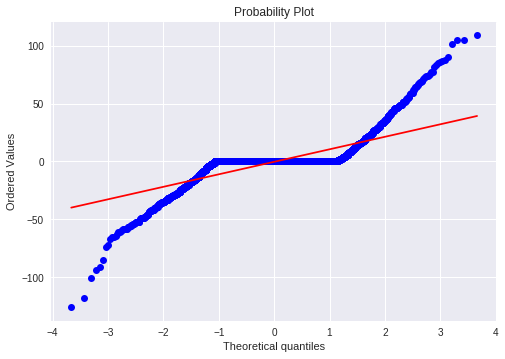

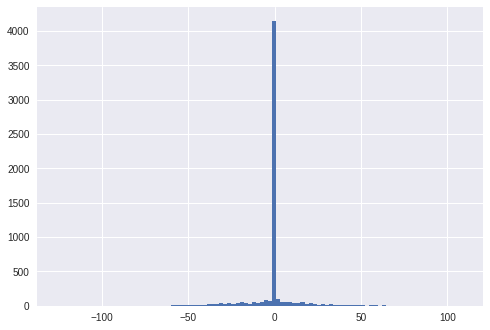

mean=-0.281 stdv=13.998
Statistics=0.597, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1263.252, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


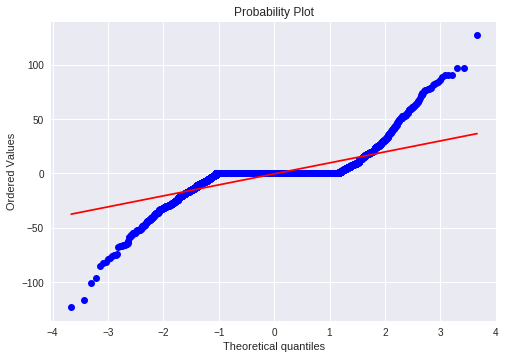

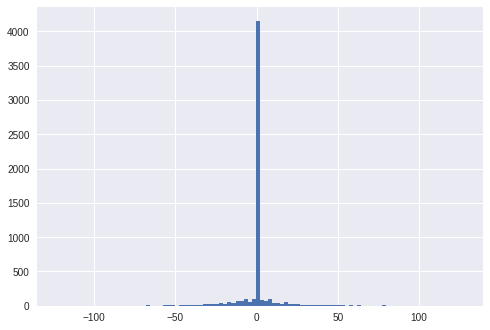

mean=-0.360 stdv=13.427
Statistics=0.567, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1406.428, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


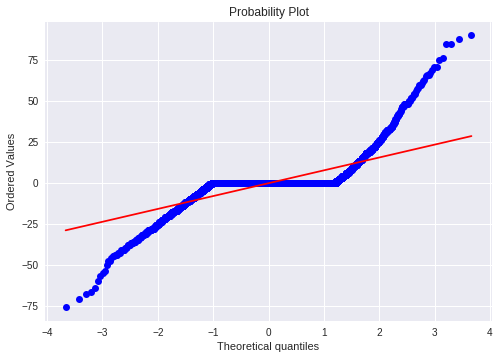

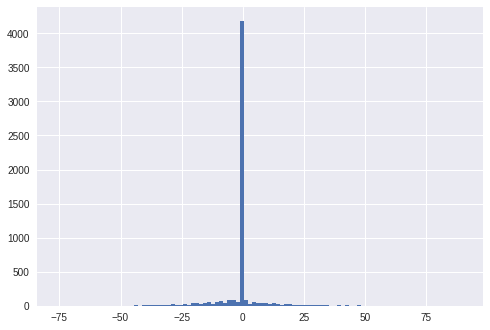

mean=-0.265 stdv=10.348
Statistics=0.576, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1949.658, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


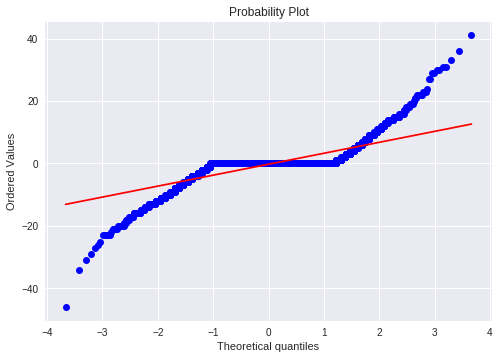

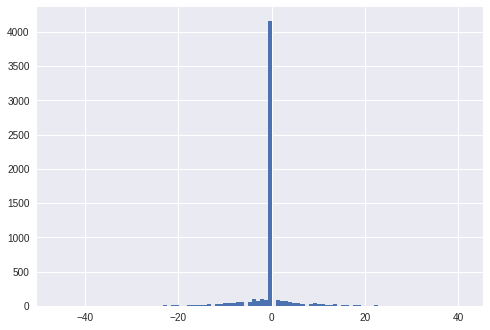

mean=-0.231 stdv=4.521
Statistics=0.602, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1188.004, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


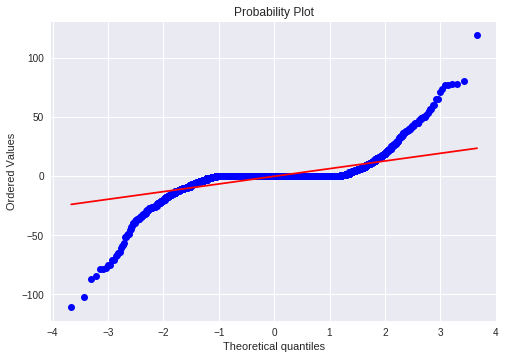

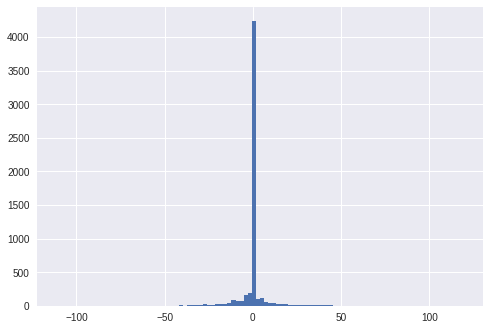

mean=-0.227 stdv=9.402
Statistics=0.476, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1699.618, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


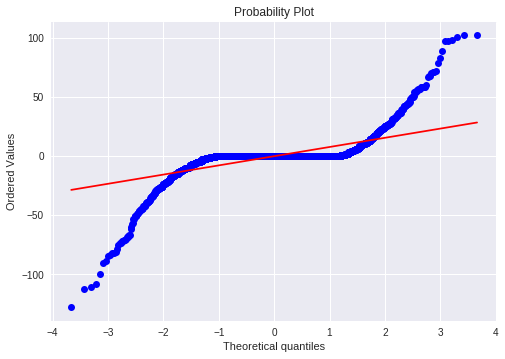

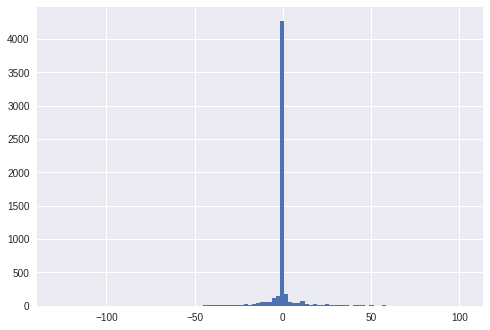

mean=-0.206 stdv=11.382
Statistics=0.468, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1850.256, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


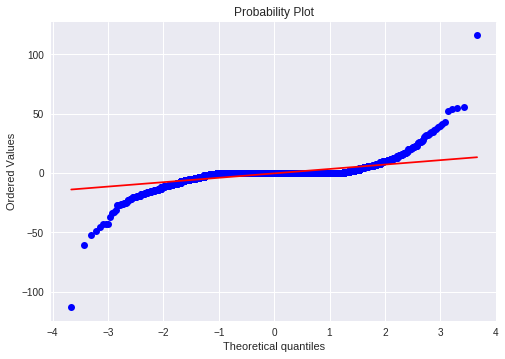

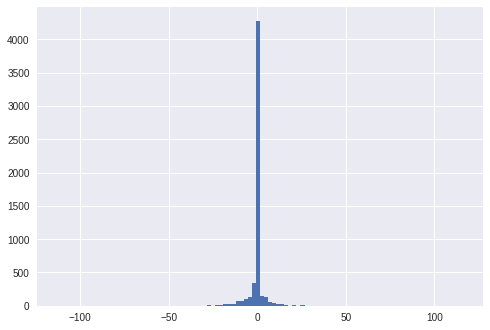

mean=-0.237 stdv=5.485
Statistics=0.460, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2287.368, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


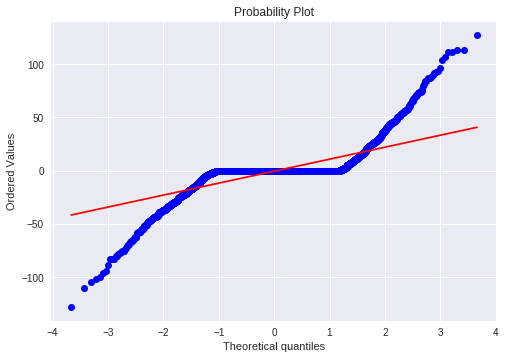

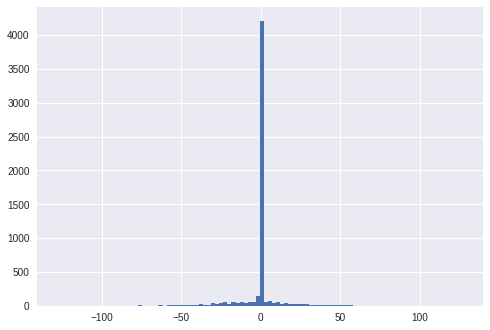

mean=-0.340 stdv=14.997
Statistics=0.561, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1357.164, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


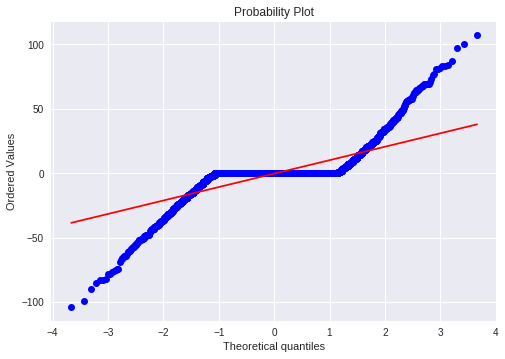

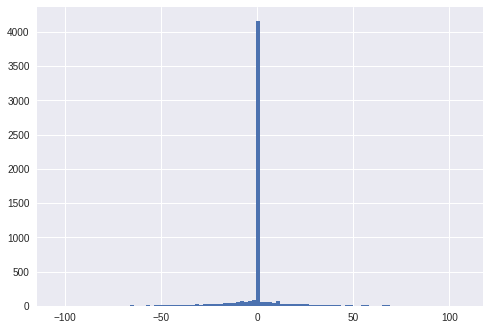

mean=-0.291 stdv=13.648
Statistics=0.584, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1150.896, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


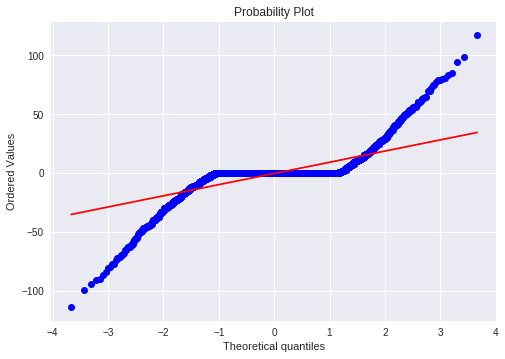

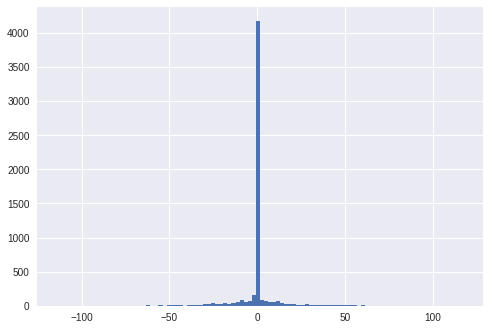

mean=-0.311 stdv=12.776
Statistics=0.554, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1284.579, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


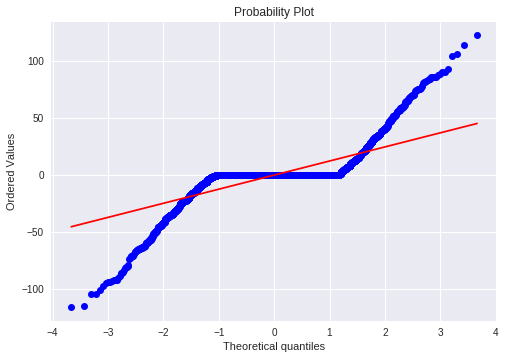

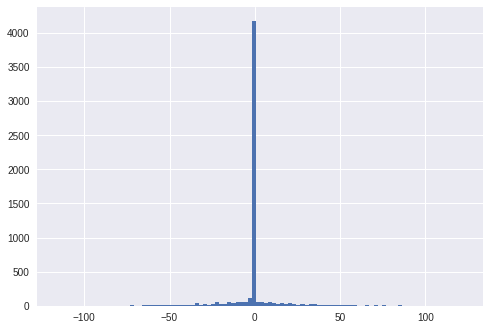

mean=-0.326 stdv=16.240
Statistics=0.577, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1124.151, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.381, p=0.000
Sample does not look Gaussian (reject H0)


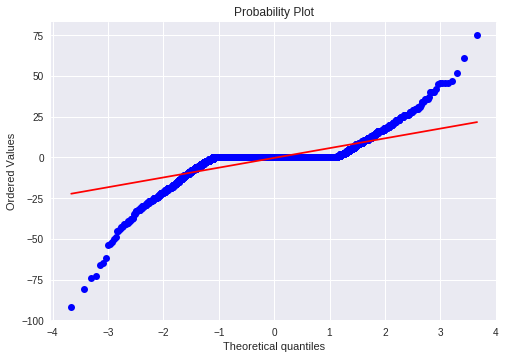

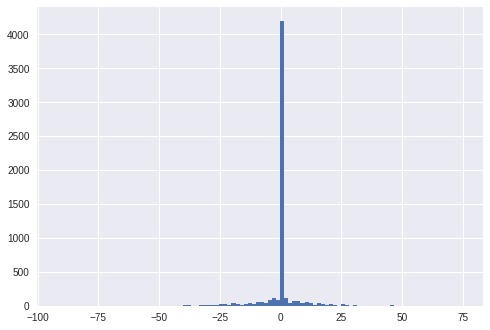

mean=-0.263 stdv=7.980
Statistics=0.567, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2232.500, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


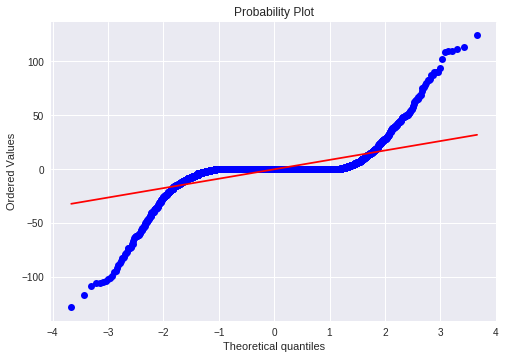

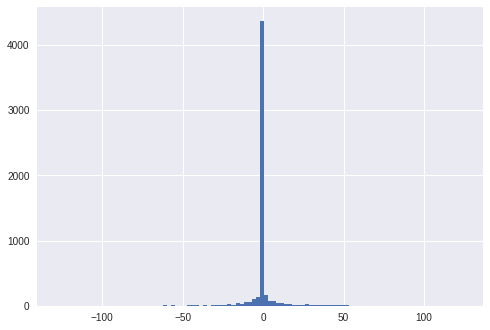

mean=-0.139 stdv=13.068
Statistics=0.446, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1630.373, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


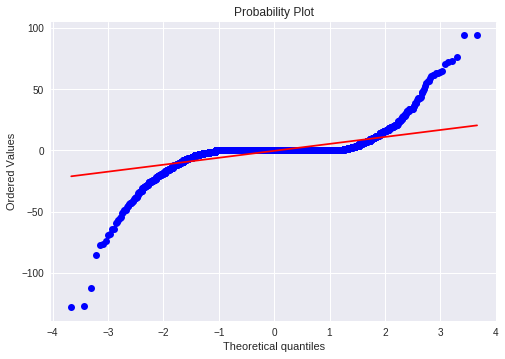

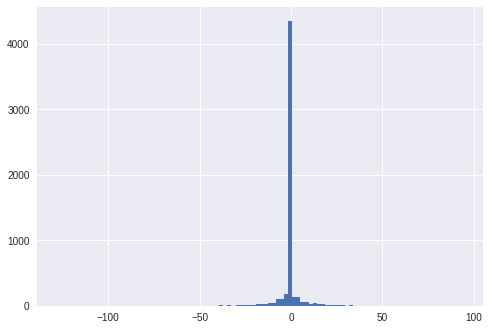

mean=-0.273 stdv=8.651
Statistics=0.431, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2720.852, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


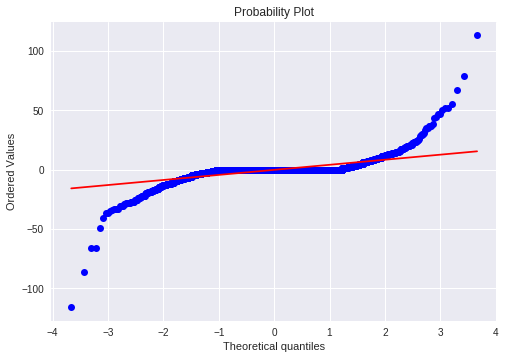

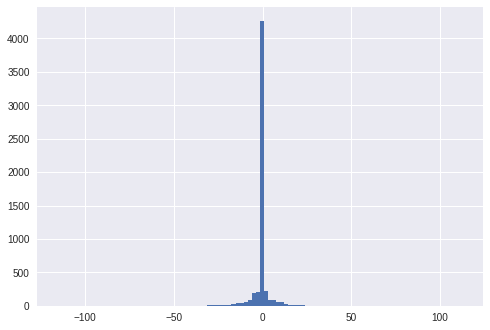

mean=-0.267 stdv=6.207
Statistics=0.473, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2060.408, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


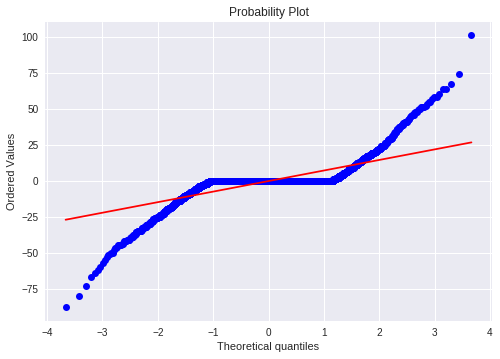

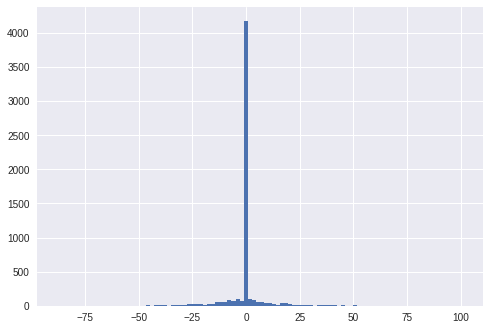

mean=-0.280 stdv=9.675
Statistics=0.576, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1251.486, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


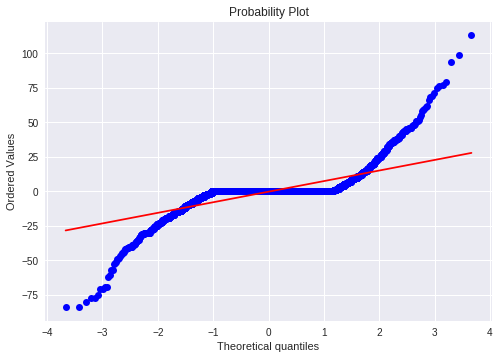

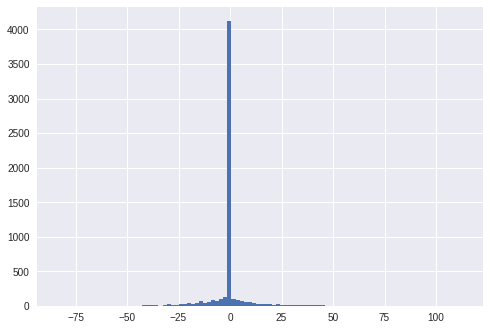

mean=-0.262 stdv=10.284
Statistics=0.557, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1664.361, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


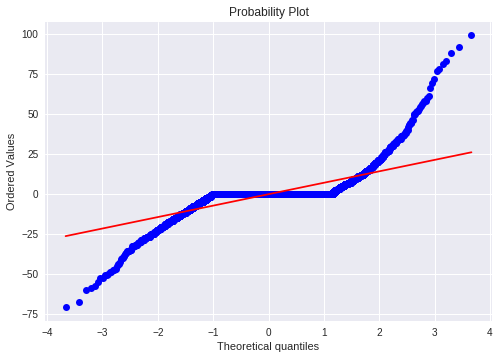

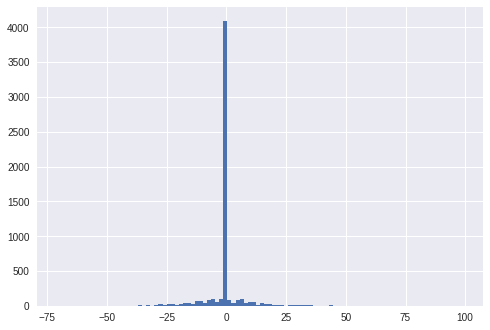

mean=-0.315 stdv=9.390
Statistics=0.581, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2122.589, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.378, p=0.000
Sample does not look Gaussian (reject H0)


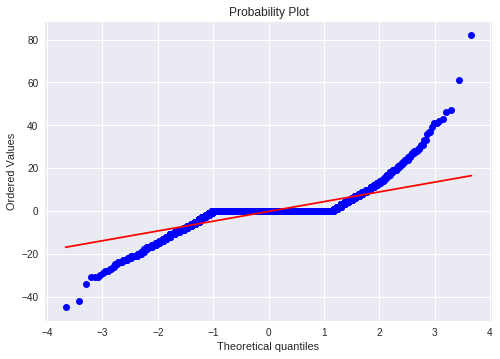

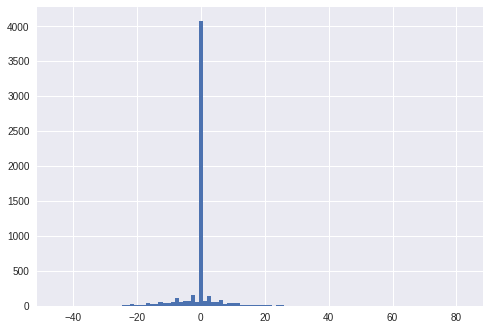

mean=-0.250 stdv=5.866
Statistics=0.606, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2111.278, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


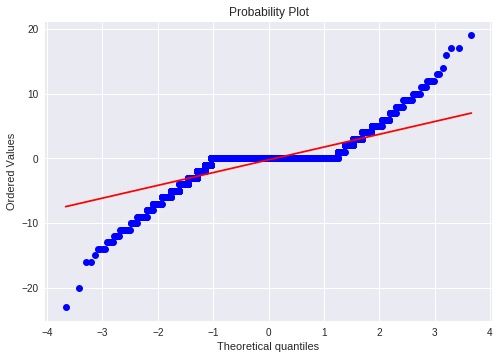

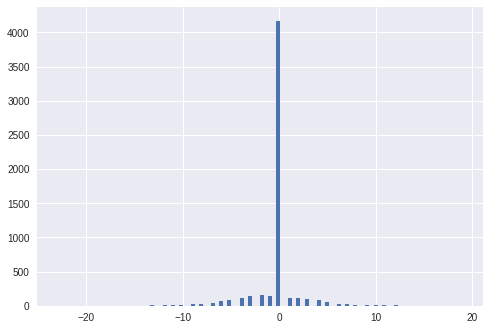

mean=-0.227 stdv=2.483
Statistics=0.632, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1390.367, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


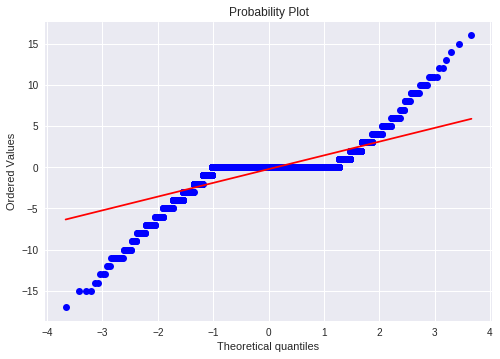

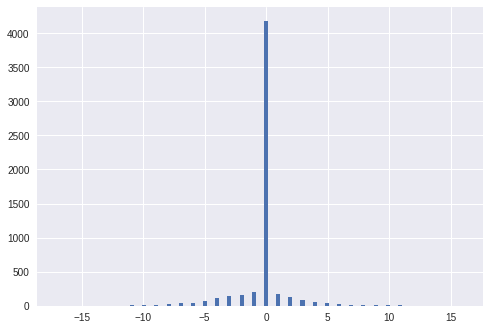

mean=-0.237 stdv=2.131
Statistics=0.613, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1591.127, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


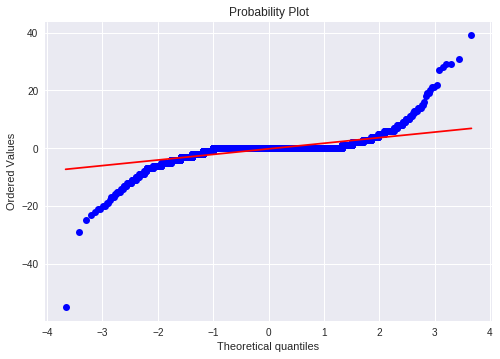

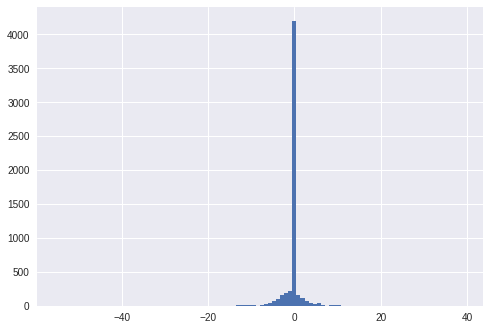

mean=-0.231 stdv=2.769
Statistics=0.488, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2349.414, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


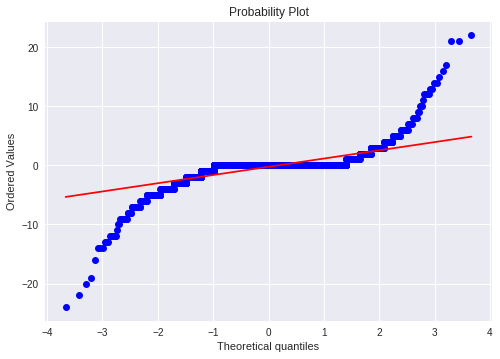

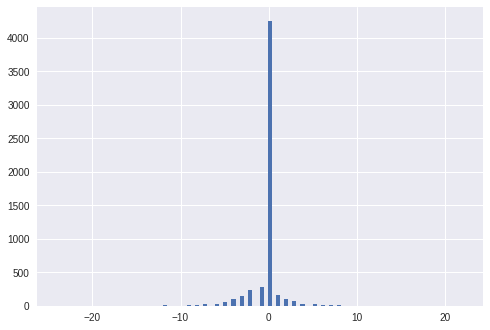

mean=-0.233 stdv=1.909
Statistics=0.533, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1871.465, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.420, p=0.000
Sample does not look Gaussian (reject H0)


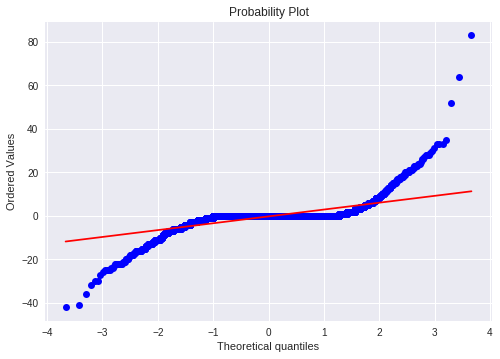

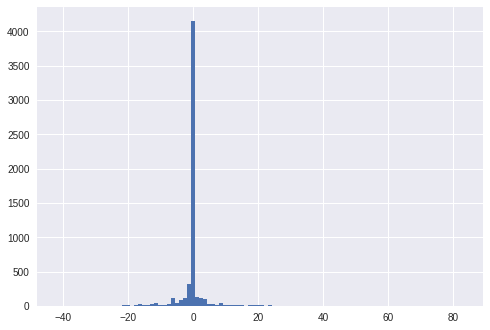

mean=-0.237 stdv=4.490
Statistics=0.494, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3368.217, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


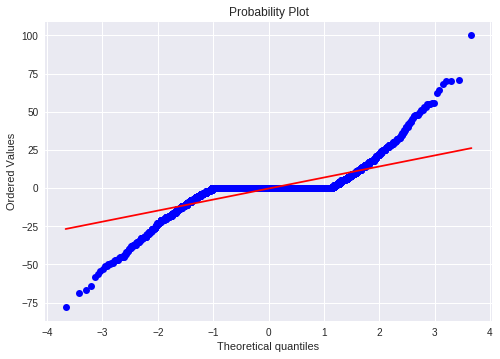

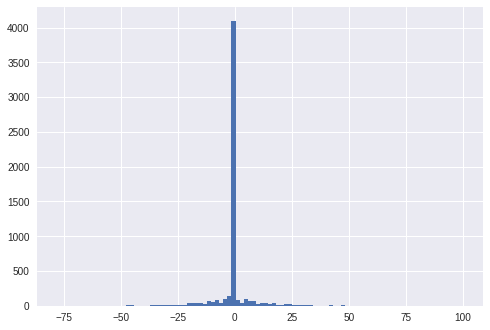

mean=-0.292 stdv=9.425
Statistics=0.588, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1289.274, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


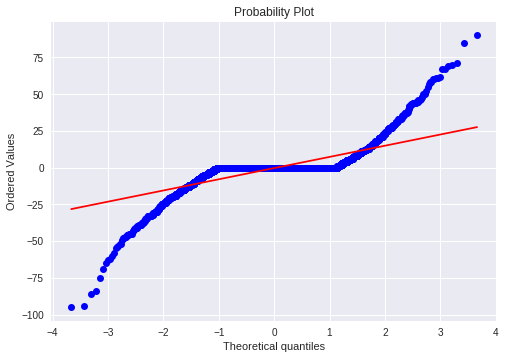

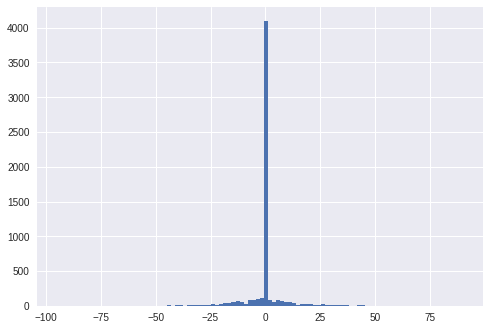

mean=-0.313 stdv=10.030
Statistics=0.577, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1330.334, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


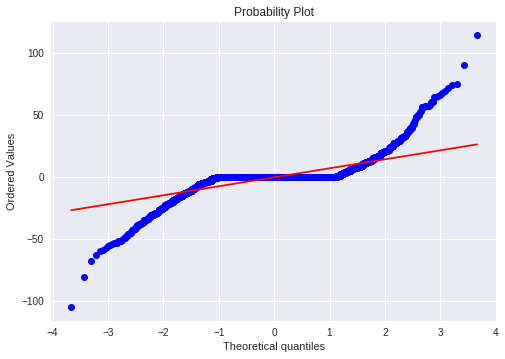

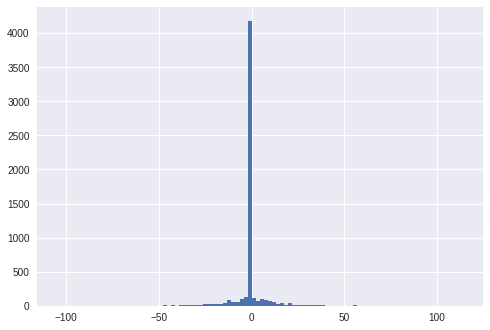

mean=-0.312 stdv=9.705
Statistics=0.557, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1513.991, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.372, p=0.000
Sample does not look Gaussian (reject H0)


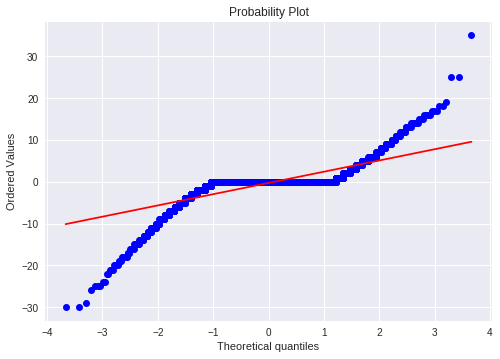

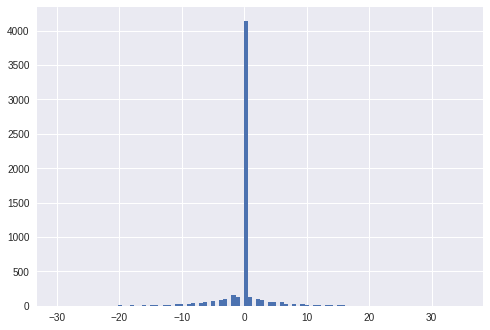

mean=-0.283 stdv=3.522
Statistics=0.583, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2064.613, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


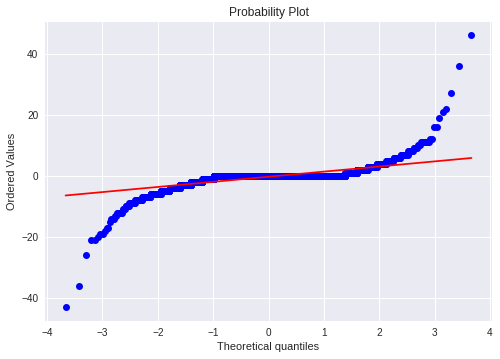

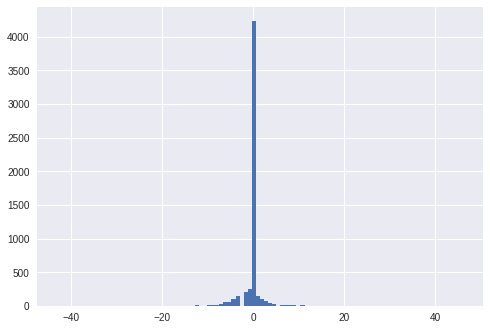

mean=-0.275 stdv=2.413
Statistics=0.483, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2203.804, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


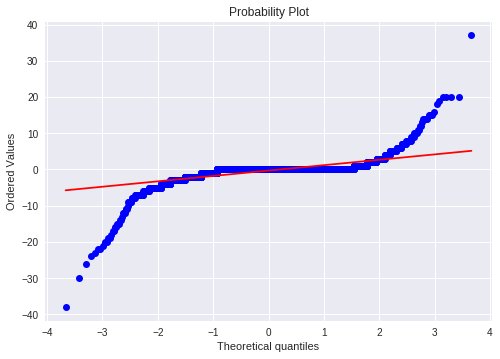

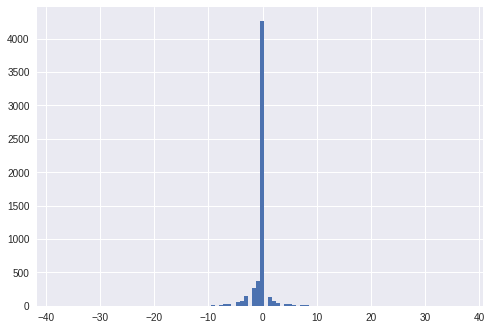

mean=-0.293 stdv=2.245
Statistics=0.440, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3253.579, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.438, p=0.000
Sample does not look Gaussian (reject H0)


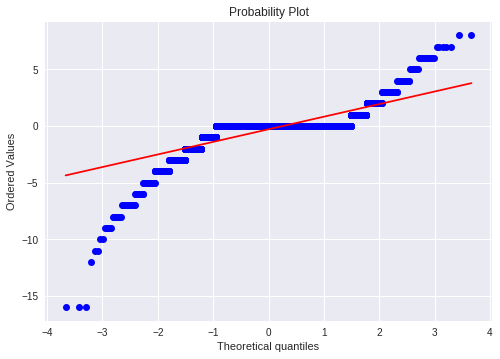

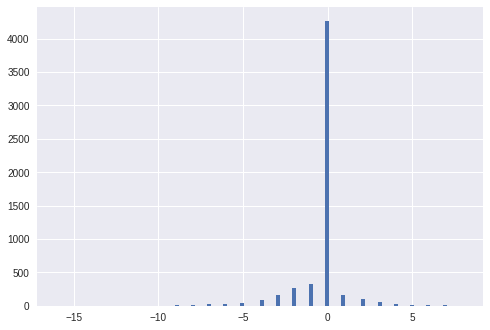

mean=-0.289 stdv=1.450
Statistics=0.588, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3060.295, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.432, p=0.000
Sample does not look Gaussian (reject H0)


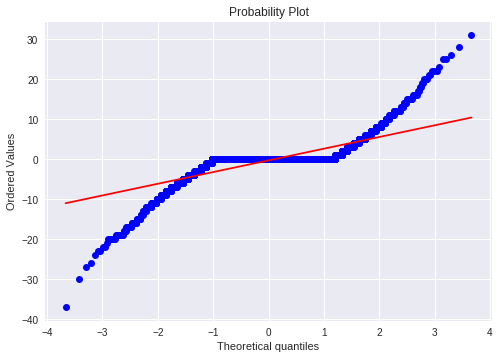

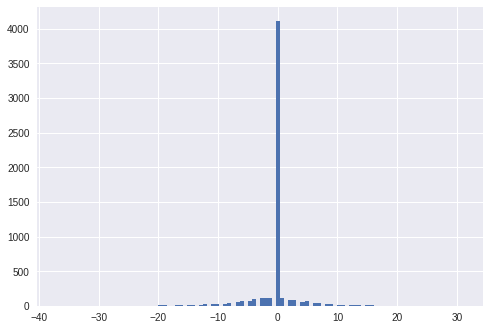

mean=-0.267 stdv=3.768
Statistics=0.603, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1413.237, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.386, p=0.000
Sample does not look Gaussian (reject H0)


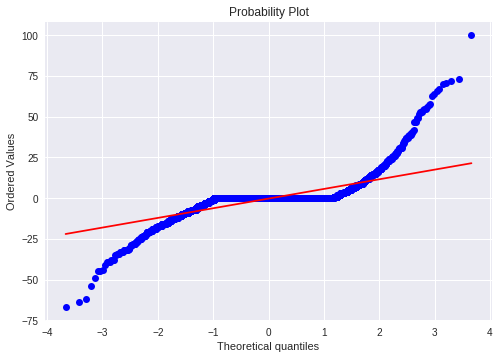

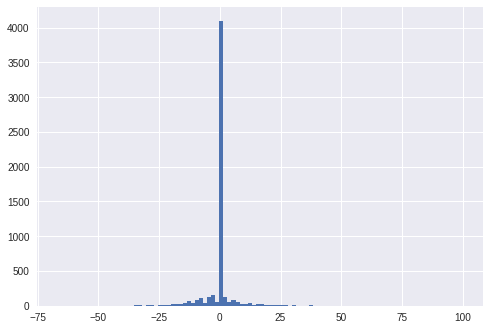

mean=-0.267 stdv=7.945
Statistics=0.558, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2735.243, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


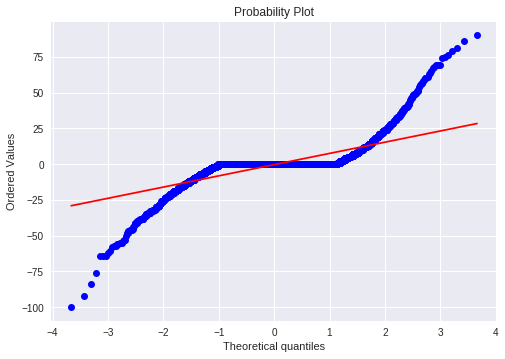

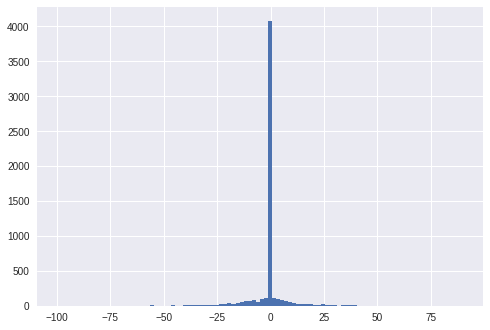

mean=-0.327 stdv=10.402
Statistics=0.569, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1420.399, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


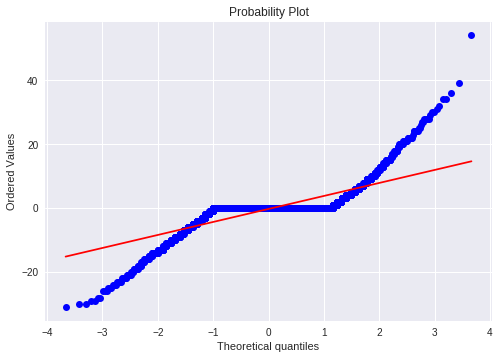

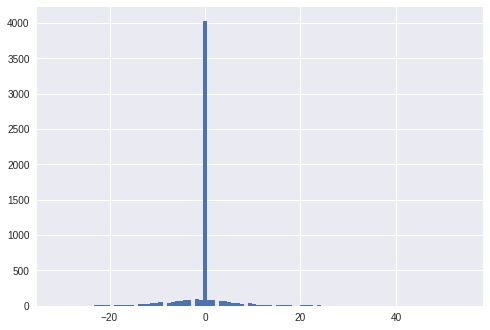

mean=-0.271 stdv=5.137
Statistics=0.627, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1239.360, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


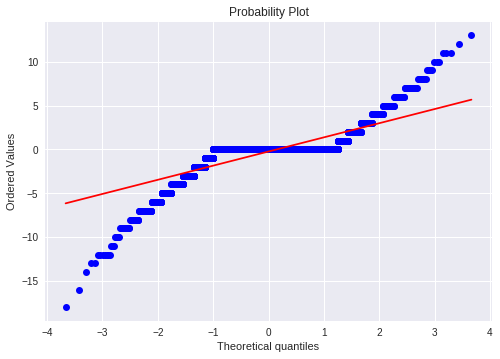

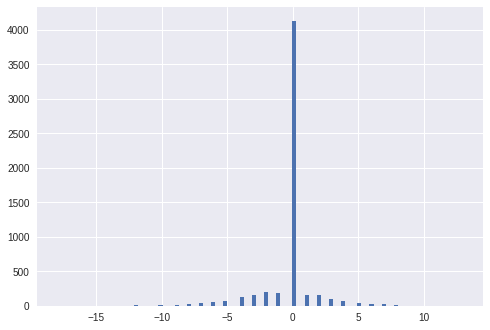

mean=-0.241 stdv=2.010
Statistics=0.645, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1699.459, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


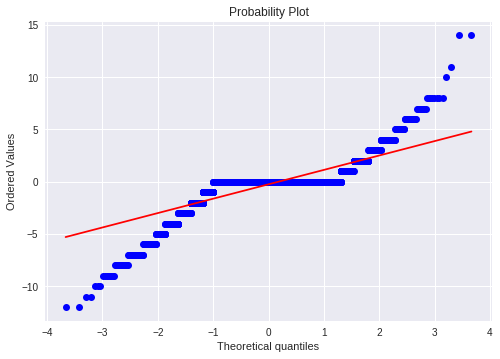

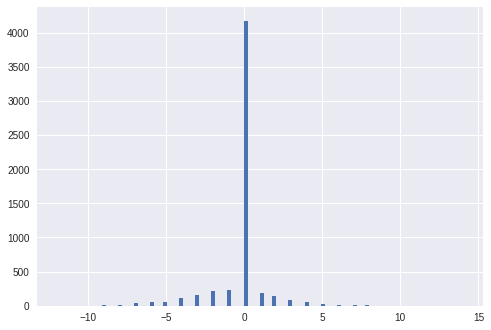

mean=-0.241 stdv=1.727
Statistics=0.636, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1526.759, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


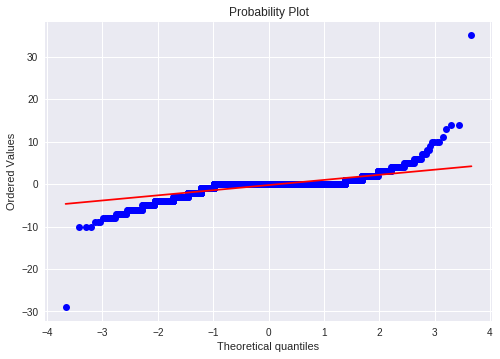

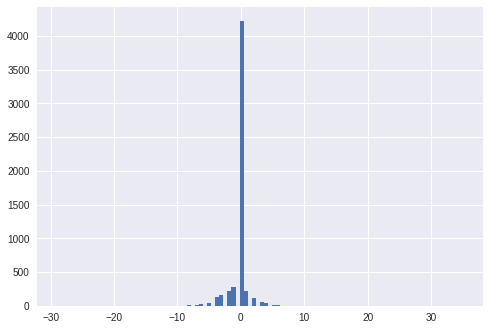

mean=-0.241 stdv=1.615
Statistics=0.562, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2231.116, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.416, p=0.000
Sample does not look Gaussian (reject H0)


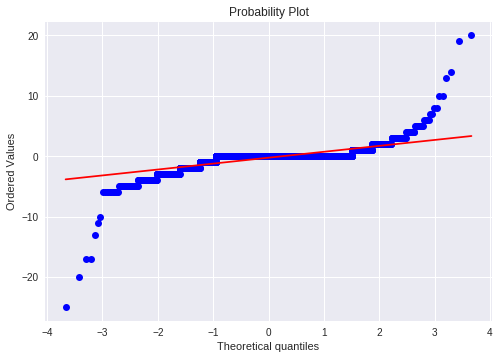

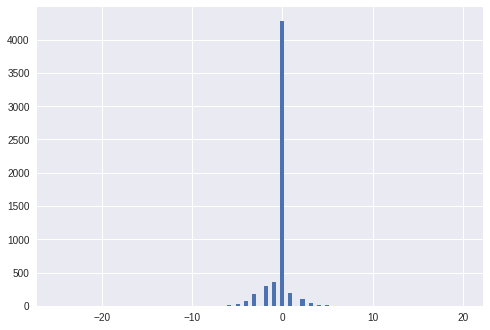

mean=-0.245 stdv=1.352
Statistics=0.526, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3155.672, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.434, p=0.000
Sample does not look Gaussian (reject H0)


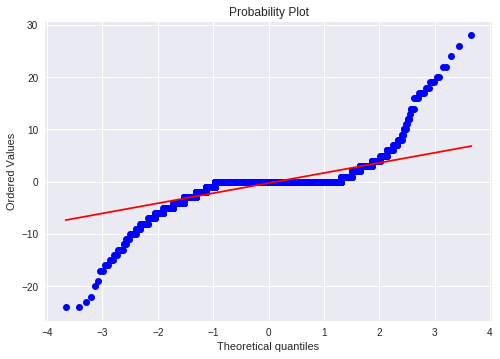

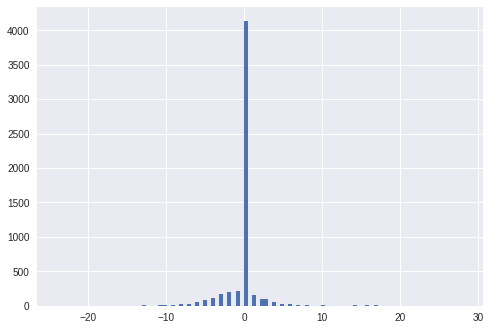

mean=-0.251 stdv=2.602
Statistics=0.553, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1742.103, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


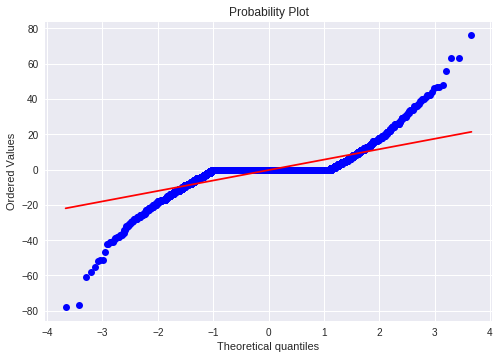

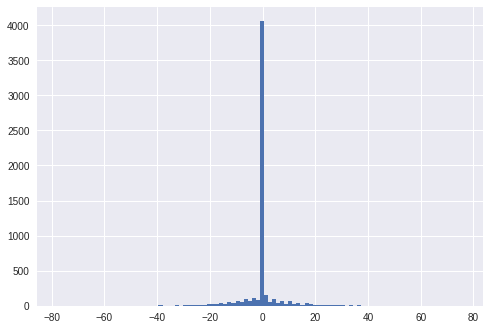

mean=-0.301 stdv=7.657
Statistics=0.597, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1346.853, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.370, p=0.000
Sample does not look Gaussian (reject H0)


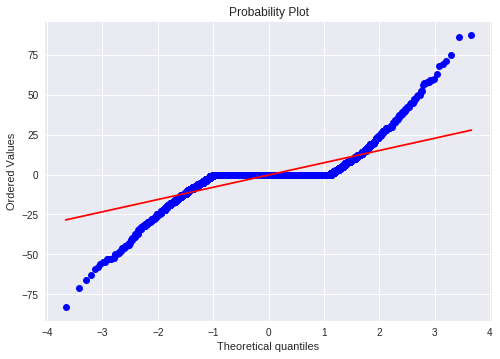

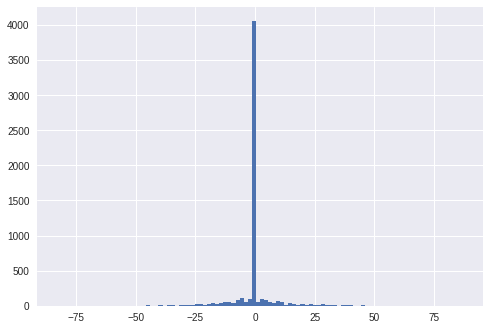

mean=-0.319 stdv=9.903
Statistics=0.600, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1247.670, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.370, p=0.000
Sample does not look Gaussian (reject H0)


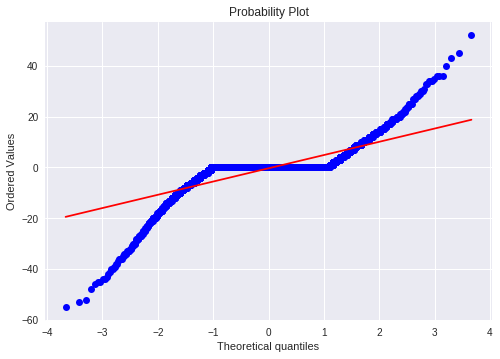

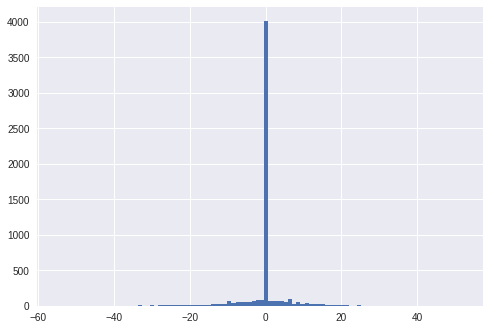

mean=-0.313 stdv=6.698
Statistics=0.607, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1958.767, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.365, p=0.000
Sample does not look Gaussian (reject H0)


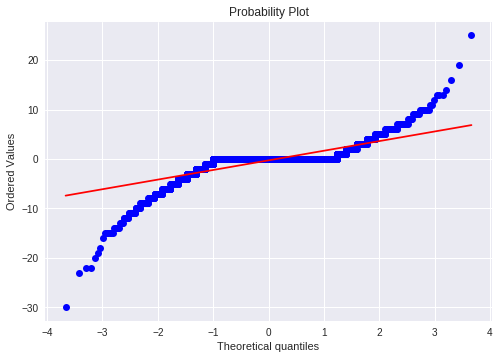

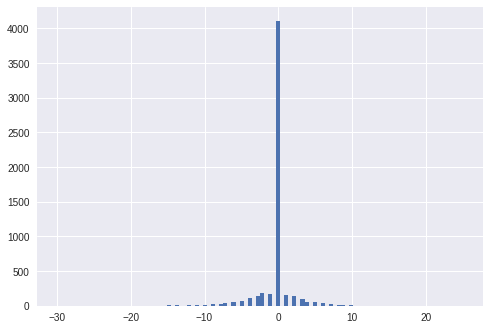

mean=-0.284 stdv=2.499
Statistics=0.608, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2551.154, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


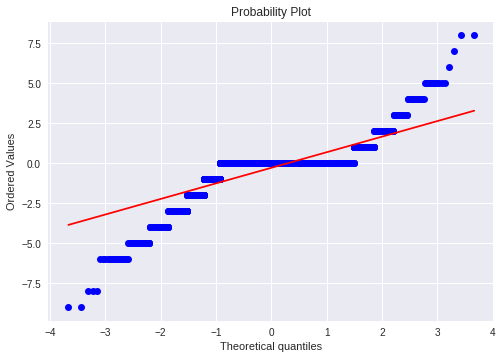

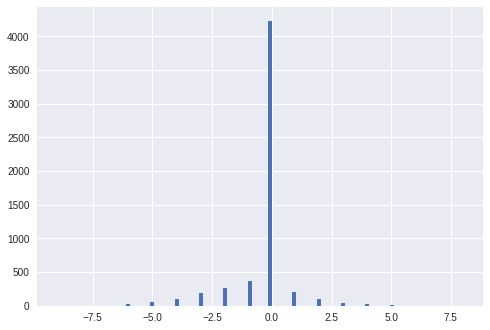

mean=-0.281 stdv=1.229
Statistics=0.629, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1881.983, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.432, p=0.000
Sample does not look Gaussian (reject H0)


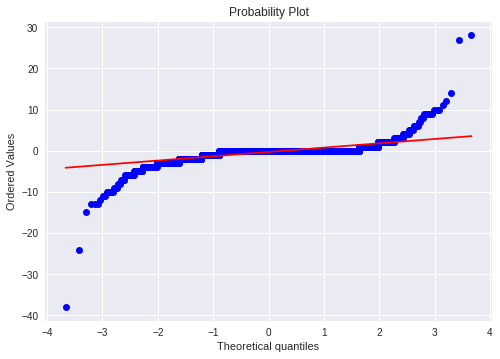

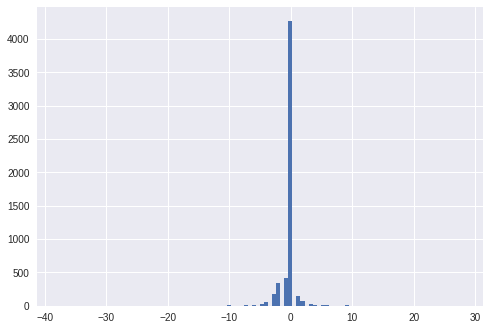

mean=-0.297 stdv=1.552
Statistics=0.458, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3801.396, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.449, p=0.000
Sample does not look Gaussian (reject H0)


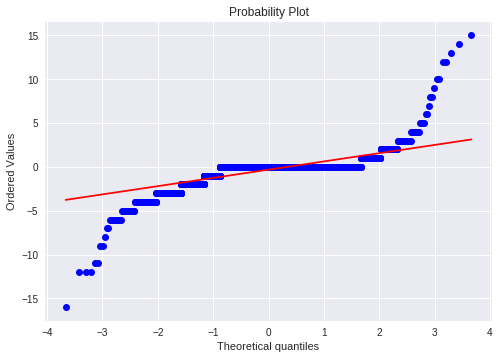

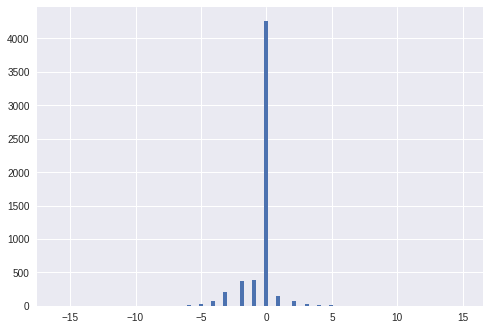

mean=-0.312 stdv=1.256
Statistics=0.562, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1802.899, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.452, p=0.000
Sample does not look Gaussian (reject H0)


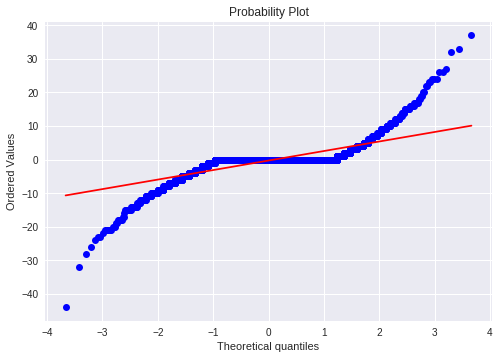

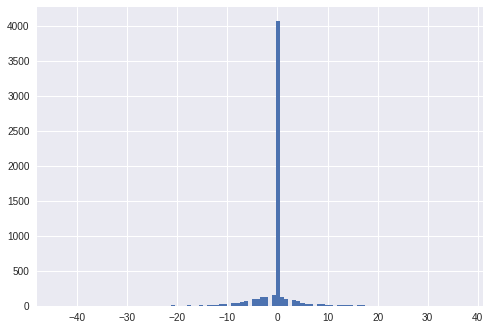

mean=-0.291 stdv=3.691
Statistics=0.592, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1367.335, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


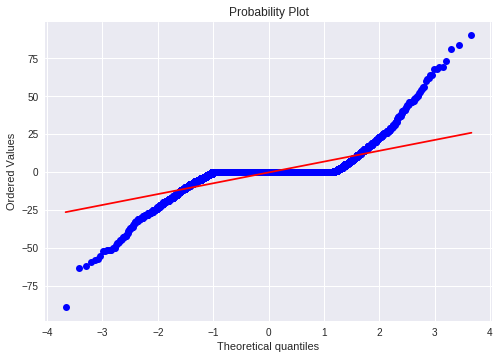

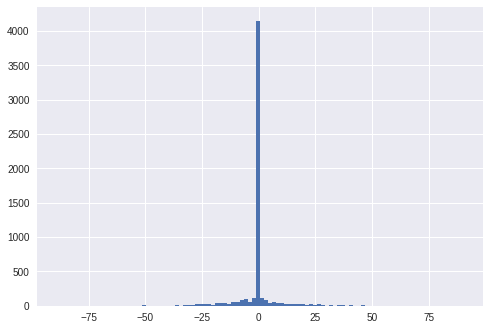

mean=-0.256 stdv=9.468
Statistics=0.568, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1669.290, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


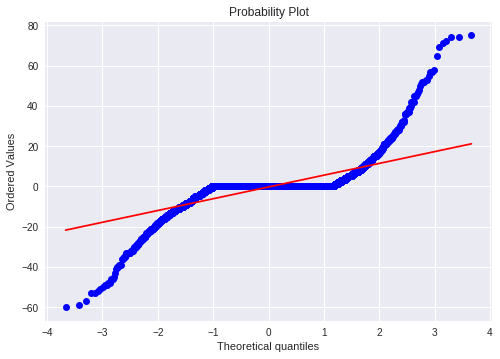

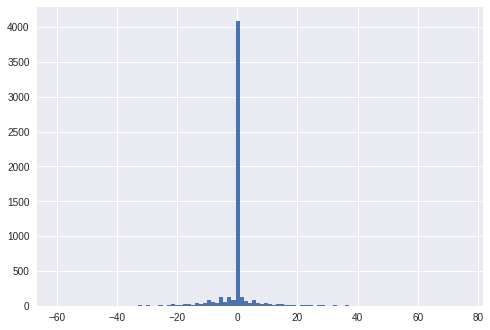

mean=-0.274 stdv=7.939
Statistics=0.543, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2045.094, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


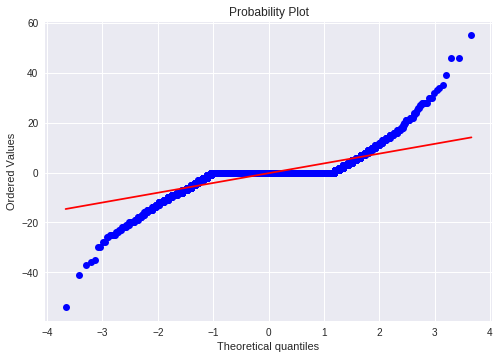

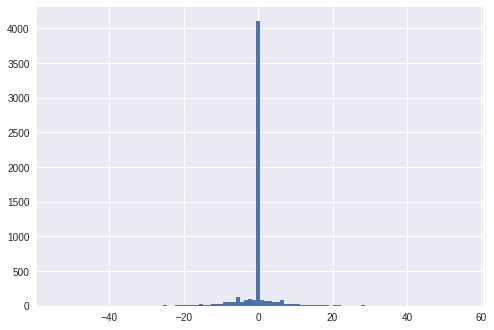

mean=-0.257 stdv=5.090
Statistics=0.594, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1348.001, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


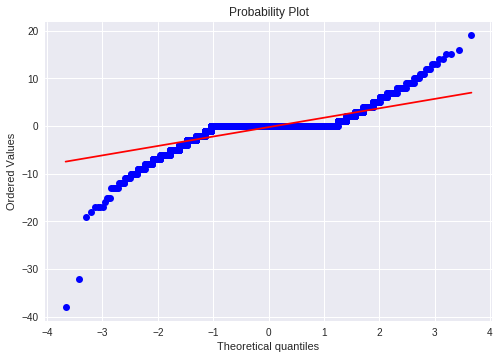

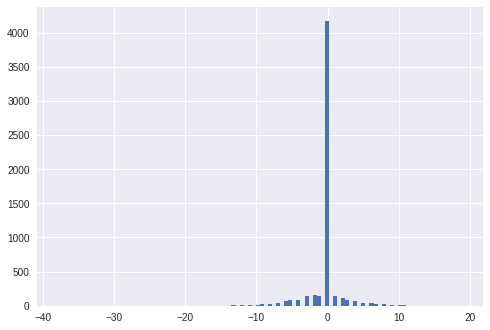

mean=-0.237 stdv=2.542
Statistics=0.604, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2671.827, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


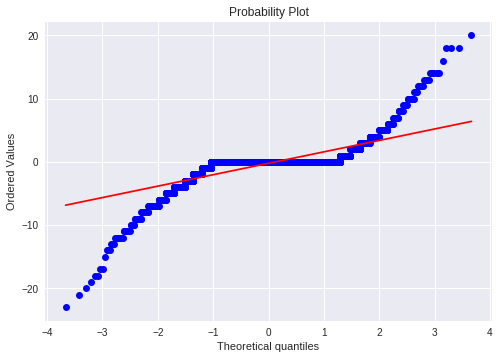

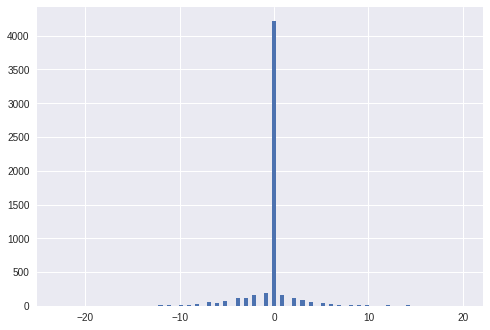

mean=-0.230 stdv=2.377
Statistics=0.580, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1663.694, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


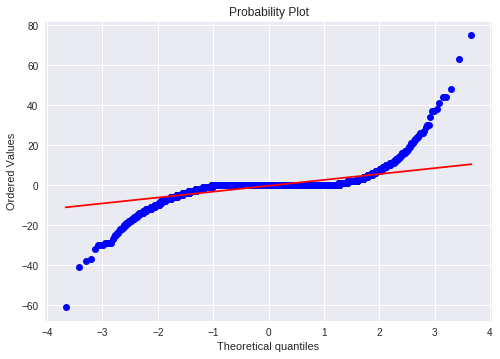

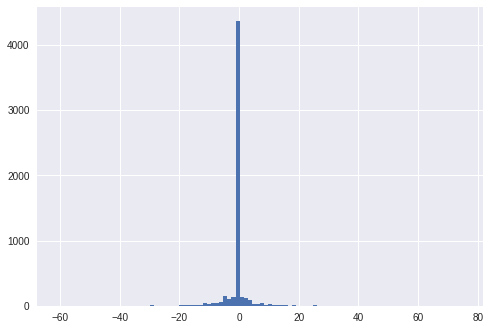

mean=-0.239 stdv=4.357
Statistics=0.458, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2987.782, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.399, p=0.000
Sample does not look Gaussian (reject H0)


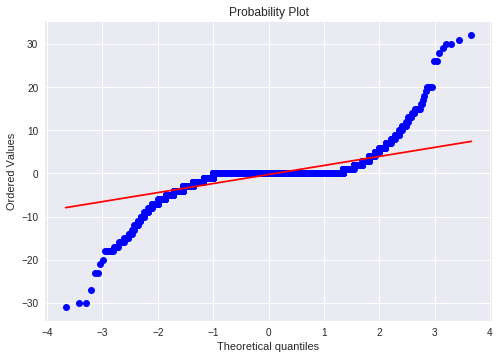

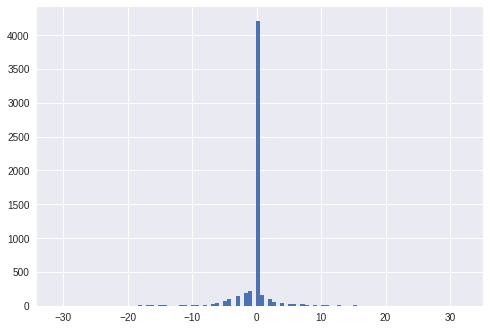

mean=-0.241 stdv=2.955
Statistics=0.504, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1663.690, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.411, p=0.000
Sample does not look Gaussian (reject H0)


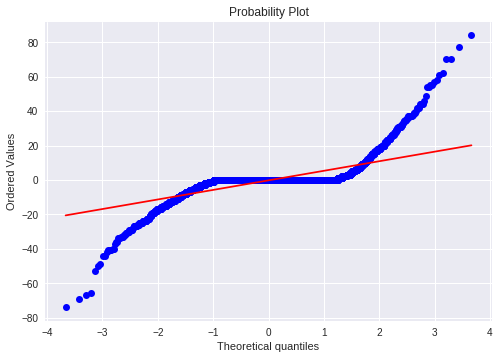

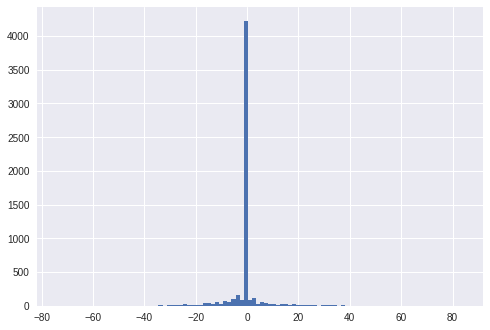

mean=-0.255 stdv=7.669
Statistics=0.526, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2072.237, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


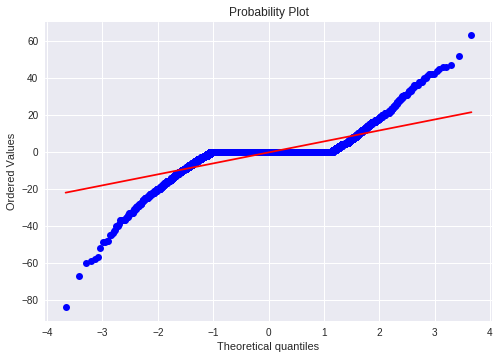

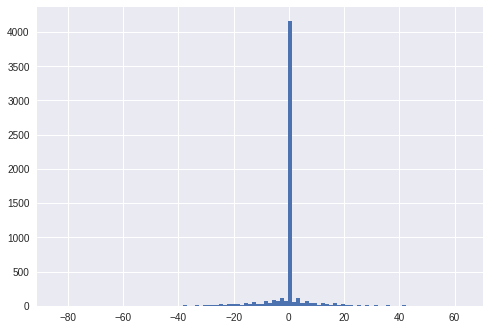

mean=-0.288 stdv=7.771
Statistics=0.584, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1568.733, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


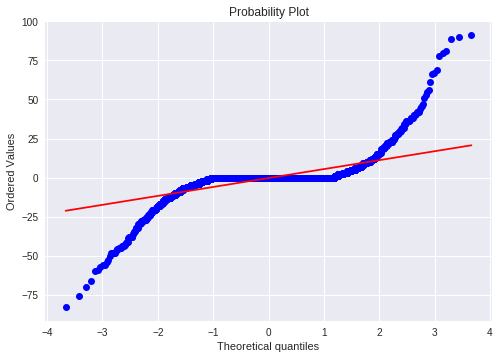

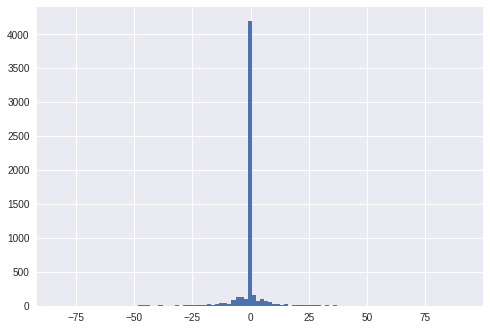

mean=-0.302 stdv=8.192
Statistics=0.488, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1835.686, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.383, p=0.000
Sample does not look Gaussian (reject H0)


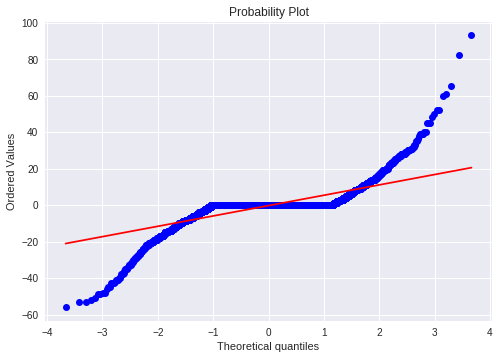

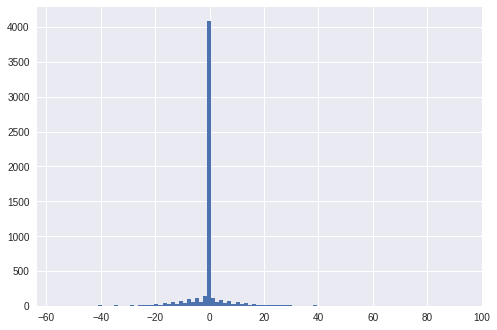

mean=-0.293 stdv=7.506
Statistics=0.572, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1541.355, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


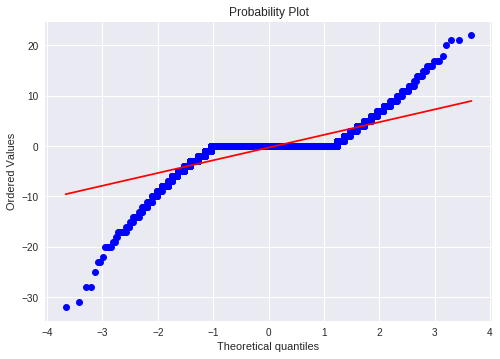

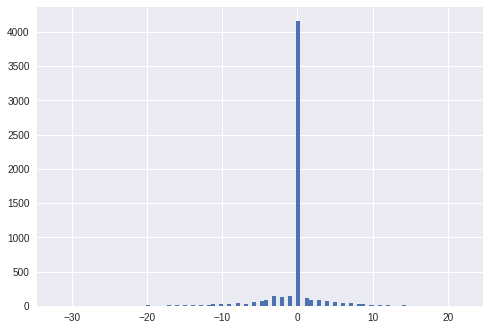

mean=-0.284 stdv=3.288
Statistics=0.591, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2290.253, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


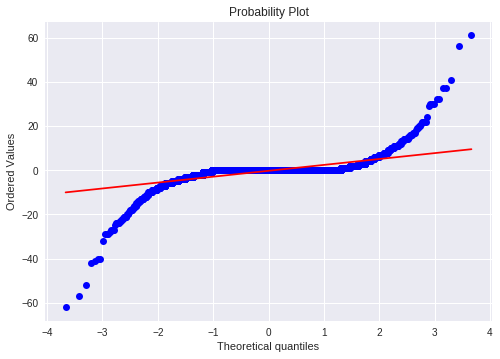

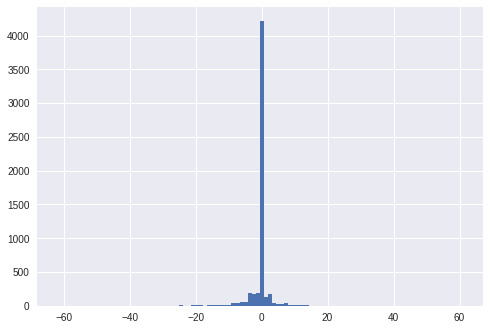

mean=-0.267 stdv=4.045
Statistics=0.436, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2635.527, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.405, p=0.000
Sample does not look Gaussian (reject H0)


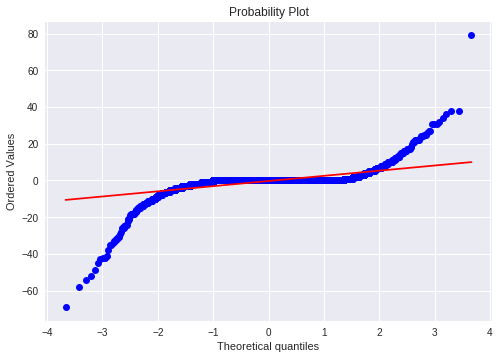

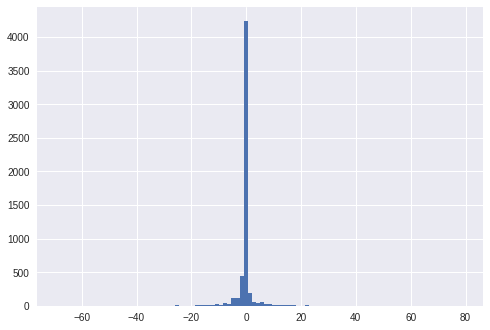

mean=-0.278 stdv=4.436
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3421.410, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.414, p=0.000
Sample does not look Gaussian (reject H0)


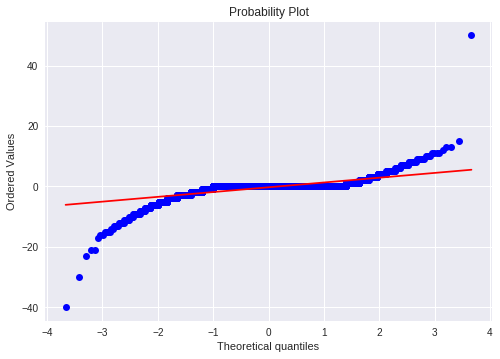

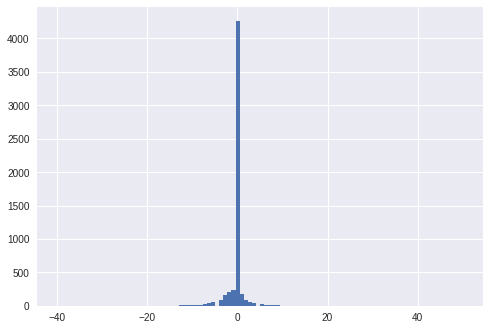

mean=-0.287 stdv=2.248
Statistics=0.499, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2556.604, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)


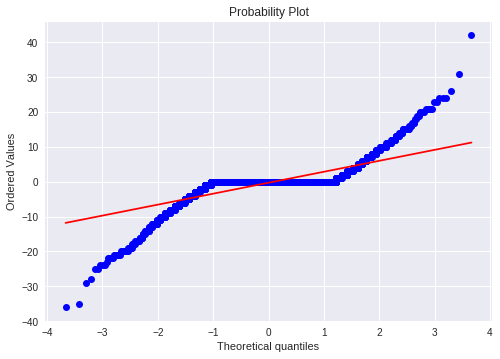

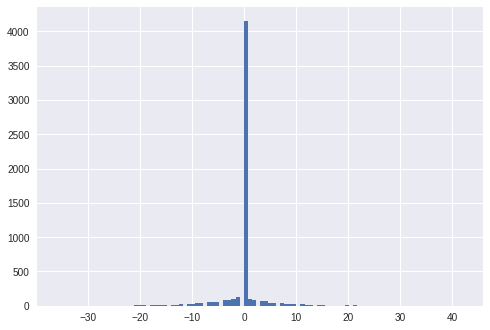

mean=-0.276 stdv=4.097
Statistics=0.590, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1463.281, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


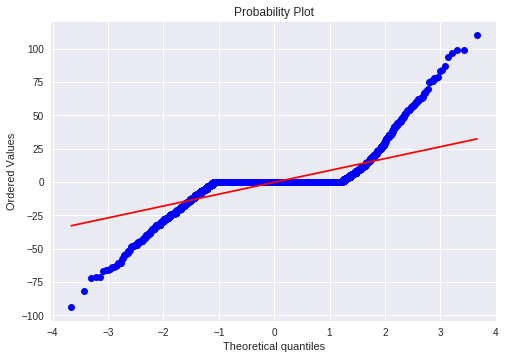

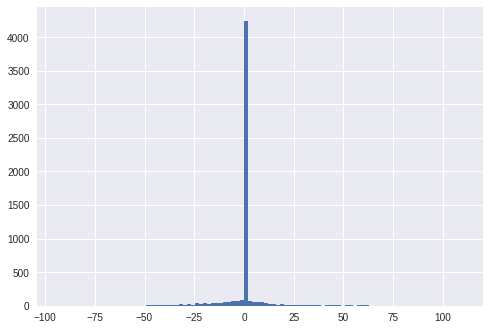

mean=-0.256 stdv=12.038
Statistics=0.546, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1903.874, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


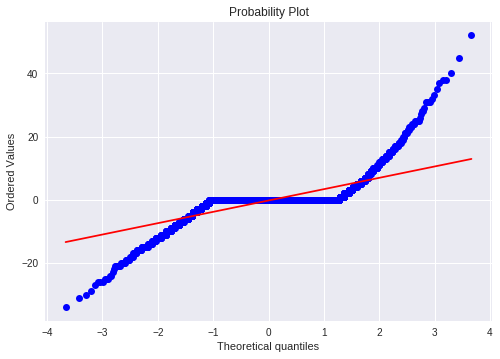

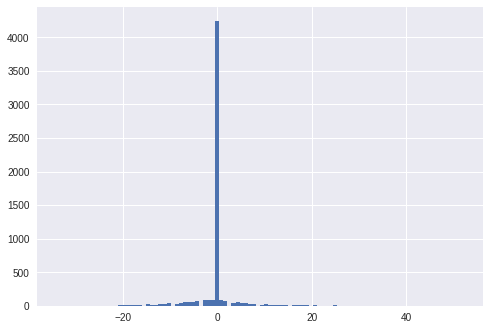

mean=-0.237 stdv=4.780
Statistics=0.564, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1939.015, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.400, p=0.000
Sample does not look Gaussian (reject H0)


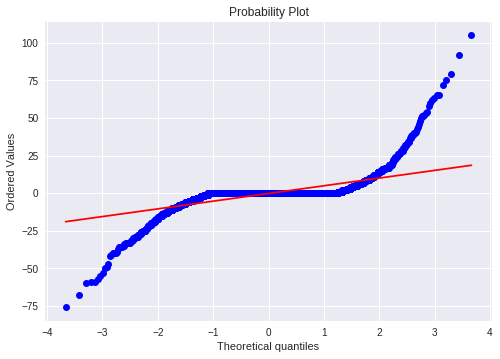

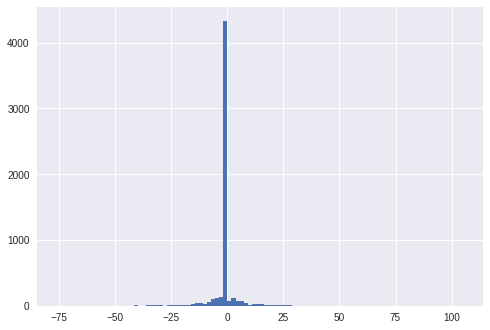

mean=-0.258 stdv=7.497
Statistics=0.468, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2635.590, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.395, p=0.000
Sample does not look Gaussian (reject H0)


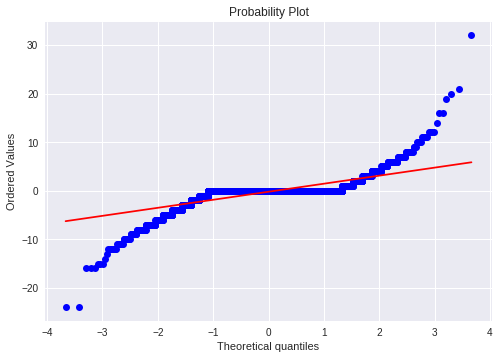

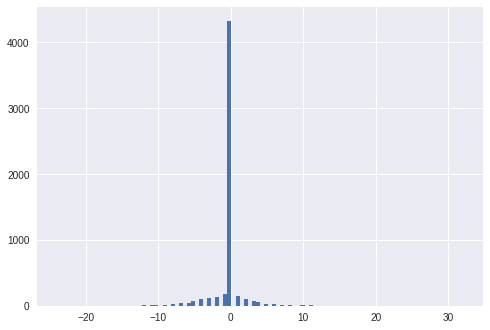

mean=-0.207 stdv=2.229
Statistics=0.552, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1580.937, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


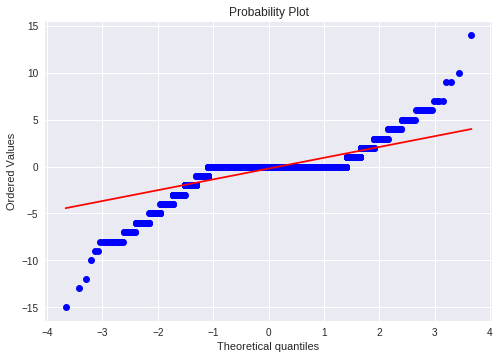

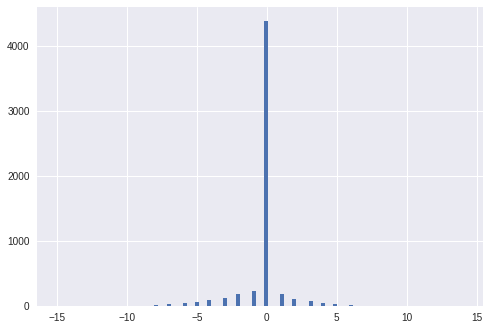

mean=-0.210 stdv=1.517
Statistics=0.578, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2164.247, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.421, p=0.000
Sample does not look Gaussian (reject H0)


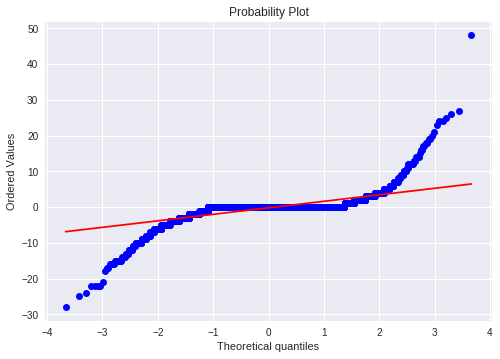

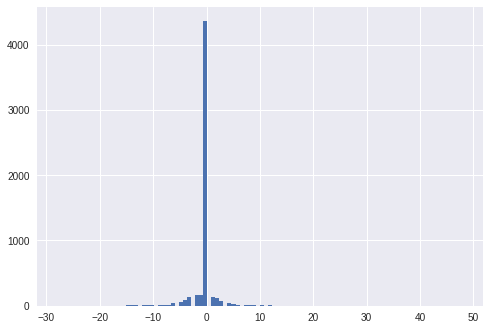

mean=-0.208 stdv=2.659
Statistics=0.470, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2329.104, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.415, p=0.000
Sample does not look Gaussian (reject H0)


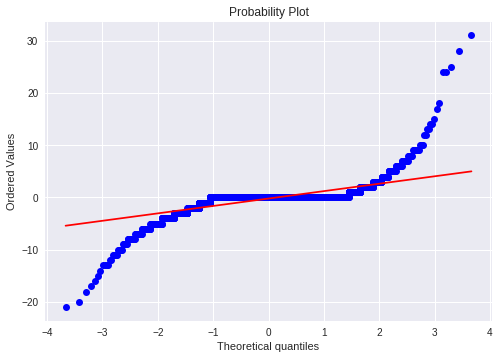

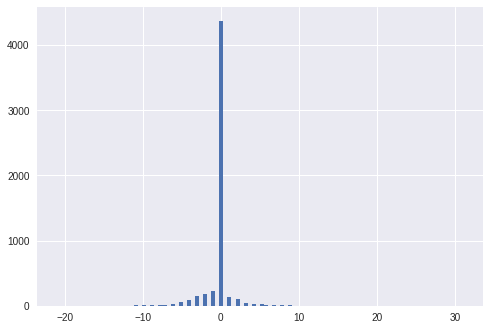

mean=-0.209 stdv=2.021
Statistics=0.494, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2760.648, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.426, p=0.000
Sample does not look Gaussian (reject H0)


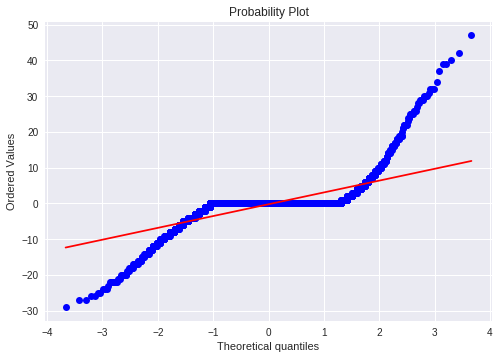

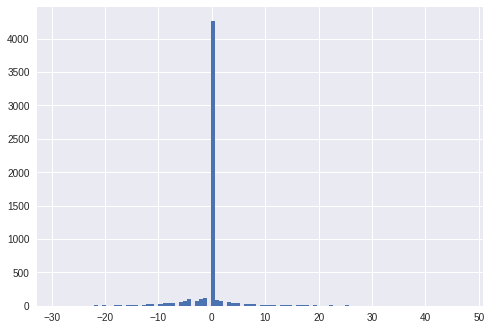

mean=-0.209 stdv=4.548
Statistics=0.528, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2398.655, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


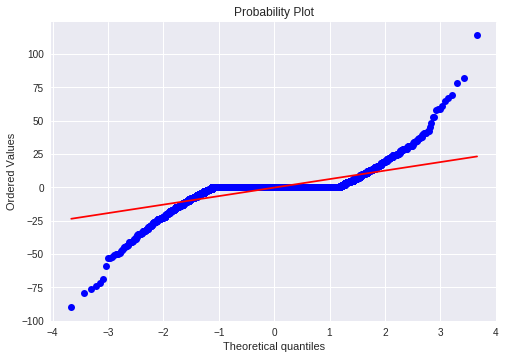

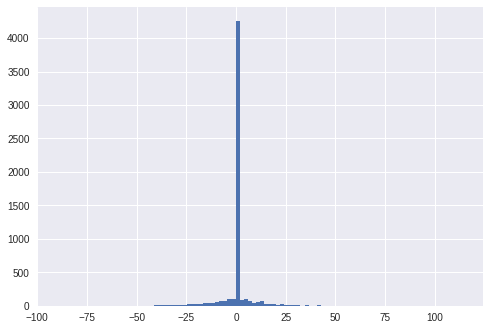

mean=-0.234 stdv=8.712
Statistics=0.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1515.799, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


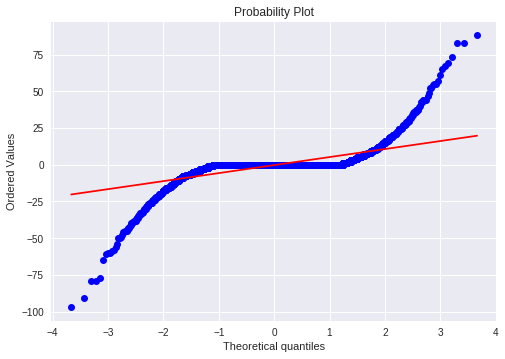

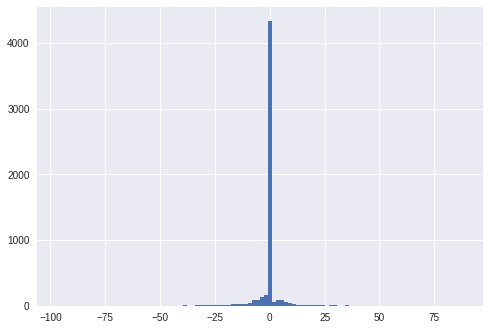

mean=-0.271 stdv=8.062
Statistics=0.459, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1863.298, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.392, p=0.000
Sample does not look Gaussian (reject H0)


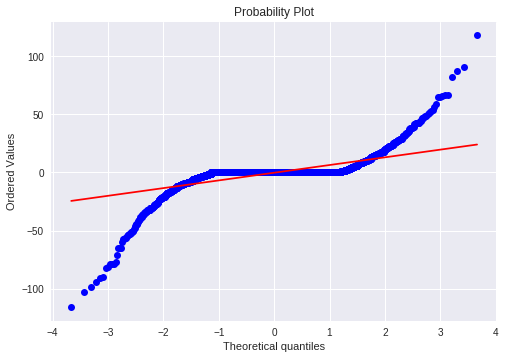

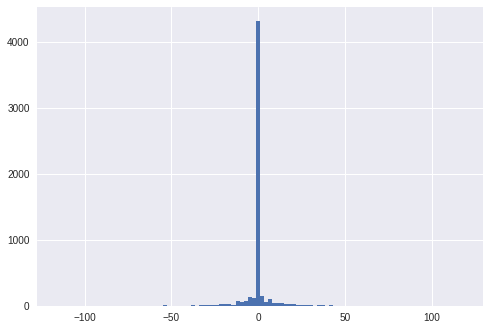

mean=-0.212 stdv=9.654
Statistics=0.471, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2476.304, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


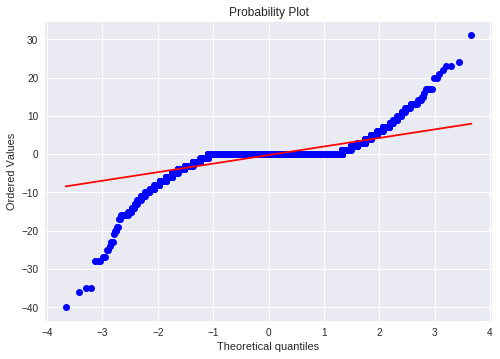

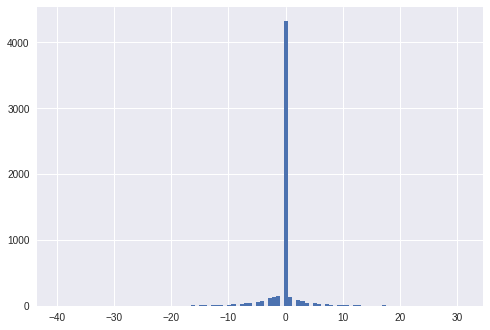

mean=-0.255 stdv=3.157
Statistics=0.502, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3213.391, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.408, p=0.000
Sample does not look Gaussian (reject H0)


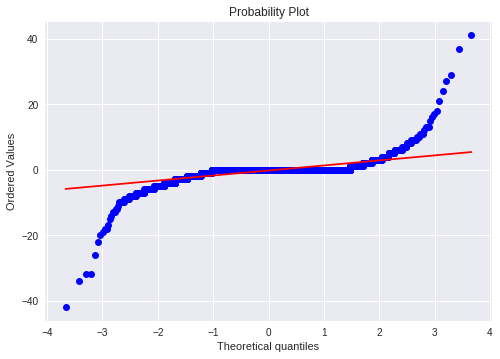

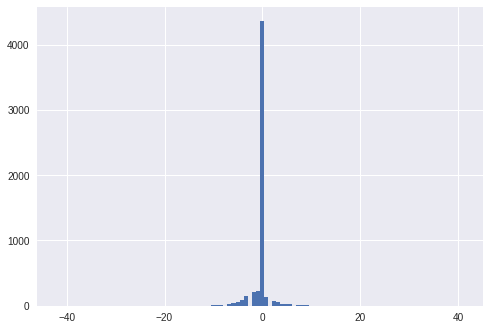

mean=-0.249 stdv=2.353
Statistics=0.428, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2413.771, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.430, p=0.000
Sample does not look Gaussian (reject H0)


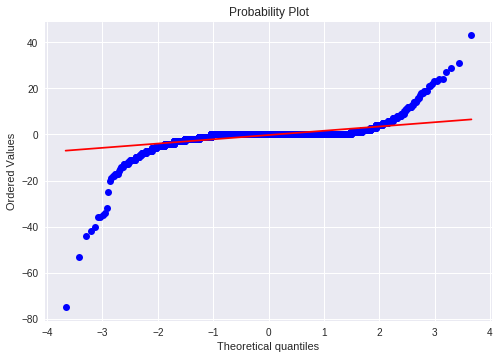

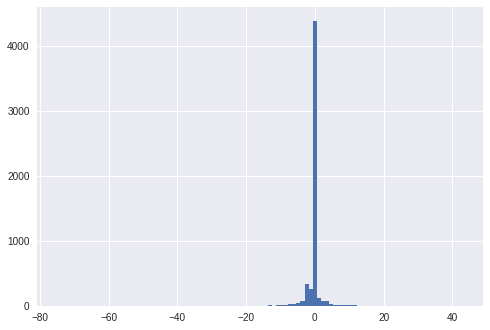

mean=-0.249 stdv=3.097
Statistics=0.359, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=6047.841, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.431, p=0.000
Sample does not look Gaussian (reject H0)


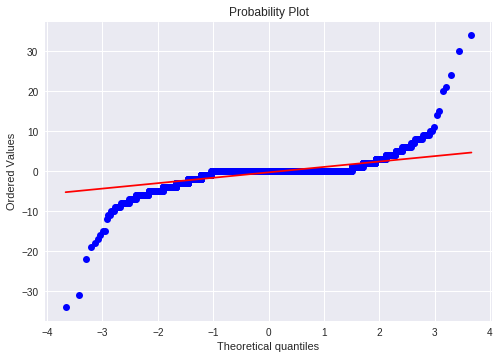

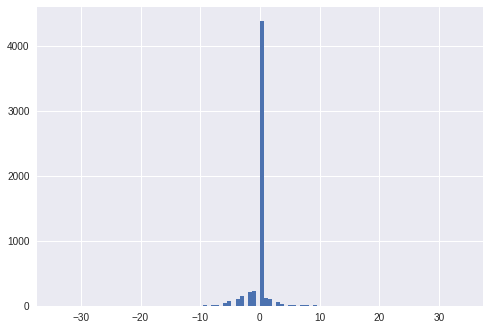

mean=-0.261 stdv=1.969
Statistics=0.475, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2198.606, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.433, p=0.000
Sample does not look Gaussian (reject H0)


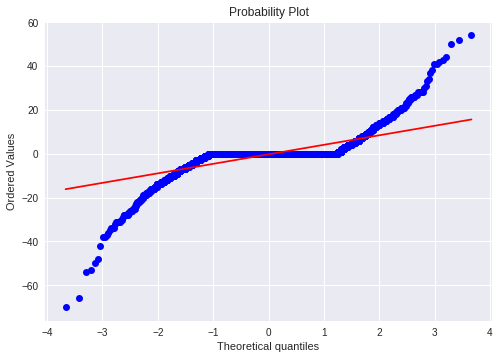

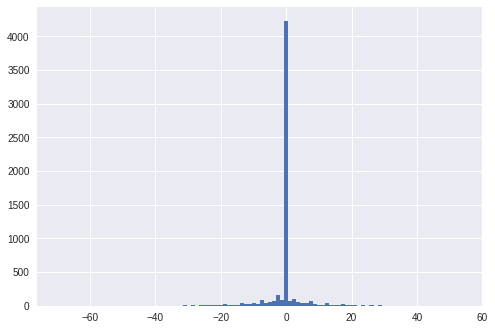

mean=-0.250 stdv=5.911
Statistics=0.540, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1868.703, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


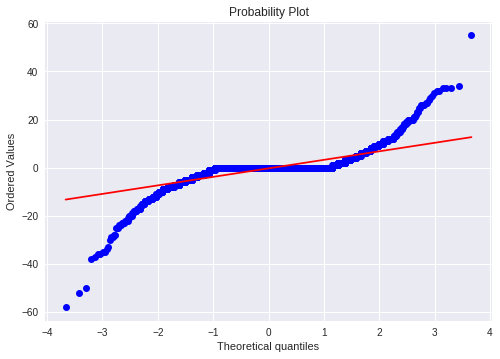

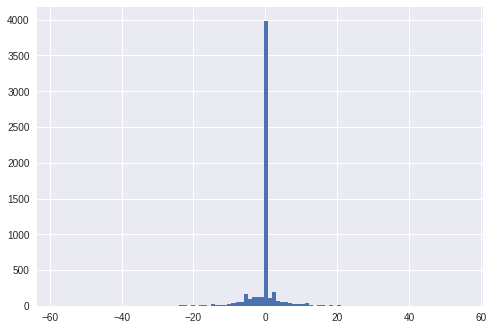

mean=-0.272 stdv=4.690
Statistics=0.571, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1999.252, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.376, p=0.000
Sample does not look Gaussian (reject H0)


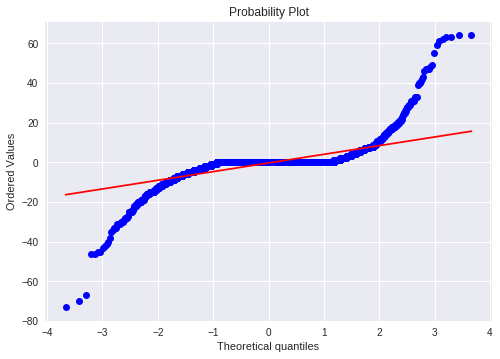

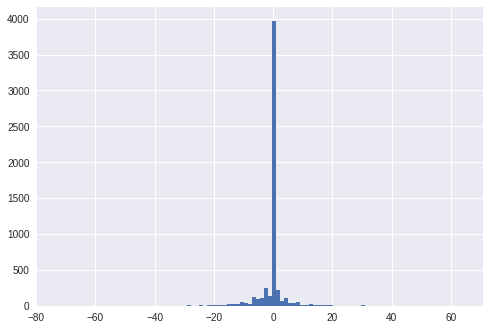

mean=-0.293 stdv=6.162
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2164.172, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


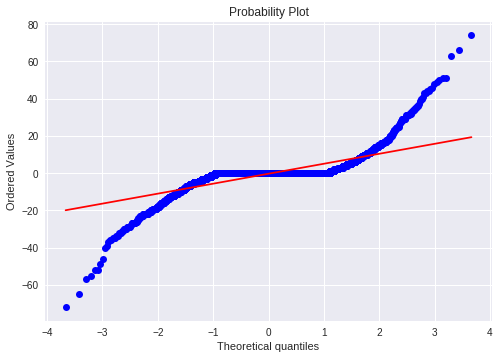

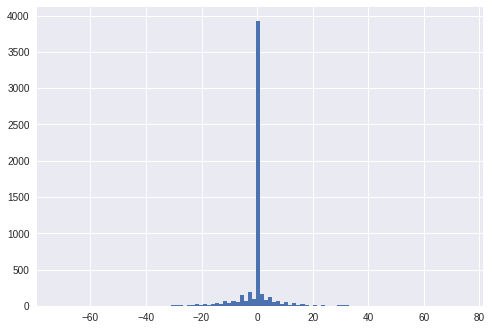

mean=-0.291 stdv=7.032
Statistics=0.580, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1442.388, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.367, p=0.000
Sample does not look Gaussian (reject H0)


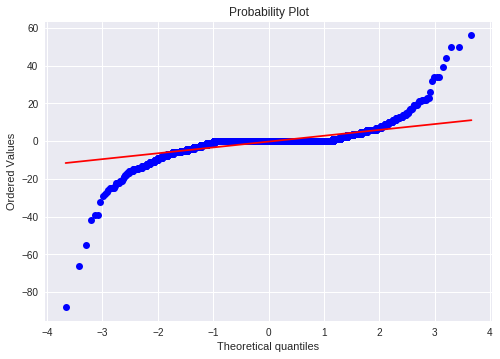

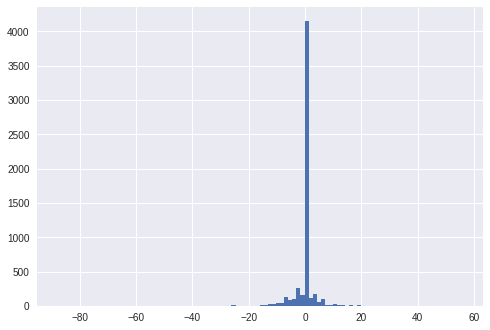

mean=-0.259 stdv=4.353
Statistics=0.507, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3415.786, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.378, p=0.000
Sample does not look Gaussian (reject H0)


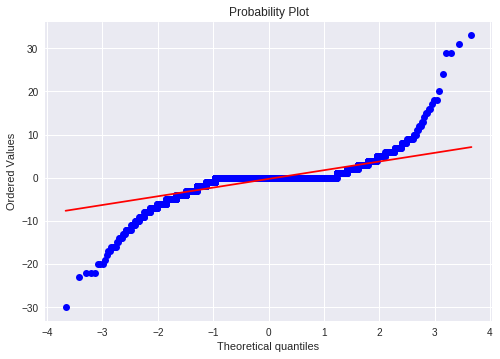

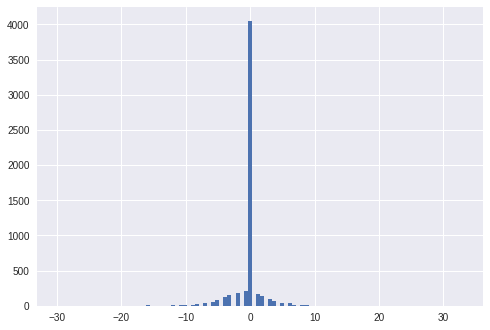

mean=-0.262 stdv=2.661
Statistics=0.574, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1612.843, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.390, p=0.000
Sample does not look Gaussian (reject H0)


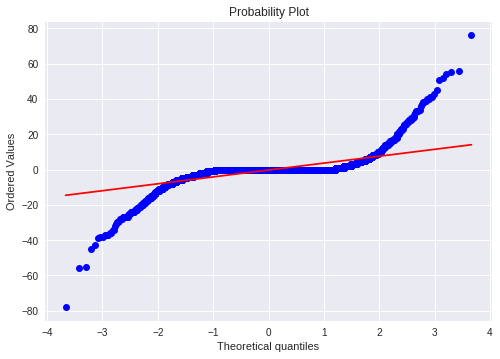

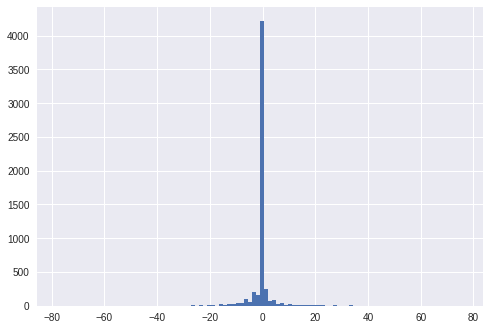

mean=-0.263 stdv=5.677
Statistics=0.475, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1896.304, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


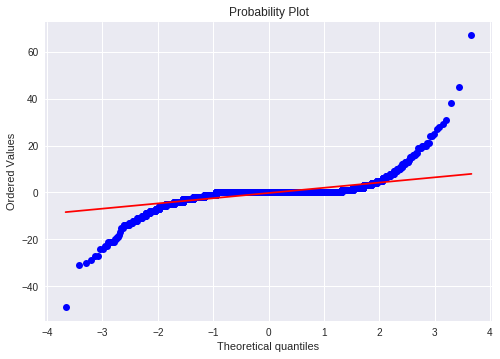

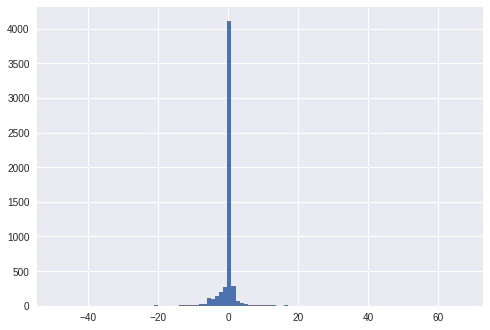

mean=-0.258 stdv=3.276
Statistics=0.463, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3197.015, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


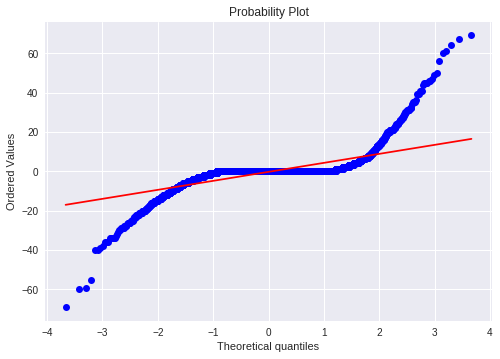

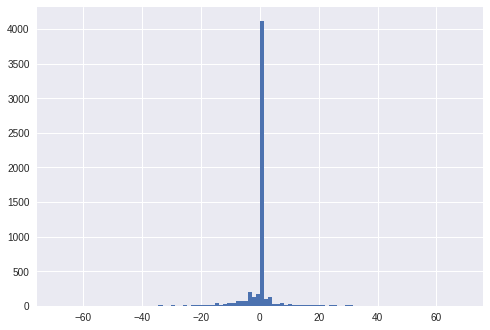

mean=-0.274 stdv=6.415
Statistics=0.508, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2352.330, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


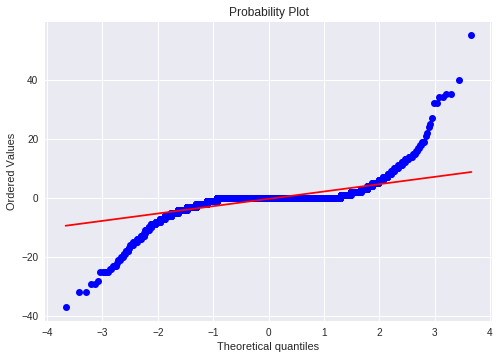

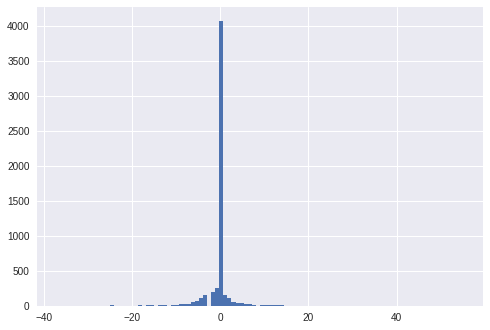

mean=-0.323 stdv=3.535
Statistics=0.494, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1883.880, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.403, p=0.000
Sample does not look Gaussian (reject H0)


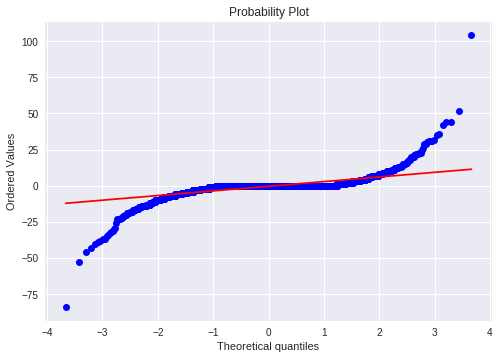

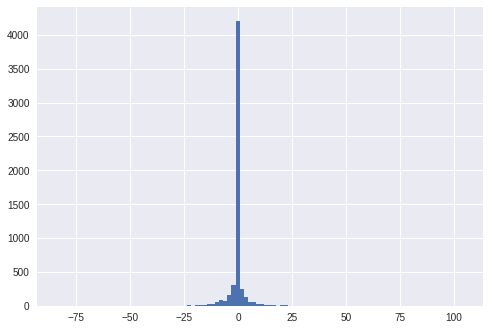

mean=-0.341 stdv=4.684
Statistics=0.472, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2402.083, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


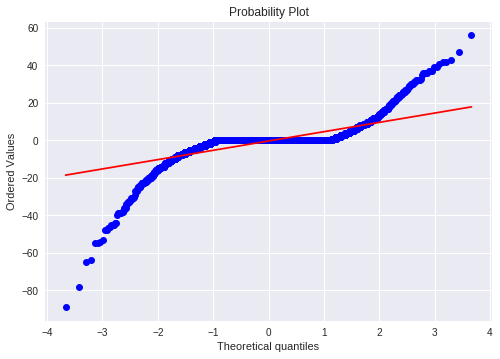

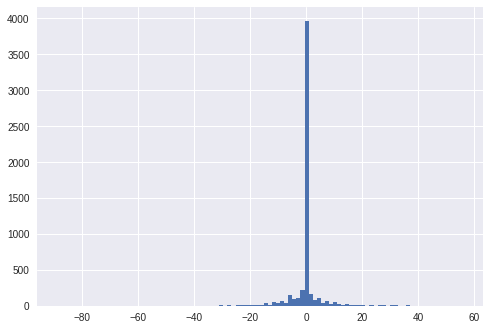

mean=-0.331 stdv=6.737
Statistics=0.544, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2774.917, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


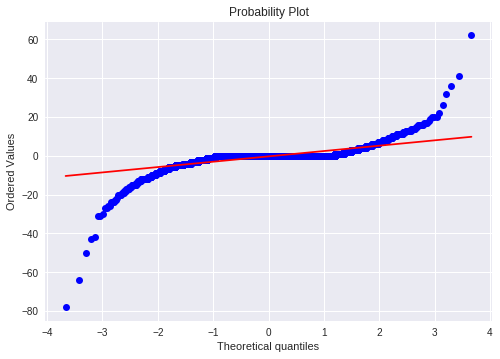

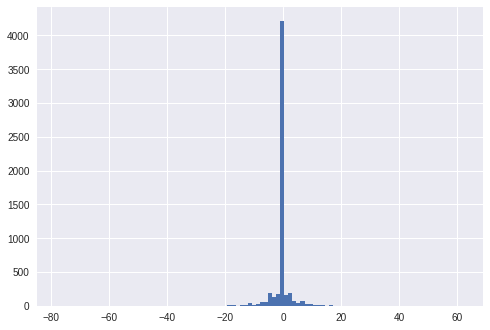

mean=-0.309 stdv=3.892
Statistics=0.503, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4312.873, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.385, p=0.000
Sample does not look Gaussian (reject H0)


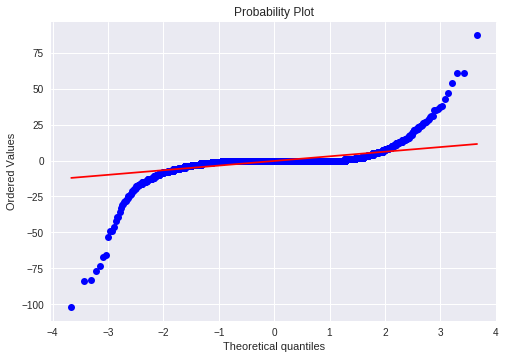

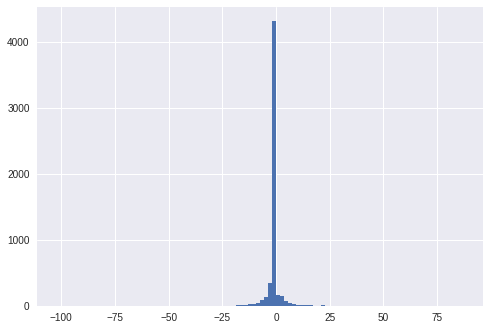

mean=-0.296 stdv=5.305
Statistics=0.369, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4804.409, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.401, p=0.000
Sample does not look Gaussian (reject H0)


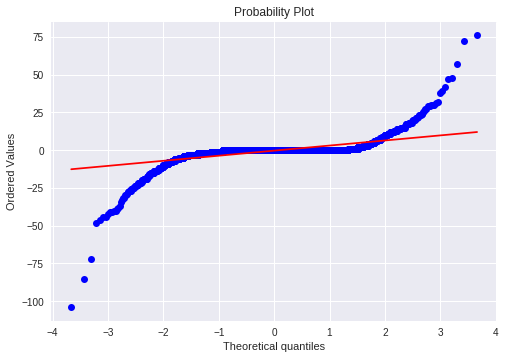

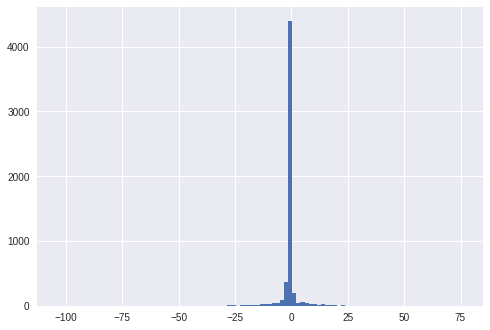

mean=-0.306 stdv=5.294
Statistics=0.405, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3744.710, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.410, p=0.000
Sample does not look Gaussian (reject H0)


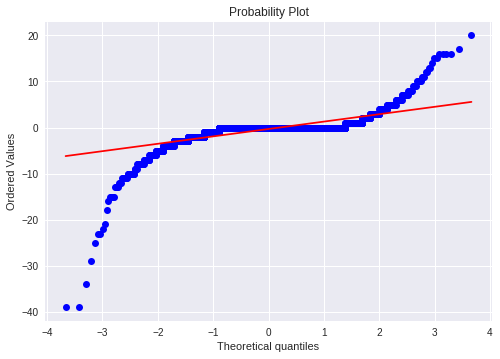

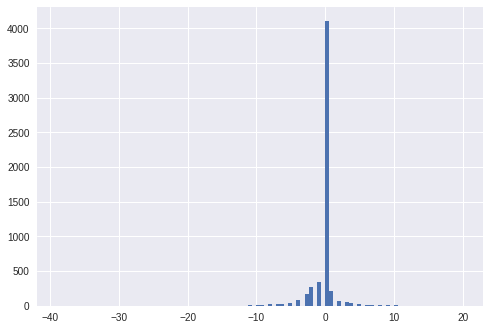

mean=-0.313 stdv=2.284
Statistics=0.495, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=4992.059, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.417, p=0.000
Sample does not look Gaussian (reject H0)


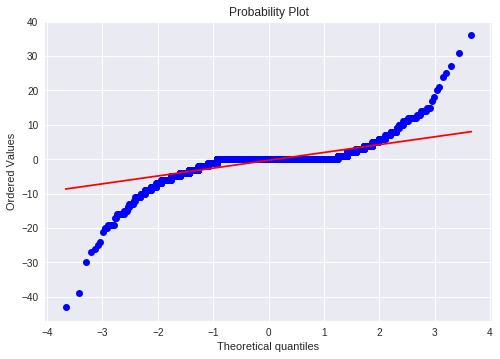

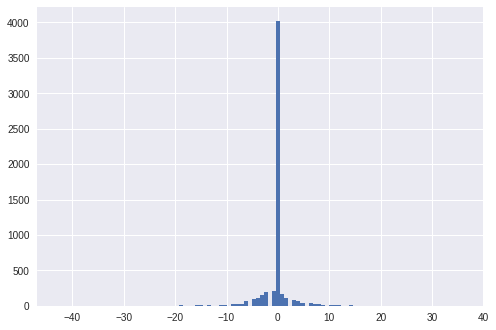

mean=-0.303 stdv=3.032
Statistics=0.565, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2448.050, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


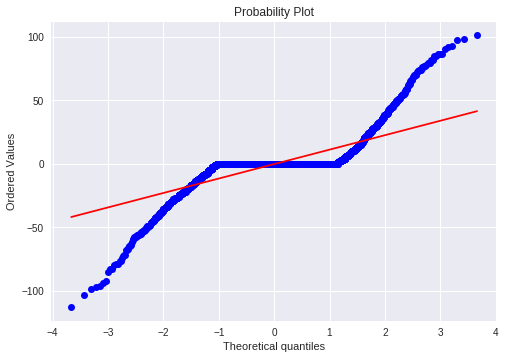

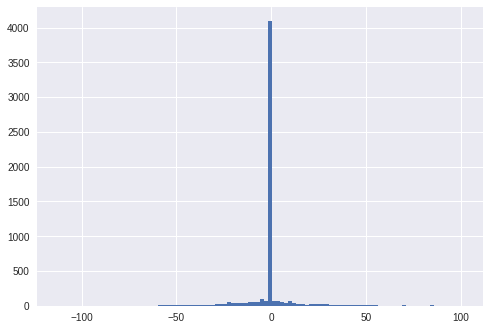

mean=-0.316 stdv=14.772
Statistics=0.593, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1179.437, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


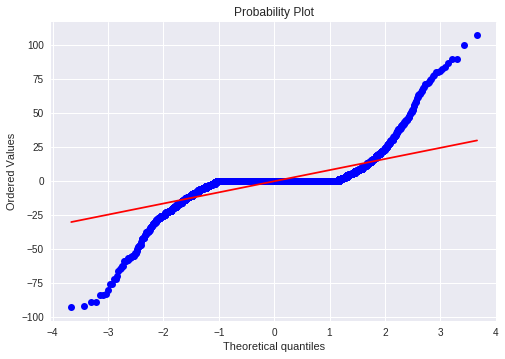

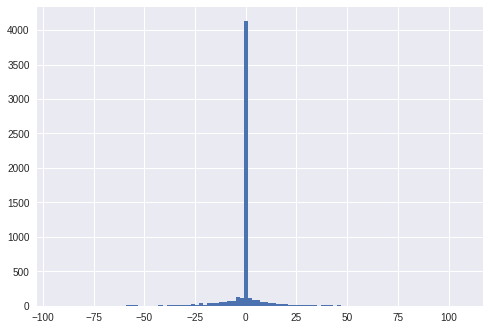

mean=-0.309 stdv=11.349
Statistics=0.521, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1559.734, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)


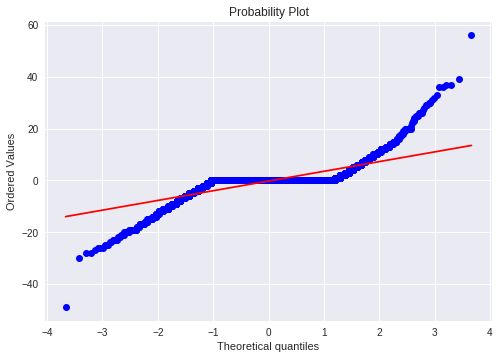

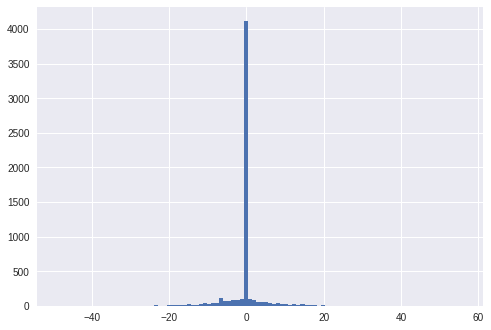

mean=-0.252 stdv=4.872
Statistics=0.593, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1409.280, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


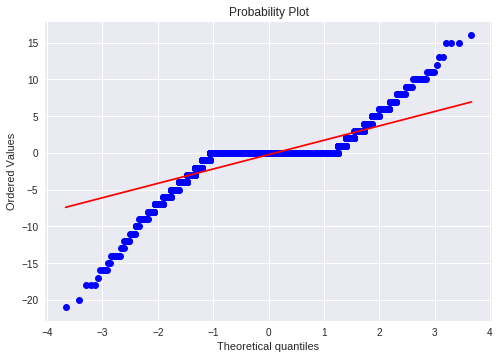

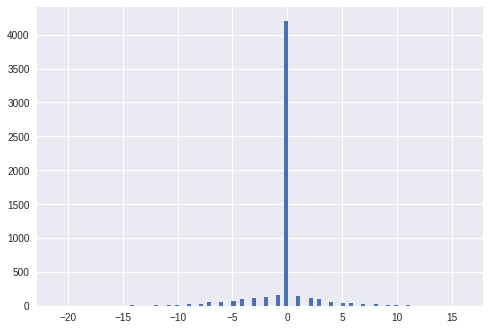

mean=-0.230 stdv=2.509
Statistics=0.609, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1934.359, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.394, p=0.000
Sample does not look Gaussian (reject H0)


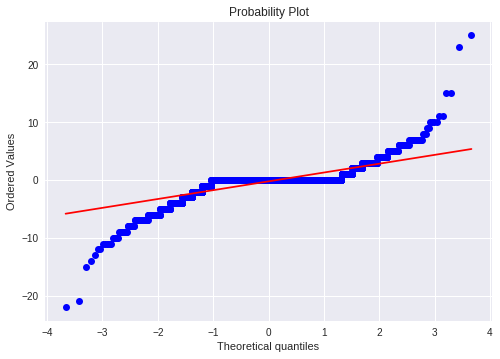

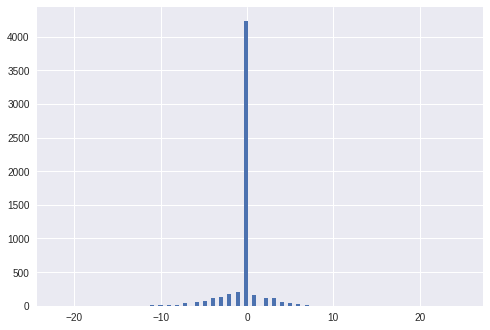

mean=-0.237 stdv=1.977
Statistics=0.597, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1702.552, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


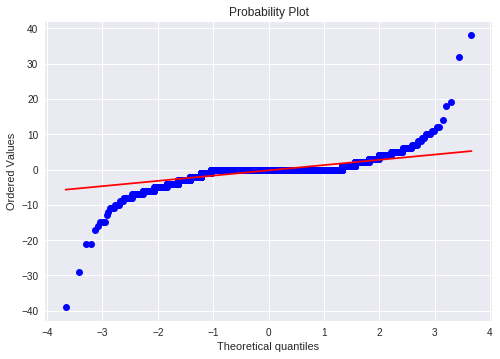

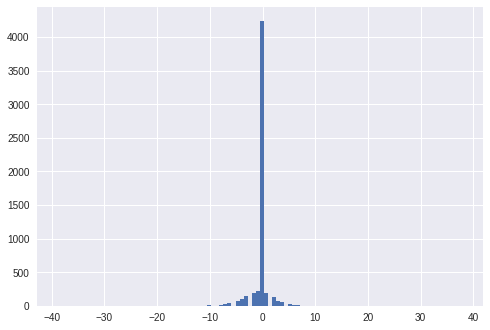

mean=-0.232 stdv=2.077
Statistics=0.518, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2437.705, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.407, p=0.000
Sample does not look Gaussian (reject H0)


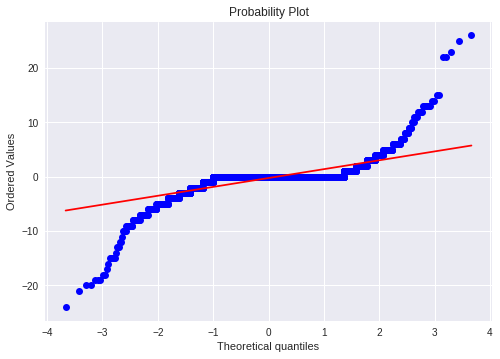

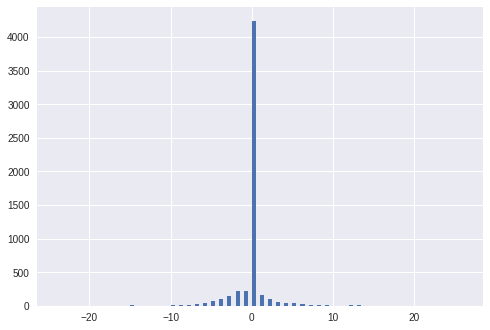

mean=-0.235 stdv=2.236
Statistics=0.533, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1680.965, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.413, p=0.000
Sample does not look Gaussian (reject H0)


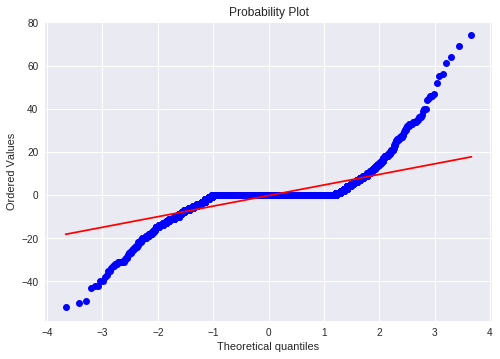

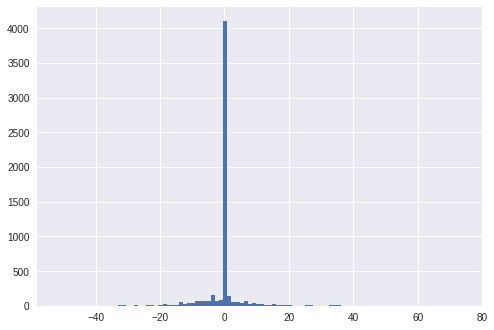

mean=-0.237 stdv=6.598
Statistics=0.552, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2233.460, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.388, p=0.000
Sample does not look Gaussian (reject H0)


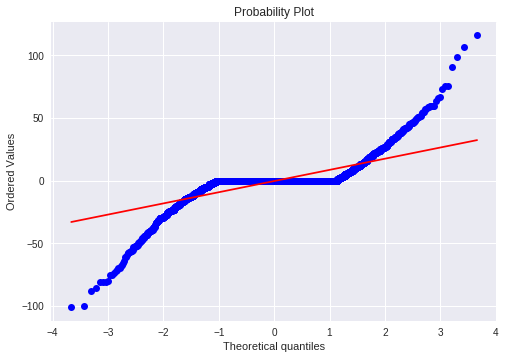

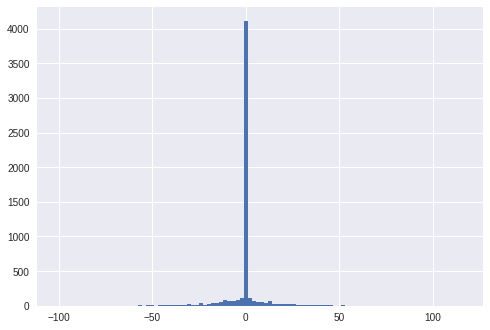

mean=-0.279 stdv=11.772
Statistics=0.575, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1381.052, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


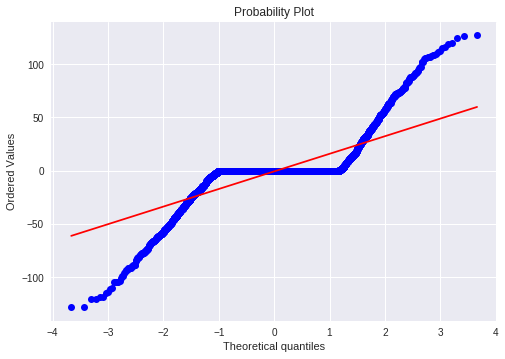

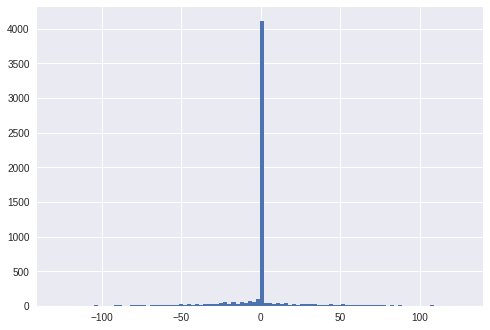

mean=-0.587 stdv=21.191
Statistics=0.606, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1002.719, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


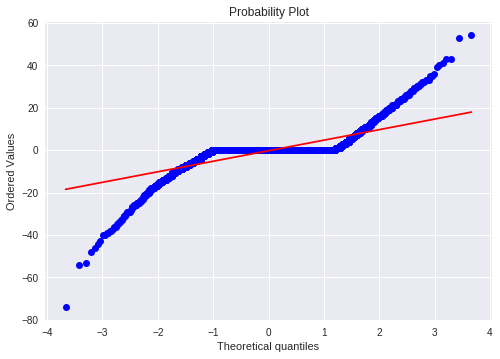

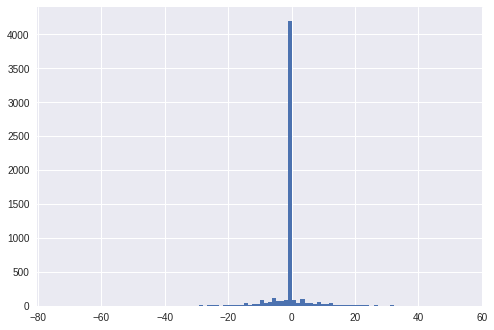

mean=-0.297 stdv=6.511
Statistics=0.581, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1515.459, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


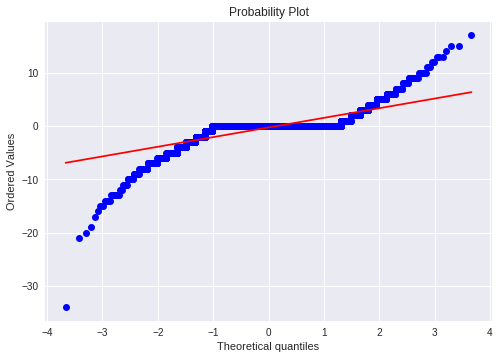

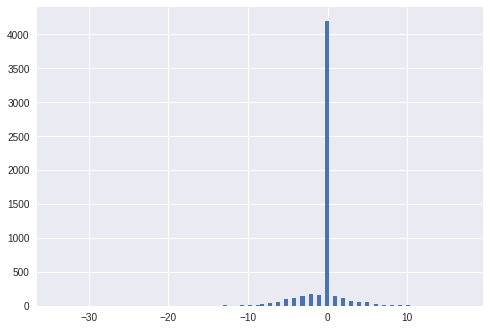

mean=-0.276 stdv=2.340
Statistics=0.598, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2511.427, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.404, p=0.000
Sample does not look Gaussian (reject H0)


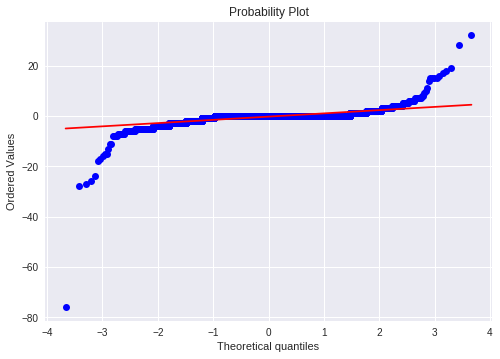

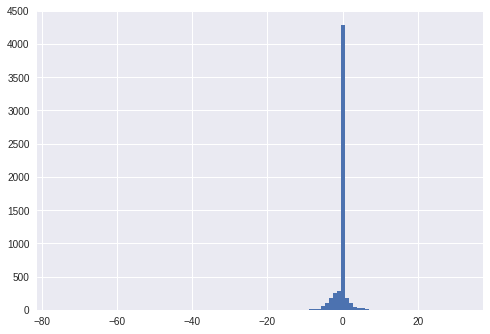

mean=-0.268 stdv=2.078
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=8617.148, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.430, p=0.000
Sample does not look Gaussian (reject H0)


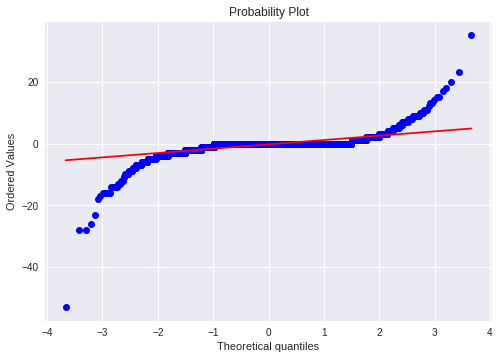

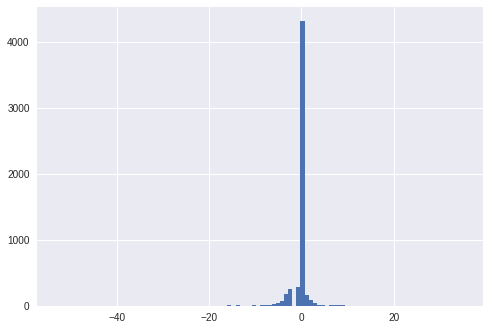

mean=-0.274 stdv=2.142
Statistics=0.431, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=5091.614, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.433, p=0.000
Sample does not look Gaussian (reject H0)


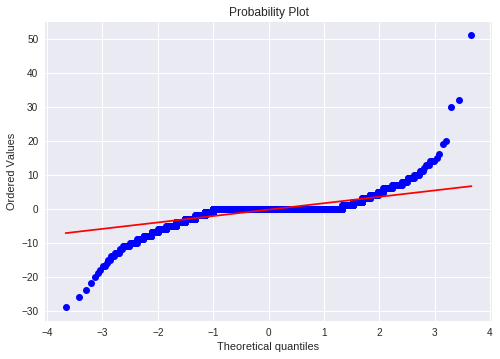

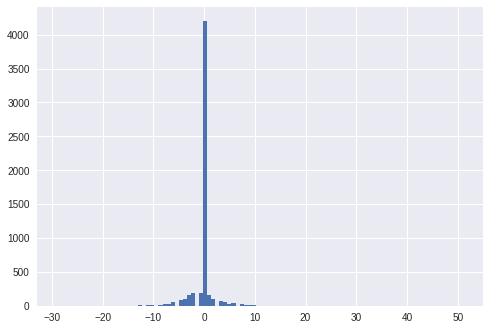

mean=-0.282 stdv=2.569
Statistics=0.540, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2375.140, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.409, p=0.000
Sample does not look Gaussian (reject H0)


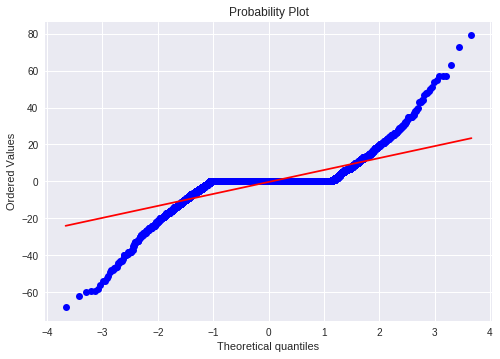

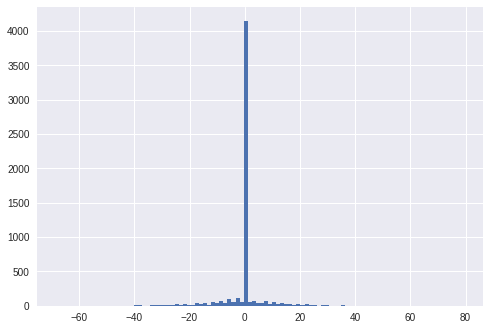

mean=-0.278 stdv=8.443
Statistics=0.587, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1296.742, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


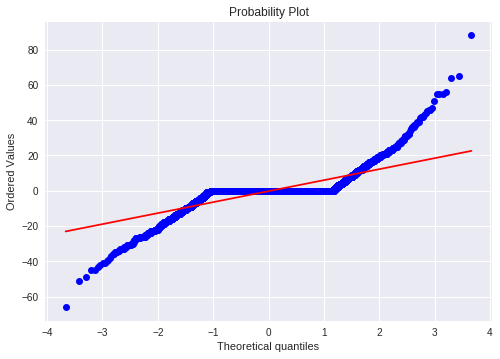

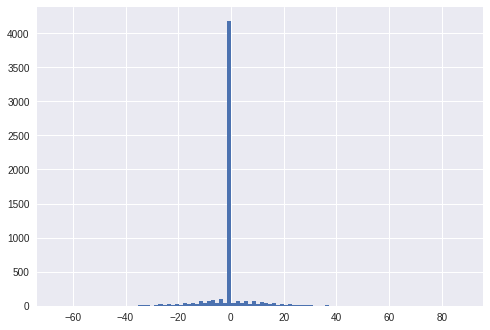

mean=-0.244 stdv=7.954
Statistics=0.614, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1366.246, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.380, p=0.000
Sample does not look Gaussian (reject H0)


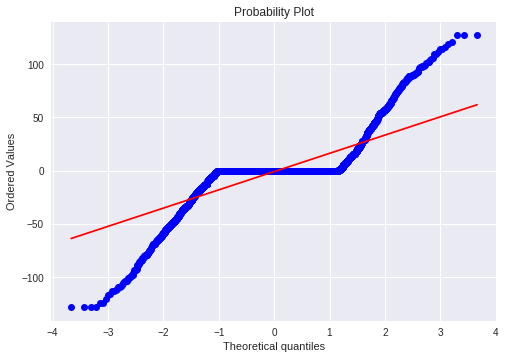

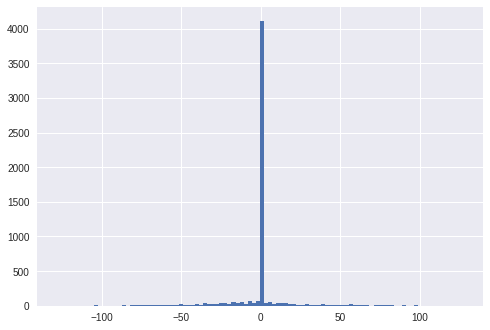

mean=-0.777 stdv=21.915
Statistics=0.610, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=970.471, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


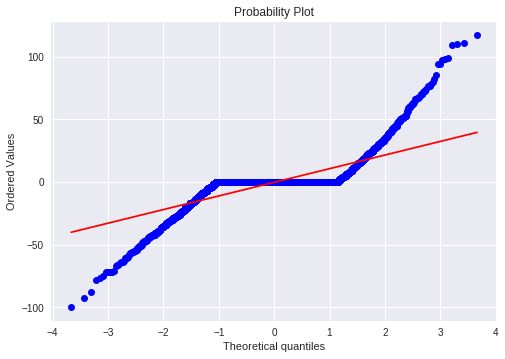

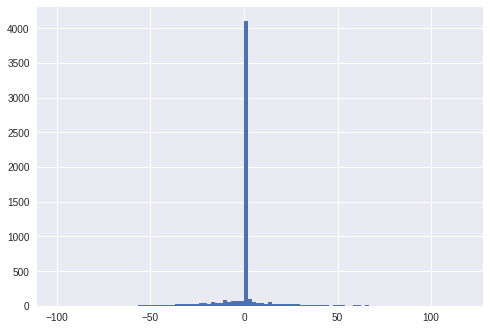

mean=-0.277 stdv=14.057
Statistics=0.599, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1481.128, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


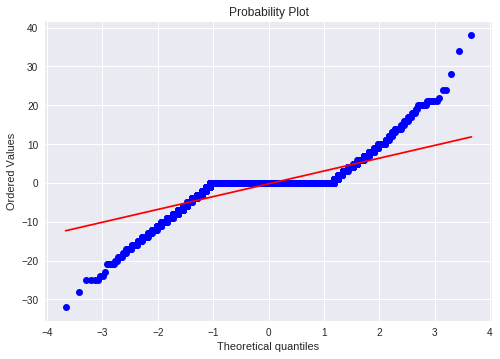

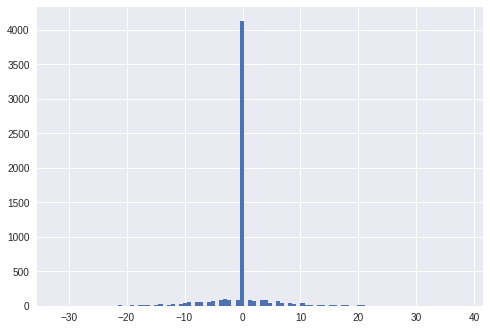

mean=-0.221 stdv=4.165
Statistics=0.628, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1080.622, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


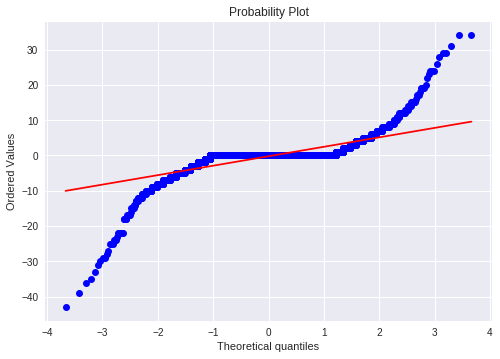

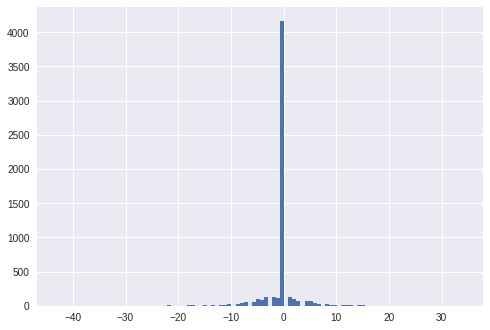

mean=-0.231 stdv=3.642
Statistics=0.541, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2379.302, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


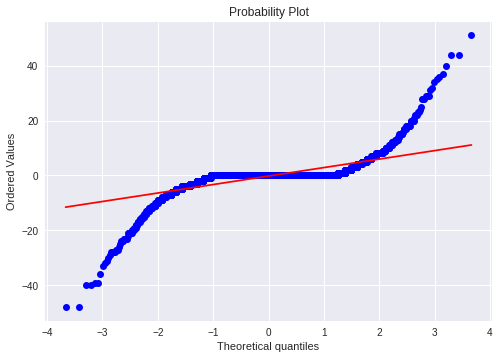

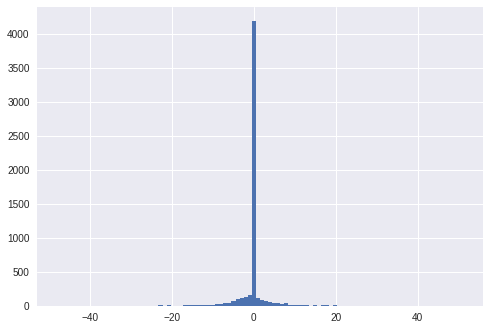

mean=-0.228 stdv=4.410
Statistics=0.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1770.525, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.396, p=0.000
Sample does not look Gaussian (reject H0)


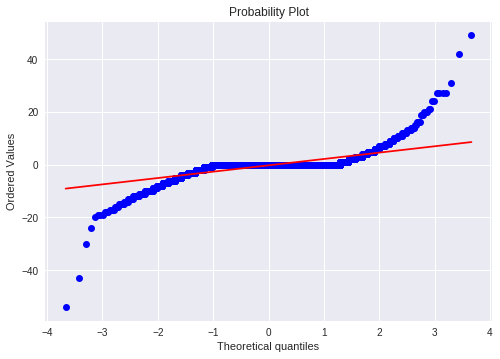

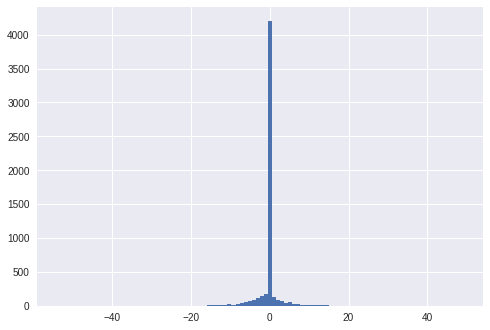

mean=-0.233 stdv=3.333
Statistics=0.523, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1802.476, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.402, p=0.000
Sample does not look Gaussian (reject H0)


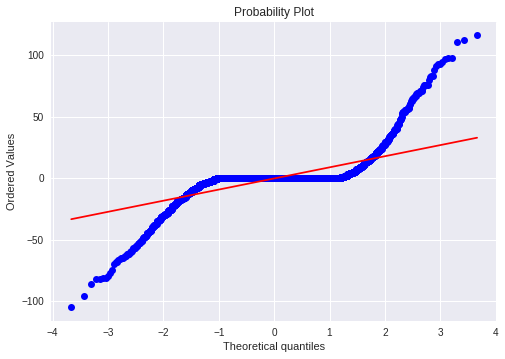

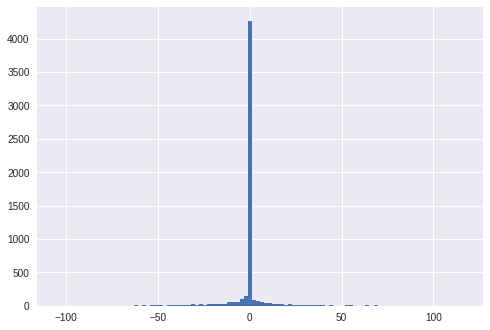

mean=-0.312 stdv=12.733
Statistics=0.504, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1837.770, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.387, p=0.000
Sample does not look Gaussian (reject H0)


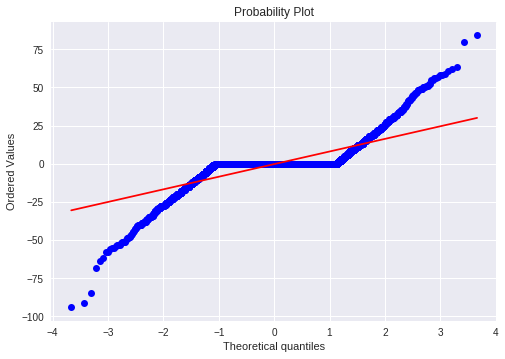

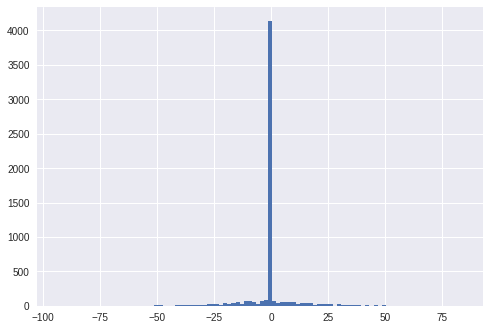

mean=-0.288 stdv=10.555
Statistics=0.612, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1160.386, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.374, p=0.000
Sample does not look Gaussian (reject H0)


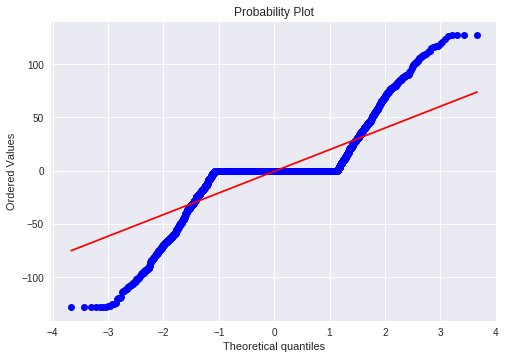

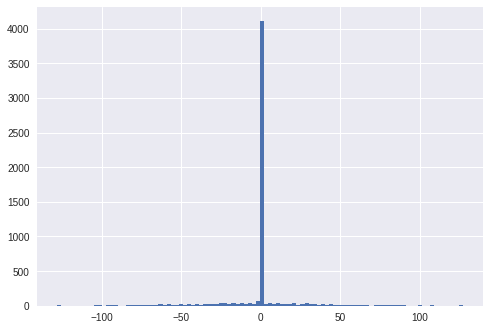

mean=-0.525 stdv=25.482
Statistics=0.634, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=860.244, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.371, p=0.000
Sample does not look Gaussian (reject H0)


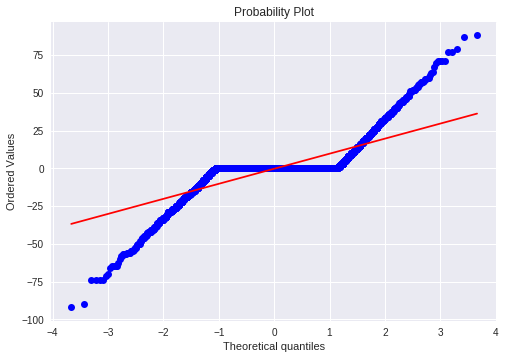

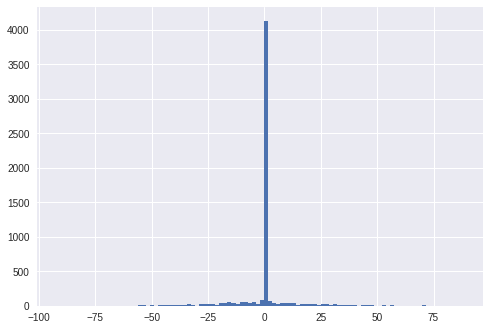

mean=-0.301 stdv=12.687
Statistics=0.617, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1009.230, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.375, p=0.000
Sample does not look Gaussian (reject H0)


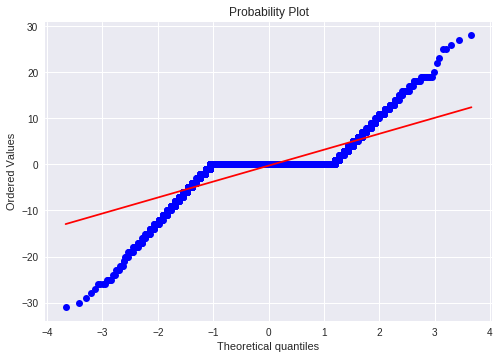

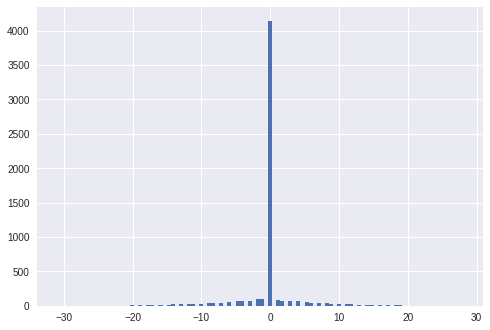

mean=-0.275 stdv=4.411
Statistics=0.615, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1435.971, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.384, p=0.000
Sample does not look Gaussian (reject H0)


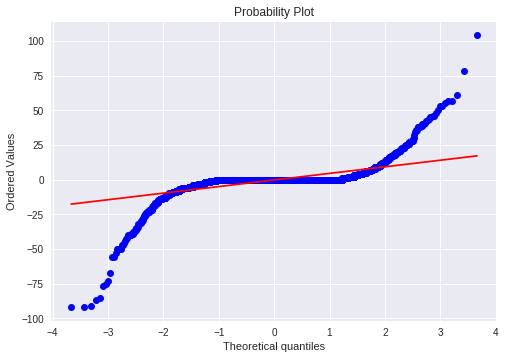

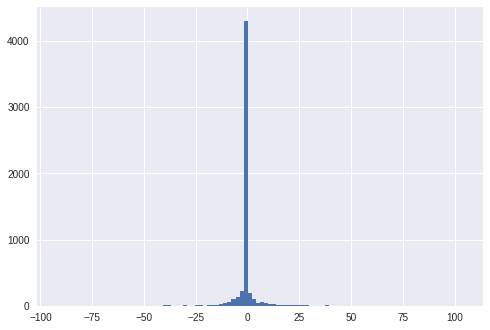

mean=-0.252 stdv=7.339
Statistics=0.419, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2985.973, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.391, p=0.000
Sample does not look Gaussian (reject H0)


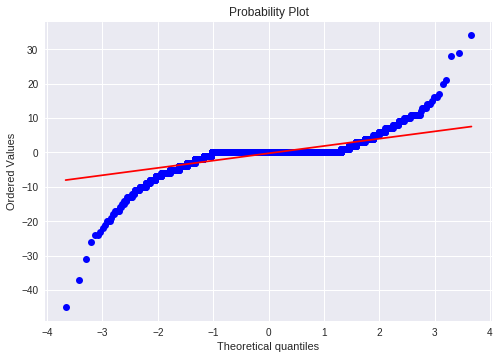

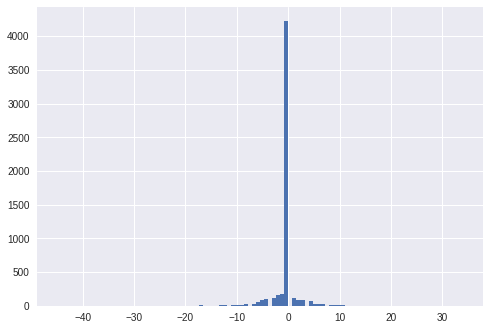

mean=-0.269 stdv=2.902
Statistics=0.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=3043.769, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.406, p=0.000
Sample does not look Gaussian (reject H0)


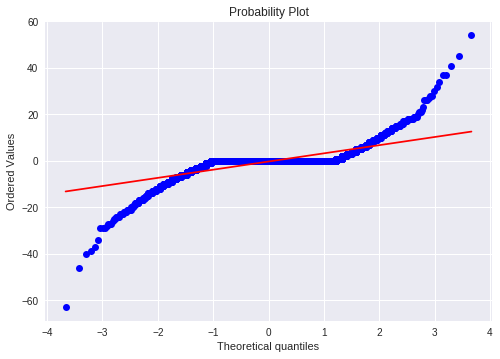

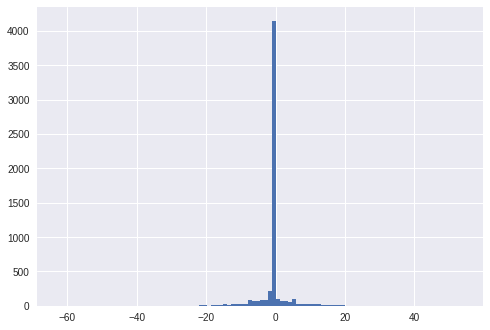

mean=-0.285 stdv=4.711
Statistics=0.558, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1735.348, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.389, p=0.000
Sample does not look Gaussian (reject H0)


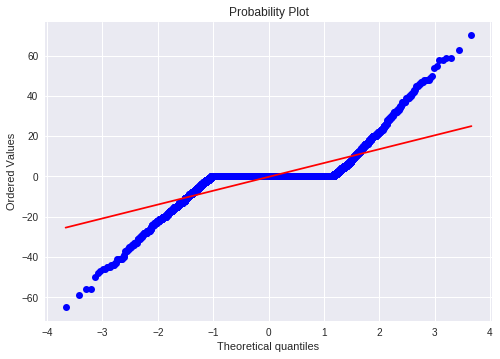

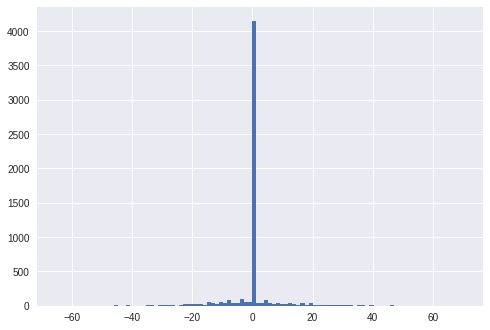

mean=-0.271 stdv=8.873
Statistics=0.601, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1205.335, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


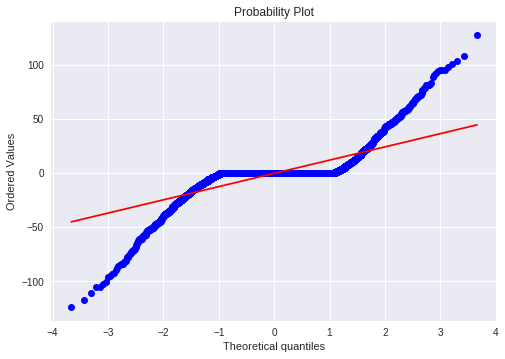

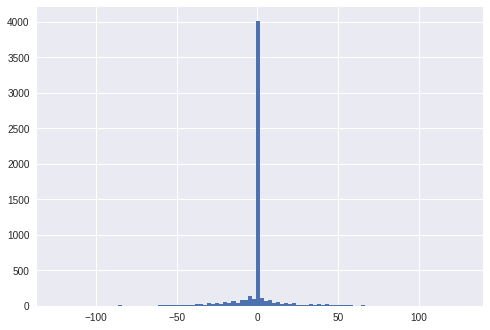

mean=-0.400 stdv=15.829
Statistics=0.596, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1169.438, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.365, p=0.000
Sample does not look Gaussian (reject H0)


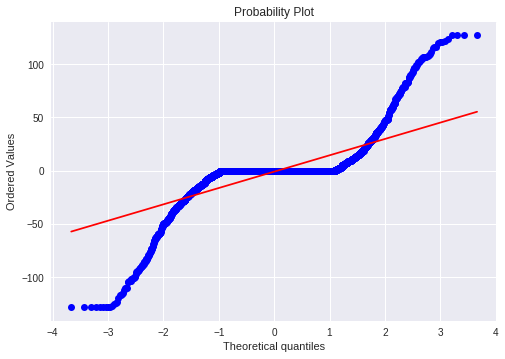

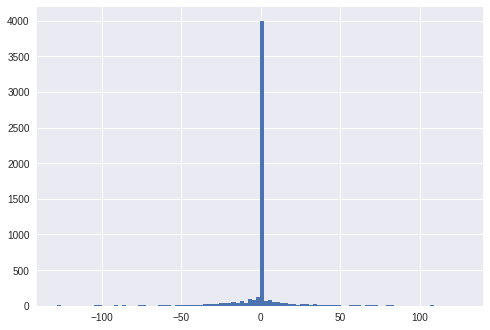

mean=-0.827 stdv=20.421
Statistics=0.564, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1264.396, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.364, p=0.000
Sample does not look Gaussian (reject H0)


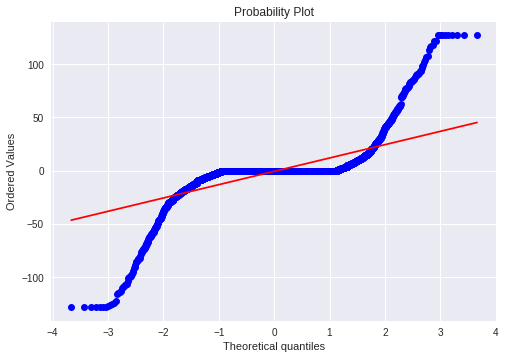

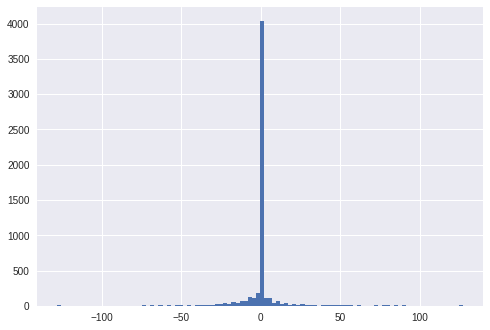

mean=-0.516 stdv=17.772
Statistics=0.495, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1432.408, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.371, p=0.000
Sample does not look Gaussian (reject H0)


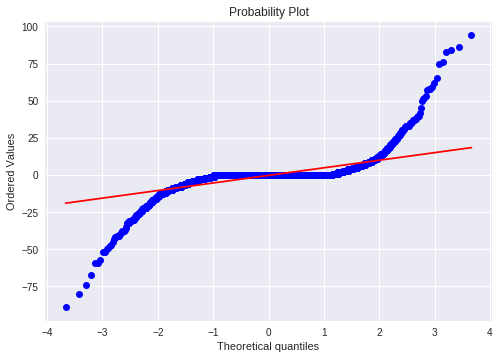

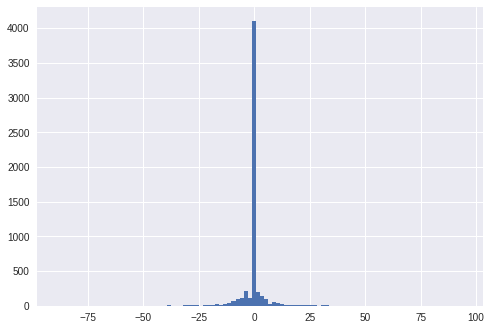

mean=-0.244 stdv=7.432
Statistics=0.473, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2276.398, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.376, p=0.000
Sample does not look Gaussian (reject H0)


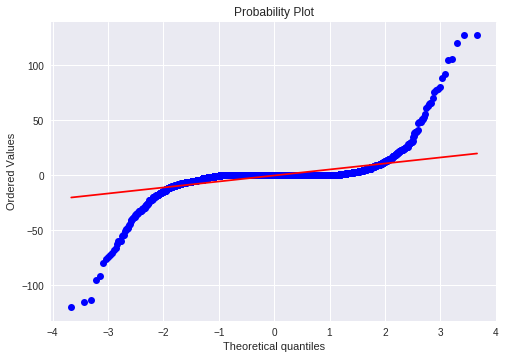

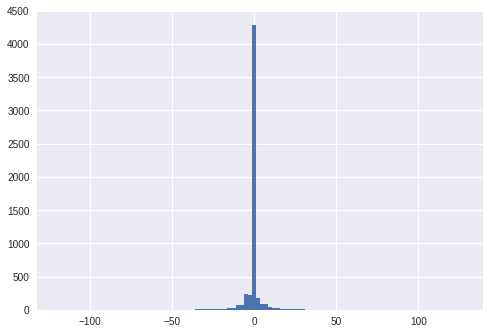

mean=-0.296 stdv=8.880
Statistics=0.379, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2454.530, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


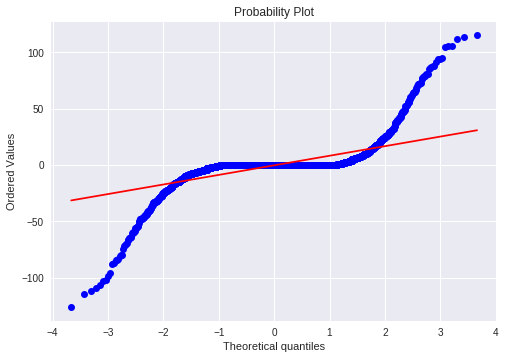

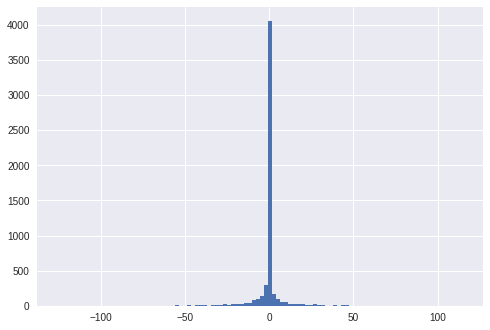

mean=-0.193 stdv=12.503
Statistics=0.462, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1656.610, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


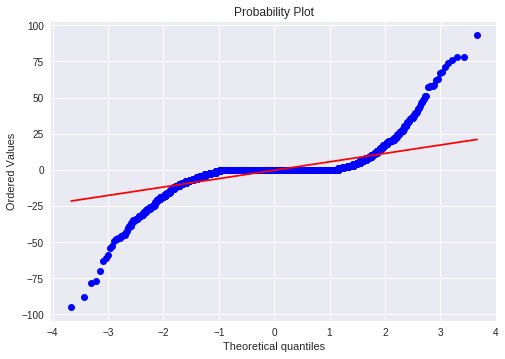

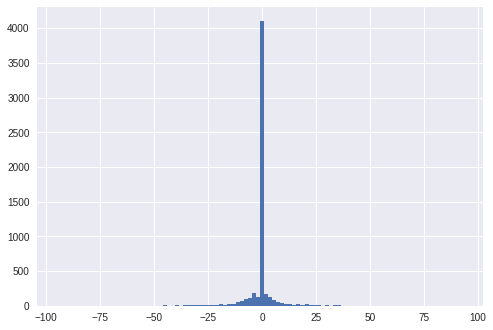

mean=-0.251 stdv=8.261
Statistics=0.496, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1761.411, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.377, p=0.000
Sample does not look Gaussian (reject H0)


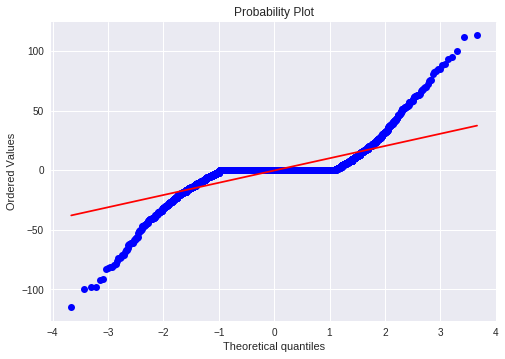

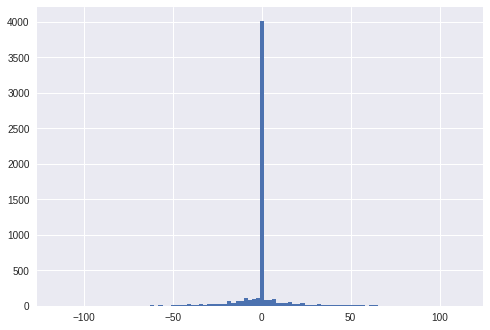

mean=-0.331 stdv=13.403
Statistics=0.588, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1296.183, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.367, p=0.000
Sample does not look Gaussian (reject H0)


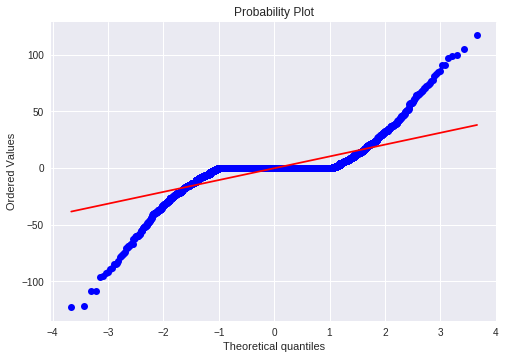

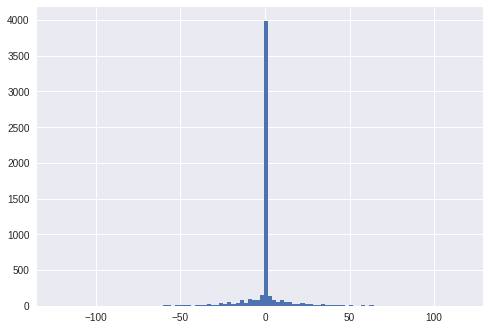

mean=-0.307 stdv=13.748
Statistics=0.576, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1414.918, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.356, p=0.000
Sample does not look Gaussian (reject H0)


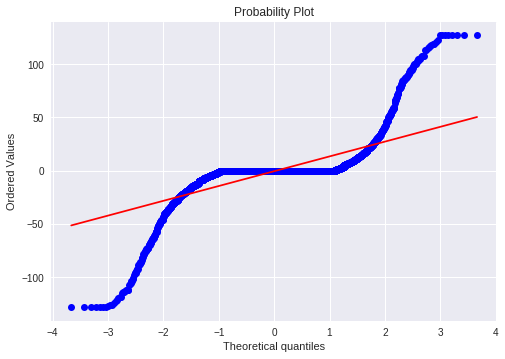

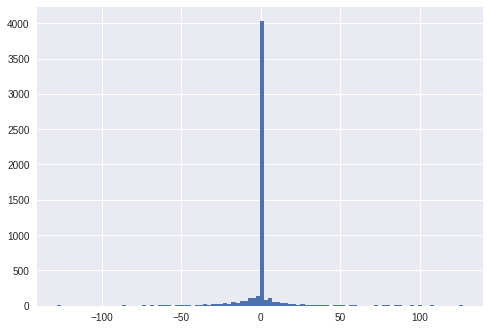

mean=-0.406 stdv=19.375
Statistics=0.513, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1343.348, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.364, p=0.000
Sample does not look Gaussian (reject H0)


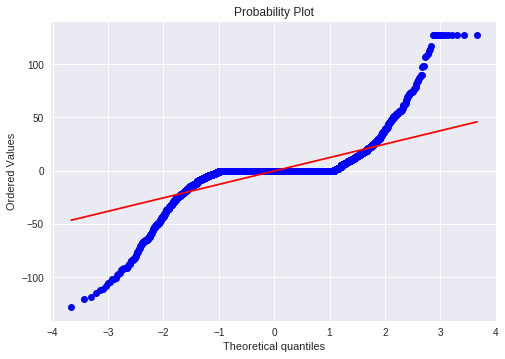

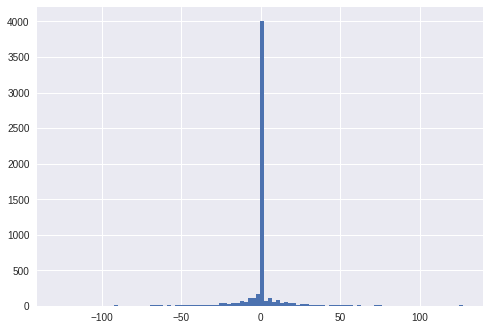

mean=-0.213 stdv=17.093
Statistics=0.543, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1411.952, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.360, p=0.000
Sample does not look Gaussian (reject H0)


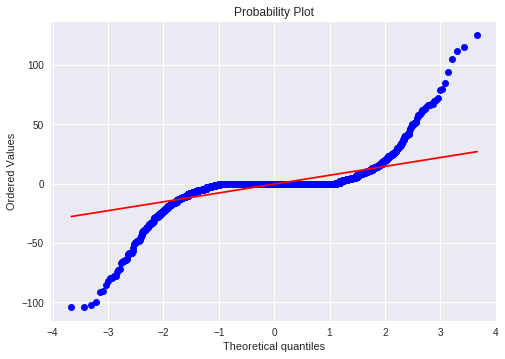

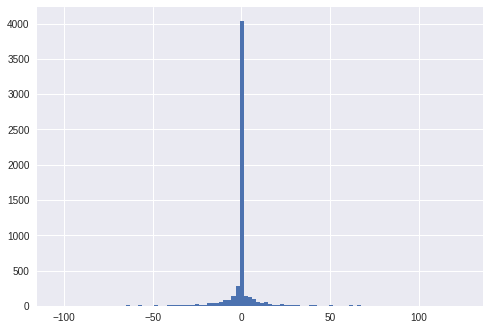

mean=-0.280 stdv=10.769
Statistics=0.480, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1657.085, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.367, p=0.000
Sample does not look Gaussian (reject H0)


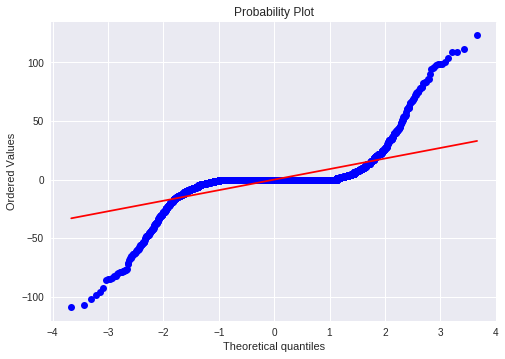

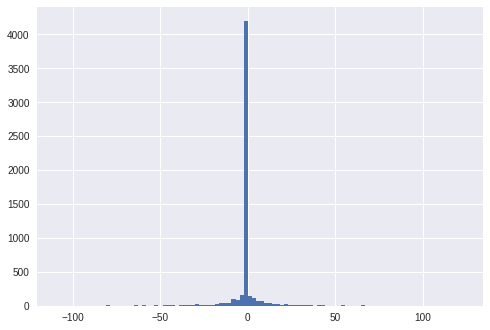

mean=-0.099 stdv=13.164
Statistics=0.469, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1754.360, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.371, p=0.000
Sample does not look Gaussian (reject H0)


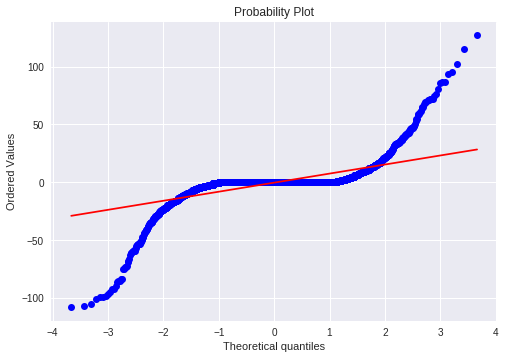

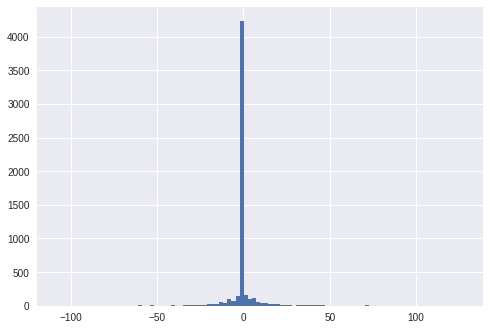

mean=-0.302 stdv=11.500
Statistics=0.464, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1943.523, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.373, p=0.000
Sample does not look Gaussian (reject H0)


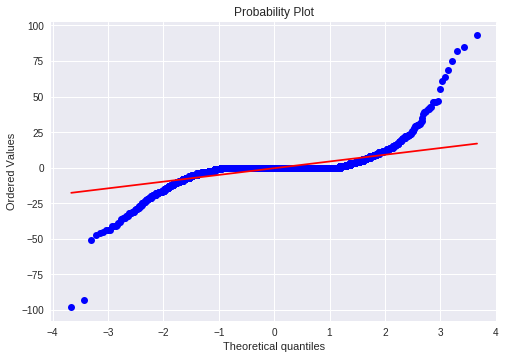

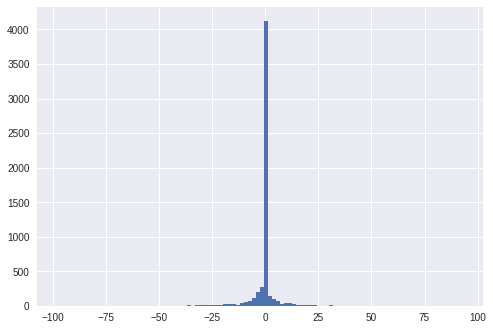

mean=-0.315 stdv=6.765
Statistics=0.488, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2068.096, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.382, p=0.000
Sample does not look Gaussian (reject H0)


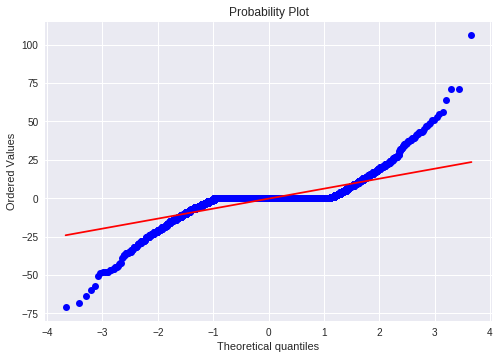

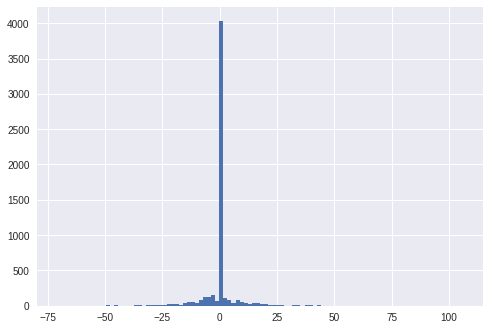

mean=-0.310 stdv=8.427
Statistics=0.596, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1418.517, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.369, p=0.000
Sample does not look Gaussian (reject H0)


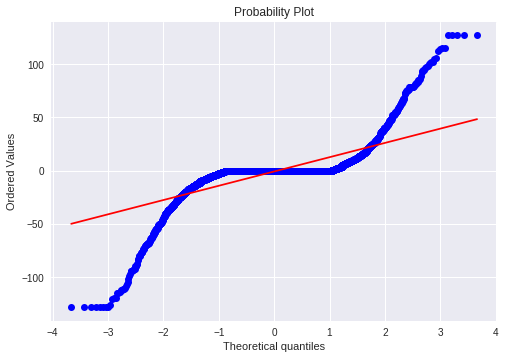

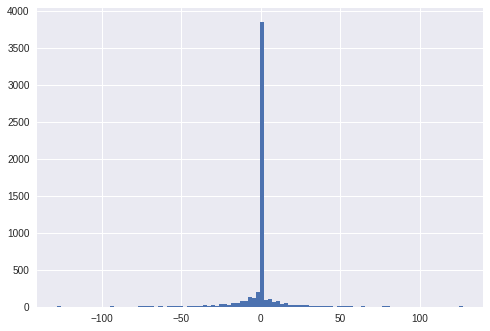

mean=-0.661 stdv=18.062
Statistics=0.550, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1518.890, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.352, p=0.000
Sample does not look Gaussian (reject H0)


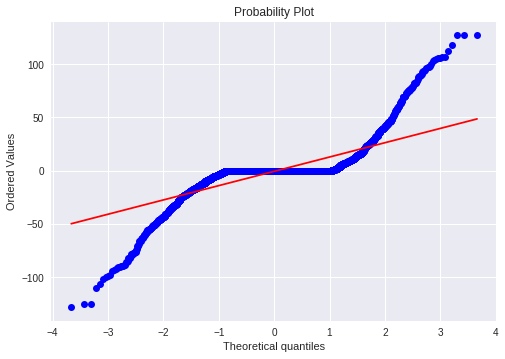

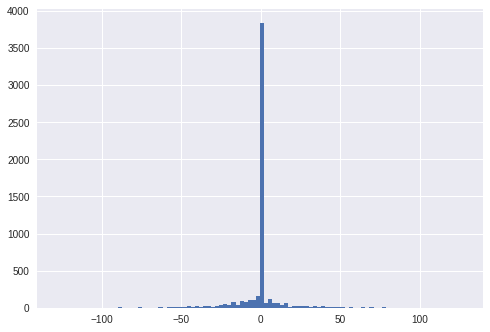

mean=-0.512 stdv=17.279
Statistics=0.603, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1305.162, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.351, p=0.000
Sample does not look Gaussian (reject H0)


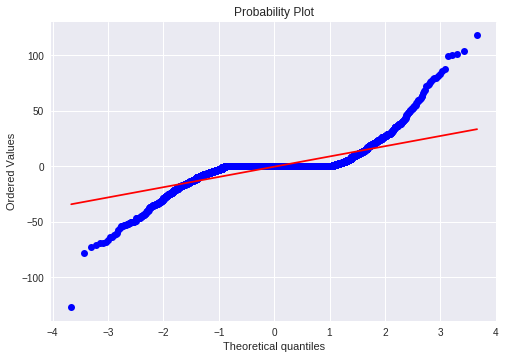

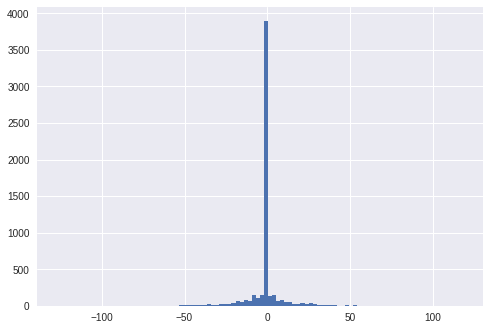

mean=-0.353 stdv=11.928
Statistics=0.600, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1735.126, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.356, p=0.000
Sample does not look Gaussian (reject H0)


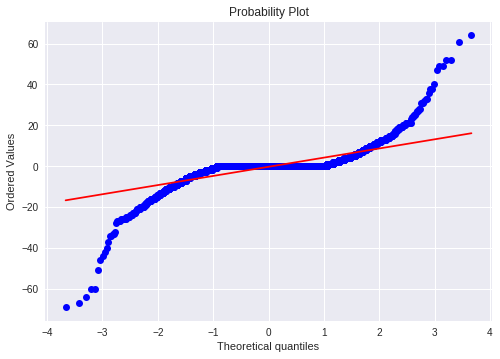

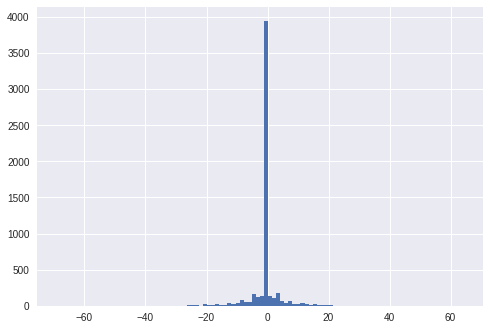

mean=-0.284 stdv=5.917
Statistics=0.574, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1944.589, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.356, p=0.000
Sample does not look Gaussian (reject H0)


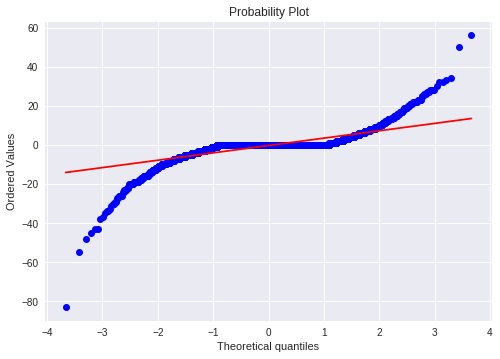

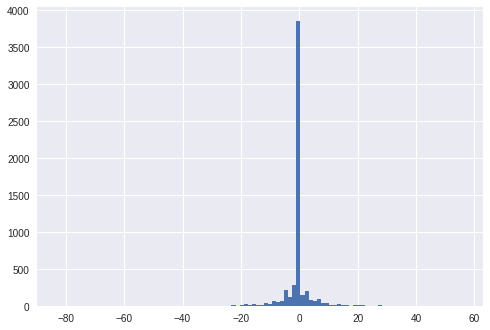

mean=-0.299 stdv=4.990
Statistics=0.571, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2789.536, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.364, p=0.000
Sample does not look Gaussian (reject H0)


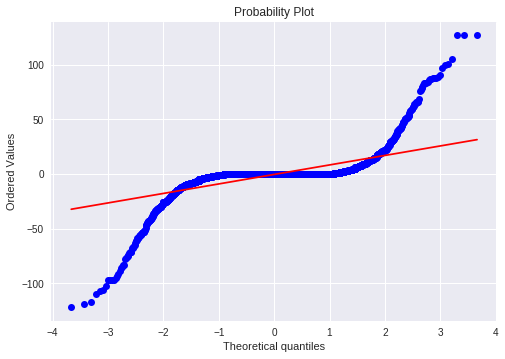

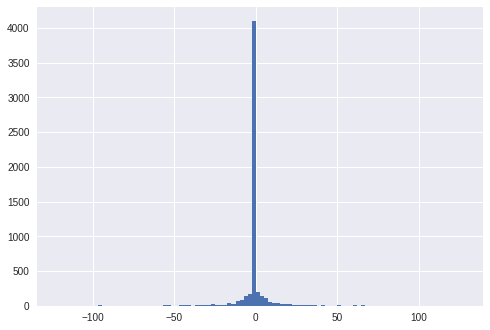

mean=-0.362 stdv=12.875
Statistics=0.457, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1650.474, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.361, p=0.000
Sample does not look Gaussian (reject H0)


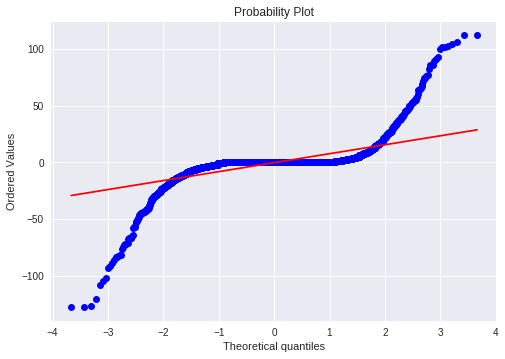

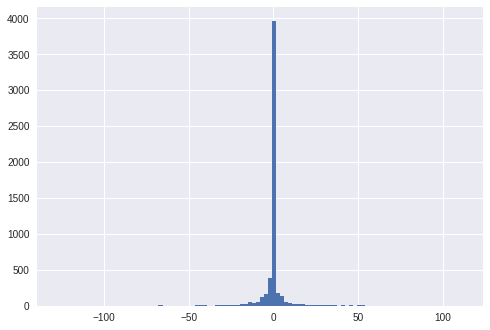

mean=-0.361 stdv=11.877
Statistics=0.444, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1800.044, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.366, p=0.000
Sample does not look Gaussian (reject H0)


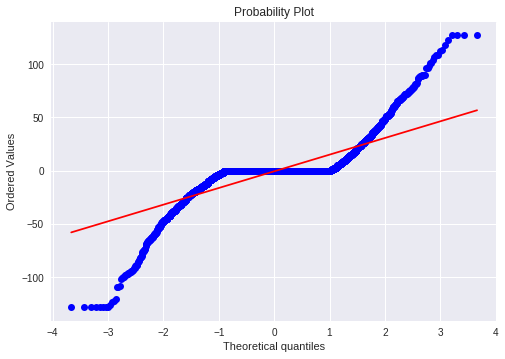

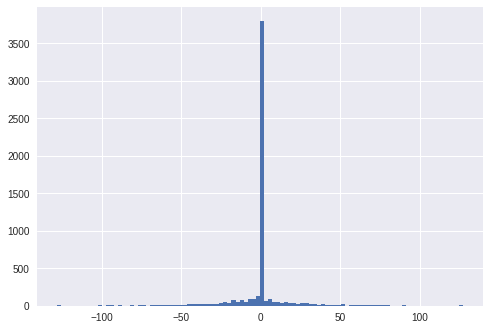

mean=-0.512 stdv=19.669
Statistics=0.632, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1156.127, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.346, p=0.000
Sample does not look Gaussian (reject H0)


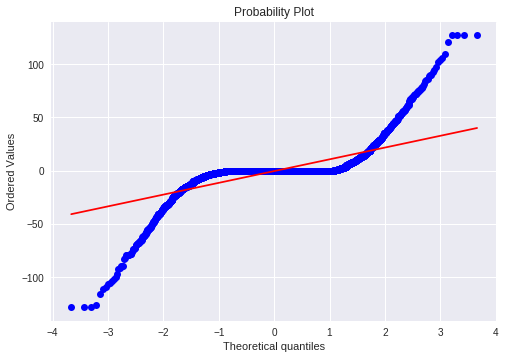

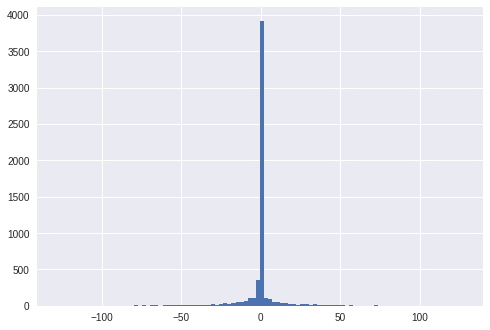

mean=-0.289 stdv=15.271
Statistics=0.522, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1436.800, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.361, p=0.000
Sample does not look Gaussian (reject H0)


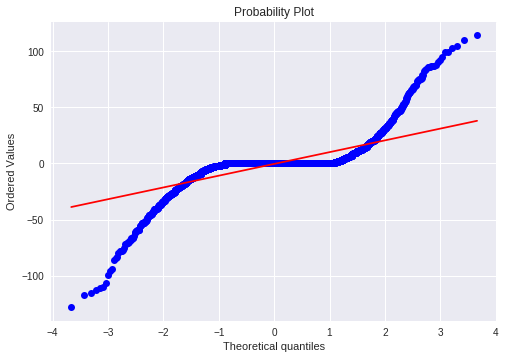

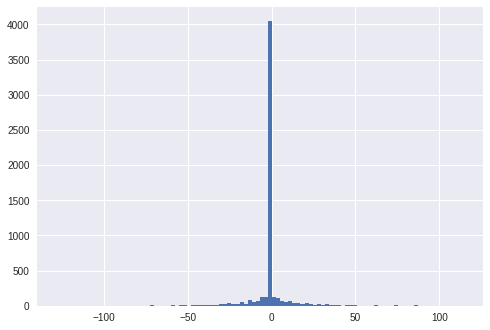

mean=-0.413 stdv=14.144
Statistics=0.549, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1375.027, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.363, p=0.000
Sample does not look Gaussian (reject H0)


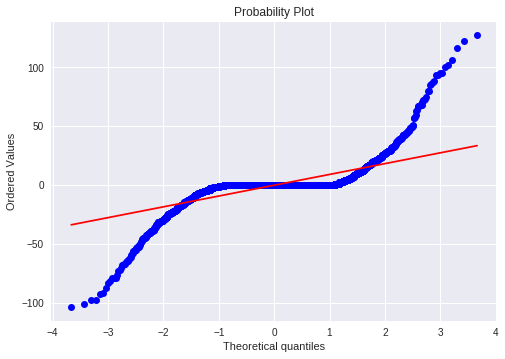

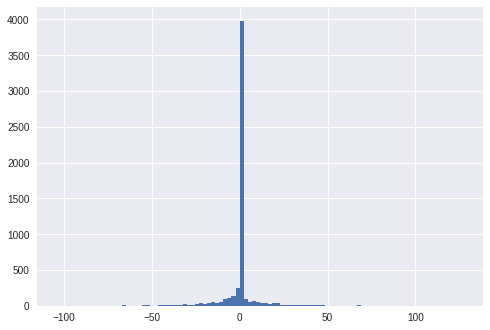

mean=-0.334 stdv=12.536
Statistics=0.537, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1633.041, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.365, p=0.000
Sample does not look Gaussian (reject H0)


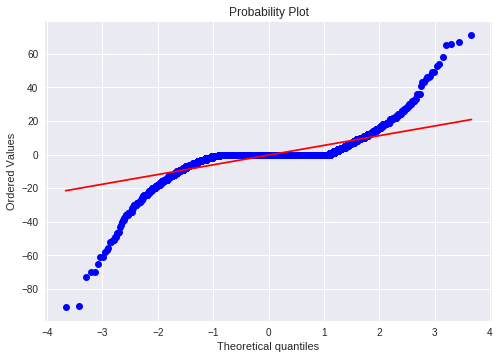

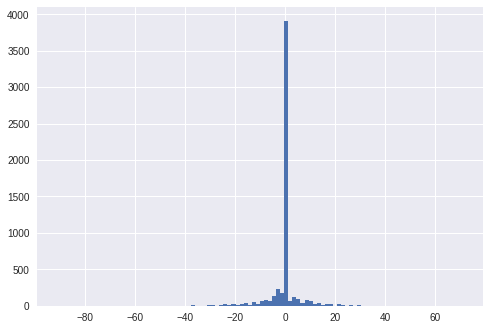

mean=-0.341 stdv=7.746
Statistics=0.559, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2316.683, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.366, p=0.000
Sample does not look Gaussian (reject H0)


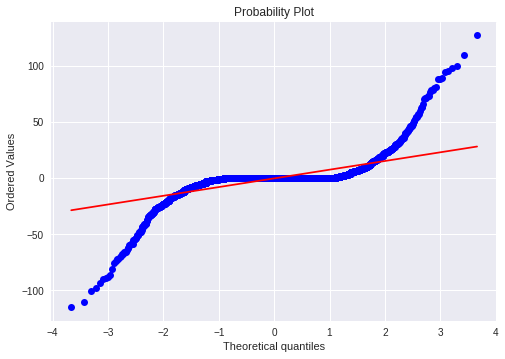

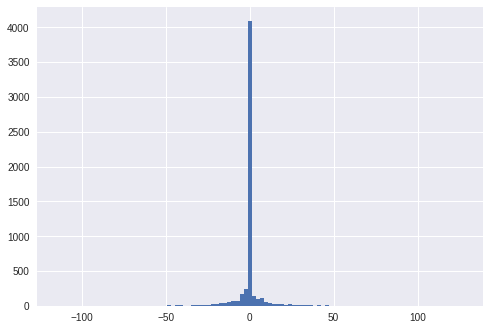

mean=-0.298 stdv=11.139
Statistics=0.483, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1642.767, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.367, p=0.000
Sample does not look Gaussian (reject H0)


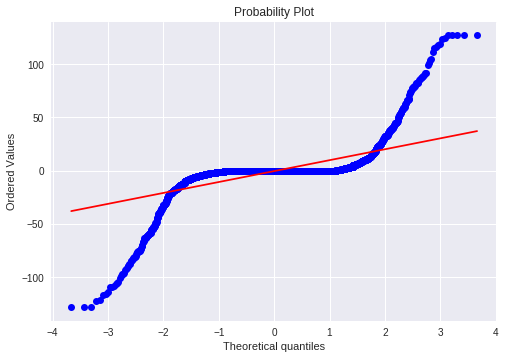

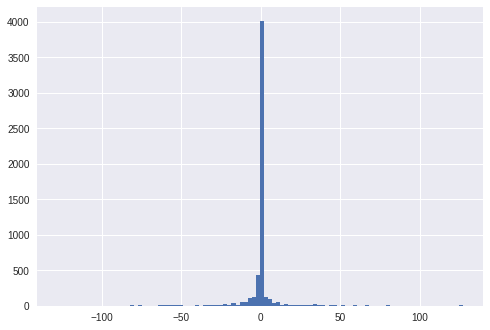

mean=-0.300 stdv=15.513
Statistics=0.436, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1557.435, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.369, p=0.000
Sample does not look Gaussian (reject H0)


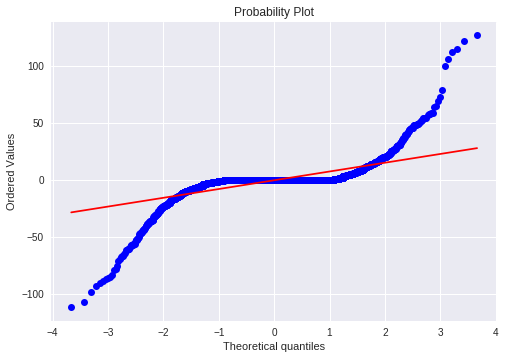

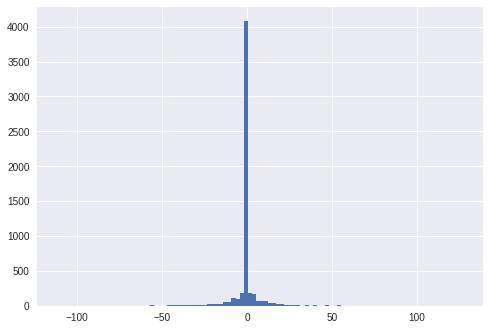

mean=-0.369 stdv=10.942
Statistics=0.497, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1723.866, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.361, p=0.000
Sample does not look Gaussian (reject H0)


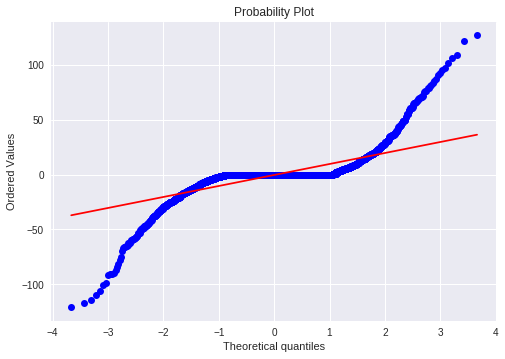

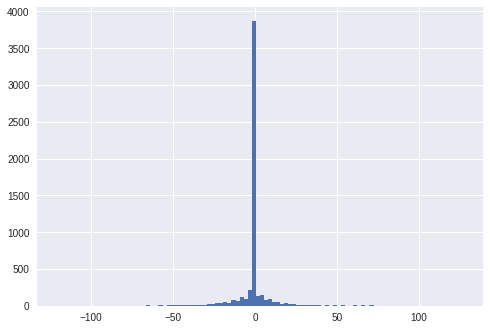

mean=-0.353 stdv=13.398
Statistics=0.561, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1449.882, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.354, p=0.000
Sample does not look Gaussian (reject H0)


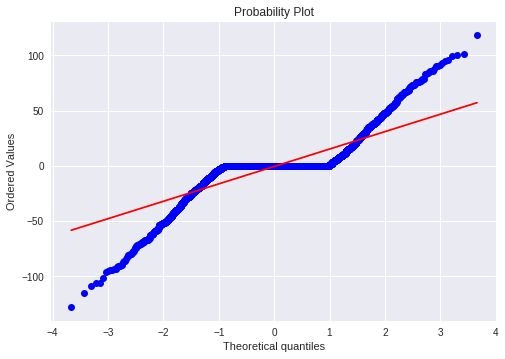

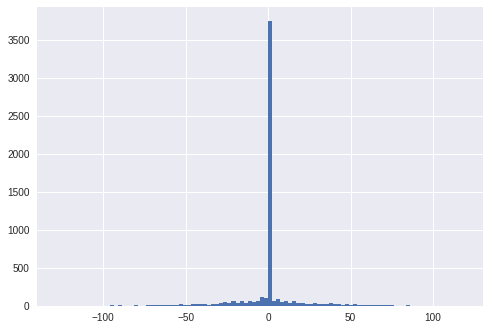

mean=-0.615 stdv=19.069
Statistics=0.682, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=899.151, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.338, p=0.000
Sample does not look Gaussian (reject H0)


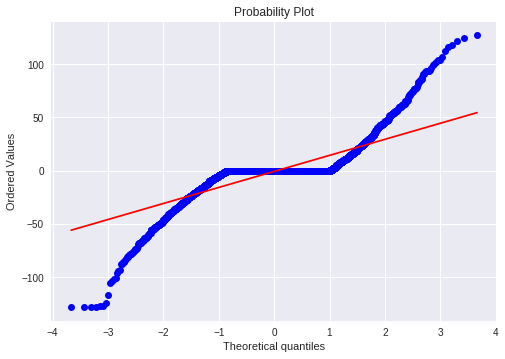

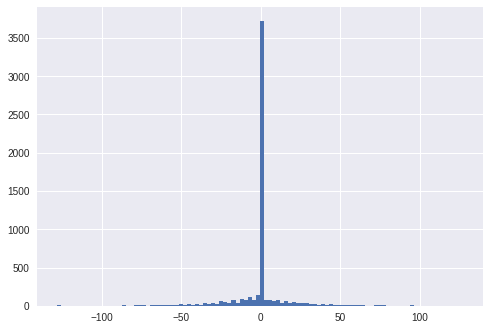

mean=-0.589 stdv=18.506
Statistics=0.661, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1060.058, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.343, p=0.000
Sample does not look Gaussian (reject H0)


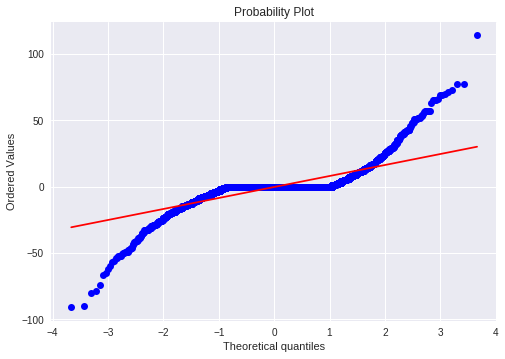

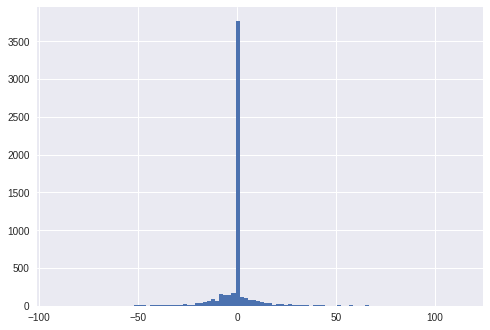

mean=-0.332 stdv=10.500
Statistics=0.624, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1487.622, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.353, p=0.000
Sample does not look Gaussian (reject H0)


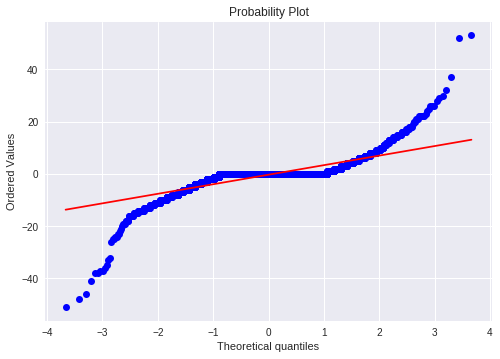

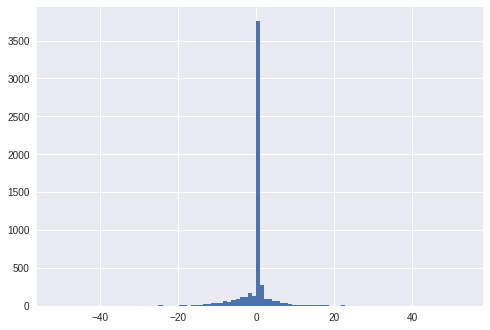

mean=-0.298 stdv=4.622
Statistics=0.625, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1713.083, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.356, p=0.000
Sample does not look Gaussian (reject H0)


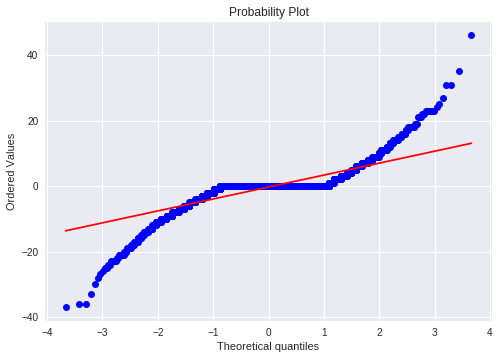

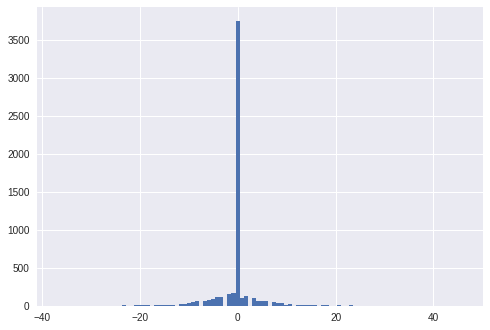

mean=-0.301 stdv=4.478
Statistics=0.664, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1207.492, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.362, p=0.000
Sample does not look Gaussian (reject H0)


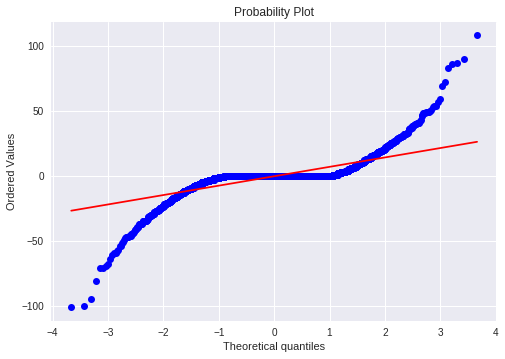

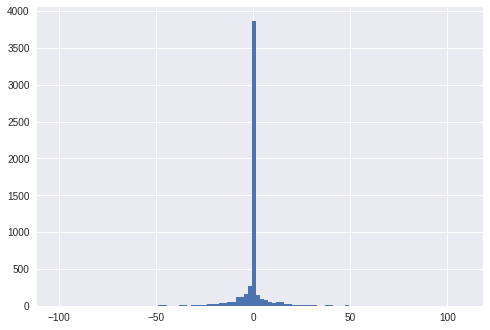

mean=-0.295 stdv=9.611
Statistics=0.566, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1553.938, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.356, p=0.000
Sample does not look Gaussian (reject H0)


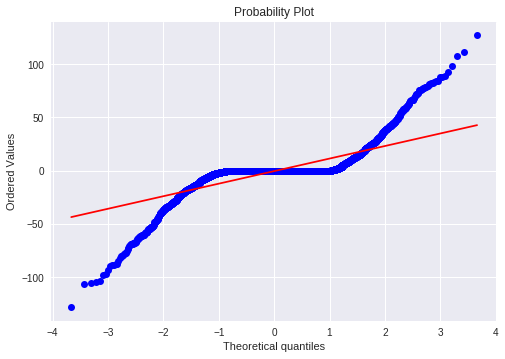

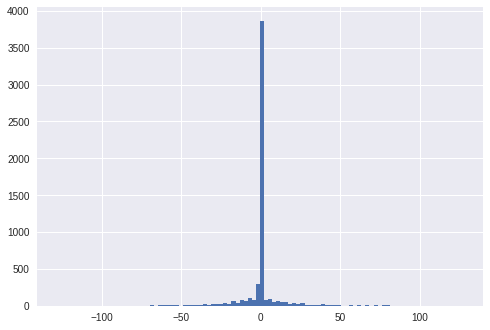

mean=-0.316 stdv=15.270
Statistics=0.594, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1200.111, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.349, p=0.000
Sample does not look Gaussian (reject H0)


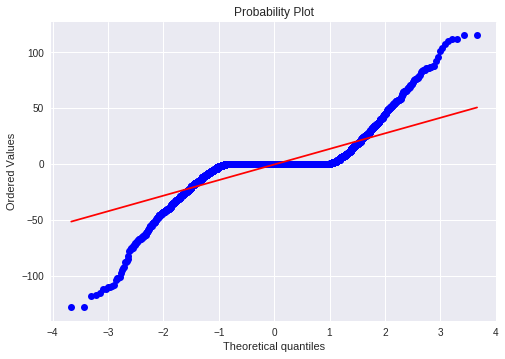

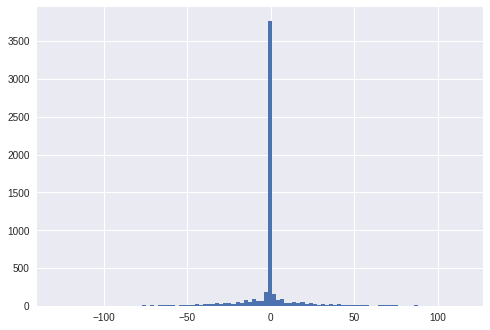

mean=-0.434 stdv=17.572
Statistics=0.628, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1123.790, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.345, p=0.000
Sample does not look Gaussian (reject H0)


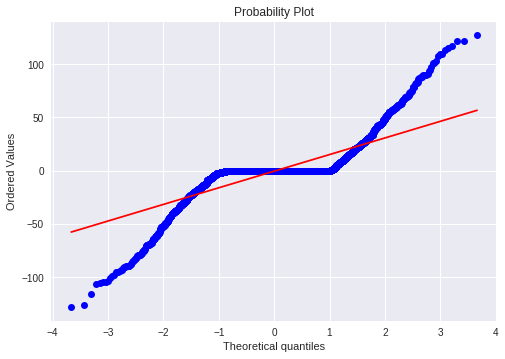

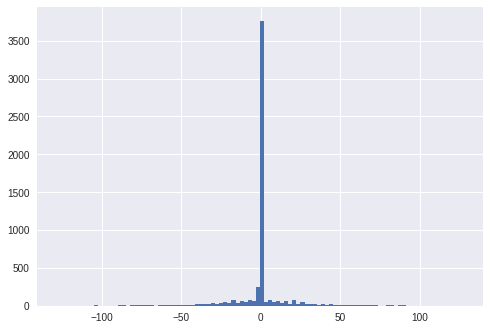

mean=-0.374 stdv=19.392
Statistics=0.646, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1004.015, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.346, p=0.000
Sample does not look Gaussian (reject H0)


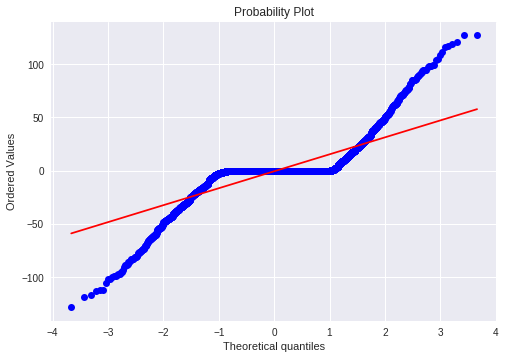

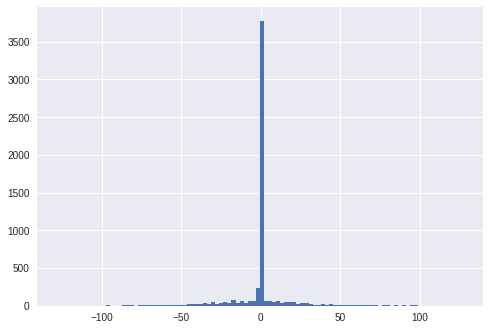

mean=-0.470 stdv=19.745
Statistics=0.648, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=996.677, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.348, p=0.000
Sample does not look Gaussian (reject H0)


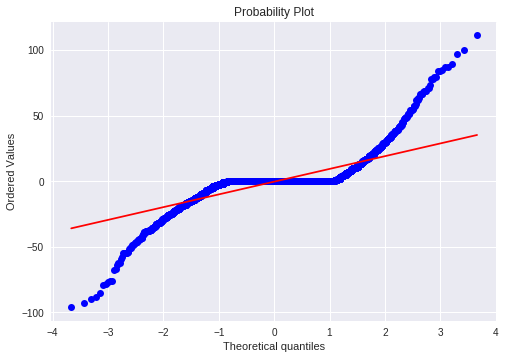

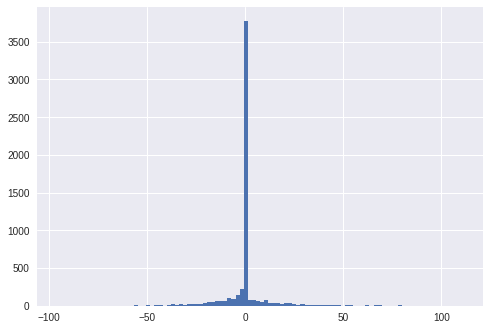

mean=-0.385 stdv=12.380
Statistics=0.614, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1554.931, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.363, p=0.000
Sample does not look Gaussian (reject H0)


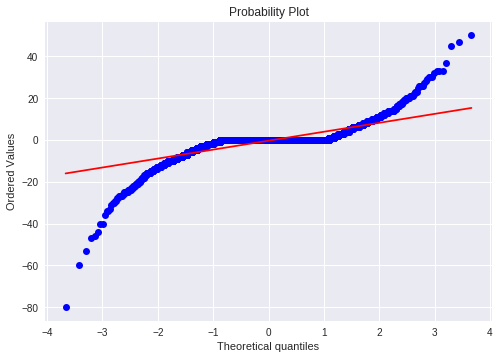

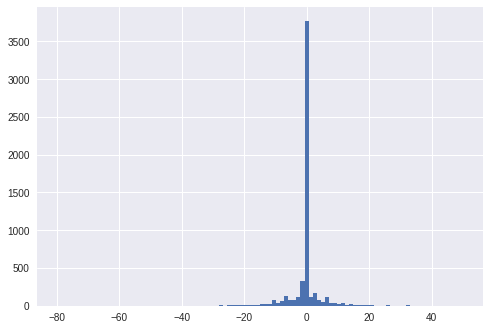

mean=-0.353 stdv=5.465
Statistics=0.613, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2456.081, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.362, p=0.000
Sample does not look Gaussian (reject H0)


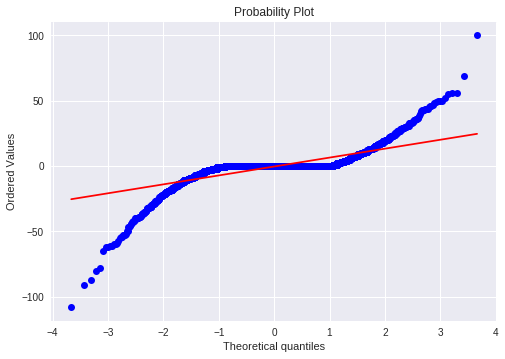

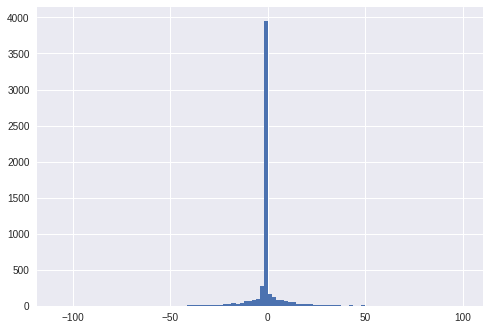

mean=-0.330 stdv=9.020
Statistics=0.573, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=2268.149, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.356, p=0.000
Sample does not look Gaussian (reject H0)


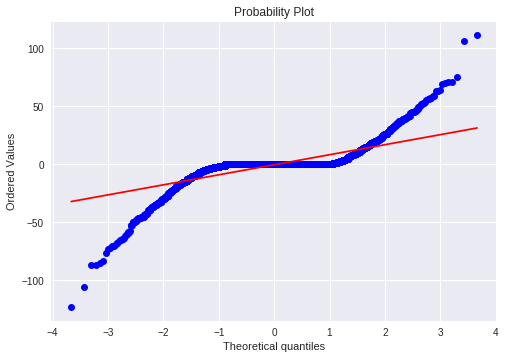

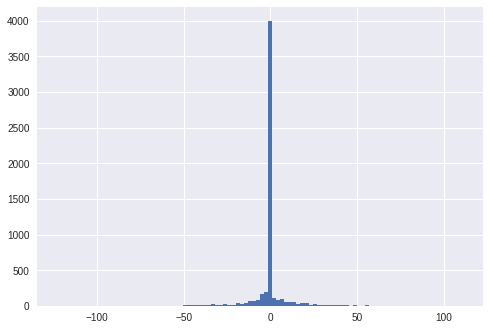

mean=-0.361 stdv=11.343
Statistics=0.580, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1644.593, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.357, p=0.000
Sample does not look Gaussian (reject H0)


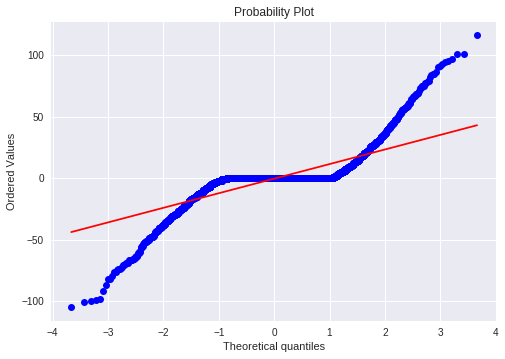

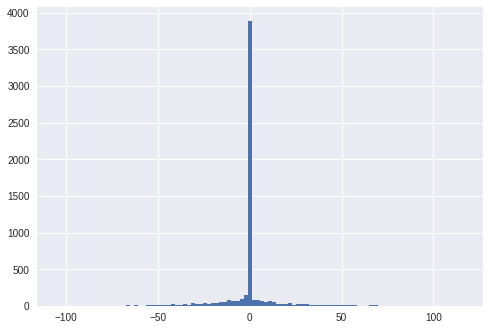

mean=-0.473 stdv=15.018
Statistics=0.623, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1134.796, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.357, p=0.000
Sample does not look Gaussian (reject H0)


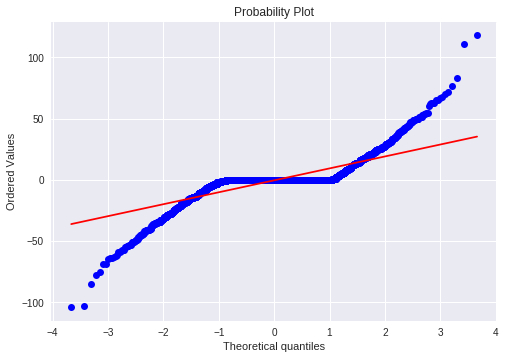

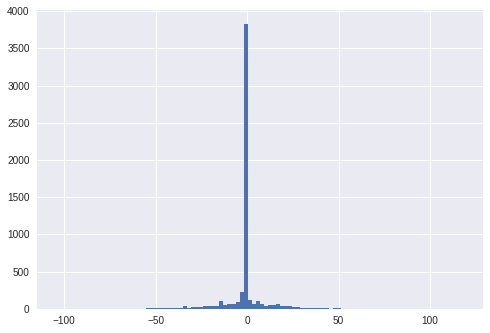

mean=-0.373 stdv=12.117
Statistics=0.648, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=1145.317, p=0.000
Sample does not look Gaussian (reject H0)
Statistics=0.354, p=0.000
Sample does not look Gaussian (reject H0)


In [0]:
for i in range(nClasses):
    r,r1 = np.where(Y == (i+1))#r1 is a redundent variable
    for j in range(x1_ch):
        x = np.hstack([x_EMG[r[0],:,j],x_EMG[r[1],:,j]])
        s, p3 = stats.shapiro(x)
        plt.figure()
        res = stats.probplot(x, plot=plt)
        plt.figure()
        plt.hist(x, bins=100)
        plt.show()
        print('mean=%.3f stdv=%.3f' % (np.mean(x), np.std(x)))
        stat, p = stats.shapiro(x)
        print('Statistics=%.3f, p=%.3f' % (stat, p))
        # interpret
        alpha = 0.05
        if p > alpha:
            print('Sample looks Gaussian (fail to reject H0)')
        else:
            print('Sample does not look Gaussian (reject H0)')
        stat, p = stats.normaltest(x)
        print('Statistics=%.3f, p=%.3f' % (stat, p))
        # interpret
        alpha = 0.05
        if p > alpha:
            print('Sample looks Gaussian (fail to reject H0)')
        else:
            print('Sample does not look Gaussian (reject H0)')
        stat, p = stats.kstest(x, 'norm')
        print('Statistics=%.3f, p=%.3f' % (stat, p))
        # interpret
        alpha = 0.05
        if p > alpha:
            print('Sample looks Gaussian (fail to reject H0)')
        else:
            print('Sample does not look Gaussian (reject H0)')
